![ICL](Images/imperiallogo.jpeg)

# Bayesian methods in ecology and evolution

https://bitbucket.org/mfumagal/statistical_inference

## day 3: Bayesian computation

### Intended Learning Outcomes

At the end of this part you will be able to:
* describe the use of asymptotic methods,
* illustrate the utility of direct and indirect sampling methods,
* evaluate the feasibility of Markov Chain Monte Carlo sampling,
* implement simple indirect sampling methods.

The calculation of posterior distributions often involves the evaluation of complex high-dimensional integrals.
This is true when a conjugate prior is not available or appropriate.

Ways of addressing this issue are through
* asymptotic methods for approximating the posterior density
* numerical integration.

### Asymptotic methods

When there are many data points, the likelihood will be peaked and the posterior distribution will not be affected by the prior much.

Therefore, small changes in the prior will have little effect on the posterior and the likelihood will be concentrated in a small region.

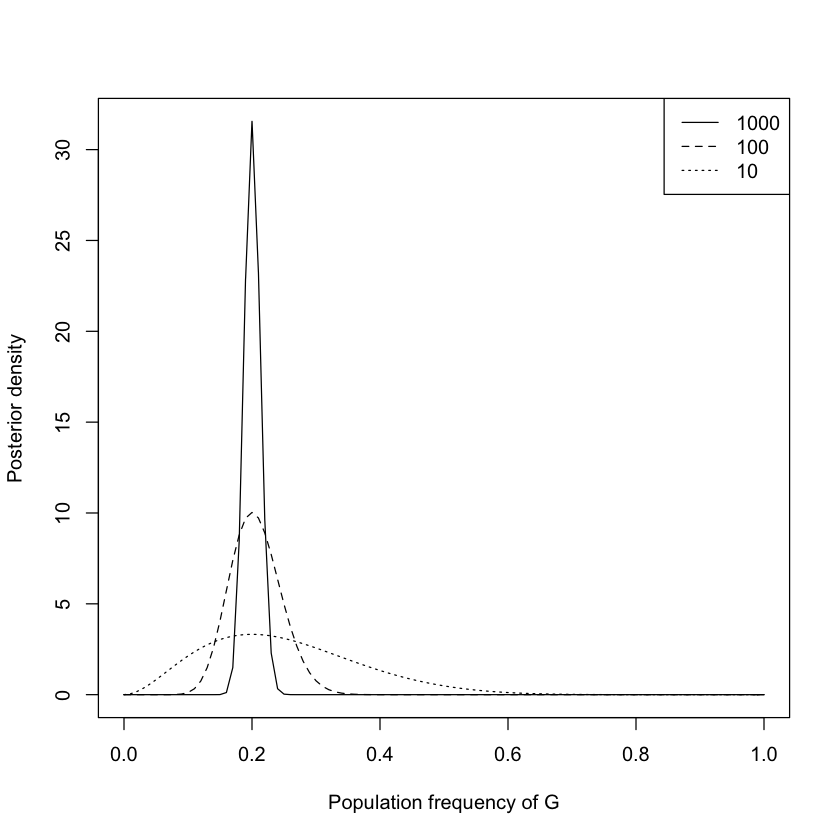

In [1]:
# Beta-Binomial model of population allele frequencies
p <- seq(0, 1, 0.01)

# 1000 chromosomes (200 G alleles)
k <- 200
n <- 1000
alpha <- k+1
beta <- n-k+1
plot(x=p, y=dbeta(p, shape1=alpha, shape2=beta), ylab="Posterior density" , xlab="Population frequency of G", type="l")

# 100 chromosomes (20 G alleles)
k <- 20
n <- 100
alpha <- k+1
beta <- n-k+1
points(x=p, y=dbeta(p, shape1=alpha, shape2=beta), type="l", lty=2)

# 10 chromosomes (2 G alleles)
k <- 2
n <- 10
alpha <- k+1
beta <- n-k+1
points(x=p, y=dbeta(p, shape1=alpha, shape2=beta), type="l", lty=3)

legend("topright", legend=c(1e3,1e2,1e1), lty=1:3)

When many data points are available, $P(\theta|y)$ will be approximately distributed as a Normal distribution.
This is given by the _Bayesian Central Limit Theorem_.

For large data points $n$ the posterior can be approximated by a Normal distribution with mean equal to the posterior mode and (co)variance (matrix) equal to minus the inverse of the second derivative matrix of the log posterior evaluated at the mode.

The Normal approximation follows the procedure:
* take the log
* take the derivative of $l(\theta)$ and set it to zero
* take the second derivative evaluated at $\hat{\theta}$
* take the minus inverse

In the Beta-Binomial model for population allele frequencies with flat Beta prior, $P(\theta|x) \approx \theta^x(1-\theta)^{n-x}$.
Remember that the derivative of $log(x)$ is $1/x$ and that the derivative of $log(1-x)$ is $1/(x-1)$.

* take the log: $l(\theta)=x\log\theta+(n-x)\log(1-\theta)$,
* take the derivative of $l(\theta)$ and set it to zero, obtaining $\hat{\theta}=\frac{x}{n}$,
* take the second derivative evaluated at $\hat{\theta}$, $-\frac{n}{\hat{\theta}}-\frac{n}{1-\hat{\theta}}$,
* take the minus inverse, $\frac{\hat{\theta}(1-\hat{\theta})}{n}$,
* $P(\theta|x) \sim N(\hat{\theta}, \frac{\hat{\theta}(1-\hat{\theta})}{n})$.


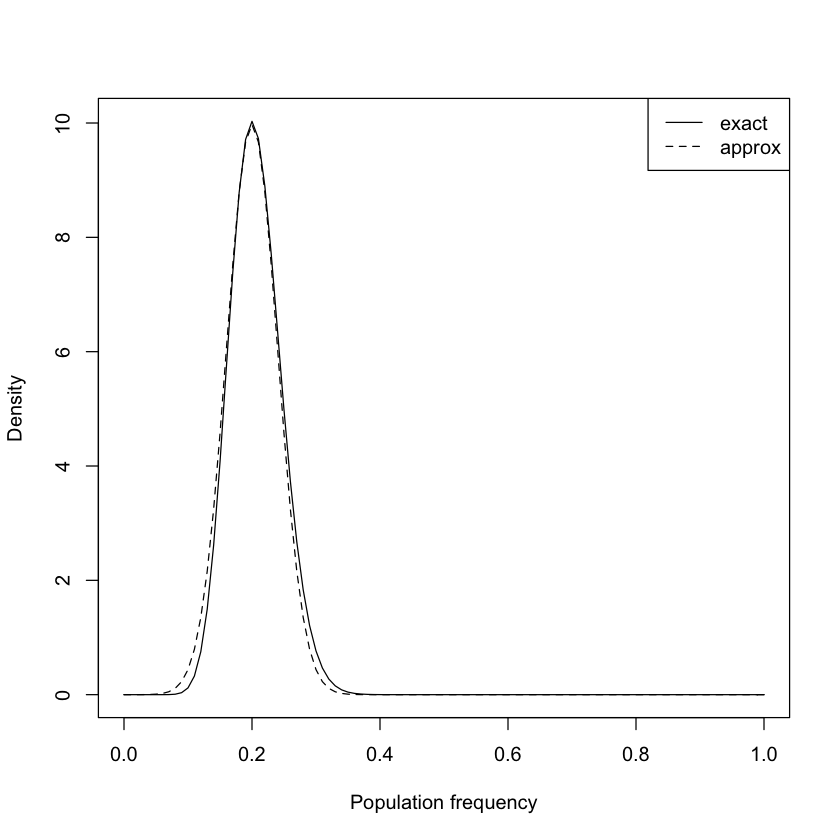

In [2]:
# Beta-Binomial model of population allele frequencies
p <- seq(0, 1, 0.01)

# 100 chromosomes (20 G alleles)  
k <- 20
n <- 100

# exact posterior with flat prior
alpha <- k+1
beta <- n-k+1
plot(x=p, y=dbeta(p, shape1=alpha, shape2=beta), ylab="Density", xlab="Population frequency", type="l")

# Normal approximation
thetaHat <- k/n
var <- thetaHat*(1-thetaHat)/n
points(x=p, y=dnorm(p, mean=thetaHat, sd=sqrt(var)), type="l", lty=2)

legend("topright", c("exact","approx"), lty=1:2)

You can see how the modes are very similar but the approximated curve fails to capture the asymmetry of the tails.

If the prior is flat, then we can replace the posterior mean by the MLE.
Alternatively, we can replace the posterior mode by the posterior mean.
These approximations are called _model approximations_ or _first order approximations_ as they estimate $\theta$ by the mode and the error goes to $0$ at a rate proportional to $1/n$.

Estimates of posterior moments and quantiles can be obtained simply as the corresponding features of the approximated Normal density.
However, the estimates of moments and quantiles may be poor if the posterior differs from normality.
_Laplace's Method_ provides a second order approximation to the posterior mean, with an error that decreases at a rate $1/n^2$.

In [3]:
options(signif=2)

# data
k <- 20
n <- 100

# exact posterior with flat prior
alpha <- k+1
beta <- n-k+1
exact <- rbeta(1e5, shape1=alpha, shape2=beta)
signif(quantile(exact),3)

# Normal approximation
thetaHat <- k/n
var <- thetaHat*(1-thetaHat)/n
approx <- rnorm(1e5, mean=thetaHat, sd=sqrt(var))
signif(quantile(approx),3)

0%    25%    50%    75%   100% 
0.0777 0.1780 0.2040 0.2320 0.3900

0%    25%    50%    75%   100% 
0.0317 0.1730 0.2000 0.2270 0.3630

The advantages of asymptotic methods are:
* they replace numerical integration with numerical differentiation,
* they are deterministic (without elements of stochasticity),
* they reduce the computational complexity for any study of robustness (how sensitive are our conclusions to changes in the prior/likelihood?).

Asymptotic methods have also disadvantages:

* they require that the posterior is unimodal,
* they require that the size of the data is large (how large is "large enough"?),
* for high high-dimensional parameters the calculation of Hessian matrices (second derivatives) is hard.

### Non-iterative Monte Carlo methods

Direct sampling of the posterior density can be done using a Monte Carlo integration.

Suppose that ${\theta} \sim h({\theta})$ with $h({\theta})$ being a posterior distribution.

We wish to estimate $\gamma$, the posterior mean of $c({\theta})$, with $\gamma \equiv \mathrm{E}[c({\theta})] = \int c({\theta}) h({\theta}) d{\theta}$.

If ${\theta}_1, {\theta}_2, ..., {\theta}_N$ are independent and identically distributed (iid) as $h({\theta})$, then
\begin{equation}
    \hat{\gamma}=\frac{1}{N}\sum_{i=1}^N c(\theta_i)
\end{equation}
which converges to $\mathrm{E}[c({\theta})]$ with probability 1 as $N \rightarrow \infty$.

The computation of posterior expectations requires only a sample of size $N$ from the posterior distribution.

In contrast to asymptotic methods, accuracy improves with $N$ the Monte Carlo sample size (which we can choose and have control upon) rather than $n$ the size of the data set (which can may not be able to control).

With higher dimensionality of ${\theta}$, more samples are needed but the structure remains the same.

The variance of $\hat{\gamma}$ can be estimated from the sample variance of the $c({\theta}_i)$ values.

The standard error estimate for $\hat{\gamma}$ is
\begin{equation}
    \hat{se}(\hat{\gamma}) = \sqrt[]{ \frac{1}{N(N-1)} \sum_{i=1}^N [c({\theta_i})-\hat{\gamma}]^2 }
\end{equation}

The Central Limit Theorem implies that $\hat{\gamma} \pm 2 \hat{se}(\hat{\gamma})$ provides the approximated $95\%$ confidence interval.
$N$ can be chosen as large as necessary to provide a desirable confidence interval.

In the univariate case, a histogram of the sampled $\theta_i$ estimates the posterior itself, as the probability of each bin converges to the true bin probability.

In fact, an estimate of $p \equiv P\{a<c(\theta)<b\}$ is given by
\begin{equation}
    \hat{p} = \frac{\text{number of } c(\theta_i) \in (a,b)}{N}
\end{equation}

We can use a kernel density function to smooth the histogram, using a Normal or rectangular distribution.
Given a sample from the posterior distribution, almost any quantity can be estimated.

What happens if we can't directly sample from this distribution?

There are methods for _indirect_ sampling of the posterior distribution.
The most commonly used ones are
1. importance sampling
2. rejection sampling
3. weighted bootstrap.

In the importance sampling, an importance function is derived to approximate the Normalised likelihood times the prior, and a weight function is then used for sampling.

In the weighted bootstrap, instead of resampling from the set $\{\theta_1,...,\theta_N\}$ with equal probabilities, some points are sampled more often than others because of unequal weighting.

In __rejection sampling__ a smooth density, called the _envelope function_, is used to "cover" rather than approximate the posterior distribution.

Suppose we can identify an _envelope function_ $g({\theta})$ and a constant $M>0$ such that $L({\theta})\pi({\theta})<Mg({\theta})$ for all ${\theta}$.
Then the algorithm, in the univariate case, is the following:
* generate $\theta_i \sim g(\theta)$,
* generate $U \sim Uniform(0,1)$,
* if $MUg(\theta_i)<L(\theta_i)\pi(\theta_i)$ accept $\theta_i$ otherwise reject $\theta_i$,
* repeat this procedure until $N$ samples are obtained.

The members of this sample will be random variables from $h(\theta)$.

The intuition for the rejection sampling algorithm is that it is typically hard to sample from the true posterior but it is much easier to sample from the envelope function.

![](Images/Rejection.png)

__ACTIVITY__ 

Implement a rejection algorithm to approximate a Beta distribution $B(3,10)$ using a uniform envelope function.
Assess the accuracy of your approximation.
What happens if you change $M$ to very low or very high values?

In [ ]:
## calculate density from true posterior
L_times_pi <- function(x)  # L(theta)*pi(theta)

## g is a uniform prior, M is the maximum density value of the posterior (if known)
x <- seq(0,1,0.01)
M <- 25000

thetas <- c()

# we want N samples
N <- 1e4

while (length(thetas) < N) {

    U <- runif(1,0,1)
    result <- M * U
    print(result)
    theta <- runif(1,0,1)
    if (result < L_times_pi(theta)){
        thetas <- c(result,thetas)
    }
}
hist(thetas)


## check with a qq-plot
#truePosterior <- rbeta(N, 3, 10)
#qqplot(...)
#abline(0,1)

[1] 13770.3


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24945.07


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9926.357


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16162.06


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17519.92


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3311.922


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8657.128


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6060.544


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20679.56


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11058.48


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21388.84


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1325.496


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4277.684


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11722.76


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9620.502


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5947.304


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16151.88


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4175.134


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20294.97


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20178.64


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16041.14


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21394.73


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17380.91


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8460.828


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 985.9626


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1447.723


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16664.12


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10854.75


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7565.682


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21225.8


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6809.984


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7840.26


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3336.015


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17887.28


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19310.45


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23917.68


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22805.35


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5576.884


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23193.92


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14446.62


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6225.057


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18819.84


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15695.09


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10029.95


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4994.343


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10344.99


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4538.549


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5650.995


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14250.76


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21883.34


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20776.53


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18786.29


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16165.08


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8771.525


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18680.67


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21229.72


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 674.1822


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16745.59


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15277.07


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8699.42


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11398.16


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21952.17


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14999.25


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2882.262


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5887.715


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11906.41


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5090.508


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14124.72


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7205.68


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22103.75


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5768.846


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2043.28


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11698.07


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4279.186


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9466.066


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20165.47


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8096.457


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16672.44


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7010.827


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10124.16


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12534.67


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20066.72


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21880.25


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22965.84


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22156.65


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4682.78


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17932.42


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11599.7


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15130.01


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10704.02


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14120.5


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4028.925


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13286.33


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5593.902


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15211.39


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16918.02


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6078.332


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7470.155


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8163.718


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20464.91


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17574.23


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9260.983


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15431.81


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4969.898


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2408.88


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19507.67


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11978.8


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23092.08


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7908.353


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10192.83


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3935.364


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4546.358


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8273.116


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3610.38


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12408.43


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10755.13


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19213.72


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24230.1


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6933.945


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24697.06


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 99.34879


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18950.17


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21835.3


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4072.724


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22512.3


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10741.93


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11553.07


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8228.423


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13394.62


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23109.49


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22335.15


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8568.173


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24044.99


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19643.23


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8917.601


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16077.76


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3591.933


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10174.83


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17629.83


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12844.6


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12049.29


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13496.15


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4320.551


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12550.83


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20763.01


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17728.39


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22401.97


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9627.062


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10216.19


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1675.906


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14896.47


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17008.95


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16642.42


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13159.82


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 965.4801


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15623.67


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20148.3


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22867.97


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14878.65


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 804.8159


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6210.248


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23124.91


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8177.819


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14512.33


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6122.423


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22307.69


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1290.07


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20774.16


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12573.1


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12671.92


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 732.4748


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5489.467


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8969.228


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22634.29


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11555.25


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3500.854


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13091.2


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13699.69


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10820.64


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4894.844


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14467.15


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1241.648


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13735.24


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18379.58


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21348.16


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9701.96


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16520.94


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23858.35


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13087.95


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19763.42


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12049.52


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22891.25


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5657.842


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20984.27


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 983.3887


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12450.67


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22414.21


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14960.92


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21945.04


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14887.03


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15632.56


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3109.837


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16695.87


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24978.16


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12425.48


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6360.498


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16290.57


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3024.666


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1403.261


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6162.125


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14217.38


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5780.702


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14424.58


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13212.23


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15202.05


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10371.47


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23254.06


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16143.75


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12277.33


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1134.121


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10398.62


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17448.9


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12719.38


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2852.823


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20029.34


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17117.64


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11919.44


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 507.576


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15808.18


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20272.01


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18029.88


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8878.644


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23059.79


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14930.75


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11787.61


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20739.76


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21117.97


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10763.5


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6081.876


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23397.25


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1165.882


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12613.2


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19320.59


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18298.2


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14431.49


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3208.792


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16430.53


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2055.97


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9550.342


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2074.599


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3595.172


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7772.819


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20065.36


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23479.68


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1278.122


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5685.927


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12748.56


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 459.311


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4379.807


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7116.36


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1783.652


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3637.577


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3790.643


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6225.356


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 822.716


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11405.61


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19688


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12538.72


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24687.29


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19549.2


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16643.37


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15176.54


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22032.69


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20864.14


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21690.59


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4491.212


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6390.074


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3812.767


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15744.33


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21340.86


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18341.31


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19640.21


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7254.937


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3236.872


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 741.2469


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14705.07


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5910.505


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 525.9424


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8868.261


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24217.34


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2036.593


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2697.998


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15604.83


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6059.875


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14207.2


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3701.286


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10685.49


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9882.657


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7.240847


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9044.152


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8301.416


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19762.86


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21597.73


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7995.928


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16769.18


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21553.38


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13978.96


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12971.16


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18106.67


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22128.11


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 301.9713


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23207.69


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 629.7586


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10663.18


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9886.606


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5046.772


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18968.91


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16732.11


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13982.12


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19055.35


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22113.33


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15504.64


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6332.966


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14225.5


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5221.81


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23755.18


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18610.07


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16071.3


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11672.41


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8773.164


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23881.42


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13789.23


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13560.49


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4093.748


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5537.056


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18031.01


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1446.074


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9830.763


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14111.61


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22869.98


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15413.5


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17900.28


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18103.15


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4609.368


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23411.68


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15452.67


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5114.774


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1657.609


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4861.1


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13833.8


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13568.61


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10477.47


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9599.775


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12271.94


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12992.74


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18834.72


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1934.905


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4471.309


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23226.98


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15618.12


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4534.231


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23196.7


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9151.592


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20624.34


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14000.84


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16674.81


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5151.12


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4138.317


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3886.336


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24673.76


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17783.09


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6958.784


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6245.128


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17003.15


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6339.569


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17915.49


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2749.115


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21730.81


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4770.111


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3628.673


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24614.92


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9214.688


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5730.502


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20336.17


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24755.98


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21773.47


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9858.454


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19389.3


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1412.692


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4857.133


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11858.17


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3554.493


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15786.31


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4561.717


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19809.77


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19.83486


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21722.71


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9960.994


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14093.84


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9659.951


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5790.25


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12355.25


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14017.38


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13361.01


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22242.65


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4963.384


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9564.187


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19389.63


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21595.7


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12488.98


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16813.17


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20212.81


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12196.45


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12135.78


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1163.792


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4392.044


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10439.55


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4024.17


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10782.38


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17699.4


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11200.26


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14662.51


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7249.135


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9231.027


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9743.597


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1315.029


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4734.977


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2234.494


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21533.59


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17557.05


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22366.32


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7516.84


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1252.334


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13469.14


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13101.8


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5297.375


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16251.98


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23438.19


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13898.29


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 125.7048


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10363.06


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1205.353


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3944.187


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10970.47


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11006.24


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6710.088


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3144.075


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11849.5


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1683.491


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19223.37


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2530.858


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21663.32


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10019.75


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18722.79


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7082.269


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11134.2


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3772.565


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9951.634


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12638.07


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19013.59


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12851.71


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2471.572


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6800.775


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15586.54


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16646.87


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15750.12


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8594.594


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15703.78


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1099.085


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5286.154


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2603.713


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23868.7


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14349.11


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10669.95


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18122.55


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 277.7679


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9828.088


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7328.612


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13098.95


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4034.485


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23975.54


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6817.296


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5473.801


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7514.516


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7134.193


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3001.88


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24698.58


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9145.102


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22643.81


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15925.2


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7995.138


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23356.92


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22820.02


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 832.125


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21991.13


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1677.525


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15490.91


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3571.903


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17739.08


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9303.091


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20997.26


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9321.344


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 131.4247


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12559.48


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3154.054


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12898.14


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10242.16


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13799.78


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1214.343


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2920.893


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20942.5


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16298.06


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14289.6


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23250.33


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16872.05


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7384.419


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10519.9


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8841.001


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14514.19


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3963.797


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3998.32


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14216.22


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4785.608


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19746.24


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 976.5766


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6599.689


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16569.43


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18147.07


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19577.5


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21953.65


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 735.6886


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1160.043


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3511.421


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23426.63


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1509.864


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13142.17


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2815.05


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3884.772


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5640.913


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11379.81


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13740.12


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10850.83


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12024.19


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14537.08


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6783.185


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2018.283


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11195.95


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11989.1


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22581.11


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17785.51


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22420.19


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5227.709


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7314.455


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4510.948


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13308.35


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10227.12


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5161.189


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15995.94


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8682.827


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10068.44


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22994.49


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13837.68


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1569.794


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18594.69


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17119.41


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20915.89


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1691.785


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10323.58


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3567.757


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4983.779


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5041.646


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8545.916


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22608.81


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7751.318


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 603.2256


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2024.613


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14624.84


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3802.848


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19606.43


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20849.57


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23291.76


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11286.11


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11634.41


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1749.409


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5430.31


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24867.41


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5401.781


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21753.29


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4022.825


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10096.22


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12468.28


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23318.48


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22911.14


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1940.758


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12303.41


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14368.37


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20119.52


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14218.76


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21417.46


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17050.2


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15322.93


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11104.22


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10081.26


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 517.9897


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14362.4


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 470.5801


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21585.43


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7369.808


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23607.59


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 742.6714


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23680.08


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14009.52


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7491.197


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7089.204


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2540.853


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15324.34


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12864.95


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2341.25


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8765.283


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10639.6


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18264.01


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18628.89


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9953.851


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23698.91


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2410.724


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5989.693


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19792.34


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6312.972


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2719.045


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14671.86


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12211.68


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 758.0307


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17088.82


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19411.55


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19858.44


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9645.78


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4491.596


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6411.736


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24402.82


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15365.88


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 636.9072


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20624.43


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19640.39


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10211.5


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11086.47


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10074.05


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13392.56


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1043.595


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23082.32


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10416.27


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17323.67


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8678.963


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1447.03


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13203.48


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16791.47


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3203.089


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22349.39


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10147.3


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9945.625


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24131.28


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13274.96


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20602.51


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18716.89


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21744.03


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12264.81


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12089.17


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21955.89


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18191.57


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24942.51


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23176.66


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17109.57


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10475.47


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12721.59


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5509.502


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20850.61


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 346.1266


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22642.8


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20538.16


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3460.569


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15140.25


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14510.96


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5774.904


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5869.569


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11581.49


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8915.083


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1637.821


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5305.536


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3859.343


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15466.24


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21276.93


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17786.58


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5734.779


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20208.55


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13079.15


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5104.414


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18961.49


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11570.52


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7614.926


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13815.86


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11281.09


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10566.04


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5768.969


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17048.71


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24000.81


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18930.08


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15507.5


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15433.67


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1319.23


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4541.727


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16225.99


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19332.45


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4264.374


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1152.935


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4189.586


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14796.01


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9506.714


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5721.475


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14134.99


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2225.427


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22088.14


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20710.4


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21781.85


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14441.34


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5734.312


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6033.366


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24804.54


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2929.276


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14532.35


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3914.488


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 282.2596


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 877.0828


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13912.22


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24547.52


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17385.32


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 355.5118


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24818.3


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2052.683


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18088.14


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3352.717


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15978.34


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2325.758


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21053.94


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13616


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20668.66


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10684.98


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12736.86


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16208.16


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4241.922


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13976.27


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14827.82


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 934.7846


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21196.26


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21661.41


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13887.33


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17669.34


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11654.04


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12599.01


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16766.87


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16768.82


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20063.52


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5298.377


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22372.92


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4869.396


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6685.315


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12483.97


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17112.06


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8216.17


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16140.56


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21635.34


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18635.78


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9301.298


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3070.632


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4047.611


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16706.94


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3552.844


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20004.94


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8124.496


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21598.93


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24039.25


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14968.07


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 436.2725


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13382.16


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4284.172


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20452.19


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10803.76


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16544.2


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2737.251


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5294.857


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19813.91


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15770.06


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 808.3025


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16307.66


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17887.55


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3080.817


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11265.85


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16744.64


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11192.5


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16100.65


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24636.83


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16263.13


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7973.27


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20132.77


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12010.05


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8496.946


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1005.747


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6260.86


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22160.09


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 743.0981


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5895.916


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15129.63


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16935.56


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24390.52


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23112.23


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15678.81


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24174.07


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19237.62


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19833.13


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5027.844


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4944.182


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20257.2


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3992.771


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11905.42


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17313.97


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6546.328


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7943.633


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13712.05


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11691.03


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17518.25


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16789.48


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2951.722


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22268.48


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14744.49


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 603.5405


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11927.46


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7730.844


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24929.77


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12298.24


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14753.79


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9642.012


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22542.5


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19702.81


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2286.779


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24268.94


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13126.52


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23437.13


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3171.701


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3676.796


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4128.276


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11828.46


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23568.68


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1612.796


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15948.19


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2497.85


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9357.973


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21786.89


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11350.42


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4656.446


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5710.724


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5490.668


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 638.5615


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21839.08


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 952.742


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13109.11


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18526.5


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 208.1323


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14267.21


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22602.38


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 759.7437


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16417.98


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23789.18


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11463.82


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24942.12


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16803.82


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10651.43


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17610.73


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9500.149


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1476.558


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5819.882


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2108.764


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17265.17


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2713.411


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11891.34


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5327.187


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17378.11


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19333


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14212.63


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17679.56


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20973.37


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6936.233


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17708.42


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20243.08


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4044.137


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5923.001


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16854.57


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8064.552


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24433.46


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3544.463


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15244.8


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19192.2


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6127.443


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10834.48


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22373.53


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18590.94


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22761.26


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14760.87


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22846.17


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20571.42


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8839.985


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8850.6


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19605.47


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3757.498


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18302.75


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4107.435


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14404.18


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8256.911


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5798.208


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24336.75


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23573.36


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 268.3696


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17912.52


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13821.72


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22764.47


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3034.006


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5620.526


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15861.47


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20547.39


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14515.56


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7788.82


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6253.43


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17875.35


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18937.36


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 270.2877


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5503.709


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16618.74


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20877.31


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13931.01


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14716.19


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12447.03


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21372.51


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22747.46


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4672.386


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10165.5


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1465.167


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11556.2


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19383.57


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6266.542


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8364.303


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3406.666


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23453.5


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11067.83


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3958.642


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8313.841


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 331.0196


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10106.69


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1474.852


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1750.322


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17180.13


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2971.913


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13921.36


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14067.91


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23887.05


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6670.207


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1649.327


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1549.627


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6551.351


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14528.42


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18185.68


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18746.24


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18568.28


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10298.34


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19256.1


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10874.29


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9008.627


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 820.0922


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23890.5


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22779.82


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18800.5


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22583.27


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4950.159


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3748.274


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22009.19


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6867.005


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18951.74


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1320.425


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24331.27


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10383.35


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2792.609


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10530.74


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23419.49


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12968.88


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8069.586


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3649.729


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16035.84


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 727.7487


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23238.4


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18161.33


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23150.61


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11861.41


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1380.145


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4973.22


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13398.83


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14386.57


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23144.86


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22308.06


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2208.902


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5049.328


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19581.98


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21410.95


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10562.72


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21240.24


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14624.8


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19899.3


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19867.88


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4378.143


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17038.2


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15689.49


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 75.58492


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19763.23


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21154.96


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5142.485


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16236.04


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 511.223


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5257.99


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2902.936


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19637.24


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23064.93


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12859.64


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3733.966


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24300.01


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6712.015


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14941.08


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 726.6878


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23537.09


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10842.18


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24566.55


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2625.5


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21104.69


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10159.02


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20745.5


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19700.52


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20062


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19359.76


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14283.33


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10064.91


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6491.989


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1739.001


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13576.19


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17654.86


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22756.75


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10770.4


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2497.165


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2032.496


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12157.38


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21347.64


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8678.673


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12570.95


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 553.2928


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20988.87


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22850.79


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4844.49


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4451.616


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 242.7263


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23728.31


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2913.78


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15576.21


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19675.2


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24689.71


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6246.02


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2366.347


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12303.53


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1632.559


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4120.214


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3217.923


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 101.5628


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12000.89


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13445.76


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4478.948


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9624.36


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12187.53


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9983.453


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11680.67


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14985.55


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14585.18


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3660.445


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5069.83


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17146.38


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18849.02


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18148.32


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13387.91


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4179.218


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5900.401


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20754.43


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18574.14


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12028.77


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14581.46


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12647.94


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14540.01


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2990.896


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15041.74


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24295.73


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18012.84


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24636.61


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4423.728


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14524.77


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18282.63


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9128.448


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 235.4759


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6488.122


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18845.12


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16024.01


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16072.16


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22425.69


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19889.51


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18097.04


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12631.55


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16423.45


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15565.32


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2026.991


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6831.951


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13179.94


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9677.671


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8290.52


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11025.2


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7396.735


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18909.3


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8710.532


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5760.774


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 787.3365


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7410.921


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2252.259


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9165.456


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11098.03


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11150.65


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8763.826


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10046.63


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15300.04


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20377.75


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21662.67


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16112.4


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11984.21


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23220.81


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7526.275


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2419.681


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24745.8


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17657.1


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18812.44


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22352.66


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1802.619


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18722.66


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22125.68


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22785.18


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20508.67


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16760.69


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14787.04


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13933.34


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8385.861


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18226.31


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11096.7


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4860.147


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7878.547


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22851.55


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3451.611


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1242.44


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17893.21


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6941.651


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7095.259


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24626.55


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4574.342


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20452.01


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14112.89


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18914.47


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6497.727


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13907.17


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12901.58


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19765.73


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14998.69


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24740.92


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6869.743


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7001.691


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18205.8


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19663.79


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3883.085


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17196.58


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21580.8


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11603.18


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5898.654


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17536.94


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12353.16


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22858.25


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7164.727


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8198.822


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16928.86


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1062.878


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15467.82


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21505.58


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23572.25


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11708.19


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6292.098


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12576.85


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12805.82


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10290.32


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1339.103


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17968.4


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9060.095


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3673.919


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15220.08


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1107.048


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11234.54


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22944.17


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12460.31


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17535.47


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 113.0925


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17449.97


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21866.22


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15323.6


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9112.235


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8207.282


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24590.95


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22642.34


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22745.25


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9564.315


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16527.62


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24341.42


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11736.02


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17499.09


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20365.67


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20886.97


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21686.15


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6404.614


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1683.277


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23757.57


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8011.513


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16851.06


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21689.53


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3308.672


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22457.92


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10184.32


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12612.71


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4212.858


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6445.598


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20153.7


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5433.712


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14837.77


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20268.01


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5675.646


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6668.87


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5498.581


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22539.98


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19640.33


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 569.2812


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 551.7961


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14665.98


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12383.55


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12583.36


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2627.7


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13677.79


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5716.581


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15047.38


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23463.22


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9171.344


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7304.842


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23043.95


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7978.52


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1524.42


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 397.5606


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9114.826


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21657.96


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15813.8


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10323.12


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18528.58


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9858.886


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17987.44


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6357.11


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11474.77


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12930.86


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10415.95


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20032.32


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5402.308


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11788.52


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16702.3


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3657.188


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2979.239


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7540.38


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18001.33


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18512.28


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 891.2402


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13454.37


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15322.81


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13683.11


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9018.036


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18534.05


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7124.117


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2108.465


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23617.24


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20994.13


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23549.71


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1458.672


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11334.23


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7976.395


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3916.316


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8979.156


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20850.11


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9726.949


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1867.929


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24695.57


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3519.86


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3386.518


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14744.87


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3987.07


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5719.303


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22219.99


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8661.812


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4909.463


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9606.793


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12182.92


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12341.04


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8367.931


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12107.64


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18406.65


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14016.01


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11906.87


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2751.295


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16948.77


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3995.373


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22635.77


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18391.81


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2867.162


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21112.56


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8780.168


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7231.241


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10331.9


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6843.293


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6310.041


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9583.148


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10470.52


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23862.08


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21423.07


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16933.94


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13093.2


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21479.34


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18062.04


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11756.83


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5410.492


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23834.62


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2574.259


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5566.698


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2924.565


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22921.89


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12416.72


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11087.65


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3898.864


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19828.57


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7492.553


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5587.72


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24070.28


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9791.74


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6861.808


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20524.68


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23774.08


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7433.663


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17832.79


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2823.547


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5301.409


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21892.35


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24889.31


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1622.094


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14653.87


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2779.996


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17495.9


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 622.8288


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8849.935


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16916.84


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3447.546


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2684.16


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8590.713


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11474.67


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2340.977


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11069.04


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11977.11


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6891.127


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14361.58


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22148.22


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22705.99


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20850.33


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17280.08


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15068.46


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13536.11


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21111.51


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8206.173


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19602.43


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1120.62


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13721.77


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5323.858


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22627.02


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6315.457


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3356.439


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7931.507


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8298.873


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16719.87


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22808.33


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10018.55


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16113.64


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8257.449


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17714.01


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12838.19


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6938.239


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13917.63


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19642.07


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4262.537


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10769.28


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13506.16


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13977.45


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 481.3066


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21449.63


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24904.28


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1052.444


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23736.13


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12243.37


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2407.652


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18210.12


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2877.044


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5382.103


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9797.007


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11994.11


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21519.77


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19983.97


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7799.831


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7723.823


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22625.49


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24421.98


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20146.94


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3142.02


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19977.19


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6736.727


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16410.55


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 656.0087


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2565.468


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14581.25


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12574.02


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14893.83


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12793.13


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3800.768


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18608.52


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11116.62


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7839.982


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5202.295


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11190.63


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20702.22


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14136.29


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12928.99


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20696.91


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15146.88


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2324.8


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23909.36


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7172.562


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19974.19


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14286.57


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7261.023


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23076.88


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14988.15


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10299.92


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24757.15


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2780.857


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5802.335


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7914.332


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18332.01


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19278.66


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 706.3169


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21134.77


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21174.36


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4272.057


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11132.29


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18632.72


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1767.449


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2459.567


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12613.43


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18228.4


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12461.7


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17731.44


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19904.23


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22896.33


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15714.23


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6285.973


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18854.3


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1011.79


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 159.8865


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1665.648


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6943.827


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 124.4601


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14431.53


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14224.68


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4172.45


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13007.9


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17753.46


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4069.625


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8442.375


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16387.98


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5492.482


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17467.42


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19417.21


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14817.47


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13522.26


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16165.93


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15406.04


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13507.34


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3526.621


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11753.89


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19.40049


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17981.99


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20492.44


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6090.086


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17011.5


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20463.95


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20678.27


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10298.15


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18795.91


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23364.87


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3282.543


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6697.395


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2838.164


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14230.24


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6820.39


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17333.42


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8615.379


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15969.79


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13721


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8324.008


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14225.7


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4260.679


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21934.63


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16571.34


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13083.72


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10287.16


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 254.9421


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9441.289


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13084.46


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11849.11


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24096.96


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11805.45


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9049.334


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11109.42


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23370.3


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8729.223


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19124.71


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17315.74


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1599.928


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10729.76


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15838.04


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17962.65


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19556.75


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22556.01


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18493.24


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4955.256


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19412.69


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10824.22


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5831.744


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13304.99


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16368.73


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19535.99


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24108.12


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10901.32


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11601.8


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9052.073


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15697.67


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21725.3


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11895.09


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9098.071


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7404.245


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2858.173


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12420.73


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12010.63


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19756.42


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11499.95


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15633.77


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24266.29


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3113.119


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15148.98


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18923.38


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18240.44


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23876.49


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10847.37


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10657.68


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3737.228


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1769.105


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19684.52


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2306.685


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18359.1


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22758.19


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2543.097


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13821.15


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13931.72


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18168.23


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11077.3


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24669


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16543.74


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20511.36


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23979.28


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14934.83


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8864.272


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1122.51


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9327.773


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8510.774


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6020.386


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7430.854


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21302.51


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5570.786


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2641.936


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13161.43


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8261.9


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3169.145


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19029.33


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1241.96


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17697.94


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7787.357


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18491.03


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21295.09


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17873.06


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2527.861


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19809.42


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23944.44


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2111.879


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3925.133


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 29.02371


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8271.879


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2636.956


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5715.728


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24534.75


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23013.99


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16790.22


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16429.01


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8651.404


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8022.153


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9625.053


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13990.95


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18703.31


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16365.17


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4403.687


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7564.27


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5477.896


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3727.619


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4531.793


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24832.56


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5560.826


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15458.48


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14798.43


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22380.28


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24981.79


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12168.74


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 578.797


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12946.46


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5453.911


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24154


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7966.762


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10446.07


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4624.264


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13649.02


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7586.463


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22353.4


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17932.46


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19588.91


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22451.44


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5616.556


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24405.09


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3817.266


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12169.89


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5529.631


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11196.35


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8205.436


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20330.67


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12804.93


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2051.943


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23172.14


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4312.1


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23617.73


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13787.11


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7893.831


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4439.756


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21166.08


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17497.75


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13388.43


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8348.006


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6969.855


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24301


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22642.83


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6372.46


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21616.06


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8698.636


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6073.337


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10487.97


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3427.484


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20621.26


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13149.4


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9257.168


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21446.78


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5.11072


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12756.89


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12007.99


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21707.53


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12897.23


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13558.61


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7652.939


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10446.31


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9519.638


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19831.71


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22096.55


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2748.807


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18592.65


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17343.36


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20909.58


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23838.82


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18477.83


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6775.837


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4058.684


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14451.5


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17428.64


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11066.12


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10284.4


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6691.85


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12795.68


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9740.022


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15511.68


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22117.58


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8168.041


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15872.08


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22818.57


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17851.53


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5962.675


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22475.72


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1037.509


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10839.15


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15165.46


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1774.927


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22502.54


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12756.35


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 898.9002


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13417.12


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22343.63


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19625.98


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2589.066


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5490.885


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 654.0547


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7021.345


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5813.201


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10641.96


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2749.611


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10749.51


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8994.907


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15613.28


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5900.18


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11753.68


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24630.52


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11564.72


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16704.95


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1938.266


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2959.184


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4452.036


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4346.306


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20252.99


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21897.21


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21787.3


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20957.53


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7706.896


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 52.54734


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19727.67


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15168.8


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18968.54


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1956.364


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17194.39


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19368.32


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21189.54


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19800.87


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23938.94


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16034.08


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12367.08


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18802.5


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6250.431


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2722.898


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16594.86


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3835.418


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6776.224


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11717.53


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15591.93


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16613.67


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9430.197


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8893.013


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16458.93


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9721.555


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20432.14


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17591.35


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11747.04


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6521.087


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19958.46


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7581.236


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24058.51


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13573.74


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24927.09


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4063.933


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7997.908


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1672.322


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14133.63


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10294.62


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5552.911


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 816.949


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 238.0519


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8019.055


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11742.74


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7447.657


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 414.5546


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8562.867


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17694.67


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1884.221


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12510.65


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10304.25


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17812.02


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12916.98


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20442.75


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1915.876


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4639.502


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1389.071


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3280.793


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9102.426


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1112.568


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15046.3


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2539.854


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8345.855


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24211.88


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5746.109


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17133.2


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22596.44


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12510.96


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13968.89


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20583.58


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23962.57


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7590.187


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23106.07


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16474.02


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14208.87


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17524.67


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15460.52


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14932.11


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7896.961


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21743.52


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 344.2583


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5999.132


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13113.61


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4094.175


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20410.3


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9292.927


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18174.95


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18416.23


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 231.6719


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12343.7


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1631.876


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5936.256


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11156.38


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12513.76


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2876.75


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21077.56


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1151.704


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23969.23


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17320.69


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6053.759


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19572.89


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20067.92


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1830.981


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14554.79


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13050.19


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16441.04


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21994.02


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7658.514


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13801.07


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12697.8


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19833.1


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4800.648


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 648.585


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12703.93


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19656.93


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4718.8


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11436.38


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3528.155


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7938.092


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15479.22


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19358.64


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7929.492


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23134.55


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11429.31


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10180.61


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16987.82


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6736.391


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20738.67


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20501


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6440.244


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10636.87


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5667.222


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8503.657


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1218.589


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5513.668


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11972.36


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7347.83


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13191.01


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2766.118


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22351.81


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11333.75


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10403.29


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15450.18


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4477.514


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6022.211


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20708.69


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4795.502


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7736.038


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5546.421


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4525.327


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 407.7295


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9303.193


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16979.05


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21992.74


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19611.28


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17520.16


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24797.36


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17463.54


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2179.462


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23636.71


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15287.3


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 773.5986


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5945.89


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18444.81


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13597.2


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17454.49


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14489.57


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24511.33


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21104.67


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8148.429


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20633.16


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4883.856


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24541.01


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12143.38


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1171.308


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21633.7


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9787.248


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1441.021


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9754.658


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20694.08


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22407.92


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14188.31


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5700.628


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21305.85


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16719.99


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23157.93


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7309.253


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8520.64


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 624.8886


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18264.57


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23311.87


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17837.22


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7577.459


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9903.372


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20081.52


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19352.88


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3389.086


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 614.5285


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4206.028


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20829.11


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23247.76


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8432.37


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17091.65


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3026.684


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16305.14


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9045.416


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2516.157


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24344.43


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6890.917


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15689.37


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6944.945


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8263.172


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8394.216


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9761.572


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10759.81


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23582.5


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22979.11


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17292.3


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16716.66


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 748.0032


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2350.077


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17836.71


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23946.8


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7124.945


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1927.331


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11318.77


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14155.31


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16796.31


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13796.09


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19837.22


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22841.2


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24864.08


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18004.74


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7494.909


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6102.461


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12653.54


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17931.53


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3378.27


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4847.882


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24293.4


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19084.06


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23101.37


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3265.031


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4114.931


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6680.911


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19811.75


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24151.73


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17517.26


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23364.83


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23646


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21098.51


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11726.38


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8006.124


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10009.2


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6915.244


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 758.5652


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13379.88


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20303.92


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21289.27


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4939.87


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24175.44


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15467.72


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16230.22


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6383.296


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1415.921


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23305


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21821.94


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13670.32


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16458.3


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11354.56


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11664.34


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21745.06


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4770.344


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3313.513


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14304.63


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 569.7403


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8579.023


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21060.14


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5810.663


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10035.44


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19168.21


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24369.93


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5286.042


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20109.42


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9210.688


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9464.5


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22435.48


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15765.02


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3669.821


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 502.8699


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18859.2


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21532.96


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16603.18


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8919.275


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 560.0576


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12129.18


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7806.915


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 813.1357


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4498.403


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21878.11


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17289.4


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22831.06


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8968.265


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7168.937


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12736.23


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6104.327


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14067.15


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5025.495


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16074.57


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12869.46


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1984.634


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5511.563


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2910.763


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17864.9


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10523.93


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20799.41


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12535.29


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16072.36


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16468.96


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22814.09


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20428.35


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18833.78


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16224.4


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 106.5804


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13914.67


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17708.54


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4870.346


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21364.21


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20042.21


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5680.176


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13373.7


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11286.69


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15734.03


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6596.856


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13909.77


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1981.638


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23363.12


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20168.59


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14082.07


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17638.64


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7510.002


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16214.56


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15992.28


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24707.57


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9286.147


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21139.56


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13726.65


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12381.72


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1861.986


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17986.12


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18138.36


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13102.7


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12817.28


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13228.49


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22037.13


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24574.37


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12403.66


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10134.2


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10241.33


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18182.86


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18624.7


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14591.05


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10656.16


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9847.715


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22007.56


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15363.1


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12678.17


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17320.76


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14290.57


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2686.022


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12108.76


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6088.88


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11132.48


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24005.56


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4048.133


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14189.18


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20928.75


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14192.6


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15485.04


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13063.1


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11152.11


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6691.744


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7565.651


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8724.128


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9365.779


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14176.41


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12311.92


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8975.857


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13325.07


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24482.59


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14451.08


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9097.756


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13977.81


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17123.74


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1217.473


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12827.57


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14350.37


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3994.215


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8441.684


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5613.31


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9301.374


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10662.64


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19449.46


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19629.91


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9604.214


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1864.077


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14985.88


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18949.42


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17329.62


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15361.49


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5040.679


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7207.428


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12267.28


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7166.253


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17508.46


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3561.631


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10802.35


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17123.94


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23294.09


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21058.54


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15742.99


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14409.5


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22470.25


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12174.54


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3314.811


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20030.74


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18353.1


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16752.95


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8273.042


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15239.46


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6469.482


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16137.86


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18409.98


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5907.489


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11258.12


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10204.44


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6693.644


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11115.2


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8101.108


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 901.6673


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9976.225


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3482.368


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5106.54


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23139.06


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22856.84


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11396.02


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22550.2


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8162.893


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15937.25


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20010.08


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17447.18


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17244.83


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5910.816


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23467.84


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2381.986


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5600.626


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17426.61


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9004.489


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5904.095


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6264.931


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3038.054


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15584.02


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13674.26


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10471.75


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10844.71


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8701.947


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18662.63


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13414.8


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14728.03


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4169.678


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23419.95


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18332.85


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7335.996


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 211.9777


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22257.96


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20426.43


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15761.37


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7148.942


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13123.34


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21843.24


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9020.412


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15268.54


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16802.18


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17612.89


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18965.39


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5085.768


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3174.127


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 681.6939


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15514.19


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1190.595


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18442.69


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9349.542


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12532.76


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 360.5185


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1498.619


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 554.7083


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6020.668


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4836.233


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4192.519


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16275.88


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24597.79


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13668.97


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14211.92


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14773.69


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13971.03


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1128.971


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23603.36


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7535.62


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4442.451


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2560.342


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4953.806


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8017.286


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3366.104


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20994.59


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24104.97


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10643.46


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10326.82


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3368.007


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10793.37


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16177.54


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14405.8


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5241.285


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13555.76


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2435.25


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17890.86


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13320.3


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20604.71


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13772.23


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18291.34


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6302.894


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15840.74


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23373.74


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8786.558


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14621.21


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8058.471


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9687.191


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 502.9481


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1340.065


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21929.84


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23424.64


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23745.72


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23198.26


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9518.466


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22907.29


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24519.84


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9813.336


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9625.212


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22741.26


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8785.208


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23210.01


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4161.375


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17702.93


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17997.27


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5633.173


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12210.36


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17150.02


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14995.4


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10209.91


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1307.179


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21669.58


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9563.845


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14353.01


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23542.89


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19704.57


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22411.39


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21975.87


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2820.464


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10276.19


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11991.85


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15979.33


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8674.372


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16380.93


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24961.68


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9644.614


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13772.94


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2149.81


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19096.41


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2759.562


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24984.79


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20443.9


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14490.63


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9334.395


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3299.287


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 729.1661


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22409.3


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22977.29


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11865.47


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10673.37


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9035.499


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24970.1


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12475.28


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1429.498


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23901.79


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13803.24


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8743.03


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23447.06


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23122.83


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 941.2388


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3443.903


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18808.89


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3420.735


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2986.574


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11683.23


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3231.226


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10060.66


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23596.25


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 129.434


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12974.79


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11243.27


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23221.68


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3733.031


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19809.3


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15553.61


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23900.74


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10613.21


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17172.14


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23444.19


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12626.84


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15237.89


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19550.97


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23441.33


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9729.154


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24406.29


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4105.525


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19049.85


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18628.29


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21166.88


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1362.186


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17802.34


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1709.304


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23170.23


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7705.4


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12474.58


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7788.455


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6906.905


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14240.98


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11360.66


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23495.24


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1437.685


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1370.12


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1042.99


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16627.89


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23742.18


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19407.61


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10161.1


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5985.47


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4363.48


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1629.15


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11985.39


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10370.79


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9913.371


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15695.71


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6705.203


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3918.695


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4196.461


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23728.21


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23577.36


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23661.22


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2353.68


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4676.706


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1379.002


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4889.224


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1605.767


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10619.18


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16703.21


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16111.64


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12366.63


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12796.98


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7187.997


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5819.972


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14908.71


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15066.38


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11030.01


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20613.72


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15622.42


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9727.746


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10868.69


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7125.778


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12311.06


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5923.768


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6708.314


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17168.43


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14690.21


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9775.008


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22218.64


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1831.336


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6624.565


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13638.37


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13346.38


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14640.91


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13654.33


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17967.72


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20464.96


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 694.6667


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6963.874


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10571.22


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 629.1955


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 912.7081


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9972.074


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14248.09


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19056.01


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12044.55


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15764.22


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3579.054


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16675.16


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22599.08


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17717.68


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6543.978


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8966.085


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9684.463


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11111.26


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5741.741


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 298.8159


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4970.733


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19541.38


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8442.319


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23264.66


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3086.417


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3308.273


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12258.3


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15110.13


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10971.2


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11768.67


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4445.787


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23202.97


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10597.07


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16669.68


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6538.505


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15250.42


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6181.263


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19191.69


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18586.39


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18920.54


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6406.201


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11343.68


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15085.66


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1058.85


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5958.489


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3138.938


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4148.166


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17158.12


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9516.089


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24240.2


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20079.4


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2862.126


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20463.74


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12987.69


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24140.75


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3268.279


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21088.51


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23036.96


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6354.097


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9271.192


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17408.24


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15833.31


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21253.12


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14739.54


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23893.41


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17817.97


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6090.552


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3806.639


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14987.85


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14022.13


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6515.037


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13885.49


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11427.56


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13758.23


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14239.82


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2276.843


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12602.58


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3471.215


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6573.899


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8760.322


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20476.69


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10287.8


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2034.475


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15535.78


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 591.6209


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9267.062


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17862.76


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11123.07


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4867.136


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23255.89


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16638.75


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4359.101


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11824.34


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7541.674


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20744.98


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15822.88


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6683.363


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23585.13


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8236.826


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24372.53


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3880.071


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19467.69


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8229.203


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2279.75


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22726.94


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18670.51


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1367.969


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8674.885


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15678.1


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7320.609


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16638.89


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1112.162


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4265.933


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2446.126


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10945.66


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13048.7


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3715.84


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2094.719


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22708.22


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1762.09


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11243.22


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13288.19


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23448.76


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6722.739


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 222.0017


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1372.26


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8077.898


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9174.367


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22948.75


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24856.61


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2089.884


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18035.47


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19453.12


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3890.997


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16470.75


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14212.56


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13104.13


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23407.96


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24790.77


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23367.72


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2408.188


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19308


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2178.665


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15389.12


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3059.667


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7980.18


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6657.666


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 247.4251


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10174.77


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7552.585


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9508.235


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16443.99


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2600.045


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22778.23


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4945.268


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13084.71


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3547.326


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12661.14


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20612.41


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 683.5029


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13154.99


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14342.57


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24357.65


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10643.51


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7794.449


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19115.31


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4795.363


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21747.93


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6301.601


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9199.604


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18991.88


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23758.56


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3379.062


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18467.95


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10535.24


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19442.57


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8500.878


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6851.224


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 0.6639981


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6840.87


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18783.47


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4289.53


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19543.15


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19960.75


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15850.2


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20145.38


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20535.8


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24451.36


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19277.03


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1520.26


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 930.2451


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23854.49


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 31.81485


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12319.24


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4245.034


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11674.2


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13823.79


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7611.733


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22015.25


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 639.637


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 395.1506


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12217.23


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9063.202


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9714.096


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23087.02


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3005.531


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10669.93


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5097.824


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7670.906


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10741.41


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22064.27


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17929.82


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9677.774


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2543.312


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15165.38


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4947.958


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3662.047


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10896.59


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11459.31


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12141.38


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22707.97


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2761.499


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17053.11


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6248.93


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1896.431


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16942.59


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15280.42


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15434.79


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7018.832


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22940.78


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3788.733


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16050.29


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3193.798


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22353.72


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24175.45


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14082.62


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8460.464


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7280.928


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14309.54


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3048.496


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19470.47


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15442.89


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4295.836


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10401.68


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12583.63


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21842.86


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23564.01


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17685.98


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12836.59


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11038.85


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14952.29


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21034.81


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20703.07


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14793.51


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9744.13


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 384.0323


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13423.6


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17231.45


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24998.44


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13353.14


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3100.549


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22562.75


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7009.639


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22495.83


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15155.28


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12969.86


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 380.9457


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10623.21


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23202.58


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9147.601


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11839.74


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13414.83


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15938.48


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3865.78


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20656.64


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8052.47


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7951.434


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24180.16


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19077.81


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22236.3


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14441.43


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8136.845


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24590.7


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 316.536


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3191.489


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12905.36


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24037.98


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13979.23


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23146.37


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3674.955


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 726.9323


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7663.705


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12855.02


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8697.069


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11561.56


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23487.08


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21628.25


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3022.009


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10624.36


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21212.22


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14568.51


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6074.439


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20765.95


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21474.82


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7255.061


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11619.51


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20176.06


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18684.18


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11158.13


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18372.8


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 250.9346


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13199.43


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6879.679


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1722.595


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20087.68


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18543.02


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7275.102


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2651.105


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1237.297


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21585.32


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19915.89


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3926.219


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3394.851


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24336


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6014.509


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5050.05


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15205.44


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16163.01


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3290.87


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8153.218


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7831.39


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3730.638


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9366.448


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3466.693


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12049.32


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23363.73


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23953.48


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18264.82


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14963.72


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14647.97


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13064.04


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21282.84


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18836.61


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24935.19


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 758.4292


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13678.68


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5921.877


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17906.69


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18967.12


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15709.66


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23019.58


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12384.82


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11611.21


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19811.59


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15838.74


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20545.6


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19377.78


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 835.1983


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7691.215


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18682.19


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12984.14


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15083.65


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18045.95


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15213.2


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11104.58


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17844.22


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23628.95


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12475.25


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23542.55


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10396.87


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8539.043


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23872.75


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16450.66


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13806.2


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10925.94


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5641.065


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13855.69


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20552.37


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2064.188


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16141.57


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24624.21


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23038.67


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14925.84


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4526.76


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1256.69


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22575.31


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4476.527


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10635.13


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10942.96


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20982.67


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22026.51


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24958.39


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20966.5


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5870.92


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13885.05


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21336.59


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6536.873


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1997.938


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12683.78


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14368.47


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23368.85


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2692.711


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15804.82


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14443.7


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16217.27


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22159.65


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18806.67


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3497.956


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11181.63


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21712.52


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15591.68


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11197.97


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13842.52


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8782.269


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19174.43


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23035.28


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2849.061


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3016.294


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3814.347


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16268.96


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12339.26


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17010.66


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15026.84


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14052.29


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2126.833


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18938.98


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24784.3


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3427.841


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5800.785


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13138.39


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19141.73


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18701.45


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1813.399


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3136.675


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16470.85


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4719.434


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23580.55


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21018.28


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7209.205


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21743.74


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14928.35


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18579.35


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10115.48


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4842.681


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12902.65


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2137.247


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 508.0052


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20560.68


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9719.385


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20216.08


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9820.498


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13134.27


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2425.085


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21764.2


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 65.42798


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8680.405


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14549.9


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8833.95


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9649.066


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5910.182


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8141.314


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10232.53


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21769.9


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21410.66


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22734.01


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14992.95


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2793.685


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18359.1


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15596.26


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 956.3883


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1651.63


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 283.3327


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24470.05


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14966.17


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18333.42


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 41.37339


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12305.11


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9303.096


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6752.808


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3248.35


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1663.242


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23764.42


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8647.635


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14707.37


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22527.07


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14277.21


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6313.373


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8369.674


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14998.27


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18443.6


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17436.03


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15981.81


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6981.695


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19275.31


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15340.77


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14525.89


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13797.65


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21947.7


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15116.91


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24826.22


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15406.99


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6773.17


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9902.283


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11808.41


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15298.64


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18459.88


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23590.19


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18589.32


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10858.18


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 314.6942


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5713.114


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3976.326


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15165.41


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1130.423


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22246.22


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21419.8


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5085.287


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5744.795


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7308.761


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1925.056


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21641.24


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9587.069


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14801.47


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20051.93


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15415.16


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9225.9


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4694.904


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1056.336


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2735.484


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8219.553


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15218.82


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15433.13


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1495.539


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1874.244


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2183.439


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13538.55


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20776.05


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9446.612


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13970.34


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6471.499


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9318.263


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12166.59


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9582.322


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1042.702


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18811.41


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3641.62


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2237.802


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5458.745


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14149.28


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18898.46


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14475


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8658.756


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 249.9023


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7241.674


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16550.29


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18951.27


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18044.94


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23590.88


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22134.75


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2156.427


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12084.25


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5391.605


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11797.77


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4812.567


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2453.729


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24714.77


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16486.02


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5936.901


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18534.03


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11357.41


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8266.408


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20848.2


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1791.215


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4224.183


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14939.68


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23650.86


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22635.12


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17002.51


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14257.63


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13541.68


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24941.82


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18382.29


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6337.608


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2947.209


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8306.138


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6594.874


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4577.498


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18145.9


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19024.48


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21198.9


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12523.78


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23978.47


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2893.307


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9103.095


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16278.91


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12537.89


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16787.9


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21667.68


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1479.501


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16303.66


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17246.43


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10499.11


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5529.258


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22781.62


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5171.83


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5690.049


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12739.47


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19666.43


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5586.066


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4007.815


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5069.522


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7617.209


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20839.22


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9933.791


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4812.602


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19178.31


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21352.57


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11330.56


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10799.08


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11821


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20788.73


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9609.372


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14835.91


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10767.08


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21168.82


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7134.346


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21248.77


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3959.862


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13057.58


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23108.81


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2963.222


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19178.5


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5441.458


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17556.22


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22233.44


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11699.1


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15271.92


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4141.501


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7246.118


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14703.4


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 188.4102


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9488.279


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15531.37


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17408.19


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15865.83


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4491.632


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3713.337


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15595.98


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11664.25


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7845.223


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1683.169


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13613.68


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16848.41


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13114.98


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24655.95


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11405.22


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23822.19


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24677.34


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3316.526


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3177.668


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17515.01


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16399.48


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13660.94


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13343.98


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22340.53


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11707.69


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22443.97


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17831.79


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15642.4


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12494.88


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12299.22


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19821.41


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20147.34


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23260.48


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22107.12


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5869.87


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8977.988


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10140.96


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21166.55


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15885.97


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21646.12


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18687.66


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5862.161


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19652.95


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12872.63


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9080.451


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19003.58


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 599.0582


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7563.817


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10012.66


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11941.1


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17609.12


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16431.92


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8023.08


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15136.23


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1309.674


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2371.544


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4525.108


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24011.29


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22802.12


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7171.716


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24900.88


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4681.921


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7990.195


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22112.8


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2989.214


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23611.44


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15390.52


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12246.04


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4217.842


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6231.812


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18474.84


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11257.78


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2714.528


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13389.39


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18225.94


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21714.98


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22809.51


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5467.931


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19110.17


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18567.63


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5031.788


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14124.38


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4307.598


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7154.938


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18881.84


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 861.7873


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23503.92


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9598.377


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2671.866


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7107.709


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2474.911


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20144.02


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5352.7


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1822.831


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11856.62


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11745.06


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14361.26


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2312.645


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15033.94


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13937.55


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10694.75


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4340.774


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12513.43


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9682.637


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23935.97


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14691.28


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9537.189


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18052.42


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5248.321


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23189.25


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7547.753


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16690.68


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10613.83


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6762.213


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6635.177


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21450.4


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24661.53


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14980.26


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 306.9102


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20141.2


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17925.21


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17446.3


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17254.96


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5246.267


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14620.49


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23512.93


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3474.878


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23263.31


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19937.77


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8632.707


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21196.7


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15478.14


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16123.67


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18217.31


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8001.03


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10767.62


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18196.26


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14871.19


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8357.733


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10341.75


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15858.56


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16179.92


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8672.857


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9618.364


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 727.098


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24739.3


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12068.4


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19452.5


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21050.31


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23034.31


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16618.97


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23069.12


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8205.087


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22513.45


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 839.8575


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6281.719


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14244.65


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 129.8023


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12247.81


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1379.767


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7420.723


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1032.658


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20461.44


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4302.064


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3414.714


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7715.406


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19567.45


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23440.93


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5457.867


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5239.298


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7529.411


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22846.85


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18309.67


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10625.94


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21857.97


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9541.44


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22875.69


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 965.2472


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14955.73


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24545.28


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21850.14


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7457.477


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15528.31


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20717.48


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12694.03


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6951.083


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11541.49


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9295.33


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23592.19


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15788.56


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5938.342


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14763.76


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4896.219


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10497.49


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3661.886


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12937.67


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 851.9904


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20308.64


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1813.447


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17922.16


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6524.779


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13783.83


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23055.75


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12299.76


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17759.09


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17347.98


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24496.92


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22348.84


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23952.78


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20748.3


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6988.875


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24950.6


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4856.598


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14044.68


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17064.18


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17753.22


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7520.725


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13549.29


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13575.45


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8471.691


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9523.866


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18175.91


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1902.06


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16013.88


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13034.42


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13790.24


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12672.45


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10015.12


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20791.7


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21670.33


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14252.42


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10416.85


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7210.801


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18603.07


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12717.76


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24638.73


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12611.33


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8173.53


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17804.65


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 81.40106


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1691.28


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19701.24


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12065.96


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10881.78


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24818


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22791.06


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10576.94


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2706.839


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10930.48


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12474.09


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9603.664


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15724.06


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12267.57


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8721.661


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 776.4995


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9814.246


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 273.7586


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13740.62


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6140.768


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16225.75


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2826.889


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18421.84


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18373.85


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1368.51


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22336.03


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 26.46329


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21337.85


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5239.035


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4207.807


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6328.903


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11133.96


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23790.48


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19139.97


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23608.57


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16285.42


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9008.472


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9648.085


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16007.95


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5246.513


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23311.69


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4339.128


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18347.33


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5701.002


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 509.7883


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11305.21


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21653.57


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9436.162


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 775.4956


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4145.479


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3838.571


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12643.62


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13393.48


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1989.805


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16635.76


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10890.14


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16819.61


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16375.09


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8169.273


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19105.32


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10552.53


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19970.04


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18555.55


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16029.86


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20291.46


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10224.76


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10109.9


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12278.71


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19875.99


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9449.88


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21570.29


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6111.273


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23123


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16349.92


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22433.82


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 793.0538


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 193.6089


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12218.41


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21096.63


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 49.49737


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20506.73


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1411.62


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13456.82


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15648.17


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15882.52


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19664


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24952.72


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9524.283


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4916.613


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13320.83


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23133.43


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18958.5


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18888.3


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8007.98


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8681.452


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2446.702


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12296.51


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5210.447


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16533.59


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 506.8781


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6366.831


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12087.8


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6740.822


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12243.66


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14996.25


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7467.421


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8511.588


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4093.525


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22358.76


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22741.81


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13222.89


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13054.62


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3350.803


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18488.13


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4356.429


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8731.952


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14929.36


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8966.717


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7171.765


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8771.349


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4228.556


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 694.4641


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12597.21


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1758.897


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20676.24


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1246.947


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19538.98


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3957.971


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21995.16


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20254.94


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12664.21


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10640.89


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14498.53


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6587.201


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8479.943


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23547.29


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11144.77


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13789.72


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17623.37


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12421.2


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20075.54


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13716.15


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23916.84


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22270.14


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6965.719


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11207.5


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7622.967


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4900.106


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21233.01


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7393.511


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6257.786


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5084.004


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19384.13


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16569.09


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20980.84


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18368.31


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23596.99


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24474.64


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22889.19


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4234.791


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8301.184


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11635.43


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3428.455


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2853.96


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11236.66


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16958.35


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20061.62


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11752.27


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 825.6469


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18482.71


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19095.61


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5147.862


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15373.45


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21012.72


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 59.48604


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24819.44


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6714.16


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7031.701


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21178.76


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22360.41


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18775.66


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15622.76


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21522.87


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12041.7


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9676.758


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17439.67


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6888.176


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10810.87


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6688.005


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20190.47


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21141.77


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6746.073


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24156.08


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20823.96


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19612.55


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7341.026


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14800.61


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23790.39


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 765.9801


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23880.19


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13859.85


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17380.73


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6056.7


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16731.65


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11826.94


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20153.39


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18351.76


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9418.645


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20391.4


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12981.82


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15478.04


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10575.18


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17730.87


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3521.013


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2078.354


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7719.991


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24945.29


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7866.46


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17540.31


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2866.357


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11947.74


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8059.944


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23370.59


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5013.583


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20833.99


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22746.96


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2944.844


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6793.18


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19053.79


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18790.99


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22806.81


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9035.295


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2879.32


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5188.283


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8485.253


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13187.27


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24931.51


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11897.92


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21192.04


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9360.76


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4082.726


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14585.87


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2622.51


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2349.409


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5980.187


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24019.39


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20521.1


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4851.426


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11595.75


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15462.46


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12721.47


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5951.19


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3745.561


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2969.132


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6820.831


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14393.57


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11281.68


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 205.7112


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7925.126


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6042.038


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13258.43


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6496.939


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11148.79


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9828.946


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22803.84


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1797.768


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16456.22


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17863.2


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20957.47


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 383.3171


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24285.02


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18251.03


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3515.984


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15574


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4144.604


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19244.41


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 246.2695


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17101.21


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13006.82


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17415.99


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16790.54


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11208.57


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20057.97


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24690.76


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9305.023


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4844.419


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21057.85


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16259.59


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3103.291


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18547.92


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11914.2


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1621.903


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10964.43


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4161.969


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13644.7


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2984.153


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3372.814


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14665.52


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21371.32


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19760.13


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7869.908


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13012.82


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14783.65


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8194.207


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10332.29


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17778.63


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6575.458


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4519.473


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12077.13


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6335.546


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2091.538


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12742.21


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1606.083


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24501.68


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1267.094


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15263.3


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10582.61


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22284.48


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12790.34


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17406.25


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4066.735


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17232.41


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9556.517


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14798.35


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12565.42


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18082.9


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12146.64


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2221.342


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24744.8


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13650.89


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2623.891


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19534.3


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5096.102


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7184.04


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 649.8198


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15973.8


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16010.71


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22336.52


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15331.72


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10064.76


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22132.1


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11563.9


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11368.12


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13287.91


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10266.71


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12534.73


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13419.55


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12255.33


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8788.939


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7668.791


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16248.88


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8859.644


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10492.33


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2821.048


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6858.271


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4663.998


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16042.68


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19098.69


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3652.332


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4732.858


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9271.964


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 950.9985


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11838.14


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14635.99


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3893.593


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19850.74


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17179.97


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15329.34


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15596.87


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10024.41


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20220.43


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6952.573


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9849.391


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13119.76


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17225.8


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7187.136


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16048.24


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17253.08


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5825.9


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23567.6


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13842.04


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4918.739


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5192.115


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15699.47


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16039.54


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10004.04


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21108.05


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17528.88


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8065.5


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11574.6


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20779.57


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17412.39


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9983.19


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9945.009


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11707.42


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5567.727


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12779.91


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17477.2


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6373.232


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22268.31


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5788.11


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21975.9


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10346.54


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1090.521


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20745.21


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22427.8


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2157.436


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13770.61


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6965.99


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19462.25


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10274.2


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8641.206


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12424


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13238.7


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21334.4


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5464.362


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13232.97


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23578.22


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3581.26


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19545.72


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15773.66


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5575.752


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24718.05


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15087.64


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23930.81


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2950.947


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11111.09


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8467.029


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20699.1


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18372.1


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 615.8632


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23808.07


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21896.95


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 565.4661


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1485.036


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9208.56


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9533.946


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6076.463


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17682.55


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2459.233


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7741.678


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6128.739


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22634.17


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5070.667


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13696.49


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16325.4


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4947.093


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19595.15


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22515.82


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22224.69


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7521.061


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3738.683


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24791.48


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1288.506


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16713.13


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2680.713


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20308.22


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23146.24


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11049.51


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5575.288


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5329.501


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14350.84


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5447.394


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2973.141


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19148.12


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18485.06


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9219.719


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9638.509


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15043.85


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 503.8613


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19022.71


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8067.807


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12123.98


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7639.839


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18836.47


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22854.03


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24369.26


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11466.02


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20158.8


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1446.624


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23392.21


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23034.68


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10963.81


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3519.758


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10199.82


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 597.7548


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14539.62


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24244.07


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1162.7


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21871.89


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3808.374


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3679.568


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16751.99


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6223.901


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1980.543


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5859.375


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16432.8


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20799.77


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23973.59


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9261.906


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21448.97


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23613.5


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18242.98


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11072.9


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16748.89


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14257.91


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4195.2


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17325.53


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17171.78


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5687.649


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12545.91


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8801.021


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9183.978


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3504.878


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6056.618


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15089.28


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10640.14


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1024.399


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10091.54


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5342.96


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6673.573


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1800.357


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14019.35


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6879.855


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13623.27


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24268.48


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9988.894


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23054.85


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2740.721


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2061.819


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14373.99


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5815.9


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13362.26


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22559.76


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15380.4


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20223.75


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22010.86


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20406.95


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13478.9


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5318.553


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4201.544


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10876.11


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15022.99


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24592.95


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24673.38


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1951.4


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6345.295


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14903.82


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2027.133


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9234.47


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23633.79


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11768.04


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15021.96


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17062.53


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14930.57


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18826.27


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24704.57


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1850.457


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20651.7


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21465.38


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20074.45


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5475.207


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22661.45


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9426.052


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19469.55


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8220.604


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2736.594


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20177.78


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22107.45


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3640.425


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14980.65


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7892.612


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8182.844


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16177.23


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18496.8


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11972.97


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16240.29


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2710.722


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19873.12


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23906.76


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10092.5


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1573.924


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21852.48


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13831.91


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10316.16


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18804.07


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8868.868


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15868.09


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1681.804


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24107.05


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14988.13


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23524.37


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20413.75


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18758.98


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9782.937


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7471.117


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2699.043


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19756.66


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23769.78


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21529.42


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13697.86


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6162.418


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17348.68


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11603.36


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17983.81


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17189.64


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 44.42697


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22434.73


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5530.204


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7553.703


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 440.6284


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7759.388


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8416.827


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23171.97


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9136.469


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2319.874


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22109


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15581.27


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21226.87


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17677.43


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10208.51


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20694.13


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18970.37


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8054.061


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19319.74


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13138.5


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2529.401


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1435.39


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 207.065


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16492.34


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20028.17


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7757.599


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21193.08


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21580.95


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20680.63


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23300.13


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20169.15


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20743.51


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17937.18


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4351.728


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3438.349


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3336.8


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20495.68


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3561.956


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6786.697


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3327.728


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 761.486


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20245.81


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11472.67


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6373.637


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1411.836


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15731.75


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1211.669


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24909.71


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4661.483


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5384.298


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 130.8353


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 304.1182


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18761.52


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8431.961


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6600.355


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9493.169


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 526.8675


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11408.69


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1901.043


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22404.49


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24947.52


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2170.89


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20327.6


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2502.355


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10959.78


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2954.139


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13773.18


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4878.689


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1949.839


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7762.584


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4604.175


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9829.402


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14203.74


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7256.207


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7756.896


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18396.36


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20948.47


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6512.771


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18546.18


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14244.31


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5427.841


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2466.115


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14020.21


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20147.24


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18823.02


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21944.72


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23622.6


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19210.93


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 565.9579


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2056.359


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13787.62


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17378.73


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11276.13


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8851.864


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24601.08


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12515.93


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21302.04


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 80.16048


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22209.48


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1091.74


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23027.69


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13150.53


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22287.22


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4880.88


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4519


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19476.75


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8001.834


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18069.77


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14929.98


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2797.721


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6921.726


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16157.31


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19905.33


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17204.27


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6820.638


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12038.52


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5634.911


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2490.303


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17087.46


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17882.54


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10155.72


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1127.797


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5007.073


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21353.35


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7158.123


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5362.801


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16003.18


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6113.196


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2660.757


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4831.446


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19017.45


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2004.612


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22169.57


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14880.57


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10765.73


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15732.65


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11030.27


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23909.55


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3348.595


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17297.33


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23110.08


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17672.1


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7392.478


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19309.76


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19427.08


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2728.387


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21669.28


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23845.94


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14290.21


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5743.877


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2832.605


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4472.48


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17052.59


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21064.32


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12954.01


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9002.594


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18335.74


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 355.4024


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1976.452


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19821.45


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11564.43


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12455.39


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11078.99


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16940.47


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20748.19


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16773.54


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12543.58


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10058.4


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11493.81


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1156.664


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24949.29


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13693.94


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12275.75


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3705.535


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4286.561


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2733.448


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23885.99


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8702.082


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18765.27


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18734.51


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5381.03


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9016.455


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19935.56


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12876.88


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13121.71


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5110.094


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19777.37


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3196.795


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24213.4


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12030.26


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20411.09


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22016.94


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10409.05


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22786.37


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9189.543


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19441.26


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 818.6285


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1600.769


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18718.17


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17662.38


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24517.55


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16613.04


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12713.54


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12972.64


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2720.626


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8720.838


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1130.623


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21989.15


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10316.55


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23659.76


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13070.12


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12323.77


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24934.19


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19410.26


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3750.854


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6244.307


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24004.24


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24043.83


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1786.41


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4346.453


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10733.39


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17073.48


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20316.19


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24990.3


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5951.616


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23888.79


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14518.97


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1173.709


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10471.82


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8835.726


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20941.25


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12526.86


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15762.1


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1892.113


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16497.04


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14989.26


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3508.319


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5236.196


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24017.9


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11228.51


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14873.03


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2242.784


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21246.27


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12844.8


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1824.965


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6549.705


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21859.49


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 762.5727


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3663.162


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18145.38


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15761.32


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19364.01


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19254.91


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19060.39


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9886.613


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16658.76


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5130.738


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15808.6


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1650.846


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1315.851


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 677.5692


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22821.2


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9699.218


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17813.4


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24948.21


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24303.61


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7378.903


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10373.5


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22077.78


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9669.598


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8873.376


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1046.945


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19805.69


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22280.65


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23891.11


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24618.81


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4347.218


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16567.53


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5319.174


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20374.81


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24682.61


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4835.08


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5343.797


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16304.92


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18381.35


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11132.15


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18127.14


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6193.892


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12059.3


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8040.909


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9534.076


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15650.46


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3114.077


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7130.346


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21612.8


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 241.5732


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24093.7


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3127.389


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10466.62


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8611.964


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13644.8


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10307.04


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1579.416


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7736.161


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17764.7


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22203.91


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10753.6


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12121.05


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19597.08


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11165.58


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18304.66


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15114.91


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8504.395


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 509.2441


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11274.85


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7076.89


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14710.34


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20735.72


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6598.525


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16834.46


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20564.45


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6184.104


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23933.29


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12547.02


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10039.94


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12284.16


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1874.536


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15505.74


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10839.57


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5231.269


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10287.11


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3658.952


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2748.757


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22084.94


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20716.97


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5268.47


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20911.96


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4176.564


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16372.61


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 692.0024


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11949.63


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9946.684


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20284.18


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12416.82


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16000.28


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6598.716


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19090.66


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5938.465


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9920.506


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20920.56


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10563.51


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19998.05


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13992.4


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15230.57


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16208.61


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13087.55


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10991.11


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9489.377


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8007.115


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2458.452


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15854.66


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3781.345


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17883.01


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13268.56


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18755.06


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1727.13


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3429.227


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8996.131


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4594.599


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14040.57


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3648.509


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18754.33


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14146.01


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7454.196


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24122.04


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23309.67


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 239.127


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18701.65


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13699.95


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23814.46


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7155.116


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15423.52


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10743.52


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13314.35


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10312.38


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2361.201


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13916.57


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19144.15


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10461.97


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14308.34


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22514.2


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21141.13


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16630.35


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13091.25


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22689.83


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20617.94


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11596.59


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14517.15


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6261.241


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15685.26


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9004.706


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1390.38


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24357.54


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8644.588


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7879.926


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 875.2587


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16209.78


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6904.26


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6932.728


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3013.662


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21664.49


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19725.61


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15436.03


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15457.27


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18899.38


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9518.258


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6625.504


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24034.37


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7213.035


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21464.14


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16842.43


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15607.13


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15010.56


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23028.17


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18860.85


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21720.18


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9699.995


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20573.75


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10754.18


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16765.01


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9727.544


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16442.57


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6543.41


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2298.373


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20203.79


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23601.17


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12214.72


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2619.409


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16392.53


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2664.066


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11452.65


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5481.42


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5576.008


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 228.314


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14350.15


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5005.982


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14394.52


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23618.62


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24968.1


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 535.5473


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1629.807


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3554.989


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2906.15


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2885.555


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16576.34


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10806.67


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2020.06


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13636.28


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19040.84


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10208.27


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6940.18


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24721.83


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23084.64


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5532.436


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11461.28


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19821.83


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13365.65


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13440.1


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19363.91


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5022.587


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3687.412


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11564.94


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6320.933


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9855.667


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2315.727


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3888.787


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14101.25


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24333.67


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16693.93


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20920.39


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22763.56


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2917.524


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8912.69


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16636.35


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23365.96


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2310.238


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7701.977


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4263.986


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15774.14


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23955


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19553.22


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24535.32


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24341.47


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7174.75


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4419.363


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11114.65


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14173.4


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4202.491


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4055.888


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19156.41


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17246


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23907.79


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10727.28


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21533.54


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6112.529


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24610.02


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23314.06


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13458.22


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15756.92


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15121.01


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5573.15


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20027.91


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12672.62


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7047.243


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9650.103


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15904.18


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23876.29


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17325.55


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2556.239


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18850.52


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16563.14


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9921.678


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14803.21


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22438.62


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17056.29


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11087.4


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18698.5


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12250.52


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9181.883


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20124.97


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8936.432


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9431.255


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8527.329


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11188.4


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10933.62


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2052.661


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24494.28


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18380.74


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2600.116


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11782.92


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18448.17


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12309.15


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20466.43


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1465.681


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15846.85


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2009.991


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19334.39


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10438.03


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17816.72


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21089.53


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22222.81


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16190.82


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23380.04


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22171.54


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 929.8597


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9137.167


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24620.66


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2783.498


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17579.5


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15249.78


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8128.21


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19208.81


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7981.267


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3737.799


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12416.95


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17383.78


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17243.96


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12718.84


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14294.76


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16351.23


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18637.49


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4643.16


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20159.51


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11588.48


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21042.67


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24725.13


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12658.52


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18657.4


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9428.966


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1544.923


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 226.9847


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16545.85


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23620.7


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19299.75


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8182.882


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14715.31


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17250.57


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24007.01


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13759.67


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18302.94


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4083.625


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22904.42


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17622.18


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5674.728


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4971.286


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8405.353


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15599.1


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9199.704


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22772.49


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20932.03


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19847.46


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23205.93


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9236.506


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1962.129


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20851.17


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14253.2


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11417.52


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22215.89


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16917.6


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20120.44


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24398.6


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22021.08


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1878.256


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9777.656


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24827.96


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12180.4


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12472.15


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23992.48


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18202.78


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 615.9352


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6284.008


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7819.82


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18821.83


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9014.53


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5653.927


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17073.37


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12775.81


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4528.528


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19710.3


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15088.28


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14405.29


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 883.7501


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18444.3


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5951.145


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19332.21


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4180.158


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21897.05


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14195.54


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19032.1


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14100.95


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9614.067


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9320.365


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21080.9


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8129.751


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20180.34


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21686.69


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19131.98


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 653.0414


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20928.93


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5894.454


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16135.4


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1674.065


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13473.81


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2241.32


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10886.39


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22484.41


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12425.48


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4717.022


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21744.23


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13412.68


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6428.724


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6217.888


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17548.89


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11111.13


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13113.94


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15037.82


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16556.67


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23488.08


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1365.976


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 841.7698


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13114.73


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24409.93


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22089.35


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20927.52


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15199.23


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9241.439


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9970.479


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23998.74


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14303.46


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4057.805


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20741.42


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2003.014


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24961.37


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24746.7


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16365.82


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3195.638


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14572.46


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6631.886


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 143.6735


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21436.93


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5658.12


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1817.339


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4948.296


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14731.04


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7661.1


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4560.842


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24171.92


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11586.41


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3343.069


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14692.91


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13460.38


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11741.05


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1646.272


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23876.54


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9857.523


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1351.558


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22543.7


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1069.921


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19896.15


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8001.045


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20632.51


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23403.28


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9118.503


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22514.69


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4246.244


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17141.35


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6349.486


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1606.153


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7623.877


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10380.03


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9538.798


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19436.87


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23294.6


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18820.38


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19225.65


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15596.77


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23741.13


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17447.31


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20409.23


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15254.62


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4549.841


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5240.229


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11193.4


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13938.63


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6738.415


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6069.305


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16145.42


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12410.78


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20143.09


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18807.97


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2774.965


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10050.6


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13791.94


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4887.406


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23781.86


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12637.18


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6972.534


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4095.674


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24572.74


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6062.643


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18760.29


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13360.05


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2677.811


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15536.46


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5066.783


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21875.73


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11392.77


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1264.657


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12615.61


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21518.25


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17949.52


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15888.75


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7385.27


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17549.22


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19225.42


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19245.55


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6230.982


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8458.661


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21328.58


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1162.182


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18395.39


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5682.587


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8893.434


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4592.396


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3310.558


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13889.31


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20543.52


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10227.75


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18755.91


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15772.01


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18382.04


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21317.08


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17859.18


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13278.51


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20989.1


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10234.08


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22107.97


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2145.034


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7308.534


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9435.912


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24343.67


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 466.2797


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12637.35


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18197.07


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22397.08


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16983.65


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2385.812


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 980.9777


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20515.55


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3178.847


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20570.87


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1671.761


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24714.28


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7629.199


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21063.27


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16942.31


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12032.33


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8720.474


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19614.43


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20285.26


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17139.94


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7264.157


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22544.94


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21468.19


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20161.13


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23586.11


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12542.34


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10383.72


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6602.849


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24010.29


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23735.26


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2331.448


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12054.86


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8975.88


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10782.2


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2129.055


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6132.855


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21749.13


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15349.84


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10176


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17300.09


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23243.66


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19820.5


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11697


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24644.2


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22661.45


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4918.327


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10722.05


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3741.013


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22562.5


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12288.49


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24554.69


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1891.635


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8212.151


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15912.84


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 314.6998


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4723.882


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10942.75


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6962.159


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16740.87


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4734.676


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3999.7


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17679.13


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2289.092


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22144.08


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15285.16


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15006.77


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1458.561


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23933.93


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18772.1


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14582.34


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2261.07


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9733.752


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5123.738


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18927.55


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20016.53


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21405.57


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10638.31


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6462.909


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 70.4577


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17031.33


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11597.75


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9736.704


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19127.95


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19823.61


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2487.459


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5091.312


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6126.798


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6046.503


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1232.936


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6275.232


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6739.596


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15795.74


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10679.39


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12617.5


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5.965173


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21240.77


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14592.9


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2030.098


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12999.63


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12607.19


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8246.283


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22630.02


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5187.667


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20464.19


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11438.58


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23162.77


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24917.09


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24981.54


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10528.81


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13356.33


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8980.792


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16919.25


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17314.17


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10802.18


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11147.22


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19616.1


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16680.1


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23186.29


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10016


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8398.465


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16609.06


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8380.619


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15882.42


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22577.2


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6416.013


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7002.104


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13315.92


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3279.622


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17684.38


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20802.99


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18592.47


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 649.662


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24397.62


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10222.57


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17993.87


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4326.182


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11596.37


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2967.247


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7409.472


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3699.83


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23113.97


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9516.786


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12180.78


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16917.12


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7006.87


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10812.17


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 68.90158


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11374.01


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5423.666


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8846.67


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3096.738


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 626.864


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 112.6347


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23277.31


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18781.59


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15223.47


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20994.23


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9218.661


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20833.7


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4180.681


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22776.47


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16195.31


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12471.41


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13168.61


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22988.78


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4988.07


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15339.9


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4675.596


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8274.506


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19629.76


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24358.39


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19984.04


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13850.21


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18080.76


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24420.01


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20960.36


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13706.76


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1106.005


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 269.1426


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13105.26


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15742.2


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2007.257


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24786.09


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18416.41


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14527.86


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9465.139


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7988.817


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23332.7


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20813.23


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2494.023


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9876.775


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21270.87


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2788.067


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13908.54


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7623.159


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 54.20074


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 744.7853


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1875.296


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11683.35


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16530.71


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5561.506


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1408.029


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5648.021


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22312.51


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24684.88


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13024.63


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14313.09


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17902.47


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19377.75


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18841.48


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1257.272


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3258.446


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1866.262


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17763.87


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23774.21


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16016.86


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21318.8


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22481.26


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8363.133


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6944.455


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16814.4


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1526.017


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23494.25


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20159.02


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14679.74


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24057.65


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20064.59


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22931.3


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13749.3


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14648.99


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17721.97


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9707.495


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2760.338


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18583.8


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1916.505


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11038.97


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20695.95


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23787.98


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20746.25


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6484.666


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8694.482


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16512.18


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11454.97


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4631.554


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16819.27


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10187.24


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20660.65


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3567.104


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15565.94


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8694.49


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17484.68


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9843.569


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3674.21


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1267.374


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14996.28


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11588.21


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18357.83


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10815.46


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7006.317


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7263.897


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16571.71


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23456.11


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12164.56


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3292.464


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24696.6


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21201.11


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16598.97


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21085.3


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4458.479


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4801.092


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10138.23


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17504.54


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 998.8084


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13147.93


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 907.3315


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15874.42


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16452.88


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12334.53


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21362.45


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18062.01


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13704.44


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7671.942


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13599.86


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14582.61


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23236.95


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15336.3


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14495.64


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13466.4


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21728.42


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17054.16


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13580.41


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20150.23


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14439.53


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17016.36


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2126.453


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12817.87


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10251.44


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5475.229


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1697.978


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10009.02


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6610.916


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23356.62


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22021.06


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19860.16


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11851.71


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20547.79


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4250.367


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7179.19


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2787.713


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21225.78


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5370.444


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 88.92696


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11566.28


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15662.08


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18229.18


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18864.62


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22508.86


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6159.287


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1863.277


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5470.492


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15749.54


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23739.1


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9328.352


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20746.09


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1028.78


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2204.096


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6829.558


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22148.72


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16096.03


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12329.05


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11388.62


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8057.903


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16416.58


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15787.07


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13657.82


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18477.3


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23536.78


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8395.244


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21654.93


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4701.445


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13335.61


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15452.43


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20934.81


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12318.33


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7920.896


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19682.73


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1164.351


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 145.0127


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19831.45


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18977.64


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12584.44


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21031.16


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13964.33


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23401.98


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1454.976


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12214.34


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23425.7


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 648.1184


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15398.53


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10044.46


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18119.45


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12236.65


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12852.84


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21202.22


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24019.87


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4211.431


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2739.913


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13093.78


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9866.788


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3116.682


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13850.56


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5235.487


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9339.348


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13075.55


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16306.24


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23504.05


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9038.411


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11896.6


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12686.44


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12897.72


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15741.18


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4901.356


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21822.3


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6719.284


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 89.54881


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1281.451


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20587.22


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19508.21


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23828.87


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1883.095


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21287.56


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3466.452


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20544.1


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12831.68


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 279.9283


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15489.15


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18676.73


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8362.042


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20634.93


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3738.961


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4697.71


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21876.9


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23616.45


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15591.44


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18711.89


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1493.428


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9468.768


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1820.229


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12433.85


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13801.21


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14597.81


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6803.092


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10964.53


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10669.36


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19662.14


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6484.737


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 372.7013


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23758.87


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2589.591


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20622.3


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15307.67


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9439.651


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3649.703


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24032.1


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14396.52


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9504.707


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23387.43


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9839.885


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10817.66


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16374.44


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23212.73


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2932.072


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3671.012


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1337.224


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24541.63


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24185.52


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4134.724


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7490.982


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8350.797


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3885.511


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18055.53


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5788.089


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17091.42


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23179.66


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9628.428


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11030.59


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24310.33


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24652.26


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1073.878


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4538.061


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15688.41


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15032.07


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13384.68


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 552.8781


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20312.72


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11092.61


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12520.87


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12203.62


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3001.314


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6518.753


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11339.82


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3785.449


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 210.5173


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11163.13


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10942.12


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22414.3


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 549.3644


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12156.7


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7755.725


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 973.4852


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23653.63


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1426.378


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10449.92


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20663.19


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6435.584


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17564.39


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5778.935


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18186.69


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5288.53


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17712.11


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21929.01


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4158.157


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8234.659


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 115.7112


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2726.714


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18324.3


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22644.58


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3158.859


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14405.7


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24551.33


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5969.31


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3464.495


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16414.68


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18412.7


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23849.33


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14738.11


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7271.871


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11602.92


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23203.11


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21648.25


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7308.778


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10291.27


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9831.025


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23798.75


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16865.88


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8176.234


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15379.72


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17713.44


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18087.27


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9503.104


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15116.52


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 117.1068


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2133.893


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8654.285


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15340.23


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22482.32


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21349.11


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7917.127


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16297.89


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18447.6


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 873.5719


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16747.19


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23255.58


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14514.5


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13432.56


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4516.035


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 967.3487


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6292.033


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9832.315


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16588.09


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19222


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4992.748


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15728.55


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9140.728


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12803.47


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5116.933


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23268.58


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7707.812


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7547.345


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17772.14


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20374.81


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12463.78


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9843.158


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11599.24


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24751.64


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17992.76


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17421.89


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24687.36


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19670.9


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15614.52


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6007.866


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11218.96


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11515.51


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10372.89


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18213.6


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10218.35


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12460.13


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11832.91


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8851.318


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10793.68


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18451.97


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9852.073


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23342.48


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 797.2344


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17.47701


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10939.85


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 875.3078


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16635.27


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23680.99


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15809.68


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7520.629


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12342.02


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24793.65


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15389.79


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20025.42


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7403.303


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21009.68


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7095.857


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6662.508


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16692.87


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7441.306


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2380.287


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5361.395


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21179.74


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6474.558


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24512.55


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2212.808


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14406.16


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 502.4463


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15286.72


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12202.64


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20994.21


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10229.19


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7873.646


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6749.776


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20771.82


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13552.33


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9912.707


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19818.77


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13191.35


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15513.12


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10633.51


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1489.388


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 333.224


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15979.28


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21092.69


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4464.127


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24758.03


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3144.055


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14228.01


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1279.427


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9061.498


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22423.58


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7919.928


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22962.26


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15637.51


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3372.384


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14893.47


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3395.61


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22432.4


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22797.99


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19204.73


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22660.62


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6014.654


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7318.516


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21464.27


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10377.13


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18685.36


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3176.905


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18532.05


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4241.752


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18081.23


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22894.12


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16580.94


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7617.275


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3189.309


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 332.5023


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21025.88


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11019.88


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12239.75


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9468.495


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24170.66


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18545.04


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17233.29


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23037.2


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4225.567


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18063.53


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3776.054


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23769.8


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1134.659


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9049.319


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4211.837


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18611.45


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22599.32


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14159.81


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16467.87


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2087.035


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16915.13


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13618.48


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4240.068


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10951.62


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1414.292


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 70.78888


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1633.458


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12338.42


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7707.189


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24346.21


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7139.761


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7527.818


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12350.4


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20142.36


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10570.56


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12165.62


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6760.132


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5661.192


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4317.724


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12544.67


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13962.2


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1566.915


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18099.07


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5326.239


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3901.557


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4404.905


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2744.946


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6757.443


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15513.62


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1732.84


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3475.167


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11049.65


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11685.26


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24205.52


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20064.96


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8095.047


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24702.57


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8607.873


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8148.045


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21837.44


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13676.55


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7012.725


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14785.71


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3843.266


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11232.58


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9250.682


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20365.9


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15635.49


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23697.12


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17439.74


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24911.38


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9810.028


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 307.7198


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20355.82


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1189.499


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14155.72


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13152.75


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18611.08


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8154.246


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4953.451


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16354.16


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5028.798


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5156.404


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6477.671


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17967.88


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22134.67


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14626.31


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 624.9615


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10208.39


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14994.21


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7398.025


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6654.106


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22843.07


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20646.3


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15397.78


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7845.876


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1085.198


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3971.545


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9945.983


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21829.98


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22368.4


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20037.27


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3348.142


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 767.4913


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19878.09


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 655.4347


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14203.29


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19841.66


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8541.76


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7076.293


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21456.29


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2548.638


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3755.762


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6128.164


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9854.594


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24554.65


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15596.95


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21471.74


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12558.85


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19419.05


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22958.72


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4324.568


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5775.496


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19822.08


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8996.829


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15406.48


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6209.658


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16007.93


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1007.262


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22072.65


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8447.444


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10680.05


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3949.272


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17611.62


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 81.4064


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7089.153


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17400.87


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3412.866


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7690.491


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13680.58


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20920.6


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1366.185


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13363.58


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3312.369


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23911.97


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13898.54


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14670.5


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4562.994


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4144.359


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17986.18


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6119.395


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2443.777


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10685.79


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21528.03


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9585.775


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13176.85


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9194.388


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2574.379


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21390.18


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9788.056


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20483.64


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15031.21


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12994.72


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8192.733


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22017.58


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24402.63


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17090.54


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14670.38


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10469.74


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8602.151


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21348.65


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16580.1


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15437.67


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2153.631


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15983.46


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17208.05


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16340.55


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13976.47


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17212.37


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10723.61


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14370.71


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12432.54


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4452.372


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13816.67


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20377.94


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 889.2843


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11837.29


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1917.486


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5594.913


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 504.7157


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17511.89


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4397.055


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15903.8


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8468.766


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4303.148


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14363.79


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20078.75


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24303.4


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8629.45


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9316.543


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23538.75


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9117.047


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19493.08


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5730.362


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14591.39


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16454.11


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22784.12


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15527.66


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19142.93


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5368.48


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10702.84


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12444.54


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1708.662


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3163.069


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24573.09


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 235.4554


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18361.06


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7784.286


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10834.33


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24410.04


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21543.11


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1991.26


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1451.252


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3429.982


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4800.145


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1903.715


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 997.7557


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2277.936


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4155.712


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4812.776


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5089.296


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13085.36


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19721.59


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13004.05


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23187.8


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23791.24


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14720.39


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21036.94


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16616.53


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23269.58


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15356.13


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22783.38


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13504.62


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20129.5


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4584.367


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14477.27


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4801.996


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12159.13


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3213.552


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6051.821


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10174.39


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11580.07


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11716.63


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5487.671


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21247.61


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18543.46


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10507.76


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8991.708


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10767.87


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23994.84


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7819.672


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12735.22


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14170.2


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11959.82


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 610.1611


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8633.307


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8213.413


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15726.98


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21656.94


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17915.11


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10565.58


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21213.08


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23957.94


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15752.96


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9223.686


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12727.13


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13505.09


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23973.48


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21948.63


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7326.552


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2934.401


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10427.4


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24436.35


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11501.9


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1073.055


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19154.06


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12551.74


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21183.88


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13715


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 532.1386


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14916.03


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10715.77


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19923.92


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21133.05


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10153.84


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 571.9003


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3631.542


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5649.451


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11474.09


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12131.8


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13750.39


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17788.57


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14873.74


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6658.033


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10501.16


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12206.45


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21837.51


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19445.43


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4383.545


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9308.286


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24599.02


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1777.835


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12560.01


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2319.46


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3463.325


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12401.43


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24057.64


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8769.023


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4145.289


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12093.93


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20050.04


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6223.474


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19072.34


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6101.456


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 653.8311


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3784.692


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7285.359


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8721.324


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18138.68


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17035.58


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21285.97


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2680.081


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6958.667


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11909.22


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23535.6


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4322.06


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16736.56


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8691.879


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9042.98


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1868.581


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11859.86


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16049.2


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8971.147


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15745.07


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18024.59


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17254.67


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14501.66


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21554.59


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14082.19


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16463.7


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6483.547


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11132.9


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20335.9


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22766.75


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9219.707


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10260.92


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8293.915


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12014.51


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13227.75


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5939.229


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12148.65


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2441.475


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2004.811


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15806.46


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8221.922


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4435.962


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4763.02


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11895.77


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22171.04


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9761.654


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23307.23


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18636.3


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5242.213


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10294.94


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7827.779


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20977.66


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11186.2


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1732.812


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10405.38


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8933.792


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24112.96


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11928.83


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5116.752


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20069.67


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6423.222


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6736.185


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21390.9


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12412.93


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17678.81


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5599.668


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19071.06


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13241.76


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5547.107


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15358.57


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6629.696


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12930.55


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17359.17


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2940.911


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5175.962


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18015.92


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7259.372


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10603.73


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4496.187


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20824.96


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5467.307


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12253.61


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18317.77


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19176.67


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 118.8954


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9208.377


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 144.7253


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18427.61


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3945.001


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17877.88


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6747.617


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2476.223


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19179.39


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 591.5338


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10641.13


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20782.34


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5522.503


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7416.736


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16647.74


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9363.056


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17772.49


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4284.892


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7816.766


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23728.55


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19896.34


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 472.3373


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14933.94


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21747.49


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15796.46


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15820.82


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12824.69


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18930.94


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10888.45


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22350.79


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22550.79


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18104.53


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16082.86


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1231.464


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4402.092


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12963.18


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14931.79


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15797.5


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2273.002


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23669.71


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13243.45


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1340.684


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3729.808


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14001.46


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1539.834


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6565.575


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17314.78


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19667.33


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7848.232


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19013.83


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6925.448


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10619.42


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10813.78


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17199.86


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 166.7


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19752.89


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3433.052


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1717.196


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8116.021


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16513.63


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23212.13


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6792.169


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21938.25


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7144.689


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16680.38


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18724.9


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16071.62


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18501.17


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18856.51


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1958.134


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1302.13


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10576.99


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13534.78


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2671.519


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11281.67


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19272.19


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13053.25


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24604.88


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21270.21


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18985.43


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10917.12


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17989.24


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14762.4


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 811.7558


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12565.36


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24729.71


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15341.03


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2276.904


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17626.65


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1072.15


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17798.96


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19375.74


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16328.27


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20841.88


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6980.872


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4516.36


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1047.678


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16738.28


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23423.51


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13940.77


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4574.394


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15826.12


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18511.33


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23819.57


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10507.75


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12239.09


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24010.98


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22261.2


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2444.02


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14262.26


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1036.603


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8671.697


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1451.337


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22576.54


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4996.496


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6766.787


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19975.94


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24246.79


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3213.908


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9730.086


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15677.67


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3053.793


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19776.14


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1835.388


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18302.9


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22648.88


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17773.58


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14444.18


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13656.91


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5275.042


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3786.123


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21695.13


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4220.168


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23604.23


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21277.07


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23332.62


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6970.413


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8411.682


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 93.93853


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21481.06


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21122.24


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 318.1601


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3815.177


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14860.62


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23673.92


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20105.13


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16454.84


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21938.66


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23124.15


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6812.427


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12375.23


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6939.505


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5028.747


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16131.29


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15206.79


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24909.05


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11654.55


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6573.658


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1664.084


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7703.183


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18544.1


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20746.48


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16554.43


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14003.23


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19852.42


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16162.97


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13045.71


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9871.726


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16264.81


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14228.3


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15276.12


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18711.55


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)

Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22200.89


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24881.2


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19176.24


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15878.96


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15569.36


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 754.0961


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2859.277


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5022.607


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22683.5


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14163.9


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2036.543


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15731.2


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9157.181


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17800.55


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8779.953


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23211.03


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5294.224


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7388.489


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12313.17


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15233.2


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18194.62


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 328.5782


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2410.407


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15621.45


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13583.34


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1311.124


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20615.13


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 709.8729


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1856.57


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2244.639


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11484.18


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3192.836


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23394.17


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9415.469


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10887.65


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24586.5


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3584.134


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18962.42


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4515.569


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6888.819


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12033.81


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5693.838


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15410.48


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3530.367


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16212.92


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4643.807


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24852.19


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10833.45


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7312.028


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11.05956


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24430.82


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24099.76


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2926.028


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9342.169


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17013.3


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 261.7469


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19810.59


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7124.836


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23295.67


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23980.41


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21631.19


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20796.83


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14036.72


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14827.69


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10224.11


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12080.03


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5401.113


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6064.367


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16425.55


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16835.88


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12177.4


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1459.487


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4433.004


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15737.16


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11846.59


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19068.68


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1051.008


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22481.97


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3746.93


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15857.27


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24063.7


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15408.76


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19482.02


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13457.55


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18806.66


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15240.98


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18060.1


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7598.32


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14449.56


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22869.31


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19946.23


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11810.66


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13925.09


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20166.82


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17056.94


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2700.643


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10042.71


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18740.77


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14221.27


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11752.89


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5433.204


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12954.82


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1560.357


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13878.36


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12661.02


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24223.33


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3698.431


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10557.89


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6603.902


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16806.36


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13567.71


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7940.929


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11968.05


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9475.584


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23791.66


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21408.84


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13256.01


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3905.666


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23624.02


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19250.1


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 314.4621


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12446.07


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20980.61


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12623.83


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11393.45


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5861.98


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16883.66


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18262.71


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15099.67


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10894.96


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7373.458


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24664.14


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 203.5868


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14343.97


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22227.22


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12039.14


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16028.79


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20181.06


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 227.8195


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14147.06


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5476.457


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14517.62


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15426.25


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24425.61


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 482.7911


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3665.69


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21375.15


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13553.72


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16041.95


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22563.03


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14194.53


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2809.566


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16814.78


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4497.762


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5820.726


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14103.66


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22832.42


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18073.5


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13160.97


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19698


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24099.15


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9428.221


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23265.52


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16196.04


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8307.011


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18684.47


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10956.42


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17082.98


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20856.34


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6083.662


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21410.23


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15352.52


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23371.87


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5179.524


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16786.28


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22355.37


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22428.25


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13436.18


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8809.229


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14686.97


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22573.8


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1773.412


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12710.8


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16054.58


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24135.06


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19671.46


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22969.39


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7489.174


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1655.322


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21359.24


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18520.09


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11563.72


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14388.48


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22690.37


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2299.75


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19438.95


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5506.965


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14593.89


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15369.6


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3735.862


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7777.209


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11798.69


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18337.25


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1799.882


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6438.505


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22022.46


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15015.55


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2122.571


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20487.95


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14126.76


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4492.114


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2325.106


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10131.29


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17466.74


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5525.962


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7561.873


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23546.61


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19287.65


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15012.9


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22783.44


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21812.09


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22523.67


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11219.95


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5760.097


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23819.81


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7065.08


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18267.78


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10226.26


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9433.314


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24735.73


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7476.539


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17860.16


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15753.61


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6358.989


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7117.126


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12672.51


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2411.588


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2600.114


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3833.357


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20761.95


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5737.875


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1604.23


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2968.784


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6860.877


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15350.52


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3183.458


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10197.9


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10439.57


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21125.81


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11077.98


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3477.956


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6930.349


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23143.36


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10084.82


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12637.27


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4363.007


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11285.6


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17523.18


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1559.133


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6604.474


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 863.1343


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7562.677


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10075.51


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12748.98


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19798.21


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6445.679


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8594.02


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1191.093


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6150.145


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12254.73


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1442.643


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17202.14


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18426.88


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14854.01


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8327.926


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3734.87


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23980.43


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17356.26


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5114.435


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3572.558


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16614.88


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8939.973


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16135.28


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 544.4821


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4755.557


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11085.62


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3184.918


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2620.699


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3283.577


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23830.35


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8217.416


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10354.44


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3149.395


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18157.03


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 509.509


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13122.08


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10171.86


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18883.34


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1255.849


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1556.865


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20294.59


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11028.32


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16272.95


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6261.594


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13482.42


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17860.92


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6443.363


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9814.042


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8242.097


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1499.003


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17146.35


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7296.166


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23130.97


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22455.84


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12181.94


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15328.36


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10786


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10392.57


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2847.943


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9387.753


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20405.8


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14605.21


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21748.62


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20245.04


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20742.98


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18932.42


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13999.89


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19750.43


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20023.93


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2955.892


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11455.71


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 351.5032


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5980.963


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22461.73


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13792.74


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23470.71


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20189.23


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7562.946


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12228.7


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10197.12


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6989.44


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6498.075


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14269.69


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10476.07


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1227.171


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14297.96


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22509.18


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23371.83


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22711.34


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21225.69


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10085.13


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18048.92


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15899.2


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6102.807


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15547.12


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19651.41


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5824.939


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17316.74


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17164.3


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9351.347


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4849.337


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2973.679


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21675.41


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12269.4


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17106.77


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1542.527


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7974.15


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23844.52


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22371.91


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13348.88


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18612.37


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22958.3


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22482.01


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14383.43


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1692.235


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23240.3


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13433.86


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13459.91


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6598.079


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20858


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24745.21


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7399.183


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4442.509


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13930.77


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3300.76


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3484.354


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19506.61


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5798.262


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19325.25


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2859.893


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2505.069


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20169.21


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23826.62


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14951.88


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1236.407


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2536.307


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14554.54


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19745.49


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14250.13


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17282.55


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12265.68


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1397.56


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2366.499


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6442.398


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3115.861


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17662.16


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7418.013


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3496.56


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3132.878


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20325.34


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24766.39


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5524.965


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18386.13


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5995.346


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23740.2


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11858.02


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 974.6413


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14589.33


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17352.66


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 568.0744


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11891.59


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24221.92


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10608.4


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5617.232


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7980.316


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10789.18


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2038.015


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24239.23


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9937.88


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10722.42


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17327.12


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5475.725


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12829.36


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15392.5


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21108.99


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15814.63


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3839.932


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15808.99


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5665.819


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21810.28


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4323.625


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4700.048


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7141.565


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18198.68


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21985.91


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17665.64


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10243.14


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4243.322


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4281.569


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6303.294


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10898.43


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13764.38


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23270.14


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12889.75


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1027.021


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 894.6429


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12191.67


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1485.646


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23140.26


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19923.61


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7479.429


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21713.57


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17542.04


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22077.11


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7961.077


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21200.27


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22409.03


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24717.84


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22617.59


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10646.6


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18678.83


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9456.23


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24663.13


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19515.27


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8186.662


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1815.742


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14093.03


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16840.35


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8733.209


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3773.571


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6496.161


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12527.72


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3660.878


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4824.284


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11802.57


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17093.65


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19759.99


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8869.405


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15713.37


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10641.51


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12733.78


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3613.808


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14755.12


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22803.73


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1285.46


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13903.14


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20073.87


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6048.758


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22767.73


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21078.31


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21556.01


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12262.04


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17355.28


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12751.23


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22707.55


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19361.54


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2203.493


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16674.95


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18777.63


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17045.19


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20797.19


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16263.2


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2413.559


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22706.04


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21914.47


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14334.84


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5066.876


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2887.891


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16860.14


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11697.29


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20396.02


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24432.33


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3475.337


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3742.582


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22154


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2069.486


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16666.52


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11873.52


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13661.7


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24696.46


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1595.325


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7471.881


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2877.225


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8372.956


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9100.168


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14893.89


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24488.34


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21666.79


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1954.097


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12772.57


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22868.42


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6967.584


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13911.6


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17689.03


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8999.381


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8771.878


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21795.3


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4869.589


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13827.35


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14702.21


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13125.35


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12191.45


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3024.777


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24793.63


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21355.51


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1771.037


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13272.54


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12989.55


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16000.75


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19301.98


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7025.247


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15754.15


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10283


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18985.77


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2738.027


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11642.26


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13143.96


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4578.497


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18971.22


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15525.19


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19769.52


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17665.9


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7456.703


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9284.448


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16140.88


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12471.76


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18636.32


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7009.661


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15932.34


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17647.13


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5456.158


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2707.144


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7391.224


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14881.55


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16442.02


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18578.81


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21923.45


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12152.61


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14584.06


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10945.59


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3146.651


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7828.266


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1048.451


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17279.44


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1354.615


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13341.66


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14713.26


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24295.4


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16490.49


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15055.1


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 849.0936


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17320.01


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8056.52


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6341.568


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15398.51


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1508.978


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 479.9433


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2113.831


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21462.75


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 207.9959


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17577.94


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 134.3025


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10441.48


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23130.35


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2747.885


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4616.769


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18254.75


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22064.68


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7829.757


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19865.46


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1011.846


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6874.325


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24263.61


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24069.05


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24989.67


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23938.31


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16733.95


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14825.35


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 95.90883


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2474.007


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21857.13


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5168.567


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5556.695


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21834


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 72.58229


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19309.45


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16088.86


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2322.758


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23035.21


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23806.54


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3242.829


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9128.537


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12763.06


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11881.06


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2425.085


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 474.8853


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17658.19


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23328.9


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8634.55


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18770.39


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6230


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16062.9


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5515.354


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24301.05


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7045.033


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5814.955


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5650.799


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2968.392


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7980.848


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9953.074


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23844.43


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3407.604


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11681.38


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24985


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14268.34


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12270.53


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6854.45


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4120.29


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11497.11


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8943.766


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13576.82


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11455.14


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9227.839


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10216.79


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11723.93


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14948.27


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9550.893


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 646.4171


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2716.393


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17805.96


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11095.75


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2928.104


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10072.84


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19688.88


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11303.96


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8638.08


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9095.222


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21246.25


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7028.752


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4496.66


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10963.03


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15680.48


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11119.85


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15315.24


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18997.46


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10726.9


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8629.308


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14532.43


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9581.912


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8128.655


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22293.88


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5311.206


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1811.864


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22351.13


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8980.566


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6308.911


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3686.968


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18137.78


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11983.72


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13889.46


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21369.68


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11623.95


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19036.72


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24289.32


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15742.42


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17849.77


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24559.49


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4360.23


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 333.0556


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1438.252


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17348.09


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13060.06


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9409.646


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15147.92


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17579.2


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16993.39


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20458.63


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3121.743


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21954.38


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3121.924


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13175.01


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10504.03


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10796.58


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4731.725


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7401.842


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13406.96


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14568.62


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10408.11


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1700.893


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13813.48


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2753.319


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19974.17


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9039.95


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6703.022


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9119.519


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15696.05


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14515.36


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2561.135


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4073.576


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20076.02


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22647.34


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10782.79


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3570.374


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21618.75


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24224.25


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6043.744


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24009.86


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18670.71


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23130.26


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13310.02


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 891.8368


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23267.82


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24797.54


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7357.711


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3676.458


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12637.62


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16992.3


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23125.67


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18012.3


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5339.589


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23928.6


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14808.93


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13417.52


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8348.176


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9760.806


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21807.66


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24366.21


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16528.51


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3240.398


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 784.3548


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24726.95


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12441.15


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14348.05


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1740.098


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18286.31


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21626.51


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11205.72


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10302.87


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13250.36


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15796.85


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8064.337


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12791.74


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 761.544


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16641.03


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24392.46


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18772.63


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23304.05


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21400.56


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19646.74


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23443.69


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17157.13


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16369.72


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17666.47


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21367.92


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21880.13


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21202.49


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14479.15


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4775.43


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14226.27


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7479.296


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2811.878


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20865.86


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12756.83


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12032.13


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13168.95


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14402.71


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7021.383


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16234.54


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15435.94


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4578.208


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2605.908


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5768.221


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22101.31


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 396.0857


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13459.71


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9565.634


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13738.46


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12229.55


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3950.436


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19000.76


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10685.83


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15768.61


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20512.13


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11095.82


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23265.17


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18052.94


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7766.606


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3096.801


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2016.347


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21941.97


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16044.75


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22175.62


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8714.911


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8323.39


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2276.431


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1964.356


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 575.4598


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3465.54


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2402.051


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8002.379


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13519.92


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12722.51


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11312.07


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 268.9298


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9617.517


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4572.636


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7384.123


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15861.5


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21889.97


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5717.723


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8058.227


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19708.66


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14253.55


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7876.619


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18237.03


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8040.558


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16019.9


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21.16876


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14216.08


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5609.185


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19945.5


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14396.22


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18501.59


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17692.27


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23306.41


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8184.18


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7948.489


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18325.36


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23409.06


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4189.521


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4943.165


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5752.935


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23303.77


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11634.46


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13358.83


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8873.579


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18708.48


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9536.611


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20233.28


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12974.08


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21905.29


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14835


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7774.051


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24857.36


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4397.517


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16999.21


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13124.88


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8395.157


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3387.866


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15781.25


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4241.528


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5599.54


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15214


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 519.8148


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12885.3


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12570.42


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17414.48


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8240.346


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16665.05


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15273.92


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8872.611


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13696.84


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20764.14


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11387.97


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5500.721


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11123.41


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3799.829


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1462.592


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12159.99


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22355.87


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8000.058


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22932.22


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7564.71


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8933.803


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1175.032


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10107.85


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14378.16


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14544.11


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15973.52


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14212.58


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14281.03


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12267.32


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8622.481


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23468.99


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4827.493


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20206.51


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9197.675


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14118.24


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10125.2


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6708.057


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24514.71


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5604.287


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1432.389


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15378.59


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4362.745


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3336.998


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15982.21


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9376.055


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2686.156


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2983.158


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13458.68


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11184.43


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19517.62


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22587.33


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21593.13


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 139.1463


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18705.49


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21590.24


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1602.355


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10928.8


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21844.28


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15148.22


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14673.84


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19588.7


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5139.793


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23252.18


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15199.82


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6707.287


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24637.07


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21533.32


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15103.85


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11876.62


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12233


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 158.2058


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4546.956


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24005.21


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11758.02


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15838.16


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21351.35


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14082.54


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23723.48


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23524.72


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7044.466


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6653.991


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20634.33


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10614.99


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15526.18


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21457.33


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21107.61


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13204.92


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14720.26


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5442.111


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 344.3489


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14049


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21261.84


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15251.32


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9815.005


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8739.04


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2799.548


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16531.61


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8598.511


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2144.186


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21657.8


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24122.34


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14993.86


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11511.1


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2553.317


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18994.08


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14078.55


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2362.72


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17677.53


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19403.18


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3953.513


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18691.15


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11315.35


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 421.5745


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 973.701


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20355.42


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9110.205


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19554.73


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 580.0764


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17222.58


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23894.82


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18909.59


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13518.3


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17153.74


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15730.84


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19511.67


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20883.17


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11727.84


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6680.516


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14375.79


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18983.64


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10222.33


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15925.56


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3683.364


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12442.71


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17555.98


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10196.07


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5577.097


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2449.65


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17336.62


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 739.0712


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6057.717


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22714.07


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7788.591


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20887.21


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4817.315


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14672.26


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17320.71


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11167.68


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5003.471


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8047.957


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10814.27


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2421.034


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23989.2


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7520.782


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11643.97


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18708.58


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22027.9


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3099.192


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8395.368


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 102.1425


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5672.926


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17282.52


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14021.33


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1898.487


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14845.85


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17899.64


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14521.81


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21714.34


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5052.825


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14364.5


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21720.72


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4881.358


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3534.808


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21240.74


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17047.36


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21014.26


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21060.25


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23476.77


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9166.824


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20829.74


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16598.26


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8612.314


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22189.51


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17835.33


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17815.81


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20544.44


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18987.35


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23521.57


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18919.34


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 625.9226


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 704.7879


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16857.42


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11036.34


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10213.73


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9186.639


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5786.045


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15414.47


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3318.291


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23519.57


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1275.005


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3702.615


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2496.076


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1428.767


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3086.428


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8148.104


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14492.09


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7545.946


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7452.938


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6863.308


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19345.63


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12713.36


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18349.56


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11572.3


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20805.81


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22388.88


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11111.79


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10774.12


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14335.37


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8727.365


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24913.84


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21320.5


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3479.29


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16127.32


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16367.68


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9476.153


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24041.26


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15515.55


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16106.04


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17321.22


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11345.34


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19481.17


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2591.997


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4955.372


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16323.98


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22734.71


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15905.23


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20090.99


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11830.19


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9919.717


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8164.202


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4087.519


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22313.71


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12566.32


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23390.27


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6942.165


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20386.88


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9606.225


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12390.36


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22710.88


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2909.324


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1380.846


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 342.7047


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13367.99


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9392.962


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14074.03


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6362.351


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21874.25


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3232.572


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1411.097


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5402.533


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13274.9


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3947.343


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8835.74


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8776.472


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20179.48


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18979.37


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3475.47


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23837.49


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8850.783


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7054.526


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18370.02


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9630.304


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10462.11


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19019.14


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12964.23


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24275.8


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13216.23


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18261.15


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3908.306


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4113.078


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11761.16


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23483.34


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7535.823


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20279.62


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1660.112


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23556.14


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8328.589


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17577.49


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14564.87


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10532.98


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8381.326


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5823.241


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 341.5951


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17255.65


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5041.942


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7525.039


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23091.59


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1491.607


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16832.02


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17718.35


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16175.54


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20549.27


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8079.269


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9665.479


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3585.697


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20675.94


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17522.12


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23431.11


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2461.19


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7426.844


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8683.649


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3324.302


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19815.58


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14758.45


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23194.22


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22324.58


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24788.25


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3258.424


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6480.282


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22094.11


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11121.56


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20253.81


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8237.805


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5545.157


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15696.84


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4019.504


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24708.98


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4738.414


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4312.895


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24590.06


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 914.9368


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18470.41


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9432.434


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1608.372


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12722.49


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1965.55


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24761.57


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19461.03


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20034.67


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6700.873


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16572.39


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4275.934


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13002.44


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21758.74


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7936.782


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24810.82


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20760


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2610.781


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15745.03


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22323.7


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1825.746


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23617.62


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18222.85


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22160.46


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24791.87


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16198.5


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14644.62


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19345.25


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10627.56


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1847.543


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18999.51


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21435.19


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24687.92


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3363.934


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5298.921


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1734.021


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8048.734


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6692.47


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15244.45


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17054.91


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10772.43


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2805.857


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13875.67


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8836.604


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23380.6


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4622.614


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17281.1


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10064.37


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19580.9


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7207.225


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15715.32


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13852.66


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23366.91


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13508.7


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8800.484


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3384.285


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10911.52


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15929.17


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3141.355


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2004.67


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23700.37


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22487.56


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16891.59


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1448.937


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21733.72


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24892.27


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23423.35


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10829.57


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5506.848


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20065.88


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24896.79


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3871.692


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17565.08


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9428.807


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18291.03


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23338.3


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22230.82


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6702.622


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14798.01


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8304.302


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21108.94


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15517.76


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16557.04


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11741.44


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5812.635


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17471.42


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15191.84


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4021.637


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11942.7


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16313.84


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8731.916


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2666.739


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16382.72


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11347.45


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15447.65


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3077.162


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2300.682


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21450.35


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19511.06


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 133.1962


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3155.093


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9601.009


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3406.117


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2451.137


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10041.66


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13665.64


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11306.04


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8927.695


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3901.635


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12651.32


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1718.026


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11330.67


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12518.56


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15146.96


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6117.543


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24600.76


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15119.36


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12483.9


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 95.90297


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21735.62


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13059.31


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22045.2


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15892.83


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12057.82


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3786.432


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15912.78


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18663.06


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16384.76


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6034.529


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9797.646


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2068.149


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23498.52


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11931.74


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10978.94


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3880.262


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1970.472


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18399.24


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14867.77


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1836.894


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20173.85


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5914.467


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23188.32


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24773.52


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14623.02


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5623.368


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1787.608


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20271.3


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5230.16


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14572.48


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 754.8462


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20878.05


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11272


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1553.17


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24556.32


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24582.63


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10287.17


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9954.22


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17880.8


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 306.6018


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 979.0586


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8553.464


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11017.93


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9947.467


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16675.66


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18561.95


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12680.79


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17915.46


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15648.54


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15206.82


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11495.44


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22114.58


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1962.066


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16539.46


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7714.87


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7917.77


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9638.712


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23517.82


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21310.92


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19445.03


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21750.91


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22694.9


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24190.61


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4473.733


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19999.74


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7676.598


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13173.45


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1866.825


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16603.48


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19556.15


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 146.8553


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8009.178


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5235.468


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10862.21


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4802.885


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20498.09


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12384.58


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14152.85


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10559.94


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24641.77


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10170.72


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8358.345


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13022.49


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17207.49


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8743.145


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2870.353


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 135.2118


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8669.301


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22405.31


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5375.374


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19747.57


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4233.291


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1410.182


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2247.606


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18577.86


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23086.96


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20440.44


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17549.07


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10393.37


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3000.257


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2453.887


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14308.33


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5552.932


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13278.43


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19191.36


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 798.9462


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4587.766


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9517.114


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3492.528


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14477.23


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3471.906


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11319.56


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7793.972


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24160.91


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2194.804


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1880.314


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17854.87


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8235.471


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21782.35


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19245.24


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8291.937


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11733.31


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22168.34


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15494.25


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8165.594


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6513.194


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 395.5687


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19103.05


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3011.314


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16204.64


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23392.74


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4124.816


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18414.78


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 400.4022


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3220.436


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19448.17


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21798.71


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1890.37


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16201.24


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17839.79


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23877.21


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24153.24


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14879.44


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20722.16


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10757.18


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16012.68


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15955.61


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15457.59


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11063


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15457.83


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3864.527


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14840.73


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8763.232


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4167.415


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22185.36


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16454.62


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12850.78


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14162.53


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1233.234


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15638.63


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22978.34


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5922.334


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15205.4


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7685.905


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2180.063


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5178.008


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19258.77


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1917.944


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2194.973


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1380.82


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18115.96


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5667.097


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23820.83


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23193.61


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9078.677


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3306.796


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17130.5


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11154.02


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16623.89


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8383.9


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18069.62


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7431.511


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1419.417


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23575.03


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19924.51


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9910.391


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5547.21


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22570.65


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11106.48


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7891.415


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22501.53


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12713.01


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22413.46


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1895.777


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7196.944


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14269.36


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23548.47


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6122.835


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12719.4


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17125.19


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6949.766


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20650.93


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10273.13


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8371.929


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24213.83


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15196.7


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13200.77


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13771.55


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7874.578


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 135.8425


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1069.019


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21718.42


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4193.72


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20034.16


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6208.428


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7053.673


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19097.3


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10915.77


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1.471018


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4686.584


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15635.47


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16321.68


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6652.97


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12653.05


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7643.589


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11538.26


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18592.63


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24119.28


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2689.146


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24104.02


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2402.855


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4789.927


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12177.75


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18361.42


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12059.35


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22747.43


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5106.054


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6011.001


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11053.05


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1786.193


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12774.82


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19033.28


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11836.89


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14450.17


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22374.89


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9762.75


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6154.469


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13906.75


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7683.794


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16453.66


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12114.63


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16043.45


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4554.746


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2975.801


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20630.42


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11728.44


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24901.8


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2183.2


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12262.98


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17989.9


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4092.1


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4168.924


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13748.54


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14260.07


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3167.157


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14159.69


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19650.22


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7602.234


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21906.16


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23332.83


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5029.975


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16481.02


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22860.39


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14838.89


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16745.96


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24267.79


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15067.35


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6202.645


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14142.78


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21038.96


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4246.773


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3211.177


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19149.02


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20815.97


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13863.74


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9529.021


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6071.224


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12965.85


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16506


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3102.11


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8383.82


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12534.13


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8381.779


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14546.88


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18641.65


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17403.71


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9475.683


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24574.39


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17138.12


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4290.047


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20896.74


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10557.58


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20375.93


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7392.486


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19137.89


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5610.867


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8890.788


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7600.54


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22887.58


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17064.38


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16670.03


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13819.57


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15772.7


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13621.07


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19724.22


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11535.06


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14639.71


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5457.057


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13517.95


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2632.6


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16025.3


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23076.8


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8374.176


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9916.917


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18161.26


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4410.638


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5429.633


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24331.98


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8026.67


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24233.55


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6616.504


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5350.014


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 287.6336


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5067.589


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12373.18


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7385.412


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11880.69


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2514.176


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14099.41


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9827.266


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2728.99


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23357.42


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9423.67


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 941.5509


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14109.46


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8574.109


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5249.493


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24628.9


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15536.1


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20768.27


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9157.478


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4699.852


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10925.66


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18958.28


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11985.62


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16088.94


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14667.28


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8476.675


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14485.74


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16358.46


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8447.221


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6327.316


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12737.95


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 247.3342


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19703.56


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14910.59


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4361.539


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4720.381


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3944.648


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6921.336


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15030.65


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2366.159


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19448.61


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11221.92


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20594.27


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23516.32


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1792.589


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16506.55


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2244.801


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19712.04


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13762.19


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1045.222


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18003.32


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7154.913


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8521.759


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13400.53


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6019.063


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22114.86


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6219.886


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2982.256


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7036.885


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20726.69


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5561.643


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6494.361


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13185.86


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17764.16


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21361.24


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18377.91


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14898.91


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14142.3


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22250.16


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3437.11


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3070.234


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23780.16


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1123.779


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5796.634


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 598.6156


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16829.08


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2398.583


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11341.67


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10288.32


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1546.69


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10261.83


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5416.615


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15270.62


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8145.963


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12338.7


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2229.698


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4478.49


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7196.25


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7155.102


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8999.599


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16620.93


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8244.894


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17822.32


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11083.44


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 937.2854


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15054.43


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23497.39


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17173.34


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10046.13


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3085.248


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15628.33


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4579.055


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7496.353


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20820.43


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3433.259


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5819.003


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9132.455


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13814.5


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23029.02


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18821.46


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7998.647


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7599.259


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5030.334


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24857.97


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13409.05


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5329.785


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1896.986


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16305.59


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2357.941


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20212.36


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16038.02


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2538.531


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19276.96


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21212.91


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1706.205


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11120.64


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12116.68


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24343.1


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14584.13


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9218.413


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18397.1


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18665.3


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14547.55


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20785.95


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9584.693


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18775.66


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19744.69


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13087.2


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24483.43


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22780.58


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 222.1038


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10337.63


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14800.9


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23332.34


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11223.68


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21250.62


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19548.34


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16737.54


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1395.122


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13659.86


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15549.56


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10920.52


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10596.4


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19641.83


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1068.307


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5862.863


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2496.097


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16650.21


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24030.31


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3488.806


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15322.28


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6469.322


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3575.115


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21355.72


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5439.284


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12063.23


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 478.6069


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24480.83


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2716.25


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7821.178


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6326.601


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2452.989


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2008.352


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21235.8


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13250.15


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6138.307


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23878.24


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 557.4529


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22.36277


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5128.47


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 668.2967


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6083.36


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1584.05


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16501.5


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18266.49


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13628.48


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20096.79


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14153.36


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1298.19


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19323.41


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20251.15


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16594.15


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6893.034


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12158.93


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21985.79


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12312.29


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18214.85


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23713.71


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22894.32


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12570.3


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 339.9526


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5496.469


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12371.94


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19165.1


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7264.859


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6442.486


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9708.856


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19799.55


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21223.21


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1340.22


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24830.83


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12354.24


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20493.38


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2471.385


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18051.35


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2576.186


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18112.59


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15658.08


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9180.754


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24020.95


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11703.75


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4106.217


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7937.629


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6806.583


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19032.63


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12473.03


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8462.663


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10863.76


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15285.1


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19404.58


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13876.12


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10697.41


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 582.4481


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10034.06


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18771.7


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8489.562


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22509.15


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1314.715


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16167.45


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20928.32


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13580.16


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12575


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14029.96


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1939.323


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3306.603


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22304.41


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19776.05


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20940.27


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10571.38


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24290.22


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6210.643


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13848.83


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11874.75


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1825.474


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15068.1


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19011.79


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5923.644


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9009.323


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5892.876


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7787.544


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5807.043


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22715.03


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20653.82


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22383.93


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2937.142


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24984.97


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3073.185


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22244.64


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7986.774


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12188.78


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11060.41


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19065.76


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14380.87


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5176.946


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8790.585


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 633.1673


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9087.302


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19341.57


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6690.008


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13433.92


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19042.88


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2759.535


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10417.18


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8643.697


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6551.442


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13488.97


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3216.467


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24834.25


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24148.69


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13242.34


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5856.916


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6237.397


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 725.1334


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24055.81


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 151.8432


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7175.919


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24239.33


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14905.5


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18482.81


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18367.37


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3387.495


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16340.02


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19450.19


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22970.07


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12544.2


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18772.09


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3207.092


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15714.03


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22995.96


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4149.076


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17002.8


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16476.13


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2769.687


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8914.711


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3697.588


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13977.35


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9247.08


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18258.81


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1266.803


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8660.588


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23518.3


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9802.599


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 869.3074


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7866.821


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4550.714


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9162.702


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10722.04


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21131.49


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21796.74


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19045.38


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6085.107


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13340.14


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17920.78


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5563.861


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14007.2


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4546.103


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20318.32


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9792.247


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20446.17


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8973.643


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2728.153


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23650.54


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5362.689


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17507.72


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1425.34


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13195.34


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14009.96


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24791.99


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17938.37


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19684.08


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 516.3331


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4937.952


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6108.396


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10428


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19953.45


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24526.12


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5320.705


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15940.75


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19963


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23126.23


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 795.9291


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23384.46


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8009.36


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1263.778


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12160.88


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11387.14


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24792.86


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1186.449


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20447.34


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10478.53


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5407.823


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22394.74


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11998.04


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13797.44


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16203.36


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1322.576


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12417.9


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22600.7


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13910.21


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20574.45


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13633.56


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24088.45


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11682.3


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20384.22


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21047.18


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10824.5


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7879.156


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 940.3644


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2349.986


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 553.2594


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4783.892


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6891.972


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21826.34


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8731.412


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5393.985


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24134.28


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17131.46


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3661.714


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1598.245


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20878.2


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16127.48


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6772.087


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15783.21


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24630.48


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16843.22


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5641.077


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7176.954


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16954.9


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14670.33


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23762.64


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11464.15


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24419.65


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5349.133


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1674.576


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 721.3793


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9147.457


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4055.86


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11523.82


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 892.0258


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9836.597


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21409.45


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16662.93


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9799.488


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2671.371


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22033.27


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16280.1


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14391.94


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3959.611


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6140.597


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17340.13


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8040.479


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17473.37


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20054.21


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2128.917


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21011.99


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10066.89


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10634.9


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15108.1


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7130.296


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16681.72


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24928.22


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16726.36


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 631.7325


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8108.499


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7369.963


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9283.533


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 479.9807


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19468.26


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1456.125


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6187.896


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18586.1


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2871.426


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 141.0735


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13573.92


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18150.94


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11732.66


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1727.259


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 467.3783


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13085.77


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10232.7


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8492.953


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21777.17


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 807.3948


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22620.81


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 130.178


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1942.002


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15681.24


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16150.65


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2494.272


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13751.53


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9761.679


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2570.17


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23139.56


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18494.42


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18486.23


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19055.04


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13467.33


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9266.647


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13221.85


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18072.49


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12889.03


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19378.46


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16683.52


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4414.968


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1915.29


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1932.378


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14222.96


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7387.117


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10878.5


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20713.91


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21728.04


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15796.45


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23919.4


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11630.8


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7067.567


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24634.82


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11199.81


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13632.51


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1273.887


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15909.93


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19034.18


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 376.9505


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 835.087


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20087.75


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6620.949


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2356.236


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1131.032


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16432.01


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16818.65


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13879.5


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1978.247


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3726.182


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2965.441


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16585.91


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22940.22


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11686.48


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15266.85


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1344.127


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18617.06


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23129.76


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23359.61


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1205.313


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1214.439


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9023.796


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6186.453


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2912.251


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6541.067


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15477.37


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12576.56


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10994.57


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4919.956


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5231.023


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2360.415


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8992.777


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16575.12


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1937.383


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3984.483


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15075.76


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9963.415


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15109.36


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1970.859


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23019.7


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7796.199


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10718.29


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14926.77


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13901.13


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24641.36


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4476.371


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12336.62


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7113.053


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9508.028


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3316.169


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13417.22


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24942.93


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22721.88


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12510.76


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11402.81


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11679.38


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7043.021


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23333.04


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6479.835


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18586.72


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19439.28


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23281.96


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2644.655


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23927.72


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8367.615


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20490.5


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16529.5


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 749.9577


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21540.91


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10057.07


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10900.71


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18661.15


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9090.313


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9984.445


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20808.74


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7240.316


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13526.11


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20646.06


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14606.56


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2509.322


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4460.381


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18893.44


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2036.832


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19724.45


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16846.93


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7406.082


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6047.579


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14243.23


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20145.14


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20469.79


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9696.577


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5543.3


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15756.79


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10241.48


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17122.31


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17314.38


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2688.534


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18278.42


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8511.756


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 834.6047


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19197.14


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21116.62


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9313.935


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8559.619


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15494.23


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6315.988


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17258.92


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21059.37


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14967.96


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10818.32


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8495.732


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12930.24


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18801.43


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1393.012


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14658.26


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16191.39


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24657.7


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19715.37


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17482.38


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1671.284


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23669.24


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6296.59


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9392.547


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23151.56


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3001.735


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4349.192


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7549.841


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 507.7149


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17773.44


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14600.86


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21344.98


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13957.59


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8905.769


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4507.756


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14992.39


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18633.23


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6633.485


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8252.174


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23577.61


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5586.417


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2705.391


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5907.348


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15514.83


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1836.906


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7673.861


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1712.691


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4980.138


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16786.4


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14991


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10452.13


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11845.91


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20555.76


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 520.5142


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7145.803


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5441.474


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6291.495


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11044.6


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13395.62


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14260.15


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19120.82


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3018.699


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23333.72


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14981.38


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19078.42


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20528.76


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22043.71


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3472.856


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9582.325


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16150.83


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10423.11


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8569.915


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 609.6064


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14245.41


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22338.4


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16437.62


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5466.87


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12206.24


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7455.544


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8218.729


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9116.024


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10515.71


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15211.08


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9187.064


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12579.4


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 355.4406


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11315.09


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24380.01


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8576.391


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17361.38


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21128.16


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18554.84


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22393.95


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1234.669


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10904.01


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6079.787


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15484.36


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8950.548


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19895.22


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7763.508


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11077.29


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1404.838


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24547.54


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4352.816


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22523.03


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21156.74


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16856.96


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14307.49


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5419.623


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4343.783


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16469.6


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10211.66


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18142.06


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20379.65


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20451.33


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18452.43


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10615.69


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22774.66


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23198.13


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5880.457


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3003.468


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13566.15


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8480.567


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4044.845


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19392.8


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17590.71


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 957.052


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21383.9


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 820.4008


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23384.15


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18605.92


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5011.92


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9576.162


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20502.61


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8358.993


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14172.9


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19401.55


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1596.58


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19614.78


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10294.38


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21646.85


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11111.14


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17130.31


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3807.709


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9713.64


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12056.52


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15534.1


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12124.61


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 149.2521


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23289.03


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2367.189


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14348.62


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2839.66


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2908.497


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16588.6


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16331.44


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16058.68


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9824.661


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15915.84


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 173.1074


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14846.75


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10236.86


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24306.56


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17010.58


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13126.18


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16894.54


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11201.09


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23187.75


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2500.808


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20189


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2136.71


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23901.91


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20002


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23210.04


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7919.348


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6840.636


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2339.959


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20052.95


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9947.615


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8689.751


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22075.28


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2865.946


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10858.57


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7802.947


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19408.75


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5273.213


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13581.34


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18447.94


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19057.37


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24162.52


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1019.514


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11491.7


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10655.71


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18785.5


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3332.356


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20249.89


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7747.105


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4001.154


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15938.95


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17975.94


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16151.7


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2926.126


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15948.54


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13827.69


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7633.628


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16981.04


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10497.46


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23261.15


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2381.292


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12726.88


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11128.02


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19894.87


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20685.86


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15632.57


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24576.8


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 86.32801


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15885.27


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21084.74


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4288.534


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5375.669


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10432.36


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12398.7


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10714.1


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3452.52


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11651.23


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17163.13


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6718.75


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15592.71


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13354.47


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19579.78


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16620.85


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5854.639


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21259.42


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22652.98


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4164.357


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4344.757


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10046.52


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21644.67


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16345.97


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18401.41


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 200.4937


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15677.85


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24778.02


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9364.295


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2667.528


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8892.264


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9055.274


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7368.718


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18618.3


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16621.3


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17763.88


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4158.864


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16113.46


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14059.91


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20955.81


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1411.918


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14003.22


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1637.208


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11373.2


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16144.08


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5714.043


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2711.873


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4955.086


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10686.56


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23537.87


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14529.08


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9909.144


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15307.89


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9154.579


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17275.19


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 82.87954


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1517.324


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15827.57


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2423.871


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1047.537


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24588.13


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12643.07


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13795.4


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10251.92


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19038.44


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12955.45


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16935.09


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5601.798


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10878.49


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22199.54


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9381.057


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18346.39


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12198.3


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5077.207


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14357.6


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17279.13


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15773.65


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15932.18


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2665.75


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6548.714


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 688.931


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8147.492


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9997.822


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13375.13


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4017.141


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14789.95


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1430.785


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11219.56


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2443.218


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21815.34


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13426.15


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14009.42


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2414.483


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14190.41


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7842.089


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24282.14


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11520.81


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10548.37


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1073.524


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20465.96


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13668.34


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13064.96


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2365.52


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10024.74


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18191.28


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3011.211


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8712.59


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20138.07


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11761.57


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13721.51


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24611.37


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12530.44


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9240.267


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17145.39


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22925.47


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24273.07


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6696.424


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9594.817


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7791.773


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9997.928


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23014.75


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21768.68


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17068.92


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6353.034


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15399.88


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5873.152


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20595.51


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12851.44


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11188.82


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12870.32


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20956.38


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12124.66


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21087.87


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24276.17


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13267.74


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20037.2


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11643.6


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22505.23


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3661.666


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19643.14


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19302.51


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15502.45


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16228.79


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24893.96


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14474.79


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13227.79


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 532.2154


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9940.61


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13672.81


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17740.19


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7857.934


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17649.43


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12318.09


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9649.333


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17909.88


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14441.12


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13009.42


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22550.85


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21066.02


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5806.477


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10138.65


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21640.76


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3241.47


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5914.124


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23485.74


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13108.42


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23256.33


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5319.047


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13134.93


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17683.68


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10393.62


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2504.643


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24506.17


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1104.553


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8295.261


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2438.285


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8384.603


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14976.22


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22834.62


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2786.208


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1687.289


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11191.11


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8342.369


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21142.81


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24612.55


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14562.42


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21842.4


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6887.046


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15438.42


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4324.484


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1595.135


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8135.154


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14291.73


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21060.81


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 135.8321


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19026.13


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2380.814


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7262.141


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21990.05


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15454.46


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5646.441


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3588.376


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22531.04


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10439.5


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5486.853


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18266.67


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13857.31


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6663.309


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14540.87


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14788.82


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14532.34


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15407.99


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1753.11


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20813.36


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22497.92


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14407.11


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 235.6625


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24542.9


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10369.63


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22613.89


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9204.909


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13168.08


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16932.75


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15803.62


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14786.73


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16344.38


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19315.45


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13704.12


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16009.95


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23317.65


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23652.03


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13275.97


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13047.57


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21287.42


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19331.16


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12292.3


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13129.23


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7484.736


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11757.96


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14374.04


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20137.73


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9252.539


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12159.46


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 276.6138


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11633.6


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20579.39


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23955.88


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9484.626


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22285.61


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22485.12


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20672.17


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21133.25


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6220.353


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20474.95


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6013.878


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4987.212


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16712.94


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21102.61


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10714.26


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22598.54


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20944.4


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8493.696


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1912.693


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1291.776


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2223.722


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24681.61


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16648.66


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19965.79


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3707.242


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12067.87


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10591.89


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24748.96


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5255.469


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5511.608


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15133.06


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13059.19


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6001.889


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14839.53


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1308.54


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2350.3


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5280.552


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8997.001


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22289.5


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20096.53


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20856.24


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18750.86


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11326.86


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18495.42


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10771.54


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24932.96


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10767.27


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23345.78


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23089.81


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7666.217


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19109.26


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4270.119


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7955.9


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9224.648


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9406.223


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3863.185


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21013.35


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14507.06


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20865.26


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5776.764


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22329.81


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19236.25


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13970.59


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14385.01


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1721.74


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21845.57


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 272.5


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17296.34


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7584.451


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9156.536


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13933.63


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5845.997


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14842.37


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1497.691


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14575.08


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18233.07


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9521.338


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8555.267


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18638.49


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22568.29


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17565.12


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9960.222


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15204.55


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21620.8


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10688.04


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4378.973


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9225.926


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 761.3667


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22703.39


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9081.861


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24426.22


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11223.05


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3420.281


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23017.12


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6672.23


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 985.0085


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7737.693


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3999.674


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2049.255


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11861.94


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11694.59


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17085.85


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2428.892


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7134.402


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3152.573


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3572.68


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3113.312


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14062.75


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3948.471


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5268.648


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5229.959


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1591.76


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21751.15


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6707.071


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15206.04


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2395.59


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10007.36


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15122.65


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21220.16


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15293.31


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12385.56


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7681.251


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17158.25


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13523.79


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1248.506


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17443.9


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14125.38


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11237.93


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16500.4


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18289.19


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 791.9432


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 488.2942


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13828.06


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1961.055


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9683.462


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6875.244


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20289.08


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3665.719


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8248.811


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18438.27


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2889.277


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13856.78


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14190.35


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11819.27


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8365.748


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4185.282


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16181.08


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14548.83


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 765.1333


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16610.16


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7190.473


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14031.67


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9968.621


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21850.88


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3030.822


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16050.37


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14715.17


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13804.99


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2397.283


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22956.98


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18276.47


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23249.39


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12663.25


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20732.82


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4347.956


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9537.602


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6178.961


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20319.36


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4732.826


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12199.97


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 911.1834


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18311.02


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11607.46


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19924.64


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16108.64


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23994.61


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16491.14


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15315.36


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3092.403


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12706.72


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11906.59


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16108.09


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5863.952


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3742.906


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13068.43


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22344.71


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4190.177


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1893.735


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10175.54


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1112.694


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4085.223


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2323.111


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13433.51


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1211.442


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1480.756


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6154.483


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13643.87


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18441.31


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11633.2


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12348.15


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9957.088


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24670.88


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22089.22


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19130.96


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5868.145


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6345.973


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12359.78


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7808.969


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21341.05


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24226.28


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11875.84


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24740.28


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5601.133


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20954.69


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1147.343


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 26.63814


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6062.855


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19885.69


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22368.7


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23433.48


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4955.088


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20398.18


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20775.22


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24459.94


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16154.2


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17527.75


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21977.21


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3581.299


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22333.71


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24446.82


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19685.75


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11948.29


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6065.276


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17868.35


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10965.92


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23129.2


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10627.26


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12387.6


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15448.45


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9827.429


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11300.12


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14178.77


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9990.122


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15717.24


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 704.0867


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5563.496


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7383.33


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15130.69


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8204.23


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3333.428


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9956.004


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24171.2


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18283.96


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1720.662


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4844.806


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 864.4766


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17905.3


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22291.29


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5176.093


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10832.09


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8148.975


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7954.527


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8135.852


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5725.49


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6361.971


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1596.769


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18354.76


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22124.02


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13641.27


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9258.713


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13375.7


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20688.44


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14597.19


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20949.24


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15497.7


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12127.01


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21024.77


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15808.12


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21187.63


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10882.96


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15566.99


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19008.41


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11745.11


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16544.15


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21117.72


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17002.58


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20660.99


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4080.07


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23051.35


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24875.79


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4693.304


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17190.61


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9126.389


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2551.385


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1266.544


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24386.61


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20299.79


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1862.34


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20974.63


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18495.3


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1451.567


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22335.89


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24975.12


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16804.93


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1679.223


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7325.593


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1206.721


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7214.225


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18914.34


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21705.92


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18818.62


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9798.427


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4039.664


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22833.22


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22367.79


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18224.92


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6146.581


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24039.4


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7121.604


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14935.05


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16765.98


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7862.468


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4213.587


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16226.65


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4515.495


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5783.714


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20576.35


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24573.26


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7987.01


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8852.556


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23867.49


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9268.585


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2918.889


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1038.592


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3125.802


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4022.301


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10673.98


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9135.499


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19735.54


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9609.484


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6628.577


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5477.414


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21086.71


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 377.6001


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 633.0317


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14559.34


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8458.046


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1390.708


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17783.06


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13276.12


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2780.831


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10148.1


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13963.34


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13819.2


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3314.845


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2569.115


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20351.92


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12939.71


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17830.7


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9730.204


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5996.316


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8113.373


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11340.11


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3629.137


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19245.89


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14217.7


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14190.61


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24351.21


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1355.876


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2062.477


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2296.376


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11433.09


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9018.387


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20279.89


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24374.18


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 858.6126


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2765.986


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15824.69


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13291.01


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22484.99


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7372.567


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18423.24


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9550.526


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23726.48


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14499.23


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4011.635


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23000.27


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23905.04


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24967.25


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19258.74


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21114.91


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12418.55


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3349.096


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10905.96


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18283.85


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10691.16


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23946.8


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12985.51


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4638.064


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24743.58


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23560.57


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4991.024


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15171.36


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4518.77


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10764.83


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21591.6


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7331.865


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22359.26


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18328.04


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24233.62


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18653.24


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22927.24


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3658.516


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19008.57


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15817.75


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2761.503


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 616.0993


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4693.284


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10935.77


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2702.24


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23027.49


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15142.79


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 875.4786


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10052.52


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3318.204


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11334.76


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23555.01


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17097.31


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16114.67


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17511.39


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12053.51


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7211.606


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1104.174


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2809.631


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7503.003


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3972.577


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16924.16


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23809.29


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9793.509


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23679.21


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7994.567


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20031.13


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6771.83


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11137.26


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2252.344


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3195.975


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23651.98


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24207.63


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16505.99


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8278.606


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24452.95


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21982.2


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5744.928


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11589.04


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18742.97


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21152.43


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14668.94


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19506.84


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18672.41


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20842.1


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10686.07


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22359.3


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15622.35


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11780.27


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15849.72


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8739.438


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22104.71


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9714.203


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9492.044


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9076.306


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21672.89


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17846.51


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 66.3913


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23940.44


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1140.256


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16567.84


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5346.523


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4666.373


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6557.175


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23189.42


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8765.644


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5703.39


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17487.86


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23409.15


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 175.6136


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1178.445


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23752.39


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18734.45


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15116.29


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9216.48


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9444.427


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20962.91


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4455.541


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19285.53


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16665.65


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5535.887


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10544.76


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14099.4


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20246.08


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6187.534


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6692.908


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13254.46


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22042.7


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22947.54


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17757.33


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8245.503


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18259.96


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24425.35


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22862.86


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7930.445


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23560.71


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1565.872


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24980.4


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20624.51


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8592.398


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7334.965


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22301.37


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17525.15


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14864.04


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9717.1


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14618.25


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5923.791


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23368.01


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4353.129


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9934.956


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1376.834


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19448.74


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21224.32


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16275.8


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10212.95


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4373.99


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13447.58


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15269.84


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16619.79


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 972.3942


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22884.3


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17825.76


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7269.137


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6076.872


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19391.61


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19653.33


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6318.619


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15015.86


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19382.2


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2089.791


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3410.924


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14592.26


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23935.52


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5065.483


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24657.09


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14089.23


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10537.18


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24703.59


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18228.63


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19752.47


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15909.09


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19024.79


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14882.89


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16086.14


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3352.214


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9264.734


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3895.011


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8315.885


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10136.1


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16847.68


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4705.555


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24275.45


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19509.21


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17734.63


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8689.806


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10670.72


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19516.36


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6060.491


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2110.043


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18651.08


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 458.2484


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9788.494


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16653.47


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11077.43


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5937.196


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22011.3


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9451.308


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7555.269


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23388.89


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14461.45


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6071.144


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10187.87


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7486.044


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15568.29


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2893.461


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20440.47


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4189.199


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17552.84


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21156.48


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17071.61


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19030.59


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3578.327


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16740.66


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17461.45


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3059.822


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10306.44


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8139.56


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9499.688


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18480.16


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2762.4


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5265.691


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19101.4


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12729.93


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11318.58


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5028.336


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17880.27


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9210.014


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1557.027


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5897.505


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4140.417


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5932.912


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16424.27


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2342.124


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12005.54


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1047.337


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18794.65


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23014.67


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8922.636


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19487.17


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21217.76


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23388.85


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21612.39


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10660.16


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4836.273


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15690.67


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4434.782


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17609


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7199.809


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10453.26


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15270.73


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9426.159


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23.97382


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12426.58


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5230.193


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24843.19


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16730.38


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24465.68


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24102.97


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2533.658


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17342.88


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21815.59


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16992.91


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14021.55


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12945.07


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7106.175


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12068.16


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9045.234


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6212.878


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7352.15


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8545.227


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18374.26


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15398.48


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16087.99


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19339.26


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22400.89


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13773.14


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14597.79


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12322.69


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6034.292


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11997.93


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24031.95


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10025.19


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2002.002


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9663.679


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18983.83


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19642.05


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22886.91


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18580.94


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20306.09


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16919.22


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2382.641


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13390.77


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2696.597


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4801.912


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17314.08


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7418.499


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19731.34


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17390.08


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22160.06


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5096.004


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22294.18


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8388.515


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22162.46


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15790.42


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14357.61


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17991.73


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6447.109


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17959.99


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17207.33


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8292.498


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14169.31


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20175.58


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14872


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13914.94


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8936.939


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19449.13


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19524.21


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4451.354


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 549.4872


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6176.113


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12500.15


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10699.62


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2889.472


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11380.11


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5304.324


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19977.79


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17756.31


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19438.83


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17324.56


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9204.247


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12132.87


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 723.9691


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19482.19


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24983.06


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22677.38


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15824.02


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8504.028


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14078.24


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14453.03


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6330.065


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23487.06


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22851.39


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18547.3


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17410.61


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6979.743


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8536.085


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21986.36


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7844.649


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14017.94


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12445.87


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18815.37


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2048.745


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5312.342


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6533.998


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13707.99


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8707.932


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5816.51


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5819.123


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3800.604


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16305.09


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19940.05


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6751.795


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16246.58


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10797.13


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13566.2


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12382.52


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23918.62


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12102.06


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6898.046


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9854.37


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4439.804


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4935.653


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6913.496


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19677.19


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8785.904


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15871.08


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5250.833


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10242.77


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3821.478


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12077.14


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5646.764


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16141.81


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22530.59


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16139.99


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20854.89


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9339.952


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8650.953


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3389.537


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15194.7


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22239.34


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20804.77


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22993.74


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2259.905


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17505.06


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10064.21


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14574.22


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11152.98


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11468.83


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19071.72


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21446.1


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6489.216


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24883.15


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 435.9673


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13195.41


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18783.67


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4983.275


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19023.04


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8731.12


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11537.81


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9579.758


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9497.235


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23791.68


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7431.65


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4658.165


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15509.77


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17878.3


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11999.1


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11289.37


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8583.408


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17134.98


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14499.04


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20801.65


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21236.56


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 819.5231


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7130.699


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23470.82


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21616.9


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8185.483


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8271.398


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14813.78


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18511.62


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5615.891


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24609.2


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6927.316


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16985.35


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11187.63


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1849.421


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1821.278


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22651.4


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9756.134


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11642.54


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24112.95


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4601.783


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14777.32


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24389.99


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24792


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22371.05


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5606.381


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22502.26


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8008.828


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8928.368


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22277.4


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2009.975


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5194.101


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11339.84


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3209.679


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16768.22


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3618.064


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13495.66


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2641.696


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14269.9


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5467.733


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4899.845


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12141.33


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 559.4611


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21289.91


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7579.864


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2401.252


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13771.37


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2042.889


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5296.46


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14073.11


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16164.16


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16596.53


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5579.639


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3122.838


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4149.518


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6819.74


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14222.16


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8157.246


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4639.18


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24457.56


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7517.773


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6950.535


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9108.784


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16672.1


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4518.938


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3786.141


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2236.664


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23209.38


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17623.78


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24676.12


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8936.651


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15488.53


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4309.099


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16488.86


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10857.56


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4672.082


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6549.78


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8380.24


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16165


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24771.73


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15685.94


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4361.893


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15046.64


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4909.218


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11624.31


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7071.657


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21873.07


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8462.376


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18580.19


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11836.16


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8838.564


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11689.21


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23535.08


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21086.08


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2764.349


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5029.457


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1761.852


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24776.19


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16724.41


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21472.31


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3482.735


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18258.67


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21893.95


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14267.63


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5750.048


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12113.35


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19585.82


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19423.49


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8405.628


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16177.66


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11932.96


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8830.511


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14237.31


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20773.95


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8464.523


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4197.24


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19537.66


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9359.798


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12678.28


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23005.5


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22812.69


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19576.34


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9619.671


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12157.82


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11564.02


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19769.51


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12315.88


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3195.646


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20600.73


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 490.4949


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6542.591


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2125.588


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7216.143


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12787.99


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14240.03


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6385.335


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20639.32


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6600.819


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1936.161


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11655.55


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19122.39


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5237.928


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4453.509


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16613.16


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5247.458


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2423.81


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16809.22


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17597.07


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5525.848


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21147.59


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6561.299


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3170.615


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2129.104


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21682.06


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13449.58


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13992.49


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9147.167


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13180.06


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5792.454


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9477.682


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2036.693


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11435.75


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19165.73


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1376.994


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21617.35


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12982.58


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20298.83


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6521.185


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3211.33


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2761.602


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23500.95


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3642.525


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7681.414


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14849.98


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17426.12


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3757.07


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17526.37


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13865.21


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6652.825


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22237.45


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 588.26


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19598.45


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22361.5


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23702.4


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15515.46


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11027.75


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22564.46


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21215.15


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8689.959


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22790.29


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19487.25


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24702.7


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14390.56


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14132.74


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5035.423


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21947.38


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23252.69


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19197.1


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16741.53


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19670.29


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22589.43


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10350.45


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2620.118


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12987.07


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4507.741


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1468.25


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14423.18


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14877.97


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19870.08


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2940.173


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14463.6


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8310.753


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23792.45


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1612.689


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18910.94


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10138.8


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17296.35


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21256.87


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6423.551


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9528.018


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10087.34


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17412.6


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8831.178


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11473.75


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10958.1


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23176.57


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10501.45


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18682.51


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1982.168


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2873.239


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4341.96


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21059.75


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23678.18


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5301.148


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1423.197


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2159.032


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10088.62


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14852.52


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18014.23


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20695.61


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11620.04


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11788.14


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4140.021


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9888.486


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23449.55


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6911.046


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9493.215


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2875.13


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24943.52


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17053.69


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10752.06


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6200.35


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15475.18


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4603.969


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21994.13


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3393.844


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3598.963


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24770.61


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7288.6


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11961.21


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16457.39


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7351.61


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10673.74


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3866.108


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21116.51


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12594.82


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 812.2241


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12307.62


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17284.33


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7024.733


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1403.698


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20550.3


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1037.067


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5186.922


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24428.01


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5113.912


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1318.11


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12451.18


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15206.67


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6176.722


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3537.122


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8033.393


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1747.248


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12001.32


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11631.7


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9846.665


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2829.6


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2061.486


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7062.719


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6163.017


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6410.713


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3687.265


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2421.605


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7327.225


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8103.296


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1589.253


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18496.82


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5034.324


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11276.57


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19760.75


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1403.002


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4650.943


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24758.88


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9081.288


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22100.89


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17877.02


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 441.0924


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11181.63


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6352.537


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4332.24


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3429.939


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1039.414


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18171.45


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16756.94


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9308.499


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15232.57


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21926.08


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22409.75


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6199.737


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5965.933


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10183.12


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21440.39


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10057.34


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10490.98


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1465.914


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15555.62


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19811.6


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18661.8


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1492.801


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5836.854


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5075.081


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2666.336


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1628.824


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21259.45


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11849.3


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 814.6035


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11321.94


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14425.69


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20124.6


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22840.65


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17992.34


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10337.53


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1464.266


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4682.688


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15781.89


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4014.822


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22102.95


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23601.38


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7283.942


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2000.24


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23202.22


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12653.42


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11816.66


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4427.595


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13644.65


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24176.75


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7552.441


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12582.8


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4788.41


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16221.74


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7337.503


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14153.8


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4690.037


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20887.4


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23999.69


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8232.904


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18336.65


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5505.262


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6894.317


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10368.95


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9289.027


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8476.483


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19496.98


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13551.99


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15921.99


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11523.25


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9846.372


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23409.6


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1516.044


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1827.835


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10813.82


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18570.26


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24015.62


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6367.577


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7331.185


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3333.75


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20844.99


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20144.87


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3839.104


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15218


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 215.3668


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10507.65


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4085.856


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23995.46


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14544.94


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21168.8


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 258.4605


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9480.736


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4475.926


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24629.12


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6519.608


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19414.63


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20313.22


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4570.648


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23488.34


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11312.85


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12149.34


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10388.36


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22043.24


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23308.51


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21154.39


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22805.58


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11338.95


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15670.9


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6856.517


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13188.79


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14265.48


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10253.35


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19494.37


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22097.03


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3005.454


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9424.259


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4326.003


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6875.843


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10164.49


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1625.762


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15499.2


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22507.13


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17949.69


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12775.4


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4947.693


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18889.27


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24873.11


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 919.408


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15091.74


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21789.41


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14629.58


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19701.43


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15854.21


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3142.676


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17113.95


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8006.047


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17439.11


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2694.994


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16526.47


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15840.48


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18684.84


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4432.005


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10122.69


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10038.86


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9492.264


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22233.93


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22812.12


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23548.5


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1337.727


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17044.41


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6960.103


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6393.388


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10956.77


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5256.651


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 752.7835


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14361.44


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6362.872


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12505.05


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21833.55


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19146.51


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6269.692


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17195.18


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2001.493


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7793.362


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12433.7


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10875.4


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7564.634


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16449.73


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20087.61


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17362.79


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8420.701


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13598.09


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5419.301


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22372.87


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6949.79


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18623.83


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11495.83


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3956.126


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19771.59


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21294.77


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5181.06


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19132.39


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20960.53


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9291.313


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16829.15


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10677.61


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24687.97


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2880.695


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4562.479


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5261.242


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21676.19


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22217.91


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14413.25


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1273.745


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8318.369


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18695.89


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14337.37


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15768.64


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1109.666


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9488.433


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18784.65


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4116.435


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13153.24


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16652.24


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17463.63


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20808.15


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3612.976


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14048.98


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10153.62


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16453.99


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21997.63


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11609.23


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19667.99


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23606.93


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20199.8


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9618.105


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14618.34


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10747.45


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17795.99


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11268.8


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7976.099


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24940.31


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24760.98


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15796.14


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17727.34


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12079.13


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2865.636


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14823.97


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22355.64


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9217.294


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6759.671


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22930.87


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1028.674


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7495.03


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12719.9


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16970.23


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4830.582


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2471.244


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12092.62


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17810.12


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17325.63


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10457.83


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20906.14


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10429.75


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8037.161


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3552.18


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19135.56


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8684.635


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24254.82


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5321.308


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10674.83


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16989.06


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 850.853


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24675.37


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21171.35


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20694.04


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9128.054


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16981.76


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13818.12


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10235.95


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20068.26


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13243.62


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17404.73


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12279.14


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10926.2


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24617.66


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5853.247


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5467.859


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 650.2564


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5311.309


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20976.43


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18045.91


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23155.15


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15326.68


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16675.7


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11966.45


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4120.804


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15456.49


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15220.39


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16360.69


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3076.245


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22357.5


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6952.266


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7575.258


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7291.182


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12254.45


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3607.44


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11805.07


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23002.63


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11162.75


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12478.76


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3587.266


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 499.6929


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11199.01


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10502.62


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9917.06


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18223.32


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6918.919


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15502.44


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13344.68


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19485.27


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23371.54


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17599.98


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4783.449


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2310.566


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5440.368


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19444.59


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16317.95


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7123.047


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15582.37


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22456.32


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16103.95


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6588.733


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 295.7034


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7416.937


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1996.755


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1428.321


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3760.951


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 643.6845


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19300.31


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8188.694


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22462.46


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13140.86


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8759.09


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4424.437


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 108.1376


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4811.11


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 208.3669


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24490.52


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23955.75


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11157.62


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16588.57


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3332.472


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17531.18


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21951.14


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21408.78


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12524.19


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3442.542


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6668.821


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1578.455


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19616.88


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15723.77


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20045.83


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14198.77


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7189.132


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6147.671


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19334.72


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3544.828


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10049.14


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1878.113


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19628.34


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5509.449


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10365.6


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3248.762


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2532.35


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18523.09


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4016.279


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5727.24


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9604.759


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23198.59


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13729.84


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20006.82


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 350.7384


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14169.87


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13197.68


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15397.23


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 534.4599


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4007.948


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24591.12


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15999.45


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16633.08


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4620.384


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16927.29


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9917.94


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22112.69


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 266.3759


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20793.49


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14851.1


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21635.25


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10524.3


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10617.93


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 127.6959


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6205.605


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14863.4


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13601.34


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8126.756


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23074.09


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4482.733


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7098.14


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13029.57


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21506.32


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19947.25


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3436.313


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2079.025


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19749.8


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1629.908


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15924.33


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8157.231


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16628.86


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20848.7


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6385.614


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14508.07


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18405.11


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22927.1


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13059.89


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22053.72


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4367.412


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20720.04


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15101.82


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15779.01


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14003.61


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14654.23


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16108.05


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16872.11


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10365.4


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16436.18


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17363.93


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15566.15


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1477.725


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9089.077


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13276.99


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17393.68


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15734.45


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12420.52


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1294.921


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6148.195


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23320.7


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22168.7


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4113.907


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19958.86


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9171.041


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24577.37


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24497.7


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17572.4


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 78.47362


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2894.638


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13616.21


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15358.32


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21165.41


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16587.6


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18281.54


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12064.41


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2715.869


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3235.046


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13423.34


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14923.08


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1592.256


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16551.09


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22902.11


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18679.94


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16009.45


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 817.3321


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4123.422


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23808.2


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18638.74


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9272.054


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2534.984


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1383.154


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1641.799


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9999.047


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3290.103


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7436.802


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10090.89


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18268.47


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7260.173


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23257.77


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23856.88


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22376.45


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12910.68


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1986.548


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23138.37


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18085.58


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22557.61


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22594.74


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3197.206


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22387.28


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10858.34


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3241.425


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4301.243


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17826.44


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 84.37175


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19535.48


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15716.23


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19193.5


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13773.83


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20601.1


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7699.082


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5430.145


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20670.7


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8371.07


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1352.603


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6816.16


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6056.468


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18746.04


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15102.25


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9657.642


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10103.65


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19057.35


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22092.45


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18520.86


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3829.292


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19064.14


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20634.78


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2421.149


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3399.925


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3265.339


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13537.72


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3853.744


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4693.234


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4804.23


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22645.91


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14698.17


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21353.48


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18798.92


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2516.504


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17798.96


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9116.632


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14297.11


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5829.186


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1902.289


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20285.07


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7862.666


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5359.193


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13484.2


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6493.743


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18887


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 218.1569


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12587.72


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10554.19


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6301.874


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5365.442


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21046.75


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17482.23


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 381.9247


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12208.21


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23213.09


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3829.22


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12176.81


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9244.895


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3694.419


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7133.692


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13930.96


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14038


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10309.6


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19559.94


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11289.38


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12372.28


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19218.28


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13447.77


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6761.516


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23961.9


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9456.008


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5333.373


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5233.05


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9388.166


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12034.91


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5904.818


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7958.723


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4931.066


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1304.71


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15432.89


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17451.95


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13437.06


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22522.95


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15638.72


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14657.94


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5048.953


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16963.49


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3550.335


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1705.398


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13811.58


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9946.874


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10805.19


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13338.41


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12814.27


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11814.99


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23648.5


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10363.82


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12754.32


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10201.52


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18978.02


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18742.37


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5775.922


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16034.07


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2648.242


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21386.55


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22338.13


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10859.09


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23168.62


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21007.97


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16698.6


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12780.69


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15317.46


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23331.63


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13274.28


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 861.8565


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9915.206


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24684.8


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8536.659


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18391.83


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14893.16


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5126.516


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9806.753


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2251.406


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20350.08


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22345


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15751.87


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10275.97


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6356.745


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6847.886


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10012.2


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4155.158


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19789.11


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 294.2932


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15181.02


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23178.42


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2153.163


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17678.72


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11924.74


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17251.88


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24373.5


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6157.314


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17822.51


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8996.604


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2221.042


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20032.18


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9549.908


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1768.812


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1370.666


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11759.4


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1353.919


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13428.15


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2530.578


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19465.51


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21644.01


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23384.69


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6248.897


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3200.03


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5806.321


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11186.93


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14273.88


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24723.27


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1631.112


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3875.399


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20935.17


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24501.95


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2628.454


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23624.54


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2883.903


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14473.96


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7801.054


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10148.93


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11889.27


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18464.04


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10074.83


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23206.98


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23313.4


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8664.197


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7762.197


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3531.398


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18804.24


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8076.716


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23042.22


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14542.86


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 923.6228


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12747.29


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23408.32


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21291.52


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7218.33


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3372.111


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20958.89


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15545.99


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12153.14


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24028.77


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18749.14


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9080.934


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15131.6


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18634.38


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3530.982


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19558.36


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5841.625


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18499.46


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14321.82


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20990.63


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23950.78


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23782.87


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12429.17


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13966.32


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21157.17


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1506.605


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15921.89


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 108.3234


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23032.08


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11217.57


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3473.516


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5074.951


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11879.71


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5927.791


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4216.808


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6196.579


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21609.51


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8344.656


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21101.27


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12462.37


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5755.048


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13690.85


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8726.15


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9943.209


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6450.072


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2348.386


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12811.45


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24587.24


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18506.02


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6402.4


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8573.658


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21731.35


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18887.65


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23034.01


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19201.99


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2508.295


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6067.122


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20703.98


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 79.74773


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1548.339


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7728.241


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 489.2968


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10558.53


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8368.294


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7172.798


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15706.95


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24811.56


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18069.24


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24196.51


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9455.39


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11207.74


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2548.061


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10577.59


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17134.2


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11323.43


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2902.21


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17876.27


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5373.626


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11925.96


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15208.66


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18740.77


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14817.23


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3219.84


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10306.81


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2375.739


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5945.244


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21797.69


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1634.014


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12143.99


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1188.223


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12145.37


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21572.65


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1001.342


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 319.6658


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1463.003


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14001.77


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13927.61


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16321.74


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15164.21


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2487.494


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17614.41


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10520.61


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12614.56


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 492.6844


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11016.72


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13191.31


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19378.83


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19593.82


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6728.57


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5541.294


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2262.785


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8852.217


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18244.81


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24476.61


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23345.12


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3043.998


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19596.87


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22797.01


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19108.45


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13642


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4516.446


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23775.74


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11778.11


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 725.588


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20911.76


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3885.941


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22199.72


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14750.65


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19353.14


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10156.48


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24210.45


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4789.056


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9500.715


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1780.627


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21261.9


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12216.04


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13368.21


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3044.487


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12951.7


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24979.57


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15360.21


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2409.799


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13014.85


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5501.702


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20284.2


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1207.688


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22853.56


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19505.72


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21743.61


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22807.2


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23267.17


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13399.29


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13203.48


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18527.57


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13791.76


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13641.83


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 922.2973


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11309.21


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15150.05


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16033.08


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24349.33


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20789.77


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19948.86


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8882.185


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16894.59


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5369.01


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3723.934


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23863.07


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7137.261


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2541.439


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18522.18


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16566.45


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18599.22


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13199.75


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12858.14


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24609.81


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23627.73


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1757.115


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22482.3


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20064.13


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16058.84


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5377.557


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2578.012


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7871.765


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10497.75


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14467.23


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16457.34


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3210.886


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5640.212


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5602.876


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24494.77


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11424.54


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16518.04


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22146.93


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22588.09


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11185.41


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11432.87


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3797.07


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19152.28


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2678.919


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18230.21


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17338.68


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 206.1541


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9091.847


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2139.118


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 230.3983


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1068.675


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18253.13


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22943.38


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4548.567


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18835.02


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7635.303


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13644.67


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18534.31


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7282.2


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7723.303


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17857.4


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14068.18


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10939.29


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19375.47


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14926.55


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8151.529


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22399.6


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20397.94


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3703.239


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3364.012


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20154.04


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7140.943


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23186.22


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2378.457


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16916.36


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6040.894


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18115.17


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24801.14


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 438.7655


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23995.7


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4633.94


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6715.598


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 871.2382


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24510.02


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4819.751


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13329.93


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9266.712


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18186.69


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8771.454


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18375


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3335.395


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13096.08


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4400.635


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17520.32


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8535.609


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6774.018


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8474.854


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11580


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13339.01


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18079.53


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1446.065


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7096.93


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13391.11


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8777.583


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14105.79


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12597.81


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19110.77


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14156.66


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8231.907


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23451.93


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7847.264


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12260.02


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14236.06


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20795.84


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10815.04


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18415.07


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 572.3607


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2419.994


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2835.499


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11705.61


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9009.174


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7575.812


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10564.19


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4418.269


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24190.49


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14739.49


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21881.76


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22534.65


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8205.828


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10086.58


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14025.23


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5917.759


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23157.94


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20614.32


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21675.47


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3388.456


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14812.94


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19826.94


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24944.51


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20422.52


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5768.64


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10373.99


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9216.097


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6762.809


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5016.535


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7965.693


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5504.594


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7505.461


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 992.9151


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10990.36


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2923.398


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15123.2


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9641.302


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17756.59


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23239.11


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19430.1


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24037.93


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20411.14


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14495.66


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3500.05


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3638.797


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8282.792


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4635.128


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19583.51


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8665.754


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24713.27


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4153.532


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5312.501


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18946.58


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5567.644


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11902.61


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21590.96


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10406.15


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2444.485


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10242.38


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3598.157


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16881.05


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21686.07


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23864.4


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14916.64


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6038.263


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6098.632


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2962.293


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21526.88


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11554.33


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13451.17


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21765.21


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10208.29


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19287.22


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3193.868


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3901.433


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 688.5906


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2979.869


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1534.46


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11981.66


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18055.61


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11996.96


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8467.731


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22637.39


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11508.56


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16062.36


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13268.19


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22219.05


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21618.38


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19075.29


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13280.01


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2883.566


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14081.67


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16571.92


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3793.341


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6785.035


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13441.81


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15664.28


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15687.31


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15013.71


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16434.21


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2243.415


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7816.415


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 661.2355


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11637.66


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5555.886


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22422.52


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11611.12


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10271.83


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 583.0834


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10984.34


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14885.07


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17138.07


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10091.08


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17064.3


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2000.655


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2968.371


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5237.343


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13202.25


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24382.08


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20598.02


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17287.78


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3431.411


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6322.564


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21346.41


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22333.5


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 557.5463


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15342.79


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24916.3


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23839.81


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21153.65


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5263.551


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22347.44


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11989.64


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15129.39


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3290.16


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20938.26


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11529.14


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21394.08


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14718.83


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23713.43


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20184.18


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11895.76


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22858.08


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20098.05


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15585.34


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15690.2


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15886.97


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14456.74


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23852.83


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23430.31


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23872.4


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 213.7578


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5147.62


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6065.151


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17059.62


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7645.179


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2489.219


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6076.732


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8064.146


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24907.84


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24706.74


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13207.66


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18873.43


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14376.44


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22852.28


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4562.768


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15699.19


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3447.575


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8285.968


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18105.58


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7651.34


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14132.7


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12744.36


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9040.37


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9074.801


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21613.57


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9144.572


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14052.6


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10755.64


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20121.77


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12609.87


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24130.62


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4808.02


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6289.475


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6087.028


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10843.29


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7033.672


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8210.815


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24316.28


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4227.861


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 218.2969


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7464.487


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14608.33


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23668.58


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19514.41


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12919.95


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12779.72


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24764.89


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8461.172


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12097.03


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 692.4767


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21553.04


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3484.649


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10538.51


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20938.95


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13048.94


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16457.43


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9804.633


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 555.6728


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4041.942


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19014.61


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2885.489


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2861.976


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13008.87


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6956.313


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11303.94


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8376.94


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5648.83


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22053.7


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10463.92


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22860.92


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19627.78


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14800.99


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6429.901


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10252.78


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21503.43


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20882.94


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21946.96


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21717.81


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24319.3


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1022.415


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4460.933


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13651.56


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18269.57


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11804.15


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1816.648


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24595.88


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21858.13


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18518.41


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7326.252


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16984.07


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16444.58


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17830.41


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2880.694


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14390.08


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11618.37


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12305.92


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13643.92


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21047.46


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3147.979


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14070.14


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10538.4


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14997.72


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2011.875


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4285.577


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1922.489


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 460.7952


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 713.1209


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12914.17


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11563.72


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2867.204


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5572.274


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22422.35


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9374.913


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16262.48


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15403.31


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15559.63


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17604.18


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15709.75


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20737.29


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16055.32


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21393.59


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24578.42


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8027.907


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5093.1


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20442.58


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17349.66


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1617.415


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10919.86


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6254.016


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1411.331


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7921.811


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13062.15


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3973.774


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11741.6


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16161.14


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16611.15


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10289.08


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19886.92


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 925.5469


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 127.1477


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18743.96


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11566.54


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20183.75


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21917.28


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11939.1


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24310.74


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4972.178


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8786.091


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24961.17


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15459.22


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3934.2


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24467.38


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15667.99


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5383.238


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20106.66


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16682.47


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10708.13


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24777.35


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 716.228


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9759.653


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23958.7


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9797.382


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6229.659


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20092.16


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10029.46


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14985.18


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8431.844


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13277.55


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22267.71


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11155.57


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17272.44


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23893.11


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17056.05


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8598.843


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16366.46


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1762.808


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11667.87


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8101.062


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1882.755


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14266.44


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16638.89


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14151.79


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6986.449


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8837.567


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2566.333


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 170.7924


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17141.53


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18413.1


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9892.798


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5027.541


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4909.092


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17411.85


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10926.92


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4177.273


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11770.93


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24587.31


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11950.2


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13226.11


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8120.081


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12129.58


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21461.19


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8404.949


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9529.07


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4079.205


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3439.116


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5285.076


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9362.458


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17066.19


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23297.33


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22426.09


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23980.01


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18231.96


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22474.63


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8504.591


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1600.16


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1900.367


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22666.08


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3232.907


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15534.27


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20856.37


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13857.93


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20748.4


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4990.615


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24110.42


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24632.56


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1853.286


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9259.571


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2359.284


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2875.29


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14513.81


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9881.713


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9053.916


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3473.085


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12037.39


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7115.064


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20150.11


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3178.346


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19730.88


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5977.282


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 566.5007


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20806.33


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8908.617


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8702.605


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21731.96


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14546.97


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14473.72


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3649.932


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15106.54


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12469.09


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10955.11


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2993.973


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3024.609


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17131.47


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1868.515


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 141.3095


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11485.95


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20291.4


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14656.06


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14790.39


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6037.052


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14936.62


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3957.902


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20973.99


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21387.36


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17159.43


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12108.1


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10188.43


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23287.33


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24423.48


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3985.888


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12956.08


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19746.02


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16273.76


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8309.592


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 414.1972


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1167.687


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23721.74


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6309.354


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16242.02


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2531.501


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18786.17


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11288.43


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17654.42


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13205.85


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15694.32


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15677.97


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10649.42


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14292.82


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5894.518


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19729.07


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1071.581


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1532.314


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1904.419


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20006.48


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24153.02


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5743.104


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9224.878


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21801.79


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9697.732


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23948.14


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19100.91


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24956.08


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11506.62


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11692.79


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22772.41


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6085.16


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17692.49


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10610.14


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23333.3


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18278.32


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13437.09


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8163.301


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20981.49


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15407.54


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20939.97


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12971.52


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24217.85


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14115.63


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19359.19


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18197.46


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10406.58


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24850.39


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13693.12


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14924.03


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15911.1


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13570.38


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10991.09


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1554.171


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24643.82


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12782.59


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 90.59708


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11054.48


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3836.085


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24704.04


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9650.857


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9314.03


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17946.31


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9353.778


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 189.7752


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22593.28


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9609.133


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 647.7207


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8391.055


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13394.4


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4594.377


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24450.86


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16748.75


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14972.73


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1691.834


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1545.071


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21355.12


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22497.43


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3940.195


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2341.95


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12144.01


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20338.02


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8675.978


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5781.755


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16512.79


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24330.17


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15369.27


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1642.745


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4389.467


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22860.44


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5574.757


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22928.66


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5247.698


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9557.505


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 556.9741


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 832.1243


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13044.82


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5553.903


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12692


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12773.01


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12164.69


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9797.883


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19194.8


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23022.74


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6049.054


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4667.648


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3174.794


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18934.73


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24959.33


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20748.36


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 764.7264


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10723.19


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20598.06


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13543.72


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23106.61


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9744.654


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8153.589


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20124.45


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20946.61


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23514.67


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17801.99


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24529.49


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12433.75


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6816.862


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24016.36


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6733.868


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20996.26


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12809.43


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3045.878


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10425.69


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13794.77


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12758.19


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13819.23


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12599.19


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21717.04


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2808.282


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 527.3338


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12403.28


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2368.739


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20952.61


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14476.75


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18356.06


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19044.25


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7421.327


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5605.209


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4615.112


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17106.94


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16204.87


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13196.55


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4960.649


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4239.147


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 96.40661


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22811.59


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1706.749


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4476.274


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19186.96


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2090.345


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8773.723


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11897.04


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6217


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15018.98


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8608.714


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1187.222


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23214.73


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1599.191


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19256.71


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8954.774


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6053.781


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23270.83


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17092.56


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11639.66


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3103.699


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13208.24


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10045.21


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13140.34


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24862


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9733.677


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22570.85


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15783.48


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5038.524


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10020.12


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1213.607


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19270.51


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13466.34


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16613.76


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15396.1


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8442.159


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4957.936


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 161.405


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2138.02


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24941.17


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7656.664


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3789.919


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17370.28


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24579.86


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21624.9


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12499.05


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23869.87


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 957.6025


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23589.08


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24266.01


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 416.4049


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 113.9325


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7718.062


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1175.423


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23976.02


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2193.671


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 475.3296


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23363.08


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4230.705


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17499.89


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2374.737


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11161.71


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3283.598


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23021.9


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10729.59


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19584.88


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10283.55


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9708.56


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17874.32


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16402.11


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1071.361


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6141.854


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4496.412


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1474.977


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4259.214


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3916.706


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1891.979


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2160.167


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17485.74


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18347.65


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10457.19


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7278.861


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18214.39


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7281.571


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14303.09


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20720.38


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 754.1287


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9675.232


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23925.59


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22032.13


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4005.761


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18562.11


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6054.38


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15430.56


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22523.43


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1352.905


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3336.625


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5298.592


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11105.41


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14944.86


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12074.22


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13326.34


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10139.03


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18123.13


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2269.235


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10849.79


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19788.31


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1314.298


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18687.43


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2612.243


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20835.14


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5023.003


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12817.02


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19595.51


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17854.77


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16710.42


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9817.581


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4541.68


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14916.7


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23620.63


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 854.0138


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3546.997


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21188.94


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19708.54


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14514.71


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21110.43


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24047.24


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3131.712


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6013.808


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5575.474


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23366.39


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7487.115


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9902.314


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20484.53


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6876.201


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17383.67


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17834.08


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9630.475


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12266.45


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12451.11


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14294.54


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9982.482


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6352.519


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22030.81


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 617.3994


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24466.66


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6937.2


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6181.608


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10102.92


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5768.671


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22740.15


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11743.28


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1533.159


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20129.12


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13723.8


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6109.593


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24094.5


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9659.13


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 557.6272


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6992.284


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9641.645


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21363.82


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13856.62


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20533.81


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 318.9136


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23960.6


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11404.99


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9793.878


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24791.61


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14390.99


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7594.623


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2322.364


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21424.88


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5084.033


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2782.454


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18288.9


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13127.7


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1154.182


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23308.23


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17641.52


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11625.22


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4391.492


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24802.19


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22276.65


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18111.62


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9398.592


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13631.77


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14794.34


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20599.76


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5246.349


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19992.8


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15796.83


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14902.94


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4334.775


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14130.43


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22630.02


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10320.16


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1932.861


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17593.64


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12027.54


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6674.622


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24364.18


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14888.73


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21236.77


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21918.41


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24343.63


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1302.739


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3534.109


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22142.36


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11625.71


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17045.62


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18444.62


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2909.473


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2960.487


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19722.78


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18682.99


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1239.253


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16539.75


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14941.22


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24569.34


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12085.45


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19997.89


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3673.749


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5872.17


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12639.14


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13737.85


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15056.91


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21757.71


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24735.2


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11305.95


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6078.852


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20177.09


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22669.35


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20040.48


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4064.64


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23938.75


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14947.81


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24419.16


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24585.33


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18052.19


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22673.47


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13286.77


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17122.65


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23955.62


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11297.35


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4044.879


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11515.84


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11374.24


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17714.33


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18542.06


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19814.31


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18382.6


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21361.32


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14843.05


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9817.913


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24309.22


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6325.638


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21694.55


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20265.37


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20267.92


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11560.23


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1138.096


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2582.333


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20703.19


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14685.04


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11363.97


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17988.57


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22691.7


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20606.57


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12912.88


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18024.57


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22658.41


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6278.39


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15524.65


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7345.537


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14629.13


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2944.921


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14453.94


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3305.607


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4301.754


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5117.878


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10266.77


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8005.357


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16357.71


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24339.61


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10769.56


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21895.01


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15311.49


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19617.07


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22524.62


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11186.62


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4924.516


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8037.704


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 262.2563


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9716.914


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6299.015


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3312.701


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10578.07


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2520.939


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22274.02


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17852.67


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10345.11


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3261.228


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12521.43


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2169.188


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4785.477


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4897.163


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5301.635


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6619.106


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1046.242


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8119.906


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2695.179


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12400.72


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24166


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8069.276


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 875.9146


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11830.33


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4610.543


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13756.55


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5706.233


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 547.838


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7014.911


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14422.17


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17058.74


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11811.46


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20902.72


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19718.51


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16194.84


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24933.83


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21731.01


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3960.356


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20016.84


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20946.87


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14441.32


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15600.64


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3235.101


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16742.3


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7056.034


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17781.34


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22269.61


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21510.4


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2902.679


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23376.61


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21717.58


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4110.979


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1242.667


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16108.93


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6026.908


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1546.667


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6798.472


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4626.705


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1518.492


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15307.81


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15959.51


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3800.171


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13277.23


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22449.16


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15521.83


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8277.335


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16157.01


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 46.1561


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 110.6699


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21921.42


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18941.61


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16254.68


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 901.6185


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 920.982


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1161.008


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6556.518


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4042.622


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12820.4


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14192.33


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3468.181


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12193.09


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5649.224


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1324.347


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20899.44


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1411.304


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12251.18


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22082.66


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8666.238


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2160.594


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22657.59


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2872.968


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11249.94


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1436.587


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13498


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12121.38


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6950.945


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9376.12


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 227.7537


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1634.921


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2044.149


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10256.84


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12792.14


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8143.154


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20429.45


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15087.55


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17754.75


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4094.766


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21203.79


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7952.916


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9259.874


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6157.834


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1386.172


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19964.93


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1489.446


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15080.48


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17132.28


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21329.41


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8414.61


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13411.16


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1976.267


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17276.37


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17459.89


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19097.11


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12885.29


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3140.217


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3373.894


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15183.19


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2089.119


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19252.8


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5722.215


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23886.14


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5181.016


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10471.33


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11746.86


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17319.06


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8694.672


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14273.79


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19568.5


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13387.33


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19694.85


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17273.39


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19782.61


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3562.343


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16871.5


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15827.1


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24047.86


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2796.184


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9404.332


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9864.474


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19993.13


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 885.3955


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8914.407


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13450.03


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24046.86


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8982.585


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4708.499


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5470.635


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24447.15


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21846.94


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10210.33


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23539.53


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5986.146


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13381.06


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20938.84


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21356.03


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18613.05


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3653.869


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7430.846


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20499.04


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10140.33


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23380.46


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16438.32


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16277.84


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4954.885


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11100.47


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5558.284


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2275.842


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9496.261


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2386.605


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9544.382


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14951.01


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8475.573


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22332.08


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10427


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2947.874


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16523


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19443.9


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13388.89


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14176.65


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14539.28


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20514.32


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15765.2


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8507.152


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14984.7


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21900.26


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21276.88


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17072.65


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23475.42


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23864.37


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5083.109


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22323.32


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5990.792


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19436.6


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15686.25


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9314.48


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18176.68


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7350.874


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7929.889


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18644.78


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9565.341


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23694.28


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 524.285


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10790.66


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19339.96


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21191.77


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24744.78


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19394.14


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8304.829


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15289.56


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15807.91


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15408.77


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2176.939


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1986.904


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9402.234


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11510.15


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5416.873


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2330.936


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9239.216


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14950.44


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2393.141


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10275.15


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7497.216


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11601.61


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19128.93


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4716.577


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16367.13


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18581.23


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24199.58


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7529.787


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19321.42


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17468.42


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1309.944


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10753.77


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20090.91


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8152.92


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11177.8


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21227.07


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23357.69


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24098.43


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20334.6


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 982.8259


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6773.567


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22022.5


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15288.88


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4264.951


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24721.44


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4748.092


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6185.038


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18839.06


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10623.34


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19272.54


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11732.59


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17328.63


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1141.922


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11551.11


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22415.69


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11746.83


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23822.55


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11791.73


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22141.98


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15734.67


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15045.42


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6462.02


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14033.78


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6405.368


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24076.69


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17146.68


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19468.73


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11962.65


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20711.47


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13911.8


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5300.686


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18045.68


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9583.57


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24810.94


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5963.616


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9233.007


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8361.456


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2595.715


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12356.17


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19633.03


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11850.09


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17125.48


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23953.57


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8871.321


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5856.848


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15442.53


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19.5306


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13339.12


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5319.486


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4170.012


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17593.55


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 588.7722


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7383.206


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8995.557


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22758.23


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5648.201


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8342.595


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21671.96


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21375.47


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3309.618


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6791.674


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16260.16


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14323.34


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3082.805


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7069.137


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15643.12


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6306.517


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11151.55


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23564.29


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5703.012


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8967.076


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1834.219


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23064.41


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11050.46


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14529.43


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9145.377


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5037.601


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4487.302


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15276.06


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4201.83


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11854.34


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11725.88


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13801.79


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4289.915


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23282.34


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8857.826


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13176


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14790.42


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20646.39


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14844.82


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5810.797


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4439.644


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6042.952


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2770.397


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1906.009


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21530.91


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2045.474


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8239.606


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15891.47


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2146.508


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24776.65


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3368.136


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17482.08


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7025.868


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13011.01


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7288.72


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1290.296


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12209.29


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12307.53


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13049.23


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11315.58


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8259.821


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12225.02


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5664.321


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1155.692


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14285.12


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4741.293


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21847.29


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23285.63


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16740.28


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8047.172


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8805.323


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2392.247


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4425.996


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24918.45


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 189.6553


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11245.66


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22775.05


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17235.87


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3959.264


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2868.356


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12864.29


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2539.707


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 254.3055


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12081.4


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11780.19


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 844.4748


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3858.557


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3700.732


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8587.595


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23768.7


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2242.966


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11018.23


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23402.98


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23238.01


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18371.24


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11279.42


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14818.49


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15260.78


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 945.7816


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1040.758


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13149.4


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21663.18


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19820.14


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15370.35


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14499.57


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14641.3


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2759.583


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13821.59


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5538.608


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3779.775


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11780.4


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4460.047


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1011.544


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21308.09


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12470.54


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21687.35


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18361.65


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17001.34


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20711.74


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17092.96


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19640.02


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9150.709


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23923.5


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16159.41


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8493.984


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3640.247


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17153.05


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11403.18


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3135.995


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22408.54


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17472.72


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6423.449


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2443.238


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17001.9


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1838.127


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12700.25


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16562.08


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17616.19


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24935.54


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3580.543


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15397.05


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4903.952


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3779.076


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 953.89


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23215.82


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4453.367


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9682.546


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1537.73


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5432.906


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20078.03


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23112.9


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3448.817


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7962.344


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17627.07


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18102.01


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20575.23


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8662.379


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23136.5


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24918.25


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21988.69


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8772.218


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14895.68


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16698.29


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19702.66


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4477.467


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18895.08


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2862.586


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3745.7


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1349.898


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23424.06


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15977.75


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24990.7


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21719.57


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3005.239


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19113.82


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14342.85


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9441.735


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14040.84


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4861.12


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7912.549


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6785.838


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22190.17


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4526.192


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3598.666


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12145.95


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13569.73


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21906.51


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 568.0053


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9074.706


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7478.887


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17038.84


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14027.77


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9021.092


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17306.31


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20161.46


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24911.74


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4990.862


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10444.3


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17751.61


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23827.58


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1844.188


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21341.7


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8210.819


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22495.45


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10552.45


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6609.205


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6059.807


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11958.33


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2800.649


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11694.09


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21159.24


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3187.918


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 501.5017


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7681.733


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9881.823


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21816.83


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13015.25


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21257.81


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11661.15


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19418.45


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7127.594


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 922.1445


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2338.746


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4131.258


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2769.114


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19523.8


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12125.49


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4678.314


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20153.36


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12520.21


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24248.78


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20986.34


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11022.34


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7066.94


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17416.05


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12467.35


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12429.85


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14146.25


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8950.885


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24587.19


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3551.204


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22800.98


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21863.39


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2463.566


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7516.288


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15563.05


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9400.213


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16763.37


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3373.448


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23398.64


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2724.757


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24897.2


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10369.28


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3075.902


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18266.29


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3003.286


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2582.105


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4188.252


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5182.727


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13081.52


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17705.95


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18176.11


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4264.131


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2092.153


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8847.568


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23528.9


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2657.905


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19378.96


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5781.834


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22625.17


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12644.82


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18250.92


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2224.862


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 876.9877


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12969.22


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3272.076


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21981.3


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24065.25


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20410.24


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21010.66


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22215.49


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1369.746


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19996.84


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17423.35


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16666.05


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15138.59


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22723.18


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18521.86


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22267.63


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4614.344


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7862.696


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22700.63


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23963.96


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6475.861


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21132.68


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20794.34


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5723.327


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20409.44


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24382.69


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11399.22


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12064.37


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10229.97


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12351.1


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3674.921


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8343.992


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22179.8


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3696.974


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13290.71


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19708.87


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23757.74


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 648.4502


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6412.404


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12352.87


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23354.12


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24610.16


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21227.9


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12104.38


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11014.26


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5424.415


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12823.22


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9499.069


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17134.89


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18893.8


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12754.25


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1734.001


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 295.6265


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6614.599


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6045.816


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23532.02


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18759.28


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16808.09


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23629.51


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19206.65


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4537.002


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21506.23


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12755.1


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17983.82


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3840.521


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14304.9


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20619.51


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23590.59


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1912.293


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24755.1


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21697.43


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 782.1364


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19552.24


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14607.06


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4166.514


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15246.36


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5391.011


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23368.67


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16866.12


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18620.25


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15040.11


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11304.55


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24253.58


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13765.07


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7829.083


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5319.796


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8408.124


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21901.26


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1782.038


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15922.53


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15802.1


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 952.9177


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17184.41


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13228.5


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20314.96


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3171.033


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4163.472


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13549.39


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24250.39


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4480.677


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1170.938


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24722.68


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9650.822


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15466.22


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 85.38852


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12206.74


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5600.42


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5770.292


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6178.41


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10665.32


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14275.39


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22076.1


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20689.41


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1000.15


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12960.95


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1367.371


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21787.18


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1366.331


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4635.892


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18650.12


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7248.641


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21932.99


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24433.4


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17172.03


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13127.2


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10193.97


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21585.76


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17949.22


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7505.261


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13089.63


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4316.903


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23909.22


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14123.81


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24807.86


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1070.204


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15104.74


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 39.67815


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11197.01


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6592.839


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14574.58


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4505.733


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17065.56


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7236.717


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9336.946


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8842.301


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3571.26


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20761.49


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12778.5


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20751.44


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14336.98


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17293.22


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19745.18


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5537.089


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9624.062


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1842.953


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12381.39


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10563.07


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7048.456


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22292.78


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1639.86


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2920.266


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7442.571


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13251.48


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20426.53


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19479.86


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16288.7


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8957.615


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16460.19


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1339.599


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3987.687


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18257.43


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21077.35


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14218.17


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8135.384


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23432.1


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7177.669


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3343.919


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9574.635


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21172.23


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12371.61


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2460.77


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24363.21


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11153.9


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24142.21


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5344.726


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21151.29


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21265.23


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9374.71


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23891.83


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16883.26


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23251.04


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18999.63


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5106.565


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9915.043


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8077.565


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23790.01


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7090.079


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8749.538


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18876.98


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8094.73


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22503.08


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5708.428


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20223.48


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22542.37


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13829.82


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24871.12


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16911.36


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20953.47


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12274.86


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3914.521


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16093.1


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6648.402


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4643.765


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 792.5065


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6759.716


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14010.01


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17175.86


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16271.24


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5041.126


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18757.01


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24952.65


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13934.98


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6115.893


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13432.19


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10129.23


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22535.63


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16646.36


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7006.441


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12503.08


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13161.08


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5744.102


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11192.23


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7052.604


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16654.83


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8213.692


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15516.21


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14350.7


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9380.819


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23345.1


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 478.9041


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6342.666


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1236.075


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7061.654


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8079.141


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11509.12


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20465.68


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10955.98


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21312.31


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4884.314


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13871.66


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4098.412


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24340.78


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24736.79


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14111.67


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24857.06


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15866.8


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18230.66


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1527.555


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17251.96


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24940.05


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7257.726


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13829


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21057.76


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19343.03


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21506.44


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20362.95


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21999.21


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21516.58


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5898.93


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23575.02


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1476.578


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19951.77


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22434.42


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6206.786


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10505.45


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22037.64


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21053.35


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10245.29


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24564.4


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12646.74


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10226.24


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10429


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3010.624


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4023.921


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15445.05


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16103.22


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23349.94


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7865.262


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22904.43


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6647.288


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13123.11


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20037.11


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5470.699


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1936.173


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4128.642


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14531.29


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2154.925


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21661.21


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23449.01


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18798.86


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19190


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4277.503


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10890.81


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23107.11


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21332.32


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13709.88


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10780.01


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8714.23


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7575.617


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7819.134


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3562.261


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15120.93


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22761.86


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11671.72


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9581.874


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9150.705


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22554.08


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1676.946


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12517.16


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17778.06


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5267.405


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11957.82


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18179.62


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8402.784


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24515.95


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15063.43


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2015.435


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11998.83


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2507.051


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15194.58


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19110.39


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17000.88


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3485.667


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 818.9864


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17229.34


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7168.122


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14809.39


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23392


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20669.68


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19499.31


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1890.51


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17812.24


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22299.38


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9458.635


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7599.315


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12536.83


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21479.44


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20011.22


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7126.596


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6526.961


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23178.08


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15280.57


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10868.98


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11443.21


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4359.911


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16650.2


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14808.6


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3663.814


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2851.307


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9595.933


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13609.9


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1195.927


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6867.262


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15956.3


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14585.51


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6089.742


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23065.91


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18724.99


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13412.89


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1255.963


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14444.27


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5094.392


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24001.19


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3853.41


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3401.362


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12586.53


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14512.66


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10066.62


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17760.33


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5592.702


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24880.77


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15019.01


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16200.58


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5129.228


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1198.53


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22800.15


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4859.463


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24200.63


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4525.714


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11913.26


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1263.367


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 149.7125


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3750.892


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20386.58


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2119.599


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20398.54


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20619.85


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13118.92


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11745.76


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22980.73


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16419.45


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22445.11


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4111.744


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9603.513


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4377.651


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6661.515


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4912.492


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19506.44


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21915.28


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5127.166


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4919.097


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1807.668


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2171.536


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18521.84


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13619.8


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20300.77


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9740.287


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5897.955


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22385.34


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9596.734


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7639.235


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3718.123


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15666.14


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23876.78


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22357.01


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6490.621


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2011.981


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15114.12


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21281.08


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15356.03


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14691.94


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5278.9


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19547.37


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15725.97


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9115.56


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7807.717


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13033.67


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10079.06


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9143.374


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15070.81


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 961.3003


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20829.82


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24358.97


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5536.088


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15229.72


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8629.937


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10613


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23088.64


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17386.91


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10733.29


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18772.85


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20356.25


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13718.94


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6732.085


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15271.43


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10741.22


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10999.3


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22283.06


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6914.242


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7847.854


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19008.38


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24764.62


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21079.91


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8864.795


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10683.99


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22746.18


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5394.665


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7494.401


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 858.0961


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10520.03


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22298.85


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5065.237


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21679.52


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15836.7


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23598.73


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11277.61


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22050.29


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5485.662


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10817.79


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23216.89


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23913.23


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12666.01


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9353.066


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12514.12


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2337.667


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21750.64


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22367.87


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17079.8


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11216.74


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6552.419


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20858.52


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12404.5


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19580.68


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9619.714


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20591.77


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5397.001


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18846.24


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10705.39


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8710.185


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18311.02


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22524.27


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 980.8021


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 683.6144


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9963.024


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15241.38


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24406.69


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16717.65


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20429.88


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7477.02


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13810.86


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10339.1


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11227.2


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22653.32


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2965.364


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21944


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20334.75


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7953.724


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7832.936


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15322.17


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4538.987


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5444.701


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21975.69


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3736.763


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5403.244


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24856.56


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12406.6


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14426.78


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9625.188


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2320.761


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13218.57


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2606.759


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4784.588


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23868.45


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22283.14


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1790.601


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4736.336


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14996.61


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11745.26


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8318.812


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6853.197


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22965.54


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4373.627


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3666.156


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5853.37


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3213.789


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8419.313


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23947.72


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15473.48


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13096.59


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23437.94


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13016.93


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10380.29


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19615.99


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10916.05


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9652.528


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18595.04


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10744.58


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8402.833


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13040.79


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14493.59


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3056.651


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18276.51


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20917.15


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22896.46


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21564.69


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10497.9


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1893.364


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9407.826


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20653.22


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18181.86


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4017.856


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7113.138


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1709.753


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6662.217


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12099.01


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 911.1168


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5116.665


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2751.723


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23276.9


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6310.95


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24649.67


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2292.699


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18237.42


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20842.26


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9726.14


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4901.901


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13381.97


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22351.81


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7064.379


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 418.0664


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2739.949


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2989.082


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 403.0604


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6326.626


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10337.86


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21915.71


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2689.039


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13481.26


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1226.288


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18262.55


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1555.38


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18623.73


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 350.3484


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23137.39


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7421.832


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13539.53


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 316.4317


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21810.53


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1354.242


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 651.0452


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22926.05


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16385.4


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 678.174


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16513.31


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3281.421


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3232.144


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21142.36


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7794.143


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12188.06


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6297.119


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5598.126


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13112.6


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23176.51


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14308.78


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1659.993


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15342.17


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11965.94


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24413.74


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7339.621


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3798.653


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17134.2


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16815.56


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4595.918


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4176.629


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22712.69


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10384.38


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21510.95


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18052.59


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2750.105


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21085.45


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20649.92


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1875.12


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4476.738


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22543.71


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21313.98


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14230.67


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14156.24


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18972.65


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14273.38


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12306.76


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2734.055


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21245.78


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12648.33


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1401.901


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2370.146


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24398.9


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4864.63


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3160.015


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20102.9


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3631.18


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21700.39


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10406.99


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23934.98


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2152.551


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23623.76


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12618.3


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1028.906


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4733.268


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23872.67


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6281.365


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24406.43


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23369.26


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20062.83


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10587.84


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 445.7445


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11528.08


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21063.98


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17863.78


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2597.236


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8437.041


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18240.92


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15859.86


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 837.985


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18677.95


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17204.53


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6016.062


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19047.31


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1013.47


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21568.66


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14727.82


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14506.78


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 764.7692


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19970.08


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6093.048


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8991.915


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7363.118


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23303.22


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7053.083


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18033.71


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11115.64


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20455.85


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3292.42


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19907.87


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12868.37


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4232.33


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10133.44


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19315.48


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8015.97


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6555.227


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1959.25


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22771.22


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1659.462


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23800.28


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10890.46


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2107.82


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13102.84


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24389.97


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 327.7618


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21296.5


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2162.157


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3950.761


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23288.79


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10053.16


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13554.05


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16741.82


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7030.346


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14424.65


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9692.485


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13449.81


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23935.02


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2255.206


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16774.89


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18440.68


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16383.18


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1698.783


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6768.067


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15636.81


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17411.96


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18361.2


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21411.79


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 972.7474


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7098.578


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21468.45


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15915.19


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3835.432


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1278.563


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8899.17


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9778.855


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3855.954


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18817.03


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18516.46


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2356.128


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4211.927


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20583.44


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14817.15


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16272.9


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1625.839


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21872.24


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20873.15


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12591.06


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15116.87


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24467.05


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24913.27


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6797.201


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12336.11


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21272.51


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16854.57


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4483.519


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10202.22


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12387.22


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14999.76


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2140.517


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4054.264


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23475.29


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 970.5545


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9115.929


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14314.96


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22316.02


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17730.29


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18654.98


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16741.33


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5782.062


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11363.33


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4809.045


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8836.484


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 948.5771


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11443.76


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18128.97


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20877.44


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12518.85


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5403.561


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13666.05


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20158.65


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20154.61


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8745.521


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17046.72


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14340.5


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 359.9981


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21940.59


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6932.807


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10121.56


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11724.54


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2749.785


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23398.05


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16069.78


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4054.402


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15094.55


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12834.84


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22320.61


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23949.12


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19869.96


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16325.03


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22790.49


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17750.02


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17276.64


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1370.525


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22337.72


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10080.6


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10281.33


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12760.6


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22133.03


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1096.972


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15118.89


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 851.7824


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19968.45


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16468.89


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16347.3


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3428.765


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19505.75


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16660.69


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12246.68


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4805.863


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8860.793


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7153.048


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8134.971


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13601.68


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4449.871


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18265.08


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6911.464


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14795.09


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 338.396


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8563.153


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8697.257


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22273.16


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14561.42


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20018.38


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1527


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24512.52


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2520.539


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10041.12


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19711.27


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7488.752


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 874.3729


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17761.26


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7146.528


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20265


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10438.94


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23066.2


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22389.17


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7883.395


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15944.67


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20737.86


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11613.11


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14693.02


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16030.82


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18399.88


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17779.27


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1946.528


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2254.06


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23206.37


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1719.627


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18791.45


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16469.72


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4186.608


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15272.38


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1837.708


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16168.55


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2058.288


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3884.55


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8455.583


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4886.052


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13124.73


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24635.87


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24094.01


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4845.773


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4860.714


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1353.691


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4637.074


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24036.48


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14212.3


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4393.684


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 483.996


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16540.19


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7803.093


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5160.592


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10616.77


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17001.81


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11059.7


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21344.39


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9510.017


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13962.94


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8135.658


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8665.582


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18346.48


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13919.8


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20235.54


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20848.56


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14766.5


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21041.7


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3303.808


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18420.97


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21350.31


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13996.53


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3627.771


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21883.28


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23949.03


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3967.415


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24612.95


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6259.818


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17181.54


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1886.999


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9688.788


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17781.48


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5768.498


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8592.3


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6972.154


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23672.92


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7327.641


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7316.726


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19061.41


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1524.231


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21786.76


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11710.61


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15444.52


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4880.945


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5654.361


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24313.46


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1156.827


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12383.84


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17640.95


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5728.589


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15667.73


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7835.727


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 237.802


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1701.293


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16773.35


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7565.655


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3438.051


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24027.49


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21003.01


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13232.78


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2662.864


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21108.04


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2935.03


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8491.677


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9967.053


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20383.66


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7323.11


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2772.342


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24040.82


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9258.575


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17813.17


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7383.581


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2045.877


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23578.56


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8649.91


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10086.45


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17826.58


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12749.35


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24061.91


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11007.04


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16310.45


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13424.12


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6949.742


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4797.732


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7271.373


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22289.67


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12309.24


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21889.97


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13821.44


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21729.04


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7337.892


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10757.57


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17980.89


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6729.191


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20183.54


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7856.384


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24441.51


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11986.88


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23899.5


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12106.95


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5277.309


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2052.102


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9867.693


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4931.735


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10983.04


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2752.447


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11288.31


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21616.53


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18693.13


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14920.94


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24056.19


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19086.21


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14104.95


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 306.2103


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1004.503


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14099.42


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 226.9476


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20566.83


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24325.57


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13114.06


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21097.32


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11880.5


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5348.83


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5357.873


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14081.6


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 496.396


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 177.6983


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10174.84


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4556.92


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11656.45


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4686.812


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9390.157


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15477.51


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11628.93


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12716.7


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11874.07


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20304.79


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2882.22


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18039.41


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7089.255


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4017.159


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21151.74


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20146.35


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18198.01


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9629.63


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24961.8


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8712.139


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9389.004


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21935.03


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14231.33


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13369.21


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10148.68


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3339.074


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15675.62


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20935.14


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8987.96


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21545.72


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14543.31


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8045.947


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24860.75


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3058.965


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6652.829


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24135.3


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8168.894


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5438.906


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2567.311


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7424.49


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18728.13


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8724.783


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24202.85


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6580.417


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10563.11


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6912.224


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21414.03


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20404.59


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3195.08


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21427.82


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22760.91


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2004.852


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4624.99


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19724.68


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23320.11


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21294.84


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22421.7


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7993.471


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20983.58


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13741.96


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6644.658


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4154.729


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23567.63


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23084.47


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3796.055


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21995.72


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4484.043


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16693.66


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19609.77


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6966.716


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17254.31


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21561.26


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11311.97


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24077.13


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9448.98


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4667.737


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13080.23


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23406.76


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13719.82


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22980.66


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21477.99


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11994.81


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7302.17


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16441.74


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16843.2


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22726.13


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15887.59


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7433.37


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23426.22


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20642.31


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22050.93


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5968.503


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9926.363


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21072.87


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21836.61


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16276.16


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19465.48


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23131.38


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16919.37


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18270.28


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20618.58


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23168.23


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17607.53


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22396.39


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23883.17


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5570.438


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14214.02


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8881.165


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22310.46


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22851.01


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4164.063


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4285.754


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5139.993


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21898.28


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17397.06


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23931.5


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13608.62


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13839.16


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6097.153


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1021.949


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24224.66


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11136.59


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24313.22


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13477.96


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20161.39


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6729.95


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15122.47


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16250.61


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17442.9


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15677.35


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4848.985


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13920.36


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1397.507


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20348.8


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8314.288


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10541.29


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8045.499


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22822.29


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20016.65


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8613.119


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4313.323


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 923.0874


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24530.47


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20833.46


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2394.501


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11677.17


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22614.26


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24495.65


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13735.28


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13630.82


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4830.789


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14867.27


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5387.815


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10920.23


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3222.846


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2728.553


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19192.82


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15326.23


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23866.69


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15395.27


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5661.632


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13507.34


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9420.463


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24965.05


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3808.404


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1480.596


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24479.98


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14133.7


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22627.62


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14460.99


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14252.89


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21311.75


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10846.67


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6045.436


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17082.97


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21459.98


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14675.41


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8217.934


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9389.884


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19277.49


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17161.6


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8965.838


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20340.24


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4214.988


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23462.09


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17518.99


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22309.69


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19516.74


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11817.77


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16092.82


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 935.2195


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12971.58


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16198.12


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14710.32


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9811.755


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2979.655


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16970.49


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14601.69


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11855.15


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19876.8


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13320.21


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11320.17


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3211.04


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18997.15


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4060.353


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3549.891


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8093.691


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13573.74


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18764.57


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12825.46


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11444.17


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12633.4


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10785.72


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5515.063


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3330.906


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1200.181


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10049.21


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23643.88


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12310.06


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16278.13


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23621.63


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12112.16


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21686.63


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17277.96


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8563.711


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16877.46


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9960.034


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12075.25


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16944.18


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19405.62


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15217.94


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14228.94


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6032.714


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20601.82


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7185.568


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22669.16


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9261.994


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16066.68


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23778.07


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8694.641


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19085.15


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15690.87


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5792.405


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10919.21


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5962.527


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10591.82


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24434.6


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7016.059


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6863.317


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1249.649


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18030.23


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21687.1


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24621.85


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3603.139


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4396.287


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18951.52


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21157.05


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5413.22


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1532.125


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23030.85


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8398.016


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1205.527


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21315.51


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14603.92


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4247.273


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8124.449


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21188.42


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18476.06


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5564.913


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12326.12


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8545.657


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 750.9259


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14561.14


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15563.76


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21610.9


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18536.84


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 579.2207


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17581.42


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23825.89


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14654.27


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9822.049


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18569.55


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18367.23


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 488.1315


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20823.6


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24618.5


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1526.345


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9890.054


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3606.075


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10165.27


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19080.73


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17292.99


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21090.99


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10092.19


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19423.57


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6504.729


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7122.191


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19326.74


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23362.82


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8793.644


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9045.142


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23291.75


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8659.806


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7213.487


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12483.11


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9388.063


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3392.669


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3056.608


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24652.38


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 502.6317


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5136.641


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2211.99


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8573.862


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12099.9


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16166.24


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20818.78


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17446.06


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3756.224


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18521.24


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23624.73


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1143.906


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5863.136


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4815.108


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15684.06


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7247.075


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4196.021


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19296.61


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7241.252


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20076.23


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3404.53


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4979.341


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19634.65


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9477.355


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20511.77


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14363.79


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2967.581


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19559.4


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15184.87


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23649.54


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21715.85


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8962.912


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23517.11


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6168.731


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5380.425


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11553.77


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14232.08


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17.53444


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11693.93


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8594.846


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16948.56


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11942.92


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21506


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5579.952


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17646.69


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11527.32


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11658.79


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2125.212


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8080.968


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17745.93


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2784.44


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18393.09


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8858.834


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21985.55


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 999.2396


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15353.2


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12324.03


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9603.976


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20888.28


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21712.93


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8530.374


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1731.37


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8438.894


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9573.787


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14725.52


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2617.197


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2111.811


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20211.6


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7676.89


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23530.38


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23620.69


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15703.47


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17186.36


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18546.69


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13180.73


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18132.55


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4469.85


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24640.57


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9568.948


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13356.05


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14575.01


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23390.04


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14013.35


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21676.66


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9578.456


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11846.83


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22983.25


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10968.34


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21305.34


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14178.17


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8133.346


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8920.985


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7791.586


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8828.679


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13957.45


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20878.03


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4698.12


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18868.55


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20521.38


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14214.3


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16460.04


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15025.11


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13607.67


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12591.4


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16448.98


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2161.43


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13956.56


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18679.09


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14437.87


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 491.0208


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11659.9


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16058.29


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22548.96


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8797.386


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6752.998


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12894.99


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24089.79


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5923.771


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12592.47


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20313.35


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 721.3986


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6169.156


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10498.39


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12400.09


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7282.613


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8258.378


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19937.94


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5130.114


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20059.06


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6651.246


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13691.22


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6619.84


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13409.52


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6678.037


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23974.66


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21607.91


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 397.7986


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16003.16


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16757.84


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24749.8


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9961.79


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22960.01


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18847.03


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21206.66


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23630.74


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8499.633


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22162.06


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13628.1


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3034.71


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2312.252


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2242.907


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 916.9779


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13868.62


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10941.55


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23331.09


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6134.901


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21870.13


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12297.12


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22506.66


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5528.692


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16305.98


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3007.702


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22597.65


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24462.07


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17485.7


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19970.62


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24827.24


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11856.69


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6836.709


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15819.3


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17166.15


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6434.242


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23622.91


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22628.19


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15620.87


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21394.13


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20252.59


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1576.581


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14628.72


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9099.628


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21856.88


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9433.717


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22835.02


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10399.11


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14473.68


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11502.35


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 691.6606


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18331.52


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9897.684


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18315.48


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18209.06


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20010.34


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23373.19


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17722.66


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 518.4922


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11423.08


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2617.392


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18700.16


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11783.55


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8071.634


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18801.66


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22893.01


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24928.51


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12809.84


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7727.553


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6405.877


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5024.739


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23783.76


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16250.3


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21734.96


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16021.4


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24754.63


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10268.89


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1021.811


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18409.41


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8343.895


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15133.86


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13302.55


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22150.01


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14964.5


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6906.755


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 683.7429


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4106.216


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21260.64


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18437.96


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19198.93


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16370.05


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19552.34


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22611.01


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21128.6


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13689.02


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16990.65


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8123.923


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12482.82


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23765.11


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19883.41


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8849.427


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24700.66


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18404.54


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13263.28


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19542.92


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14588.57


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6267.915


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17780.03


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13535.81


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4962.179


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2952.076


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8115.467


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24769.09


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12110.11


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4648.695


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16435.54


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6030.762


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24395.36


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13725.55


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10573.57


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15427.85


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23932.19


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9906.299


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16826.3


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24628.97


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9484.858


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 978.2844


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23251.87


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16054.63


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11862


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 306.6158


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14102.38


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10379.05


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16005.11


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7964.002


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6846.75


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7080.999


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8532.498


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1865.031


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 548.314


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11978.84


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4809.297


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24141.17


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4176.434


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15735.17


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14770.96


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22462.52


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9431.685


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18698.58


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16627.61


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16308.14


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21166.56


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10174.25


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14994.26


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2737.662


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10032.8


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11346.86


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5795.5


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1378.679


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15990.36


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4383.287


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17489.46


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9438.818


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22620.84


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 573.1845


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 906.7775


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10552.39


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10155.91


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14638.29


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11660.83


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7081.894


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18238.46


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1561.89


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2771.355


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22930.65


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4868.264


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16800.75


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14188.21


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6909.621


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6482.205


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11780.62


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18843.54


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23269.11


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9812.816


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23102.78


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9381.946


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17553.05


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3380.654


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22177.97


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7682.297


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12744.33


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1256.402


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6447.642


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4872.063


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24613.73


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1879.856


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7216.901


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19492.45


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4809.799


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10238.36


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7950.405


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6484.348


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16715.63


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23146.23


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9955.189


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20975.36


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15218.71


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15629.4


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5113.705


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24781.55


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17117.7


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10472.25


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1307.165


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17640.14


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24053.82


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19515.3


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 595.7013


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8307.945


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6057.622


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2396.657


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8375.939


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2151.688


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5828.845


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11898.98


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13960.1


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17410.62


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10558.89


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6298.516


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20426.46


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5129.049


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9850.674


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21593.11


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13118.4


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24282.94


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9828.091


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17041.31


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22776.1


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1680.968


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23050.9


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13156.76


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5245.83


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5277.477


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21847.23


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12324.72


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10514.23


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5968.95


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2683.533


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16878.35


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6233.486


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13831.79


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16947.23


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24124.72


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6816.158


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4542.147


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6150.427


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22967.52


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8339.541


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2933.765


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15496.44


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21002.6


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18931.4


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24694.77


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4482.525


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17069.18


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1107.028


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16028.26


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20685.07


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8960.055


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1939.576


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5036.426


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10407.33


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18599.94


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13395.72


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7207.067


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22572.79


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23031.82


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24478.47


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5279.024


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 225.7664


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20189.5


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 998.2238


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16332.29


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13683.57


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6165.576


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9772.324


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10898.39


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12842.99


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23274.08


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12321.88


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8979.999


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20530.09


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9869.678


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 938.707


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5822.619


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17309.85


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16161.57


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6584.946


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23472.52


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23786.56


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 536.6099


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19593.84


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20001.35


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3735.396


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 303.8702


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6645.159


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12871.95


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18612.6


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9394.824


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12259.73


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12306.43


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21775.86


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20577.74


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12746.66


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10991.81


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1774.202


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13288.9


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2398.203


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2448.56


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17479.16


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16697.44


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22271.84


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3718.75


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21398.24


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17676.07


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22249.47


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13975.23


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6061.375


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23511.71


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21308.57


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6027.085


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19662.31


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9442.157


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16887.96


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5033.711


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2183.472


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15576.06


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16321.13


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9466.479


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18233.01


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23295.73


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16534.72


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20096.38


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18676.42


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13408.08


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 983.0966


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22733.63


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3788.414


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10431.38


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23909.79


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17167.74


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2692.697


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9896.433


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4001.164


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17514.2


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16597.81


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5237.843


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2698.074


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16350.77


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1185.121


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4655.386


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10668.73


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12000.07


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21579.92


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9854.922


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23621.91


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12147.7


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 697.3211


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22193.23


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2614.478


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14121.88


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5119.924


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5230.588


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20433.63


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2863.657


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 444.7379


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14821.49


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20890.3


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2971.874


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23633.84


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4113.541


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1146.83


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22658.76


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12712.82


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14579.02


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24936.66


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16534.91


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6230.249


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15868.56


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3301.907


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2275.635


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9602.279


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2965.165


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19895.38


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11092.35


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14915.92


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6701.037


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3485.278


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7825.865


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12818.52


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13408.01


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11290.32


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18296.92


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24890.95


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 600.6379


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9640.696


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12293.91


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9958.455


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20748.97


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4383.426


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18689.19


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12964.82


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23420.85


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5617.475


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14926.42


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 811.3973


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8726.576


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2742.11


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4511.261


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16237.87


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3255.16


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23470.36


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5058.874


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7915.21


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15574.42


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8981.916


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9953.15


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17975.9


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17789.08


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4542.164


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7696.039


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4609.391


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8629.945


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24711.54


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11330.53


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10773.89


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6267.267


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14826.62


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7915.404


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16758.81


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6688.202


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9369.737


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21288.3


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10727.85


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1594.129


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12061.36


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12302.12


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4612.524


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2302.573


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22477.86


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21254.91


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15364.96


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5541.668


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15033.07


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13626.07


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8186.053


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3278.55


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16173.2


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12948.62


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20382.21


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2163.837


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2298.305


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7418.604


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18980.86


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21121.14


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1356.9


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19498.73


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21629.99


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10859.81


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12131.74


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6882.36


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6959.236


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12746.56


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20557.76


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11876.8


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8013.708


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9324.687


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18504.42


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3659.555


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8947.272


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23544.38


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20465.32


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21058.92


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2128.304


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24453.52


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14261.8


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5450.616


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14020.69


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24880.11


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24684.27


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 821.9183


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13810.97


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18071.55


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6880.55


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11322.44


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1662.1


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22692.27


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10936.05


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6651.037


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11574.93


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24340.41


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11908.75


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16814.54


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19713.76


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17227.89


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24024.56


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13659.04


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20790.19


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14994.25


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14422.46


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12683.95


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14686.89


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20279.86


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4913.246


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4367.204


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14173.95


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3706.295


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17492.02


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18340.63


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22349.68


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24154.77


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7095.002


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21184.51


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8762.382


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21678.75


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2120.714


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18125.39


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22656.99


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16386.49


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11054.71


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24196.76


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17703.16


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21159.43


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16727.47


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22492.58


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10450.27


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 324.0806


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15205.31


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18623.11


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16394.24


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8510.519


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1657.97


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18211.11


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10335.25


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7685.112


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13453.25


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20032.22


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20342.45


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11856.38


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6439.321


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9092.908


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15949.18


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17389.75


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14951.72


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6280.514


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11850.35


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11365.94


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10890.06


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9327.757


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16856.39


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20655.14


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6866.47


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12763.56


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24092.93


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23002.49


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4150.649


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4251.697


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24415.03


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20398.33


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2523.57


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21334.99


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2555.277


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11388.48


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3740.322


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15211.74


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9366.43


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9194.09


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23258.36


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7687.057


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5542.093


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20065.2


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13539.99


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19340.07


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5576.045


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19603.66


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4430.806


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4602.063


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22651.14


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15479.33


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6890.961


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1254.618


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24861.27


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7500.573


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4519.99


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15466.23


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4493.914


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22743.33


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5828.683


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13921.45


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11399.41


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4454.273


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7087.329


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5104.8


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6326.014


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7107.025


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10883.41


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10589.7


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4353.31


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9951.333


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1325.57


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16305.2


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2167.669


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20804.52


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11174.39


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20739.01


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18748.17


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7960.236


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10799.53


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24722.61


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4958.234


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4985.885


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17223.46


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7401.478


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2676.169


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8831.054


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23123.9


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12268.89


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9610.829


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20489.43


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5182.145


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21461.87


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15039.01


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11491.19


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12330.53


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21000.29


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14594.05


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18628.22


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14435.68


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11111.55


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18174.33


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21733


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11944.26


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22159.35


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14190.8


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24690.05


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18593.46


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9484.118


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19797.53


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6146.371


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22786.18


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20661.19


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21679.99


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5219.17


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23623.11


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7073.605


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17281.43


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6269.007


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9942.426


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10219.44


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24077.03


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2063.904


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8434.698


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20422.7


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2307.162


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13977.77


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22173.83


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20007.21


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 993.343


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21728.36


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2784.724


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6080.265


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 358.793


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9751.701


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18266.22


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8487.198


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24523.11


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16664.63


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10871.3


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12995.81


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1664.574


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7680.892


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1721.245


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13528.55


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10858.8


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23577.89


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14478.81


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8532.803


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6037.266


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2840.911


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8863.741


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1389.214


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17782.73


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23640.88


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11645.51


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8694.937


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12933.58


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15683.95


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1680.953


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9479.96


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13190.42


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2970.222


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17061.45


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22779.31


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3411.611


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8465.002


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23655.73


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23921.67


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6141.53


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13298.11


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14626.09


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15753.86


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5677.528


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14123.34


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23268.48


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23693.35


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20761.82


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1300.393


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15297.88


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11350.11


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14604.1


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5471.673


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20051.68


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10961.69


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 976.4909


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15240.6


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19858.15


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23444.85


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5359.913


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17471.13


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2183.527


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12903.16


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16074.63


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1592.205


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8406.253


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13972.51


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3205.651


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18646.05


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2432.513


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12544.46


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14104.32


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11004.93


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13554.9


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7272.323


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 378.7968


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 205.5836


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11065.33


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24557.75


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1061.998


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23058.79


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7429.939


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24935.83


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23725.26


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24704.33


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22382.84


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7312.54


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20387.86


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24063.49


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15150.84


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18814.79


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5246.95


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19804.67


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19572.16


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8296.466


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10538.79


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5292.234


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10869.48


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7109.454


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18022.11


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17739.22


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23435.13


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20591.3


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20857.64


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4097.767


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11231.69


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8594.823


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23785.7


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19522.53


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14443.06


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5994.723


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9574.716


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1514.515


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1078.833


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2501.829


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22906.2


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12562.07


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23645.19


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13551.74


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16715.57


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22021.31


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4397.974


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22392.91


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11174.79


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13122.39


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7926.876


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9384.078


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14314.04


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14199.26


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6337.446


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10098.2


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10618.61


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16922.43


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21781.38


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14052.45


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22081.29


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17702.06


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4222.011


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24347.24


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22991.49


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21161.53


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3583.766


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4407.534


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15781.04


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8851.651


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16306.79


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22754.51


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5185.17


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 992.6506


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20701.56


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12792.24


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20035.84


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2096.56


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3849.664


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5563.908


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8020.098


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23730.38


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12016.74


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15191.72


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13183.07


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19838.24


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1932.174


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18747.46


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17419.52


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8963.679


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14181.03


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16626.26


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15078.25


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22440.48


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4268.849


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5250.661


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10736.92


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3419.207


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1793.229


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21052.67


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22170.36


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4158.696


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3209.054


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22684.16


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10958.18


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15889.13


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16503.26


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8856.398


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15593.39


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17439.01


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15832.73


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8395.901


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11403.36


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15459.09


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7628.076


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17748.44


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1430.919


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16939.51


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 419.968


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20112.9


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 116.3718


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22465.38


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9479.38


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7685.596


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5515.208


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5577.924


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2978.521


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13346.53


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13628.04


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9843.41


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21746.05


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11444.47


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14655.81


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5200.631


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15328.5


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4388.754


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22351.35


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3704.207


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 254.806


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23022.94


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7171.373


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13874.89


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13973.68


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22566.36


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15569.58


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14007.56


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14720.98


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3725.213


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24757.55


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15691.97


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10797


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9065.614


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1137.183


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4239.559


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22778.65


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9307.803


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11753.08


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10668.38


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12596.7


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21410.27


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19317.79


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2632.621


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5081.858


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21691.26


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7806.877


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13334.26


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23162.96


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6159.397


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7613.474


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24783.91


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19588.36


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5979.94


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16983.73


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2385.592


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23206.19


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 685.441


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2104.534


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10814.04


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14555.97


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16019.07


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3428.026


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21853.73


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21412.32


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15355.08


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24367.19


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12663.73


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10427.34


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17055.34


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22301.75


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17749.04


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5683.01


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23947.06


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19813.43


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23239.14


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9624.755


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13494.25


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20381.64


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6107.321


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10512.64


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8511.229


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14031.06


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17494


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1059.779


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20299.2


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8340.657


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18740.71


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12970.08


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10980.57


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13770.44


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20745.55


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11270.08


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19390.48


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13194.5


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14749.03


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5064.047


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23680.89


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8943.995


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11145.98


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12013.76


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4478.863


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4414.564


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5132.151


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20121.99


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2662.162


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19559.17


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20279.13


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9809.695


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14719.82


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12675.78


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8515.01


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4881.428


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14077.15


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17194.76


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1491.195


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19951.73


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12385.03


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17537.35


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24614.12


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24776.72


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2438.4


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23727.33


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18746.98


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14816.48


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23099.78


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18589.35


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17385.09


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15489.68


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 629.106


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1267.443


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6069.03


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16736.61


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20571.53


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8370.92


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9003.37


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13966.26


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11583.56


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1070.848


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3301.835


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17440.72


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4160.51


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17207.12


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24619.78


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19274.93


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2015.081


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5579.945


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20275.79


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22576.94


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19918.69


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15004.82


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20786.58


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7943.808


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6091.272


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7390.11


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23328.61


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11760.19


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17508.11


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13293.88


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4227.289


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13228.18


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5282.835


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17097.79


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24169.9


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13530.7


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17833


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2094.346


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1415.557


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4328.618


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13790.17


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10085.9


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8064.674


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12237


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12695.09


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13501.15


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2262.978


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15359.7


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10183.41


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18084.03


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12139.85


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18378.26


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14177.93


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15736.7


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24884.57


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21893.27


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13318.96


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4253.59


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2501.042


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13024.87


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4054.108


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7575.976


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2379.487


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2475.702


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2324.324


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15447.13


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17081.58


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18007.6


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20256.52


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15635.49


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11716.41


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7450.715


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23411.46


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8033.462


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16213.28


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15423.9


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9218.381


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16106.28


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13233.28


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17546.66


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 95.24383


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 465.6062


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5626.884


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10564.65


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15456.3


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11672.21


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6147.537


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18236.45


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11314.21


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6730.777


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18633.77


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3803.287


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18774.77


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16627.15


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11308.27


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16136.45


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14147.08


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4332.432


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23272.81


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18577.75


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23147.9


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7741.744


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7454.688


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11600.55


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6028.275


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2937.187


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18120.51


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18320.15


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6227.001


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8243.364


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2286.457


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15713.92


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12260.08


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14996.28


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17157.65


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6389.382


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 852.909


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10209.01


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11880.66


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13421.87


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16675.26


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16702.57


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18558.38


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16352.52


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4176.57


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15932.63


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16753.72


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21257.61


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5997.886


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17180.18


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8832.434


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2018.602


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15968.05


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16018.77


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2817.682


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21385.75


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23633.15


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20321.5


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23034.1


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19745.73


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1123.825


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19761.01


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2136.881


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19327.02


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1058.352


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3207.824


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23642.6


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2995.098


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15218.16


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11380.81


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3232.421


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13345.75


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21616.75


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4750.891


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12509.32


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23029.16


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5551.147


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18309.02


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10148.49


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19479.65


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23625


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15562.03


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24183.5


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10380.4


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11121.13


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7149.058


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 428.5465


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17374.18


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4823.166


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20259.83


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2520.87


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8772.849


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4741.467


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7815.175


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1713.802


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11765.08


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17315.47


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11664.74


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19939.32


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8738.685


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18669.86


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22928.18


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13447.31


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17595.54


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22952.6


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15662.38


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10463.22


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21856.48


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13483.56


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10929.79


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14684.97


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18258.76


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24075.16


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19832.29


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1608.405


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22578.6


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6480.949


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14499.95


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22363.31


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23701.1


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12899.8


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9346.153


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5546.662


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20083.06


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22601.36


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5894.914


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16804.68


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6882.39


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17632.46


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18458.41


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16778.64


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11936.78


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5432.674


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15672.33


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6696.117


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16399.26


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12968.66


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10140.79


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14510.51


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20231.7


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15724.56


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18647.32


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22199.82


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10172.92


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12523.6


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18136.19


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11397.28


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 992.0405


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14959.26


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6482.632


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21349.22


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2514.415


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6160.232


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13144.61


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20663.73


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24775.73


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24688.93


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19352.48


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10444.61


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10196.9


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15026.67


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1370.763


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12539.29


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4854.863


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24442.12


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14665.01


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6411.347


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16154.34


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4797.952


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8494.05


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21480.86


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7757.495


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2794.288


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9057.416


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12132.63


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24961.76


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8397.577


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12419.06


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22158.48


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13272.51


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5304.802


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21423.47


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7152.725


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7544.883


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19678.2


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23414.78


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20057.66


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11647.27


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19226.62


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15810.99


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9083.202


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20623.74


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20634.87


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6861.589


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11753.56


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5104.239


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15299.01


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8083.518


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9836.965


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2265.606


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4610.601


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17661.24


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10205.53


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2917.856


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4522.601


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2058.967


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20570.11


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11531.28


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5090.039


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13654.6


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2478.94


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 704.3563


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20387.64


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20627.99


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15927.92


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9482.562


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19609.02


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19259.5


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6680.053


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20532.72


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3809.084


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16441.87


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13222.86


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17547.23


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14553


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11423.25


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22950.71


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21882.01


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15866.02


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4288.88


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24814.21


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24058.04


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5031.952


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5792.916


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10826.11


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17637.7


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 177.2626


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2801.591


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15602.97


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4195.336


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17643.57


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24029.39


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1090.237


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16933.67


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11951.54


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3969.155


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18424.66


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23984.46


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3118.195


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4021.542


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23093.03


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3537.316


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8677.593


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24219.17


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 412.6185


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14900.1


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15032.58


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12798.47


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11107.69


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7090.985


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11340.37


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2902.487


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15523.64


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10745.38


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14542.08


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22482.69


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22656.14


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17749.91


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19594.44


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16087.57


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15580.82


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1070.895


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22825.27


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15096.07


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14437.89


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18972.86


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15717.58


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7939.615


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24824.38


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20555.61


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14460.13


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1814.759


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24252.36


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1713.638


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19700.78


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9888.884


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17011.23


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8214.289


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3731.591


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1055.908


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5421.093


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16881.64


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11251.99


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20187.81


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4617.878


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10493.62


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11109.25


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20563.07


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15608.16


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7656.118


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8701.828


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19438.15


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5287.63


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7667.665


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19998.98


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8634.961


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17825.01


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21973.26


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15728.29


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24200.53


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16541.82


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18860.07


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13057.92


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11087.05


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1338.328


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18962.63


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23778.1


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16614.5


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20130.32


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 309.5448


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9969.479


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2072.197


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4668.16


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18246.48


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15371.17


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7551.109


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6769.271


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19244.58


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22600.15


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17738.63


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22981.4


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22351.71


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8300.65


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12594.9


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11496.07


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4100.302


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22663.96


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4215.265


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6294.869


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17681.43


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2761.51


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11467.82


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3762.934


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21362.09


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2670.351


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23743.25


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12681.57


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7652.877


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10211.62


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15311.3


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6598.084


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21178.61


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23896.64


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7729.172


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10711.54


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22561.17


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16054.79


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17687.82


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20061.6


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3476.265


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24098.2


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24646.63


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20202.65


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15802.6


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 542.9085


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4054.571


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15437.29


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21918.13


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5616.313


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18290.44


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18652.79


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13059.38


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2225.738


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3291.807


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12313.61


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21138.42


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12410.08


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14753.36


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11102.76


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22870.67


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10931.24


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6562.675


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20549.22


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3144.452


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9578.865


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8423.084


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22626.81


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1306.928


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16704.76


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14216.12


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20874.27


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23878.22


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3867.171


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17845.07


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16311.3


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6543.38


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3046.778


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4699.265


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6729.354


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16036.96


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3331.932


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1619.022


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19015.06


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11265.19


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2227.787


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5766.444


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18669.87


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23248.12


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 293.2162


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6160.919


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12335.03


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22038.44


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13202.43


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21508.74


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2354.018


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 30.50648


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19302.51


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14212.18


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9691.967


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7891.817


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7364.403


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12582.62


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18463.56


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6403.947


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12928.33


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10313.89


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8410.087


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16875.24


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23932.64


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12847.26


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24380.68


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5156.717


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1011.665


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19357.24


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2218.013


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12241.35


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24923.79


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22042.66


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4663.24


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3192.152


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21257.67


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6269.763


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21919.16


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18292.37


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4025.513


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15370.32


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13969.9


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11035.42


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8095.445


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21326.3


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9327.351


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13975.68


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19990.04


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20079.34


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16993.81


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17380.42


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4759.258


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1737.045


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13900.19


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13495.58


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23474.4


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7236.706


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2938.192


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15195.95


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21506.8


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4863.696


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17677.12


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5962.93


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7584.016


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20035.42


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8374.251


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16736.88


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17792.4


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17938.09


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11375.63


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5083.239


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24436.09


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 745.2399


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24309.33


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4525.977


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22932.93


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5258.163


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20897.91


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 469.0194


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2970.27


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24138.36


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15442


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15332.45


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7346.163


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18536.09


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15344.1


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5612.771


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8238.86


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17569.85


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9454.495


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12970.2


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4345.895


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18150.7


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20486.06


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8472.058


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21601.6


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9839.454


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8569.649


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18529.84


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8330.976


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2575.308


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17348.75


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21147.34


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10984.59


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12058.37


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7781.877


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15224.06


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22563.13


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21426.79


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11624


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12932.15


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 101.4865


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5465.957


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2116.478


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11692.08


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4059.406


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20131.2


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11020.04


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24510.32


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18967.14


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9201.537


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4181.038


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12276.49


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8214.902


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12553.61


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14156.3


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15536.19


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6777.958


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13294.68


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17103.84


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8337.876


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10932.14


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7116.15


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20078.63


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21712.93


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19517.17


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16922.61


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23322.67


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21207.44


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13380.83


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24230.3


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3486.818


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15319.86


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24733.98


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23594.76


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4476.771


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5707.758


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12746.78


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8931.471


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5255.063


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20043.98


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15360.2


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2182.448


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9175.126


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20844.12


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13815.14


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13020.84


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 546.3549


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23891.76


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21316.01


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23483.7


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3688.504


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24876.87


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10136.74


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8879.642


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21609.7


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24429.08


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4479.17


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19349.89


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18778.62


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22963.11


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17665.22


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1800.073


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20234.12


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14812


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1286.817


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17670.49


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11704.32


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 574.9881


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13289.03


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14038.1


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20031


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11270.34


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18569.24


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21293.4


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5946.191


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8373.51


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5478.582


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16580.33


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2040.581


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7096.285


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13620.62


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2864.884


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22292.31


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13409.7


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22071.3


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22513.41


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16779.98


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17831.92


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14029.19


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11567.73


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23349.37


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1321.809


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22578.21


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1003.325


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20173.88


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3439.113


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1879.099


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3123.978


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4744.126


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12867.34


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17306.49


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18759.25


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18961.51


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13685.47


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14336.2


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8412.814


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19137.97


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6198.831


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14861.53


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22950.03


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7247.429


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19912.49


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4075.615


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11467.62


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21320.47


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12278.93


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11759.64


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11407.13


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23806.24


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20814.96


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15105.37


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4526.192


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24180.42


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24773.03


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23652.38


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20288.39


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4699.123


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21679.93


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20424.46


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17648.44


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24660.9


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21796.42


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9482.202


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4852.324


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24901.66


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23923.38


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24474.56


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14910.74


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7050.177


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2225.788


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11464.34


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24840.38


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23261.6


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13690.67


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5529.368


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18744.57


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12636.73


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12161.39


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22874.98


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5761.256


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13695.32


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18281.41


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22364.21


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 661.4788


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3123.994


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19974.36


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4162.244


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1643.083


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23078.97


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19619.57


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24028.51


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19703.48


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20681.76


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2109.027


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6580.757


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11565.84


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10140.74


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24009.99


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19483.82


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3251.852


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8193.825


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18675.99


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9058.128


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 314.9966


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13547.44


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16350.96


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14791.21


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3378.428


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13168.66


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9580.364


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19253.13


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16648.47


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18709.78


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1423.514


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13084.49


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12945.1


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5633.574


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23484.12


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17579.2


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17147.68


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 217.4206


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17179.81


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21718.56


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12416.35


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1092.291


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24110.01


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23537.92


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14756.7


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12984.58


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5838.537


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12836.27


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17668.73


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23126.09


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4728.369


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 992.0873


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5568.353


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2726.298


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13840.69


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14947.04


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17654.48


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3182.061


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2397.567


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10878.91


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3500.343


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5131.809


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13451.31


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15680.45


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13449.13


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24495.41


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2779.52


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8649.378


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22361.38


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8932.03


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6814.221


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23025.86


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12621.69


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24442.5


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18754.86


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18194.23


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18919.21


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23517.24


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8357.294


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15970.87


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20038.57


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21493.88


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14369.26


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23506.36


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3855.72


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19874.78


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11195.66


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3041.811


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6179.251


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22382.07


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22013.99


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17534.88


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 485.2504


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9827.703


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9564.424


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23482.33


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10891.13


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7669.499


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7488.202


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23359.75


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7534.455


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14337.52


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12138.95


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4714.821


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 241.7779


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12296.92


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3013.564


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3426.776


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 576.6521


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16752.62


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5356.005


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21201.8


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3513.518


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6915.024


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17514.31


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9606.128


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14346.64


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17605.17


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10902.88


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13515.76


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5185.154


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9740.395


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16974.47


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2244.304


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20891.93


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19474.6


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10285.69


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 718.0203


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14140.2


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4377.272


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2533.696


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9034.483


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24684.28


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1002.255


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10539.03


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5459.422


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14358.93


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8487.791


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20083.4


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11972.52


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3758.757


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22421.76


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9766.886


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16881.71


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23167.54


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4125.559


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1583.119


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11940


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21505.12


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10345.53


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8486.675


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6465.705


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11693.9


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22419.48


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9255.239


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23908.56


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8148.513


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1498.122


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4419.817


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9356.857


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2376.304


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12664.12


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3200.927


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19454.23


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18676.27


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1481.55


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10870.22


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14830.53


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20639.13


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15832.66


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22040.54


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3786.998


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12656.53


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4181.101


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1786.082


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4536.185


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9925.551


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14772.98


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1034.632


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10154.21


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20508.15


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6392.129


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11098.61


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20850.69


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6905.939


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16816.94


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23497.83


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7447.938


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22904.45


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5341.124


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22421.15


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22919.93


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6519.175


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16668.54


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11427.34


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23024.8


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14227.76


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5575.589


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9313.256


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10602.67


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17582.53


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9017.807


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2364.362


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20559.54


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 661.8676


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6843.859


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2873.499


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22266.25


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3545.824


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20507.66


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3796.953


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17696.87


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24759.93


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3699.265


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15419.18


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10238.11


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24728.07


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12369.59


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10264.48


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12995.92


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 726.9528


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7186.724


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24208.46


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18846.07


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 873.7991


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 469.9555


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 785.6751


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6025.429


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20314.21


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19555.69


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16666.74


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12113.36


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12862.14


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22891.85


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10397.43


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17687.32


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1123.53


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14537


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5010.075


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10389.6


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20015.94


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7427.526


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20291.4


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15513.14


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10193.86


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8394.168


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22466.72


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11779.88


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5004.768


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16760.74


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24160.31


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10608.73


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5430.074


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18770.3


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4333.061


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1147.065


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15950.02


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 329.9613


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17748.73


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15315.06


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10831.09


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1.98909


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9314.869


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7388.557


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10260.96


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8670.347


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11238.15


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14836.36


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10818.59


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10372.2


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20167.09


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 864.8898


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1997.265


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2013.731


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12006.15


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24522.6


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3915.527


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10511.56


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14880.75


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20429.92


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7013.608


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16685.84


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6173.626


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11736.75


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19725.69


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7064.391


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21254.32


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21279.02


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22140.13


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14694.37


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18586


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18421.19


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24923.83


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6371.379


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10099.53


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4026.181


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21414.16


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12504.94


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11376.78


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2644.927


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21885.64


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18525.93


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20679.96


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22697.81


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11389.03


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8951.466


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10327.22


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11827.36


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23406.72


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14990.25


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 552.3184


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22724.85


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23445.93


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1442.143


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17185.76


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15303.05


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5235.549


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12207.35


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23976.11


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10777.91


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21198.89


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1833.539


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21139.12


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12988.49


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 713.3118


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11808.06


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9646.982


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17112.7


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12817.74


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17284.73


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6071.958


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21172.39


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22147.77


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18621.07


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21928.74


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9756.863


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15458.31


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5385.973


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18695.06


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19573.18


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4879.653


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3919.071


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10250.58


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2844.09


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 480.4342


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4440.792


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16395.05


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22862.16


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20164.35


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13655.3


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2992.409


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15504.01


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6300.194


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13529.88


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8749.745


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10272.44


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16584.81


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11303.6


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21854.01


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8460.689


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3446.258


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16967


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14127.39


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20885.02


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9231.69


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13732.88


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3176.411


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16606.71


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5617.532


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10821.63


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16942.97


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19048.72


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3607.786


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21681.42


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21656.52


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13327.15


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12591.84


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2816.383


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2330.311


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20550.16


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16318.18


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4291.379


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15764.49


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15631.95


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21170.37


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20007.11


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23420.06


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13304.18


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15107.91


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1310.34


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7623.946


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3205.837


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8764.026


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15587.06


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14597.21


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9715.918


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7561.396


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3374.408


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15504.8


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3462.689


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 61.72627


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5212.102


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11390.46


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13495.81


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6633.763


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14186.71


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19380.92


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12524.84


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4753.054


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7030.544


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16493.9


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18896.12


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2865.703


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13170.77


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4704.637


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9217.903


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22333.1


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15483.47


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14650.48


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20482.33


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8072.032


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3827.867


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23956.68


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15029.73


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20337.31


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24599.61


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8752.682


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19237.4


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2191.753


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12865.34


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19879.01


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 188.1504


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20200.24


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15474.09


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10356.55


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4882.189


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12134.09


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18087.46


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22914.63


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13691.01


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3965.152


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23541.9


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15453.38


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8855.63


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13990.2


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17370.12


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4780.317


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8290.844


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20073.79


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19386.48


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19993.85


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1707.62


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19856.64


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23096.03


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9758.309


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14390.61


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5418.796


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21614.9


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3992.542


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16025.86


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14493.44


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6360.239


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10593.08


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18828.09


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20231.62


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4002.459


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16914.15


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4476.439


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7491.091


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13134.58


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24579.43


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22500.25


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20120.02


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3329.849


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4647.877


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16616.87


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 77.03322


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10512.61


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24659.92


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13895.61


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17596.21


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1261.646


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17557.01


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13391.55


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1207.568


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17931.06


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7910.414


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12134.68


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1514.354


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20506.47


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20114.95


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23179.23


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16485.26


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18726.29


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4205.782


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24987.16


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1174.886


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2155.167


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13249.75


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19117.85


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22586.69


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23301.81


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4916.422


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11732.5


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6987.616


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 308.9698


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17365.03


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15215.87


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13357.74


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5746.481


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18485.15


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12810.21


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14911.48


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13441.41


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5306.594


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9436.035


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11895.28


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23521.69


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 780.714


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24259.51


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24004


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3597.182


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 397.026


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4163.656


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2623.607


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6396.704


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24156.49


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7958.651


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7492.328


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17154.64


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9499.68


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7451.279


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4866.164


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4127.245


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17749.13


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3532.939


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21516.71


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17083.91


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6861.873


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 82.29404


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17119.41


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15271.78


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8816.883


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12013.97


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21925.47


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 650.1173


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22976.95


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16728.11


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13014.31


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2743.452


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11961.88


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11480.11


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21127.7


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21199.13


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21052.11


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23813.15


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14404.44


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1195.941


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15163.24


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11139.07


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23806.56


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23070.07


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14028.51


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2372.812


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4096.395


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3126.378


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7744.28


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23960.14


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15108.86


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9068.648


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16958.45


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10540.84


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16514.95


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23475.57


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6986.189


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17061.25


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4658.311


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12683.74


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12985.47


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23912.14


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13455.16


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19918.39


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8030.966


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24259.46


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8029.926


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22835.5


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4336.825


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15605.3


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2289.638


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21905.24


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3315.779


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6028.291


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14042.13


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19592.53


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11672.78


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21681.12


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18656.26


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13935.89


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4186.433


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16671.14


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23351.43


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11943.52


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20775.16


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14976.04


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18335.44


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3249.705


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14991.98


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11251.72


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15808.2


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6003.189


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24825.44


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8404.07


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12197.65


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9866.776


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16049.17


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23923.05


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2613.409


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8953.27


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5066.856


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4431.801


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22821.46


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14442.38


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8582.462


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18557.67


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10860.08


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6915.46


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24998.87


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9403.166


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14674.21


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21100.88


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20553.07


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1107.156


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22647.81


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13636.02


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22049.91


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13379.66


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 346.7322


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4083.472


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1949.432


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11866.82


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3558.483


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16601.83


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 892.2373


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23767.08


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6895.699


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1841.796


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16870.87


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3269.5


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7.606618


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8908.565


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5307.314


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12800.27


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23781.7


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18383.85


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17625.43


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21656.15


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13644.6


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19627.81


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22998.12


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9740.411


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19701.61


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8155.904


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9039.017


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 982.9141


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13561.79


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10063.21


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3865.182


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13840.65


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23884.76


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10141.24


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18300.01


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13903.07


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21629.72


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6557.192


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3423.824


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13487.61


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4539.773


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21010.9


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1138.334


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 329.4131


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4125.914


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11549.48


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12339.09


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13223.28


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5333.113


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18425.92


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20634.49


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9509.755


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6432.875


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22947.94


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18357.87


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14709.93


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7712.587


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22146.58


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7192.731


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9951.63


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9611.551


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3861.176


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7885.709


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6241.86


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 257.0446


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1496.485


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23008.28


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12410.77


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 314.4722


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16355.65


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22573.9


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 303.9051


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16111.13


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1928.381


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14451.34


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8225.799


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21875.72


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8740.4


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23795.55


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16173.79


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11743.16


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21917.83


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20239.56


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23950.71


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18968.79


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12808.18


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13494.23


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18166.85


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13761.59


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19086.57


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6056.417


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10456.84


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21935.26


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15954.26


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7226.101


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 840.7258


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16774.55


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21346.24


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17996.78


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7759.272


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4306.432


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2832.017


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8692.321


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16657.04


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15942.64


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13792.35


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17114.42


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14067.86


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9718.665


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3223.872


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23788.94


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9795.196


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19802.3


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 723.2727


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23059.55


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17850.84


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 818.0419


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2954.594


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2270.08


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23934.2


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7818.95


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19345.34


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4658.116


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1617.819


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6009.699


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11038.93


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14325.16


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11046.96


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13748.45


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14291.96


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18997.89


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 526.3298


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1022.286


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20611.86


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22822.53


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24873.94


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21400.27


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20884.8


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6757.074


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3754.038


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1419.566


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4000.488


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15684.78


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18776.09


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8796.416


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4133.276


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4639.311


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16486.85


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9608.279


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5388.036


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9897.673


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9459.482


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23797.41


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22404.69


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11216.62


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9672.315


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21793.84


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11994.69


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10288.02


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17088.4


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2664.685


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24664.16


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14318.32


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20495.5


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5988.394


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21678.07


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4735.707


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23300.32


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8884.48


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1577.596


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16763.54


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4092.174


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6007.994


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18121.64


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6440.743


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22448.79


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7487.722


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20606.61


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6658.323


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21257.95


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11005.03


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2668.391


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22568.66


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17772.69


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18564.2


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1934.51


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16334.64


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18957.69


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5093.616


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15823.98


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10663.86


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1917.446


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22371.57


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5840.878


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2520.3


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11333.91


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18884.55


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7347.177


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9742.925


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8490.282


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20812.94


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18138.37


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9035.172


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7829.055


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20690.36


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2235.694


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1752.441


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12580.18


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 268.4635


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23162.02


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8657.782


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22665.86


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24134.52


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22168.14


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16310.63


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21310.22


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23837.5


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20024.73


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12619.01


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18792.48


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17132.28


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2300.401


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20527.61


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12809.46


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8090.592


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4216.388


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19782.96


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24487.17


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8008.631


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1359.91


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8480.553


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3800.668


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3229.578


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23609.18


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8134.084


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3202.006


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8893.186


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2575.202


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23574.25


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22318.93


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15294.43


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17913.76


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4103.058


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4606.815


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 252.4199


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7065.038


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12837.21


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11181


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2948.507


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3367.565


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23922.72


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9124.723


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21602.05


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18150.56


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2986.931


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3449.16


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3696.203


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8456.383


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22761.97


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18130.71


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11534.82


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1932.598


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13734.02


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16802.43


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22669.5


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 878.775


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11562.11


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21360.96


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12041.22


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20718.77


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15748.19


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6302.502


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24926.66


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23499.06


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22621.01


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5457.006


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22937.27


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6590.451


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9037.034


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13421.94


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22158.04


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10032.45


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11968.44


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16030.12


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6751.153


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1081.648


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16684.58


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23194.43


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15054.82


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16472.75


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6249.271


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16305.07


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8958.948


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2381.031


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22815.83


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12164.54


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6504.819


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6124.028


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24802.68


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21848.88


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23789.43


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21013.67


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21911.08


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21122.85


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16696.22


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21807.06


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14368.47


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7019.089


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10499.98


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17868.01


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5057.942


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 907.6458


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7026.874


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23434.81


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13923.54


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11411.66


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20670.11


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11172.31


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10614.39


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1871.879


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22183.26


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6354.584


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15953.18


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16481.17


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19271.63


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6349.142


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16498.24


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4017.431


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 666.7452


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10943.4


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19860.1


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17911.5


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10345.32


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9853.822


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11205.87


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16795.9


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 792.1537


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14401.77


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7701.84


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16834.74


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4281.19


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5872.598


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4653.81


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1794.599


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10083.18


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24524.17


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 881.7646


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11513.88


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6460.73


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1068.586


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21523.23


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9135.364


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12487.26


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11065.5


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13545.6


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23846.12


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19979.7


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20540.48


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7638.23


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9010.195


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13104.71


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15328.68


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22534.59


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9180.191


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22671.45


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5584.386


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 401.242


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22701.35


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16616.34


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16954.55


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18786.11


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 396.0407


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21874.64


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2064.007


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 709.873


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16265.67


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12882.5


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1922.719


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1602.506


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4404.467


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12182.05


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21363.81


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7181.498


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24080.68


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13284.4


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7466.833


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18980.95


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 276.6142


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10100.81


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13546.67


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4616.939


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4466.793


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11523.47


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19528.33


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13828.24


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12475.69


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10111.28


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24788.74


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19281.81


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16480.14


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14650.29


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9005.347


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15242.83


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8118.335


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10240.33


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20696.29


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4301.591


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16753.37


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21958.39


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23400.63


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9025.7


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13776.07


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11558.98


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19636.63


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14653.72


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4932.266


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23082.33


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8862.02


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2176.363


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15646.96


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16419.59


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18211.7


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21972.6


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24214.01


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16739.39


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24941.47


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1431.674


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9324.625


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22113.64


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21053.61


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16660.5


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2207.332


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17962.89


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10528.84


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16010.12


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9857.849


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3659.872


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17272.71


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23890.07


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7335.253


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14745.82


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9506.449


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20854.04


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23349.79


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10474.91


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10992.15


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7557.899


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8802.328


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 815.0914


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1588.368


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2960.575


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17781.4


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17459.36


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10076.95


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13723.67


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6851.76


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2305.709


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15267.2


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3221.886


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15052.46


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14422.83


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18544.92


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6069.988


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14273.41


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2832.766


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7251.163


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24774.7


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24676.19


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6939.561


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 802.4419


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24193.58


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11759.85


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9293.951


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8369.91


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20938.01


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21417.91


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11250.82


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1260.779


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9510.537


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 859.9583


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8213.551


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13673.18


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17615.86


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13979.94


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22199.14


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 209.9078


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18844.44


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11710.64


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8507.501


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11064.48


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13752.97


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24673.5


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11513.57


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21292.34


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22454.6


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3253.624


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13323.42


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2121.127


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19337.01


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2878.807


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3988.99


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5570.587


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17151.7


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9741.563


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16068.16


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10406.35


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20885.15


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1470.121


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24135.48


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15445.44


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 597.5171


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20545.82


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13986.83


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9748.79


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5061.219


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6305.929


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3175.775


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11821.7


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8507.039


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9993.572


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16314.35


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9929.25


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13674.83


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3303.85


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 546.0053


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15328.5


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 748.0705


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15996.26


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22266.13


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 715.857


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13374.5


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19409.08


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17535.57


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14143.92


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19245.15


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8357.74


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11457.91


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19392.35


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6628.834


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5704.331


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13923.9


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1349.611


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15156.42


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6995.324


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17617.95


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20562.16


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12124.39


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2020.802


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17618.06


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20441.02


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10731.7


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17265.3


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11423.52


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16273.66


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5423.597


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16171.88


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14092.92


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7945.162


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14830.46


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20214.81


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13240.52


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6058.945


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 679.4126


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15320.96


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4212.302


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11052.08


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13678.92


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5956.776


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24006.93


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19465.89


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3647.999


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5371.216


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5032.116


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4661.692


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9007.328


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8411.098


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23341.66


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3542.59


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10073.43


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3395.334


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3897.369


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5295.307


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12423.86


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18141.56


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8016.697


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10961.03


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7395.062


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19413.18


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15646.13


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12022.06


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2431.474


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8822.53


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16941.26


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2196.08


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21039.42


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 525.3771


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23406.67


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24387.52


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9705.464


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24333.13


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10304.73


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2822.431


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18191.17


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1523.547


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9737.495


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18128.08


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12184.39


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22203.88


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10104.14


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17164.39


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19190.4


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19109.73


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13291.54


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5437.508


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9526.201


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 41.22733


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19278.72


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8660.502


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7420.227


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17475.63


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5429.048


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17584.66


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15508.66


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2091.956


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 71.50659


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23001.52


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16575.42


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4556.056


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10126.33


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5192.646


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13832.57


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20100.37


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2286.012


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17579.97


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15485.2


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6371.916


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9562.962


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14359.98


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24619.37


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15740.81


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6129.397


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7153.721


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16309.29


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8979.741


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5976.801


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10575.83


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21483.49


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10755.04


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 801.1003


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1680.262


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1996.354


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4978.741


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4584.209


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20185.91


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7223.397


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20164.62


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20449.83


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 808.4442


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12973.92


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7933.091


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22486.13


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7527.992


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11570.83


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19882.67


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12224.21


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9325.524


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14837.06


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 345.8376


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21569.32


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6493.231


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1663.377


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5893.445


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10613.87


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1633.275


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16395.94


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5068.359


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3497.867


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 48.44


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15140.36


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15665.62


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13899.58


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16471.78


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3217.919


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14985.43


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23011.66


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8345.163


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17678.45


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12864.68


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9979.491


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17321.99


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7205.297


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12.07973


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21544.66


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4697.27


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7476.219


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21943.87


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11938.13


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 656.9588


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15684.75


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22690.02


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22349.1


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6193.709


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1152.366


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22355.28


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24701.26


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20804.15


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13641.63


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7084.537


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4107.47


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1648.365


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20741.31


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14314.23


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9831.184


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20260.11


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1514.247


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20092.64


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18131.7


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2005.239


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12695.27


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16934.75


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2410.55


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12814.6


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14093.72


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4920.266


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20046.47


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16852.31


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15989.18


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15008.43


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2821.195


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12412.38


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9965.189


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2306.647


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18576.92


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10250.97


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7199.928


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 370.6579


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14635.32


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10314.56


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9899.206


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19659.88


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2435.224


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1681.849


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19031.79


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2137.911


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6154.858


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10801.03


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23256.55


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 182.8031


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11651.61


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4510.399


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5491.787


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3778.17


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24410.06


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14211.58


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23180.12


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5584.75


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10500.42


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9280.731


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17861.67


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 145.7822


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13836.57


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6260.865


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3872.077


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17477.93


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20902.97


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7165.593


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18904


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10125.68


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9217.889


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9557.233


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20746.18


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17390.56


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8925.285


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11994.97


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21589.12


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6627.579


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24300.39


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19183


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1237.392


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6006.161


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24624.15


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24201.89


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14091.89


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17627.03


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1205.525


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11217.85


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4038.316


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15416.97


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3113.694


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20366.26


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20632.65


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19248.18


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13851.46


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15442.58


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15568.16


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24750.73


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24609.1


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21077.72


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6635.692


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5990.125


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1944.825


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4609.643


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10753.44


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5866.206


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2223.561


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23458.99


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11630.3


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15397.14


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 107.1976


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22153.89


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23690.06


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6889.406


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1995.223


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8655.469


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9917.647


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14892.01


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18653.21


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 547.0558


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5824.838


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11789.49


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 767.6913


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23127.29


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15810.37


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24700.57


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3536.89


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24860.07


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1323.976


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14325.2


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3549.455


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12558.55


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2672.183


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12646.4


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15206.15


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18691.12


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12549


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19748.42


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 284.1256


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4386.94


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4899.774


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1779.917


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4523.728


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10202.69


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15106.67


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17155.42


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 462.019


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11232.19


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21692.69


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1570.753


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17852.41


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14704


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7329.099


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 833.2195


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10718.29


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4452.453


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7626.146


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9199.431


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12415.5


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1286.165


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17425.64


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9889.812


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7189.482


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5963.103


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4281.11


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1798.047


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18009.74


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20628.12


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5212.168


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7291.371


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4251.28


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21482.25


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 903.8995


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21502.94


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7565.408


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16595.36


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1842.535


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4060.297


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19836.42


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3041.218


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8132.18


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7756.857


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8181.16


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10995.47


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6576.195


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1053.196


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23839.72


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16886.01


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13176.25


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3169.354


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18150.57


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5286.291


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20536.01


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6146.73


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16274.13


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8580.383


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17112.66


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8409.173


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13573.45


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8300.505


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15999.67


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21011.28


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20873.53


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12157.64


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15291.59


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23918.01


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3387.229


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16211.4


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18385.39


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3642.261


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13479.93


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8364.199


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16317.5


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23381.29


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18634.57


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11095.54


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19166.3


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14500.94


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6173.326


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15884.83


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6594.884


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6911.699


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3395.742


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7624.571


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11809.07


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17501.57


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22336.6


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24114.37


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17084.33


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12339.45


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22630.17


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20182.8


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12854.59


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23530.17


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17731.27


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5209.738


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13480.4


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21658.51


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23836.53


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19264.69


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 987.4061


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14209.16


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4471.005


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20234.9


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4937.175


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9754.13


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10176.41


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22354.09


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14114.91


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8706.03


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23533.29


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14988.18


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15016.4


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1018.52


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24156.7


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9244.67


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22001.6


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4798.285


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 810.2616


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13653.25


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22935.33


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8893.241


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12891.38


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13258.14


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8541.273


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15967.71


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24524.82


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12589.71


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11814.98


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11549.58


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8450.105


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15057.83


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4768.677


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13166.48


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6364.36


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16051.97


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14460.63


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 39.84161


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5371.865


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15885.45


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11682.69


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24051.61


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5069.067


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22524.67


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16830.08


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19013.83


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16908


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5345.022


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22795.7


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17529.89


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7852.412


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10324.98


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13787.98


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12642.03


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22094.75


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1756.927


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7149.251


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17767.47


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15029.23


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19643.64


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17801.19


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24928.51


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13446.99


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13250.02


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 553.5286


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19416.42


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20707.02


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10844.1


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4550.082


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12873.64


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2371.341


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21760.29


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1501.308


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17674.91


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6916.334


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24255.78


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17673.95


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20927.11


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2199.306


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21873.7


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14833.32


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17833.43


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7043.423


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23064.39


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7597.37


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22111.32


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12692.78


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19690.51


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13971.06


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3857.11


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24495.12


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12803.89


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17128.27


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17601.57


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8292.067


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9994.211


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15977.75


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5156.743


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14453.06


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14969.44


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9871.491


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5887.316


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24724.85


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4701.43


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17553.48


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2731.834


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6086.779


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24755.34


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18531


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24765.42


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14830.1


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11099.08


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1876.009


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11380.13


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20887


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13730.45


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1200.231


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21431.8


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23821.55


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17845.97


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4778.809


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15791.17


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14540.08


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22030.41


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7651.635


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21071.78


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10419.24


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11685.89


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22981.21


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19885.38


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10779.24


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2716.324


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 56.79174


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20132.8


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10654.88


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15055.9


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22477.71


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17927.07


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3167.295


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3231.781


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6685.516


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19775.83


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21725.82


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 276.6023


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22416.3


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9111.444


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10789.32


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9646.974


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9501.226


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 147.1226


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18677.92


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 821.2675


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14794.09


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8793.615


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5847.466


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5797.848


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2596.408


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18930.24


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17740.39


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4387.64


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9889.1


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16447.12


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7982.997


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18637.43


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 791.6451


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 149.0999


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21197.22


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1222.776


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2677.937


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9430.801


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13648.13


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11055.24


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12566.85


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10172.44


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15314.52


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17920.39


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5385.89


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13056.93


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3714.112


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9845.258


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15105.43


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9705.704


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23520.29


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9661.619


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2340.823


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24130.64


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19616.05


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11305.25


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10523.17


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4060.717


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7679.903


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22540.27


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6531.194


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16062.07


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 912.3304


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20217.76


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23968.01


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4359.742


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1102.45


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17899.66


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15590.2


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 253.4898


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11896.76


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19708.33


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20190.01


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13883.93


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6845.088


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16914.11


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10116.65


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15873.1


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13390.55


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 867.9817


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24984.87


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19782.09


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20077.68


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24267.24


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7925.717


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7525.644


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22721.1


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20813.87


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19076.72


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19145.75


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10439.87


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8888.868


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5829.519


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17870.42


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21247.62


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6535.351


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21565.64


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6681.884


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20976.3


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9544.188


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20274.69


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9229.045


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19700.37


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23181.37


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16876.46


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21711.76


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7033.729


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14831.79


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3772.1


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15928.65


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10904.76


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21553.53


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1094.765


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17502.3


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11709.81


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20949.11


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6947.228


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19247.04


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4167.211


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21143.46


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2304.882


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16501.04


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23846.35


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12236.9


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18965.53


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5692.066


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5391.526


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 543.2345


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10972.41


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9724.862


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15401.45


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6458.637


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10755.29


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1163.669


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14098.93


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2710.894


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 436.9596


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16892.02


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18389.78


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13594.4


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4870.561


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5389.206


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15233.16


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13169.74


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13497.14


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8336.803


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7749.078


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13643.14


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7292.452


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14871.91


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17277.93


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8671.234


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8654.238


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14198.4


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5583.61


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16618.3


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17427.6


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8299.956


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14106.51


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4310.088


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12177.1


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11989.7


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22726.29


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3678.168


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9398.879


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2710.992


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14881.15


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7458.82


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20588.78


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11163.42


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20392.97


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12617.52


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1516.739


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 423.524


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11521.5


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14678.64


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15941.61


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4172.01


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13112.88


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4389.765


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9022.919


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8980.389


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13717.03


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9091.56


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18371.94


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23795.19


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6851.034


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9653.083


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13427.85


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7868.23


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8878.914


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4552.292


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18939.51


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 479.4506


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3957.188


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13210.79


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1781.29


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 431.7834


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24516.6


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14942.56


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1553.607


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11027.39


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12747.5


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20848.24


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13179.22


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23077.73


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19008.42


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17917.06


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2103.829


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21813.01


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3517.202


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24639.85


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11108.97


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9531.301


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19792.54


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11965.85


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21206.03


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24614.39


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23863.02


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10887.35


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5537.404


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20586.35


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12602.94


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20509.94


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6995.573


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3987.539


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12216.98


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15217.4


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11150.84


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21956.17


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13242.26


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10096.45


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19843.18


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14102.75


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5007.574


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1699.939


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15901.26


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16194.94


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5101.442


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1198.834


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15553.9


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17855.18


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1900.232


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9842.548


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21888.03


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4708.164


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20026.64


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12147.01


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9250.294


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4076.611


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4329.925


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15141.88


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12588.25


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23482.91


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23548.92


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13767.98


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16620.03


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2188.433


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15169.27


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14566.65


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11610.49


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7212.847


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9095.819


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 870.346


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20229.35


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18001.72


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23246.64


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 321.7326


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11755.39


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1780.494


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16478.28


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13597.68


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16668.87


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9042.756


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2809.798


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24721.37


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19344.07


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22398.83


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2159.316


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7200.296


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16617.77


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20524.94


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7107.207


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21161.54


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24433.21


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5733.673


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7027.63


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3688.234


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15617.58


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6424.303


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24336.1


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9542.212


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9931.225


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14232.57


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16384.36


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21098.49


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4347.847


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19605.12


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16352.83


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3008.911


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 558.2164


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9770.741


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24491.47


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8196.601


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20527.84


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19037.66


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15468.72


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13964.85


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21148.15


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13627.98


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5071.857


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4542.294


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10497.33


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1925.37


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23780.45


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10760.54


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16209.95


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4312.631


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3817.366


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20067.17


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19229.26


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14809.81


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10441.66


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5168.845


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11619.24


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10084.59


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6573.301


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12191.18


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 496.5797


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5800.781


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6587.017


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8870.902


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13688.82


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21799.17


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7195.258


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20247.61


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5277.548


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 807.6418


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16753.82


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4067.168


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14694.23


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24239.25


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23189.5


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23066.94


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6023.287


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15100.77


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 229.5874


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12016.74


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6238.613


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17647.19


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6736.91


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19076.22


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14810.35


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9520.342


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20261.31


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7873.554


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17266.56


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11971.37


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2785.008


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16113.54


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12382.16


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15410.01


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12965.4


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23613.68


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8155.178


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14882.65


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7335.349


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7952.124


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19697.52


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21497.93


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2315.184


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10403.35


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14394.98


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21728.43


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4178.289


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7126.34


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4826.412


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 941.6051


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9377.98


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6224.977


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1579.348


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13739.33


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1861.647


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3280.893


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5147.257


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16471.96


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24983.58


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 512.7038


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5333.246


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9076.787


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14814.44


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7149.433


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24465.93


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14953.48


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9102.807


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16896.5


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2064.537


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11469.69


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1713.787


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9495.681


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22053.77


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9637.321


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10038.72


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15850.87


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5596.978


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19013.77


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23969.31


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13430.75


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3614.784


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20243.8


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11149.33


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7562.923


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12113.81


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6595.038


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15653.3


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11219.23


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9446.758


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12251.11


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18639.81


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9359.789


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19325.64


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19907.71


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5360.38


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 181.8381


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12994.18


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3388.763


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24875.26


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 597.7204


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4455.898


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6017.921


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22497.46


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15005.6


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17109.19


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5769.27


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21337.68


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 526.244


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15629.81


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5761.794


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13840.03


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14397.55


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15119.57


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22027.15


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19231.24


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21644.39


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17050.05


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17840.32


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6948.169


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18266.56


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16337.01


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17285.44


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9401.115


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11569.84


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12856.6


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3025.898


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 519.8172


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10287.95


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24110.12


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24973.23


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19581.74


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4200.407


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20847.87


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4488.916


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8401.055


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8241.866


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1154.237


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18233.48


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19628.44


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13254.64


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15988.17


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23338.28


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6513.169


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14173.78


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4263.633


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22028.26


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2881.329


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18243.05


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15851.57


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7753.265


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4064.27


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22436.11


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2271.993


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24092.07


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20233.19


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3177.443


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23605


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22496.16


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5863.474


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10236.44


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19129.84


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11997.94


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3068.871


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17560.01


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18100.32


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6150.936


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22775.13


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9262.431


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16452.27


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20216.54


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19609.8


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20066.52


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11064.73


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5450.425


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12187.13


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3522.346


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8719.24


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23215.63


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21222.69


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5781.134


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18944.98


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7207.42


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22702.48


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18019.71


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13586.27


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18954.58


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2990.214


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16956.18


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13309.22


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5367.498


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7226.873


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8615.6


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9998.265


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 357.1357


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12419.82


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2464.85


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17166.48


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18240.12


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21393.42


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1492.952


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 697.9875


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20642.55


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16521.72


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14675.45


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13998.59


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8447.729


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10496.39


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2818.098


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15446.98


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5921.105


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24098.61


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2144.979


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10149.03


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15485.08


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2372.17


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17165.54


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21340.82


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14786.53


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9247.572


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19251.36


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4905.128


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10857.29


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4983.093


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2311.561


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14054.26


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 380.3697


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22559.93


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14280.21


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15527.41


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12378.76


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15271.16


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10459.89


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17557.9


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9833.334


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15994.5


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5541.978


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8265.042


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18263.82


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2783.119


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5660.428


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 662.5375


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4798.224


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23142.89


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10687.11


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2926.785


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10609.03


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4659.87


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1791.058


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14020.86


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 239.1589


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8840.766


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5844.156


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4380.069


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14670.64


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15221.15


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22781.38


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 118.0301


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12248.69


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17857.84


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5834.553


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24519.05


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23695.43


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13950.49


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 679.3634


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16017.01


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8380.249


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8580.654


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8756.488


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12922.91


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20198.3


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12676.75


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14351.53


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16307.46


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19545.37


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16308.32


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9067.673


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19179.88


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18878.06


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2236.091


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9819.67


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 549.7675


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19217.18


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17933.48


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21479.8


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8921.552


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9832.736


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4542.201


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13193.49


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14505.44


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21605.65


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10317.01


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15797.56


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7324.059


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1225.233


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16883.09


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4897.078


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24414.76


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2502.824


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17068.46


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8131.485


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23740.29


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2788.737


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6353.515


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12177.02


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18917.25


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4619.155


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8457.409


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1344.6


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6783.706


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 706.1726


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11842.24


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20225.87


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19414.22


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16752.68


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24373.75


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15684.52


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24804.03


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1251.213


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24955.56


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12919.66


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1892.305


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6700.307


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11799.29


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10142.89


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15623.5


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22402.42


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18271.25


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20995.71


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16414.76


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16484.99


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13372.17


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22489.64


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8514.515


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21337.13


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13255.52


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5537.275


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9997.723


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7248.356


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6818.55


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6020.298


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5637.592


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20479.3


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 899.3663


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3541.365


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15911.94


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5533.789


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18926.21


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14162.25


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18106.23


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15944.21


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6029.563


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1417.379


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10067


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11781.97


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15636.41


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4059.709


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18583.28


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21549.51


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4288.756


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16485.91


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19073.92


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22389.86


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 511.8974


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24557.33


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17764.29


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4782.505


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21172.52


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6587.513


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6876.829


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17068.74


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1569.381


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12658.74


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20341.22


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21307.06


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1855.083


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19867.11


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8718.981


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 187.4485


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24615.82


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18234.97


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10685.07


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22166.24


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2891.511


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2600.441


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12345.93


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14270.34


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15847.78


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15287.8


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 545.2637


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9955.139


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20205.12


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18292.39


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7041.662


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22909.98


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6432.74


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9827.285


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15556.79


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19136.29


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17560.42


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10355.33


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6198.499


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8056.075


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23218.38


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11258.09


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18009.41


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3376.184


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1612.244


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24699.59


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3186.8


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3185.743


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21380.5


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23360.21


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9131.151


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5243.679


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9206.922


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21146.7


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24352.79


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10773.65


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20007.98


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22307.89


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18930.77


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22058.32


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20657.97


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16065.64


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21627.64


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10577.43


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19481.65


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2431.559


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23620.96


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14449.75


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18753.72


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15899.55


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14221


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20192.12


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23903.62


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3010.791


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15785.76


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3277.045


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10840.64


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7019.208


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14690.74


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20288.78


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1947.678


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21216.97


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19722.54


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19571.53


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22970.3


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13563.88


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20711.37


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23827.49


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15275.2


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11405.59


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22785.6


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11621.94


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23731.73


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 897.5929


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12168.74


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21727.66


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20181.28


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7978.527


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2944.108


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3349.407


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16563.48


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14392.37


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23992


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9988.274


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10687.43


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22711.55


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8330.633


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14838.05


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15139.27


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6879.274


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23077.57


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5646.472


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16437.81


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16829.43


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18857.35


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18054.47


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24730.98


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5969.31


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7053.156


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13365.83


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24901.77


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22830.15


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3790.467


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16037.18


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 104.9251


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18145.88


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1195.769


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 351.8398


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13445.67


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22982.91


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13527.79


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17654.96


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22386.81


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 879.2958


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12480.78


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5624.201


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9267.754


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21294.17


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19969.44


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5680.333


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22791.03


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8651.296


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19122.19


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1657.489


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2301.705


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18092.92


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 327.7481


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17692.94


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18143.25


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5324.757


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2980.697


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10386.31


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6536.482


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20661.08


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5964.524


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13372.48


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17786.94


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13110.45


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9436.697


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22207.65


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14674.8


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14540.79


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11550.8


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14894.82


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6194.967


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19898.06


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11773.18


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10586.96


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23613.16


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22665.66


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1615.441


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19096.08


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12246.38


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7476.013


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1059.434


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2637.721


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14511.99


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12840.42


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10750.8


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17946.21


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15870.73


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23895.18


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21674.04


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6958.379


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16452.95


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6519.89


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14864.17


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15223.46


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20750.49


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22373.71


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8918.893


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6560.525


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 207.1008


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8150.267


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19136.14


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10082.43


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2790.824


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3183.56


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23798.32


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11645.8


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17542.57


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21375.96


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16648.13


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22205.72


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20323.97


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23530.67


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11069.38


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6616.698


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15901.92


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22055.87


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13668.84


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1965.678


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12712.66


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10688.71


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18890.08


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11353.83


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13167.3


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16548.62


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2165.399


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22902.71


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7946.135


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6019.867


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14743.47


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16782.07


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21168.74


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5129.374


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24826.36


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2165.814


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4814.038


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3426.554


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1054.952


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9225.866


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10648.06


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8193.751


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12943.16


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13744.58


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13789.22


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12663.36


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16410.97


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15348.92


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 164.1596


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14364.94


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10544.81


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23195.03


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18631.35


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5251.235


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18425.8


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15152.96


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20078


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16415.55


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23993.5


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5380.79


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15100.64


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 729.8294


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10648.92


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6152.048


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 472.9898


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17333.69


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11705.04


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22089.69


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8635.026


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20203.03


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13328.62


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11919.5


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22568.09


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18171.92


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 55.45084


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22542.36


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2892.252


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5253.422


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6920.697


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1744.059


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19944.45


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4537.885


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9990.444


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24641.66


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16315.47


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15597.92


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6817.848


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11506.69


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19661.08


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3161.256


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22227.58


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8716.997


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23030.89


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17973.16


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13141.09


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14383.67


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17396.47


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19490.63


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11153.42


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13058.61


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3137.687


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1116.765


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16034.1


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23662.12


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19162.02


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10550.85


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12750.76


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4724.618


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 260.7361


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 139.0177


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2365.549


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5535.456


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5148.23


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3259.543


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9859.482


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19978.09


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2182.646


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23231.48


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9270.666


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9483.567


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16942.96


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8667.833


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16589.64


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23181.26


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3817.05


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14776.71


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3256.466


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14391.38


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7456.478


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18093.38


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21142.2


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7844.254


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3185.957


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12471.94


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8763.486


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19552.11


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2455.809


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21137.55


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12547.7


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2533.265


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4804.43


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3806.199


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20314.97


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3811.219


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1995.413


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11533.26


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3713.678


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21218.35


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10324.01


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8849.105


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4068.151


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 558.8353


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22064.66


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22639.43


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20116.12


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3082.122


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11086.28


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1860.132


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19635.96


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18816.18


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10668.36


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9904.367


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15816.35


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20435.97


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4259.346


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4868.695


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1001.877


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6546.877


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13676.37


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1266.124


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18176.87


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18851.19


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23776.87


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3706.439


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12927.79


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5652.028


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1991.919


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10412.66


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14311.77


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23542.25


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16460.22


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20301.95


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5559.503


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8040.879


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17826.45


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1848.34


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18975.92


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 98.10243


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7761.791


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6539.683


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6300.924


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9422.686


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19213.01


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16273.74


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15155.34


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7591.009


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10244.52


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3192.866


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4717.571


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18717.51


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17631.83


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3267.093


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2248.574


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21926.72


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15315.75


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6126.271


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10329.88


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15696.61


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13266.95


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6206.869


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5783.409


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14793.75


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9024.867


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 327.0812


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8504.581


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22675.6


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3658.661


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18557.55


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1941.506


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6258.783


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 82.55006


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7297.367


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7947.349


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21451.17


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3357.389


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21301.62


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14955.68


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4.12747


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2998.707


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7754.384


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23066.21


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2198.06


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5710.113


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23782.42


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6529.811


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5440.641


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5776.331


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15531.02


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15897.36


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18817.79


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5957.915


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2963.111


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21996.99


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9596.06


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1461.179


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11220.59


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23052.73


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16998.96


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13748.96


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6679.579


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11623.41


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18041.24


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3351.747


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5323.712


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24537.38


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7059.188


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15344.11


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8888.711


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11895.04


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20588.64


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23626.19


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19027.89


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 975.5396


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4350.293


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1417.56


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16766.99


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19829.99


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18413.5


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6787.492


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10132.67


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12724.69


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2494.348


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11014.14


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17512.09


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23602.42


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18276.25


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19491.04


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10297.33


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3568.876


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10014.1


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3050.603


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10299.7


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1421.617


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17934.09


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16134.78


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15672.2


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14227.72


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5319.177


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22986.81


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11536.64


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17405.95


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15502.31


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7460.771


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24144.24


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8275.197


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8834.859


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16834.03


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19425.2


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21764.49


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21087.92


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21648.39


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17959.81


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24351.58


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16390.75


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24407.89


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5465.752


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10907.95


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12303.04


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17932.11


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3863.101


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16580.3


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20668.08


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6243.465


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20131.48


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21911.83


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22357.42


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10515.81


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3524.436


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3818.023


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13462.52


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16892.84


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7019.608


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20916.34


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20199.91


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7887.525


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3356.405


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17945.14


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23427.93


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5262.259


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1699.487


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23973.6


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 146.095


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22915.05


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8132.775


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14602.94


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7235.699


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2104.39


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4291.735


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14745.66


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1754.202


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 804.7413


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11635.88


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14397.34


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12881.57


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20822.6


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16136.22


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1076.495


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14506.16


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10100.75


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6405.47


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 227.281


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12005.65


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2674.454


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1380.605


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7722.446


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15078.69


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22114.31


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7007.961


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12556.55


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3285.503


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8556.363


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3297.453


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22048.11


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17738.13


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15795.27


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23287.76


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19105.14


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9005.415


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10106.08


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11652.15


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3973.679


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6547.574


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4612.168


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4739.276


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5436.198


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7210.917


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5154.167


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 410.6267


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21855.77


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5806.704


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14840.42


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14186.92


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15111.04


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15778.7


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16173.95


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13068.84


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1500.287


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12088.92


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19251.75


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4590.252


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3533.495


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20195.54


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14103.59


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18878.24


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11241.82


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10326.78


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3094.768


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19168.32


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24976.26


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15722.64


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22561.77


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17704.44


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10221.35


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14782.86


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12143.05


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6270.52


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7845.095


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24309.79


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21086.67


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8489.82


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21098.26


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13520.29


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6131.498


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16187.82


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21063.33


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5902.56


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5464.045


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2105.783


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20683.29


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 176.9562


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20619.32


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5101.1


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5949.457


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15514.92


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1072.479


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15685.95


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9923.369


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14462.18


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3369.923


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10765.68


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4853.86


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2320.782


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9923.763


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 453.2357


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11924.21


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23901.16


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10607.93


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12192.08


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5992.852


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12259.09


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17757.54


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1631.507


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9201.629


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4940.065


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24598.99


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6364.359


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4504.793


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 99.3985


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24759.41


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7656.359


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15948.09


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8082.42


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14981.59


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10189.07


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7624.5


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4542.766


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10586.51


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20402.68


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23949.24


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17911.7


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 239.9456


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11855.73


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23856.14


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11733.57


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15315.1


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12021.26


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22154.91


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14960.1


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11616.6


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 948.0884


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15074.14


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8630.6


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16798.36


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18683.2


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23388.76


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17206.49


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1838.453


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18729.68


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21110.83


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23766.32


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13020.09


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15555.25


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15956.84


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24580.65


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14512.43


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4012.864


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11136.35


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20547.04


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15698.86


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4552.509


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22391.54


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5579.086


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19334.38


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17450.54


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12785.23


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17505.28


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12673.33


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13240.22


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23985.16


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19182.56


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14344.72


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18930.72


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20130.49


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24654.66


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18356.05


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2231.703


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18620.24


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15602.52


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10850.86


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15506.07


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10740.82


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10891.58


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14069.16


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22769.85


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17743.09


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14080.57


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9154.794


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8769.687


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5109.813


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3866.631


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20114.4


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8082.366


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8298.902


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15301.96


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14712.75


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2662.772


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4455.845


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3511.054


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9476.06


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19847.79


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18222.36


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1390.636


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4104.375


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22757.91


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1543.159


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23865.21


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9995.274


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4653.825


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8144.331


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8926.282


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17626.77


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6892.297


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7367.226


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13410.1


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3423.242


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16765.92


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16505.07


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21807.34


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16387.98


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17677.02


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9029.044


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22506.44


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1157.751


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18340.99


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18184.13


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23649.83


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15092.45


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24257.05


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24627.31


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17697.5


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24661.33


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2462.132


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23210.92


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21548.69


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22257.47


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11235.92


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22438.85


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 698.3352


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7517.726


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11004.48


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13141.78


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5540.478


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8985.304


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10173.33


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7724.089


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18577.31


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1521.421


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3043.018


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19306


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1690.092


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19498.21


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2178.768


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2804.067


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13193.11


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15045.25


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8108.696


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8934.541


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1525.777


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7555.124


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12187.78


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9640.161


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12620.56


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8585.547


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 741.911


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14783.35


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13915.3


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11817.3


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15987.7


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1162.847


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12478.2


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3392.445


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5397.07


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4499.495


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19777.87


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17487.49


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11629.55


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20647.78


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11941.12


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15062.12


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21599.61


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3898.035


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2198.023


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6323.711


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 985.2081


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9919.179


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18992.35


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21452.07


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2804.146


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4461.025


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10704.26


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15097.14


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22358.76


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7492.757


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7123.686


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24633.42


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19151.89


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2149.435


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10651.3


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4163.321


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13353.63


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15469.58


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9662.776


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1102.216


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14569.03


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9854.954


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23967.52


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20454.39


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17764.73


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15424.57


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3121.074


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24832.05


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11168.47


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 612.9612


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3905.86


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10238.37


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7515.4


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24833.33


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7428.52


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16429.37


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9341.497


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22902.09


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22535.84


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21880.2


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6379.154


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9826.7


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12500.12


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20417.93


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11637.78


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7826.873


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7248.304


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6540.314


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8411.144


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8177.114


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17763.77


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14836.08


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17799.16


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 179.9731


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22213.03


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23653.35


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5112.966


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16435.31


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1189.605


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10436.24


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 626.901


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4154.244


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 74.87878


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3728.304


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 119.789


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19602.4


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16629.51


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6452.976


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2677.352


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20126.58


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15275.97


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21605.28


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2741.458


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14858.3


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15272.91


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6938.564


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6915.514


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19818.14


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16338.29


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17124.34


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1260.066


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12257


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1362.906


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3708.514


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4413.63


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13438.78


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17780.98


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1294.606


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5246.774


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9368.33


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6468.852


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24824.15


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10227.18


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17349.18


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15918.5


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 141.1869


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5346.935


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 182.177


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4496.404


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24871.57


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11917.88


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6852.11


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5013.177


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19175.7


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12230.32


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17856.88


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22438.24


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6383.712


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9409.915


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12537.62


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5023.462


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20356.75


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4702.116


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9431.895


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18786.93


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 29.09433


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18868.49


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21068.57


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10134.27


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20268.32


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19642.75


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16501.03


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21143.28


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11391.4


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18289.96


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15031.04


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18632.83


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21637.59


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6884.316


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9581.949


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4273.228


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22744.67


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17149.47


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3808.756


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2254.315


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15170.7


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8012.855


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8617.434


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16892.49


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3299.574


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15442.68


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21894.45


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8490.876


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8863.804


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8375.978


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10460.33


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10182.38


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22177.21


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21441.36


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13777.93


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19060.34


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6472.722


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15649.95


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19070.6


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17366.29


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14433.17


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14402.3


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18369.38


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1160.025


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8867.723


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19820.43


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8480.708


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7135.156


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8679.864


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22475.67


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17367.54


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14159.7


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13216.14


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24950.99


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19166.77


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18492.97


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13719.79


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7540.156


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11238.75


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17642.54


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10155.19


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22976.51


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10644.97


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21617.45


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16791.03


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5285.488


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13937.89


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 373.8215


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8656.253


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1162.649


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15125.73


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4628.401


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1994.934


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6862.999


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14730.8


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6059.466


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20253.74


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19725.69


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18720.59


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1939.678


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6211.474


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19278.64


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23789.3


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3859.236


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6439.183


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17468.45


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9496.591


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12855.34


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21251.04


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23242.38


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17478.47


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21839.93


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17654.96


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3352.227


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4299.242


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1182.266


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2140.667


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24697.22


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3226.436


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5567.017


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7731.223


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23184.23


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6914.598


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13795.85


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19474.29


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8633.296


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 583.6554


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16413.96


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20651.27


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20829.34


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22962.81


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9182.837


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12717.9


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20909.72


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7170.264


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12925.29


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15123.24


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8554.469


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8081.796


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1428.235


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21920.62


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9100.643


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 111.2647


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3541.782


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8721.561


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1223.156


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1281.213


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23562.21


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3114.347


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4675.797


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13436.64


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24199.72


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17261.95


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24104.96


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5512.878


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15970.61


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20476.08


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24868.26


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1385.288


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2688.73


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14456.59


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2527.156


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11813.88


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15392.08


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18480.14


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21161.88


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6747.584


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22673.08


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22234.02


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10810.23


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4670.67


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8109.179


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7707.98


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2123.366


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3046.903


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15713.26


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18985.96


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23891.84


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18919.61


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2182.703


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19383.27


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20723.04


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5691.503


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10775.89


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3375.637


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22068.01


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23194.91


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14665.49


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8983.229


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19725.99


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5621.895


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16989.23


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4143.815


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10860.52


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12199.03


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15824.17


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15232.05


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6289.997


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16068.2


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18419.62


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13312.73


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24788.24


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14997.64


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7570.255


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22925.89


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15241.06


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19370.96


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20890.71


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15025.45


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7441.543


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14614.3


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11165.43


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3743.305


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11444.43


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8256.239


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22925.72


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12100.94


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6440.93


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23650.17


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17629.29


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9916.035


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6887.394


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12328.08


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4388.094


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17419.13


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17981.53


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20851.3


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1180.612


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7838.015


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12759.22


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17265.26


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3357.634


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1178.4


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15888.65


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23060.26


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21914.5


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3338.276


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23084.39


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10236.97


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14896.78


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17236.56


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20443.45


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23575.76


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12528.09


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11490.48


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21371.57


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23053.15


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4273.998


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11470.25


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8454.985


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21381.41


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13214.15


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4896.687


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19179.07


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13157.35


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16990.05


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18624.18


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 832.7139


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21018.43


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8269.719


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4690.861


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2980.028


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5182.745


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2264.039


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6850.914


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7138.928


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22620.65


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7898.182


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24126.27


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6970.553


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5348.871


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14844.8


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4225.579


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15914.6


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6138.888


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4349.724


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10524.47


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 596.8587


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11950.07


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15072.2


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20740.22


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20270.32


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12387.62


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12417.35


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15975.75


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3891.044


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10241.84


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23847.21


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5858.052


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18743.36


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18771.14


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23963.08


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2102.942


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14233.28


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19307.66


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8286.921


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19154.32


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10852.7


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21948.52


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4623.086


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8304.091


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13087.16


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6685.734


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8736.1


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22603.76


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7148.782


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18354.05


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23583.94


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6153.284


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2606.903


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15936.38


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14628.83


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18940.56


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17760.16


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13152.96


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16263.45


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9998.727


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3373.526


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10195.3


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17154.19


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3097.449


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8051.719


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4671.46


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21391.92


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22969.65


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3940.253


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12225.16


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12209.75


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24904.63


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20774.72


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16168.68


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8112.909


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12661.51


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8862.751


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6324.147


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12471.56


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11333.35


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14937.02


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5196.644


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24570.54


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21371.26


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15208.3


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14832.68


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20822.55


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1060.313


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8466.893


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17501.78


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12495.54


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12126.06


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22016.02


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4824.81


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2316.887


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12541.47


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20375.09


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11410.46


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13656.27


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11609.85


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15684.16


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17593.15


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6682.005


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2676.616


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11329.34


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18352.84


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24809.7


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5544.548


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18239.65


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12560.86


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12580.8


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23823.91


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3457.6


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22287.67


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9260.622


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12667.98


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1681.091


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11689.49


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14488.01


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 575.1052


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19776.38


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18079.72


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4085.724


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15069.64


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23815.02


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9900.776


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11916.62


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21935.61


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5984.599


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15484.47


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8076.88


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1339.335


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23542.76


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1005.511


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19008.85


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7243.38


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4055.611


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9538.689


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4390.459


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3119.583


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10818.48


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21107.08


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19306.54


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16601.36


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2506.108


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13378.58


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21867.27


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15669.84


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10836.57


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11564.46


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 799.294


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24039.97


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16631.97


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15039.51


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17165.84


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24650.19


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7211.983


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8759.837


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2644.364


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21678.67


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12941.73


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5149.418


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16188.04


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21723.6


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11610.88


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15812.34


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10662.25


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15180.56


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16218.41


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2552.851


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5773.252


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24529.88


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21423.8


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4166.603


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10501.31


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3387.234


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9777.884


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16580.05


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24861.39


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19662.54


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10024.5


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21805.08


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7570.165


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20220.61


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18742.05


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23325.03


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21000.93


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9242.709


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10957.07


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16829.29


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3118.458


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16668.66


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21679.39


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13609.17


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5276.877


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9864.649


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20593.95


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6901.976


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17195.41


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19555.15


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19541.54


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 911.5951


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4570.641


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24263.5


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1675.94


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2927.601


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6092.28


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 697.6117


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23082.25


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3772.148


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16563.56


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19689.44


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5767.107


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10217.45


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4763.388


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18518.74


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 633.5668


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8711.03


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17138.54


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16196.35


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19198.61


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5668.271


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6738.259


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15178.5


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24004.35


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17498.6


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14251.03


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20198.32


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21490.29


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7930.593


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19921.2


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4823.424


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22506.3


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18092.8


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7696.651


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22393.03


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 256.6035


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5383.808


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15664.01


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7889.955


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9289.195


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10402.41


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16160.17


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12656.01


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12917.55


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18288.55


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12481.61


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2767.187


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13131.17


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5797.883


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7937.528


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20865.93


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14454.92


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12608.3


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24444.94


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 613.1261


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7654.098


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23478.97


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 741.4256


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20124.63


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1142.034


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3986.156


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6674.642


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8485.257


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12112.13


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9791.293


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15037.34


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10151.35


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22105.37


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11209.14


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22588.2


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22514.87


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17656.46


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3050.099


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16303.4


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 602.5879


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8962.044


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11828.61


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11941.01


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18215.64


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3840.092


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5153.267


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12214.83


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6613.817


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9548.81


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18882.49


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3893.634


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10125.38


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7166.264


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14495.65


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24386.02


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19053.75


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22240.85


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7384.982


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5286.991


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22299.02


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3632.541


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5875.295


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4645.002


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14418.66


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20468.55


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11419.28


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 941.2114


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 143.8127


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8555.044


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20740.26


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12790.57


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19447.27


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22393.61


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9931.802


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7120.39


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14153.11


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21632.72


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24415.91


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4247.903


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21776.73


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7305.177


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3912.807


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3292.271


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19527.52


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1604.028


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2804.422


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10418.87


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20171.29


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12756.16


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23620.05


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10638.41


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15943.75


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21156.58


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1869.457


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4425.99


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15538.99


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7150.271


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6636.282


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 688.3787


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1912.213


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23496.89


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15062.84


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16111.24


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1385.535


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13429.23


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19046.8


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11446.69


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17513.52


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2981.863


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10793.22


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13089.91


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2799.529


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16493.29


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17633.9


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17130.27


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9810.194


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6342.017


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11352.47


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6875.219


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20111.37


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9785.278


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16321.8


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24518.75


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6112.682


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8333.219


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16106.59


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15216.8


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2746.192


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11690.22


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16810.03


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15341.93


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14929.14


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12558.29


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17767.33


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21093.15


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9950.937


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14012


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5634.275


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7034.889


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17926.06


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15139.33


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12108.87


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24643.1


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9127.315


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10414.66


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7649.317


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16184.49


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21400.82


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1454.023


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21928.73


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 733.2748


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9177.076


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4189.999


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10996.94


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21787.96


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 454.5138


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22505.81


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18680.44


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5428.088


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19069.39


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16210.74


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13806.8


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12013.67


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10559.73


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24303.41


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13262.33


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24206.33


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10889.59


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17578.84


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22271.1


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5237.59


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3606.306


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17257.93


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21433.61


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 770.3291


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17181.38


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15283.91


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6411.272


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16872.29


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24782.64


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13322.61


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3299.557


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19701.82


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 959.1305


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20975.27


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10790.03


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2964.293


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20921.05


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1338.971


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20537.8


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15797.73


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16620.39


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6746.442


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1581.103


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 151.2244


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23551.57


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14526.85


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7847.884


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3460.61


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3461.925


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2025.924


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15776.27


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1153.892


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17363.35


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7159.36


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3572.451


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3658.42


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14523.48


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2341.106


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13893.73


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3228.532


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10606.51


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1674.205


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11314.6


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14867.59


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9605.382


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10834.65


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24739.18


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7406.297


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2679.294


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16259.06


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21306.22


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13065.76


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2649.768


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9885.206


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5667.209


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23298.87


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10885.06


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19334.73


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15466.2


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10243.93


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3481.165


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6506.461


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7038.836


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19122.43


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15161.55


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1601.335


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4128.048


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20741.14


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8436.721


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18903.08


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9673.597


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15997.53


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16569.56


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3252.222


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19267.75


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23683.95


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 961.2268


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21827.36


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2987.551


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2227.067


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20713.19


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6902.855


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12640.51


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7065.192


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3056.18


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15376.85


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21608.91


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18180.03


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23086.85


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22348.34


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7738.754


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8690.138


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21382.58


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16583.56


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5075.728


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8220.05


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7207.846


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12287.56


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16601.85


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10691.72


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10391.78


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24495.58


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2959.544


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10945.96


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22122.61


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1608.887


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14275.73


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5107.885


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6860.915


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2692.336


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16605.17


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6200.658


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5893.521


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2530.469


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21428.12


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 628.9932


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20337.36


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16981.81


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13361.99


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15931.18


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6457.338


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5210.85


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19408.47


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17668.72


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7057.929


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3251.318


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6520.944


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19517.81


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24683.22


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18597.42


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18143.99


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18711.58


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23112.37


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11916.06


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20343.85


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15413.21


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3190.262


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14575.91


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14814.47


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16665.08


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10858.63


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4229.104


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10319.5


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24497.06


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10373.12


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3639.122


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3053.417


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8823.407


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14683.24


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17513.89


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11291.39


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23418.67


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1838.22


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1244.844


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12506.55


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19308.01


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23137.8


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3523.171


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14665.53


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 54.16719


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3287.948


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4051.18


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19897.79


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10241.21


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23120.8


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1322.164


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14057.67


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12804.02


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20613.87


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7716.421


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 176.1363


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17558.12


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22086.1


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4954.282


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17845.11


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22582.17


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19534.63


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 239.2783


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13393.68


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11022.51


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15777.81


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11252.71


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24978.69


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8914.74


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6324.224


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9217.017


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14272.32


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9176.465


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4094.33


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19754.44


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7614.491


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15037.04


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19295.67


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 459.8534


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13164.33


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24737.68


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3249.048


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19716.71


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22181.31


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1949.737


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5270.563


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6271.227


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6786.804


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8166.956


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24443.28


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8900.625


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10596.43


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20208.63


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4541.232


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8904.694


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7176.198


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23619.01


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22213.99


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2639.337


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8403.275


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6216.706


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8349.215


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11238.73


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20553.03


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7185.666


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20598.79


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1397.074


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10044.41


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22628.89


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17185.25


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9809.501


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13437.29


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17478.16


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2342.786


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9751.86


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15524.98


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6970.539


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13413.56


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9739.766


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6097.676


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19563.48


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1345.035


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2172.69


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20720.71


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16383.33


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18876.79


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9009.546


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14053.18


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7333.807


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2723.738


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11127.33


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12999.29


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6746.694


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15301.67


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6953.663


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 917.8456


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15194.49


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21137.67


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23074.28


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2249.426


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23014.32


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3347.652


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24094.18


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3254.909


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11329.23


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22580.23


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10771.24


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22446.42


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6232.186


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5640.158


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24471.14


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3194.473


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7146.098


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2211.067


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17762.94


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19473.57


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17355.99


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23876.1


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8160.128


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16981.85


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 815.2269


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10046.43


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24275.45


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8540.949


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22832.38


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8789.621


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6246.986


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1269.071


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 808.2173


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17026.54


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14378.77


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21323.85


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10054.16


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19195.29


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18944.56


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8622.955


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17614.02


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5978.309


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14398.21


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4743.421


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18303.71


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14874.16


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21777.65


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17324.64


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15718


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19844.94


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17472.94


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23818.43


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13730.36


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 206.6244


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13579.89


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5405.756


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23893.66


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3867.853


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3111.763


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 947.7045


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20727.09


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24718.82


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3930.065


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16558.28


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6474.043


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19672.92


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23606.53


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22039.17


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1220.69


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24104.7


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17277.62


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11041.94


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6435.418


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23356.62


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24731.88


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18456.34


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5624.785


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2349.522


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6717.368


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 400.9744


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2015.296


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7109.022


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20697.88


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24060.21


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20916.07


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13039.25


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5780.97


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24817.58


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16551.08


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22302.7


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3099.807


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1362.881


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9785.17


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13864.08


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 442.0821


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18850.66


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3315.04


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17546.08


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24333.31


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23735.84


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14082.94


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10066.25


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2314.408


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4356.669


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3268.553


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18895.1


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5450.518


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19081.09


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24986.73


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20749.82


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23664.36


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7984.373


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15213.23


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13357.88


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16723.38


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12109.85


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17610.7


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13988.89


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8420.173


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15077.41


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17986.53


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 269.1587


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16736.86


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16150.47


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4553.719


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12909.19


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14101.2


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5031.489


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13918.4


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11360.5


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7445.747


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11848.13


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7979.302


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22414.15


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11971.82


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3633.262


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22653.64


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18764.63


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2671.967


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12076.88


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8215.395


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16940.83


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3114.429


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7601.503


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8087.245


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13694.63


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23337.73


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4046.729


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3507.17


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13128.65


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22537.25


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18032.73


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14934.37


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7419.028


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 62.15973


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24817.94


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12748.59


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22965.99


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16108.37


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20728.21


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12028.66


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23544.98


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11636.16


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7219.842


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15802.51


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22892.83


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9427.48


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2294.819


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19859.37


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21789.69


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9753.838


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22881.03


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22646.81


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14900.16


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12510.75


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22884.63


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20417.48


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14916.06


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14824.78


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7932.953


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17728.02


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9434.637


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23739.84


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24606.35


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24694.74


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16553.67


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17095.28


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23742.47


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17650.04


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15774.46


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11254.15


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13144.81


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9026.27


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3576.612


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2822.882


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10543.08


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16291.92


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19486.65


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21394.9


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19124.84


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5085.987


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17199.62


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19135.19


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17190.17


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2074.222


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3707


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6528.236


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14586.74


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24075.32


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20231.03


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9497.027


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10660.91


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8492.357


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17712.15


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13957.11


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3075.185


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17630.14


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2230.59


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5331.463


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12811.84


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11715.81


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 665.4914


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8255.224


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9946.794


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24122.84


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5133.34


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19240.47


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7651.945


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2212.286


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3310.1


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10931.19


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24220.52


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2739.314


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20899.4


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11317.18


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15927.39


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7236.051


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 686.9173


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24537.58


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20861.02


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24044.55


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18334.01


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13936.27


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6250.254


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15564.01


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 752.3342


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19281.53


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14200.55


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22359.8


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18203.11


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22334.44


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1433.723


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22696.76


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12338.5


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5174.371


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19351.73


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15533.18


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6047.28


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22960.83


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22948.93


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19547.17


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9138.833


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7214.539


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20683.17


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13220.47


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15904.43


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20496.2


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18473.34


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11548.1


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14018.21


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20551.16


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2580.096


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21866.83


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18537.69


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 665.4089


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13711.25


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19280.68


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19736.73


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22275.7


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9557.081


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17589.31


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5571.288


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20670.38


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20908.75


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16108.03


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20989.72


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6471.336


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23275.21


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18574.72


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19881.21


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18764.84


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22031.63


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24768.98


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1126.962


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1366.164


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13747.82


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24759.57


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18135.89


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11328.03


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24790.13


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19148.64


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13026.25


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24714.65


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8139.007


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16553.52


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 664.0643


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15805.86


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13190.52


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4753.126


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18287.89


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19787.72


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4379.024


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23204.96


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24611.33


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10424.23


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10476.49


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8295.023


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18696.06


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20848.27


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15078.14


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17260.92


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17319.73


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13048.94


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17215.93


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17695.79


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9220.173


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13359.95


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11680.15


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24819.31


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3691.891


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22904.43


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21204.47


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21326.71


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20787.21


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21171.41


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7602.996


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12758.07


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 143.2981


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12958.72


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15162.81


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17335.3


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7663.164


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4318.99


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4560.099


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4210.887


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10421.94


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8001.78


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12527.61


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 732.8672


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 714.6796


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5507.755


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13255.28


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8516.985


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4090.117


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9119.83


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17243.59


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12572.92


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16772.94


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 572.3056


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1663.599


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10860.52


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10185.04


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24918.71


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22450.89


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2907.684


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17621.6


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12163.77


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5619.224


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13296.07


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9975.319


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19152.16


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16619.88


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13494.5


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24127.31


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4096.206


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23102.28


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15709.44


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19109.03


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17524.45


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12447.29


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21905.95


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15427.71


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5336.792


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5746.02


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20168.86


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3465.9


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11275.63


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14253.3


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22045.55


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1797.253


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1984.453


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24997.11


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19460.07


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7343.813


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2931.129


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4062.482


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18016.34


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2512.866


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21156.99


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3295.785


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21972.02


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21451.69


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8003.476


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20554.17


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1666.68


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19967.94


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18791.13


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10115.07


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 794.0495


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3936.764


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12945.08


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 180.5817


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19673.06


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18571.44


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18345.18


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24663.87


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12295.75


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5943.042


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5781.068


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24684.69


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14558.32


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24811.51


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3310.94


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10536.85


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6925.548


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24116.12


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13123.44


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11307.88


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15403.06


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11485.61


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20876.31


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10132.51


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13025.07


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19571.15


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12333.9


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10010.45


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 966.0005


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8926.216


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6250.933


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9922.427


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6056.29


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22784.19


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4445.503


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22671.21


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23564.02


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16562.01


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17783.24


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18994.51


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17699.95


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13777.15


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5741.507


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14090.64


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23675.96


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12389.32


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 455.2026


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19401.73


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6123.449


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21148.63


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15239.61


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3296.218


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20782.94


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2432.322


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 485.2875


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15026.69


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23670.98


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15283.16


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18158.35


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14404.12


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10434.44


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15433.83


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11580.51


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18787.07


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1143.504


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9296.198


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24252.79


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9905.001


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6756.399


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12951.48


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19924.12


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21725.05


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21687.45


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18482.12


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21597.75


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21605.1


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4874.407


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21284.57


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5384.807


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10403.02


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21875.98


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15691.25


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14723.78


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24428.12


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11187.98


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4409.074


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11978.79


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20727.39


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6195.029


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2696.173


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24317.15


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21352.53


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7716.267


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9088.655


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23528.76


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9135.837


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7965.422


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6939.043


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4508.03


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12815.65


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7543.015


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19639.33


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22840.91


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16756.05


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16824.46


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5198.476


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24572.81


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23317.39


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20417.33


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23010.84


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12837.43


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8029.792


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16229.97


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17745.03


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22823.69


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4366.645


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8013.691


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16144.58


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23745.48


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6953.244


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9218.177


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 893.9682


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6440.453


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6418.727


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2970.637


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9362.149


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3077.365


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16862.53


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22050.07


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9384.486


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1568.237


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 550.52


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12997.92


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22404.87


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16971.65


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15788.14


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21794.26


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1031.685


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8278.076


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4870.309


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15637.03


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2061.361


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6472.155


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1142.58


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6913.132


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1169.484


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10443.25


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2577.97


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13585.41


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 470.844


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3497.879


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10983.63


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9709.401


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21621.34


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8436.861


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17900.74


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14944.47


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19392.61


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2703.073


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8953.515


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5741.897


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 566.1901


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11118.29


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1401.924


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15553.5


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3270.939


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11872.39


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 840.5349


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24398.97


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12851.36


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12664.34


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2557.136


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10467.56


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20678.41


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8054.271


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17145.09


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24617.93


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23984.44


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14319.46


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16642.66


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2434.184


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20971.78


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10228.99


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9120.153


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22276.8


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17131.22


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14422.02


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17531.24


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6809.227


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12133.75


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15159.42


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19783.3


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15080.84


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15442.52


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20536.18


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15551.93


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17887.33


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6460.841


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18964.9


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1570.819


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15836.33


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13062.52


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22973.06


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22674.98


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17963.92


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20119.15


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14757.67


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8347.01


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3871.909


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11147.75


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14024.58


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18453.46


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5768.705


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9503.417


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9936.653


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6718.999


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19830.58


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22331.71


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12643.79


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9175.884


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8131.229


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5374.696


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1190.422


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3236.546


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8372.28


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6818.563


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23288.19


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20753.17


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5552.535


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4865.353


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8537.846


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13362.02


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7032.04


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19829.88


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1727.4


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10876.26


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10429.95


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15935.16


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17038.18


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18298.91


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15041.59


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16615.45


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9715.467


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20775.87


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20995.77


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 583.0648


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15787.02


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4947.438


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16793.79


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8560.247


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14176.07


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9027.019


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19004.75


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7610.819


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13184.49


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16324.87


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3381.727


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13029.05


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7568.138


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10907.8


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21043.41


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12112.67


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4528.035


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17268.39


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12225.62


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23439.87


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18740.75


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13334.31


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15968.65


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 169.8981


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9578.146


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24262.88


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15264.67


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19965.06


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11356.17


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10870.8


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13842.19


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5254.001


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17736.08


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13783.26


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2120.67


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2950.836


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2625.521


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4402.654


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23823.43


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13331.81


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5285.645


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12904.72


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21050.52


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10618.73


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7499.345


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23256.69


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6290.008


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15402.96


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24361.42


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1857.285


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18726.05


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10853.21


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6178.576


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21925.67


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7953.274


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23079.44


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5816.076


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9980.426


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18274.47


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12566.74


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23508.35


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15975.78


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11171.13


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2887.269


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15556.99


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21212.54


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1106.25


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10060.74


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21820.93


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9822.509


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13673.97


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2945.732


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13803.98


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 445.3614


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21325.49


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14353.15


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6720.541


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7613.335


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22875.11


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1044.609


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15006.65


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16078.11


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20828.78


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22887.53


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20795.92


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10583.01


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16949.28


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15721.44


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18916.23


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15546.3


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12062.38


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1809.069


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18029.4


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14604.05


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2612.424


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10653.92


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24770.51


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2728.715


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23454.82


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6016.394


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18708.11


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13321.44


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8500.093


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19082.91


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13313.94


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18162.52


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13027.94


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6439.835


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15289.38


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8772.972


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8291.471


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8220.047


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5022.241


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5146.385


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21662.68


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9039.981


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3254.608


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23918.78


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12313.44


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19974.35


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23168.24


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20083.02


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 633.7414


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8279.383


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17245.92


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9312.969


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18642.39


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24270.22


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15394.87


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6455.777


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12156.01


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3690.881


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17971.53


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15191.04


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14332.34


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15014.71


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5614.619


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3081.972


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15239.43


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16901.23


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16901.55


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20716.72


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8724.323


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12464.61


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14424.81


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15554.38


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1104.126


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17657.06


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3835.413


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22565


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10764.58


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15068.3


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13509.39


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19531.2


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12226.79


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12514.78


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24430.42


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13528.1


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11316.79


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23826.63


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20277.39


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20603.96


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19517.48


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21901.56


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1146.773


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4823.088


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9619.067


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23625.45


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5540.666


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16854.92


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11177.59


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19928.91


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10180.93


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7.96754


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4146.654


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24885.76


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10584.86


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16341.54


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17607.32


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2585.436


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22943.33


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8219.736


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7965.267


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10411.81


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24828.45


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 161.4389


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20240.93


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15882.44


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17031.77


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14708.26


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11823.76


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9333.263


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23725.14


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11819.9


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16042.39


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7490.729


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23536.88


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19010.05


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5223.475


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19421.54


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5171.474


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8353.855


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15451.88


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 131.8265


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1788.367


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2191.928


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 819.6991


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19940.17


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18329.95


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19887.94


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 804.9436


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18268.78


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15204.86


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 103.7632


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19644.95


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5341.571


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12733.32


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23262.11


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10244.27


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 785.9901


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6379.281


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6050.126


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2595.29


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22169.36


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14782.24


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17915.91


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22107.6


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8343.821


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17346.14


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5697.333


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15549.8


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10909.01


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2995.748


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24246.39


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11623.27


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2414.809


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14073.67


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3694.069


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21978.52


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8774.519


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8535.899


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18130.68


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3787.674


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3961.634


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4590.481


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14505.42


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5324.808


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10290.04


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13246.1


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14267.36


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15045.8


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9356.502


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3652.238


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12699.87


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7661.73


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9597.494


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6095.647


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9059.138


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 38.46679


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12432.24


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 748.5258


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4548.914


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10861.27


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3478.965


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 803.6666


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23830.73


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6288.012


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2492.382


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7519.624


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8762.975


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4223.026


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16028.73


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21303.27


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10185.12


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14288.26


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20641


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3518.709


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20891.17


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17778.41


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21437.43


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4193.111


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9622.393


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19582.82


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6123.407


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4690.495


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17858.12


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11604.76


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 388.9373


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16185.96


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24578.39


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10008.49


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15605.03


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3028.467


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10205.45


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14057.1


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21138.9


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24187.77


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8795.955


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10123.37


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12029.88


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 836.7392


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3765.666


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2037.659


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19378.74


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12044.36


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1400.436


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19945.04


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12393.02


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7829.652


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7096.582


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3698.928


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20595.38


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21757.13


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3374.046


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6750.645


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2230.412


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4549.72


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 32.55298


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16658.17


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3844.475


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16142.39


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3158.448


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24438.7


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2279.293


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8337.191


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17266.55


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16366.34


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4896.675


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14440.27


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21068.89


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18606.56


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6770.697


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16505.36


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23817.21


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17327.69


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10549.03


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7449.291


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2400.194


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1595.17


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14530.17


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12662.05


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11537.85


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11700.74


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19834.25


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 653.6704


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5652.045


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3450.443


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9800.555


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23478.06


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18733.87


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23408.96


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17727.04


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12416.7


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2293.536


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3565.837


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21903.37


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20324.54


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14473.25


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21431.21


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19186.45


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 0.1307519


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15871.95


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24659.89


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22253.51


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4269.351


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21086.27


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9429.237


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21394.74


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3744.49


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3092.484


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20418.46


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10869.35


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7953.835


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23317.74


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 613.4799


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15848.56


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1845.22


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24973.45


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6533.962


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7760.725


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6968.942


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4232.944


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24944.7


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13270.94


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2351.808


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18449.34


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4413.698


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4516.407


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13422.52


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12520.92


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9157.001


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6712.887


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12012.52


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5090.302


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24890.43


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6126.913


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24305.44


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 990.7241


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17718.73


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7881.421


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22499.99


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15416.82


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12115.5


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17863.42


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6996.511


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2150.247


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22588.59


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15498.46


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7509.659


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15716.18


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3707.101


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2216.472


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10077.73


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8845.286


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23887.87


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7237.834


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13046.06


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21647.43


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18013.88


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16490.18


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11373.72


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23763.72


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13253.37


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12577.84


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11050.52


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2948.026


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16116.15


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1173.335


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24331.57


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24826.81


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10511.44


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4628.306


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18818.21


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23386.44


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19828.94


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22916.13


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17450.77


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11398.05


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7321.864


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5442.05


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14533.61


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10258.71


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1826.596


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3696.481


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 920.8104


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8091.221


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12911.59


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19195.81


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8701.704


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8629.791


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3967.842


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16517.14


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23161.97


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19642.65


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19331.15


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12624.73


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7634.103


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12985.46


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15974.56


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10007.67


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14165.16


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3302.525


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4033.857


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7077.805


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22630.07


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7473.558


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19156.19


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19283.98


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9911.856


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10338.42


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2547.131


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20718.43


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18060.98


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21837.19


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16587.17


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15249.97


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9849.333


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4307.427


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9075.756


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22202.64


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18820.04


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22386.34


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3880.501


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5446.656


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1836.746


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17301.31


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19956.06


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5021.233


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24826.61


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3056.449


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22535.49


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12948.63


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7325.09


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23560.56


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21700.29


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2484.207


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8082.193


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18273.45


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9891.886


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3439.045


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 596.1977


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23816.7


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5726.36


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5904.218


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1088.747


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16883.09


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23650.79


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16872.15


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22036.22


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1053.28


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9898.739


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18143.64


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3295.927


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19.23947


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14156.48


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17139.56


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21786.71


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24815.24


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5973.808


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20942.43


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20848.37


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13434.52


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24510.75


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2762.094


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19590.02


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5167.02


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14245.29


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21277.06


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12429.83


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23326.71


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16112.48


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9461.668


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5945.989


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17518.12


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22337.48


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21502.93


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9581.69


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12632.55


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2927.3


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3125.769


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3272.267


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8437.349


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2585.431


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 811.1524


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6709.241


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13276.47


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 681.4073


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12058.29


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12149.51


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14886.78


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6794.754


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20759.65


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9479.596


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21493.49


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12478.15


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12394.81


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19917.26


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17069.52


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15176.11


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10176.38


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5564.478


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13758.75


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13838.91


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7884.522


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15767.59


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3173.262


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12049.29


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8570.523


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6135.339


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24929.45


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18937.19


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9959.262


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12780.67


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10760.54


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21779.83


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4417.195


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8520.582


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10116.63


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20973.11


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22229.16


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17458.78


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4068.734


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20041.74


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3921.127


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10523.58


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10233.12


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24212.56


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23300.96


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13770.54


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23395.7


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17179.51


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10352.84


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17859.42


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6470.322


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11156.54


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24700.61


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19695.28


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11915.82


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15833.75


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10808.14


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12906.21


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1604.334


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9165.063


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2292.745


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4912.494


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17817.76


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17441.55


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7106.015


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 74.3069


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20049.71


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 936.882


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14588.82


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8451.247


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8720.575


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24224.12


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4578.305


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4083.636


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 361.7903


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2707.84


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8179.841


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15007.1


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5825.7


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17145.59


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17100.77


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 998.7327


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24534.32


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10245.77


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8424.632


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15453.31


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1010.006


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16864.62


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21000.42


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12405.82


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13525.54


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1650.049


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5958.983


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6058.778


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1609.8


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2941.469


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22290.09


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20319


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3662.246


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2082.764


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18538.22


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14573.18


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12442.15


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14712.16


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21712.43


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23436.38


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13940.8


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16868.92


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12864.14


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19371.19


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20768.76


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 812.0678


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19450.91


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19055.4


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9614.468


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22419.72


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14803.95


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24660.74


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3874.6


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18842.97


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9017.58


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22839.59


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11945.91


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9795.408


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3144.015


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15837.83


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21080.34


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8373.334


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12191.55


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24708.24


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4662.331


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18244.9


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3936.429


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4931.091


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7423.876


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15146.69


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24999.51


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19374.28


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5659.615


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6765.619


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19362.01


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8685.518


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13209.08


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24219.9


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12651.51


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12592.69


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21753.15


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13761.35


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4300.4


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17717.48


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23817.1


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1552.101


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14386.94


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12084.01


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18200.15


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11050.72


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10447.2


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3590.841


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11720.87


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10852.46


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8200.814


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2035.624


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 325.5859


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12450.32


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11857.57


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23953.1


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21516.74


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2385.477


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14296.62


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15014.65


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18253.41


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9551.267


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 549.2866


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11437.51


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7125.498


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18491.17


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22811


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19522.68


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13047.62


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4545.532


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17354.61


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20213.57


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7274.104


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13239.12


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16318.39


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22248.74


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5379.345


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3059.166


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 327.8954


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17675.13


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 211.4349


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13735.79


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7031.418


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16359.85


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8899.842


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20119.12


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21423.58


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9636.603


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23192.65


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12519.53


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23013.73


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6605.727


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18412.02


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9365.115


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1556.667


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4197.466


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4225.443


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 123.3302


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19458.17


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22911.69


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7660.871


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16610.47


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6717.824


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20330.64


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 795.8649


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7432.146


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10999.02


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2877.918


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12456.98


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22288.94


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 789.9612


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2032.555


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9463.966


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6010.095


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2585.785


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16986.37


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6558.64


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16191.91


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6677.455


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14960.9


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18676.7


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11645.88


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14849.7


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12769.47


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 985.4225


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16752.16


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17558.63


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14104.07


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17000.9


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 113.0404


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16216.76


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2444.588


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4852.772


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5218.966


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 90.85388


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4724.907


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20419.47


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17265.63


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1206.884


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12577.71


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8572.273


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20117.09


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6966.232


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22288.1


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17524.13


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1183.878


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2474.024


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19528.55


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18552.4


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4785.267


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18499.73


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2883.849


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20287.34


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6047.224


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6503.97


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22321.43


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12487.45


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10083.63


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 25.39679


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12617.79


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 389.5666


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4736.835


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17678.62


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1318.975


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8450.677


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5358.346


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11701.92


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24461.59


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4920.556


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17833.85


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22649.86


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6381.337


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9175.234


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3206.078


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4634.938


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11847.84


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5143.664


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 799.1763


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6430.772


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20540.69


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9821.743


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9793.958


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17949.97


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1125.5


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10711.91


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16851.62


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21185.86


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 610.6082


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19919.19


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18714.01


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10175.7


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22992.83


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3060.498


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4272.482


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2144.578


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5785.649


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18657.7


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19217.61


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10451.29


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3501.747


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11347.43


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23036.99


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11514.03


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12087.03


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18582.7


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11002.72


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22337.81


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 875.631


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23815.05


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14868.21


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7495.584


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1735.301


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16208.1


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24603.17


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4821.986


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18626.37


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 115.7307


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15841.75


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23740.59


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1066.895


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10801.35


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2533.731


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1080.118


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14279.19


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19178.47


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1546.187


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7543.801


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10337.56


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6508.975


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12524.32


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8845.705


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8958.199


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3838.768


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23535.55


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22894.21


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1480.285


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16328.66


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1672.708


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23403.09


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15821.91


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2301.694


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18261.22


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23326.85


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16336.11


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15927.4


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 40.52126


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15277.36


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12485.18


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1186.31


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18373.02


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13849.59


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1566.73


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5768.019


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16789.13


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13081.53


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6370.574


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5186.811


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23623.27


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13795.32


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7243.837


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4636.996


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9828.244


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11645.12


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1624.404


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17866.1


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6781.767


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6979.788


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10262.74


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19591.22


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16018.8


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13950.16


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3806.589


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14369.42


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 0.8316478


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4067.349


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24859.3


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23207.43


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19795.13


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20506.03


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19051.33


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7003.753


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6843.021


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6718.891


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15544.51


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20009.44


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 75.0497


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4807.938


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23169.02


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24346.35


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21140.41


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2656.522


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5282.459


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2871.298


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9634.805


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5118.266


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10899.41


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24765.85


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2950.626


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14409.41


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18050.16


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7124.731


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22042.89


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21787.4


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4097.839


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15516.61


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12920.23


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 719.8568


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2032.171


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 450.1645


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4433.638


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17212.27


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14678.91


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14063.61


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 303.9099


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14234.58


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14501.26


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9249.709


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 914.6798


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22311.74


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24421.02


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12376.54


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6994.223


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7182.739


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15802.11


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23246.79


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9740


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8795.607


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16808.7


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19266.85


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13015.34


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7598.97


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15292.14


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6009.83


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21377.18


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20147.05


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12407.29


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1389.594


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11924.96


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9890.293


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16943.12


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13080.07


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3910.503


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15924.07


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16971.07


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15536.67


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8187.89


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1143.255


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8282.652


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5623.869


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13252.11


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24148.68


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22976.82


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20830.37


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12092.3


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7075.701


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6152.475


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19898.98


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23848.67


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10295.14


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2434.686


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4759.832


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20584.87


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4078.432


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2436.143


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16281.97


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22177.5


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24007.47


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18848.83


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24553.34


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23788.78


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17864.47


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8912.488


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17033.04


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12838.11


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11868.74


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23513.22


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20721.72


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9342.046


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20306.1


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21208.87


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 840.2129


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6295.788


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9647.936


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 318.6277


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23182.89


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13779.85


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17599.43


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15247.48


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7732.341


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24817.61


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 799.6422


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8826.116


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 919.5106


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 946.0374


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11080.83


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2594.908


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19599.19


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12241.49


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9975.102


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19345.88


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2271.314


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10004.82


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1782.709


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21597.07


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11397.92


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20424.21


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11503.32


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21150.57


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1241.655


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5114.42


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24647.9


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4278.007


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1136.262


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8530.724


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16436.94


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17653.57


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7608.18


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24579.58


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12018.23


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20597.65


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 787.5495


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15118.56


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14401.39


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1854.3


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6619.736


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14898.36


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4360.984


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24115.86


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20952.81


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1598.72


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17683.6


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9586.183


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11266.17


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14631.26


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18859.04


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18817.59


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1631.395


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11880.35


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13893.63


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8473.824


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22066.3


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11551.42


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8754.032


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5771.286


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4540.749


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7895.387


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19674.54


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17465.91


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9405.392


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15895.33


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12899.09


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11746.64


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3778.304


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23096.24


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16767.13


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10564.8


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2121.616


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22556.11


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15614.23


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11589.65


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14802


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11781.11


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9969.414


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23709.45


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9768.175


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13819.81


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7853.087


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17050.66


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4881.528


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17869.18


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22502.05


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13375.93


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11855.21


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1172.416


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 465.2544


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6974.579


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15860.7


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4224.759


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22756.04


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6274.555


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5325.08


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10191.47


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22049


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5523.104


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14310.5


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24136.96


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18737.8


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19113.68


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22508.7


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17499.21


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10458.62


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2820.955


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10299.93


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1429.541


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3651.331


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22008.1


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15898.53


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13739.12


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13126.57


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13977.81


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13278.06


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16807.75


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6359.905


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11016.38


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24805.25


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16119.74


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18050.01


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22456.57


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2482.28


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4492.759


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17898.92


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6896.073


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24594.29


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20144.7


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5787.438


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 918.6802


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5412.762


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1506.68


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22034.3


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4755.504


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5114.889


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16648.91


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8828.241


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13616.97


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12799.79


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24427.76


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1561.035


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22876.84


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23022.56


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1309.71


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1099.597


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2910.905


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20399.64


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24928.98


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16509.14


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10262.2


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15539.52


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24838.52


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24809.35


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15246.85


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14193.91


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20343.2


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13369.7


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3905.609


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17236.35


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3163.939


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6149.39


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22370.12


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6756.731


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23991.68


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14010.83


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14173.87


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1343.926


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13118.82


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8066.124


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8493.421


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19322.69


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14118.49


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12421.02


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11897.84


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20900.15


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18419.96


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16743.58


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11183.12


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4818.466


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1140.612


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 872.9639


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23780.87


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18599.06


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12644.22


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24515.06


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11884.19


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9677.957


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4986.447


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9868.572


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3634.325


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24825.82


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20963.36


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11435.32


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18812.58


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3974.007


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 469.3638


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21441.32


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19466.38


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12932.5


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3027.108


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7406.38


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 572.212


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22181.73


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9715.8


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21860.35


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4120.334


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7985.411


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24914.11


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17875.53


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9781.237


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10252.41


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5263.29


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7605.818


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5197.165


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9004.726


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19395.57


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7574.266


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12261.27


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22593.34


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5006.061


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4184.438


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12662.17


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 931.4108


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13847.57


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18671.58


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7689.473


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16116.8


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16052.87


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13821.46


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20899.2


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14326.44


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1147.311


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14224.85


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7704.277


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 29.38143


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6585.734


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24184.33


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3674.399


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17322.19


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 378.4856


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14327.5


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19391.37


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24713.91


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23092.12


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7664.85


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7875.879


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23968.38


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13064.25


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19681.09


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16000.29


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8624.802


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17113.51


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20837.89


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6516.936


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1574.622


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12829.56


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14277.11


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24401.69


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5367.709


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19629.06


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12442.92


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6971.84


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9905.372


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3496.04


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22731.19


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 678.1116


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8964.397


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17179.25


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12271.22


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9868.181


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12398.05


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7073.552


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6730.457


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19718.88


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18105.35


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11864.42


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2227.339


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22919.84


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11201.64


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21956.2


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2479.511


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4024.121


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6684.658


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22946.35


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7447.073


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14557.59


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11777.33


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11035.21


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12174.77


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8947.227


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5097.343


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21739.52


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14761.64


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22954.1


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17167.94


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2619.84


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23839.63


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17961.64


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10253.64


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17724.02


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5427.074


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13564.7


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23503.71


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21020.97


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13210.33


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18392.62


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8570.606


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16533.8


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8897.036


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16344.99


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8148.535


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11448.9


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15411


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7713.805


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19705.24


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15662.76


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7036.858


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21023.87


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11842.57


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10292.67


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22746.92


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2866.145


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3664.783


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21662.93


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6086.109


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16022.26


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9549.096


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2126.302


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11952.99


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9068.821


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3194.705


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9636.704


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13188.88


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6710.564


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20690.17


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18429.02


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10350.37


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15338.69


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15360.08


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2138.613


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 543.304


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24759.35


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5626.769


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16653.68


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23514.35


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4292.603


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24874.48


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5240.947


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14464.88


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12425.41


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8159.7


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21798.02


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15363.08


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1880.952


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5768.674


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12838.89


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7991.986


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21354.1


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14551.64


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8525.889


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14585.74


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9844.346


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8286.959


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19992.13


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2692.711


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9485.023


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19150.45


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10453.29


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22200.81


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1036.066


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16855.52


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16355.51


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24050.7


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14064.3


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10522.11


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3282.415


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5844.449


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5261.285


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21835.14


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 738.6909


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3357.866


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12991.7


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 919.7472


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3220.393


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24943.17


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24627.56


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14449.87


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20405.89


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10598.64


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17082.59


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20192.59


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4750.091


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10152.56


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2459.817


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23597.25


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21305.03


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15015.49


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23497.22


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23744.21


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15685.57


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18565.13


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1449.172


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13860.96


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18316.61


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6823.61


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16324.28


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 541.3082


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21562.11


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15196.03


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4061.395


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24002.35


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16308.98


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6330.48


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24972.34


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15132.4


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22619.73


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18583.23


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3292.867


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 836.0945


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20473.41


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5711.436


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18030.66


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5543.08


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23681.51


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6575.636


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6173.825


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5628.312


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5011.128


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20647.14


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23201.14


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16362.58


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12128.29


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11816.92


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13370.69


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2842.433


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5334.061


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19099.51


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20629.8


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2405.145


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8906.915


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21466.52


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10513.03


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19158.17


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17957.6


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21883.8


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24888.7


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24111.84


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11949.74


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15750.19


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20682.8


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4.969403


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23378.89


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19960.07


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3508.581


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8151.156


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12056.9


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3337.251


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24604.49


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24170.36


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10253.61


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10995.4


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9732.928


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15831.44


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20310.94


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24954.36


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 432.3391


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13315.28


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6179.857


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2257.4


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24695.99


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11386


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1568.607


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4147.148


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14509.61


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11924.33


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15341.92


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15252.98


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14592.05


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12751.07


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13563.12


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4537.431


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4404.026


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16050.01


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18608.47


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10462.35


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6238.118


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16868.14


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10779.47


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20451.61


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7658.448


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3113.004


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14106.54


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4290.29


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1967.54


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1772.462


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21587.5


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22835.8


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12220.8


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15253.59


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9468.561


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1887.69


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16878.78


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19576.54


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4813.144


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4228.161


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5559.237


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17826.65


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12631.15


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10308.19


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3192.239


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1955.419


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8350.583


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2863.294


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24020.48


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23539.91


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16541.6


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24814.93


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1416.223


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1611.915


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17797.99


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15902.13


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5014.606


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14911.47


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2842.884


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19532.82


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8458.061


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21413.04


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23035.7


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 860.6364


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17302.3


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10354.05


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 784.3721


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4016.91


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21806.31


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17637.59


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14238.64


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13922.36


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18266.3


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8967.531


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11471.8


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20323.9


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8149.438


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17751.15


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3378.465


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7514.355


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12620.5


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11455.37


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1422.869


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10580.19


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6658.712


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23375.97


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4196.472


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11230.41


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6163.072


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15023.96


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20403.32


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13266.24


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24004.37


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23438.58


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3286.05


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17813.94


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22035.16


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4007.947


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17125.33


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18217.8


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3029.276


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15814.07


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13965.61


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23871.98


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9813.593


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 509.1236


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15038.2


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5210.284


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15597.01


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22973.93


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13584.12


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13823.32


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12067.07


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7788.099


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18457.46


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10126.65


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10605.79


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16268.02


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21416.01


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17010.1


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17083.57


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15663.35


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24705.94


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19223.59


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16113.01


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18820.15


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12932.03


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23753.93


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3632.251


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22404.17


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18814.5


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11523.89


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4334.223


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14908.87


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20724.17


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19664.85


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21404.62


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6546.042


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24516.77


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5524.619


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13092.24


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6582.098


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8733.942


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18707.78


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14172.81


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6213.405


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21222.92


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6836.464


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15077.42


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1923.569


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 34.77197


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2268.747


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8939.136


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17200.81


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16927.69


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2248.139


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4831.821


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6407.791


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18673.17


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11914.81


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23613.81


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 554.6916


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7176.637


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 769.5953


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4902.942


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2133.158


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10975.6


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5552.455


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8996.342


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1796.691


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19515.51


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7813.418


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4086.426


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9991.927


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11821.04


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23708.34


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12334.21


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12140.87


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16143.73


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21390.08


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24368.96


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17143.1


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3057.715


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8156.907


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5024.796


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19441.25


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4329.063


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13045.34


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13433.24


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11512.55


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8187.774


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12180.88


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10940.59


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21083.03


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2627.194


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12596.84


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15763.52


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10905.53


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21763.67


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5760.845


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23039.23


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10273.65


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17736.47


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4246.494


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8056.539


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4523.664


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5704.508


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1009.688


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8992.079


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2494.781


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15691.94


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2571.464


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4831.918


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6426.512


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23207.84


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11458.8


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6374.082


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24243.08


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22501.15


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21053.72


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7337.664


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18645.72


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23558.61


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7400.643


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19133.51


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2714.26


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7067.363


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15295.82


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6138.957


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2777.622


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15321.97


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2178.038


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4506.709


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5735.41


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7571.003


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4111.429


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1357.485


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8896.693


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10084.05


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8495.637


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18244.46


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4479.115


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6367.843


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5866.516


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2672.539


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9785.771


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6811.344


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17952.53


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 929.8784


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21082.55


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21632.02


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1220.761


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23661.3


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2671.647


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13596.55


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1017.107


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3762.119


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5423.762


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8740.377


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16516.94


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1838.548


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19786.22


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23905.73


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22107.64


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24354.94


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 936.6072


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3725.4


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17497.4


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9874.897


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17710.41


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8733.632


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7549.184


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21702.78


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15149.87


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4199.093


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21752.34


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12524.4


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11027.38


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16097.18


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20607.96


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 745.9152


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13967.61


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15182.73


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3005.432


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13907.66


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14592.87


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16103.58


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18821.23


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1292.447


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19717.15


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4287.797


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19103.48


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3480.383


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16852.2


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23244.6


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19516.94


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22569.79


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10711.24


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21628.75


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22234.96


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22421.13


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4336.805


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 981.3171


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2773.559


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15845.13


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21356.63


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17115.66


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13110.36


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17111.34


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13588.21


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3609.759


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21860.01


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8525.028


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3557.786


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13550.32


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17537.74


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1790.154


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5051.566


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1288.511


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24868.85


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8306.118


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17256.81


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9300.283


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4232.892


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 462.9403


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3125.348


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19237.54


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9063.236


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23963.06


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5657.791


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1097.932


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7838.121


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5305.446


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6721.377


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19156.68


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10707.52


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4077.023


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4319.77


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17340.11


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8529.399


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17827.49


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9812.8


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10579.4


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8345.916


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18762.76


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17883.64


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 937.1305


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23572.19


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17017.86


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9093.396


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5597.431


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 82.17834


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15351.41


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12941.47


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8692.727


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22434.49


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7625.663


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6921.955


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17174.58


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1528.884


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23890.39


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3010.32


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5663.286


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13221.82


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18427.44


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12458


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5507.761


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7274.672


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1999.014


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22645.18


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12030.95


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14043.59


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24615.44


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16686.95


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23204.26


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22058.91


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1130.115


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24534.43


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 736.3043


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4314.966


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22245.63


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17493.3


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11374.95


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22795.63


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22108.56


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15496.42


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 571.0376


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24838.1


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10712.7


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19847.33


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5757.062


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5454.587


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21426.03


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11609.66


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19393.4


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11166.6


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9555.028


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24747.45


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21383.25


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6617.38


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13210.23


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13717.63


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21728.07


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8030.277


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17597.78


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7236.567


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16444.37


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7748.625


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15223.33


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8044.573


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 565.0686


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10500.34


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16315.45


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24935.05


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24017.6


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11365.57


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10621.14


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6834.142


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2045.787


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11896.16


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4432.113


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2985.812


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12303.72


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10073.37


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13835.86


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6489.972


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8791.145


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5191.952


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2306.546


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3546.554


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11898.58


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23886.07


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8607.794


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5768.674


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8783.486


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7412.732


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15610.15


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2469.308


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24865.43


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17641.67


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5179.935


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16611.29


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24331.63


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21405.93


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3103.196


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14424.6


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16721.58


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16135.47


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1578.551


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16859.93


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1708.29


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17126.55


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4527.333


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 224.0256


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1991.701


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3416.601


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23984.5


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24361


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2800.638


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21843.97


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16601.61


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23353.13


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17761.32


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2068.745


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20164.9


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1152.311


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11966.17


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22792.86


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24995.59


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16127.01


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4690.511


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21663.69


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18731.27


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23300.68


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8491.893


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5392.42


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15396.34


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4430.61


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7054.081


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10175.81


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10230.49


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4467.292


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1916.699


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21523.61


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7654.682


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8373.535


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24949.16


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18389.25


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18845.96


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14030.22


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13210.35


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3065.647


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21977.76


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9996.921


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21648.81


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22163.22


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15818.36


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5543.994


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6726.066


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6696.097


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10504.36


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20625.58


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2480.457


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22184.57


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3399.831


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3012.301


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1798.925


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3759.038


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8831.172


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24984.37


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10186.6


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1030.46


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11602.87


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1378.229


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1233.629


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11957.12


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19573.91


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6781.093


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20615.99


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18930.33


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 415.9032


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15041.85


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17843.36


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17203.15


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1997.59


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14241.17


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12188.69


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17877.23


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24862.65


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8123.494


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11609.84


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3735.761


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14414.47


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 757.98


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 422.2954


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14635.02


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5097.443


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9196.417


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13525.53


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5.518779


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23794.82


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21084.79


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22168.41


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17346.29


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19345.99


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7797.322


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8440.172


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12987.01


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3795.782


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15031.95


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19716.23


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7740.124


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3172.896


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23754.01


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9352.298


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3501.849


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18505.66


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18364.01


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15164.04


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17633.68


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4164.714


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15929.37


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1397.102


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8876.206


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2129.105


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23146.79


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1519.034


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22555.38


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21763.87


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18152.2


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19259.3


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23234.72


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23215.15


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 108.8723


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13070.26


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22440.57


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2815.968


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15979.62


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11600.08


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6464.758


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 203.048


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3481.042


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18436.53


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12224.35


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17271.26


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14183.91


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18509.87


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10719.8


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15794.69


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3657.367


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1828.601


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22589.08


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13211.27


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4875.919


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13692.17


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10684.36


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20732.05


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10485.12


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12090.98


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7518.413


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15500.44


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3317.491


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15213.03


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14655.16


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7583.73


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2543.279


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2562.505


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23400.11


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18839.19


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23140.69


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13759.49


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19175.05


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5972.85


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5289.533


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14597.32


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8986.377


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2947.424


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21326.44


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18258.3


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18480.91


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10682.4


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10584.71


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16361.41


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18596.02


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15384.84


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6539.103


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22074.36


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21585.59


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20504


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9743.958


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2768.185


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24164.72


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20477.56


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17223.4


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1435.907


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2724.807


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14687.59


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18789.49


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3872.087


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5068.091


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4962.542


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16055.06


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20738.65


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14385.38


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14045.25


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 135.1494


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20233.47


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3316.544


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11040.02


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21179.12


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12812.32


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16885.8


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9280.322


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10340.59


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2861.528


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9805.773


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19139.82


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9000.546


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18425.64


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5869.551


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8412.971


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15838.92


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18101.03


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6230.159


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16453.22


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16238.6


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12222.63


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24418.45


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9718.823


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2934.526


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4790.516


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7039.971


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9548.478


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20539.63


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10310.83


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14900.06


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16605.37


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13509.98


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24187.14


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 868.4939


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8585.444


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14503.2


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19309.43


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19366.91


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19761.42


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7784.021


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23096.92


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7308.22


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17174.8


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9989.176


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20037.25


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23080.42


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9929.283


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8803.247


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11079.16


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12420.11


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7249.313


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15668.54


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16138.04


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19076.81


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3222.507


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20350.56


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1716.327


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22929


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2920.2


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12279.49


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3524.923


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7081.618


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2642.389


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7488.793


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18634.3


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6605.264


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18447.71


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 237.1915


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8074.969


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21152.44


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10314.45


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21051.93


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10309.69


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3620.411


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22281.3


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3123.433


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1796.449


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8543.052


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6640.762


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22130.81


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3457.872


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20810.9


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15432.67


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1054.171


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1553.793


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12802.95


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11071.19


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14360.25


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5110.837


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8045.15


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21966.5


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13936.99


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6424.474


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16398.63


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20836.35


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3790.497


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8458.205


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23869.76


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19868.43


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7886.017


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 353.663


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23327.69


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6895.357


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10018.65


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 408.9521


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9559.519


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22256.11


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7766.715


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4870.671


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22127.19


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16139.8


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6902.364


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18622.66


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19984.83


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14335.77


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20801.41


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3692.521


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13080.56


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13506.24


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24244.73


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20673.1


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13003.78


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24480.54


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17397.63


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 537.5732


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22616.83


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23322.07


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11220.15


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6404.61


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18770.25


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4108.167


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13574.06


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22358.11


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10083.89


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9123.573


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23706.3


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2004.754


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2919.31


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1342.901


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14790.83


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9638.445


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23383.18


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15112.69


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18355.24


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15776.83


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21166.96


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10890


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14179.53


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21027.99


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13748.17


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15884.86


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8523.239


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12462.02


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1494.461


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6399.189


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17812.96


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5541.272


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18092.97


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12358.3


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21036.03


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8593.946


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5601.259


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10289.79


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19166.33


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16468.49


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7844.052


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19229.92


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4879.129


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12447.17


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19509.32


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1683.395


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6071.874


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17190.31


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12951.04


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13821.83


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23475.91


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15241.13


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21366.3


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17045.6


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22539.88


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20663.74


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15182.11


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24279.15


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23843.31


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19286.19


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17394.51


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5382.708


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15635.15


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17802.55


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23038.57


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16370.49


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4451.556


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11549.25


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9407.221


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13452.71


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5350.08


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5543.757


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1006.693


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12536.93


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24736.64


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4169.61


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19644.24


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19777.41


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2769.905


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11034.11


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4095.699


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3585.25


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24592.09


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13195.41


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19721.16


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3091.796


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8835.728


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6718.751


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21648.26


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14848.81


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15721.1


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24916.43


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21731.3


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3295.83


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11087.36


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6260.143


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9760.925


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5523.397


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8765.907


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19742.85


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 76.41046


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21082.42


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21516.37


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20265.47


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15634.08


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20270.24


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1505.535


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16305.17


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2102.034


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12375.52


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16293.21


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10970.87


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2184.851


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2505.295


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15739.72


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1915.851


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23740.54


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11251.5


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6744.427


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2178.727


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14658.14


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13253.11


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22240.62


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22226.95


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14286.72


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4554.74


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9434.288


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8921.345


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16250.46


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19746.24


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5470.566


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14348.28


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14818.66


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19880.78


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4597.046


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4216.11


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1981.159


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19610.73


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14936.25


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15539.57


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8906.744


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 851.6606


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8497.177


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23598.59


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7610.219


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15054.67


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16129.17


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19482.68


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10442.78


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24572.06


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2591.175


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14825.26


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3018.613


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18028.01


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12249.87


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19605.93


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16511.23


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11560.11


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23539.51


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9859.087


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22945.53


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20609.08


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23240.4


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20303.96


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1307.006


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4220.111


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7136.952


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5848.986


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14097.27


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13214.74


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12521.02


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11805.72


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23214.03


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14429.51


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6090.423


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13998.52


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1710.418


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24202.69


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1762.88


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14204.12


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2142.797


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20742.3


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1279.948


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4566.452


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13570.3


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24663.12


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4975.67


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2623.317


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2827.687


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12171.61


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7299.266


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4.819024


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21341.31


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11444.72


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 435.735


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19348.38


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1318.648


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20351.25


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20502.63


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5945.439


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16484.79


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1548.227


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9595.989


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3477.582


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15705.14


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17882.69


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8200.592


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21243.07


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 921.8826


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9631.221


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20468.91


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4276.987


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10784.59


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11610.79


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14374.39


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8286.826


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13640.89


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2118.746


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6685.693


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 940.824


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13348.02


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23550.97


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19624.18


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7626.766


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19918.9


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12826.69


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13787.42


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1264.317


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17387.82


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16480.92


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21558.94


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4981.293


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21368.13


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12801.33


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2510.512


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19715.01


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16425.05


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16081.27


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9078.202


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15362.84


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17800.91


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7316.019


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9607.857


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 867.1009


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7623.263


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 158.3383


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10896.33


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19347.69


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22996.4


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9501.387


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20822.42


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5442.186


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12327.91


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22437.92


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21699.29


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18531.77


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10915.65


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20165.18


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11347.85


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2291.773


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10573.49


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2176.881


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 426.2996


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17178.31


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15443.43


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14881.88


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2548.179


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6340.37


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19501.11


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2641.437


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 87.70144


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11151.48


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12588.64


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17832.72


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4882.518


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24995


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20073.02


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15317.3


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2986.357


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21577.91


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1346.374


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19792.91


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12514.03


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2347.121


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1207.756


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8114.142


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14895.87


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4129.131


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8210.835


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2110.268


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12428.34


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4686.925


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9278.433


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10008.7


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7047.101


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23220


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15349.13


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9249.676


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18260.15


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7624.964


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9091.278


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12106.29


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3099.227


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16091.15


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13596.07


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4985.878


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11227.66


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17755.16


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24641.92


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12802.08


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4733.74


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23478.67


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13451.2


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24309.36


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20049.83


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8765.021


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4082.864


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2269.331


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3508.248


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19240.49


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23577.86


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21488.58


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4863.421


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20783.84


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7428.793


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18113.88


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9383.384


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9422.39


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9401.642


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 767.712


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12467.84


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11959.32


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8100.682


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15204.1


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15613.8


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14516.67


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12854.5


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21895.81


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24970.1


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5536.93


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14619.02


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16501.04


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8491.613


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23778.49


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7477.743


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2283.288


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 591.9393


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19711.24


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20755.59


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5694.616


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1867.451


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16978.28


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 708.6956


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3816.073


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4705.361


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1780.65


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11692.89


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24368.59


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19146.47


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7394.361


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20826.67


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5716.878


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6002.771


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7738.739


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19897.56


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22703.97


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17857.14


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11323.75


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21724.75


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5990.548


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17750.43


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13525.66


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19162.84


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9951.726


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10793.42


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19202.58


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5105.07


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9319.026


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1492.051


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22485.4


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17733.84


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3262.651


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17531.03


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15614.38


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4135.23


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5918.499


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18511.63


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5421.37


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 499.8756


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18735.19


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11520.66


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13977.55


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22057.73


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19202.23


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24926.26


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15009.84


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6201.409


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19753.48


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14794.29


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24506.68


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 719.4294


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7913.95


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12350.56


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3359.034


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12944.13


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8635.417


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4667.543


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19769.62


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12911.21


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24540.58


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18620.07


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15406.36


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12094.17


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24811.55


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16708.65


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4527.116


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17255.63


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24598.41


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24337.6


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3371.099


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3574.222


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4936.372


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7639.593


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4076.221


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13440.16


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6439.632


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10721.94


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3760.293


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1251.651


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14909.29


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19576.3


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2328.533


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8029.497


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21978.65


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16730.47


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24914.77


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9620.681


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20444.05


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23841.04


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18973.27


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19318.47


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5278.973


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12269.62


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2017.532


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20615.86


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24679.63


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9662.288


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14722.55


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1425.412


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4078.349


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15307.75


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12129.99


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19405.99


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15329.38


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22486.01


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5020.254


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23813.05


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7300.994


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12096.31


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15022.07


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15482.17


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23898.11


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14647.32


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9090.681


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11794.15


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19888.89


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3099.799


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16190.75


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2872.686


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18159.17


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 366.4193


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7198.641


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21614.8


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22506.87


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24799.77


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20394.42


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17750.98


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6225.659


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7221.697


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13885.81


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13074.78


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 671.0454


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13445.69


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9006.109


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6765.772


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6325.434


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22767.59


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22285.49


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15701.71


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9528.795


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21373.14


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18875.77


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4948.429


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6770.565


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13707.36


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14631.07


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13121.89


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2354.315


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9995.868


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24624.13


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20066.36


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21351.3


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16989.17


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21879.54


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5166.698


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23171.86


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23950.63


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2936.71


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14943.06


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12279.28


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17873.61


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2230.715


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 978.8159


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1798.736


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2867.598


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6220.547


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10456.61


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3849.131


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4045.302


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16400


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6340.177


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17091.61


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 910.7308


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6024.09


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6354.533


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1858.727


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13624.8


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15923.2


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14845.06


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17201.51


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1494.541


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3099.655


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3874.104


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23293.41


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19704.61


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5846.073


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21932.34


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16985.93


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5365.986


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5590.031


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14238.83


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9891.934


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 32.40618


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10467.84


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3186.688


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10679.12


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8454.192


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4757.469


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12951.37


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6309.656


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12805.24


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20006.92


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5737.37


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21244.3


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20417.62


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22876.27


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10046.3


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18722.2


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19040.31


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1260.808


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11076.72


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20193.53


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8054.954


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9377.46


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15405.05


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9041.663


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1639.836


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10009.26


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19642.38


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16542.4


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20814.3


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20281.97


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21705.87


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12422.98


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16854.87


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 614.5179


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9176.206


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13742.12


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18964.95


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22168


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18607.84


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18478.1


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21923.8


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13653.09


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2829.031


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20248.01


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24538.73


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24275.67


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15499.55


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13110.51


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17791.4


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8143.965


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22015.03


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 611.756


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17804.07


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1201.206


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15232.77


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10554.97


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2568.954


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22736.16


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4961.734


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12794.46


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9706.403


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14374.23


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9573.086


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15742.59


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16884.3


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21185.38


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7831.181


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23325.47


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3823.42


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3918.002


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23178.12


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6156.994


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19739.95


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12040.45


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4099.442


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6605.241


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23715.41


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3302.685


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1632.747


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20955.95


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7128.664


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2645.489


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9645.345


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6632.33


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7807.409


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7131.353


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14620.53


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16574.11


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17156.18


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5316.794


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18362.01


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20660.18


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4368.821


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7966.192


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1838.125


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5035.925


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9657.965


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11215.81


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1760.233


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23100.18


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22528.34


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20517.44


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23030.97


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13435.32


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5712.357


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13933.42


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5485.509


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21252.01


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7968.535


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11215.51


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1336.016


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15666.93


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23715.51


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13478.9


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18753.88


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10297.34


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15125.58


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19165.23


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4939.86


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8559.147


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8411.569


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22725.81


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10683.7


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2443.172


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8201.438


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16365.26


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20390.93


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24582.83


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3992.945


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 982.5763


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20536.11


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18816.51


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14665.88


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16042.71


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9963.985


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16842.42


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19180.99


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3769.328


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14082.64


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19000.75


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22501.03


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20890.84


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22221.62


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2370.001


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21767.68


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15740.69


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7354.929


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 628.426


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9662.861


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24533.13


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7569.595


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9955.062


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10485.95


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13979.07


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19434.78


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17758.67


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16111.82


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13075.5


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17437.81


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 589.5519


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12058.55


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12258.2


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 480.6589


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5884.369


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18601.38


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4168.79


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14660.57


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8282.723


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24448.76


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24767.25


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23939.46


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24323.04


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23892.67


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7862.913


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1859.51


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5885.079


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11490.99


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10598.71


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13497.17


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15365.71


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15783.43


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 108.9095


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9636.17


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20782.87


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13319.5


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4385.396


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19137.27


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8833.885


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22940.13


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 561.8743


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24897.43


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19321.01


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11372.64


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11857.69


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18811.45


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4808.737


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16655.74


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16879.2


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9616.092


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9791.726


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22172.54


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9695.111


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16442.86


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9501.478


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12779.96


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24494.93


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2557.854


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14268.32


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1330.725


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14421.78


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21924.71


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17739.48


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23917.67


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4432.903


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15833.54


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12512.7


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23726.72


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3729.149


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13322.08


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3942.876


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3435.76


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11021.97


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7634.951


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6444.413


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8644.932


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22645.89


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7128.398


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21917.42


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5363.359


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22015.68


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9448.112


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8742.558


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8656.255


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20183.24


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 330.8796


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13382.79


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20911.14


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3321.235


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22441.16


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10180.46


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20500.01


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2594.761


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11002.75


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5046.256


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8781.171


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12118.98


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12563.92


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12427.62


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5135.478


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12598.79


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9586.528


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18697.97


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22551.4


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24777.04


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10600.87


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8781.042


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17772.83


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12872.74


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24627.52


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19930.3


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7713.193


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6089.417


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1660.304


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18942.92


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2495.673


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1528.304


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4468.691


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20852.53


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14006.41


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8071.997


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19631.67


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1679.422


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23577.82


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15195.28


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14476.15


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3203.444


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3301.65


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14661.11


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20088.95


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21326.85


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16539.91


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4095.286


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8070.006


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 813.2342


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13885.18


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2241.971


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10293.81


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18185.6


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7767.114


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10326.15


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18110.05


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17478.14


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18361.87


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9251.008


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17563.02


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22320.21


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12933.22


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7455.077


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23884.12


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17539.83


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5391.504


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6619.792


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6358.04


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24269.01


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19732.28


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12390.87


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22864.09


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22039.25


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9286.11


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5405.299


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19717.42


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5205.12


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9610.747


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22755.09


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17742.7


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18842.75


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5493.562


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21286.93


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14778.02


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6715.098


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10280.54


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2101.442


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14545.74


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15394.85


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4793.207


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5563.711


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4224.999


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15861.02


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9000.586


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24891.53


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1115.807


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18367.67


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8662.567


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12550.35


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21782.94


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8721.109


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7887.358


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12349.76


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18281.89


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1305.623


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21756.96


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17940.19


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14798.57


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18472.44


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4697.281


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6647.686


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17566.32


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23360.49


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11443.46


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13433.54


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24903.61


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5101.009


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23229.66


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7590.266


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17164.03


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9559.652


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1496.871


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23006.7


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14833.96


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13997.66


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16962.28


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1254.514


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14787.43


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5722.663


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11164.95


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22979.3


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8054.951


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4405.506


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7870.65


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2839.118


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12813.11


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14367.82


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2182.673


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18268.62


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3686.479


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10985.08


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17782.01


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9677.055


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8347.543


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2203.33


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9984.29


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21069.84


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5225.387


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14758.28


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5727.352


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13945.95


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19347.95


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17342.09


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4561.512


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23065.15


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11261.81


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4891.596


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2626.232


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9060.422


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14515.3


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1239.719


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5743.626


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23834.59


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17897.16


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17552.61


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12769.94


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18229.39


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4614.807


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12545.31


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13427.79


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4296.111


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1989.357


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23867.59


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22393.07


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13452.49


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11386.71


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15676.75


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9877.282


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7265.379


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24494.57


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7731.225


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20911.66


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17570.33


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9925.671


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5927.229


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24618.8


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18901.6


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12549.94


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11190.29


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18279.99


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16546.25


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10726.47


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20532.23


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15823.44


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14565


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14814.66


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3055.413


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22264.6


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2840.861


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22824.56


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17040.78


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1377.224


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4264.796


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23038.7


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 853.8253


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2255.055


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10578.69


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1720.703


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12302.59


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6460.207


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13733.48


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7210.555


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2677.899


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12231.3


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 726.8191


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7444.696


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18914.67


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5929.19


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4946.693


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21305.37


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22017.23


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21584.05


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24162.64


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9846.057


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12752.3


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9288.053


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15434.57


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2733.122


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12016.89


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24545.97


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11567.52


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24575.38


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16308.34


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 782.9217


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1009.863


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23022.98


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9890.164


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21188.57


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8929.035


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13942.37


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22907.78


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7851.704


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24831.14


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6112.487


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23303.2


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5223.48


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24354.69


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21448.69


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13693.98


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4824.781


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6451.48


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23769.6


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3670.798


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5737.267


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10385.83


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2126.598


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9388.295


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 213.6979


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23423.79


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17007.09


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22291.48


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22301.2


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11406.87


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16796.08


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 691.7358


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23507.73


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11232.04


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13057.06


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3739.435


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21183.21


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5204.198


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17560.2


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7048.3


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23929.02


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20947.7


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19588.03


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7581.146


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8104.386


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12731.47


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10140.03


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14563.49


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7570.3


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18339.51


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16834.26


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23383.7


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16179.75


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20809.61


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1802.471


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4057.325


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13543.7


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8356.828


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7346.723


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12034.65


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17133.85


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19298.24


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17521.63


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16895.28


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17989.18


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 288.3379


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18383.34


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17867.42


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22882.97


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9052.178


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10289.06


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 402.4562


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21302.54


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14938.46


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16017.62


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22729.96


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23139.5


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19341.09


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21100.9


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8247.047


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4816.752


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8226.506


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20051.44


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11666.07


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7543.897


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9025.827


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15178.37


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6962.2


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15552.63


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15037.6


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16061.79


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9031.077


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9018.499


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 952.2303


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19939.68


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6483.814


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18207.33


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12067.1


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21103


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5335.238


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21964.07


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3708.131


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16438.54


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21896.21


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24168.53


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21584.05


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19194.27


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6363.058


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18783.85


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5293.918


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6068.944


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2518.356


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20336.91


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23482.27


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14812.06


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21002.42


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6204.864


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6180.639


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11046.74


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22458.1


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10976.28


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18515.05


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24683.47


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21165.45


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10695.77


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20047.97


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9708.326


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22057.47


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8590.889


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20805.66


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17219.13


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6591.808


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22938.3


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21131.52


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1500.731


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7803.449


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14874.47


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11679.69


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 334.4907


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6382.113


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21549.18


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1302.762


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22466.49


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13318.5


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15827.97


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3481.788


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20923.56


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19289.43


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12894.52


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23225.82


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23882.24


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6386.925


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 479.4898


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23371.57


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6133.788


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23042.7


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17642.62


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14868.83


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5363.88


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18062.49


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9106.245


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 780.754


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6941.764


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4224.207


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16262.51


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8132.889


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7245.023


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5577.013


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20998.03


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4121.275


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10853.42


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14199.29


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24977.28


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20204.92


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4473.183


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13569.97


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8781.998


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18887.59


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18151.55


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10668.14


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10903.63


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9513.133


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24252.66


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2591.044


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23632.27


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12518.13


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23713.53


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5751.267


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10618.7


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13190.48


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20119.28


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6576.824


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11154.74


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2303.047


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2279.974


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17143.45


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 630.3034


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23629.89


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3251.319


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6987.766


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5113.752


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5013.907


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24947.93


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20205.59


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7057.796


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20871.89


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24192.96


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3197.868


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10453.89


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15253.84


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13117.46


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12091.29


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16343.89


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23433.77


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14156.89


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13186.07


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6264.792


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 402.951


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23661.31


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6489.184


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4950.581


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3760.453


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15328.46


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18458.35


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18382.56


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13041.94


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5882.026


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4558.366


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21670.03


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10664.25


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2215.434


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24952.86


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4778.678


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24761.91


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7923.999


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12503.96


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12041.02


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23059.5


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21459.26


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12305.69


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11351.37


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8038.674


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16630.33


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3343.463


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1794.853


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11558.17


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2466.117


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15320.2


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1377.572


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3765.135


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10502.65


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7173.538


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9243.806


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8635.876


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2714.866


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7760.27


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7577.578


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5509.032


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24246.03


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17651.72


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24620.46


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11650.68


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9112.847


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20170.5


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14389.85


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11940.93


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23274.13


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11535.41


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4528.154


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2587.413


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13324.97


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23827.24


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15127.76


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16106.21


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14798.47


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20702.92


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4013.013


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22885.86


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14739.53


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4502.392


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11207.77


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7705.851


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24316.2


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15368.88


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2193.963


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12928.24


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13866.22


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8710.609


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6125.562


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8422.656


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1196.104


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20842.92


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13571.71


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9019.758


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 292.016


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6872.353


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16311.5


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17562.27


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13711.59


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19817.78


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16221.53


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23252.88


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22041.28


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4880.933


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1055.87


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22439.65


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11815.75


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15509.97


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21474.9


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22123.02


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6839.521


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8682.177


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17391.77


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8982.018


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9961.778


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3188.16


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18279.05


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9408.731


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16243.53


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 522.3883


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2648.226


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16059.03


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8674.155


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14228.86


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1355.217


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16554.89


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4723.554


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4128.706


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15928.85


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14139.2


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1070.94


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8886.16


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9841.293


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10134.39


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3466.813


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1511.797


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17928.6


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4522.975


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11616.03


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14377.86


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17608.58


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22424.48


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17576.38


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6254.562


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8201.812


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8122.174


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7499.517


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2703.226


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8323.734


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13081.42


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 965.6451


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8894.463


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11267.6


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3131.531


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21973.74


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19676.36


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19161.71


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3349.841


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14945.64


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15682.93


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13558.18


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1748.874


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24331.61


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19180.21


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5863.466


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7769.133


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21788.62


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11185.17


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19099.55


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9970.025


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12005.33


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4147.426


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12594.99


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19713.43


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4007.207


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10169.18


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7376.342


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22245.56


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18791.07


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22424.54


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6784.886


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14768.42


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13276.42


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23547.15


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1486.928


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19323.11


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7007.739


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8228.313


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9035.257


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6440.733


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19.77103


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23854.23


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 378.3053


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20361.25


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20205.94


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24703.87


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9842.652


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8423.281


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1555.146


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14570.38


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12494.48


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7329.203


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16270.56


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2584.552


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10098.9


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9480.658


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23508.52


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3700.42


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21145.25


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11955.89


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4590.758


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18175.05


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15145.62


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21418.15


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15977.26


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10642.51


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13352.4


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22409.82


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17600.24


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2836.959


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4436.908


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8401.904


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 450.4639


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15068.07


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15545.01


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19612.15


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12267.56


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17227.55


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2331.171


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12527.28


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6188.453


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8849.466


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11733.65


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16801.86


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15795.76


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1871.754


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18131.79


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6116.217


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13223.58


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19123.96


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22645.83


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19710.95


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5730.925


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2354.281


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13600.5


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4065.84


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7148.723


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14629.52


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2391.036


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19123.23


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9154.157


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10419.09


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17582.59


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6771.586


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20804.57


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7961.738


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5524.243


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18754.34


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12526.54


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9019.364


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21997.71


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7168.628


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18034.18


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16959.41


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17049.3


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8240.26


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7648.312


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14555.34


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22752.86


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11647.22


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16555.61


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5933.504


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18716.88


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14028.46


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 93.00013


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15456.25


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17837.09


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23015.54


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5212.956


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5988.329


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16978.91


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22702.51


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20324.04


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6373.745


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17958.75


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3780.72


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20123.24


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22465.72


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23540.05


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2900.849


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14055.41


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6415.952


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5253.942


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21583.18


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8481.632


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6935.287


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 523.4425


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3749.786


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1252.844


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2618.826


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19240.71


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8189.461


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4920.148


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2604.614


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21775.81


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10575.93


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4605.926


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12231.91


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1112.609


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15916.79


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8946.298


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6993.577


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8014.775


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16743.54


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16078.84


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5442.578


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11616.72


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23153.11


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23484.46


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17093.71


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5838.541


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13266.01


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22612.94


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8955.546


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10957.22


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22616.76


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10381.23


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7094.014


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22359.8


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9852.292


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11464.56


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20447.07


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 519.6363


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17848.42


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9782.884


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9953.433


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21058.56


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14167.51


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2279.07


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16053.58


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7724.689


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18479.33


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2209.136


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 732.4941


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16101.8


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17051.57


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5549.494


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12250.83


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 180.8794


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2151.09


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7399.497


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22453.64


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9733.475


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21430.09


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 355.7908


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 892.393


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8543.453


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7276.88


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2900.497


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6386.287


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20990.8


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21961.51


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10221.22


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7199.813


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20003.18


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5105.799


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21058.18


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5260.592


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1868.205


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22535.02


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11149.6


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3826.971


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16700.12


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8131.753


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12525.67


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7152.302


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21620.82


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19429.29


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17280.48


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23615.12


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12336.15


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11496.08


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 712.525


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8402.222


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1567.44


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6128.822


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4904.594


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8527.196


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17125.27


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21651.2


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12297.81


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7870.465


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20547.68


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18115.7


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18014.92


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24293.14


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5792.619


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2895.902


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15974.05


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18771.2


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9575.773


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9169.73


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23389.2


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24286.55


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4761.035


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15873.26


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20295.89


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1761.02


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22823.35


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4424.04


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16535.4


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18554.14


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15258.5


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7805.243


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4859.103


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 104.0286


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7946.524


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23121.17


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 744.4218


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1861.497


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23324.11


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15449.55


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19569.17


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2659.392


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4512.232


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15918.11


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13657.35


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7702.589


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22929.97


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24045.37


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 303.2245


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22838.27


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8428.75


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20043.19


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14546.38


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17014.89


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19649.72


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 956.0192


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13545.12


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23773.34


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4463.783


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3000.992


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8635.62


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15091.4


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11516.92


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4663.906


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10943.13


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24234.95


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17539.59


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23253.23


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4075.644


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11676.02


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19391


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12232.06


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20339.96


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11863.74


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16997.29


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21605.9


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5322.239


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11374.36


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12918.57


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5179.927


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17315.35


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2550.541


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2034.122


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14875.08


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5013.695


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1373.597


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1170.491


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21046.9


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5870.847


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19041.68


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19672.73


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15988.07


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24635.91


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21899.33


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19137.27


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12879.8


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8776.882


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13864.69


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13892.65


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18133.57


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9542.723


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16340.56


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7160.936


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21255


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3426.281


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8149.109


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20135.1


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18224.5


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3468.793


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15683.45


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10592.84


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22033.37


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21774.82


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5904.282


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22070.37


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18223.67


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22369.17


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18826.3


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12038.82


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3148.413


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 583.9471


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13553.31


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20649.27


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24340.53


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7195.565


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12542.26


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4691.821


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19367.61


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5831.739


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24338.36


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17564.6


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19317.36


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15099.53


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3506.36


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17639.94


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3656.821


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12814.92


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 903.6004


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14189.2


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14933.38


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12962.28


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22185.22


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2409.341


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22103.04


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11399.43


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18094.19


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23640


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17449.32


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13723.26


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1292.979


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23323.2


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20535.41


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4854.056


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 726.3299


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4548.557


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13743.4


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18664.99


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3833.628


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4854.721


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2881.171


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20104.01


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6025.191


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20892.43


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24435.24


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22272.71


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6037.776


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12099.1


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6738.245


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24017.34


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13035.34


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19330.07


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22075.47


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22892.83


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12780.98


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23385.66


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12130.69


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6731.785


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18214.22


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8818.345


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24751.35


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6471.846


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7104.369


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16278.88


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15439.89


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8463.68


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1972.516


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24045.71


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16531.38


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9029


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15820.68


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13454.21


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21157.14


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19414.06


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14995.17


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7266.864


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11053.02


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3088.471


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17368.63


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3811.893


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8611.373


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1836.955


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4663.711


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21075.97


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12939.47


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11870.92


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10630.65


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10920.94


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6539.561


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13965.97


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16621.74


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10465.9


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10416.6


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10045.39


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15258.82


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14758.41


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17230.79


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6481.757


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20748.18


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14445.65


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13600.58


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20469.13


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13621.6


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8677.872


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10300.39


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11880.1


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8618.498


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22602.99


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2180.945


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24784.28


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21180.37


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13762.93


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13697.4


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14451.89


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13335.49


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15.81942


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16814.98


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24789.58


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7886.089


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12035.2


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1855.278


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15479.2


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8606.533


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21735.64


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21869.72


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5064.9


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6777.946


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16038.52


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11957.37


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20319.46


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13615.12


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24962.07


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13138.99


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2341.586


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9541.068


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11825.58


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4109.243


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17424.23


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19008.55


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9690.24


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20637.53


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4106.799


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5830.002


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11712.3


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23485.28


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21063.58


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15493.78


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19562.42


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15871.97


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14447.03


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20262.28


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 766.0013


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 501.6187


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22237.04


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5336.436


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17775.31


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8359.404


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8179.401


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8381.569


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22031.62


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1633.851


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17601.76


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19379.58


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11880.13


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4531.329


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24995.65


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5999.772


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1408.764


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7435.41


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23970.65


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22205.76


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3690.214


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2290.673


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21464.02


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16369.32


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13496.48


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15628.18


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22585.58


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20552.84


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 100.5947


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17611.46


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20883.58


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4365.781


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21135.3


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10293.52


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11990.86


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8922.924


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5738.585


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12280.8


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24869.02


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18839.44


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10990.5


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10856.24


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6260.733


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6219.945


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6381.341


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4270.59


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13383.85


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6404.33


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14270.29


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16960.71


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16114.77


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5029.981


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3833.902


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15087.79


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22723.99


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2578.122


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21212.1


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1457.392


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 583.2583


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17748.06


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5838.416


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16149.34


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23774.63


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4264.744


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10687.44


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16464.8


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3450.968


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17929.71


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23916.62


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6935.604


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6703.458


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19656.6


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6019.548


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8300.779


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16099.27


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22222.91


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4463.479


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16547.37


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22382.13


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22626.51


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22642.96


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2145.932


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20587.04


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24059.26


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10586.57


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19103.96


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14801.85


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2951.134


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17441.39


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23023.9


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7799.042


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11900.01


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13363.13


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4187.809


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6479.031


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11390.9


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13259.15


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3470.564


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24723.9


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24542.95


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4534.42


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21144.43


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9985.175


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8954.974


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3246.328


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19867.78


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3190.471


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19706.55


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4238.271


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22848.35


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18543.45


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5592.312


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17169.07


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10457.74


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12905.88


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1671.65


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5511.352


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11403.92


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6109.766


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16344.44


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20175.46


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20130.17


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17800.82


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19437.47


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24291.8


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5020.91


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9022.901


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3902.335


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1397.514


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16083.61


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2908.248


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7139.714


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 464.0621


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16839.19


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17462.49


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9189.975


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14492.87


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6927.161


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10462.72


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15397.86


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6166.613


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19223.39


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21128.63


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9582.086


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9364.424


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11470.72


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22669.07


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 327.9347


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3285.447


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14797.78


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24961.68


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3327.272


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21505.55


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23798.77


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17519.9


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22217.72


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3671.032


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12120.31


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16859.36


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9317.697


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17824.45


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4595.038


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6394.105


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13422.05


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14483.74


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16528.74


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21709.83


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7527.545


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16884.23


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19466.1


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15264.26


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12138.6


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14862.06


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22862.13


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 904.6439


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21039.5


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2753.456


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24609.04


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22706.94


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17752.55


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8996.95


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15797.56


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3057.911


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 728.9445


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1308.613


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6038.396


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8614.966


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4178.712


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21394.54


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17396.44


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9122.432


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2255.969


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6095.991


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22450.45


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2964.283


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13399.57


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3067.565


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1460.556


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10386.54


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7769.975


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16756.39


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19982.84


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8411.651


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9875.869


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15720.65


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12324.02


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15734.42


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23352.27


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24442.03


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 349.8795


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17267.2


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15313.46


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12219.01


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5307.454


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2829.286


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7767.997


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9028.963


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3743.689


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8304.172


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2670.347


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8384.345


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4568.327


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21397.04


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24634.08


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4418.383


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17926.5


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2029.103


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21738.03


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17250.39


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23148.98


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15848.52


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8405.45


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 482.6101


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24452.63


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19048.96


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12389.19


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1111.332


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19066.63


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9796.957


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16203.2


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8404.401


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 278.2851


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10585.64


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2659.304


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17175.34


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2058.699


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8893.99


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1542.398


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14689.09


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7138.095


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18063.35


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 858.1411


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20746.55


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2152.988


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7630.612


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 609.8236


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22185.49


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23098.93


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21230.47


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19474.33


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21805.05


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16948.09


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3458.305


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9595.76


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1443.352


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6781.115


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17846.82


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4717.058


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4750.08


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2120.361


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22241.83


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7254.887


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13826.27


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1893.482


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19195.95


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 405.1698


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14850.59


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8068.569


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2203.664


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9563.306


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22398.96


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1710.597


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2564.038


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23397.16


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22547.36


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5352.448


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8824.293


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8773.976


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6717.761


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22848.73


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 454.3502


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9566.951


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1413.828


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 341.9896


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1139.167


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12345.76


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20624.6


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22942.91


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22056.38


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20913.55


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11073.3


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23915.83


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8928.332


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4514.008


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19018


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 924.9117


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13728.45


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2613.72


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15334.64


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10040.22


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12843.81


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16256.05


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13134.82


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13227.25


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16451.95


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13951.27


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7442.331


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 707.6671


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14085.86


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1798.36


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6018.88


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12643.67


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19972.65


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3103.584


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10434.33


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9923.148


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1021.905


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14255.27


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6699.871


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 689.814


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13997.1


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5439.019


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15900.44


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22568.42


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9084.541


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22544.17


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20881.51


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12790.65


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19882.43


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 807.7782


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2673.558


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2907.187


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1036.345


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2102.442


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24315.06


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14490.55


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21716.4


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10964.51


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8554.002


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11337.29


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4092.215


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14472.9


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5012.934


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2244.124


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4793.764


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11681.32


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 772.3006


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4235.654


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20619.41


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18411.2


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20255.14


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15512.84


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18491.03


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2464.294


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22770.73


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15896.93


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12030.3


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21456.45


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4804.622


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10598.31


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6575.65


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16698.14


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15322.83


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17349.46


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5941.881


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1790.887


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19909.88


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19364.48


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14897.11


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4901.366


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23894.79


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6404.446


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5629.499


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1395.599


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16188.22


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24472.77


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10574.13


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19636.32


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9039.938


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12257.4


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3202.67


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13495.79


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21867.66


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5183.281


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7020.028


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19385.73


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24064.88


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14966.93


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22249.34


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9226.028


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7691.533


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9812.959


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11762.12


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3715.846


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2660.156


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2959.567


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20060.84


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22.62703


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19010.19


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14588.81


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9349.606


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20924.06


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10109.48


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11638.92


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 930.7523


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22792.53


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6907.212


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 415.7244


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15461.65


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21062.71


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8746.099


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3454.264


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5704.099


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1803.546


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5306.237


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7465.781


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10852.45


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24368.89


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16914.9


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 254.5372


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15568.28


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 763.0368


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4322.948


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18554.14


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13784.12


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1753.671


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13823.65


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9624.806


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13330.8


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17215.85


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10552.85


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1658.075


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 719.6153


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9162.907


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15014.57


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2918.559


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22570.48


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24711.96


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18202.73


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16491.06


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4472.021


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21543.92


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8690.967


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6589.332


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13489.84


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4427.955


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13808.45


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19766.16


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3027.909


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1825.542


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8599.929


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1742.559


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10587.55


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7405.949


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7417.273


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11857.3


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5465.851


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2132.751


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 124.8675


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9417.364


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3675.453


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10399.38


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18732.9


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24913.89


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23388.73


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13520.8


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4654.733


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1523.494


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10081.77


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24716.96


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19153.82


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20804.4


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19981.98


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4843.211


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7363.831


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6529.119


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20747.27


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2260.594


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22667.79


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12191.11


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8832.362


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22460.86


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3193.455


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24737.95


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6240.627


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9094.139


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11575.32


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8052.068


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12498.62


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8595.049


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5378.022


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8730.742


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17827.71


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7764.057


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12778.82


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3301.213


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13876.92


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 284.6107


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11947.01


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18050.59


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19359.5


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3622.036


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1092.793


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20609.82


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17479.77


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17592.09


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9617.629


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3795.989


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 598.3538


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19440.32


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7711.652


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5749.357


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23269.18


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13787.75


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17161.79


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4120.548


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9843.427


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2554.505


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10150.62


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4361.112


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1986.29


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4904.686


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17997.52


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4968.767


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18784.48


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12660.35


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14044.88


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22649.58


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4275.36


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10536.2


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6184.047


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21296.56


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12171.25


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20779.89


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 775.1612


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1793.081


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12991.72


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15939.39


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14283.33


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15495.11


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19055.65


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4747.018


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18878.4


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2524.309


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8807.395


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3131.599


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13280.01


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10573.69


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9672.978


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1313.141


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23726.86


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12531.71


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18948.58


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5598.318


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20314.06


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4627.575


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13684.73


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8928.72


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7960.257


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21286.49


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18053.95


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13113.48


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18748


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21017.69


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13604.98


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15592.48


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9478.266


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13853.54


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8986.683


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7924.403


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17066.25


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14723.85


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10972.72


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20500.89


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7344.684


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14227.1


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9479.322


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1394.962


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22521.21


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12523.8


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20546.24


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8058.185


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13683.35


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18751.02


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14898.96


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16223.06


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16157.41


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8179.361


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12398.4


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20573.91


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17426.3


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20246.3


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1997.456


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4827.33


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3338.395


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22566.72


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22599.44


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17955.92


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8550.65


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12664.18


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24270.8


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1492.162


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2964.503


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3418.563


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5257.105


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6180.649


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21761.96


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 553.9713


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1991.223


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18011.25


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19965.88


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24023.63


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1036.637


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12712.55


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13869.6


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22983.18


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2060.101


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23975.36


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7944.253


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12842.73


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8715.128


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20266.4


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12643.21


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6002.271


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11594.43


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16689.97


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3759.758


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9800.154


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11410.64


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19523.79


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18480.52


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21676.69


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20272.7


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19291.89


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13996.99


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11123.28


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23330.35


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1740.566


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24763.91


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14153.65


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19886.62


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22371.09


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 341.0551


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12394.55


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15788.25


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15281.31


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10098.13


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22082.54


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13880.17


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13039.57


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1481.205


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7445.852


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24018.6


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11517


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4495.523


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8431.764


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19803.36


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19469.76


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21698.82


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4720.623


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16142.29


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20667.71


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23454.35


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5238.49


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8094.08


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19438.21


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23350.68


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18013.56


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24825.81


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22254.55


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22672.08


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23567.95


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13344.26


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9551.315


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20962.59


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 564.6758


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6114.914


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6603.673


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19651.02


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11428.52


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10905.46


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19740.07


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11834.49


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12695.3


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13345.48


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7536.571


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13213.08


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3759.567


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21277.13


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2444.45


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11653.26


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20425.31


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11769.7


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5819.734


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8142.623


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2568.954


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23801.23


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24671.3


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4876.319


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11684.56


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18265.46


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5820.438


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20400.7


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15917.91


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 473.696


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12250.47


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24069.78


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4971.055


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3798.801


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17019.86


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2650.009


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7077.67


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5898.883


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11981.06


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1718.12


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3867.437


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7945.002


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12312.78


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4914.869


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16557.21


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2641.853


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22146.95


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9545.74


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24672.77


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21959.23


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21090.41


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12368.55


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18389.08


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1877.391


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16195.08


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16531.01


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2585.267


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16467.56


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6500.587


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10956.65


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18426.25


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23506.54


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12442.31


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5087.319


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21156.01


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15133.26


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5682.422


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13278.92


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8760.556


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6166.735


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19531.33


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23322.26


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3702.578


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16606.63


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1862.064


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7490.193


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11634.95


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15342.48


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3417.848


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22221.62


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21907.88


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6849.365


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15629.26


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16898.37


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22675.31


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4959.844


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20475.71


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1694.188


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6179.258


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5384.764


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21161.21


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13546.22


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19250.23


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13248.22


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8084.544


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2470.869


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10280.98


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8826.923


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 636.4388


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8461.525


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1981.751


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20631.21


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7.314782


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1242.444


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6255.717


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18933.63


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15576.99


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 47.35566


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4829.632


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4760.923


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14260.23


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13230.43


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4040.309


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17641.11


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12892.73


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6548.48


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9062.851


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11296.14


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9213.296


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11310.98


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21196.61


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11232.63


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20550.61


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5570.648


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8532.298


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10464.15


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19240.47


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16687.39


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6140.533


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23415.57


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16783.41


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8628.261


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9563.52


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13078.58


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24310.89


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12288.46


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3770.141


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19851.29


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17957.59


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23385.24


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5019.989


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 93.79326


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22860.56


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17107.24


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12664.65


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16329.42


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11396.19


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8718.56


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20685.86


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14167.34


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5395.453


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9764.025


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16296.15


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15948.83


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10483.64


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5901.904


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6600.8


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11360.7


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1847.384


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3535.394


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21344.84


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19549.7


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16063.59


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22337.68


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19145.52


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3252.084


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1377.613


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11141.88


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18530.05


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 433.2564


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15177.67


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21487.12


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15002.34


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11877.02


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15879.9


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13173.47


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17217.6


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9757.649


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19039.42


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6357.437


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18896.89


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12107.02


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22780.25


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14186.98


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7724.111


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6164.225


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11158.5


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21313.09


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24508.84


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14339.75


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9912.696


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18100.65


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2000.218


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14363.5


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7212.6


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17569.03


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20339.27


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20706.37


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5373.421


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20117.67


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9720.914


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16715.15


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16603.64


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3248.349


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18135.68


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5440.529


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8452.214


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23529.8


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7225.071


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23912.37


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7795.506


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22684.89


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3034.859


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5116.679


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12058.82


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11637.65


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20874.48


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4211.62


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23147.44


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8498.319


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17301.57


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7595.394


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5350.271


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14762.84


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23331.53


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20778.95


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6360.549


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20264.37


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1969.299


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21443.6


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12435.45


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5388.763


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22769.57


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14516.88


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9679.028


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20987.19


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5609.431


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19792.74


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7978.281


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16854.63


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7846.757


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23905.21


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1407.598


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10482.07


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12111.11


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6150.603


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13936.95


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17274.78


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5860.938


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19749.49


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10790.44


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 683.6527


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16794.28


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5217.71


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9139.138


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1360.391


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11607.22


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16755.88


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21637.5


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9986.587


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13472.16


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21123.31


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12822.74


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8862.701


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15093.14


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12454.2


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22431.22


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22467.59


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1079.052


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16047.8


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4788.786


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9778.114


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2133.591


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24132.49


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20322.62


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12762.58


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14587.07


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16021.92


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1197.445


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16824.59


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23321.15


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14244.36


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15318.33


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10941.36


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 409.4187


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16043.44


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12295.85


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11763.45


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14614.84


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17696.78


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14384.62


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1075.525


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24120.56


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13697.21


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20061.69


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7255.525


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8187.708


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 281.8771


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10975.36


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2791.951


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13801.89


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24829.22


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6940.028


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24847.25


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20171.76


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20409.77


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12184.81


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23829.3


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 346.8557


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4118.263


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14512.6


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11582.44


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24671.02


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12336.76


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15717.4


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23181.65


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3036.579


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2713.894


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10537.76


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 133.3691


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22976.27


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16080.29


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6187.982


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8942.338


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1486.642


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15196.82


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1547.054


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19569.85


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16392.66


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 169.4282


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12797.25


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3243.58


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14331.97


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23932.59


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3430.655


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4091.616


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11521.96


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19305.25


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13044.12


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3535.891


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23077.01


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22079.27


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13162.62


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23051.01


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1288.564


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17688.36


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21620.04


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9483.131


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2350.098


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23692.98


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24037.7


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10750.14


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13144.1


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24636.23


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13600.89


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14178.99


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6917.408


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2176.737


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 259.2053


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9508.693


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22276.92


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3011.941


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8741.393


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10090.5


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19845.26


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13406.56


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21794.37


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3409.961


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10537.72


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14998.26


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14287.78


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4448.845


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17368.52


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2845.081


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15567.01


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9151.739


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12813.81


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4717.952


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8172.086


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14144.3


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23787.1


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19019.52


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14460.55


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5426.69


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6631.73


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 45.06882


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19167.99


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 775.4755


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7642.923


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8226.123


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15541.5


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5796.264


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12360.68


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7909.358


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7818.61


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1856.803


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18960.55


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5884.283


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10330.52


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13449.75


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4556.493


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21240.4


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14960.01


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21696.44


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6104.217


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7741.028


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2507.484


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17597.71


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20503.93


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12263.74


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14671.9


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19052


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3292.462


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3059.093


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14038.9


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3698.825


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 371.0103


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7873.263


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23768.4


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18645.2


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4227.28


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11472.49


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14359.12


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17835.57


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2263.326


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3496.275


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22417.4


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4007.471


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8066.375


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24921.44


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17258.92


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24785.45


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8923.258


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19313.14


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7514.14


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13657.53


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23768.15


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24901.5


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18062.21


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4600.491


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10855.11


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20657.27


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6657.067


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19842.35


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21241.89


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17805.71


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23354.72


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17489.12


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4216.47


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1825.646


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24291.81


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13202.38


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23579.92


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21707.47


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3692.413


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22276.29


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5058.9


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4266.52


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20583.16


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15835.84


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10693.58


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11619.59


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22673.04


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11927.28


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19867.65


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10637.12


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1006.034


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8582.234


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21405.27


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15797.73


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15757.79


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13987.91


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9498.01


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11972.81


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20201.73


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17519.95


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14220.3


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17117.69


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17683.13


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19498.67


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6228.594


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2423.907


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4918.627


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1703.931


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3324.688


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 556.2269


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12929.05


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21408.3


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3185.75


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19259.84


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12764.3


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4113.822


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4191.389


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11109.34


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21992.03


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8548.795


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11211.48


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1073.488


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 785.2062


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22093.1


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10101.48


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1712.157


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7732.099


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1301.747


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17142.35


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20640.06


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20686.32


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4443.745


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22181.29


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17386.66


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4745.36


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21683.45


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13696.12


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4705.967


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4697.819


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7367.729


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12468.1


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4559.737


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24631.15


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21680.23


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20839.2


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8053.042


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18727.2


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8865.11


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21078.8


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6738.693


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2265.879


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4742.047


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22613.89


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4274.883


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2921.077


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15974.6


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15337.49


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6799.976


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18518.14


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23129.57


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11158.04


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5133.676


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1884.003


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9675.492


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13148.66


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1533.472


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21190.3


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2010.218


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14199.52


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24653.52


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18044.35


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16315.33


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23482.34


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4512.22


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20185.42


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3958.551


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18609.09


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4309.315


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21257.61


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9343.405


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6818.332


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24526.55


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21672.88


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17711.99


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15541.87


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14685.32


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17553.44


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5290.486


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6113.512


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16178.83


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22052.33


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1915.074


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10079.13


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9370.225


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18411.87


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5146.143


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4387.993


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23346.74


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3374.519


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17131.49


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16674.49


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8525.607


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10056.26


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5332.42


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21695.53


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9593.154


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 251.8362


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6399.286


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14621.59


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16430.66


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4648.166


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13190.99


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20814.43


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15821.42


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8819.095


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14379.74


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15415.42


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12272.01


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6118.169


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24792.48


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13680.11


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13766.7


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 338.1034


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13418.57


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2463.296


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14685.91


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9354.143


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23318.76


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21738.13


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4714.441


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23038


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5303.623


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19702.84


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22174.63


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8048.775


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12631.92


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10719.47


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12786.36


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10084.27


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18334.4


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7428.105


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14213.26


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10955.94


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 425.5888


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18120.53


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19177.42


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1068.459


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22366.23


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19080.64


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18632.67


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4247.846


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1312.295


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10888


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6693.429


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22600.24


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6989.64


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22815.42


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9921.751


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8395.933


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6912.974


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19672.55


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10328.87


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22502.99


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6177.162


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15540.01


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19856.15


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18722.37


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9648.641


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16323.82


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16821.48


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22172.34


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13717.16


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10602.9


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21076.2


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4622.833


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7268.263


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 220.7563


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15720.73


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3494.847


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9660.446


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1542.246


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15453.84


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22819.6


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14300.47


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10698.79


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19584.89


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9562.584


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15225.89


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24901.8


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20677.32


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22939.61


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18962.87


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13397.36


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2085.485


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19993.68


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17602.66


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8712.492


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14006.58


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6997.682


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5968.876


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12493.14


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4617.171


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 921.7449


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9530.118


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10456.31


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21459.56


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19156.07


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2666.902


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20929.88


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3279.053


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 592.0634


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15491.08


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13489.45


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24475.01


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1343.073


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13451.89


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7076.254


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11881.07


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4240.665


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12938.46


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6626.38


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7388.001


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4609.055


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5366.665


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20741.92


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23401.58


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9507.227


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6585.034


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4175.347


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12989.54


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8974.527


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9550.588


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9255.799


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20082.17


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9881.73


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2037.178


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18015.81


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12471.64


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3071.24


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12510.39


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14805.44


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12469.46


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15667.85


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5373.967


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9462.344


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2590.614


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 63.66175


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24279.5


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22775.91


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5607.342


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7427.275


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7252.604


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20226.45


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13538.75


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3150.844


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10593.01


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3285.928


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5521.243


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18460.59


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18205.13


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7992.635


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12897.47


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3392.18


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22636.6


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7798.359


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20834.99


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20820.41


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20698.44


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5002.206


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1640.371


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5155.962


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18407.29


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15280.7


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1430.667


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10678.24


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18284.08


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15937.37


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22996.82


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4980.543


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 788.7185


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17176.67


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23877.33


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17724.7


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10569.35


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7604.641


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20586.73


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6574.18


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22781.45


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12788.88


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5995.231


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11708.97


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8203.205


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4557.739


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22115.82


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14053.16


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18145.77


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11260.66


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24013.66


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15380.3


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20972.76


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20446.72


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19765.74


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14835.72


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6954.417


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5433.601


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1720.26


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16251.16


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24725.03


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9918.228


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9986.183


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20388.52


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4419.443


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16471.63


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7679.805


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5726.648


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9738.033


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 689.3509


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 605.0102


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10958.2


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2032.616


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16714.62


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22229.98


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12188.16


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11133.45


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18821.45


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15638.35


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14544.98


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23926.34


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23653.8


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7054.768


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12983.76


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8599.853


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10897.6


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15133.99


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6473.311


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5587.387


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7261.848


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21696.14


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19945.57


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17483.33


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21445.08


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22889.73


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4269.569


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4278.637


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7545.691


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14431.14


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10199.47


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1985.5


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5308.253


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13779.41


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8049.714


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20629.67


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12208.21


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9955.945


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1509.18


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9733.014


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21655.78


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4709.73


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20093.27


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5926.079


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2367.337


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1530.54


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6040.276


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1066.681


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10477.44


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23644.57


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23720.07


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4730.265


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 812.0423


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6029.517


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3908.108


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21429.45


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13152.43


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7371.563


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7787.004


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4936.656


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17092.95


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6686.157


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5467.352


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22954.76


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19940.57


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17320.93


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22362.88


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9369.498


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22731.96


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19318.16


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22820.1


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22712.83


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22246.36


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17752.58


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16349.31


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11023.68


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6797.638


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14381.57


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15186.53


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19816.57


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15864.56


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24142.25


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 850.247


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5693.533


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23877.73


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6061.97


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13945.1


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22371.46


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22809.14


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22537.68


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21450.79


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22041.74


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15265.47


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18474.85


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5253.18


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1584.555


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12181.8


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9982.275


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10688.67


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2742.959


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8995.145


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1574.718


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14118.85


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7324.007


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21652.39


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4882.978


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12524.64


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3630.959


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23853.31


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24825.15


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24893.52


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4725.409


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15601.6


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13460.63


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16829.41


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9064.878


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17735.7


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13843.74


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20261.44


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5753.323


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14185.9


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8248.718


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13107.29


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22478.95


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17315.02


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2228.254


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5879.422


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 211.1733


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7410.333


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8388.197


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12211.5


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8985.183


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19787.13


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11318.09


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21372.12


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15679.04


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3947.579


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5140.555


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20955.25


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13081.02


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13969.99


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9494.319


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7778.917


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3679.436


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10824.24


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16926.76


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17350.37


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15931.99


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12761.62


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20614.88


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7449.972


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19980.02


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13316.31


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6898.358


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6304.52


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4173.749


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5085.489


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8710.977


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21764.21


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15805.21


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15668.66


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11239.77


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14700.53


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22173.1


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14508.01


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21497.93


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19330.86


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 463.7002


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20408.84


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15618.26


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12615.64


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21469.56


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22403.69


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21031.39


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20020.6


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14878.83


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1746.051


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7523.872


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18137.64


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3697.876


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19911.36


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14968.29


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13892.43


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16299.89


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14058.7


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17087.85


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3398.973


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24664.29


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17171.3


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2261.79


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24294.38


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12785.4


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7862.842


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2063.848


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19126.86


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8415.534


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10628.22


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21680.84


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4271.338


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20914.69


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11654.84


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11516.52


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1395.562


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17086.14


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6157.678


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22533.47


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22622.96


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20004.53


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21416.36


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 319.8636


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15620.91


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8786.647


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21815.01


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14928.02


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1476.955


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5609.223


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5233.865


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14417.6


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12840.66


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20257.05


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22158.65


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12908.85


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15786.38


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 972.355


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23898.49


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11299.44


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7519.799


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2950.088


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18698.04


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16478.09


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24797.3


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22474.1


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6727.094


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19751.58


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 61.26926


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6100.692


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13958.8


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19050.42


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2280.721


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23581.85


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21220.27


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24357.52


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20823.94


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2587.901


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21603.8


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22636.13


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15142.27


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6028.582


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14817.3


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5304.709


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2032.916


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18021.11


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8956.038


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 457.3877


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16592.27


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4677.031


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12219.61


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2294.306


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13040.69


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15707.79


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10034.13


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11421.11


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15.90186


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1717.348


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20969.41


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 103.4837


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17987.42


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8461.704


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16613.21


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18419.5


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20099.49


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22393.98


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4058.475


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24715.63


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11715.8


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2373.314


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10627.5


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10161.46


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9211.972


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16283.27


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16879.03


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12055.57


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10640.69


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13635.64


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 151.3178


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1680.92


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11225.15


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 272.8113


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 379.7


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24259.13


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3677.032


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8383.768


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17189.73


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10252.39


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21204.51


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23161.79


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19842.86


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10220.1


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4184.92


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7173.592


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1623.19


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8099.687


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11888.12


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16239.71


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2393.761


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21462.34


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7151.581


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7194.091


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17447.75


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 97.2989


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21716.61


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16329.54


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6970.887


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19386.04


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2191.694


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11581.99


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21130.37


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14463.14


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7485.432


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10115.21


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13008.32


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23006.22


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 696.3816


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1851.656


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18813.24


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5494.534


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1301.398


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7680.085


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4790.616


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22020.63


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15680.95


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14533.88


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7722.089


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23237.16


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6402.123


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 776.5217


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21642.81


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 970.2


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7350.405


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3626.327


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19115.52


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10612.97


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17773.75


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24304.95


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23670.79


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21055.3


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9834.722


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13035.75


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 970.7773


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7809.932


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9064.007


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11791.25


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9257.418


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23652.07


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17412.14


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24201.82


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23828.92


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13958.24


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14588.1


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9509.128


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22130.99


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19970.42


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22640.58


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23615.82


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14024.63


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3226.486


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12035


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12201.73


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 774.8475


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13346.72


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21075.5


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12903.28


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6740.377


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23119.71


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4738.539


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3271.747


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14998.35


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4672.141


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9354.575


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4237.722


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20687.2


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17461.38


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24659.38


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22135.18


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6366.588


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9658.757


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10806.68


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24441.35


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16805.16


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14022.64


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7610.861


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4123.691


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9676.866


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10980.16


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23276.46


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3370.272


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18126.18


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22939.4


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8872.737


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11400.31


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9887.007


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24921.77


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19769.17


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 642.5904


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24544.44


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18434.3


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11035.29


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18634.86


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9209.193


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 187.4687


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7240.731


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22984.67


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13368.48


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24263.78


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22081.36


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15403.99


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19778.97


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22205.77


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19757.99


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12652.4


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23558.93


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14315.23


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23226.38


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8314.525


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17193.16


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14228.59


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13626.25


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5304.448


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23561.36


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 226.0118


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13197.32


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3429.087


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13243.92


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3469.767


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4975.115


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8161.578


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8360.668


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22671.29


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4262.906


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11522.79


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3065.511


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11455.79


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12206.79


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24753.44


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3833.786


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1096.14


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2973.651


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20238.63


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14466.1


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13662.26


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16057.29


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13740.92


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3316.825


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5074.503


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14955.31


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21654.28


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16381.46


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13373.62


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24530.45


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15383.36


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12331.73


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6769.492


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23053.2


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21842.09


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23831.19


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3450.68


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4144.246


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3368.213


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24523.15


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11686.44


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16564.82


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10025.78


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5891.933


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4551.827


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21402.54


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8983.582


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19116.22


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21763.34


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11179.01


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5233.4


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3617.271


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8388.274


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19815.89


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5604.315


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20706.04


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23668.59


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20326.17


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17821.93


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19842.42


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5691.426


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9330.485


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6482.949


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15906.86


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7364.81


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16649.36


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9651.971


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21796.17


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13178.89


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 884.8541


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14584.02


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15946.92


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4290.138


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17229.58


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17050.53


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16046.28


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11218.42


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13780.82


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8831.683


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21695.51


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1365.05


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13305.15


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10353.8


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12851.51


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3341.984


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8649.53


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7164.804


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19460.45


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8435.381


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12221.81


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21577.31


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22531.61


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20710.52


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20278.55


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11959.09


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3716.12


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 920.9235


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1037.462


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17720.24


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24805.9


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16419.71


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1813.24


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19320.99


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20852.71


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14740.08


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5718.514


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10417.89


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21513.23


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13640.64


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4061.442


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 357.2957


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16746.45


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1520.787


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 921.6134


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17902.92


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7677.11


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6488.151


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10233.96


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7989.527


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 70.44968


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11534.23


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6779.911


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9567.011


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15433.19


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6302.345


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4022.659


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12829.52


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2972.916


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15717.95


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 764.3732


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9954.233


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21175.01


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4485.38


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9032.207


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9496.229


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15575.52


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12071.31


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19077.57


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14327.29


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4102.413


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1719.24


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16905.46


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21011.34


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13396.31


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10127.24


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8087.918


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4705.873


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7612.801


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11314.02


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4878.215


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22067.33


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2764.039


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10489.03


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4945.752


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7156.294


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3288.806


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1063.031


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14005.69


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3940.221


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3375.393


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1228.377


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 444.0066


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23102.83


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19566.17


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10616.97


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17503.43


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11658.86


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23539.35


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14384.36


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7022.106


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9555.84


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7229.468


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4692.428


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9994.28


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6977.746


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14755.83


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15505.11


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20373.5


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3403.934


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12623.79


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5000.723


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9746.111


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16636.84


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7126.311


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18745.3


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24682.56


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8153.379


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22420.51


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12392.31


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21607.29


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5601.06


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14185.11


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13954.68


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6240.195


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8663.958


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20897.74


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4347.923


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19135.13


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15292.77


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8880.202


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5562.571


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13971.17


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14034.19


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21892.89


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5180.223


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3692.738


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15813.99


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19567.56


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22224.37


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10015.87


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9378.655


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 793.0078


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3486.922


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9663.93


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24308.17


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1159.666


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5237.206


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5084.948


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21766.62


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6028.226


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11151.17


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15201.27


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21457.09


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13879.94


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5540.018


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9026.774


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5605.317


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19198.6


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10299.64


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5269.697


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22181.48


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21169.98


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11288.05


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11442.63


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 277.2933


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2765.674


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 484.3346


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13544.28


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 230.8786


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10099.18


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2356.066


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20681.66


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6664.816


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10388.23


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24987.85


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5604.826


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7160.861


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3455.03


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4747.467


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2140.106


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14416.08


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12354.12


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24626.05


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3919.723


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17287.64


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6207.503


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23741.95


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13889.36


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2394.096


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19495.61


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11940.14


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11761.15


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2870.724


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11129


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10790.85


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5829.643


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22615.99


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9810.492


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19630.07


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22977.5


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18049.36


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20609.62


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9834.943


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 50.38688


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2130.552


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21717.46


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9760.353


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7891.116


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6057.716


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23353.67


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4260.674


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3601.979


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14941.9


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15689.02


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10419.96


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6472.834


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15804.53


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8897.805


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9949.083


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21198.36


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 301.4664


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1325.14


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18511.94


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4602.39


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 673.1602


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14438.6


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20195.39


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8112.719


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11885.1


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15796.65


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17668.59


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5210.529


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13483.83


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20833.09


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16802.37


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18828.32


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13231.95


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4136.368


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9123.715


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21464.23


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12498.41


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24306.04


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13275


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10080.7


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4001.625


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5781.537


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24856.93


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21107.54


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10776.57


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14547.8


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12022.82


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21949.21


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13923.93


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7166.284


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11057.39


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5689.205


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24464.54


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14503.86


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16577.65


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9574.333


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10127.32


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5213.048


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 130.6035


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9367.396


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16295.41


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4548.676


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20126.84


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16837.42


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1065.69


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12506.43


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1590.108


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21221.96


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9066.476


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20868.33


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7743.278


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15189.03


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20183.33


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6512.528


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1499.022


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5846.344


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5672.265


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6812.45


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3484.183


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 152.1622


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8264.088


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3638.017


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24306.97


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12088.47


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24703.27


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15632.02


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10284.43


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11009.4


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16399.38


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4997.78


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17784.09


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6637.971


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14603.87


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13663.45


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12483.49


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16030.51


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3356.243


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16766.29


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3371.34


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23962.65


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10190.89


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18498.98


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12026.26


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14531.39


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13227.42


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14924.55


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7341.368


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16807.49


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9230.066


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22202.35


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22552.34


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8013.159


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20266.91


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7152.47


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6482.996


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18958.76


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5913.217


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9106.222


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6914.933


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4401.607


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11180.31


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22796.55


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13962.51


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3097.639


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10848.86


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5453.571


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8787.257


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1151.208


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17646.84


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2836.66


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9789.77


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10234.21


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13803.85


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18153.81


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19627.3


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23194.76


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4420.253


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7187.452


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11340.59


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22399.55


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20114.1


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10539.55


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17216.39


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13509.67


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21069.31


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4801.597


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1404.373


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18309.21


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22014.53


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16464.87


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4799.882


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2191.269


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2715.225


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8637.653


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6303.533


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1078.606


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 959.0178


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20115.04


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22381.79


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8441.738


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17714.79


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2090.265


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13386.21


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7479.506


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11035.2


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14851.28


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1102.863


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8000.153


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19843.34


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22650.47


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11713.11


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6824.821


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20488.34


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23379.33


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21629.34


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18677.43


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6571.845


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9632.216


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22203.56


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5832.224


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13546.6


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11881.87


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2373.618


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11962.85


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6048.358


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9341.973


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2156.659


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6708.438


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2849.066


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4256.758


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6289.401


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6089.468


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6954.954


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15305.53


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3393.278


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24179.94


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19069.09


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8686.631


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23592.17


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16627.43


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11531.34


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21810.53


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10090.97


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15322.85


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5521.387


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24154.66


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13741.94


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11648.82


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14126.94


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17159.99


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10066.84


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24294.36


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12088.87


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17086.2


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16220.21


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5785.935


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6140.191


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12851.33


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5047.784


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9516.356


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17501.61


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18729.68


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17217.26


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 740.9081


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12108.04


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14841


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12132.1


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11115.82


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15428.1


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22260.23


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1819.091


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19349.54


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14351.69


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24529.43


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21690.61


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13496.53


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5976.396


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23093.77


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16977.4


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23193.21


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4315.563


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13896.88


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16937.74


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6055.784


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8132.51


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18186.78


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20955.85


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22906.86


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12350.51


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17350.92


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17823.34


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 309.5431


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7829.57


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3441.595


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18805.71


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4183.502


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1357.274


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10551.96


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4438.809


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4475.768


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11011.09


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5058.318


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23105.27


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11117.13


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10240.75


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23213.4


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2387.043


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9817.44


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17224.67


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10153.1


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17296.63


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8719.503


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19629.01


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8633.632


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19100.82


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11473.66


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3058.7


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14097.73


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14740.14


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11947.93


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11534.42


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1284.407


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3378.248


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19036.8


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19952.56


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14009.92


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5326.206


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5855.207


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12538.14


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10337.26


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3378.347


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22031.71


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9771.818


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23972.34


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20422.23


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5247.519


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10414.67


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24521.09


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9119.81


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18492.17


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12012.54


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7081.583


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4236.35


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16447.06


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23192.37


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6647.666


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2699.998


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6851.576


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12608.85


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6182.121


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3295.61


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3765.906


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21726.67


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15588.81


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11025.56


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11192.11


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1815.34


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9142.234


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7386.628


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7178.413


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9064.887


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7642.4


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13037.45


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4456.93


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18708.59


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18557.8


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22446.89


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1368.533


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23543.91


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17997.94


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16791.98


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 697.9724


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3985.999


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12770.09


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3984.755


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7438.046


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6229.747


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24684


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10919.52


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23910.02


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7780.564


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11848.82


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17328.6


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7376.934


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18314.6


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8011.932


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9498.313


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6960.787


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15112.07


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20329.45


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20535.79


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24392.62


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4876.971


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 920.4768


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16794.99


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16131.76


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20183.54


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23204.68


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16978.08


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5885.603


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8076.63


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5431.401


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8337.909


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23804.17


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22733.33


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16668.91


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9435.517


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20887.55


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15618.38


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15649.72


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2616.087


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4544.261


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9736.622


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4269.323


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3627.044


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11342.88


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18438.02


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11476.74


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7235.467


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12849.07


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21327.23


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23880.11


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10777.36


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23963.56


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11362.21


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2683.855


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2644.725


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17549.47


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9134.154


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6142.357


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23430.94


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2240.062


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24235.8


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17836.74


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16613.59


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21593.21


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20421.6


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24892.44


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 216.7822


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15827.44


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4145.114


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16272.68


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11677.89


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6575.66


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6645.449


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10529.53


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1129.529


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1572.763


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21.99805


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20972.95


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18585.9


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14815.28


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4516.328


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12062.31


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11837.99


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23635.05


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12773.38


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21747.15


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4762.19


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24355.63


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23244.34


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17523.15


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7275.369


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12467.95


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20240.79


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11365.34


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16432.07


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20504.18


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10431.33


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16087.77


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15189.17


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19822.47


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 483.4301


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2108.064


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11874.66


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18864.25


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4750.68


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21404.08


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 369.9252


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16492


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19996.8


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 895.7743


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6471.117


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20523.65


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3235.778


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17806.45


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11927.4


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11983.26


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24148.61


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24675.75


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23039.29


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5397.312


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 822.703


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21774.48


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 901.0602


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11077.99


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14521.46


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4534.994


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22817.52


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23448.44


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1243.778


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5166.814


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14541.8


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9737.502


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13312.8


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5735.619


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15311.14


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1377.946


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10778.92


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22722.76


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7643.825


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22555.76


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17048.69


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16483.02


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7144.773


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17266


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9890.218


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14352.78


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23902.61


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10928.49


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16936.8


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16538.95


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19588.43


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5746.319


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3351.813


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11716.08


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8582.799


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5177.289


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22264.06


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4194.297


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3773.978


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3886.78


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10571.11


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10318.22


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1661.01


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 291.466


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11446.18


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16349.92


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8069.42


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21371.95


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18869.71


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 983.2845


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11040.21


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13790.31


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17777.2


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19789.15


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4526.45


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17038.87


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15412.83


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6793.672


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1639.584


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11188.96


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4279.398


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15617.98


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8479.442


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18692.35


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 776.9559


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4619.987


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13428.15


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18359.12


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13158.68


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16326.18


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 674.3506


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9364.231


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18736.04


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19395.75


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9636.221


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20715.35


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16269.29


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 825.3121


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4790.844


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1903.382


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 870.4051


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 66.6881


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2393.731


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19029.81


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16938.4


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7116.325


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3731.189


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19678.33


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6452.896


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4366.253


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8856.634


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8161.069


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14165.1


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8391.357


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19948.62


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14454.24


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20883.22


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6822.366


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7451.496


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1650.222


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2104.075


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18886.41


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15476.79


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11626.26


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 96.09814


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11870.66


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19763.71


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4129.685


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2730.944


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15057.96


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15180.42


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19108.42


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19839.91


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11567.69


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7517.706


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13665.42


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21209.7


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10932.39


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1647.713


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17540.42


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3200.915


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3767.854


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16260.32


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14896.39


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19509.36


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11677.68


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2388.253


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14164.27


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22658.43


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22795.76


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13270.05


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1802.035


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8714.878


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2477.967


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24794.3


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11395.82


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6458.112


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8993.56


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5252.155


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7328.665


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22683.86


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10363.57


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1732.522


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14659.05


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11770.61


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10942.23


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2145.878


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18108.65


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14921.98


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23340.71


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 252.0552


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16596.54


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8468.132


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18640.41


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16419.82


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7303.853


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21949.46


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1260.179


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6969.991


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23627.63


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5969.917


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20131.19


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14369.36


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4957.56


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4749.359


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21042.86


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4957.751


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3505.545


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6078.901


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19183.91


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19708.86


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23556.9


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24232.02


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1676.087


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23425.48


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24056.98


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20555.14


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13052.75


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13852.73


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18355.79


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22454.95


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7943.309


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2467.136


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12376.82


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11089.31


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23814.48


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4869.377


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19574.5


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17659.88


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4915.115


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16947.25


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5046.262


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11259.12


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4849.081


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6128.879


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24921.12


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 880.1293


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12489.6


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16040.73


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19308.1


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21086.12


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1166.848


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5135.27


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10606.94


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16609.15


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24440.38


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7172.604


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14226.2


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12733.35


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12676.9


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8336.625


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1720.738


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10711.87


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21379.55


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 670.5908


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7838.159


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5089.069


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19150.65


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20710.17


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20778.55


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24500.53


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10931.93


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20628.36


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22953.59


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2119.477


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12323.73


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8201.931


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7456.867


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17710.16


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1388.084


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16410.41


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6873.518


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16351.82


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17500.83


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7172.994


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12178.66


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23965.7


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1845.382


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15567.95


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2437.542


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8534.353


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7183.069


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19746.03


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24929.42


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14679.95


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19852.86


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21888.89


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10547.83


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7031.635


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7851.747


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5242.468


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15629.12


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23662.99


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24221.97


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13806.07


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23286.46


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 32.20545


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8717.165


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 181.085


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11585.12


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9141.108


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13627.73


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3190.125


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14630.48


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9252.885


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24951.89


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3305.116


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18967.01


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15293.83


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10478.69


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1522.522


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22802.35


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11677.87


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2458.583


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19845.05


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4857.463


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13752.57


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11149.55


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23196.51


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21964.29


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2004.126


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8382.575


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4369.002


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18899.26


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7967.668


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19314.59


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17708.23


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14754.97


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11968.96


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1428.433


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16550.71


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21443.9


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1811.112


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17965.85


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1897.307


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5920.372


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2761.927


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17705.9


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24405.8


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7609.218


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1367.472


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20480.31


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9338.438


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15309.94


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22516.62


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19264.76


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20581.25


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21515.96


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24728.56


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19401.38


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1873.227


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24206.86


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1233.656


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3240.199


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2508.011


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12234.82


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14510.89


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8970.333


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19511.28


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5933.375


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18819.4


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8337.979


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15282.79


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19630.81


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20217.52


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2528.371


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10980.13


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14009.14


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8327.952


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7353.276


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16869.26


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22845.86


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12383.1


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22998.11


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2739.196


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5926.463


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10458.69


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13912.15


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16398.11


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10598.38


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21104.45


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12521.27


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3137.148


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15298.97


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19172.71


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13639.4


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15451.07


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20974.77


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10922.88


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1693.003


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17862.44


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23046.45


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7270.788


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13644.89


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8404.952


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2042.018


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20882.66


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9721.349


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19740.25


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6580.609


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18784.36


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12827.79


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20903.62


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16358


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18736.78


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8360.069


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6570.216


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 324.776


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24482.45


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20582.5


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8464.924


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8536.924


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15085.49


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6915.257


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 728.8815


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1290.999


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21285.02


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6579.227


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17019.13


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8856.049


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15751.1


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1604.965


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19363.08


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1078.043


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17400.11


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2815.33


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3579.055


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6826.218


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15077.25


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8948.251


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 311.4064


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8634.935


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16901.29


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11361.56


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2742.606


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22033.46


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10747.21


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21624.63


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8687.493


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20170.2


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1201.79


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22818.38


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15671.94


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17293.74


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20883.02


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16681.95


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9451.387


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17628.27


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11899.12


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17121.54


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4952.61


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18177.87


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10254.57


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15955.61


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14717.77


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 507.0719


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13135.7


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8153.734


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7255.399


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21673.58


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6891.469


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24824.8


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9295.973


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24358.99


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19414.86


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4038.684


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9402.795


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23658.89


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15905.09


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8823.535


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1923.754


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18023.03


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24558.59


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9010.891


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22916.37


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3257.45


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5908.921


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1184.997


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24352.02


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12073.94


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2437.844


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17274.97


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18514.54


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1238.141


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13871.48


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1067.521


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4641.676


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15960.86


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24691.42


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24345.59


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3687.375


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11673.12


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4378.071


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17372.08


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23561.07


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19619.39


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20439.72


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10593.45


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2254.311


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14056.18


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2753.496


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3637.528


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5456.04


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22064.65


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12321.49


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16393.02


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16036


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19707.18


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10801.54


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2115.583


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19291.74


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19366.38


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24878.28


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24624.81


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3226.643


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21638.84


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12774.59


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24860.38


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14700.86


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3174.289


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11650.11


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14413.26


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19221.63


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24676.36


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21451.16


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14116.47


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12268.42


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13984.21


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18883.79


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 127.8365


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22805.04


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11455.53


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10081.55


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3197.613


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10557.35


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19726.79


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11871.66


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5472.902


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22847.11


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11211.92


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10024.33


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9873.101


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7121.144


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6846.974


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16288.42


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5043.416


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2635.362


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21600.32


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9081.479


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21064.87


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14691.91


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11169.25


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23530.86


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4835.44


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18042.42


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23092.92


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14219.79


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24358.92


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22931.91


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12084.18


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17892.81


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 686.436


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14276.58


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3496.405


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13764.79


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18502.66


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18455.56


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21623.67


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11997.28


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17863.87


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1107.522


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3193.514


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2932.742


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3227.699


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20144.22


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22719.93


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7931.93


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3931.496


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19360.37


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24841.66


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3945.679


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16886.46


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1019.572


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19460.01


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23786.99


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9148.131


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8194.875


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17437.34


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20479.91


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15922.07


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16134.99


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14120.14


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5502.199


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19224.45


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9483.621


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10759.7


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 105.9771


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9782.824


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20809.13


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5223.165


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14370.94


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 737.3834


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 129.5353


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15358.1


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13366.84


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21525.68


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23460.76


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3737.343


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8639.127


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17343.22


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10689.93


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15364.49


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13375.07


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5416.713


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15038.63


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1046.755


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19435.45


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 64.01779


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16828.84


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23020.8


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7984.216


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19860.77


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18688.48


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15698.59


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21093.93


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13728.15


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22683.89


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13218.29


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19529.42


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10944.08


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11890.26


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9967.438


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7782.106


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23635.86


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20028


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7964.949


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15175.91


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21585.21


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7504.851


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10502.63


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18336.25


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6357.516


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20330.23


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16831.87


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11882.89


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15995.14


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1345.187


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4710.885


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18937.03


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17690.21


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 590.4806


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3603.705


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12169.51


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16672.37


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23905.13


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17217.78


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23746.81


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10338.47


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8097.516


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9629.382


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7055.551


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3587.534


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12425.32


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6601.264


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23668.47


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8476.231


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11587.37


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1743.27


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18889.15


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24226.35


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12082.12


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8875.746


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4816.85


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11279.38


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15469.91


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24628.96


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15016.43


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23170.59


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15952.58


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8159.5


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16751.76


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8789.941


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10022.9


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3972.913


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22255.47


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8577.724


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13732.18


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19231.42


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 639.4052


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11152.12


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14274.5


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15225.93


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4228.729


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19079.99


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15877.81


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2940.172


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2291.917


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22926.87


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19894.08


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14027.87


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16856.09


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23188.64


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3618.744


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19599.01


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21014.37


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17264.47


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5231.505


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8262.048


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7692.105


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19203.14


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1165.351


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2751.441


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 277.8242


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22845.58


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20775.49


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5972.107


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15669.62


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8973.164


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9419.812


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23540.8


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6112.551


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17456.23


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6470.294


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24674.76


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1662.79


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1138.795


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17002.81


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8377.432


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23412.86


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 423.9748


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7284.114


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6296.024


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24028.13


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9862.001


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15791.63


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18068.31


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11110.9


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 251.738


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19047.59


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5612.826


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22198.63


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23170.23


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4478.989


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18331.9


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22097.28


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 761.1338


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22801.59


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2762.017


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22746.5


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22677.65


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6440.868


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2702.027


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 165.6229


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21218.14


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15023.39


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3742.953


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3749.218


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16704.95


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16090.39


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5865.445


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9773.673


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17883.48


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8492.298


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3271.664


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14327.5


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11725.52


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15271.07


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 877.2135


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13667.13


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2131.813


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4600.272


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7270.28


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 297.6025


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15425.65


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2454.55


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13110.54


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12142.43


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9217.76


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17033.35


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12036.2


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1973.487


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19186.33


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19525.59


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18039.07


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9621.379


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24586.09


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16093.62


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10994.2


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17004.5


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14414.35


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8195.549


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19714.81


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15708.9


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11971.94


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3157.685


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4585.952


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2610.804


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4583.142


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11622.18


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10357.08


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21569.36


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13386.27


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 413.1044


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14951.21


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21850.31


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22244.42


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19516.12


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7199.921


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12931.76


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21810.74


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24370.25


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23446.08


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11173.36


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7456.369


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3290.175


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10926.92


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7458.642


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8979.866


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4468.923


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11055.05


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23811.22


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17929.1


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14771.79


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16563.33


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24249.69


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11748.06


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6039.837


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2906.776


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16925.91


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12302.33


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9320.569


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12905.75


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24736.32


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1514.426


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 818.1172


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16255.45


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19706.84


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5897.636


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16448.2


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3506.78


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 351.1568


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4245.219


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5074.455


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23761.85


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5867.358


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4871.709


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20774.64


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13652.19


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9454.492


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9932.569


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4968.388


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3358.782


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8397.508


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20209.84


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6815.174


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18296.78


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24014.42


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15514.64


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12095.39


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6183.562


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23726.66


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23185.58


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15293.34


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18078.68


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21209.67


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3842.139


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21188.54


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21764.84


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11233.72


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21057.16


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13037.45


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18241.61


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20719.91


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22350.8


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2130.497


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15166.65


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18036.78


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19978.19


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4085.125


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14361.92


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10642.3


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11394.08


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18186.74


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 784.9712


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6859.373


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13341.99


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19204.13


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16009.35


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17591.33


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6433.914


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19671.09


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10228


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4610.48


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7909.481


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6613.396


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18080.25


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17031.86


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12663.6


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13878.52


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2635.736


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9201.158


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11496.36


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18723.58


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14340.94


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22641.64


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 879.1239


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22651.85


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21533.88


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21389.45


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23665.09


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10895.51


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23359.84


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2661.829


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16266.81


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7483.113


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8246.411


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21128.99


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21049.52


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9043.76


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11542.93


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1820.588


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11691.65


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4780.705


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8359.114


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13383.64


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2361.661


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19017.15


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21978.11


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18314.96


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21612.05


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15897.5


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9250.628


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1442.867


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6675.344


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10628.25


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3679.692


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17706.07


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5505.594


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13839.32


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11274.81


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14107.56


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16395.17


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3112.618


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7290.909


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14293.67


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5103.851


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23192.44


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21114.06


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13732.81


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11364.26


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18507.06


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20410.12


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9787.908


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1767.013


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21406.25


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14540.58


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20684.37


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24134.96


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10123.39


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17764.49


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15845.46


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21409.26


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8066.565


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14298.83


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12987.8


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21420.91


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20561.32


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13959.5


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19923.21


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9782.318


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1918.386


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22115.48


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19055.79


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9239.81


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 748.2631


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 917.477


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16009.89


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5677.562


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10907.47


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15251.76


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3501.3


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11174.67


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14115.29


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21422.02


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6190.995


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12783.54


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2918.25


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11433.8


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4270.261


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 800.0864


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14077.23


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22139.03


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16536.73


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17838.79


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23447.76


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4261.236


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13874.83


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10096.03


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23910.72


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15336


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11840.03


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16600.22


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9143.66


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18293.11


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 156.1678


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7770.52


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7422.922


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12801.78


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20580.56


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2108.514


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22801.03


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8607.452


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19393.99


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17131.38


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18549.25


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4375.108


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12851.53


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2574.498


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13464.92


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8495.504


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18042.04


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20579.34


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23821.76


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24239.05


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24451.56


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12362.54


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10738.95


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11386.84


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20875.48


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3081.029


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6579.881


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9667.086


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 673.7278


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16109.41


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9216.177


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1484.536


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24604.02


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6773.339


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4939.676


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4748.825


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17901.54


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22703.93


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14072.71


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9224.703


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5237.276


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17439.35


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7532.31


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23263.33


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15544.54


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1445.853


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20208.9


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19870.8


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15312.85


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5657.987


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11940.97


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4095.407


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24465.61


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16757.12


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11066.91


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10533.51


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23123.17


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19534.49


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8221.901


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22853.04


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 899.4486


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17398.54


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19984


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7556.417


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15239.64


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24037.75


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13656.63


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 607.153


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15283.4


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13767


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24186.49


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3895.033


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7137.029


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3252.091


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17664.02


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9253.711


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17422.41


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6266.018


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18052.67


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6728.313


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5231.463


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3642.708


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18131.57


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23146.62


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2682.454


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20204.53


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22784.8


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6682.523


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4359.032


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16425.68


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19888.46


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14959.56


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16067.97


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14196.63


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20936.23


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13296.52


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17033.42


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3665.05


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5068.314


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22014.49


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11755.77


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21791.64


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9958.838


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19967.58


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1785.085


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24081.06


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22956.24


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8316.023


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20281.59


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4166.417


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15632.01


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20292.24


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23969.88


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7210.926


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15147.84


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3036.794


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1460.508


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23642.3


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21670.76


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3729.384


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16810.98


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 315.8396


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7254.582


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23876.57


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3835.426


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 741.7065


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5666.083


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9439.85


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24732.42


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18592.41


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4400.555


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1919.452


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9179.165


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17966.76


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15002.17


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7892.781


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14088.9


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10417.29


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12798.34


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17953.27


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16070.04


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3447.021


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11331.63


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6098.607


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17379.29


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12980.68


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7317.831


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18653.82


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13721.2


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19046.04


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14313.56


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9402.728


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2937.73


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20493.99


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22133.69


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 761.7269


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3204.234


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9107.503


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5703.869


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2111.65


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18260.68


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16189.77


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10584.68


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20423.38


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19391.6


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18185.58


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24683.25


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6542.557


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24064.87


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6438.075


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16241.78


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15697.49


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1069.212


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13135.2


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7406.78


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24058.18


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18126.25


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13242.35


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20885.72


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13637.98


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15512.51


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14245.75


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24830.59


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22000.55


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18543.12


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22572.1


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16804.72


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23117.14


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13625.43


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16236.13


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4804.293


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17846.45


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11594.3


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4861.841


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21468.57


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7506.907


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20147.28


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7784.941


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6088.313


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15083.38


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3212.205


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20657.76


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20334.39


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16031.39


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2335.255


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24174.68


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1052.39


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15166.98


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5473.265


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17162.07


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13952.9


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22942.31


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20767.2


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9873.773


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18554.51


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13026.19


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21671.05


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4723.049


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12880.12


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2125.467


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3927.094


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16980.36


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19719.27


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4242.402


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17827.12


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8847.387


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13990.04


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17441.03


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22977.57


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13148.45


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20894.19


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23640.29


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20116.63


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12663.25


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7706.348


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6990.802


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7536.179


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11555.53


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6304.718


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15397.59


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4230.528


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23454.38


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24654.29


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10292.37


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13528.16


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6477.224


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21904.32


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19597.66


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16849.09


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3723.129


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19567.04


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9198.543


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5311.969


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6666.398


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 808.5554


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1577.759


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1054.154


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23177.01


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13268.08


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2713.991


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23472.96


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24428.73


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6141.155


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21278.1


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18068.68


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2848.676


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3704.948


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13474.66


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7825.241


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2215.777


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18411.57


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6223.411


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9163.608


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4554.351


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14894.97


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6591.85


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19535.96


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8504.891


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16808.17


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12799.52


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2687.565


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5127.718


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15132.8


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1216.225


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24058.63


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18864.91


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12416.77


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23573.5


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6169.593


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16621.65


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1420.379


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1697.686


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 31.33139


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 676.3301


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8944.633


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16581.01


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 831.4779


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22447.22


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16081.24


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5983.316


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12696.67


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19633.08


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12870.23


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5568.002


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10810.51


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5348.159


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19238.83


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18725.8


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10142.93


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19681.04


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21194.98


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5463.671


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8079.733


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5983.03


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11973.12


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10769.65


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15088.64


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8635.548


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18621.54


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 855.8301


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11949.38


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13762.01


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8631.453


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11131.32


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1433.686


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12333.78


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6099.523


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22189.98


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1827.392


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22406.56


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18513


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7148.636


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1145.92


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6246.245


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13331.96


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18937.71


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11483.37


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15667.37


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18404.69


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3763.876


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1319.034


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5966.13


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11066.07


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6028.404


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24079.84


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3850.271


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24190.73


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13755.42


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8396.235


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4005.562


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12620.01


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22251.66


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16426.48


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14675.73


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3412.918


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9321.908


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7641.667


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7806.047


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18703.22


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16740.43


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3870.92


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11486.71


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8508.994


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3217.023


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19756.49


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24601.47


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14829.23


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11807.52


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11484.23


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17213.36


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22075.2


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16182.37


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3813.245


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22333.45


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20646.26


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6766.762


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2014.044


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10711.91


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2555.482


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3270.189


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3553.173


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19338.57


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13441.55


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2448.116


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8227.903


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4855.965


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15284.66


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21211.62


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2620.853


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5479.913


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14613.28


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14745.32


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7433.363


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17403.79


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14129.87


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6919.714


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13361.19


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15559.17


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23382.66


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11450.48


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9336.054


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6209.425


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4861.048


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7072.242


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7502.853


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24694.43


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15922.77


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3817.08


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21479.39


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15840.12


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1106.224


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12229.4


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22005.1


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17869.71


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19505.51


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9220.104


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16860.12


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10240.58


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2076.939


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14085.79


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18259.5


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15184.96


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1831.342


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15202.2


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10915.23


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 791.6244


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19967.45


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18684.79


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11800.58


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6126.264


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11757.75


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24781.07


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5797.119


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16746.47


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12096.19


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17316.34


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23463.28


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12300.61


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3458.707


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15618.45


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22649.27


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21299.08


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22374.77


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20423.35


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6149.712


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8704.578


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17010.73


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14861.03


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14853.13


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4431.928


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2162.368


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18891.85


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13198.71


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5702.442


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9545.976


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21475.73


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15319.85


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13475.11


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6197.191


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14688.68


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2580.349


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6689.732


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8605.262


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20350.74


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19628.29


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3126.51


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20133.22


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1826.603


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22540.83


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8422.774


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20139.63


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 715.8557


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 765.1368


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14297.09


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16649.15


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4849.329


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20715


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23025.8


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17403.37


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13590.31


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12331.84


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14754.42


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24551.48


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18822.53


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 131.6775


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7459.201


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15358.45


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6657.692


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17404.92


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9316.677


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7416.625


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20749.8


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3702.027


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21882.94


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3456.109


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 644.2589


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11301.76


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5227.31


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7600.489


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22833.24


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14103.58


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13984.59


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3619.02


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10649.06


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6034.86


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11921.39


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16718.13


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12459.24


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7947.577


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2634.697


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21265.2


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14482.91


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5613.43


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11615.04


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7919.082


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2570.102


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13389.14


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11558.75


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12499.51


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24867


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15139.81


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18773.57


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7669.415


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18710.76


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19924.91


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5471.089


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7304.675


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11624.39


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 393.8292


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20833.07


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19524.99


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20598.07


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3746.568


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12515.86


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24723.15


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13428.66


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9293.592


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10770.54


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20297.67


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3562.159


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10277.09


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9920.731


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5466.402


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22720.04


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23897.39


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9837.404


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23695.45


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15912.44


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14166.52


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13414.38


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15602.05


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13489.4


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14440.04


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24588.38


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13751.41


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12659.88


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2449.13


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17201.63


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19041.65


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4727.607


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12597.08


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10747.8


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 85.64844


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18607.98


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20734.52


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15088.33


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9149.2


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1333.512


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 904.4301


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12130.93


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18268.22


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24519.47


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2620.135


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21538.48


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 246.3636


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2230.083


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24338.87


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22973.6


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13521.8


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13628.25


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4088.492


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24094.39


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 176.2875


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18616.15


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6636.769


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2942.693


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6870.295


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9440.756


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22802.54


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17727.61


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3459.632


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7573.576


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9157.755


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3466.508


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 823.9334


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15652.36


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24330.71


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21597.14


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16318.19


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14460.22


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6136.236


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9631.845


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19349.84


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16744.07


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5804.779


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13908.38


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7809.836


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10284.3


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17061.58


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21459.99


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12975.3


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3778.905


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1315.799


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 210.4848


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20118.72


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4490.62


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22211.33


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 179.6214


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13444.41


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21437.09


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21101.34


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11324.17


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9692.881


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24932.97


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4693.21


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23561.55


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16003.85


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20731.51


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18910.34


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21979.87


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12658.39


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8293.369


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 353.9007


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6589.824


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20200


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5363.442


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11533.35


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22280.33


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20271.13


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18574.08


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7143.245


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4357.513


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13064.31


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12152.83


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23406.24


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17232.66


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13173.95


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21324.76


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2814


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16396.85


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16214.13


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22275.15


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6505.627


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3628.524


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6604.8


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20651.56


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8573.645


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15958.9


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20224.83


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6046.157


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7447.056


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22476.25


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12927.13


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23509.93


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5419.549


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9729.79


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15933.64


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19978.22


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15473.95


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13526.83


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8341.553


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 973.9537


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3348.948


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13591.18


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1955.431


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2191.988


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5993.256


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14705.91


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16889.76


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22999.96


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7642.851


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15885.1


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9273.092


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11521.48


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14593.57


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5007.267


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13946.68


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7097.554


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8928.882


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9485.88


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7733.78


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6523.198


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12155.97


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21787.58


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4712.951


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 764.413


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24263.19


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2058.498


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2012.373


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9595.063


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16608.85


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23803.51


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11333.89


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4413.008


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21737.87


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12539.98


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14251


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14849.82


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11966.36


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2719.748


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14353.58


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7431.064


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3678.955


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9221.876


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23241.6


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10809.9


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12972.45


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10848.49


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6636.588


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7083.854


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13787.99


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18409.45


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12411.15


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 52.1558


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1060.606


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4732.957


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3093.209


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7799.931


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17929.86


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6141.496


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18423.26


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20191.03


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19528.22


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1284.653


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9213.861


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14754.2


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9831.042


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22973.7


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21541.76


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24125.31


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15846.49


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14633.54


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10008.47


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15734.57


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13823.24


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16706.31


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24532.94


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14395.65


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10079.38


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5067.804


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2638.408


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11786.17


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8168.52


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18196.44


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10580.87


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12215.35


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23841.14


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12474.02


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13862.07


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8853.777


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16205.83


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17345.25


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22736.72


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11764.78


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20424.26


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10879.96


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5816.895


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3388.674


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19369.77


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5935.605


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21190.97


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6783.169


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 834.2734


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11269.42


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22010.21


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 387.4228


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14126.23


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1807.467


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6817.791


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9337.392


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21169.3


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9315.536


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10704.07


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24453.38


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1446.468


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 710.0767


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5068.7


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21932.26


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19652.59


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14083.78


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24139.8


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21762.06


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5694.216


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9847.814


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6753.702


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17635.9


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13337.28


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12798.93


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12248.57


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22650.94


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22625.86


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3886.2


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2074.821


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 174.3478


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18707.33


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20183.14


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20077.4


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1324.121


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6826.905


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16826.81


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2153.414


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5996.124


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19500.04


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2175.941


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8926.769


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23427.61


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12064.74


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20080.16


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22543.61


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12580.91


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18694.18


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19543.08


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1564.124


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13089.82


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20577.85


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16381.04


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11529.22


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16029.45


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22805.57


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13813.22


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22317.84


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16145.3


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2608.78


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14811.47


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14117.4


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17133.35


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10642.06


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8572.651


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9615.123


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2018.551


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23777.76


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18250.29


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3837.498


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6677.81


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21542.48


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23132.37


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7245.63


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23345.57


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8876.387


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24255.27


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15324.19


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21908.6


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3680


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16042.62


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 182.2343


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7911.532


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15606.34


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3717.871


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22086.16


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22985.99


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2189.258


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10120.68


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18815.87


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2016.72


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21331.34


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3778.395


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10889.27


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19973.8


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7172.702


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24576.62


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23260.89


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15451.67


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16770.55


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20777.63


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7726.743


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18189.35


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22572.98


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5610.606


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9254.365


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11804.8


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14218.28


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14126.19


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1392.295


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7669.51


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19717.83


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2698.757


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15176.42


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10688.85


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15654.1


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10361.33


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20626.37


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16304.17


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23807.28


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10695.4


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5048.69


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4789.968


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5008.173


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2804.143


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20731.27


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13549.11


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13215.61


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16292.71


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2661.284


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7406.8


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1665.605


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22870.74


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21145.17


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3251.687


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3357.965


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8028.215


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12376.49


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21941.74


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14293.83


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24474.07


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15941.2


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17231.26


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6421.419


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22932.04


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20193.97


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17705.5


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16146


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19164.28


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14239.12


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22217.22


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18641.37


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13662.16


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6687.727


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9969.774


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14985.69


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12724.26


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7764.38


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9365.538


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1207.64


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19195.42


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5842.493


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20183.02


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14170.27


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3074.017


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22494.08


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21324.4


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1582.889


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13567.04


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15869.53


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18720.97


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11889.16


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4226.906


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6827.7


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5663.7


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17852.33


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18665.06


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18107.27


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4822.262


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3011.194


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7699.399


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24702.59


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21897.29


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20605.81


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7752.601


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11769.95


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11849.79


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9767.131


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24734.52


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22124.65


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6065.596


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8723.118


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7059.429


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21545.44


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10767.84


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12890.87


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14587.52


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19307.46


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1715.819


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16947.66


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10692.09


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7423.193


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5599.668


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3777.799


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 995.8449


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17920.94


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8216.236


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23265.85


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22952.44


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5482.676


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21548.4


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15658.14


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12313.86


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7418.016


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3192.423


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23490.73


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4430.001


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6395.477


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22008.59


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15388.17


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8017.638


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14862.76


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19061.24


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7616.952


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12376.52


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20429.51


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 535.0181


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10376.72


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16263.44


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22253.73


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16024.79


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2038.683


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14632.43


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18599.87


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21693.09


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6064.208


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8561.859


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12983.77


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1922.625


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15493.97


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4835.754


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13279.97


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9732.023


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20002.36


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4154.12


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2152.599


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13394.17


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22350.54


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15042.14


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12144.26


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2745.237


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10256.39


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5585.704


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16558.37


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6579.085


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9395.609


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1602.245


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18607.12


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13923.84


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21275.84


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17704.7


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7540.035


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9947.687


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21578.59


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4610.211


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21182.61


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9061.405


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 120.1962


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23885.54


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8596.775


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20351.32


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8364.871


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13638.83


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18508.5


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10226.05


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20683.38


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3227.243


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15556.39


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7407.14


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17224.36


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3006.528


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 57.67187


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4145.333


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2294.07


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16641.62


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 101.9244


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23823.18


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21884.96


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9947.541


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7911.715


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5255.951


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20365.09


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5577.159


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2693.079


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21459.65


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16443.61


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1609.876


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6677.898


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15281.27


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 951.6466


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3898.753


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2762.612


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24379.9


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12236.47


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13174.51


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10269.92


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15749.21


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24791.45


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15216.3


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7672.894


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17706.71


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23194.49


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14556.6


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10413.21


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23068.29


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10782.72


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6886.874


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 358.9615


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20904


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21910.22


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5389.688


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2481.708


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20051.11


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8322.876


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14946.62


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14827.33


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 185.899


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4456.904


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22447.17


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16568.47


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19148.22


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14588.75


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 829.7193


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5998.637


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1445.56


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9818.721


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16764.14


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12282.98


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23020.8


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18927.61


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11156.65


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15762.93


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11409.23


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22423.46


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6713.909


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10366.91


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2835.978


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18648.43


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1492.132


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15288.76


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23407.38


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10953.53


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3756.195


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17066.03


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15460.96


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12325.15


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4133.936


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 690.6103


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18778.7


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19183.04


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15397.5


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5238.655


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1221.612


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1845.721


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16536.08


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21323.3


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2207.721


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21537.96


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3408.397


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22075.36


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22764.86


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1422.849


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23630.22


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10708.06


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17626.34


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16876.61


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16272.63


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3019.356


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22903.33


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18717.75


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13107.29


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6442.686


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4793.327


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12598.99


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22724.98


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16823.43


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7689.635


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9329.921


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4822.113


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4406.566


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17225.23


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11253.23


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2392.326


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14267.63


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8145.74


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16610.39


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9169.936


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19571.04


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18343.23


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22251.62


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20581.79


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11038.65


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12043.7


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10132.16


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19318.17


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9534.881


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10824.25


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24526.31


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11332.04


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16635.6


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4280.699


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19337.81


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11189.58


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9123.039


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9345.906


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8977.69


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10581.15


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15390.44


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23931.46


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23865.73


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23694.24


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10897.54


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10704


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5045.643


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7859.368


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20896.07


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11503.64


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14006.69


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11250.21


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16241.33


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17686.85


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10452.71


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2889.07


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9382.068


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19133.62


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24095.43


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5417.387


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1640.024


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13496.18


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23417.68


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2599.494


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3370.11


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8637.001


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21068.68


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11836.64


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16497.28


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2699.397


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9822.288


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17211.92


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16013.21


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13934.94


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23747.95


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12214.02


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4108.438


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11883.32


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7435.382


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15944.32


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16397.39


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8760.568


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2981.011


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22510.58


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7050.399


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23371.4


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2111.985


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19587.23


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1612.918


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8822.127


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3627.728


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10251.34


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10915.27


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19694.51


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3564.549


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13947.25


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1213.464


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18103.21


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8241.449


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16059.58


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17624.77


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16005


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24295.37


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7684.933


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14614.86


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22237.05


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11671.42


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4787.823


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9840.769


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15751.64


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22118.82


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22741.95


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14585.24


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6685.274


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1240.94


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9897.551


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3005.465


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4115.206


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21842.05


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 389.2307


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2839.152


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24848.93


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2774.934


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6538.828


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23304.77


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14305.72


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 743.048


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22399.75


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10379.17


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2120.26


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20006.01


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19568.71


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19347.23


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24482.23


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4528.814


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20565.92


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13185.44


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18825.27


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10155.22


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7990.053


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12009.55


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12849.03


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14544.09


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18989.41


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22669.51


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24098.4


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7189.722


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16609.56


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24494.11


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12775.63


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16764.65


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13678.14


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12606.86


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22590.08


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22369.36


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20136.14


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18143.39


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1835.4


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11054.84


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23400.16


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24490.05


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14970.84


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3156.249


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7950.665


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17530.29


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11616.29


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3978.74


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1086.869


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20921.64


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6343.038


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20769.11


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6202.403


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4850.405


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1622.261


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18646.65


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10224.27


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11800.71


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19211.97


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15327.38


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14499.43


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22408.82


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6616.756


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9384.501


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18070.39


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19326.64


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2133.006


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23110.36


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7573.493


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15095.06


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4950.505


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4975.518


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13061.87


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20549.91


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24363.83


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19571.81


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4487.535


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11477.59


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20983.63


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6289.894


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19570.94


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7348.05


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23299.99


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21817.18


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23193.01


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22557.88


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12343.34


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19523.09


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22480.34


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13092.54


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19517.62


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8148.286


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17891.21


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4884.162


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9034.631


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1537.597


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14632.04


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18519.9


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9404.915


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23526.2


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15969.44


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8299.259


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13185.51


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20245.83


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3451.849


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7557.365


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13197.36


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15236.74


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21202.18


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24115.21


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24399.62


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21570.94


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19313.35


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7867.086


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6289.25


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 719.2944


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16563.62


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8246.596


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11891.48


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18328.11


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7642.884


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22818.75


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3129.131


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17057.86


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22698.34


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20149.23


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20380.51


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15461


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1306.913


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16476.57


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21159.92


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5422.626


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19727.41


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16228.8


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24576.38


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7202.424


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19984.55


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8400.833


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5819.139


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5945.462


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19122.87


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8027.575


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12537.66


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21134.63


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16365.56


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16547.75


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6290.024


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7725.954


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17332


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6949.666


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10559.72


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22077.63


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5156.463


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 399.9627


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24382.75


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 895.9353


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23988.11


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21473.38


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21869.75


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3470.59


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9674.419


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6719.814


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21317.4


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17494.6


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8046.939


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10204.01


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14490.08


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13744.65


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7775.007


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7976.587


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15593.43


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20980.82


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 908.4669


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21704.61


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24066.15


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1227.941


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12771.69


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23795.23


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16424.59


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10078.26


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21340.6


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5135.398


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22477.11


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19200.43


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23829.98


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16802.58


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14733.41


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6789.653


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14142.51


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6766.451


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17348.23


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16154.22


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10173.93


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11306.67


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23558.45


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6833.627


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13042.09


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5774.971


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15905.51


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19640.63


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6706.55


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24706.66


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6290.68


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21527.87


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20500.02


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21473.54


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22608.01


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16642.39


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3291.205


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13749.19


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23158.07


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1300.631


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5829.474


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21369.44


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20834.13


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1260.308


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5458.307


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13624.54


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24165.5


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14467.27


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10429.39


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16737.17


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9110.425


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17248.4


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18330.75


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24757.95


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22052.56


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10963.38


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19648.76


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14455.95


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1662.327


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19531.19


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10625.21


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21678.81


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21489.94


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16788.61


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18694.46


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2094.961


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20668.65


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5054.512


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16851.19


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10355.74


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7538.382


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18622.87


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2328.259


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24147


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22107.57


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17778.06


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13943.84


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17657.94


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12522.91


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19257.48


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18075.27


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 865.8504


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8437.437


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7934.457


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17327.7


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23861.22


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20585.27


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12563.06


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4722.774


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16714.82


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17908.84


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5576.16


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24321.29


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6979.953


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16327.58


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4059.809


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13933.74


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14634.98


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4401.483


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5310.807


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14619.63


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7195.582


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22391.38


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20735.85


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23396.72


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22986.55


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18639.83


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24708.82


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 329.3802


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2824.068


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17695.71


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5860.616


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 71.27781


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16323.33


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12507.36


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22260.39


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12419.88


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8484.473


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14594.93


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11817.71


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3712.72


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16852.03


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23577.27


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1539.371


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3929.278


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1891.828


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18553.9


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13589.05


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8607.414


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19563.87


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6998.515


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1660.495


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15460.46


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16238.29


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7016.894


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17150.94


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17891


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7288.641


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10539.03


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22962.79


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23199.6


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10865.31


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6494.011


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23211.4


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4742.517


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16657.3


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12341.86


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11262.8


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10604.77


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3859.779


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5660.019


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21739.04


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16245.51


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11578.59


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23334.72


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23460.71


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13519.63


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14523.76


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24082.04


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1187.958


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5060.171


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3846.495


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3992.355


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21647.61


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14877.62


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15333.18


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2449.14


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3383.254


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5356.797


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11082.27


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24998.72


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14899.44


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4760.777


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21867.65


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12856.9


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1936.775


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13602.94


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11149.86


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19050.85


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12332.32


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19191.82


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18697.06


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1454.76


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15701.43


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 198.4174


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3810.302


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23667.63


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13435.18


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1722.923


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24455


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23208.48


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21137.79


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2286.907


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22976.8


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23655.45


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8795.769


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3364.56


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9322.548


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16862.29


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19996.83


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10472.23


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2132.476


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16506.36


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7915.883


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15041.07


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8919.15


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12896.85


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6759.813


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18340.51


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7538.152


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3605.851


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19162.74


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6038.434


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14603.39


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14707.12


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15070.63


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15866.64


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6029.747


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8045.289


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9382.193


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15175.66


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16609.53


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16193.03


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23956.79


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22662.68


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4515.425


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2815.053


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6641.048


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19283.96


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14266.82


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12633.14


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19245.92


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12966.27


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1038.87


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21271.92


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5404.642


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11764.41


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8361.824


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16689.6


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 192.6613


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22318.23


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16414.39


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3368.116


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7565.061


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19037.23


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18471.08


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11036.39


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23255.16


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1188.892


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1933.705


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21965.78


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16083.15


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6492.537


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21151.65


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6519.715


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22128.53


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17756.16


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20758.95


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17394.07


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11604.64


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12939.9


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24267.29


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15001.76


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5836.991


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20953.08


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17622.55


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12522.76


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14132.52


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13596.62


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6935.533


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14043.32


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23978.58


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6942.173


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20423.85


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13872.34


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5902.191


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7749.102


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4047.523


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11290.63


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15105.71


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4578.995


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11687.87


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5699.809


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12951.73


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2327.751


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7541.891


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12659.72


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 841.2046


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18107.83


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16835.01


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5695.713


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18892.64


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2797.509


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11149.8


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14806.52


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24213.29


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2779.358


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2932.308


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18664.65


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22135.48


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12031.4


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9716.12


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10049.5


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8398.566


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8424.984


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13423.77


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11181.47


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24564.7


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24172.84


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19429.15


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21789.86


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11022.28


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8266.685


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22761.45


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5451.267


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1434.779


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12173.14


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24369.65


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10084.19


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17208.28


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18956.92


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15667.21


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16434.74


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1458.11


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20057.4


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12408.14


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22775.42


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3175.254


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3863.485


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17167.29


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3890.163


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16246.14


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17746.15


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20849.49


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20951.34


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9117.127


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4537.847


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15836.43


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7498.48


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14510.59


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19848.74


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3028.374


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5674.79


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2886.435


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20206.27


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20799.89


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17312.41


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24181.13


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9766.679


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7124.155


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5367.463


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23309.91


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19186.04


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4425.36


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5438.361


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5791.059


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18784.14


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20777.47


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1149.435


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11320.71


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17693.47


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9054.315


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 596.1163


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18107.52


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10272.15


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19167.79


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3416.689


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4486.365


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20914.59


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9332.359


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18428.34


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12167.97


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13057.85


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7885.647


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10621


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15903.93


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3702.375


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17734.63


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8072.036


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 969.4893


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2567.692


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1244.697


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2277.605


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7278.542


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6529.172


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5614.692


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1612.503


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4452.461


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2087.365


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23299.83


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16419.4


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16649.84


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11089.6


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9514.716


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15765.74


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8731.108


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11850.11


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13460.6


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15797.95


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7015.363


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12018.48


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23623.19


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 122.5854


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5132.768


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20491.36


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3246.366


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3653.466


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19392.85


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3064.484


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13326.71


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3387.345


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21534.09


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15479.25


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1140.76


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18611.5


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4558.946


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14016.2


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11697.54


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14430.4


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11814.9


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1251.105


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3355.621


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18980.74


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21869.58


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23172.24


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7486.776


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24902.32


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9223.159


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8369.146


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24496.26


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20744.6


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15689.88


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21958.6


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18634.35


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 792.2355


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1530.212


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24962.53


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8671.518


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11454.37


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2469.458


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7681.432


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2464.515


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14920.34


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4355.115


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13076.2


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16988.9


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14110.75


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7579.922


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22281.21


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20038.77


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1137.65


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24862.04


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2876.663


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9387.136


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10680.03


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4423.187


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16274.37


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7339.382


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17267.51


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19764.69


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17113.1


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12683.96


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23640.89


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10809.5


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4503.025


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8180.461


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9989.284


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7903.492


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3370.408


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3747.212


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20587.41


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4554.793


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18888.23


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10492.07


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14477.01


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10437.48


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9095.625


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5790.823


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13651.86


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11025.81


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22916.95


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8752.306


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 76.60044


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11481.22


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16813.29


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19908.29


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18551.96


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13511.04


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10672.54


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7403.977


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15122.63


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13263.37


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9274.307


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4795.775


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20880.01


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3204.099


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12951.42


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15562.14


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21134.08


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2397.779


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3249.991


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 629.3562


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7454.802


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16504.14


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4077.849


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9257.324


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 527.0243


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18184.76


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1152.278


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10253.5


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14186.7


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2421.577


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17907.7


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6950.213


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9119.53


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18243.93


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13046.97


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 442.3366


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 659.8599


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24462.98


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17569.39


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15847.47


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22146.41


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4450.151


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20944.68


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12650.78


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7306.925


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11217.78


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20595.89


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10519.5


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23805.09


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21371.24


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12944.61


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22501.29


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12960.22


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23027.78


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21951.43


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4086.489


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22794.99


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18758.51


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21556.96


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14119.83


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2914.898


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15620.09


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18442.68


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18959.07


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13638.82


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19812.26


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23472.53


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8135.608


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17187.63


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22992.48


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18604.12


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23699.63


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15392.03


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23340.97


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19137.67


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10901.1


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8394.049


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4723.102


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15909.1


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23617.25


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9595.921


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12698.27


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5964.247


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8976.422


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19558.44


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9560.121


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8478.469


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6380.245


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19672.17


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8854.639


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5397.941


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16800.21


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7739.164


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 702.8618


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2901.106


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1928.418


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2498.048


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2478.141


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18189.81


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10843.99


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12340.98


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17952.78


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23355.4


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6469.833


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16382.45


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9965.638


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13421.9


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9426.31


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17887.66


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15566.5


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2413.325


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18718.4


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18198.73


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3294.748


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13205.68


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22704.4


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1499.309


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19239.51


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18919.53


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12168.95


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17507.51


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22225.53


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12211.85


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8076.945


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2617.079


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1195.074


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8374.205


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15189.32


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9225.931


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11260.97


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11789.12


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9778.026


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10491.29


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19630.88


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19415.99


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5945.923


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2321.913


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1969.538


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7100.053


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22298.42


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13970.49


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20237.81


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3875.548


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12507.92


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3488.062


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7809.906


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7805.108


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 167.7727


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3053.679


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23620.39


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12649.47


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13794.48


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13979.16


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11161.96


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6770.284


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9052.987


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20954.21


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19805.35


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7511.844


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7398.433


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17578.67


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16437.29


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7655.542


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9084.832


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13644.53


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13808.48


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9819.38


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3951.92


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14639.93


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10007.25


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22525.32


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8550.718


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5914.662


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23172.92


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2100.082


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14207.89


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2381.603


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4749.679


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7404.715


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17963.73


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7251.911


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9094.95


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 375.552


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3085.322


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12183.06


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1232.571


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4186.892


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15597.37


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16163.58


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23814.19


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10045.14


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22744.16


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23962.05


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17292.08


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22830.54


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1072.639


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1887.807


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20965.16


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21502.29


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2498.302


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6527.289


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21571.96


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3414.111


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18619.65


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15463.24


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14438.4


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21263.39


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9120.058


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9713.059


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24308.3


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22962.02


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17739.36


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8331.543


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2672.114


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5204.931


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20387.78


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17225.41


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 160.9938


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 556.7823


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9410.811


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22616.48


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20947.85


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14389.44


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4274.272


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4000.114


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8689.009


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6566.953


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17737.74


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21934.2


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16442.61


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16678.66


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4253.51


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17094.97


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19488.23


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16489.63


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11153.74


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7087.574


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23551.55


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1260.06


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24415.68


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23753.4


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6732.819


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22858.35


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8489.861


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23391.68


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3997.128


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15327.19


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24964.31


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3703.475


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5741.616


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24188.57


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23949.53


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7835.788


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13505.6


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20580.74


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14687.56


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11708.74


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17161.21


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7187.074


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4399.765


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21328.76


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3699.916


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8325.167


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20639.1


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21634.19


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16023.74


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3875.65


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22734.93


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22328


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7106.103


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14298.72


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20718.13


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23741.82


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19550.24


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19690.61


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3360.341


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10670.32


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19061.4


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13258.41


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7759.998


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13274.21


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10564.19


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5899.529


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21895.8


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17364.06


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15696.91


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16852.33


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20872.22


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 373.5069


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19604.51


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6354.688


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8846.924


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3018.841


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18194.85


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12475.93


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9124.606


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23571.53


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22346.88


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18550.37


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 929.172


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17833.04


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8338.493


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9950.667


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2320.902


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5017.08


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15436.62


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23860.32


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12423.12


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8113.082


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2700.621


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5659.353


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22246.22


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21026.47


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16526.03


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14860.04


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16722.04


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20279.51


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1449.386


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4957.045


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19329.27


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24887.45


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14763.6


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1721.351


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 661.7549


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24726.36


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1406.134


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21913.32


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20011.94


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12358.94


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22927.72


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1026.636


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18092.44


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21075.33


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8991.488


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9897.727


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11505.46


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9543.979


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21509.64


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12803.62


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12593.79


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16111.99


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13209.8


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22074.95


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22029.28


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11997.04


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3355.328


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2324.193


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7527.589


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7026.041


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8749.994


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3491.138


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18816.57


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17630.81


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8622.735


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4891.67


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5500.137


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5475.068


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4126.693


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4757.762


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22419.42


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1326.997


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6989.759


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3382.052


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10067.03


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14532.73


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18263.85


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5818.45


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9306.867


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7259.292


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17138.04


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21282.56


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13857.56


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15907.31


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19490.14


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13084.77


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14341.21


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5883.679


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22150.41


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4534.545


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 115.8878


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21923.83


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17591.27


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7979.812


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9758.511


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23871.56


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9813.38


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 927.4983


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1633.01


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12038.86


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14440.56


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6480.352


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 301.4037


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6731.684


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3059.102


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9987.681


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3845.236


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3964.812


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4482.087


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10200.12


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5605.534


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23724.03


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15764.53


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6998.157


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19100.01


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20762.58


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 283.8317


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3167.724


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1505.886


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19395.67


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3474.154


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10484.69


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18725.87


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9724.15


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16998.68


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10037.05


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3025.574


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5411.672


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8197.155


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22341.82


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14739.95


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17234.15


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20803.4


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15081.07


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21565.38


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13448.88


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10970.7


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18414.66


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21816.06


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18581.49


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8786.512


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7713.066


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6941.317


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9087.555


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7372.347


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20850.54


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14895.77


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12310.99


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22397.57


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19628.74


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9403.564


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14168.88


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1864.845


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11594.86


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15632.99


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7600.99


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 727.3261


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24258.87


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3628.095


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24954.12


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5757.088


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16566.19


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6422.987


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5471.771


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5999.357


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12679.68


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22318.42


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19437.04


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13314.48


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7465.415


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17980.34


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11155.91


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21398.2


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23954.71


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 386.4643


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22071.03


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22167.13


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22246.8


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3227.774


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15318.19


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7703.21


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6770.418


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7664.269


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11377.42


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2455.123


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10597.5


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22448.79


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5703.658


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22633.86


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12586.17


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18807.54


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13848.25


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4779.84


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17470.16


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18396.18


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9215.112


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22935.35


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2551.955


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4438.846


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11020.79


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15010.04


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 882.5151


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15010.99


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19020.9


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8498.124


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12032.61


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1391.873


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20015.11


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9175.623


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20055.35


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17793.63


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5974.21


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23488.29


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23573.73


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20183.69


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19664.55


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19175.67


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13561.43


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 560.8045


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17752.99


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12358.96


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6491.179


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22300.99


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21198.23


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13658.54


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24781.12


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22356.81


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 790.8485


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16563.4


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4567.142


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15900.26


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7971.412


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7776.164


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10477.63


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9471.226


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3451.73


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19145.43


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9235.373


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19390.92


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4468.711


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22429.95


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2947.152


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17920.11


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2593.703


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15777.23


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16858.42


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3128.568


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16714.81


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16035.78


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13042.43


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4857.815


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8109.399


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9539.084


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13503.92


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8802.494


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15003.22


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13617.25


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19584.79


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13441.91


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5932.16


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3788.818


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1313.423


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1064.944


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5981.477


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5871.006


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9168.815


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18799.94


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6187.2


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15793.91


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7852.115


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9997.953


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4962.418


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16839.41


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11824.67


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5171.13


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5779.529


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14381.55


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9507.806


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11786.7


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18984.07


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10010.93


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21752.12


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14518.66


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23166.23


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19805.29


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11693.94


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11712.7


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7786.222


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18721.04


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14639.15


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11079.52


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16982.91


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22856.85


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23323.86


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10494.41


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23070.51


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22227.62


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9976.715


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23758.35


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12840.41


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4735.165


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1887.163


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3994.987


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7367.865


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2864.994


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4245.613


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15332.19


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13978.79


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15180.66


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6932.867


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7534.713


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11449.52


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24375.01


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17152.77


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10698


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24012.47


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23918.42


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10848.1


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24515.01


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21286.22


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 825.9234


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17401.66


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18680.46


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6731.006


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8488.897


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18160.52


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4711.76


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14258.59


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6928.528


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19821.13


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12539.25


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17536.05


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17995.5


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12290.34


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11862.65


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 113.3257


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10585.45


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3906.478


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20292.94


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2769.368


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19088.19


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4569.53


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2761.932


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18971.42


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10531.01


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1361.61


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2133.576


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6642.084


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3362.362


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19073.54


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8054.063


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16454.68


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8125.933


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3129.537


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1905.259


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13778.81


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18535.92


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6316.551


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6491.482


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3879.236


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14919.1


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6806.871


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10165.37


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15668.09


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13409.04


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10427.06


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2959.982


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16460.67


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18724.35


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15275.63


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16553.28


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10914.87


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12441.58


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14061.47


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12356.41


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18235.13


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1436.805


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13912.41


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6321.532


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9827.381


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1470.305


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8624.943


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3019.193


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12634


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23329.1


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6574.532


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2179.664


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17759.06


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8535.93


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23945.63


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24792.17


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6879.698


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23217.91


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 293.8427


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18243.92


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24655.38


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18831.65


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15714.15


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14303.01


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14396.09


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14288.68


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20943.83


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10732.2


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1437.619


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21595.48


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13421.1


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1071.783


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23054.03


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11288.52


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 58.7491


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18958.6


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16116.85


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19591.14


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 693.9994


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6435.414


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3398.169


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16826.75


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1298.676


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10769.08


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 772.6189


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5202.357


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19137.53


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14850.41


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23820.61


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16742.28


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23909.26


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10091.18


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15583.81


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24406.18


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20066.33


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7702.196


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8678.056


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 780.0111


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5188.573


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13661.86


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19222.43


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11927.68


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9800.577


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23128.25


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 326.9214


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20938.55


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19818.5


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11546.52


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14708.3


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10456.4


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 454.4417


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5160.956


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8097.739


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10828.51


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16588.87


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6947.175


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16711.05


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7350.846


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13308.37


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1490.994


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22447.35


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17160.38


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10731.87


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7420.524


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1682.404


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16948.23


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2870.358


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22394.64


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11779.92


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21375.66


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5817.087


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17001.76


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4550.331


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3439.024


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3817.012


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5455.444


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11888.55


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 328.9917


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14166.84


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21133.33


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13177.89


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8138.832


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9576.438


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6070.776


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22437.69


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7731.816


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5945.728


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22166.87


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4346.053


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8753.875


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16810.28


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21978.23


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15783.41


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11219.38


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18694.28


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15580.33


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16348.16


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18558.49


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16926.33


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18666.72


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20258.93


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17811.88


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1648.568


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 907.0127


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9184.149


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17258.36


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22824.12


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6843.582


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14414.62


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10517.14


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21642.55


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5726.757


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9385.873


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 926.6233


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3484.026


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14075.28


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13705.31


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24154.96


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4846.982


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4001.915


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17325.78


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4588.704


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9814.326


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14723.84


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15385.45


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14364.52


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23439.41


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18323.72


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6172.258


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9121.565


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10699.04


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20534.63


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2015.862


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24874.81


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1752.086


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21478.73


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1326.276


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11814.84


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24047.64


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17952.61


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6448.067


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11950.16


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23114.47


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20044.28


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3445.333


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4543.756


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21612.03


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5427.561


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1005.913


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1026.069


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8389.417


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8910.282


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17419.45


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12153.06


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9568.913


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15002.84


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20899.24


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17025.41


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14295.71


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16410.82


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20143.78


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21876.4


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3537.822


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1872.068


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17733.7


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 998.8026


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5715.437


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15275.35


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13633.36


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1012.94


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24632.62


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2947.591


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17832.5


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12349.27


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8278.493


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1786.2


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20590.16


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24535.59


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12993.77


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9639.005


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13716.66


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5421.03


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19073.65


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8767.195


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8367.123


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3423.374


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1727.705


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20626.86


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1195.004


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1417.844


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16610.22


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20393.21


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8248.209


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7130.097


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15907.93


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 272.7085


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3263.819


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4484.816


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20237.35


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4710.135


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8988.166


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9161.147


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10231.61


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10928.29


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11575.24


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22313.76


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3628.836


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7751.694


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1872.152


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10729.02


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16173.17


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12050.16


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12933.83


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17871.39


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8603.107


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22147.71


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19234.13


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6156.433


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12491.35


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8554.011


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19077.53


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11000.32


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12098.02


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13706.1


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9783.692


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22081.84


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24617.9


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23550.14


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24989.83


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13037.18


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8125.198


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24934.33


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22786.85


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24727.84


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21671.89


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24540.44


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13769.23


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20618.88


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12412.45


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10058.4


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7691.591


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1243.823


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20005.14


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22986.29


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13289.62


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16574.66


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15758.87


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18539.34


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6230.849


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13139.68


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17348.77


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2053.034


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22966.54


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4278.257


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15312.21


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2965.57


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15838.39


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19857.92


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20895.82


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17869.91


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15039.32


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20189.05


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9312.314


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12510.79


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13540.52


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11664.53


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24093.21


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3035.568


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9720.235


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 596.6423


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24284.69


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1529.742


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22352.91


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4131.933


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20390.9


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7397.339


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24253.64


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13499.68


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21984.29


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16787.01


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17771.95


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6817.953


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17931.7


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6563.995


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8771.469


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3660.054


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1841.474


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3611.922


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19061


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22366.13


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24945.99


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3190.248


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8531.19


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6324.656


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20138.35


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24617.52


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1537.742


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18633.37


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18265.17


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16597.72


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24821.22


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8603.545


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 86.89587


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7950.258


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15967.04


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11186.8


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1113.684


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11398.43


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17494.21


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7180.296


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19692.58


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10596.85


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16278.2


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11656.95


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10779.4


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11936.71


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4648.478


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2438.364


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12931.32


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13042.5


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22949.26


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10018.22


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7420.543


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17394.87


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8920.5


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8691.271


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15261.49


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2396.365


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5018.51


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24852.97


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23242.5


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12948.31


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16197.47


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20106.74


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12485.55


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20077.87


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12418.08


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5137.211


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24037.59


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2246.099


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21099.22


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10908.49


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10908


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4072.561


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21573.3


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5138.858


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5830.286


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 615.7792


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11555.13


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7023.939


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13216.31


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9337.113


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20973.38


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22459.42


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17796.91


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18770.23


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2419.637


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10654.68


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21878.11


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12738.64


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7796.419


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24809.02


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1314.379


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 48.93896


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 756.1254


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16273.53


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10536.52


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23365.79


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24957.88


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1508.839


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5295.488


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19674.34


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16861.74


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8597.774


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22407.89


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23889.88


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17425.26


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22558.99


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17021.28


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15196.97


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4730.082


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1302.553


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20581.7


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22073.72


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7489.5


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21133.14


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1168.887


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14506.06


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21957.06


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19105.73


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 307.1848


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21761.4


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19284.1


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11311.77


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7074.362


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24364.02


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13176.04


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2733.443


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 0.8459378


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16475.94


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11490.63


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4757.958


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 611.9343


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10192.19


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8319.418


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13332.57


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7759.994


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2987.066


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9734.729


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4469.119


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21896.12


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6855.181


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15343.05


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4320.006


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10651.08


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10807.62


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21251.95


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23723.35


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12234.89


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11190.56


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 163.1251


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12559.42


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13896.6


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16204.72


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5894.405


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8061.655


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8095.468


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18061.77


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15396.21


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16839.19


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9255.323


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23711.09


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6672.883


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11302.45


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14740.78


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4691.098


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17728.04


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4435.219


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18296.83


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8981.975


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13297.37


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12652.64


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9164.362


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1123.687


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11334.81


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9120.373


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5280.59


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19567.69


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1139.794


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22300.45


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8039.084


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15821.49


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23689.55


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8508.168


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3181.265


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5207.788


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8813.851


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13291.86


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23025.57


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3224.196


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17250.06


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7149.98


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12844.87


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6720.508


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24261.49


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20813.32


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4191.107


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 492.4885


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20663.69


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15267.45


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 77.22934


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22703.16


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10661.26


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20769.49


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7781.971


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8526.206


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11351


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7565.62


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14993.99


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9072.329


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16549.04


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12097.57


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15267.74


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4454.257


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14542.07


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8868.167


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11926.76


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16901.82


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14294.33


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16055.5


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21404.83


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7490.582


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15595.71


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7869.452


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3211.871


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 240.731


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19459.47


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24406.61


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13100.54


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8298.914


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22993.12


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4497.184


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23405.25


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20334.19


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20016.52


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16065.77


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21953.87


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19015.95


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12190.93


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7363.678


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21156.15


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6563.232


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17637.24


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3641.792


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11453.72


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2323.987


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2885.288


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16007.9


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17710.08


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16706.77


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6930.467


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5969.815


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 121.2692


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 414.559


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22315.23


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16054.57


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24818.57


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20229.38


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10634.91


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24847.87


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4891.92


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23102.95


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18394.54


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23821.15


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21500.58


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16711.12


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14353.59


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24577.2


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15174.84


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21495.29


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1772.996


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6041.514


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20319.74


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5099.104


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7159.115


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22322.31


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21182.89


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24867.61


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20921.74


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4138.706


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20769.59


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7972.585


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17546.79


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6234.756


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11739.74


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21881.02


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21138.36


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13133.81


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3980.631


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8685.644


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20452.52


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9342.59


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13370.77


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19428.28


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 526.3969


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9145.373


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5951.478


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21897.69


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8737.867


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16528.39


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 114.1355


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2739.231


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5067.022


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22278.92


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9779.029


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4300.393


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15087.96


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12134.74


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4983.215


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15912.73


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19940.07


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16192.61


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9121.058


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20526.63


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13919.93


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24764.44


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11236.92


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22186.84


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6480.905


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17112.19


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19740.88


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1929.195


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9371.155


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2490.228


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9167.636


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10855.49


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11571.1


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4203.14


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11187.84


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11708.95


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21924.5


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3881.194


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5061.514


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13058.11


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6717.381


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7793.545


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1365.437


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14745.09


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13147.73


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5130.656


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4136.558


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2126.645


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12904.03


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11515.34


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2141.858


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15957.08


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13804.26


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21032.21


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21720.38


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14849.63


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11676


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20609.19


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19910.55


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5729.169


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17907.81


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24768.23


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4146.585


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18636.58


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7836.649


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19044.18


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19517.12


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3499.88


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13555.47


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19844.34


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20200.68


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12456.6


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13326.14


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14572.08


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6614.702


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5971.657


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17786.55


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3809.722


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11653.36


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20674.28


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9862.312


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20848.92


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5315.55


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10096.85


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2214.244


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19789.49


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5056.411


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3936.502


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1555.292


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15532.9


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2516.828


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4116.937


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13559.11


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11213.18


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7592.158


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18793.47


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5317.408


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3070.661


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5092.665


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24149.27


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7370.191


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7921.901


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16131.79


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2944.907


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18819.12


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2486.672


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9986.825


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6831.221


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23612.6


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18239.28


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21741.13


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13748.03


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3350.144


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5877.796


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2721.537


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3810.987


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18807.02


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 462.2292


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21355.34


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22327.74


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4719.466


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15205.69


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20338.61


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19579.37


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5065.158


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4659.436


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8772.424


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12884.91


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7724.587


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7443.803


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3147.225


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3384.298


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12815.05


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12706.79


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4571.156


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10738.69


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18874.9


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10946.42


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21576.95


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20946.89


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3369.726


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13123.72


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9064.984


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17369.31


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13905.87


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22718.24


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12560.36


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5508.006


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5038.316


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4304.602


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10416.16


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24274.78


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5996.521


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21392.95


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24039.65


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3910.538


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21795.66


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1161.091


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4727.067


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9474.285


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17346.87


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24922.62


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20628.77


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17532.91


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8036.505


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20450.96


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21341.94


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4703.381


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15104.07


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4113.065


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22801.48


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3452.544


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18006.24


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1328.733


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6044.525


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20241.88


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17057.79


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1855.17


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17176.52


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15997.1


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24942.62


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1702.175


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22454.71


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 894.3862


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10869.58


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15898


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17133.2


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16790.59


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14442.81


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21832.76


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19391.73


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23974.1


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12739.97


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8296.881


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4788.998


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12433.43


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20132.93


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13568.45


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17206.03


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6907.923


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1291.421


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10520.66


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9027.142


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23065.01


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20143.99


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13366.81


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10628.57


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13455.45


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 106.1906


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3546.655


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12417.41


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9769.8


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5734.121


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3206.158


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15110.12


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7111.261


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3205.035


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8119.399


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16001.29


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16925.15


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8303.539


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16839.7


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15824.97


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14306.5


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24626.44


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5645.939


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16569.72


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22475.93


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5521.11


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6217.206


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15248.32


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18080.08


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7061.948


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15595.91


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3815.64


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9865.326


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3671.402


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6315.603


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22074.15


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11496.56


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17991.05


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11886.2


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16765.17


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3463.42


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12813.62


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2899.001


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14327.66


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24034.96


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8354.075


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23540.29


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11090.23


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6579.434


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19662.41


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3362.403


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17084.52


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13833.79


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18056.37


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17675.35


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9472.787


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9850.919


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12680.13


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21724.03


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18939.42


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21829.68


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23175.39


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10346.61


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11083.42


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22611.14


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13781.23


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3270.436


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15281.52


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6048.979


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7857.068


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20546.59


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2588.137


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23980.23


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12921.43


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9701.271


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13617.29


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9744.495


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13004.92


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12614.42


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16158.11


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24177.12


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1887.739


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12473.67


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20427.52


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7831.331


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10961.36


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3276.512


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1853.612


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16548.22


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21266.87


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16870.64


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6005.15


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7805.513


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6866.451


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9822.567


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1533.773


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13891.38


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16012.84


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23096.82


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2608.052


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19329.49


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11644.81


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13260.11


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24678.93


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21857.32


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16026.54


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11868.1


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 161.327


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7059.672


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15585.99


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3397.191


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23937.95


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2915.515


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7340.707


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23607.39


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23289.63


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7771.445


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9764.345


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19473.26


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3586.05


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19248.52


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14582.96


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19704.47


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23082.23


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19999.58


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23752.58


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6446.692


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5147.989


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17182.55


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1235.151


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13245.79


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3414.349


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1693.406


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22784.28


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24518.31


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10179.54


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23050.8


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6385.017


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23913.4


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10435.72


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17030.66


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8305.67


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10340.22


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19052.73


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4603.326


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 706.1506


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13627.96


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12926.65


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16267.65


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18270.58


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15376.32


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9840.658


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5021.873


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16835.06


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2247.471


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7656.79


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17655.73


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18689.6


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4805.459


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1180.489


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14106.66


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8832.355


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10164.28


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5252.238


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17042.31


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3060.168


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23150.83


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24715.32


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24241.54


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15563.59


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19388.32


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14541.94


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10860.58


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12697.18


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20672.64


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22437.55


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7225.651


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21315.12


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11884.99


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16427.48


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15279.76


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 750.8474


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12438.45


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21357.09


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21807.54


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21794.61


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21900.04


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2977.794


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14387.3


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19338.45


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12201.4


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5386.582


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6730.291


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5171.49


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8817.426


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8297.234


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14510


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4130.016


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12227.3


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 825.6979


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16367.49


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24211.06


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7023.196


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13862.85


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12057.2


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4997.47


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3531.807


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10258.95


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22276.24


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9435.96


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12937.36


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18976.69


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8160


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17279.78


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19671.74


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18177.44


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15259.63


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18479.89


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1521.37


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5081.351


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1629.975


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18494.59


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9370.273


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17960.85


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19866.92


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8512.81


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13216.92


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16716.62


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17338.49


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1630.144


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15259.64


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18590.59


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17433.13


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13028.96


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19095.42


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13015.36


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1406.136


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18878.28


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10675.44


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 217.6446


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22913.26


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4001.756


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 511.0172


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20766.44


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2564.483


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23976.32


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13520.97


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22114.56


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4582.406


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22151.8


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17194.19


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14288.77


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18218.2


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5074.847


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18879.04


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24775.2


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21279.43


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23802.23


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14843.7


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20154.27


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9397.19


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18828.1


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12929.47


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18117.8


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6103.621


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19161.58


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9731.775


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23353.71


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5404.338


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6136.277


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17908.52


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20175.49


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17184.6


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14656.34


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9474.647


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20692.97


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2791.547


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2974.304


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3568.134


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24313.48


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24774.95


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16716.67


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7722.47


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9078.466


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21930.55


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2739.615


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23910.66


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9223.763


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1120.329


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23444.95


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6539.102


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9046.695


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17865.07


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17060.12


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19235.35


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5648.377


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19739.7


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22500.61


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8977.324


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12119.29


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20839.08


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14215.49


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17391.42


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5374.197


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6457.645


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24647.48


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12174.52


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17937


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19628.74


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10631.1


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18978.6


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2355.248


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5554.929


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19896.7


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17614.97


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10379.43


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7746.15


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18482.51


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17432.35


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5221.447


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14015.24


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6588.24


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5664.169


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23879.29


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23883.37


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16691.51


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15450.25


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18420.67


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17458.97


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17874.6


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20962.41


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1674.734


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6250.115


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14004.61


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11133.97


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10865.65


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3880.714


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17141.77


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23010.4


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3730.542


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9049.204


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23983.32


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19440.97


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22009.11


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23654.44


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22003.3


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1468.319


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8621.403


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20218.19


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20379.65


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5211.226


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8430.42


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18965.26


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13881.57


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1343.518


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24840.49


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5436.63


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16181.7


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8252.64


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1224.235


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3161.143


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3451.116


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 46.90742


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20822.45


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21244.61


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13968.88


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22898.53


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13665.24


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23174.2


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21286.31


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17764.29


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7.360632


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1112.67


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5991.13


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6885.986


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2051.9


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2322.842


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24590.67


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7088.111


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4993.035


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6668.907


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20036.86


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18441.63


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 344.2159


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5489.434


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8024.476


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21294.31


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6123.664


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18104.85


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22856.19


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 90.65704


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21273.41


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19021.98


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8829.717


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18285.85


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20619.61


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4302.995


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2257.146


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4821.884


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14269.84


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16609.92


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17750.43


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21963.25


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24688.08


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20820.47


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8903.427


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24324


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15258.33


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17701.65


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22705.21


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6144.306


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2878.053


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13144.83


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1576.557


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16120.46


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12887.59


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14812.19


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19268.08


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14202.61


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22789.72


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4262.318


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21018.58


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15437.63


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11932.43


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10829.24


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13368.81


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19010.61


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21706.81


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14119.42


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2083.972


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2106.875


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14435.01


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9684.782


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3572.079


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6375.178


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19701.41


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6932.222


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23797.31


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1831.04


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24804.44


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6481.764


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16883.32


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5082.634


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9853.774


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23237.51


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7832.721


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18029.37


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20686.75


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5754.943


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16938.23


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13691.37


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6362.736


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19573.34


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1602.91


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9645.048


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13845.76


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21261.7


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1522.852


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18904.98


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16346.17


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16277.28


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18603.18


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5202.216


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 908.0054


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23775.08


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16380.03


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13976.14


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8397.358


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 86.32581


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8072.543


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19977.6


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2851.111


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5396.491


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2489.459


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24649.63


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1696.692


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15399.61


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5209.303


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1890.947


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5622.377


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 283.3248


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8131.781


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14002.61


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21407.68


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14944.96


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7498.028


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19706.57


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16440.95


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15229.63


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14588.63


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23100.19


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7443.06


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7474.409


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22622.8


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18522.18


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 257.4715


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5925.711


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21596.79


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8410.073


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24123.27


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17193.19


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7613.642


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2545


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12605.07


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 505.3024


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2757.295


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15264.44


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9969.386


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3089.752


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6496.339


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3272.002


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15584.07


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9579.526


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23950.48


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18574.03


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11707.02


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17136.8


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16557.72


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5612.853


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21530.93


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9299.685


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15479.36


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21570.59


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2107.712


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1602.026


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20107.95


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14118.84


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14603.26


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2148.889


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11828.1


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8715.598


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18671.27


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14274.88


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3822.829


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5242.051


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21854.63


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18113.09


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14980.12


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10273.57


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3973.504


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 316.7892


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5711.976


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11093.17


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9311.415


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 163.3336


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4370.672


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6308.626


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17465.14


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20983.68


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4882.065


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 978.9765


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16901.37


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19913.07


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3642.662


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24486.5


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6330.002


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13594.04


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7230.869


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8172.057


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7566.962


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 163.3863


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17602.98


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3326.578


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16843.17


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8657.869


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21990.75


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16320.74


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17286.49


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5760.044


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15329.88


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10350.97


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7128.424


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7077.039


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2045.376


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16524.86


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23325.95


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 990.3704


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19346.1


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8438.354


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20500.88


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13076.41


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13175.49


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6438.536


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24331.66


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21620.02


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 663.4661


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8013.974


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21875.44


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10029.58


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16624.39


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1880.664


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1104.891


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16114.72


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2276.593


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14564.05


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13615.51


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14054.87


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15522.05


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17559.1


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18138.97


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11205.43


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7926.728


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 165.5897


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5709.101


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 211.4913


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19830.13


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19690.7


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9447.796


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18581.23


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20015.1


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19326.68


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8985.643


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6328.01


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5933.889


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 858.8167


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18987.89


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17308.46


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4960.656


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5937.755


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12675


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4614.377


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1610.832


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1757.956


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18117.74


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18035.72


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16526.96


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21825.92


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18670.88


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22536.91


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17966.12


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21139.25


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17047.68


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2113.14


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21709.94


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5237.957


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1181.924


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19378.65


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18644.78


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12149


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19538.18


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19409.62


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14357.41


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13137.75


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13271.79


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16615.29


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1985.048


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19125.5


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13091.38


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7245.364


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19529.84


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1536.878


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14045


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23.42467


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9985.534


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8472.886


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15305.69


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12574.06


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9650.57


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10654.35


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 556.8331


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13261.62


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16480.12


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14793.57


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10986.8


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1134.981


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7581.845


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1059.891


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15547.44


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18337.49


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16282.24


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5304.528


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14.57053


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8482.251


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17306


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 366.3684


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11437.66


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5017.01


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9516.632


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21956.61


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16845.31


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11060.2


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13051.08


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15152.35


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10839.63


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15827.39


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20766.27


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10807


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12701.8


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2620.25


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 96.13597


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11713.3


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14999.92


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19089.18


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24507.23


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13550.64


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21290.05


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13854.02


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24480.74


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18586.57


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13736.09


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2730.498


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6859.316


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5881.291


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4579.979


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8670.792


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6691.731


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14237.94


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9867.253


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21979.21


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4851.563


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10991.98


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2998.056


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4165.842


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22450.74


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5827.752


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7457.466


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8110.98


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22267.19


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 803.9229


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5419.897


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18821.96


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21310


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4002.991


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 560.4637


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16539.07


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22517.4


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2033.815


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7948.575


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2196.049


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17299.41


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13848.23


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16912.89


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23864.86


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14175.11


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12611.64


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16494.77


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10741.37


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23912.29


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24915.97


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2627.275


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21766.66


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8870.978


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21143.17


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14308.88


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7092.72


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11827.6


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21157.43


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4210.084


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6975.034


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 872.0067


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1591.545


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22397.31


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12147.63


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1620.244


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7548.448


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6139.748


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2946.218


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6490.286


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23556.53


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8237.577


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5095.438


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6206.735


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4290.98


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23050.74


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9495.609


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19926.83


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7947.431


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13525.32


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2426.661


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6190.28


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8377.463


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9087.293


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9548.939


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13342.78


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17705.71


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23779.69


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17387.29


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16390.74


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7503.014


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11089.23


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10.15723


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24490.41


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 929.2931


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11539.13


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20094.39


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20627.09


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 678.6589


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6855.424


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6325.343


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19943.78


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5207.355


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13715.27


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11801.19


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5729.644


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9051.6


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18215.15


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3336.061


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12251.75


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15482.86


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16636.04


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18547.9


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20860.72


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9491.263


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19433.47


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11772.55


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11533.21


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2831.603


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23768.91


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4364.286


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17260.61


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10380.87


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18907.67


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9523.779


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9844.001


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18917.67


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19457.19


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11832.38


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13813.07


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23434.69


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4645.041


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3550.572


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23026.02


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1949.492


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3871.552


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2664.096


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9856.947


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23432.84


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23153.49


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17368.86


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5748.866


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4034.375


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6009.682


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16175.72


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24918.6


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12405.71


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4078.912


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3710.518


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2261.877


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18876.44


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13607.42


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16989.04


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9947.406


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8361.787


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1719.107


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15346.59


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15613.25


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4168.413


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7377.896


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7920.675


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7738.204


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5313.724


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10839.59


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17740.61


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21141.08


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21754.96


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13748


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15385.43


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8044.462


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13448.72


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3166.734


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9222.118


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5619.195


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9222.783


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24511.93


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19256.29


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12159.38


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19084.21


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14443.4


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23062.91


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18414.44


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17195.74


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3419.568


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14503.75


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20863.99


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15206.84


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10391.04


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15328.42


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4516.06


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19976.66


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18300.77


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20119.02


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2364.015


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7567.048


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15973.18


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9971.429


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15086.63


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1688.101


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19584.77


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9897.683


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21569.12


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10450.99


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23750.85


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2287.058


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11846.33


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24253.69


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1048.514


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13844.69


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16478.01


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14009.4


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16935.9


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2183.813


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 116.0944


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7491.847


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2077.425


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7662.074


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15889.49


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21226.32


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11165.85


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5658.929


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17801.15


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22839.35


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17907.7


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3488.38


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10376.68


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5088.196


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9001.295


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7738.143


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9282.174


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21758.88


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4616.835


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8273.485


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13202.49


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4183.606


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6803.939


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23885.73


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9884.297


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15872.2


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6972.433


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21870.83


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14945.59


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1167.986


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13157.55


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5726.666


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24352.43


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21606.08


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7614.965


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3809.533


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10153.08


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19741.67


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8904.404


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23997.38


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11013.18


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 424.6699


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22454.1


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24074.9


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 508.857


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7457.499


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15910.34


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10066.02


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7269.379


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2705.904


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2000.863


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11158.05


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22950.21


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21214.9


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13758.26


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1082.197


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2668.372


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14255.88


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6476.969


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12836.13


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20300.95


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18284.54


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22970.62


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23067.6


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18726.03


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19894.29


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11901.21


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8051.648


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12765.13


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4847.933


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22652.51


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23731.76


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19940.51


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17837.13


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24594.98


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12063.24


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24162.67


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13573.69


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8108.388


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6280.078


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12050.01


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21543.9


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24628.49


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20813.26


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16161.49


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24963.52


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9685.802


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24991.24


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21007.73


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6647.895


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15944.06


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9022.098


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15581.93


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20463.2


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 791.1257


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12683.6


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16140.43


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22768.51


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17460.17


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10061.21


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22512.51


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1989.302


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18367.54


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21881.15


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3194.547


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22464.33


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9916.961


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12098.09


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5169.849


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12491.53


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24253.86


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20682.5


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 389.9496


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1026.892


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18586.87


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9937.743


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7051.7


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15958.23


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2046.344


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12548.82


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24033.48


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10017.44


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16063.34


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20110.29


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6247.258


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23750.69


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16790.62


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21473.47


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5853.811


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1803.829


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1614.718


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11564.17


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 583.3895


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6220.157


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11137.75


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7754.856


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20646.6


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19780.59


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9695.262


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1750.938


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8781.321


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9669.973


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21310.98


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21950.58


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1590.429


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16786.62


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3442.596


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5737.924


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10927


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10737.83


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22975.62


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18529.84


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23334.72


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16869.76


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17435.83


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9086.483


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19534.18


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7328.838


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9044.302


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7225.472


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4951.164


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1614.979


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12972.03


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21487.91


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17734.44


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 606.5146


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3537.219


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8187.805


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16314.48


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1753.74


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24161.91


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22936.87


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21610.68


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7897.226


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3970.057


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15608.96


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14525.55


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11887.54


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24126.03


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9670.242


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6675.694


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4084.949


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17507.47


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21585.92


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9931.452


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13549.09


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7604.909


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23261.87


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22436.89


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2870.514


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19131.15


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6491.148


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4280.537


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12190.51


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19192.37


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22100.41


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19386.25


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23612.28


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13507.16


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7861.109


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14492.34


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21074.25


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6875.735


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7639.776


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2467.47


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24271.33


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3497.497


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7745.741


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1292.226


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24628.95


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3156.745


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2424.476


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23944.2


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20144.36


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5051.34


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7025.929


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7226.499


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21910.96


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10747.16


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21051.59


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20152.16


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6478.472


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12883.37


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19942.03


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10036.19


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4913.947


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12629.97


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13319.38


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4024.737


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23459.96


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21394.88


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22519.47


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20482.11


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18878.41


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5765.923


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5730.343


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19063.03


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16054.41


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17910.38


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10663.54


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6829.087


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16872.01


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15624.76


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18762.05


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3889.599


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20323.44


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5507.49


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4642.438


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19497.82


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19737.73


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 216.2521


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2100.618


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5697.398


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 785.2479


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17250.25


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11884.44


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5716.203


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6941.971


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18331.02


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13910.96


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24794.19


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15124.75


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20316.53


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2973.386


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10137.65


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7289.434


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23838.95


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3217.217


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 690.6686


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22346.49


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10145.88


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12035.55


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13199.57


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5038.583


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6155.033


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17682.11


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12680.19


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7800.81


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19266.95


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13320.26


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16164.93


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15754.95


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20572.4


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11496.99


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9466.177


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3874.004


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23305.66


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7356.017


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10183.28


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12825.14


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19529.03


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10794.39


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6672.706


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18305.83


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9134.248


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16679.93


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20421.64


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23816.05


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2351.128


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24558.03


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3566.455


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7926.406


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5606.757


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 997.6289


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20150.38


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 692.2958


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10505.54


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7180.58


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5114.822


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21684.84


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22766.12


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7973.089


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18214.64


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7465.034


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22924.19


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4927.874


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4351.029


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14061.16


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 569.081


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15397.45


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9314.621


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7264.762


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18071.08


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2634.554


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7401.828


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1780.122


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21985.04


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19821.87


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15481.13


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10462.62


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24063.86


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24673.25


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21937.38


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14616.43


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17649.11


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18426.92


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9444.849


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17779.32


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7691.112


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13224.55


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20271.05


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23891.35


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22215.88


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2843.65


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1120.281


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24062.57


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11791.98


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2938.841


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4346.52


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23962.66


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2534.409


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4396.388


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15540.8


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23372.98


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16171.55


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8243.342


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10616.04


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24315.68


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5760.837


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19424.87


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7013.684


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8486.746


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18144.64


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16649.25


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17608.9


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21361.16


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1172.554


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9088.052


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23387.03


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3432.096


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9465.958


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1648.39


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15411.16


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7688.352


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22565.74


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14164.75


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13679.98


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12395.66


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19552.55


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24305.93


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1331.932


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2691.915


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14412.55


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18946.39


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16628.64


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15152.25


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10135.72


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11820.97


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15220.98


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15927.07


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2282.839


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 505.4706


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 431.5641


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11942.22


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23481.59


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5495.23


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6883.352


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17194.74


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6530.587


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4330.595


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5266.187


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22514.65


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21706.04


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1740.965


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16260.02


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7144.561


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13070.39


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3771.039


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19076.22


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7306.076


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5922.508


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22617.93


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9062.999


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8700.889


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8243.901


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16096.11


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 979.7644


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2879.876


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 546.9032


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3510.952


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3571.341


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19328.28


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8773.678


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18887.01


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10539.06


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21839.3


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4337.226


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21100.01


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15809.16


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11979.3


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18568.08


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4406.071


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1218.451


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18715.11


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2942.894


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6405.225


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17758.41


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9254.802


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9781.172


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11370.74


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5305.519


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13780.35


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3828.616


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6863.484


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16045.07


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18594.23


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16650.16


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19346.98


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15435.38


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24627.82


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7051.598


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3233.948


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18107.41


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18210.12


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21989.89


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3605.947


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 892.8248


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15202.58


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14974.15


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18841.04


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17991.05


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5451.627


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17243.89


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22771.91


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23358.93


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23915.51


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11658.1


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5343.942


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12887.89


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5580.482


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4224.123


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20383.69


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12430.43


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10616.04


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1983.365


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3166.831


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21429.78


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17605.07


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12968.29


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11671.49


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8858.098


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8023.568


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8851.842


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24361.7


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24148.93


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4446.26


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15101.8


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23655.53


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8817.016


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8822.202


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1166.768


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7312.541


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8842.591


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10564.48


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11452.88


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9.839435


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17212.82


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2241.552


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1245.883


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21244.17


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10772.3


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1689.107


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2908.233


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7429.211


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19135.36


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15672.07


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2869.573


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23784.46


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15965.15


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20326.73


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8553.714


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4584.04


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23000.51


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13787


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9364.424


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13257.93


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23014.36


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3430.731


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11121.98


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14687.41


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8303.153


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7296.449


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24011.99


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8963.565


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8383.033


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3593.136


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14667.98


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3795.823


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17520.74


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4073.961


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14352.4


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6490.259


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2488.511


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20099.95


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10010.31


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1692.284


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16763.55


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4975.15


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15949.13


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11720.24


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1202.321


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 557.8535


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2435.703


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17571.85


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18292.38


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14434.68


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22092.61


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18648


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17604.91


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24112.16


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17843.24


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21987.96


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11230.95


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3684.251


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10719.12


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23711.92


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22969.53


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16826.77


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23881.16


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15437.54


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20497.16


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21338.29


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22406.83


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8034.686


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2029.477


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9014.677


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14910.99


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8833.934


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24218.84


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6761.11


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20782.45


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7747.364


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13264.72


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8395.438


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21659.64


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1950.533


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16795.34


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1037.269


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14983


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8988.469


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16358.52


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 308.6115


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24060.94


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1115.913


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12712.63


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20505.58


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20339.74


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8995.602


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17871.5


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2096.875


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21232.26


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24506.07


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20625.83


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 697.6553


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15225.15


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22967.74


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17274.68


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9491.502


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5017.69


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10075.95


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12880.99


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21062.82


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4291.003


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20753.64


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21536.98


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16095.42


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3753.508


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4262.227


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5266.724


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22655.47


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5344.376


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21475.5


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10668.66


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18092.17


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12604.64


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4056.107


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21369.33


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13025.61


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9486.499


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6538.603


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12318.79


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15848.29


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8695.996


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22261.52


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1606.021


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2445.314


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5081.866


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24881.58


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13656.57


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24510.45


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2471.993


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15985.42


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22363.59


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16840.11


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22012.56


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24409.12


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24341.63


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23985.99


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 905.0269


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15520.43


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3248.549


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11397.56


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17034.11


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24858.25


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18740.69


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8409.488


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8060.312


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4328.062


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3844.56


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 865.577


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17724.7


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12975.43


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15658.77


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10889.59


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10523.83


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5644.011


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16157.89


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10503.28


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18094.68


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15685.11


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12521.72


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22030.7


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 125.9047


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1267.62


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1538.657


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6179.061


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22102.13


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16750.56


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10652.63


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8459.642


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19173.36


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7603.495


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15056.94


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5548.597


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18984.41


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2839.811


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15946.46


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4148.045


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2873.594


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17401.83


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7550.207


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2367.304


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12241.18


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14204.3


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6365.189


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24164.03


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14921.95


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16602.29


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19996.76


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7538.756


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22672.18


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23452.86


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23171.49


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15991.21


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11418.19


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16668.47


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5432.614


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11753.58


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16113.49


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13039.41


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14890.15


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7615.144


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18625.22


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10671.63


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16052.51


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4858.073


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10750.07


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23307.25


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20227.24


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21563.84


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16366.53


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21763.12


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20885.83


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9475.844


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10958.04


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10719.97


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5005.278


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4258.14


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21959.06


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14422.56


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15424.27


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2219.83


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12770.87


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22717.65


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21863.38


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5978.977


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21480.86


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7812.3


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22673.48


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3964.23


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12231.69


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14013.27


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11048.38


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15821.22


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17468.9


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21608.92


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17667.44


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5447.307


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15101.61


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10588.64


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7615.497


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7156.883


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7529.114


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21728.46


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21109.11


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21720.37


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18799.62


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23619.25


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5982.74


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13687.94


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21782.13


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20484.25


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3643.727


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15164.76


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15339.96


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6632.579


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13543.68


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11004.25


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23112.4


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3058.646


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22315.84


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20369.4


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19025.86


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21660.06


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23708.32


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16762.31


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23514.31


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22744.36


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16262.35


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17254.69


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15566.03


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 290.3042


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 423.0356


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16349.66


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6406.036


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2269.798


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8273.272


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21639.01


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19435.87


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13511.78


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15101.49


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4154.149


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 528.3805


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 399.0365


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16785.4


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10015.18


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3038.845


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9495.003


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15613.35


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6775.95


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22788.6


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2218.14


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17044.55


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21501.5


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3315.103


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5811.507


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18956.75


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16912.43


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23339.46


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17855.19


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7788.065


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21727.4


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3408.243


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17717.56


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4211.687


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15377.01


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13891.81


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18337.02


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7467.681


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19387.5


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11492.24


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10254.85


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4556.804


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2838.943


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12687.3


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10572.81


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10238.13


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2700.554


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18445.81


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 180.4512


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12693.57


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6771.157


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15550.37


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23694.22


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21768.44


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8613.129


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19092.95


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15598.69


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1077.447


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14256.84


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2078.778


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8453.679


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6850.47


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2883.63


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24735.81


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5926.01


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 854.808


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15304.73


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12829.58


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13463.38


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20030.03


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9925.071


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 834.0836


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11169.96


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19689.04


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24605.88


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17094.45


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 50.52562


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6282.061


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 205.2215


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20082.77


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14638.82


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14286.77


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3251.465


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6028.525


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21964.67


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19564.17


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14930.35


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14915.07


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1613.169


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1261.567


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11495.03


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16182.87


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13674.17


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22690.08


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1632.87


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6674.136


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13432.43


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9318.877


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3665.732


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10424.6


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3708.61


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16173.27


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1351.622


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11500.74


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2594.993


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5590.466


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8199.797


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5217.326


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1799.709


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7056.906


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9288.362


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8335.127


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9234.847


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22446.13


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22759.92


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11094.48


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12094.53


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15127


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18730.63


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23459.62


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 374.3292


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4439.602


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16009.47


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18961.37


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14478.83


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6952.365


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13000.9


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19984.28


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4386.347


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21736.61


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24000.73


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24508.9


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24091.31


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12049.34


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12110.96


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9900.604


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20884.45


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3388.933


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19006.15


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17614.44


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9542.467


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3730.183


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12570.74


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24778.67


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22718.83


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22803.11


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23400.96


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1741.553


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14215.64


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14713.35


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 428.4149


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17958.9


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10082.01


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10337.71


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5877.528


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2465.137


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19070.83


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2965.585


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4448.303


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6323.075


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6329.584


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23481.15


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18730.19


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2111.381


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24543.39


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14788.73


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15218.44


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14607.69


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4888.61


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5046.116


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 785.4337


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6431.544


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21383.03


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19954.63


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9535.484


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3250.058


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22061.48


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17785.18


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21828.2


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5767.507


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3351.354


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10870.31


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18289.16


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15055.86


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10240.51


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18162.85


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1931.266


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3660.204


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19964.53


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8657.037


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16818.38


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13242.24


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22753.13


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15026.88


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18732.87


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20689.02


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5710.954


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 936.8642


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4760.507


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24340.31


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16478.16


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12499.01


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24472.61


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24225.18


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20384.8


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19093.86


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14186.34


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8550.665


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21375.05


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22037.8


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14141.9


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20631.71


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1631.998


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20103.18


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6592.324


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24637.57


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5024.877


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1489.726


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1504.021


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4780.787


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4769.785


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20422.54


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6453.09


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10197.27


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9309.436


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 156.4339


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20052.67


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11115.78


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4678.809


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8684.086


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1493.248


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20152.08


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3770.199


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10723.92


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10483.26


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9287.844


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15209.69


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6231.102


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6131.099


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24497.33


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6306.142


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19124.1


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 961.5433


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1261.074


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2688.415


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4057.642


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24247.38


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18100.75


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19062.63


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6499.36


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21351.53


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5845.305


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2176.171


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11801.68


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19737.12


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18641.82


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18597.1


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2767.462


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1315.72


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22019.63


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3216.803


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7923.928


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12229.71


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14702.83


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8354.67


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4885.761


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2545.746


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14202.27


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3909.83


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12600.28


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15070.99


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 627.6346


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14908.92


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20943.18


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12197.16


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2394.607


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15624.07


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2121.633


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10718.09


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19385.04


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10180.07


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7731.088


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23418.46


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9615.496


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1258.237


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17980.43


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13473.87


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14584.93


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14400.41


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20059.69


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11089.95


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18614.64


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4800.256


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16793.41


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2801.802


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4848.017


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14083.69


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16492.71


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19156.89


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3976.01


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15933.06


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 891.8751


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2075.159


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11883.27


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21902.61


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13694.17


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6109.977


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3114.436


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10039.76


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15343.58


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13447.05


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8354.77


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1237.086


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18752.2


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20278.08


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11867.82


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19761.34


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2510.013


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10089.03


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4342.682


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14062.88


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22825.79


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15771.92


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11680.36


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1425.171


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3982.797


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1500.584


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5179.323


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4917.821


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5101.215


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13.94224


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21840.74


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8133.087


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15224.89


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9619.568


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21192.96


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11764.81


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18618.36


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16821.94


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18980.65


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8668.711


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6480.726


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24292.7


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4970.76


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20867.96


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4196.752


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20562.7


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9267


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14656.57


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18184.58


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20311.49


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13195.95


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2794.304


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4108.846


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22782.69


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22558.3


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20295.31


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3450.153


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12241.45


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20972.36


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18612.73


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16339.15


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19264.58


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22448.91


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17472.11


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 133.6918


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5533.046


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3535.735


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24001.78


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21914.84


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17353.5


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11807.23


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1404.674


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7027.665


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5071.675


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9908.145


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3824.296


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4092.142


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5435.318


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1761.229


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20289.99


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6608.184


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17097.63


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23992.41


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4499.45


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1529.914


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8355.174


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21111


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4356.26


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9856.855


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10289.17


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4517.197


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15062.61


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19537.42


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9832.876


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2981.782


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14042.82


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19618.13


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18936.57


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22518.51


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11485.36


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14208.7


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10560.61


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14232.18


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15343.03


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3666.674


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 390.823


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6837.679


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19254.74


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23303.2


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11635.4


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22788.89


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5734.7


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3097.122


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18848.78


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23279.22


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21342.98


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22814


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9580.462


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9867.18


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22198.21


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8061.514


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14981.71


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6557.419


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15453.13


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19171.44


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10469.16


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10591.19


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4755.597


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8191.531


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23621.11


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7190.734


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11410.8


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6655.71


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9618.292


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4187.027


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 588.6615


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23558.03


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23965.45


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15374.59


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21550.79


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19048.46


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5002.514


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15206.82


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4302.371


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14617.99


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 487.7785


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21616.89


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14196.32


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10786.3


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19759.2


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9074.088


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20346.59


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6176.511


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8808.891


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1657.062


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2995.469


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9648.793


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13554.48


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4137.622


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12319.02


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13553.29


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 945.5435


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23817.33


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15012.27


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19539.26


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3022.089


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24554.98


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21624.54


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7139.129


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20557.46


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4468.713


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6951.487


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4609.376


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19747.18


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2126.674


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10202.87


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22482.14


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10609.23


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17613.57


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6457.737


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4615.574


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1891.64


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7734.257


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9554.388


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15129.71


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1046.273


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8180.604


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6623.48


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13145.03


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13728.46


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13220.9


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15275


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18291.09


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18155.89


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5707.137


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19964.23


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3410.518


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3361.221


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23104.85


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5352.1


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20625.83


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17445.82


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17578.99


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19023.61


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3565.619


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19319.35


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9715.346


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5079.418


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22550.37


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2608.769


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5855.698


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23926.99


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2444.086


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16800.91


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2194.419


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21671.42


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 460.7992


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14717.73


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20278.56


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21304.66


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16223.33


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7662.642


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3169.109


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21971.25


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10365.02


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2453.082


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18766.98


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10508.17


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23599.97


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19657.8


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5472.754


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9027.522


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5793.518


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19918.68


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2309.479


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18799.17


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7820.494


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14876.78


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19843.56


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22573.02


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1816.35


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 773.4252


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22055.7


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20146


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23048.34


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16431.13


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20502.87


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21657.74


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6831.293


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9045.187


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21925.06


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17477.96


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8000.475


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19703.59


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11014.96


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10178.36


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16267.18


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10137.15


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20933.87


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19814.07


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18996.6


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15980.05


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2103.468


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19641.16


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2582.501


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10954.42


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7380.942


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6787.21


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2366.124


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17117.36


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8272.098


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14528.11


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13936.77


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1457.554


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24837.66


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19093.58


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6418.068


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1217.156


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3857.554


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5582.459


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1649.172


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13597.78


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21275.64


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11811.61


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2919.914


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4053.023


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20310.5


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23273.96


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15904.16


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6850.018


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1258.549


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 617.2213


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20379.89


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17452.54


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23229.32


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13582.98


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12682.35


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 335.8515


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12797.16


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12855.21


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15869.21


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19091.08


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5240.398


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1558.867


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24025.76


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13005.44


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6723.379


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10690.7


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2947.704


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23182.24


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5423.29


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1240.301


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19637.83


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2204.64


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1094.083


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 990.051


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22358.82


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15773.29


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6578.327


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 520.9898


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3753.6


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5741.64


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15569.58


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22540.58


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13238.88


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19000.98


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20579.75


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16132.36


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9384.723


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11703.89


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16418.02


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10862.68


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3464.275


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15811.21


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19192.01


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15719.9


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6502.297


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10135.1


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4541.779


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21939.56


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2210.478


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1871.116


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21882.34


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 569.1302


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19765.41


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 953.6678


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22003.92


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24241.87


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12007.7


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15816.84


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20097.63


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8064.019


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16486.03


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7451.354


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3776.066


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18032.39


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11538.24


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2098.514


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19586.67


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13946.9


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6650.876


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14494.85


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7293.086


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2363.306


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22680.32


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15731.64


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7236.996


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8258.819


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9747.36


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9344.117


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18694.72


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10388.95


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1041.021


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9003.555


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 841.5281


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2765.602


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22450.06


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4495.885


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5330.558


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14601.88


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20842.3


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3908.132


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5000.88


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9965.282


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 230.5571


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15238.15


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24349.32


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2433.551


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12333.94


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11466.65


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13363.85


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5795.237


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19.65801


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14865.03


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8810.089


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23988.48


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15262.81


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21238.82


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22233.8


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4087.338


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14321.03


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22687.14


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21071.42


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13206.39


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 927.4668


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2064.841


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 435.8295


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12738.52


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2432.196


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 698.4167


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13921.78


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23221.92


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17951.73


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4176.207


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5382.177


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20839.54


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8809.088


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11075.51


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23813.11


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11956.27


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6816.165


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17967.06


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5878.675


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20010.59


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4563.678


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24332.14


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24849.46


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9524.678


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15427.95


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8261.44


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4403.778


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16745.33


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5762.899


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22422.92


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17133.87


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3647.465


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13284.77


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6769.082


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 584.446


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14548.59


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23420.18


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18147.11


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20122.67


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13091.48


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7649.482


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20203.72


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4618.864


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19511.79


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2937.095


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11642.5


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1725.102


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9837.257


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7315.939


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 143.1829


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11022.66


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10.28568


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10812.15


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5882.094


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3175.574


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11805.89


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6288.786


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7439.126


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22323.86


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6690.683


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11835.46


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16606.27


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3461.827


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19376.66


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10143.44


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12477.14


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17153.95


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6883.965


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23284.79


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20496.96


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19118.87


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22548.11


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2268.991


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8254.44


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19837.34


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13003.61


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9104.267


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9191.474


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19785.27


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21226.08


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1866.594


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10092.44


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12627.08


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9974.661


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11623.4


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19539.41


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3162.364


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9208.703


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24963.01


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1688.617


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16723.61


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4608.293


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24630.29


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20013.63


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9711.398


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16380.23


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6467.113


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1683.808


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23959.53


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8448.208


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5666.565


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22404.85


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1385.763


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22069.44


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7334.556


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8541.941


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23781.18


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24857.29


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4049.31


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16474.44


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5442.37


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5986.59


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18253.65


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1595.096


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18637.12


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18361.31


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16562.94


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9592.377


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10160.23


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20498.1


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15824.71


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10293.55


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11814.1


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12577.39


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3644.291


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19541.88


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11728.55


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6809.354


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22320.25


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7474.357


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5131.663


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16376.43


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16740.36


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7570.168


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12559.25


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5549.95


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7183.051


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4555.007


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12931.67


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12945.66


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16684.91


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10532.11


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16446.34


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16033.06


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13255.71


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12601.82


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18512.18


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24440.69


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23184.06


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19464.98


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3261.238


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22012.75


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16536.48


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15921.76


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5710.535


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23878.21


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19123.63


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 169.9856


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6243.127


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1914.984


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22087.04


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14254.32


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2426.748


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19985.63


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16411.26


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19022.64


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9466.855


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2569.032


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21194.36


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12603.36


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18564.39


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19911.32


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20990.02


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6642.727


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22462.83


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3519.706


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21499.34


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23714.84


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2583.042


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2363.018


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20617.97


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18160.87


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15426.51


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11859.32


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 602.1274


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1321.871


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24940.01


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13754.06


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16269.73


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 539.229


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5158.924


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7780.119


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11246.33


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12185.36


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8478.126


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8031.022


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14477.27


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18219.22


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10868.48


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13962.75


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24950.54


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8452.766


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24499.21


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12138.21


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23606.67


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7026.82


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15304.43


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12738.06


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 988.6329


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24561.72


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23902.86


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5674.967


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6620.238


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13515.84


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9621.795


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16475.33


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13291.8


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11781.96


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24095.33


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12523.44


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13200.19


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 446.378


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13684.1


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18745.1


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5617.32


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22491.25


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19007.32


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17444.49


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18321.18


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 781.8787


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4106.659


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4938.746


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21614.38


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15133.53


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9206.146


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18891.63


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14407.24


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1424.07


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6211.341


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6628.108


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14935.07


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22244.88


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14826.4


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 522.4334


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9326.886


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22707.9


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4476.953


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1678.474


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17516.04


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18947.98


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23312.92


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24075.86


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17988.11


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17652.46


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24881.69


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8811.836


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5576.635


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4185.472


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2061.799


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16421.44


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18949.98


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12673.32


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7081.475


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23447.67


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13353.42


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16508.67


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2424.312


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19318.1


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7191.898


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20849.31


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14275.92


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22092.84


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21723.9


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12268.38


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5693.507


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5841.942


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17024.69


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13033.35


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20116.85


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15892.54


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3186.948


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23219.94


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15265.75


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21336.39


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21627.5


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22291.5


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7941.111


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11249.62


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11589.99


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9584.34


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6508.926


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15606.45


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19231.96


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13812.44


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10837.27


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9404.801


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 981.5708


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7587.304


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2089.813


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12444.84


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5835.825


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13138.02


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21441.14


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15747.75


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21797.75


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6938.949


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23705.12


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5324.718


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1471.97


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18618.61


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 237.2838


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2352.822


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3767.517


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21948.68


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7955.78


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12930.16


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8944.339


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18632.82


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20600.37


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3702.227


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5567.012


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10731.69


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10131.21


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13606.34


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24622.45


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9253.672


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24887.12


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13581.68


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11434.47


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1571.563


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23069.53


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15881.96


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14424.68


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20918.71


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9455.209


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11287.18


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16980.62


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 506.5241


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21380.73


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11857.25


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 397.6847


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11487.9


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6944.164


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23453.29


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17814.53


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19664.59


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16675.54


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13112.63


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12389.37


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14926.82


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16813.59


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20023.17


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4868.931


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18157.8


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22225.53


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3807.239


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4002.582


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23621.2


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16776.12


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20592.61


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18873.65


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24928.66


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18438.5


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14294.25


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2917.591


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12615.11


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10077.49


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14487.39


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3165.815


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14109.25


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13558.67


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24839.92


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19241.57


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17050.82


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15519.85


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6658.64


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7305.794


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5279.664


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1742.009


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20250.75


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21275.56


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5198.44


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22811


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12330.36


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12852.24


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14225.12


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1683.629


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20400.7


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21474.87


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12957.91


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11163.61


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15563.84


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17273.5


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23553.78


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17024.5


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3591.785


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23864.61


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18033.27


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12451.79


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19375.34


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5447.641


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16106.44


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17451.99


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6056.685


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3781.33


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7307.778


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21874.99


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18898.74


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1215.947


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22838.33


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1190.618


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5971.065


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4380.997


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1535.223


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17571.71


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9978.519


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 720.0598


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 342.1781


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10615.1


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23490.32


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 664.4737


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7099.903


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8596.521


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13656.66


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14319.58


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17642.67


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17720.16


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10636


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10667.75


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10126.89


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8489.435


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20058.42


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6804.595


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6054.582


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6133.816


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20559.49


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23900.38


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2150.959


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4551.102


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10388.48


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7397.776


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16062.34


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8113.256


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5678.869


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12197.7


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3500.322


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21517.28


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21719.88


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12597.26


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23904.81


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19521.4


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17027.11


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9176.398


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15148.19


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3419.396


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23891.71


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9716.362


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15758.06


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11064.19


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16212.96


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14381.59


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18651.6


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22804.42


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3210.12


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12535.81


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22265.64


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10903.51


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9614.147


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7210.964


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1625.323


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16963.84


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10116


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14291.39


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7239.577


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10424.3


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11789.66


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11205.75


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10179.32


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7641.543


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3225.257


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9302.076


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14014.77


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20876.26


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 330.694


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12521.17


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2170.131


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7082.551


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6973.536


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14595.55


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18945.28


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14570.57


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6693.375


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3355.779


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7669.247


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10234.43


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8141.338


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18643.02


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17428.75


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22451.42


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20886.3


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24307.56


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11690.56


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14108.15


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13657.16


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15749.01


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9417.187


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16442.25


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17565.15


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10657.19


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5242.698


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17446.27


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9747.116


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10365.31


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21503.87


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10389.72


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18029.72


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15701.28


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2558.569


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9850.431


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7739.493


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6289.42


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 844.9245


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6246.988


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12969.64


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21072.08


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20365.16


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20030.03


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9957.507


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20941.7


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10049.79


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2973.71


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10262.31


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3457.371


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13432.99


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 38.11726


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9082.754


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6934.857


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3247.351


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22688.68


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1702.27


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16329.84


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1876.337


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11046.86


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19774.54


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22325.97


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14860.95


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12269.07


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17509.15


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1068.837


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10460.81


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13748.3


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17620.32


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20226.98


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16539.27


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5591.304


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3449.28


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9130.729


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14073.17


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6871.569


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9002.545


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17915.4


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4013.585


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9808.949


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2932.12


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19648.2


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13965.89


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21224.33


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6912.144


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11965.24


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16074.44


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21127.38


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18930.62


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13719.98


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14116.1


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20968.06


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5110.299


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4637.618


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 60.92993


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6129.374


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1187.868


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15359.42


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2455.083


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9319.114


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6635.8


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15455.33


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4410.058


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8038.53


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10880.1


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24992.73


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6312.102


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1897.972


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5641.439


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21117.97


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 993.6786


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3093.554


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24456.24


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1989.767


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7741.898


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21258.91


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12591.05


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21327.03


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2818.118


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6930.602


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24055.6


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1141.216


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7589.916


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14188.93


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11891.29


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16575.56


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13116.38


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 268.9292


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10745.22


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10397.86


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8173.023


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24513.21


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21968.65


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10600.47


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19725.31


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15409.69


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7578.242


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17275.02


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15314.1


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5707.556


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3340.564


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11681.02


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11067.73


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11863.78


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4646.511


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1487.264


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4443.515


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23150.88


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12201.98


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7374.48


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11045.31


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6425.754


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 210.7691


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9506.899


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3030.97


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21988.3


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14854.39


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15604.68


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22066.33


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14604.29


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10789.04


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20654.02


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7970.354


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13795.17


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12093.89


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1625.164


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13877.55


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12799.63


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10706.74


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5294.354


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14347.97


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5201.196


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11900.63


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18180.49


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19978.3


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14933.08


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4710.094


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4591.128


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12292.54


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15367.54


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24883.3


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13544.57


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12520.9


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21572.4


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9132.581


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22096.97


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18059.48


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24126.09


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 228.3473


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16558.67


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23923.05


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12511.42


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4684.854


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3804.631


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5026.803


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1408.553


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6000.638


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11464.97


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12606.03


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1423.298


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6592.152


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22015.11


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3743.631


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15341.17


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6108.704


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3645.685


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18899.97


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9565.547


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16587.2


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22645.15


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3302.408


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3215.826


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23756


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15551.18


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3739.079


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23920.38


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16729.68


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3819.422


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3725.649


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7813.27


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5726.805


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8745.316


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20016.26


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10674.05


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1688.608


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22448.58


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11545.5


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18779.98


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18897.73


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11156.26


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21701.58


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21217.17


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9402.218


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23430.35


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21049.31


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18071.12


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21269.44


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2192.168


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22427.1


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13578.29


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6910.365


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 295.7185


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8303.006


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24295.84


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8394.774


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23642.44


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23441.65


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1441.158


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9785.132


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13370.82


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4446.742


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14370.49


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18330.06


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8242.598


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13856.53


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13169.8


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6911.556


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5158.374


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5855.758


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13669.29


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23049.56


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17293.15


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13201.18


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4091.442


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8530.37


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21995.81


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7206.619


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20423.04


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6116.319


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7298.313


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2160.056


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5323.473


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21454.57


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20263.62


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13247.43


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18796.38


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17409.91


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10411.76


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16463.54


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18251.85


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9136.117


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24244.41


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14818.02


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6784.079


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13871.25


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22091.38


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6653.244


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14582.81


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1472.456


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4746.008


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18791.02


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23279.45


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18263.53


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13748.51


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19460.2


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15142.29


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7137.392


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6277.809


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18321.27


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10009.03


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23293.27


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9497.028


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6479.269


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13294.99


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12756.88


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20692.85


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5695.321


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7205.037


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21925.34


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 784.2027


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14720.92


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2852.942


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4963.461


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6021.673


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9613.697


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18258.9


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13050.49


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13118.77


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24055.24


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3622.031


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15295.27


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21904.33


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21063.82


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1461.841


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10318.54


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16553.09


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16008.46


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21281.68


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24087.7


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21266.05


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14503.87


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1814.401


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22292.27


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5232.37


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5376.544


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20269.16


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10676.44


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17976.01


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2411.395


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15718.17


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11205.14


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3766.811


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19492.9


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10390.82


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2223.947


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14866.81


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19910.88


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18632.32


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8015.009


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6769.991


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 254.1342


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10372.22


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20212.33


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18039.1


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24661.89


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 826.9062


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7625.07


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15654.32


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22148.4


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13627.89


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1937.206


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19263.24


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12345.02


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6797.197


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20685.56


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17967.77


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12565.26


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23793.54


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20015.26


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6117.541


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15092.42


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7461.258


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15642.78


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18445.09


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17724.78


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21713.04


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11239.7


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7240.015


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18361.16


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18235.67


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9073.37


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21837.73


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12981.37


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11823.16


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21843.85


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24667.29


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17772.41


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21349.13


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22715.49


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16582.62


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7838.463


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23643.44


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18044.49


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6322.069


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12846.23


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2181.699


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21528.26


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1766.901


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11368.55


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2013.733


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19126.81


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18835.71


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18893.76


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5376.156


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22950.15


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10024.04


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12612.07


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4954.42


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12760.56


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20920.19


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3795.812


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8484.398


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14392.79


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12526.66


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9241.087


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14434.13


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11865.01


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9037.56


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13478.73


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11731.64


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21858.59


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21238.98


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11310.37


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11635.31


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6351.361


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20838.93


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21799.52


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23582.39


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13860.06


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13013.51


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3164.356


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17932.13


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13295.78


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5673.741


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 970.7722


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13981.68


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3896.343


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2024.237


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21890.45


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22643.52


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9058.861


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23190.81


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2421.901


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2851.114


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17745.25


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11161.65


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3731.982


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24445.26


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13506.51


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19015.32


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11657.6


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24680.34


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18342.12


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21952.42


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3011.038


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20667.52


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 143.7967


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 487.4854


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18760.96


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14778.57


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19366.16


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16339.76


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9682.808


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22594.28


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6803.194


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17989.99


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12512.37


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18195.27


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6708.065


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13049.84


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 935.3225


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16706.27


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4643.752


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15380.41


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8737.828


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21870.51


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14163.65


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 484.4584


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16238.37


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13760.55


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11037.97


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8192.963


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24809.79


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19041.95


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6715.58


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6028.174


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22224.53


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4522.046


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20498.4


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21825.66


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 245.1247


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13612.68


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8337.564


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23437.27


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22432.58


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18688.16


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16483.4


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5206.206


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19526.56


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3249.124


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13802.71


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1804.574


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1653.003


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12289.57


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 393.3045


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1674.993


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18137.51


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4808.225


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8811.611


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12148.29


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5838.304


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14750.95


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13058.86


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20821.88


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22888.46


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1364.483


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7036.155


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4445.265


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7045.323


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8013.973


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1164.624


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3278.263


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23180.83


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21790.81


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16783.18


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12069.58


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4288.93


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20787.41


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8672.012


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2036.425


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15013.5


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20947.48


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10092.61


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23982.14


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12179.71


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14181.71


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5844.245


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5651.332


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6920.146


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5159.654


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3883.571


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2899.826


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20205.05


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 820.2238


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23758.27


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10893.58


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24465.84


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6983.825


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24133.98


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1083.044


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10135.73


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24582.28


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9879.97


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10037.04


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8725.072


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9968.583


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19099.27


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12623.02


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9961.863


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8468.134


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8190.335


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3075.686


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16582.36


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23856


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24003.95


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9960.477


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22416.65


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16622.57


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5462.268


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8290.518


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19270.79


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17824.65


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24335.39


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6911.082


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4671.177


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12319.8


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18025.64


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7195.871


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22203.26


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13503.97


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21021.31


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4111.413


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17384.54


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16009.87


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24176.95


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21428.89


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23827.81


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23331.71


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21811.81


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10579.77


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13194.3


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20878.63


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4768.409


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5843.348


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12247.32


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12454.91


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10397.89


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 159.2131


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20830.06


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15116.74


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21167.55


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4979.815


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15889.63


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17348.97


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12791.18


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21654.5


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7859.686


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3589.114


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4552.048


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21903.17


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1911.455


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19189.67


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13300.05


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14838.8


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5826.369


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7342.363


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8071.775


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10169.89


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12837.28


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1495.979


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14871.27


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20400.88


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24282.45


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24434.91


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15028.1


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18170.73


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24771.9


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22579.84


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9426.147


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18372.53


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11028.08


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5836.04


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17794.38


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20055.3


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15295.41


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7433.698


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24124.43


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19884.91


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22459.46


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7453.903


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9628.345


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9453.154


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11589.9


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21714.52


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11488.22


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21187.9


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9877.215


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24978.08


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6952.861


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4870.774


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17967.48


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21944.57


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8611.376


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21508.75


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14866.11


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13585.84


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6806.174


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19226.56


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13472.45


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24648.57


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5626.489


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9416.731


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17640.69


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21872.88


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16171.17


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3263.035


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6965.347


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20953.14


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7318.281


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9466.55


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9843.674


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11208.97


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16036.67


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22410.63


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9619.64


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 883.0158


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20081.18


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15959.62


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17524.37


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23724.11


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24930.97


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21820.19


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22743.16


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18263.99


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5671.786


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18518.63


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11419.56


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21716.55


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3717.968


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7014.824


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 883.2616


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8814.275


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22377.12


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12392.32


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4236.963


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16309.04


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15270.39


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2149.507


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1057.058


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21290.42


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24193.12


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13043.42


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1236.696


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14064.67


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15470.36


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7234.722


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5439.968


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 38.88147


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18030.05


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11573.33


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21399.63


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6945.878


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1134.854


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19960.18


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12221.14


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 918.1543


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1270.396


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7246.967


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6389.458


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24872.87


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4847.408


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21920.44


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17554.46


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8212.269


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23373.3


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11039.71


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16334.59


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21560.1


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 639.0247


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3198.344


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 951.1013


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20023.84


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18500.99


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2512.992


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22372.49


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 692.7162


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6708.085


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8298.968


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18293.96


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10450.96


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2858.111


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6404.744


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21764.58


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23239.38


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17318.49


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10646.94


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23087.14


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8011.408


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7589.902


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6999.753


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1960.586


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8311.68


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 413.2991


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1373.273


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7185.906


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4895.679


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21332.29


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12724.43


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15957.42


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22541.68


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2312.22


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21297.72


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2838.509


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12296.01


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6931.109


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6521.865


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15122.81


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18758.01


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1709.761


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15438.68


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5410.418


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17153.17


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7609.42


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14666.21


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21904.14


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24616.39


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17232.66


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16644.37


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11203.51


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9790.547


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20102.44


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21377.78


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5427.024


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21870.95


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19810.46


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4670.571


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24006.21


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13522.94


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24483.61


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15175.7


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14588.29


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15423.45


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23927.52


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21480.45


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14789.26


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22517.4


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6008.25


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3044.181


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1547.63


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18768.71


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17033.62


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1752.065


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 81.38657


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7732.891


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11131.77


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21621.68


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21522.9


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 861.5772


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19491.49


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5572.069


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23214.05


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17031.88


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23205.06


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21174.63


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12581.1


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20871.19


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12546.81


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 841.4129


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15920.94


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18146.01


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13592.43


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10377.56


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5535.256


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15156.34


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1717.673


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3278.548


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22188.46


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21020.65


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24147.43


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3879.291


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 339.8934


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18113.72


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1708.98


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23967.28


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23986.55


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21194.06


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24041


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4208.334


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10535.15


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8777.177


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16942.52


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19712.91


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8520.442


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6920.518


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4241.377


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19731.51


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19198.88


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9073.521


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8141.861


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 356.1759


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21423.08


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5244.907


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18484.46


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11828.79


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1001.134


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16801.53


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17632.47


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9399.757


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1134.906


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22986.32


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15136.58


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20288.23


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8388.92


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16417.78


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7612.506


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11820.29


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1153.548


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21907.82


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9809.191


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2807.637


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16052.8


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23089.53


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18863.25


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3356.508


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 738.771


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24348.63


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 441.2283


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14790.31


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24504.47


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22338.13


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24735.9


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5945.887


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20298.56


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9802.99


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13649.71


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19895.52


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10083.43


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8679.006


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14399.67


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11414.17


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23661.33


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20173.16


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14937.96


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7658.276


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3596.637


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22023.27


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19835.73


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11406.05


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5093.42


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13189.28


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20670.06


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14031.66


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1663.247


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20409.82


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3783.039


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22973.82


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21678.36


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13010


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18090.85


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18895.96


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3294.807


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5736.102


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22549.04


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14852.23


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14616.03


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3740.598


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4721.78


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21509.64


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1336.085


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18038.88


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7473.572


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4703.589


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 451.4182


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18729.89


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24107.12


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6073.486


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5986.211


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19.14044


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11842.59


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15487.47


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19894.07


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13963.54


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11944.99


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4917.838


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10272.45


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8739.765


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20369.48


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15689.04


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21546.44


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3070.689


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7633.504


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15097.34


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9128.866


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5628.364


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14670.33


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22716.66


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10374.66


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18730.68


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2112.909


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6294.964


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23667.51


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8188.172


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17228.88


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5635.212


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6537.517


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24176.19


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24069.17


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10697.01


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 83.44513


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3242.566


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24296.32


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1792.145


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5749.399


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8847.393


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20816.15


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7432.057


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10249.79


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20408.36


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 842.565


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17493.92


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10093.58


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7402.206


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21307.37


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21694.22


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5471.296


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13580.62


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23085.16


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13717.59


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12827.53


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3560.957


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1410.03


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3402.749


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7912.929


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21836.41


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10976.1


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21707.46


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13738.98


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6065.913


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6057.657


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6986.018


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7066.666


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17179.67


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1468.981


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18246.25


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12466.58


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15867.66


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 362.5012


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23886.07


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18542.97


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8095.998


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23435.42


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18095.25


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13515.5


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24599.51


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23066.59


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21255.69


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22534.11


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16396.27


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6337.875


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14174.34


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11341.89


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3572.027


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 940.1609


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2811.049


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18519.36


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6366.761


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5355.052


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24811.05


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21794.18


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12980.7


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24338.54


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 840.8283


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2957.166


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9846.834


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17418.56


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10010.12


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 540.0355


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17012.07


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6039.768


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11733.05


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11995.85


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21655.81


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9069.844


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24912.43


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20598.31


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22175.29


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16981.62


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23939.74


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9775.137


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23133.44


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16466.94


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5595.407


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5600.96


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9112.338


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7986.776


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1163.551


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24270.51


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10525


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3876.578


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23147.2


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21438.23


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16921.42


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17877.95


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7175.736


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20241.63


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19486.66


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10702.75


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14594.79


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9388.692


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6099.975


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9904.911


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1214.879


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4108.987


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8615.191


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6710.03


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18657.05


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7427.054


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11567.09


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5101.279


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11198.53


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12770.34


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3840.692


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16411.06


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7613.931


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5708.863


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7708.932


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2044.99


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7761.092


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21159.24


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24710.51


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16156.82


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8656.93


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11362


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4972.463


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21159.79


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8669.631


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23265.73


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14661.29


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19145.32


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9376.457


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19258.98


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10790.93


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23787.03


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4821.239


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19423.03


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14578.65


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5790.778


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11824.49


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9025.664


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17691.23


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1997.691


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6911.573


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8510.921


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 918.1718


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3017.169


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5658.664


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20845.53


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9651.231


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3809.021


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21657.82


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9593.252


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21052.06


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24522.5


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10774.28


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5204.795


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8552.474


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18738.9


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6319.264


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23096.39


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18326.25


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22033.74


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9307.434


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15162.36


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18838.34


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17190.56


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5515.498


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21253.95


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18382.97


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16984.01


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1813.518


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8242.537


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5715.667


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 684.4865


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23862.44


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18520.36


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21243.99


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3208.133


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22314.7


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1304.047


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16362.29


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7302.933


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12965.48


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14863.67


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8067.183


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19035.54


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8735.079


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4712.844


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7222.298


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9257.056


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6667.257


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19481.62


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13368.72


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13386.63


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18031.76


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19655.49


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15379.14


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17599.8


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20519.68


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13235.65


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11889.76


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8872.402


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12501.19


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9763.712


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4983.681


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4183.282


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23604.67


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15303.05


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1920.029


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15865.12


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8310.189


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12923.89


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7173.4


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23686.26


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4606.643


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3025.372


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7872.161


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14064.92


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19347.64


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16238.87


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8584.876


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9164.919


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17212.3


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17065.44


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5485.851


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13722.37


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19400.01


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3592.256


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15982.42


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18086.73


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15325.41


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21052.78


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3439.898


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9733.267


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5841.303


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2019.401


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1228.816


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16955.55


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4048.498


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3154.498


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12128.07


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19116.01


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8399.714


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13412.56


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24550.76


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5583.613


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15698.31


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15290.21


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12718.08


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2762.943


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2207.499


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 570.4355


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9522.424


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6099.6


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1238.84


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5685.006


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3484.828


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4546.941


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19655.8


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8628.715


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17481.5


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7358.406


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18519.27


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5148.145


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3461.482


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5698.501


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22193.7


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14354.94


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20949


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1283.215


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22546.26


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7456.574


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18352.05


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16056.88


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17757.67


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14890.35


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18297.84


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10361.77


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 707.0887


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5485.024


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13169.79


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10250.57


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16762.82


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10342.21


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20678.56


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14556.16


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2005.09


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18568.85


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9924.877


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9024.32


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1337.089


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15095.42


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19328.4


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17845.26


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8031.528


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12827.65


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12646.26


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16317.89


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24226.09


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20906.19


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1956.232


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5312.756


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15719.46


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12863.28


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18197.29


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10219.51


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6151.542


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1898.231


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7880.258


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3685.37


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24031.95


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2594.779


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14251.65


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17136.71


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15587.35


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23021.55


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1153.364


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19694.04


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24466.02


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12013.17


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11093.67


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9681.933


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11759.2


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15178.45


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19936.01


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19745.26


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13782.44


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5216.121


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4180.36


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22141.73


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21177.71


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15429.62


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14017.23


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14079.16


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4210.722


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23734.91


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18310.18


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23051.45


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1331.158


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2159.343


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18831.06


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16618.2


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3232.342


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9737.805


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18259.13


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2350.958


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16237.39


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9781.743


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22703.65


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21407.49


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5565.147


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23879.55


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13641.53


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9408.49


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2559.214


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17989.59


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10791.56


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13356.33


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 248.5404


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9331.347


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20443.37


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24819.42


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1522.732


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16416.6


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15099.32


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14285.36


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23631.53


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15689.95


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21155.11


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11765.9


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12620.56


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21648.11


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 749.2943


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17955.91


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3067.212


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1135.655


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18341.17


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24005.94


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21270.93


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12571.44


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1266.26


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8773.376


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18477.36


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18248.02


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5128.964


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8993.269


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5893.929


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 582.1017


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7535.053


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3061.706


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21238.89


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22242.32


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9118.241


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10669.53


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16258.03


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13185.99


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5723.752


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10722.22


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8214.034


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23060.43


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23383.35


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5493.169


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4540.451


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7419.9


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6881.798


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6426.036


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2364.28


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 778.1349


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9057.041


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13918.47


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6733.393


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13202.97


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6099.008


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23978.45


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12231.1


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9152.656


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24188.49


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19711.4


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15855.96


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13556.18


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22574.49


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20673.23


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9429.478


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24308.55


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22541.91


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13230.1


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19928.85


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18267.98


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12340.41


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8154.612


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13228.49


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16116.85


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10938.54


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6505.197


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3534.179


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3329.263


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3877.515


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14583.75


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3369.94


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9318.256


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3607.453


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23179.02


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24735.98


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6557.749


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12328.49


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14847.11


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10747.9


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15907.31


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24436.71


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15893.43


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7962.077


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23430.96


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1281.065


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20801.62


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24788.02


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5213.419


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1805.324


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14790.56


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10985.16


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15485.21


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10588.16


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1566.177


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19083.79


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22688.1


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14483.97


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11621.79


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19459.31


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19832.22


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 687.52


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4587.041


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 673.3886


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21745.18


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23532.39


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 42.91289


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14680.78


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2838.424


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4547.259


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14157.75


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23558.94


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10668.68


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7275.023


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3232.466


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16100.1


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19561.32


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14486.64


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24225.83


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22656.93


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17087.45


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22281.85


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19945.18


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18538


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20921.5


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12605.55


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19283.26


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8987.784


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6206.982


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9185.49


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12551.13


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20082.24


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11508.69


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17985.79


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1134.941


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3474.089


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2753.802


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17005.67


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1306.249


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11956.24


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4033.578


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22964.99


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1619.966


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10707.6


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1854.539


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18127.06


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9424.14


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21500.94


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6671.424


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1340.206


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 569.0796


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16028.94


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15671.42


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18406.34


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16430.57


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20543


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16808.19


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9082.382


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8513.173


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2909.819


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6213.66


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13015.75


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2865.157


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14729.55


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18433.49


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19868.16


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15751.46


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11696.75


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4624.322


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2493.385


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12348.59


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19978.26


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5015.44


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13923.83


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 697.8355


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19259.13


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17445.1


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1058.514


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12166.78


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2869.538


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17204.07


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3797.612


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18567.1


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15460.49


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3116.689


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 586.7348


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18650.32


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20640.34


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22918.07


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15682.53


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7286.77


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13069.93


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3966.174


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17627.48


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22187.14


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19754.48


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17086.31


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24931.51


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14684.94


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23704.7


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20470.97


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24135.6


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22634.64


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19988.38


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13112.4


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12740.25


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18838.88


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3856.661


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2674.472


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18954.86


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3974.213


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15021.33


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7994.651


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18673.44


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11292.31


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10529.63


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8364.418


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19268.98


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18731.48


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18316.43


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1955.671


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24864.23


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19128.14


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19189.06


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7393.653


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12099.93


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6258.396


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3930.256


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8681.585


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5704.887


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23422.9


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13089.85


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13050.61


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7607.726


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17533.59


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14293.01


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21046.24


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7657.813


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5956.733


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17972.18


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5860.408


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23091.23


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15360.49


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21093.16


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7632.301


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9964.144


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 578.1157


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2631.328


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11314.98


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14558.48


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16460.6


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12070.43


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9316.058


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10333.79


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4608.489


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16382.78


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8997.33


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3001.932


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11303.16


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24827.65


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6861.886


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7681.596


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2308.362


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19678.09


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14388.99


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18850.49


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24382.18


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12661.66


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24872.05


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9470.263


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1838.364


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8240.16


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24400.11


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6418.586


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1012.224


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12931.33


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10558.18


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20961.8


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6962.786


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10884.1


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22039.74


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23868.06


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9998.864


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19658.89


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7698.891


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23138.62


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12409.28


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15425.98


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9982.348


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14862.48


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18564.67


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14904.82


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14086.19


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5629.814


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1216.331


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15942.61


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22127.45


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20716.49


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8127.367


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23198.94


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19721.82


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2316.725


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20.39704


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4757.251


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19923.21


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13955.52


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20636.31


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8568.936


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12899.48


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20368.6


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15404.36


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5797.165


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19944.77


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17078.72


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6748.781


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10236.33


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11435.91


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18612.89


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3090.546


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15570.4


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14999.08


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6007.101


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12383.78


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24447.26


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24788.59


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13047.64


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4448.611


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18201.88


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18901.03


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22453.9


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19861.04


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12026.04


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2485.549


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10178.26


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20299.98


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3909.453


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20202.65


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23771.84


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8106.579


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22938.39


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22304.91


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6843.785


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8321.687


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18814.46


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8737.781


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1597.678


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1916.993


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8485.648


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11408.41


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19605.62


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3247.657


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 377.209


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12811.63


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1362.695


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19839.88


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9502.934


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3962.15


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14070.07


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22913.24


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10899.74


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24676.39


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 317.8605


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8810.925


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13744.41


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21070.58


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14854.48


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 406.4916


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16435.46


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19507.43


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23917.39


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6634.821


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14251.13


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17766.19


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4109.067


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10841


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9750.666


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16157.02


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19891.6


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21591.29


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20499.45


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11817.05


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24372.53


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6745.521


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5393.783


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22722.2


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9684.214


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4947.896


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21756.49


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8088.993


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17055.03


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8085.118


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12480.91


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17312.69


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24491.23


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23626.87


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19675.47


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8130.471


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10701.73


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6088.625


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11780.3


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15037.68


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19288.81


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8363.027


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17015.46


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10927.59


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9120.345


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4950.426


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3367.911


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18504.21


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16056.58


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22508.89


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8772.066


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14397.74


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12271.37


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19938.21


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3604.337


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9004.105


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 731.4713


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24221.03


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24627.85


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15000.96


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3824.322


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21300.44


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8403.456


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3760.012


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3470.696


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13167.24


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1445.903


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13452.37


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4524.132


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10823.73


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7191.561


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 522.2677


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2304.25


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12614.16


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14253.54


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8654.531


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19956.33


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6923.473


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9219.618


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17408.91


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 208.4607


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 910.5195


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13489.7


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22065.96


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7932.243


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12126.79


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10383.52


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9942.118


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9727.162


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21014.19


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10847.91


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 42.85814


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16808.92


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3324.792


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9352.495


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20573.71


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10888.11


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15280.58


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22312.76


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11686.3


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8948.203


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11230.72


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11764.53


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8679.762


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4385.722


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10269.04


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20429.72


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10942.56


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20853.18


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21188.71


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20001.13


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2412.505


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16056.55


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22488.04


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2413.409


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22516.27


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20.91054


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10734.15


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17123.23


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23739.23


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4997.417


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23670.68


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5059.761


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17243.65


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24666.88


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21211.73


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7787.693


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22748.56


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2417.33


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3643.758


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24008.23


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18750.82


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16718.81


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12356.41


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24625.91


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23139.43


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19134.62


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24680.68


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24801.62


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17850.33


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6501.761


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15644.16


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5906.74


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2973.567


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18527.74


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15723.33


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14997.77


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1743.433


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4127.143


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23406.66


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17696.57


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2872.629


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12656.85


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3927.927


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3426.881


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4467.784


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8452.579


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12275.4


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6160.466


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5560.683


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1704.607


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8458.682


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11141.61


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7417.046


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15003.06


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8967.716


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1378.941


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5670.971


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23398.81


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17347.55


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5910.629


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21189.01


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2337.469


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 956.2533


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5879.171


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22252.9


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10308.05


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15202.11


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24130.95


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24153.52


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19526.1


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16191.41


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16326


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21818.85


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 44.28846


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13413.92


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3715.773


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14119.7


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11041.09


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7418.803


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22379.46


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24093.36


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18329.31


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22282.84


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15033.61


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22405.44


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5053.955


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8615.851


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10408.77


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5184.822


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8530.698


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4585.279


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9022.423


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9066.189


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1018.177


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5956.245


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5265.743


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16847.94


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20402.06


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11529.1


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13395.62


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 919.1403


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5736.234


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1406.49


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3492.682


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14975.33


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20650.33


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22739.39


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14130.2


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18763.37


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20603.79


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13995.97


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19099.74


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12364.03


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9373.698


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3787.805


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21758.29


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11601.75


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19485.13


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10510.68


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4642.906


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8398.209


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14158.08


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7312.036


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8874.228


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17471.18


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8436.666


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8646.344


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5441.139


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9433.145


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11029.12


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9571.957


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15475.27


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12139.37


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18223.23


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18928.67


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2006.45


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10979.86


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4634.601


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22697.91


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24264.92


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24078.42


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9574.938


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6371.353


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4889.346


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17857.83


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9764.979


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15669.88


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11505.14


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24106.77


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11140.2


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23150.22


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7885.656


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14049.98


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24633.86


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6204.928


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10787.19


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18319.4


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8752.912


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12537.55


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6762.437


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6149.861


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5041.666


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 544.383


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19275.33


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5058.65


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20506.89


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21097.97


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2787.368


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13328.94


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12492.65


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12062.71


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8933.552


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3440.637


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1320.402


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11306.59


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13358.01


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12708.92


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7424.579


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18930.37


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3300.933


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19488.66


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14578.84


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1972.865


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15979.18


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7631.27


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5566.904


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20826.96


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12282.51


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18535.15


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20399.89


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21120.73


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15561.04


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18913.86


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24800.53


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21636.34


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24933.75


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20904.65


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12665.92


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6752.9


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2208.871


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6872.889


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5898.263


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2346.153


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19169.23


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7902.847


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20135.54


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23936.03


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3227.261


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10183.3


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24206.63


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3340.854


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16367.03


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20432.96


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3801.475


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22373.38


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1405.221


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16779.98


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16621.17


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17587.7


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21821.35


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12552.03


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24797.93


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9843.416


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5261.439


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15283.85


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11976.76


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15909.73


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14948.53


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2688.286


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18378.83


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12631.14


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5421.985


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22837.22


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8760.369


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12664.51


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24147.06


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16387.66


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5722.887


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3381.163


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1021.151


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23438.37


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20077.6


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13745.27


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13018.25


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10978.03


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22749.57


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7704.654


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22707.08


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13595.86


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13402.1


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21945.05


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22514.91


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8160.576


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4553.413


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14406.08


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5285.941


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24241.6


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11045.02


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8776.386


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12214.62


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3077.295


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16645.61


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16136.84


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2141.477


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14572.21


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17432.54


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21616.55


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21156.38


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2290.702


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24502.52


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19228.31


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7837.733


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2255.945


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1069.817


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20953.62


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5164.521


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11322.07


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2845.109


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2835.148


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2786.671


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20588.36


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10046.89


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 393.7916


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9982.803


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12642.74


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10541.72


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24075.3


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16831.89


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1974.509


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21746.31


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23778.71


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5079.261


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16069.26


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14730.95


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8242.685


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20869.08


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23071.25


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20084.14


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1134.982


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4570.135


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7681.96


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6276.237


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22756.28


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21384.18


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12531.85


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11543.76


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16212.93


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7897.967


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21518.44


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 934.8727


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23927.79


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12938.64


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15947.37


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1373.518


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5151.751


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20362.23


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20823.77


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6444.249


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2622.869


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9218.294


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6010.45


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12027.71


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6212.571


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6287.045


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14903.01


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24523.24


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21209.21


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 393.9176


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8098.421


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 986.0458


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22136.46


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20539.95


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19093.34


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10389.6


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14449.8


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13960.01


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15057.1


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17890.61


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1051.511


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1741.426


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17905.19


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14689.93


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11008.53


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10450.29


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19824.64


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21210.73


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17793.92


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8538.278


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13825.72


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9209.346


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2118.115


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10326.24


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18597.26


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18307.65


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13528.25


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6747.489


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4223.733


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1472.243


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1053.363


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23996.37


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22342.16


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10680.11


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11331.26


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10785.5


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4594.919


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11256.42


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6321.44


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7401.716


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4704.664


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23541.05


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23576.84


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23208.36


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9757.755


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24798.1


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13456.58


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4017.48


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22001.33


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8959.963


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14625.57


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11150


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24730.78


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9979.043


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1300.973


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17691.86


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24284.48


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1817.268


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24611.54


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9200.084


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21447.19


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5980.795


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8864.653


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16133.27


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2065.81


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19618.2


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9945.073


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24889.9


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22524.26


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2625.631


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5336.538


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16559.95


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24224.26


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14216.28


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16478.83


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5338.116


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11762.63


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1917.38


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2601.201


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20455.83


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1094.774


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6221.895


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19099.88


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4422.277


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14003.21


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4345.049


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11312.99


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20614.21


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10595.21


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21288.56


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9089.598


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19829.64


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19556.68


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9749.888


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17072.81


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21371.22


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2293.267


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19096.61


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13823.18


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15459.01


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11579


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21441.4


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17199.57


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14946.32


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15029.71


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19230.82


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 951.9208


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9168.605


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17127.26


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11614.14


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2357.212


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19994.47


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3641.731


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12067.62


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2967.9


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3491.724


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1233.218


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3044.825


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17369.52


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20434.52


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16811.58


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14961.72


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14072.46


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5011.132


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13335.4


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9913.933


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3045.643


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16518.81


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9916.085


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9459.602


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2597.461


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13718.69


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22587.65


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20019.34


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3612.167


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1022.103


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6611.92


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4772.912


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11266.56


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3829.422


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20968.07


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13320.96


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13679.11


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3642.16


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11628.16


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19446.26


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7099.247


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6355.185


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23104.45


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19240.83


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8478.966


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13279.41


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22596.83


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8366.837


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16448.8


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17135.25


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18138.7


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14102.33


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3461.621


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4581.412


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9269.653


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9789.774


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5498.285


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19376.89


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3962.805


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5707.038


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22176.68


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8779.083


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12507.36


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 233.7213


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17324.51


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23919.09


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5747.424


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16451.01


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19182.3


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15901.26


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11976.37


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10270.87


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13123.29


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18075.58


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20163.93


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1806.625


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1287.94


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20861.84


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18526.3


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7336.262


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23879.63


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12755


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16096.11


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7781.945


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12523.05


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 500.9898


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2001.966


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4691.814


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5308.8


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18581.44


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2839.37


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21898.91


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12446.68


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10935


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5601.94


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1140.335


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1239.746


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10289.48


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1032.965


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5229.088


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15237.78


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12900.35


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1419.297


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9576.626


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19669.5


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3235.954


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4300.283


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20341.14


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9748.569


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4379.072


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23711.82


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13095.21


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19531.84


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10413.43


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24999.49


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18458.62


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19063.54


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13522.63


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15158.75


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18594.05


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 219.3994


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3315.016


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6778.559


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12198.07


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22413.83


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4297.398


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18161.82


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19843.84


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8908.227


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9811.222


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3336.031


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14069.36


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3716.438


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17722.6


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8278.392


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7526.632


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17136.17


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9649.843


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19335.41


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9728.584


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5866.466


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20967.73


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8601.568


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23973.06


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6409.476


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8998.808


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8272.721


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12316.69


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4262.523


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13428.19


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11850.17


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13868.79


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12999.92


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17240.62


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12275.23


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 395.6391


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17581.59


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13803.67


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24703.57


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17535.44


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3696.225


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20343.96


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14538.8


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10760.33


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8044.437


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17622.88


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12194.73


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6771.182


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20632.33


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8142.123


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6074.498


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3513.91


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5286.92


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1931.935


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14656.42


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5734.435


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22007.76


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12048.29


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2943.71


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7829.458


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6553.049


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19170.39


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20346.17


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9597.883


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13574.48


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 764.5523


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1274.728


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8420.316


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12516.63


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9451.477


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16200.38


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20724.04


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24226.99


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3239.357


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5224.301


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15466.38


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15337.31


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24951.19


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10576.45


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18648.56


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12375.8


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14969.67


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11482.13


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6797.17


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23669.3


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22204.83


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8315.325


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 151.3091


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4364.129


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22960.13


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23246.06


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21621.17


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18344.93


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24225.75


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18738.37


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5185.743


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17343.76


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2923.984


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8871.821


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12870.84


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4111.244


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24022.21


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23828.16


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22281.66


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10155.99


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2370.975


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5871.587


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11559.48


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17147.67


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18475.08


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15886.1


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14676.69


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15383.28


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1283.758


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10825.04


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20428.31


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3452.52


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6971.728


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6154.237


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14015.42


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2865.494


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8717.976


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23840.79


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21488.48


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10414.36


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17110.23


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15929.25


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24859.79


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12945.41


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15908.98


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22212.91


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12239.13


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23630.72


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9838.183


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13738.92


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12038.63


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12754.43


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12450.19


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15938.77


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5201.202


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15478.44


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3253.371


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2157.957


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22809.63


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20245.15


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9171.461


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22018.64


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13233.96


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21493.27


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23983.05


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5582.453


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21038.11


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21280.3


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1164.126


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15237.79


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20428.52


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13934.21


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3405.679


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4211.209


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15909.22


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1245.316


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11505.62


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22990.3


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7553.516


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20516.36


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12236.11


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24424.55


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11525.95


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24192.25


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3475.142


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21610.74


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 455.5792


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13714.03


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19844.37


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20950.11


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10587.4


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14318.62


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14794.02


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12073.27


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14823.26


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 343.9928


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22565.61


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8019.876


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 609.8476


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10236.89


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22387.14


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20789.51


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23332.31


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11450.2


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17561.05


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8670.072


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22582.03


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7998.099


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1408.437


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9140.88


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7275.609


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18318.93


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16932.34


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23288.81


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24929.16


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10701.91


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23812.66


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14160.89


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17298.74


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12433.96


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1708.828


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1259.227


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13972.84


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 176.8445


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13544.54


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24024.83


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 96.61007


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23569


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24596.93


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23799.91


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22514.06


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8670.207


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21205.34


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13802.29


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9741.811


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9135.077


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12365.26


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 950.1697


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 651.4163


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1030.391


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22272.09


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5505.698


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22618.13


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24711.21


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17370.58


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21701.14


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8059.853


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8718.633


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5947.819


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21600.58


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22955.53


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6104.065


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4184.721


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17775.49


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2764.239


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2555.531


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23655.51


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10097.03


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24292.77


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7203.078


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13562.06


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8175.428


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 925.5127


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17089.73


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7184.285


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6079.438


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5857.81


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13841.32


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21094.03


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4334.705


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16752.79


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2014.626


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23174.83


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16846.74


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 536.0296


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24751.79


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18126.81


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19455.06


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13715.2


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12284.42


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23488.9


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7544.447


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1936.43


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17984.56


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14175.19


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11487.17


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22858.6


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23206.21


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7578.332


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8985.5


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14847.21


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12014.01


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8090.921


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12834.34


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23505.43


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24858.42


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11992.74


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10559.45


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22034.3


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 42.31599


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3021.489


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12742.37


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14249.72


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23768.66


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5358.842


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22869.76


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10144.58


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5312.179


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1728.895


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4095.683


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2861.186


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12179.96


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 322.3273


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10873.75


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9721.419


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4409.419


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5809.477


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2098.161


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 753.0027


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13875.43


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24241.11


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18438.26


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5899.275


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6285.89


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24507.72


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17328.73


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11385.76


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18025.33


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19041.16


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22154.51


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6926.54


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 857.6011


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12476.89


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9687.902


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2046.731


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16123.98


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10622.49


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20274.5


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18628.06


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5024.2


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9063.08


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14352.51


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9756.132


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4379.79


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16869.42


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2184.093


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13923.55


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22803.99


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3077.913


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12401.76


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21165


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24309.66


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6682.264


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11071.12


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15696.13


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23652.54


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17676.32


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9415.894


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22564.9


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18608.12


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16710.97


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7325.352


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17424.78


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17091.03


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24641.57


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12927.35


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7883.964


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19828.01


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16642.48


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21647.33


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19560.67


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10707.93


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16377.95


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7262.451


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12809.96


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17532.7


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22327.4


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10854.57


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4989.224


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4741.45


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15208.03


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13837.09


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16176.27


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8105.978


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21608.89


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9117.446


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8676.085


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3769.071


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24504.42


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22794.56


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2396.442


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21817.83


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12269.73


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20116.81


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7040.482


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 141.8566


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21104.99


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3514.552


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4058.948


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3158.199


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 812.5841


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17420.61


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23259.27


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23232.24


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14482.95


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24091.1


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22424.35


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21400.93


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2733.078


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7860.212


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18487.42


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6117.092


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10612.8


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 648.076


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16430.04


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13260.2


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19808.38


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12917.28


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18856.68


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16956.99


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13420.86


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12417.2


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15388.06


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23064.66


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3604.039


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11007.32


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18547.37


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 926.708


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16730.36


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8948.159


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1926.765


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9354.261


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3113.206


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8554.074


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17651.6


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 912.2105


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6427.087


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7562.382


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10896.43


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2687.886


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11017.54


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11299.21


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6287.47


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17627.4


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22806.84


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16740.07


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11604.14


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20160.69


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21889.97


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6550.258


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10087.91


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3787.901


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8996.768


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21986.45


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16488.32


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23535.01


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1205.794


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21064.81


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13946.51


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8148.102


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10414.2


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22885.09


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3816.243


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7461.471


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19658.14


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10388.62


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21006.66


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16657.23


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4810.354


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16640.24


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16273.83


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6306.101


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17458.75


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13785.65


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16046.48


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1229.49


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16697.73


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1475.931


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20308.22


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15877.64


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12212.74


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23293.23


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9827.665


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22609.93


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20872.21


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24627.5


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18763.56


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17750.55


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23769.97


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10518.61


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11577.1


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22070.69


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2406.794


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7608.307


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24961.08


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15847.99


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14050.56


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11169.64


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8790.961


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22640.17


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24863.46


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 255.1488


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20313.71


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10680.25


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15612.96


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12309.08


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6339.867


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9587.119


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21843.86


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18396.43


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1334.929


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5768.01


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24627.38


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1920.835


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18577.1


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5277.168


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20651.54


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24760.2


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6310.407


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19742.6


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11926.49


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19809.43


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16691.51


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22803.61


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1229.208


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23368.52


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16551.59


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24649.38


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11006


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4598.839


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4008.657


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22225.62


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7774.822


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1043.775


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13075.15


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11840.63


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22290.91


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23637.65


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22823.44


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 386.0302


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17563.42


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8901.955


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9703.869


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22082.86


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23382.66


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13096.94


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20929.53


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16101.53


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24796.67


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10862.9


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2827.237


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6371.613


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1004.877


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2515.809


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11897.5


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9609.806


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14162.67


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1133.932


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4348.996


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20332.87


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3312.081


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11570.48


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5520.62


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17719.02


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 94.16933


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16448.71


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16286.14


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7604.069


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10863.13


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5005.305


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2870.562


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1585.353


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11731.96


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10040.52


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1590.4


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 302.8253


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20044.54


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24976.32


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7738.255


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1009.567


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21854.45


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19646.59


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16780.37


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2906.337


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8841.055


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2856.249


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6964.756


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11434.16


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15009.26


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2008.608


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13157.74


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 989.1022


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5142.064


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19185.01


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22532.73


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16520.54


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18663.04


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18519.6


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18089.71


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9318.521


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13624.2


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21835.98


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13385.65


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3822.559


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7706.571


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1244.157


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22879.78


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1296.753


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7902.692


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 410.4104


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9836.682


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18814.64


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23039.87


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24995.1


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22889.98


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16089.55


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20808.57


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22490.65


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17033.2


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24243.22


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2200.903


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13104.82


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17613.86


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18843.98


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18136.57


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20721.24


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8179.313


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19394.82


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15163.06


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1284.276


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5308.404


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24108.27


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17798.69


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14483.93


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15635.28


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9547.87


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16568.02


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23490.11


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1732.562


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12871.16


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 152.0304


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4241.889


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1988.053


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22064.26


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17939.16


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17131.98


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17077.81


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5613.411


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6301.649


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7889.525


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1337.244


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9703.9


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6857.604


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9629.565


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2326.608


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12811.56


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8682.425


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9497.367


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3544.364


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2613.063


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5124.93


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16753.65


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23755.73


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13968.9


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4907.72


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10114.01


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7274.162


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11469.47


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6280.503


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15870.62


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 934.2289


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11242.84


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5371.111


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10806.41


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3527.621


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19253.74


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4377.45


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8104.259


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8507.646


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5024.598


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16326.81


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15015.99


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24992.39


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20591.64


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12733.37


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20443.8


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8642.102


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3045.147


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13941.86


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8970.601


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9925.856


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6673.859


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5285.01


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22207.83


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14583.85


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22641.48


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3102.364


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23779.88


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14717.06


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18493.48


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19740.33


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7940.114


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20284.12


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14712.34


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19350.17


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12412.15


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17683.68


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14763.68


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22009.29


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12745.56


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14268.84


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2015.203


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13042.64


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15047.3


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17508.7


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21390.63


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4193.035


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5354.765


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23378.52


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12536.58


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17088.87


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16212.37


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7412.853


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10516.61


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19969.04


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15954.56


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24949.09


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24093.2


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15145.19


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3703.578


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4607.065


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24716.33


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11650.52


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20920.82


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24165.29


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6432.984


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16872.06


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11325.8


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8384.479


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22973.18


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11029.86


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9883.291


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24859.49


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5186.526


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7453.686


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3348.353


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15500.62


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18829.25


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6661.272


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2205.718


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14326.01


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1627.363


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2174.864


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10557.21


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23625.92


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6601.31


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13757.9


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1198.104


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7719.671


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12574.1


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15075.99


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14408.51


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5738.288


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20653.56


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15480.36


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23037.07


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8515.199


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17016.18


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21261.29


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5747.041


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1574.493


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3758.593


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5306.952


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5432.143


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14863.34


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2335.577


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19213.76


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21092.37


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12840.19


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17701.71


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4347.406


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19910.38


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5336.792


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18909.75


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15261.79


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23922.2


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9910.492


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9494.751


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13936.51


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5828.741


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4784.094


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22299.14


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2328.519


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4439.841


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8946.276


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6380.34


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12591.64


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16817.82


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17551.03


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10522.11


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19859.31


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1771.433


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10829.1


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12611.53


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12275.23


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10928.33


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6955.118


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 603.8222


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11447.99


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23440.43


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21441.38


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18522.02


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23399.69


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1821.508


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7920.536


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22932.29


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14937.91


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17247.54


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2675.989


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10327.64


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 483.2707


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1369.831


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6399.401


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24700.23


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18263.85


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1225.929


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13744.85


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19869.18


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3765.498


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17053.28


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11872.72


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9836.89


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7284.238


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2360.6


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6246.729


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21729.28


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3760.187


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19057.34


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20847.86


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14175.3


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7611.898


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7037.413


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16061.84


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2604.924


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22899.28


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10499.77


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20750.36


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5548.304


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12328.01


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17501.88


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22244.9


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12199.32


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18044.62


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19513.69


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21118.46


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9881.636


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24218.8


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2477.109


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8027.881


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13108.37


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24022.36


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11870.94


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19401.75


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16843.58


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9454.999


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21334.81


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7831.934


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16393.88


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13294.85


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15092.07


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13177.84


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11753.35


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23705.32


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22883.93


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16947.2


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15636.11


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4709.691


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16288.43


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14082.57


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17822.33


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22513.1


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15834.89


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7362.752


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22239.23


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2854.266


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9744.648


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12433.44


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11069.19


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3886.749


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15384.61


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17503.43


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20632.5


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2571.906


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2383.462


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1380.766


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16738.9


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4943.586


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19033.52


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21742.86


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18581.95


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19866.84


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1617.446


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3549.996


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22658.41


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12182.74


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15815.16


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9285.606


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 689.4981


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17288.57


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24569.17


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10211.77


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4417.88


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16985.27


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6535.55


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 699.4821


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23001.76


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9989.316


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13907.87


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9535.305


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8945.398


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24414.47


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12613.91


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22617.97


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7006.475


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5943.011


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12405.92


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21854.71


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7504.497


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10646.79


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2954.842


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11641.16


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5192.082


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1889.35


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9505.482


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15635.63


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10862.94


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23318.7


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10939.33


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2698.572


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2195.069


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12953.69


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17265.31


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11987.5


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2129.528


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10026.56


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23066.56


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6879.642


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20824.93


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7559.147


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16450.93


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4722.941


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13293.07


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1846.094


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18260.15


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16960.39


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8754.162


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6117.116


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5800.042


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4484.869


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20069.32


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10143.11


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5238.513


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9634.231


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7557.674


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21730.33


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14688.99


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1939.064


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1549.456


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23389.16


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7293.319


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20325.51


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13463.65


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10831.75


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5335.892


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2330.617


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3510.39


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8600.983


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2924.822


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2527.045


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6031.144


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19274.42


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1586.611


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8375.981


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 201.0628


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15321.95


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17387.98


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1368.729


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2090.521


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6670.458


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20393.75


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19271.05


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4486.932


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11277.86


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3705.82


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16790.48


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17944.17


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24692.3


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24192.59


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14628.18


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2923.646


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18267.58


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1234.84


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15605.13


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4386.478


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6981.578


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7336.027


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 347.6605


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9957.503


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24032.54


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4587.51


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9037.198


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20088.47


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3530.916


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19372.45


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6354.011


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11821.48


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2084.783


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8668.955


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12468.55


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14144.01


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20591.8


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8976.807


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19942.29


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2045.459


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2981.307


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20619.23


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13760.38


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7233.091


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19708.01


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21618.52


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24237.08


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24975.44


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22630.54


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22316.36


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24257.81


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19119.99


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1353.14


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14361.29


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24792.64


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9300.509


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2225.142


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2050.227


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13420.97


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16396.51


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19510.78


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2123.673


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 296.2938


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20913.62


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24630.2


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7629.823


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3007.53


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2899.37


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22126.88


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18285.36


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4466.179


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23384.76


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24819.96


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24578.53


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13724.6


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4564.07


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23912.53


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7292.605


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6418.869


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12114.8


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15149.97


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20406.91


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8394.664


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24427.86


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10512.78


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2116.159


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7130.971


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5705.794


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16886.4


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12748.04


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15868.12


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19676.43


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9490.727


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15878.83


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7813.228


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 362.358


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2833.85


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14055.21


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14843.69


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24591.43


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15076.47


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13536.03


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5559.278


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5206.747


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7899.816


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21702.45


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13847.37


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6469.993


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8827.986


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18038.91


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7107.415


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5487.357


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1445.8


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 712.7607


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23029.08


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2187.688


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16016.42


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21343.38


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23791.67


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 648.4049


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24792.89


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8601.324


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23169.9


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4429.223


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5995.443


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12333.1


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4862.309


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11545.62


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23160.86


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9432.598


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23707.55


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17224.33


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19583.41


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4217.805


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12063.61


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23708.37


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8414.127


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5957.384


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8909.908


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1614.196


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10073.65


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15066.27


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17912.24


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3106.147


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21713.17


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15937.93


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1476.675


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19306.83


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20754.79


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6340.761


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12037.8


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16959.95


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2477.703


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 597.4747


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11433.06


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22768.97


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3832.627


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9842.848


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9281.95


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20502.92


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16603.16


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24131.17


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3587.073


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2469.315


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11422.91


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16199.95


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7269.47


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15913.54


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14665.47


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17825.42


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12813.94


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6699.146


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 451.5393


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4395.54


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9569.906


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2826.788


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17409.05


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21429.46


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16573.43


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20476.08


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10385.4


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15584.58


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18935.26


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14672.2


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13851.26


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22830.03


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8961.741


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1309.734


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7994.352


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5921.5


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19427.64


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16507.71


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19231.1


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8390.535


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5948.706


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3917.64


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15161.06


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13815.53


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20122.51


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7088.444


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4259.943


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23213.12


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7663.24


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23368.95


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18725.89


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3682.817


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21733.16


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 176.3929


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23353.33


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17094.24


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16251


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7749.29


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16045.17


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8484.322


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6422.973


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4976.654


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17477.6


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14621.05


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24525.29


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11708.44


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24607.67


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12010.22


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21734.28


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9503.293


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10685.52


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24799.41


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18808.65


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12533.25


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23410.93


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7243.269


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24596.83


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23615.42


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7030.81


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5841.774


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14413.63


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15022.04


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13090.49


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14368.53


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9047.044


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20102.85


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8831.594


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9636.484


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6564.935


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1201.106


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11446.5


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1624.099


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13612.09


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18509.19


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17359.32


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24952.21


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 190.2452


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16033.35


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13284.81


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10964.25


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24797.19


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10835.66


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12239.24


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13062.28


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20088.08


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6817.647


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6699.079


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12190.8


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23024.62


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17988.04


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12741.6


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21236


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16859.61


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16403.54


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18430.7


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22316.42


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3118.532


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14796.11


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17887.51


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22176.79


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17952.3


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16977.54


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16729.66


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20031.94


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10775.04


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13561.81


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8656.634


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20909.83


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23460.89


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19817.54


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22404.08


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16440.03


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15961.32


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4701.315


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6367.968


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20477.27


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3003.395


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2655.354


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22788.91


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6144.731


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6901.63


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21865.86


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14354.53


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24231.6


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19311.83


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11801.44


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8452.284


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5516.167


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13449.09


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4026.031


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19991.24


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17993.7


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21190.12


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20478.93


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15453.1


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6131.767


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6936.555


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20780.66


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11509.09


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23758.64


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13663.76


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3087.179


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17162.64


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8793.996


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7546.922


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6018.794


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23970.07


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6798.81


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13699.81


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9046.54


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3547.402


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1320.088


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 827.8759


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8567.824


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12945


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1412.617


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7167.816


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11867.5


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1381.704


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16874.01


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2551.445


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16014.89


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5875.099


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24846.64


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1189.89


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4089.38


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19809.68


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14114.72


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15155.86


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10861.46


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5488.294


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1431.363


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11377.28


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23091.74


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9437.16


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15876.57


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18405.11


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7168.207


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20195.91


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4746.26


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14025.89


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12009.09


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4565.385


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22963.51


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22024.88


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5880.948


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22151.36


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17819.18


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3377.941


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15836.8


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20351.48


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14218.43


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7933.605


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22563.86


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3565.543


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4755.273


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9449.706


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 426.7353


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19963.33


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23898.26


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14830.62


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24512.17


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9676.588


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10169.78


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19423.89


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19297.83


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2670.549


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22120.79


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 889.6303


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10981.51


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21040.99


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11558.79


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7.207243


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13894.72


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19454.07


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6456.818


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11988.83


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15606.24


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23836.76


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22532.08


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8599.241


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4996.645


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11775.64


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16823.02


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11642.43


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2369.926


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6180.631


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20474.49


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18417.33


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8957.58


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4166.277


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22801.51


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8589.874


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14010.27


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2094.695


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22109.95


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10569.86


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2106.484


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21494.24


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12518.63


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14426.4


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11987.98


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16948.22


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14818.81


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 247.9203


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21840.55


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23032.68


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7008.352


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10074.09


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19082.62


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10755.64


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20741.6


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3210.111


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5671.437


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11657.56


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 968.9285


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15573.78


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17079.07


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1871.289


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8125.12


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11920.58


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3840.053


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10175.82


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19138.03


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9085.701


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16006.49


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21201.8


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16197.18


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13550.3


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14444.93


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10407.13


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17746.75


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5724.362


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23234.19


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21148.33


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18855.13


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20054.69


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8241.979


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21410.49


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2146.702


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21260.27


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10347.51


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5907.066


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14470.68


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14392.83


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1839.993


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2039.596


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17821.64


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18742.49


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13480.21


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4968.338


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5084.72


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21665.8


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19623.41


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 141.8815


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24957.77


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16844.62


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14402.18


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1496.394


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17238.15


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5752.208


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18057.01


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7931.794


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 288.9183


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5844.488


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20722.04


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21675.58


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10262.45


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4549.977


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7472.494


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14917.29


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11958.47


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5621.7


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9780.559


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9679.577


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5805.64


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 646.5206


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8098.077


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7199.19


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6317.517


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19793.77


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10743.26


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3556.505


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3265.855


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11625.21


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13240.44


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18975.02


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6368.927


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14073.32


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19337.05


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14884.72


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11000.68


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1065.972


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20896.47


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16234.26


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4359.634


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21234.33


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1607.244


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24758.99


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15133.56


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16355.35


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7347.664


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1899.256


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1042.567


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19544.02


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6069.935


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15462.21


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 404.2174


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16795.82


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10158.97


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16346.54


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5875.326


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6674.512


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3790.288


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14639.79


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7621.796


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1488.687


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15497.62


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23774.02


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19191.19


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5080.942


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 785.1433


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21682.25


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8508.484


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4252.118


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17662.57


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17323.52


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13188.05


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12779.84


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13476.56


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11896.49


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10069.37


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22460.37


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21679.21


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12944.97


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17718.24


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5250.126


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20222.49


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7449.512


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8894.938


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21821.93


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9197.697


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2561.278


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1366.137


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14195.25


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6460.521


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9279.893


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17473.58


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24540.06


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10322.62


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24560.41


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24967.44


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24056.07


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8679.344


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2611.41


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10889.24


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20059.39


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3139.597


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10618.59


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19186.31


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8201.892


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7256.713


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13362.99


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1796.724


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21587.04


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20122.87


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 383.9486


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17348.56


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19587.58


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14870.02


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2274.981


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4501.614


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4071.622


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3832.997


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9742.271


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11429.31


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20912.67


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9924.61


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4863.112


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14775.62


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22610.33


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5800.329


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11973.66


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13737.9


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15411.36


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16975.34


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18467.73


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4798.35


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23874.79


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15068.36


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4444.946


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7429.878


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4602.913


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19321.49


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6755.966


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4345.556


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13061.23


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8436.666


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12786.38


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3612.945


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12487.44


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15373.17


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17986.7


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7693.856


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12795.67


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3587.337


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11630.44


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16404.95


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13817.71


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20670.41


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18686


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15457.44


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4999.272


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12579.65


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16668.94


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6645.083


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10418.45


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11660.18


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6502.741


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14261.03


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6256.894


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16596.79


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24662.77


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 773.5199


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21329.75


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3044.687


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24141.14


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23353.03


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1010.582


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8680.393


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15754.37


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10226.03


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16418.19


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14074.49


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24551.65


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14998.2


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11199.56


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14914.58


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16260.72


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2118.945


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17344.53


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17018.76


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1324.042


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18628.93


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16134.79


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18368.66


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15507.29


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7356.533


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22722.1


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1909.778


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18951.5


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2564.727


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4713.303


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16116.02


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6945.505


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20362.51


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18323.9


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11733.35


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2247.157


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5969.631


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5404.419


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16039.22


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20345.13


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21043.73


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4125.395


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8991.968


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22949.49


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24519.46


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8433.167


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3238.428


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12891.8


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8861.527


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17794.7


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17903.7


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1356.282


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20105.39


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3004.664


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4009.131


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17064.7


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12407.31


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13468.65


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5021.925


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24095.3


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23575.18


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10495.02


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8732.887


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5695.022


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13319.22


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1153.607


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8117.055


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12816.66


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20728.05


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1944.816


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5342.172


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17482.86


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7149.082


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21001.65


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5968.318


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3739.343


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9545.681


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21238.8


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11316.77


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24528.92


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19886.64


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5891.092


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14092.51


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14942.05


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23657.45


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7126.424


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19291.8


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17685.29


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9480.613


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19448.89


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20038.97


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11630.06


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1827.878


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19363.88


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5630.233


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21427.74


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10711.12


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18285.72


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9740.015


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19224.16


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23582.1


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15334.25


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 737.7136


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7489.525


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8512.87


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12781.42


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12650.55


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5498.191


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12991.36


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8277.635


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4398.915


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13253.6


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2206.522


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18660.11


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1984.647


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8413.201


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 513.3318


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18088.29


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15777


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17253.24


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15582.26


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4239.163


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20967.36


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9726.057


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3213.908


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 966.0936


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11810.33


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5720.405


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13138.29


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12368.47


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8699.924


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20143.96


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 668.0211


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2421.963


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22302.92


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23788.22


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1450.786


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8273.456


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4023.206


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2745.24


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19670.42


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16173.08


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23675.45


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2691.217


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15797.18


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13761.66


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10845.91


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5415.685


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8652.699


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10073.39


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22368.56


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22067.52


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10503.27


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13454.2


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11938.19


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22740.44


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24539.53


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13204.41


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18898


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17074.09


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8009.105


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24002.7


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22577.84


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18168.27


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17849.15


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15018.21


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 301.097


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8629.248


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4456.665


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20021.44


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3516.667


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15928.18


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3540.513


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10730.62


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24384.19


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2289.142


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5585.906


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1096.169


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9879.241


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8933.623


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 437.9143


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5677.963


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23572.37


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20642.7


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24076.6


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20501.96


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11618.12


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12433.44


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5923.911


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4165.609


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3891.787


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16898.23


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6343.442


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20662.98


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5274.84


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11644.03


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20682.02


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3015.965


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10709.9


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5590.172


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1482.503


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 42.83157


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1138.117


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19085.93


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17770.22


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10825.58


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1698.711


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24763.43


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11394.18


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13403.25


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21383.73


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9003.133


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12871.24


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5007.635


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1732.545


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16932.92


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6705.866


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16868.25


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5756.042


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2291.872


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14156.88


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20913.35


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17513.8


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12858.46


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16556.42


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7542.149


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20179.32


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1791.24


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19017.13


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11385.74


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24365.15


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16982.48


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9227.163


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4622.938


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15714.9


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11919.43


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14263.79


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19351.05


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9726.911


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9627.223


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5531.471


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8516.057


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19716.54


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14327.11


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16186.19


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22408.48


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21635.08


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17846.88


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20766.96


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14884.16


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24892.7


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9707.383


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18959.62


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20518.89


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18404.49


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7816.741


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5129.791


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2863.717


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3822.959


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10894.27


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2902.391


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18851.67


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10735.2


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2749.7


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6667.618


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2431.255


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23496.51


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17746.87


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15044.31


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5410.928


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7360.716


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23681.21


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18792.65


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19164.73


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10083.44


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8486.785


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23429.46


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13639.87


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15340.5


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23711.82


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22768.28


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6308.347


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7878.249


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 971.847


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3538.581


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5896.508


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19671.36


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11965.39


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23854.19


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13915.59


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18600.54


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24960.09


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13629.76


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2700.944


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20651.08


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14135.41


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3654.101


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8807.151


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16123.91


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16765.2


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1439.488


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23224.48


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20032.4


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15385.01


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2938.265


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16846.54


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6434.323


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11298.29


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4585.738


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14380.2


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15575.21


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22632.21


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21454.62


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3468.29


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15975.59


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18286.38


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4622.978


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 243.2347


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1568.753


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1709.253


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1117.319


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17763.78


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21796.25


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11511.89


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7294.117


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16710.94


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24330.18


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22554.37


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17942.26


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2269.539


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21967.95


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21773


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10477.79


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16331.59


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7064.943


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15434.75


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21631.44


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16455.49


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5134.536


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9768.401


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2152.042


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 234.7602


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24735.15


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19220.65


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24371.3


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 373.1423


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11436.75


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11749.46


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8943.451


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22278.75


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6903.476


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3125.246


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5997.68


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5157.847


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8185.202


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7932.43


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5895.654


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16394.66


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15767.69


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17811.56


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23161.55


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22127.48


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11013.47


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 641.421


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11205.56


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12857.5


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9757.079


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21868.9


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24130.07


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2317.289


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16835.23


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6204.813


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8588.816


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2505.001


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11566.84


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19724.26


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21485.05


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14441.92


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7282.406


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16177.68


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3936.667


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12572.98


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14754.09


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7910.327


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5687.261


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22737.79


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15819.7


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23602.1


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1027.198


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13166.95


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13475.37


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16619.6


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10672.79


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17858.29


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8983.531


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16370.92


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17764.83


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22389.33


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17242.61


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19648.54


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1103.257


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4904.529


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12734.06


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7794.651


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21166.26


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14214.94


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4371.206


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10855.49


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17288.37


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15993.49


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14897.93


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21175.82


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16719.24


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 468.6978


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17650.83


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19281.67


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23824.19


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8013.592


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1813.724


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11175.67


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2551.253


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4228.737


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12182.53


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17012.12


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21906.63


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21556.43


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17765.11


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8675.446


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17504.48


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8952.517


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22723.7


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22600.19


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16470.34


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21401.66


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3926.529


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17348.54


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24840.3


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24004.58


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6017.173


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6004.658


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20436.26


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24583.01


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23435.74


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20275.39


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9904.231


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5710.436


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14427.5


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18861.47


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 191.1795


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20171.55


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5257.23


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16442.37


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10423.37


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15590.14


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8705.357


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9236.805


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16043.83


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22098.57


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19392.86


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6419.861


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12381.02


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16209.86


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3955.331


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22230.62


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24977.7


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13191.23


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18571.03


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 103.6169


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1276.603


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17793.02


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14318.13


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14454.4


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24266.63


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23537.56


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6240.45


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16863.07


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8300.163


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9885.757


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4625.908


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11260.55


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2576.345


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5728.753


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3245.951


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10169.41


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4566.721


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1636.011


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11966.64


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19303.7


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18099.53


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2478.359


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22273.86


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 60.43293


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8101.809


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2347.465


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14699.2


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20235.98


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5021.859


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17592.28


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13449


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21879.38


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9563.063


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18948.77


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10838.19


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6370.205


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15939.64


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9356.588


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1008.368


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14501.58


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9402.334


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10476.63


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5038.139


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18040.05


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4530.802


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17037.61


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18228.3


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5020.189


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5178.918


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17800.58


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4678.72


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18999.44


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2364.283


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14983.96


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21511.17


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22537.29


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6348.656


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7492.153


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14201.11


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23302.09


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 775.088


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7132.727


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19920.77


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22299.21


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8583.124


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2916.632


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5086.173


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8707.41


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 520.9032


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20137.94


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11997.33


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10459.45


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3949.366


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20957.87


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8793.001


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1564.06


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15657.96


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18386.7


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15242.27


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19457.33


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23961.14


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13284.25


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6782.194


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23654.28


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4569.871


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9579.552


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24979.6


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21776.2


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23147.11


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17172.81


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17206.45


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2576.091


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11817.37


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14532.08


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22251.46


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17222.64


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17538.76


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10465.44


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13800.96


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23271.68


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20838.15


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3259.067


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9601.042


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15886.32


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15571.09


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12376.82


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16740.49


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5419.9


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5834.893


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22648.65


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21423.82


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8634.996


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1592.267


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5127.73


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11700.22


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10313.15


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4476.962


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15801.21


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24843.01


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1613.654


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14201.84


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5163.766


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15761.3


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4680.642


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7390.98


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22317.77


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8786.831


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21952.8


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 731.4418


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17818.57


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15166.23


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8389.304


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3802.177


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7403.173


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12933.82


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13933.15


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22632.66


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24588.16


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11929.74


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12525.91


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15648.98


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3282.458


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14288.92


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13211.65


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4152.193


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8913.517


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9197.109


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15398.84


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2187.973


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2604.324


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3658.491


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16206.9


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20037.81


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5431.281


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20689.52


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5688.066


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23525.21


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22240.7


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20086.03


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10039.29


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8333.852


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14988.52


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24721.24


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14849.24


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17782.35


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9256.297


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9818.935


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24750.62


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12581.26


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4311.483


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2690.907


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14940.3


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16886.03


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24789.03


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2530.664


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11175.33


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3192.87


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17290.56


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2795.624


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14952.83


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15832.7


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12601.16


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24850.61


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5328.383


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4892.788


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24430.43


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8207.201


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7203.88


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8375.183


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6143.262


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2587.706


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4110.478


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22351.92


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20796.68


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3979.372


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22875.93


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8090.272


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18369.65


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24979.81


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21562.93


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11072.26


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1999.762


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6075.121


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2989.353


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 108.0435


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 419.5114


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21716


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22186.32


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9207.235


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4255.562


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24489.74


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16364.72


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11804.96


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13915.25


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2968.117


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21587.95


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15758.16


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15856.47


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9900.616


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13442.15


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23365.18


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9148.289


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6510.573


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17317.7


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14183.53


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11282.15


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8591.894


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16647.07


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11581.37


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6248.488


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23715.26


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16418.5


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3938.48


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 538.3085


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15282.18


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21245.92


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15982.16


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11775.09


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15786.19


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22025.55


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4029.664


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17353.31


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15034.39


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24740.5


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21033.67


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16307


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8064.178


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13935.27


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11593.85


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17025.58


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4407.883


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1930.728


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22253.57


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2356.184


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4328.426


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2504.921


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15838.14


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 552.5286


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16032.18


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7924.478


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22290.21


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7577.25


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2672.045


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15260.32


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14646.55


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1320.798


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14423.44


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20560.17


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18464.43


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18315.01


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7371.49


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5417.843


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5097.923


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6062.146


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23232.12


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17000.08


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13298.56


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8249.132


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 531.197


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11951.68


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1764.501


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5102.961


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1850.97


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14649.34


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18019.78


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3035.314


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5633.598


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2015.719


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5221.285


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4398.848


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19748.42


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17700.52


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7927.623


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5252.512


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12727.95


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21016.23


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23627.21


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1026.791


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8110.673


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16895.09


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17526.91


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1471.887


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13466.21


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17081.68


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15486.94


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1286.104


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24581.15


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6959.329


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4167.333


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22343.5


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15497.28


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16054.31


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16798.02


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11348.86


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18286.7


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15470.05


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23578.39


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8861.585


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10520.95


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15014.55


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18627.41


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15115.21


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3053.656


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2814.302


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19707.4


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21204.67


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18207.23


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 154.2419


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3249.087


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5732.208


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19867.3


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5175.72


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10933.36


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13752.09


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19285.92


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12018.74


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21855.09


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4246.356


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9690.459


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1272.509


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23421.48


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5691.104


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8443.814


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1769.186


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1679.981


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23657.28


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2170.519


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4010.914


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1968.852


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8116.94


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2364.839


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23799.06


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21797.17


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 858.3755


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19038.01


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 870.5133


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12452.4


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11956.43


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16831.25


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11153.33


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20233.3


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1395.445


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12365.13


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23921.46


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15632.86


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7680.156


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18256.91


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6121.041


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19275.17


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18568.57


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12960.41


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2545.039


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7296.727


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8701.468


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5800.259


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15338.65


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23629.93


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8798.543


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14093.98


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22635.21


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8103.397


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19164.53


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8881.974


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12579.15


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12599.14


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8021.932


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14463.5


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4290.438


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3796.216


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14831.62


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24375.12


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14230.97


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24796.42


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19728.26


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15368.98


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22123.25


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16445.42


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10516.13


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19083.19


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16878.02


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3693.24


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22841.12


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10229.8


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12607.48


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17582.16


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8994.068


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11203.6


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17627.62


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10334.43


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22707.83


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11953.16


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2696.77


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 143.9503


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5273.256


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3023.605


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13705.82


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8275.812


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18408.88


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7726.48


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23502.2


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12898.02


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23605.41


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16751.38


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18262.25


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10657.12


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14668.04


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5041.691


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14554.41


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7001.416


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8697.347


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14588.98


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10177.71


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1724.717


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24704.42


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4146.052


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3026.605


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 452.2736


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1161.325


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10637.6


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21927.87


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22300.46


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 632.0731


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5918.146


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4280.463


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2932.869


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5995.019


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9375.934


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6204.67


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20021.27


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22269.75


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17231.58


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10363.17


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22390.68


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2298.584


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24809.55


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7349.935


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8322.405


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17231.25


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5629.349


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4185.839


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6881.588


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12648.15


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10728.91


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3515.22


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23608.77


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24300.32


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11214.89


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 894.4535


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7738.869


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6215.487


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23418.56


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15978.13


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1742.393


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20468.13


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18540.38


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12560.47


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20689.46


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5402.744


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2086.434


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16155.52


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22772.32


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13672.26


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21139.35


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5378.676


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12761.14


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5652.687


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21940.55


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9907.711


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7585.527


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23499.3


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 314.6754


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4495.272


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6888.346


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2866.623


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4412.326


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7564.873


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10218.92


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11068


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8432.824


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21308.59


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1698.242


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21845.49


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6067.978


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8295.194


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5237.315


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16058.5


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22712.9


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2362.502


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16341.02


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22903.35


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24778.61


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8020.572


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17879.15


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8685.202


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6573.58


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13336.85


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13767.26


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9316.917


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21880.96


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19947.35


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12438.35


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1208.029


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20983.42


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9717.661


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22962.18


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14546.77


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19057.69


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5346.461


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4836.494


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11674.61


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12200.5


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1289.784


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2478.153


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4061.123


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2418.928


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5599.499


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6341.113


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 171.0786


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20366.84


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21432.03


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9805.54


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9300.044


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16769.33


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1175.737


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2234.411


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12363.4


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8741.13


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7118.842


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19341.49


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18313.88


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8578.325


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4159.353


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6877.983


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18783.71


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19949.13


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14356.32


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4632.117


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14811.35


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21233.8


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8340.427


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 268.6568


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24422.46


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1669.68


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1648.704


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2923.197


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21756.22


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2923.321


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16393.48


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21827.47


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7196.562


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20369.47


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5539.155


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19069.76


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18633.22


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24416.06


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18751.31


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1280.161


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11770.02


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20423.25


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17080.89


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15606.66


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15156.53


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13551.09


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2913.781


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2786.758


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12188.07


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14467.62


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17626.12


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21779.52


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3535.746


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10180.22


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7494.314


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22534.67


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17973.94


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15400.97


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8341.982


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18198.41


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2332.415


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22028.97


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2453.993


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14266.58


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15936.9


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24618.85


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1716.163


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21164.2


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11233.76


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9495.86


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7553.591


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23123.94


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22475.93


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18292.84


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2048.183


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11080.59


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 957.5945


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1489.701


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20415.95


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16813.08


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16665.57


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1736.356


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1770.442


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6563.586


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9416.705


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22826.38


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5210.568


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4858.763


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18938.92


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2090.306


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19290.57


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23273.01


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15584.39


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17049.65


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16021.45


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11680.84


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23105.57


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5199.449


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24607.51


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13223.49


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18525.57


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9578.946


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4790.25


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15977.33


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4918.585


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20212.05


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11148.8


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2383.161


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12595.79


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8870.395


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12726.83


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14293.1


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9922.915


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20062.21


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21651.39


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3565.817


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17824.79


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3992.641


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5674.529


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16924.48


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5194.847


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10351.11


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22017.65


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11755.16


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2031.761


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15822.7


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15941.64


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20352.11


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5988.634


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23810.82


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18439.81


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7023.893


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19862.36


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5950.442


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14062.31


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3760.441


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21257.19


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19112.86


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24169.05


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4196.766


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7954.073


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14241.55


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1916.99


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14625.8


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22955


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22074.72


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4925.937


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18797.58


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3064.559


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8466.688


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5813.172


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20273.38


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9922.937


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2966.895


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22402.52


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1772.677


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3938.927


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7514.906


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 679.8515


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12443.16


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6431.377


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20159.71


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22920.79


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 899.5566


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 737.5805


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18620.05


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17084.6


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4090.692


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11510.13


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10341.74


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9291.218


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20964.54


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17893.98


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20832.77


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1631.283


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11479.73


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14365.74


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14269.96


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6983.089


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18971.18


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1810.011


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23499.46


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1607.166


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16376.46


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10852.4


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19610


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4361.325


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21784.28


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15994.52


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24046.01


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5023.067


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10206.61


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16931.14


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16767.89


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10449.65


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11157.63


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18395.38


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2632.406


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23859.98


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10200.77


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10955.85


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2959.128


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8462.345


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22388.89


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13559.26


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2052.679


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12689.14


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5586.46


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9640.472


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18735.62


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11065.16


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 831.756


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21692.48


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15913.3


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12839.56


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12744.77


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8208.931


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20334.25


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6773.856


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23576.38


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19629.91


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 403.1941


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11635.44


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17816.48


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19916.59


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10132.67


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19962.34


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10983.75


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4549.496


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6741.341


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15552.01


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10823.47


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15.96136


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9022.469


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2273.629


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16008.29


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19495.69


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2804.695


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17737.29


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22209.2


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22988.01


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16518.75


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3340.725


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4402.14


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5292.523


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7329.285


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2618.018


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23991.84


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24470.58


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2225.477


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16814.31


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3788.119


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15075.17


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22520.47


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8429.296


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1535.684


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1139.093


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16111.77


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9347.047


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12295.34


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19077.1


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15139.93


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15299.92


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10811.17


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12161.78


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6364.726


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8160.799


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19986.56


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7002.134


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 749.9437


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16248.47


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22503.87


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18096.03


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15896.94


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24429.02


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4137.916


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12614.35


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19435.81


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3468.909


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9289.828


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14644.77


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6181.276


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17099.09


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18951.13


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8455.695


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17187.5


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10404.37


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3345.337


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4888.686


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9038.133


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18069.89


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9478.89


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5805.469


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18488.37


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2019.989


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12231.54


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8404.476


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15384.58


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12835.46


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11787.68


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13000.65


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15161.89


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12968.62


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18184.58


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17839.98


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6923.742


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7852.887


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15284.9


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21880.78


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1054.311


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7778.937


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10045.29


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23152.02


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8614.327


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13628.45


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24295.69


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1679.516


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4360.85


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18942.37


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16805.56


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10518.48


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17214.54


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13390.33


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16825.67


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20936.51


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10992.74


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5342.119


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10157.37


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2483.781


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14329.29


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7982.07


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3189.275


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17990.12


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13412.79


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13801.52


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23608.94


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 82.64091


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5186.966


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12649.96


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9532.12


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22097.13


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22332.26


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21143.26


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7911.133


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1288.884


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17073.22


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16892.4


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13857.5


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19982.82


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8271.605


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12540.46


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3120.281


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3785.636


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19296.49


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19493.51


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20550.58


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2870.144


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12039.98


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23380.34


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18999.11


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10766.04


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2506.333


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5902.106


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4852.919


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10609.31


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3222.819


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12218.53


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7381.517


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20466.26


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 697.8182


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12804.13


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 893.8483


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22472.48


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24084.43


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14.99209


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4662.076


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6356.615


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9851.98


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1906.565


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11001.47


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 806.3817


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12462.91


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 193.2903


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18685.91


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19153.96


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19652.29


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17702.56


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12259.08


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23691.02


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12163.32


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15970.45


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19598.83


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4738.697


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23625.6


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22363.56


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2999.569


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14766.78


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10813.24


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9229.231


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4222.113


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24229.46


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6844.095


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19367.32


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4592.047


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5435.356


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21469.84


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8937.486


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20287.8


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1724.715


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4760.357


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16741.68


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16482.54


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6775.79


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9146.089


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10926.85


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18810.58


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22397.16


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1197.749


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8862.042


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7343.961


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13605.85


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10203.05


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10373.65


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10462.38


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14240.43


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14367.55


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5884.25


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 735.5308


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10438.74


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24207.15


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4687.105


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22020.47


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19653.12


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19408.81


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5202.15


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21995.57


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22715.86


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6514.566


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9517.784


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 93.62474


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21301.64


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23619.18


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4828.462


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10092.42


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20495.81


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9336.737


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6960.728


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23922.22


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17645.56


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24932.31


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12944.2


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 476.8716


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4119.092


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7470.518


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14252.8


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 731.0719


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16284.79


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16471.98


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12096.47


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24001.57


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16498.06


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 138.2375


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13770.91


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5502.899


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23004.28


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18042.13


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5067.666


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8050.984


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13238.55


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17919.61


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5578.277


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23777.39


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7845.894


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9311.182


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18785.98


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11838.57


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23900.4


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21887.15


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1110.862


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19650.35


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4644.524


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11015.08


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7195.613


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11026.4


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19431.02


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11756.71


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18837.5


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15678.14


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5448.618


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22041.28


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11349.56


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1668.318


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12814.98


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5423.134


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19834.82


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10384.73


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3133.242


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11824.74


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18129.18


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13561.39


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5225.614


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8610.035


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5527.863


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9085.846


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22822.94


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11180.28


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13843.16


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3120.757


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20374.97


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7460.942


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7716.496


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12909.09


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19097.93


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4627.731


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5350.837


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 308.3685


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4018.474


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10186.97


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7218.197


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22520.83


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10730.79


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7494.464


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5088.726


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9076.158


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18563.31


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20808.82


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6576.968


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1822.074


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21372.19


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23206.46


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14749.91


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18555.49


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10561.43


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20290.05


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1517.83


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6855.349


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7149.581


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15910.72


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13004.52


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16202.76


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19164.04


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5716.82


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 968.4288


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21891.91


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 924.0761


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6729.243


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20184.59


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18000.09


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10415.29


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24294.67


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10603.04


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21089.53


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10087.63


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22165.21


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9909.748


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12957.58


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11174.36


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 612.1483


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13483.78


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16610.21


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11795.84


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14102.22


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18744.56


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14076.3


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11584.29


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5247.805


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 281.6797


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5977.984


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12129.94


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14677.77


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23846.36


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12406.23


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17698.01


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21643.79


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17585.04


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3266.92


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2690.955


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11042.11


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5190.267


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5142.369


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8401.996


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6675.17


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22801.7


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20176.61


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1670.025


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22249.68


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22911.73


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1992.477


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19786.13


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13936.09


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11908.72


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8676.426


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2306.98


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3381.702


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4031.559


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3882.142


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8704.554


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4383.623


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19994.85


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7945.54


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7485.626


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13606.65


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16241.33


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3793.083


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7001.174


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22538.24


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4577.712


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20627.1


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11222.33


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22109.05


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24989.63


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8485.899


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8291.378


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11987.83


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10384.22


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19700.86


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18723.47


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13988.16


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2838.144


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14684.55


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6715.638


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17177.99


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14443.07


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24381.45


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16686.87


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11519.43


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21766.21


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6304.494


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11272.94


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14756.4


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14789.35


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17476.92


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19872.24


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9576.688


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5191.62


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11999.64


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23159.66


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15643.03


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8361.452


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21926.55


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24455.01


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6870.846


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3240.415


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18991.03


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23717.19


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16290.03


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17826.81


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15579.37


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14089.55


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23552.77


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8672.298


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8346.553


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3597.483


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22256.35


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 875.9183


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 44.44447


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21264.27


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15484


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11821.8


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16823.68


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21873.12


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20717.5


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24249.03


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12677.89


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13380.69


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23376.09


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21930.2


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22442.65


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3984.315


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12996.57


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24707.93


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15430.57


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17779.16


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6675.384


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15852.85


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7674.335


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19373.68


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5408.638


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14340.83


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6437.312


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12336.73


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21039.14


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6236.341


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17847.96


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11935.75


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24276.52


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22800.56


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19517.9


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24119.17


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8493.239


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24617.89


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16898.5


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22834.18


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11427.41


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1338.846


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4011.522


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5515.744


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9563.568


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16302.39


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21195.4


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16683.89


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11399.99


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15961.03


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4765.859


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5838.406


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6381.451


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7067.823


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2758.323


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14765.01


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19824.09


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5497.704


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8262.6


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18079.22


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13595.09


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 80.43924


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11888.44


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23192.25


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1783.847


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4536.074


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11147.2


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21156.23


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23886.05


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12092.73


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5783.726


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22275.55


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10979.06


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20193.26


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20770.84


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8479.981


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20119.56


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13833.12


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21505.15


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21501.16


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18727.93


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 114.081


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8150.838


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16569.78


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12787.28


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19735.63


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18586.98


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3813.689


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22926.25


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6372.012


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10784.95


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3984.213


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7599.708


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9979.021


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 656.6994


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7666.245


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15537.71


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19550.33


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19271.18


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3130.1


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21997.7


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 146.6115


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21677.15


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2606.594


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19204.74


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3261.574


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21549.26


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17626.18


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19847.86


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1413.095


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10570.71


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16827.83


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12303.44


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2977.294


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4727.48


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6825.7


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8317.839


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4230.727


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12769.96


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13422.99


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7823.259


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6984.259


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13568.74


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23557.36


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9293.754


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18762.12


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11756.8


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2012.856


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4631.643


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16924.72


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24730.62


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16045.59


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18581.46


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7319.837


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2796.262


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12873.51


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2897.554


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 753.3812


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2671.192


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5475.553


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21722.42


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21518.83


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12224.82


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7910.898


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22305.13


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4969.969


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21193.75


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15940.8


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24892.3


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22069.68


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13611.09


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11478.22


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13385.78


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23983.95


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 571.8788


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 47.01938


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19379.49


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4847.307


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16312.74


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8535.32


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22420.35


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12005.02


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24292.28


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13687.48


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 57.65759


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3463.816


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22389.19


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16348.07


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3162.237


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7329.364


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1870.152


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17673.79


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14470


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1782.838


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6106.54


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7430.213


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9692.817


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13122.88


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16817.55


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5417.744


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23536.55


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3193.971


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3913.615


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12139.07


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20700.77


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8710.162


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8605.497


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22384.25


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18909.45


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8928.096


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9152.481


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5491.548


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7607.714


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20499.33


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4634.459


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1094.119


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23346.29


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21507.52


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21231.27


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9244.403


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23862.89


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12788.3


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20916.57


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12005.24


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3765.873


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23589.84


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19348.47


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16471.59


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15705.39


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18652.34


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8604.715


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18373.96


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7782.815


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1839.812


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10227.08


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3393.307


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15207.91


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16478.46


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16216.61


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4328.734


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10633.56


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11003.34


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16138.38


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3146.694


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11744.43


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7509.349


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6072.456


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16230.26


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5347.92


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22270


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3962.381


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3044.614


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 226.0667


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7359.888


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6166.643


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21060.39


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3327.575


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22114.24


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1684.072


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24532.4


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2953.077


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1304.852


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 175.2859


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7770.205


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12835.22


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24145.74


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3627.367


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23908.83


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24125.44


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7876.255


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20867.04


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8777.916


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18101.78


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11427.99


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20584.58


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2261.116


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16367.44


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21002.92


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24748.21


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9263.604


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13132.4


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14735.53


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4258.993


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4282.798


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8526.321


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16397.64


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7914.62


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21000.59


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12700.09


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20169.23


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6583.466


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6985.648


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9595.299


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16321.13


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14946.28


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16171.74


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15470.83


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3965.827


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18309.87


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 315.6359


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23425.07


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23909.63


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2461.546


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24495.23


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1828.658


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14150.61


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7720.662


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18092.38


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9011.306


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4990.936


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1925.205


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13761.14


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13100.94


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11967.54


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23084.34


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10724.57


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6832.92


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21573.72


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2542.018


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16350.79


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22962.8


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13741.08


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4660.922


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17309.2


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6917.352


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19915.01


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15029.69


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3604.318


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3421.027


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24411.92


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16547.85


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24226.16


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17642.87


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11377.79


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24211.64


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21492.96


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3163.553


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6775.144


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13379.16


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8268.016


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16854.02


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21278.75


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6936.523


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10137.05


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13087


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24845.18


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3155.009


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1359.782


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23592.81


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21703.38


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1090.046


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11418.39


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20824.39


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8909.917


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22871.8


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7047.867


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11360.19


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6290.489


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20004.74


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2814.946


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13850.18


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6450.846


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14898.05


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20738.1


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12484.6


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20504.72


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5810.215


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10083.16


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16952.84


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 130.5218


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13285.3


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21899.73


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9172.868


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14540.93


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2894.209


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13477.99


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18699.04


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23970.93


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19038.26


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16705.85


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9665.832


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19876.78


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21675.09


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19451.87


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6195.743


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9372.33


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4753.406


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3572.649


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2139.897


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 379.215


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6927.837


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15425.24


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1664.323


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8882.202


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9805.106


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18287.3


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19622.08


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 870.4509


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16126.09


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11277.72


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3965.138


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13223.71


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7631.527


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9936.196


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11474


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14916.2


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6415.059


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5453.119


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5088.228


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14885.1


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3144.991


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10176.58


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16673.91


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18495.11


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13852.21


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8121.861


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3155.114


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21913.1


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2032.136


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7350.429


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3584.765


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17004.21


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3247.668


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12337.49


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17721.41


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10355.68


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18661.11


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21567.39


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23785.1


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14654.34


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15471.47


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14294.64


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1001.786


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21350.24


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3587.403


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1306.11


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13588.75


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17883.27


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5632.562


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14673.21


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11305.02


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20532.53


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6784.642


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20718.05


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2744.171


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14053.22


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23919.65


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5261.938


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12006.02


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18496.88


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2912.882


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8067.653


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6445.905


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24282.89


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21127.07


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5291.468


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18943.23


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23434.88


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20044.29


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20505.26


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3677.814


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6104.397


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6270.788


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13887.18


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19043.85


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12739.05


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14205.72


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1214.803


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24925.79


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7808.967


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2199.697


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4920.109


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 683.4742


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15376.65


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6383.174


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9942.796


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6986.056


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12583.09


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19868.66


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24173.11


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24128.98


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12357.13


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7663.866


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24064.03


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21791.87


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14299.64


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23541.75


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10256.26


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23911.59


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18973.97


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24115.18


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14446.73


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24220.93


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22217.22


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7770.926


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14485.83


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20307.56


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2201.732


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1731.277


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18085.07


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17473.85


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8625.866


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19009.81


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9417.4


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2283.258


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10069.67


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16739.09


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14227.2


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 684.3143


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14452.31


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18705.27


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18356.35


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 858.0919


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19486


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22115.11


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19104.2


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12171.09


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16840.94


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17679.58


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9776.499


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1994.772


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15148.84


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9827.019


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16492.2


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23212.11


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3928.269


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6427.669


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15301.16


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16545.12


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20702.75


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3177.355


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7088.733


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10001.42


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6866.269


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6772.106


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10303.5


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15368.72


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11284.94


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6791.153


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15805.36


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17.53286


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24651


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16701.59


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13224.54


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9917.057


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4138.316


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8728.904


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19618.47


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17737.32


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8392.486


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18477.58


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14489.29


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3735.817


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3852.305


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15288.49


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18120.79


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11663.66


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4855.79


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9945.281


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20226.3


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24552.97


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19666.23


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13650.07


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21890.93


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19829.59


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24791.87


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6064.06


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22435.62


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15400.54


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21067.27


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10434.33


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1117.644


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22072.03


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16286.61


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24080.51


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20342.25


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4987.339


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24870.41


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6409.897


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11445.6


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 895.2857


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2839.122


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1647.737


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11171.59


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24871.46


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2591.971


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12892.44


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8430.969


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18037.2


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 767.9427


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8645.157


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24327.23


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24037.46


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19516.61


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20876.93


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11652.32


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23041.26


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13178.5


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14957.19


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2816.821


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8531.431


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23205.78


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20382.77


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11140.2


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6363.132


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22284.05


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7252.145


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11904.67


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24283.51


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16668.81


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4282.148


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17450.42


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10099.3


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7001.606


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 127.2521


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14929.55


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23913.59


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1176.401


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17869.97


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18624.23


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1305.754


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20131.27


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13167.94


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8763.99


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14202.51


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1680.907


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6670.927


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12644.84


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11171.45


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24408.98


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7674.859


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21524.03


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24377.46


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7363.153


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9999.798


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16199.06


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 518.6059


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22840.42


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13483.73


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1987.205


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14227.65


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24984.11


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3619.613


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2764.555


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23274.23


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16623.6


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5149.997


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12161.15


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 716.9575


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17965.29


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6090.699


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9354.519


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24250.08


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7098.801


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23658.82


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9857.491


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23740.6


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10013.63


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19457.53


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23838.18


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6620.3


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6019.068


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7018.309


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15682.24


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4693.525


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5630.59


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9138.012


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22769.12


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10038.89


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12051.33


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22321.87


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22461.49


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3950.321


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14305.68


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9494.458


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8066.765


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2030.773


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6290.017


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3240.944


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24958.54


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12498.59


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18300.17


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12269.62


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18824.14


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13315.29


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19519.35


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24871.87


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9821.289


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16852.89


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8066.443


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15273.38


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12282.56


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1627.347


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3860.125


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7265.573


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6680.843


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24521.34


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4620.696


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13260.95


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23245.03


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24257.41


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14839.67


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1549.348


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6074.678


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 917.4646


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14183.26


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7302.532


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16302.57


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 50.70547


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23864.57


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22728.3


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11802.49


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3411.998


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 900.8743


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17134.7


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10227.33


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19674.75


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 670.5728


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22149.57


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18706.51


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9755.924


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7974.157


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14313.29


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12343.68


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7592.378


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18145.64


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11829.64


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11170.58


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18463.49


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4747.618


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 84.27014


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7232.022


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20747.1


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13187.81


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22088.87


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18463.34


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 987.0146


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21828.62


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10590.02


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19273.67


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1425.657


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4505.764


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21572.82


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6400.48


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11710.63


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13075.22


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23173.32


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14336.6


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23330.91


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3383.519


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6472.056


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2486.095


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15773.71


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 272.5178


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4453.329


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9008.416


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 868.5348


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24018.05


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24096.69


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2511.03


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13855.69


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12960.87


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24878.64


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20344.44


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1994.782


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22255.52


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3350.243


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5538.813


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12223.94


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 984.4346


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24338.01


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 642.1195


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13123.48


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7246.682


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 269.7749


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13843.95


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 231.8744


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12140.93


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12694.88


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20902.21


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18264.05


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20420.21


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22221.91


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8947.497


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20638.38


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8171.693


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16865.98


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10988.76


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19578.46


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20194.08


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14703.8


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3372.142


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1431.792


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 151.9178


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6173.569


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8110.413


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2414.861


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17251.06


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9325.835


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14346.1


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7338.381


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6937.143


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 574.6764


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14355.98


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7116.276


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20105.83


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19160.99


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14255.74


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10927.87


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24960.96


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20466.74


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1267.726


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5451.65


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7358.991


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18960.59


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7910.935


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23172.21


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14344.82


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9990.112


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3910.334


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12862.95


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13253.69


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16501.32


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21730.89


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12120.13


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8252.814


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6518.124


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11069.98


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16776.67


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12506.61


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3752.024


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24608.61


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13832.9


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23605.16


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13513.14


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24280.37


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1896.423


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4780.593


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5111.602


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5172.54


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12791.68


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19060.79


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1416.578


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 581.3177


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11605.16


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10756.53


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10439.84


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3892.42


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11097.54


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6215.054


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1876.862


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18351.84


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16118.05


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15073.26


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22060.2


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18077.74


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16877.02


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11768.25


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4364.238


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5934.933


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23633.48


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21156.23


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24142.74


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15210.74


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17788.18


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11166.61


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14850.27


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2197.874


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5070.847


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3845.782


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6657.123


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19087.26


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2340.479


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12516.81


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6281.34


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22262.06


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21893.82


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14337.64


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7777.559


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 766.7928


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16366.27


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14977.17


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2151.908


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20761.59


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11565.53


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20843.62


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12466.58


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20282.24


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4026.16


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24240.42


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5413


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8963.791


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10564.43


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 995.9671


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1162.175


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22590.84


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20386.43


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11593.83


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23423.84


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15657.77


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22178.17


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20878.48


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 653.4557


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18004.64


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4947.639


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6844.629


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1333.712


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11342.92


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11319.8


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1174.157


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15403.05


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17298.32


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4863.257


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15885.36


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4337.267


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6218.834


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12575.61


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4179.688


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11101.6


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6580.373


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4249.715


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5166.359


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8070.449


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9194.04


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19321.69


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15822.47


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23045.29


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 315.4077


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1950.085


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22307.76


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8088.552


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2812.479


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22677.14


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 843.0582


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18401.37


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16782.58


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17227.6


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20527.58


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1961.409


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11020.12


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14923.44


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16925.38


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 325.7399


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4326.036


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19250.08


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3868.818


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17184.6


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11102.03


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17037.02


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8965.149


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19092.04


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16445.85


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14751.9


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 711.493


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12391.79


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22018.57


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9252.274


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21736.17


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5962.259


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3871.341


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10149.48


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4617.115


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17172.53


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21521.15


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9774.27


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20561.14


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 28.99716


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10907.14


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7675.183


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12501.33


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12662.18


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13686.98


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23759.23


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22759.89


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13648.6


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23692.78


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10812.79


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19062.4


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2535.183


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 867.3461


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13634.81


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22911.69


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4160.6


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14942.41


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3995.48


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20976.88


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12205.38


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5489.67


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11735.68


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14953.37


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9349.074


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20033.73


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20488.84


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19134.02


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3669.962


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24094.27


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2900.861


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19340.24


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8076.468


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19079.59


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 434.7536


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24376.26


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10470.09


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20595.61


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15666.93


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1111.451


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17472.76


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15690.38


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15162.57


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24539.4


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4167.471


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21487.3


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13595.27


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13485.82


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17191.14


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18063.88


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6880.941


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18406.45


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6201.409


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22930.58


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21001.97


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24650.75


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2470.231


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14581.88


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7514.525


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7812.102


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22670.83


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6101.581


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15353.3


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22609.02


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24671.1


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16457.67


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7365.91


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13792.28


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19458.05


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1795.827


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7745.051


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3753.989


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11233.02


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10738.97


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17477.6


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3918.073


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2853.545


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1082.281


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3113.311


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24549.09


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15969.65


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24740.32


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13315.27


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20205.03


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1864.71


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2343.267


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16955.25


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16217.46


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18981.84


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15066


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12938.41


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 390.3286


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3887.863


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20380.91


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15450.44


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3379.449


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3389.756


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23839.92


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10368.14


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1888.072


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13071.31


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2725.9


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19859.7


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22934.22


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5625.861


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5537.128


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16842.63


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17222.76


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10107.05


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16586.02


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1401.71


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20724.75


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1145.844


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22598.78


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21893.5


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23550.74


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23553.06


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14496.44


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10761.1


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19302.51


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20918.44


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4235.684


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16629.86


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24663.7


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14754.08


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22142.49


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15141.88


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14750.88


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9777.121


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13163.43


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19445.87


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6012.89


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13862.05


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7742.221


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21072.72


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2737.097


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4600.831


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22862.88


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20067.99


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3057.092


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4716.324


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11276.47


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11486.82


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16468.01


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18442.06


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22361.41


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13322.84


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8159.619


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1400.317


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12063.3


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12591.79


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4232.161


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2264.943


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17502.66


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9644.49


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16307.32


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22441.84


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17365.99


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12122.38


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17666.48


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5107.825


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24083.47


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4322.339


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10135.75


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 651.4898


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15833.84


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10042.74


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16733.62


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17220.57


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4761.305


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3756.789


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7450.108


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9879.685


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5272.78


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12690.6


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18983.7


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1171.282


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13876.88


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5567.319


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19813.98


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8479.986


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7396.258


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17560.42


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1119.426


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12451.68


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12540.79


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5093.006


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9399.008


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13686.88


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16381.93


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3519.019


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24358.17


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6824.482


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7103.309


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3739.902


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6676.302


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6057.493


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21466.8


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19105.17


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1316.918


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 944.8269


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10105.39


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7858.666


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21156.15


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17904.34


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8538.447


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5897.86


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19877.28


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6313.198


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23133.47


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14186.89


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12624


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20963.67


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24895.96


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3044.024


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10691.72


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15003.61


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7351.904


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17026.13


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24517.58


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11018.85


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17937.83


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18838.54


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2072.851


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2794.247


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20319.06


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6232.58


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10742.73


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12498.21


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14631.06


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22681.79


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9148.386


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12705.68


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12174.27


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12893.44


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2575.713


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15281.42


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2829.436


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21514.27


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18258.18


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7712.592


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12004.44


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22402.64


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11729.57


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11461.93


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15277.42


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14373.5


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15837.65


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10609.09


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5918.155


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21650.76


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6304.241


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21142.1


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5159.626


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18224.25


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2123.494


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1295.695


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4524.636


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9290.051


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7843.101


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12686.02


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23003.53


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1201.545


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19219.59


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6259.58


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21301.38


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10752.87


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12061.27


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16644.19


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6507.439


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20931.47


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17994.71


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6735.871


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24341.28


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12178.06


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1876.041


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15349.18


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15997.79


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10760.88


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14670.2


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20641.32


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1969.556


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20166.07


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9934.253


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2996.777


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5158.962


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18458.99


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8634


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4647.371


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18681.24


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14187.31


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23771.25


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4688.765


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9183.23


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16638.78


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1867.879


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13015.67


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6515.728


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14938.21


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7476.529


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15314.96


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24975.49


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21657.71


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18867.35


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6493.89


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3957.872


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10483.45


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1076.902


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16598.54


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24293.22


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5921.332


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7245.71


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1856.459


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5221.436


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15883


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10403.83


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17212.89


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8052.933


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2412.445


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9358.83


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6743.599


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22383.81


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22703.26


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3681.631


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12841.82


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19588.28


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 505.5831


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16828.71


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9376.73


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5583.315


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16852.36


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5271.917


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21249.38


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12772.77


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19705.71


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1168.412


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3852.248


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6806.07


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18517.92


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9748.489


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16571.53


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11931.45


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14331.5


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6009.23


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 603.991


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24380.49


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22414.32


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14790.02


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24661.11


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10930.06


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9377.493


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17140.64


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14778.79


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23363.53


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24166.46


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12849.89


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10078.1


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2097.272


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21639.77


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3674.511


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6445.356


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3739.389


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13895.96


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11126.46


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17140.37


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7406.187


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7208.921


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11747.99


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21251.91


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14944.83


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4235.893


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13479.78


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17266.09


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6749.134


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3861.354


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8394.015


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24228.16


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18749.2


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21775.26


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22118.01


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11012.49


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22526.34


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22612.78


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18400.14


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3011.721


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17976.71


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13818.56


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11647.67


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11591.29


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7159.155


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3508.322


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14449.89


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2565.543


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1457.765


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13829.21


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21811.76


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17212.45


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19861.98


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5930.123


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15062.43


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15618.57


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18041.83


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7824.758


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13587.02


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8703.224


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1326.687


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24887.19


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8444.126


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2513.804


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 825.0382


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10011.33


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13340.07


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3886.538


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18148.94


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13609.18


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3941.325


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3235.224


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11600.81


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19657.89


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17138.85


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8204.682


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2413.167


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8859.722


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11541.01


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11991.47


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22754.98


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24786.93


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14490.83


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11879.81


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12174.17


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20392.66


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1420.417


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9571.772


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5126.706


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8748.818


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9324.098


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 535.3274


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16521.01


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8180.857


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3769.429


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6517.467


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1916.092


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24692.22


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14115.16


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2460.021


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2804.469


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8999.779


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 953.2258


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24464.72


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5817.765


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22032.99


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21282.17


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21906.04


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24865.62


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4575.266


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3152.882


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15912.87


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16410.98


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20060.29


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6952.9


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19692.11


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16191.8


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10973.28


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12120.21


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14567.92


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24397.44


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4556.264


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22060.28


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14733.32


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23530.37


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13971.44


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24079.03


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19662.23


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1090.659


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5315.975


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8425.266


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10842.2


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12627.31


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9273.548


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8987.577


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8246.306


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8189.173


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9982.814


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12098.21


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10710.17


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22429.91


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13355.87


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 55.38634


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 102.3352


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5355.973


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15263.45


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17634.69


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15036.27


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22692.35


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2499.004


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5046.457


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6988.589


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22686.66


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5049.846


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12557.91


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15683.96


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8877.883


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20815.62


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14739.01


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20151.15


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6141.589


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17492.8


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5171.722


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24019.86


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2297.916


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13195.23


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5623.175


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2780.958


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9832.42


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22919.12


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9908.567


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19413.11


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18176.29


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4478.066


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1719.459


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9218.537


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1031.533


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9367.354


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9405.377


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21374.63


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16473.33


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19909.26


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9792.735


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16286.64


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23195.64


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23037.93


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 189.9969


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22124.02


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19535.94


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23838.87


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8232.546


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16270.92


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21384.17


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24040.22


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9018.268


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3442.068


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22641.98


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6191.963


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21229.88


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17589.09


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4559.08


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 495.1074


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6809.376


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 264.0561


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15102.63


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16002.35


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24579.77


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19961.73


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1437.261


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24212.65


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10903.37


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6054.09


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22298.65


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20083.37


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11027.5


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22904.06


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6707.6


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 598.4617


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1572.199


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16077.79


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1670.987


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3365.587


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6936.329


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18441.49


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12559.72


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2707.089


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1927.939


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17568.97


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10567.45


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8414.267


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1883.499


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11806.66


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15358.14


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15158.61


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7437.08


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10223.39


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13384.47


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17961.83


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19762.06


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22189.65


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7123.831


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24928.93


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3987.484


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5587.061


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16115.22


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14539.19


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18060.97


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4615.199


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2096.085


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17869.16


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6911.103


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5226.991


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18781.53


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19883.93


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2477.302


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7248.103


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8547.381


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18477.88


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11902.53


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24969.44


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3118.351


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6177.538


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10095.49


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7820.663


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12659.21


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19198.07


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6218.764


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23824.15


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1245.273


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10262.93


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5915.555


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3321.744


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7263.207


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11452.54


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23336.3


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18666.18


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17970.56


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24985.92


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19328


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1217.359


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19471.36


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3223.771


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4314.615


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20925.61


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4127.846


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3261.517


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 516.5436


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14535.01


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10101.77


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5272.069


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17289.47


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9042.353


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6520.16


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23427.69


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20698.65


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19276.99


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12714.98


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9214.895


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24192.48


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1912.739


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2912.282


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23517.99


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10863.22


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13135.19


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12600.43


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2984.875


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5503.565


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1616.012


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13997.8


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14710.05


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8904.771


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16282.02


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18820.58


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13409.83


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11410.2


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3981.019


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12897.73


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11674.94


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17803.4


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23069.67


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13234.8


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1810.132


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22355.13


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2932.399


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18075.61


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15994.76


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16050.83


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 779.2074


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11190.06


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7272.478


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 749.8773


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17165.99


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15431.77


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21937.42


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 206.8619


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10225.37


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7915.876


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1239.965


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1439.616


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24667.47


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19983.15


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19884.59


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10424


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4288.026


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19370.33


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15452.63


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19165.39


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6581.357


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7880.574


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16836.93


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6592.846


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19045.56


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7671.997


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11661.3


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 550.242


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16662.94


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20960.32


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19232.5


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2309.414


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23933.37


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22596.79


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10257.23


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11902.04


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9860.453


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15071.29


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6606.947


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15590.79


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22465.05


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9747.559


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11759.17


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5233.723


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20685.85


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23456.44


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3084.652


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22187.49


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13659.89


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9496.005


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5327.105


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14619.06


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21179.5


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17865.73


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17946.22


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2412.544


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6753.378


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23340.63


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5430.699


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21970.59


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15477.04


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6409.416


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22447.11


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4473.648


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18665


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22353.76


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18908.04


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 572.5566


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24170.81


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17328.03


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3195.159


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16941.17


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24422.32


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18731.61


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15120.17


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14668.67


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6896.79


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2134.451


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7294.867


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16361.35


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16748.18


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2667.756


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2131.1


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 481.9766


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4077.686


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20121.27


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18869.87


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24504.44


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17556.57


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24256.22


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1549.459


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9155.244


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21697.95


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13132.82


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9862.297


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5446.544


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11122.41


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2268.524


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24233.51


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14967.11


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12561.79


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4374.537


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2473.875


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24106.8


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6995.972


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11625.23


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18964.2


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2770.09


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2368.362


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9453.009


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24896.28


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18571.55


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19637.61


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4161.957


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15960.89


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13157.15


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16245.53


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5766.708


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8618.118


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5946.997


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6998.434


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10399.81


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 161.9296


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9159.368


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23710.19


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1434.818


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8719.199


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6111.295


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20914.85


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14868.95


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8958.904


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15213.97


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24466.92


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1384.54


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12487.98


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8608.738


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1311.217


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14108.38


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23269.92


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20759.06


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8952.77


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20225.63


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7339.048


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23978.69


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2286.547


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2679.144


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2804.051


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7812.78


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17969.08


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24405.29


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5021.134


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6375.736


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8131.969


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3687.366


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9584.315


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16947.77


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6234.049


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19693.38


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15092.44


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18335.38


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13460.43


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16691.16


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21613.52


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11591.54


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13428.81


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21091.84


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19228.18


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11657.7


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1843.201


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11521.53


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4126.475


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21885.55


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18589.73


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24618.37


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9162.684


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22302.05


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22238.76


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7278.999


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7667.762


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15053.13


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22441.67


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10645.02


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17758.2


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3505.16


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4123.941


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22306.31


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11194.15


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10079.79


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24782.78


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20347.42


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18966.63


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15209.68


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15458.65


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14575.61


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1578.993


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16545.61


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5669.223


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14950.07


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9460.582


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12376.28


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2478.127


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17078.77


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14556.47


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4194.857


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24130.69


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22226.7


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14136.54


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14986.63


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20392.51


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10264.65


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15211.92


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9147.287


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1556.487


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8476.658


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11340.2


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10867.43


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9894.916


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2131.035


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23221.36


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 425.5456


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13001.11


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4944.829


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4033.007


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1028.347


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2081.975


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20503.52


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13250.88


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18738.54


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4332.829


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7130.22


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7601.681


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14129.92


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3853.425


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 591.1323


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18111.59


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5780.519


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22815.48


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1431.618


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16661.5


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1607.231


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7759.846


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23443.31


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17041.21


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5164.078


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24405.36


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17902.5


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3777.115


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14324.08


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9395.139


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9958.296


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13411.1


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22934.86


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22051.03


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8339.932


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12384.42


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16558.42


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21645.53


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24884.67


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23575.54


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2557.671


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5002.215


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17112.18


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9641.733


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 239.5583


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24719.75


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4020.404


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16114.56


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7435.346


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20141.62


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17833.55


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19525.98


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13943.14


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1700.286


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10784.78


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2673.26


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11654.33


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7105.947


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16511.47


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7054.468


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18824.73


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5313.318


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18579.38


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3843.348


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3127.468


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8544.516


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19886.84


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6794.552


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2394.973


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24229.7


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6185.743


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 689.1011


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3712.687


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15105.71


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14942.69


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18236.42


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23067.4


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10557.48


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22848.89


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22265.96


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7031.493


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17946.55


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12135.43


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14129.59


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9185.388


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11073.5


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23001.59


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12598.27


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11354.24


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16450.7


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7885.215


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16626.55


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5603.108


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20915.43


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16123.57


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6984.933


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11386.91


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17636.11


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16313.4


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24969.35


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16845.93


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7171.429


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4352.437


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10802.69


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11216.13


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22407.4


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20138.45


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9406.393


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11704.99


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22011.21


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 591.7086


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23809.16


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24415.03


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12126.2


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20925.07


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18436.58


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9870.663


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23932.13


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12673.55


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17701.94


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23911.93


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14429.75


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5906.147


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12714.97


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20023.13


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5788.85


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11428.13


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10791.57


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7831.721


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19388.89


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11326.39


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19100.49


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13449.33


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13661.1


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7056.643


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6544.886


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22170.91


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3114.342


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7144.136


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5713.068


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4866.836


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17649.81


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16595.75


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13821.59


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12304.53


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14407.27


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8051.103


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10581.24


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3411.204


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24468.76


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8620.378


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2995.815


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3631.318


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22720.39


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24373.08


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2229.976


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1725.143


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4488.335


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21093.16


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22330.49


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19875.27


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17515.23


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19116.91


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14884.44


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24293.03


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12469.67


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11033.69


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4783.654


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21047.1


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20249.48


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23065.45


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12314.35


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24332.92


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3242.101


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12617.52


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 386.6722


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 592.6638


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1596.232


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24333.86


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3611.92


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10193.48


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11881.75


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6811.134


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8900.547


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4585.15


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1092.537


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8822.724


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23527.84


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 140.5092


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23119.69


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19408.96


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8690.053


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5967.07


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10512.24


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18582.45


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5359.308


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16222.94


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1315.497


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5772.853


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16331.08


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15324.69


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12630.79


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17171.33


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6389.941


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21220.94


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 553.7988


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18569.22


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13743.33


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20510.95


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6772.498


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17547


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3398.993


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2820.78


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4200.967


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9629.796


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6378.793


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13669.37


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20917.29


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15458.5


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12343.91


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19586.77


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1443.804


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13155.22


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24656.46


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22674.44


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6617.27


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5567.334


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21813.13


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21455.39


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18728.49


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11454.2


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24223.57


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14975.49


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22654.59


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13882


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13047.4


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21675.95


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16.98518


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2049.189


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16683.67


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2077.931


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 285.3214


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3249.428


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12453.05


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7475.306


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21581.94


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4349.796


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7750.604


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20547.3


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18349.36


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17051.92


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6360.957


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19322.05


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8563.88


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24040.78


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1433.462


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5199.456


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9966.55


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12218.94


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2954.571


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13710.56


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20725.69


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3257.331


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15435.5


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16782.13


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21470.42


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4928.091


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19929.2


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8500.606


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18670.86


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11633.8


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19490.49


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10285.06


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12327.52


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10624.25


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7227.297


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14516.34


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15896.52


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13453.24


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5199.231


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12968.67


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3476.274


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7582.667


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 236.3968


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23936.32


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24522.97


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16195.35


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12440.92


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12902.62


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23371.16


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24502.65


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20493.31


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13126.85


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17280.23


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21729.32


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13907.86


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17364.99


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11728.87


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1928.555


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24210.71


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18442.79


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9581.394


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4600.556


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3565.803


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24168.18


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10319.7


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12611.59


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15093.14


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10128.67


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21098.22


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3686.798


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8470.557


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14860.97


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7790.6


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14339.52


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4996.294


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23653.68


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19719.81


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23189.76


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20630.93


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8251.252


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20667.27


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3296.14


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7759.662


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14747.46


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12070.03


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12994.34


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20932.23


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1894.552


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17050.03


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6373.677


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14053.58


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5824.198


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20017.42


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5348.279


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21035


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24623.38


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19696.41


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17067.34


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9585.2


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10197.95


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5882.443


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20568.02


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6275.882


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11743.12


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23408.2


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10018.16


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18233.01


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13613.71


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9450.281


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3152.996


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18439.31


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11487.22


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19440.63


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12447.54


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4007.239


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15024.03


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20905.7


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14888.46


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20541.07


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10018.31


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 552.7367


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3005.789


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17543.18


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7597.114


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13424.73


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14810.68


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16560.51


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23266.83


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5892.83


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21345.12


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12932.96


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17323.69


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23657.02


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15932.27


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15865.77


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1040.404


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18845.18


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15775.02


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13857.44


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15002.52


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24642.39


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17914.1


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24215.46


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7137


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13491.51


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3603.964


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16327.21


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23657.57


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20841.55


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9395.169


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19992.05


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4019.721


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7693.908


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4.310854


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14317.26


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4371.013


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18004.56


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10911.19


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11834.73


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6553.609


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15412.27


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19266.42


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15109.66


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10625.58


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 839.7449


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12038.42


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17733.22


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18246.09


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18042.19


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9223.752


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20630.67


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 446.1703


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1340.336


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4229.808


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6562.613


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19391.05


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2081.579


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22667.03


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7632.406


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20238.3


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16388.43


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5501.102


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7884.974


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19943.29


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17909.75


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24498.24


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9542.778


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5194.772


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16272.26


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22966.15


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13844.2


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23741.37


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15042.14


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12228.25


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16562.76


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7809.17


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8937.772


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13059.37


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 735.6729


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16528.15


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10644.99


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17963.74


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22936.01


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19687.22


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22050.55


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14651.3


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16460.38


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8923.583


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24974.22


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 360.0253


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24351.65


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16287.14


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23669.55


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 556.3839


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24226.66


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19817.43


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21486.83


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17873.22


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9349.601


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12767.99


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20055.6


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6609.063


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5767.337


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6459.94


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9505.619


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21158.61


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7072.908


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23332.92


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22517.44


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9036.404


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13427.76


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24951.69


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6174.634


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7777.339


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2494.616


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20447.29


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19211.25


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5501.351


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23507.52


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3608.433


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24629.86


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14252.3


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6365.133


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15939.16


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14624.12


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20454.66


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11372.86


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10908.82


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1515.981


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9185.07


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6955.815


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23296.05


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7494.041


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8763.458


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10582.42


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4895.893


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18320.37


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13728.39


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23775.37


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5247.469


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6932.224


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3834.384


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3518.225


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5797.485


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9901.463


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18656.57


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23883.41


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12643.57


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8097.129


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3967.03


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15941.65


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5395.976


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2005.225


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1783.827


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2502.258


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2888.299


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1098.173


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5446.411


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9238.526


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11146.86


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2867.294


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6427.146


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10133.86


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4040.114


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21810.34


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7600.237


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20250.8


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18574.53


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12536.77


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18292.92


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 41.53093


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19381.08


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7688.516


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9894.334


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1346.451


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5968.912


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10410.76


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19833.05


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17279.99


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3562.972


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3831.117


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4250.559


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23790.09


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12244.13


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20114.62


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18037.32


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5067.957


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12499.17


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11587.1


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7189.695


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13423.52


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9808.826


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7705.986


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7502.975


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9465.13


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14949.28


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10974.09


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6678.788


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23613.56


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10078.28


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9088.571


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2929.302


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6219.514


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19253.95


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1449.506


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11028.95


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24790.81


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13422.74


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5861.702


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12348.34


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 781.5647


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11835.54


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5953.72


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20823.16


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1747.048


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17293.47


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2159.518


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24053.02


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2180.43


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14066.62


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13338.7


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21416.56


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24065.01


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13062.66


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24597.84


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15759.9


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12527.73


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7068.764


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1129.445


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5643.998


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16045.83


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5001.928


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18722.49


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12047.43


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19863.23


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1378.283


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 985.0638


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18877.37


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2612.67


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20137.33


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1145.901


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16498.92


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1821.974


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6048.308


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18680.46


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17551.72


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2403.814


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5060.76


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10166.41


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6467.286


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2136.353


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16595.31


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12113.79


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8953.751


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5398.129


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11036.26


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12971.59


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8053.777


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22021.62


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7139.736


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15809.22


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4413.272


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13494.31


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12142.27


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15998.77


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11118.53


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13904.16


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10433.39


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12500.91


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1601.84


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17727.09


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 670.2565


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4571.018


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8270.412


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17752.25


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20271.16


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19686.81


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3057.464


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4968.385


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17866.8


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19484


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19921.32


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23702.13


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18583.57


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24951.39


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4205.412


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7755.598


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22266.05


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9.263144


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 576.4793


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13621.56


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1391.813


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6879.719


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5452.764


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16474.04


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20905.09


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 991.8084


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8909.038


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10910.26


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12310.48


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20929.96


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18462.26


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17036.09


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22810.93


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2905.211


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5271.626


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23734.15


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2953.7


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1906.762


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10608.6


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24163.06


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24786.63


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24020.07


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1431.768


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17743.03


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18612.18


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12196.53


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6375.083


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15999.9


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8824.389


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16734.42


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17555.84


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14905.3


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8845.127


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7316.539


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 375.7235


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20876.13


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23298.16


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 625.4249


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23861.2


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6101.613


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21073.89


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1697.194


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8202.835


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20828.02


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 239.2002


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2519.887


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16486.7


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14021.11


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5835.572


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24277.4


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22634.67


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3048.531


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20016.9


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10291.53


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13515.09


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3803.802


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5776.187


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10931.95


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7661.514


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8143.39


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24069.97


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5608.461


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10679.15


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17416.54


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5701.706


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2535.713


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9957.752


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2164.686


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16882.35


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19428.69


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5231.692


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3402.409


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2643.204


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3889.139


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5030.918


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 137.5952


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14527.37


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13863.03


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18510.22


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6335.211


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19739.44


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16764.94


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18766.2


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17933.9


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7226.734


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22690.78


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17776.41


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5689.008


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7230.462


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5315.992


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13920.5


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9973.139


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23302.97


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1225.697


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8533.955


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4948.755


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23518.89


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1847.241


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4154.703


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13878.73


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16152.5


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12160.23


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4764.031


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20148.15


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24291.54


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19520.74


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4217.671


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 432.9939


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6003.85


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22240.53


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5030.509


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23492.95


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8422.323


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12838.1


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5122.487


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22379.43


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21844.33


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19161.96


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14935.82


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4046.679


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20392.18


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1473.432


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22331.52


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1999.587


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17964.84


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20712.2


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2114.456


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17586.66


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15653.06


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23488.01


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12282.69


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7723.4


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23516.31


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23420.08


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3297.451


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22723.72


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6055.522


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8324.415


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10972.16


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12043.97


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15677.29


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5779.086


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8682.917


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2702.246


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7383.626


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10371.28


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18894.24


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7898.726


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3749.498


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8451.151


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15151


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1722.357


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16697.31


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8651.206


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10416.84


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13883.27


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19845.15


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2277.415


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14304.68


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1009.106


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21058.27


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6546.81


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11186.42


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3479.324


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15093.9


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6171.655


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6737.166


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5818.881


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1484.412


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14929.44


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2099.645


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5127.481


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2863.479


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11484.14


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21841.02


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 849.6929


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3050.337


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17091.08


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4596.136


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2661.42


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16920.99


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4701.128


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14993.29


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22468.24


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23304.04


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6485.347


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 599.8463


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15842.86


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12381.85


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3271.23


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5739.266


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23940.15


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13331.74


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14472.92


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 427.2326


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20304.36


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6885.987


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5999.626


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5280.023


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8884.89


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23991.36


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14714.1


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 183.7377


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6212.534


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9897.873


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20188.39


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17025.26


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23945.57


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10329.06


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9314.664


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10243.37


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20065.37


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20235.21


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9974.527


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21682.55


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14170.16


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23577.22


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7790.487


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3417.561


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17662.91


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6387.942


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21704.36


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4941.835


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23877.42


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16378.99


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3320.098


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1093.047


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14417.32


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4377.037


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2733.044


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17396.93


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3551.054


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10818.1


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17151.08


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14294.77


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21124.48


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22309.41


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3360.043


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12858.05


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19603.26


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13711.4


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18135.91


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12516.59


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10156.57


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7083.746


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6885.129


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1577.986


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2414.87


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7371.879


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6272.888


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13027.41


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2274.385


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8874.329


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8472.069


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18445.26


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4695.888


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6008.779


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7317.252


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15293.23


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11707.18


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19916.22


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9299.823


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1290.637


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19389.7


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5628.303


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23125.16


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12795.3


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7523.652


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5714.102


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7108.159


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10820.45


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16660.51


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9177.868


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17114.61


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5102.152


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2794.083


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 461.8445


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18811.23


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10406.54


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11057.12


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19466.37


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9522.018


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16626.55


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2369.843


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24400.31


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21914.05


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20992.87


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9199.803


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10417.74


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9948.033


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22186.4


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3221.09


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9624.391


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9388.577


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2753.377


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24120.04


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1228.693


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13465.41


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15657.62


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18659.32


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23475.55


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20720.67


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9387.994


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24674.65


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8184.023


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24159.01


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10235.03


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10702.87


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17559.98


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5886.593


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23269.73


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22341.74


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21132.59


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1290.71


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 195.1447


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21165.45


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14979.14


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17729.49


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10216.64


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6040.315


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3988.097


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20446.38


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20592.63


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19024.29


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1264.182


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8714.435


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1608.405


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19177.82


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9231.313


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17852.57


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3642.681


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8998.279


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10085.25


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3060.668


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21730.7


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1983.252


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16529.44


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21083.94


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6323.807


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13052.31


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17505.05


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24329.97


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11065.24


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14248.41


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18611.86


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19922.64


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10256.38


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4954.223


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 971.9991


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17770.37


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16134.7


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16356.12


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24875.35


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6737.267


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9998.032


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15798.61


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2935.804


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22487.55


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16048.23


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21767.5


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1807.8


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24418.95


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1930.809


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21443.94


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18447.4


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14898.08


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4995.992


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14316.3


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13201.05


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12835.26


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18224.87


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12070.76


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11673.9


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19903.35


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4025.592


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6956.116


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5401.6


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12772.6


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7920.932


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22301.93


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14805.46


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23984.83


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23144.99


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24582.72


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 372.5576


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16177.1


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19170.34


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23201.38


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11158.65


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3377.745


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11659.98


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8542.45


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22815.11


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16053.49


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21011.38


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18306.68


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1818.93


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17078.92


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23195.33


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2279.189


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8788.802


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14759.44


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11789.04


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3488.241


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20107.92


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9267.561


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5240.26


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14341.01


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15638.69


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8372.972


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2836.015


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13500.44


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24176.16


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15615.42


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13112.97


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18666.11


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23152.98


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1743.239


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1768.393


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18556.55


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6777.865


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21709.79


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11235.63


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13256.22


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9337.571


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1249.098


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8938.048


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12701


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14224.31


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5569.379


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16571.42


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21363.04


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15473.86


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22908.67


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4872.289


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17358.01


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21247.74


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1262.902


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13351.61


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3173.063


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23544.25


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8260.689


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22794.22


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22952.7


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7539.662


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5124.702


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 240.5778


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22724.5


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23235.19


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21057.46


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22472.12


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3312.068


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2547.584


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10050.92


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10644.49


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22421.54


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13210.01


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19564.26


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4716.627


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14866.73


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13279.37


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15833.9


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17824.02


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4961.773


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1145.891


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9027.101


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8418.463


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10180.07


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24418.27


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19725.39


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12032.76


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8979.656


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3565.096


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6218.235


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6907.084


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5418.818


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23978.44


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24879.97


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22078.4


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13629.24


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22026.22


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1990.52


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9875.739


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16189.03


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16270.11


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24288.29


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22120.26


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12009.42


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7186.338


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5050.392


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5671.54


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 173.8537


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1504.241


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13062.04


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7137.34


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9044.78


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20229.01


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2045.923


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9149.435


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3868.249


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19719.39


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13949.26


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8069.01


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13698.49


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23107.49


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9307.443


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7693.751


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5047.14


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19923.78


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17356.23


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20964.38


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20033.91


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24941.96


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4693.532


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16785.08


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6372.234


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9899.025


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6448.785


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17001.39


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4816.975


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1973.986


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3371.666


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19030.33


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3957.553


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13059.89


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18103.45


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14031.61


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16467.12


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 72.67695


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9391.805


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12774.17


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8491.042


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3543.5


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9861.942


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2392.649


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13819.36


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6907.36


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18198.89


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12972.78


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1234.652


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18495.46


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23784.15


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2938.441


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 951.5868


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16518.31


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16117.23


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7784.248


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17259.74


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4395.873


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10236.68


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5870.279


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17616.91


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18122.5


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3365.266


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8912.619


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10767.14


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7892.871


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19099.34


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2130.413


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16918.66


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7809.316


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18295.07


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21780.35


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15488.32


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12284.57


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1951.729


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10987.06


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4764.504


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18757.85


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7700.602


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18003.71


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10896.66


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4747.721


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15451.39


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23995.5


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12294.12


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24401.79


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21471.16


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14313.55


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15117.23


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8082.082


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16917.31


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5286.751


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11107.88


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11745.65


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7558.597


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24578.99


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6121.313


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24167.87


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15763.35


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20990.12


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14168.1


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10940.46


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22262.78


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21389.67


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12185.62


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12342.38


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19925.23


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19538.82


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6383.641


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9825.65


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14373.57


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9362.122


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22701.58


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18079.53


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4297.234


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23128.41


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20958.79


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19936.04


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12532.72


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7413.774


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15330.78


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5637.232


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8473.195


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19643.26


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13821.22


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15484.95


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5074.092


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9244.34


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7320.448


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18073.31


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14418.25


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6314.479


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23104.93


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10757.19


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14865.97


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21322.57


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11245.65


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21274.3


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17277.93


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20378.3


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 456.8127


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10819.61


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19322.04


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12132.05


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1690.911


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9837.579


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22436.84


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21424.44


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21695.4


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 230.8259


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15202.7


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19287.23


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14693.77


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18062.19


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5317.559


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9660.056


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14280.93


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7282.575


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23375.17


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11452.58


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16784.06


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21321.23


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12854.42


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7625.994


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11218.41


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19805.16


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5444.708


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6452.897


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8042.432


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2309.385


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6529.271


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 332.4937


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10580.43


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16352.71


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6115.565


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19066


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16185.03


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18411.63


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9914.207


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16255.61


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9883.748


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20090.05


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17543.71


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4961.946


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18499.61


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12935.25


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2195.855


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11340.14


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1529.367


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 385.8196


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21641.29


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4285.55


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24334.16


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20143.53


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14683.93


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24794.47


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 663.2945


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12396.56


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17142.77


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8983.805


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10402.82


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23078.79


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19303.51


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4581.054


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15202.69


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19912.14


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1825.998


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7675.772


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20770.23


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19173.95


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2706.354


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3400.25


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8147.244


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17840.02


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7461.65


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4795.163


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1452.569


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20676.46


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23344.57


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6640.121


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22877.57


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7354.462


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8500.737


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1224.244


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9047.534


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12090.43


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17383.74


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4118.654


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24774.83


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24359.26


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18201.32


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10990.25


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19811.29


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2742.108


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23316.55


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11560.03


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24409.15


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11292.77


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12222.38


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15140.74


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12147.51


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18686.88


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11075.07


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12923.22


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3731.542


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1779.554


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10685.82


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5672.647


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18891.62


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22316.88


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24529.98


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18326.79


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23461.49


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6754.004


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19236.16


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10032.49


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15107.04


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16843.04


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16381.45


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2088.313


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9694.66


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7442.834


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 126.8309


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 610.9057


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24961.51


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8608.477


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11591.63


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13076.82


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5001.011


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19989


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7468.042


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19011.98


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8957.079


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3668.717


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13334.7


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13094.37


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2921.725


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19454.01


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14283.39


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20250.22


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5364.199


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21869.4


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6249.794


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22420.72


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1799.263


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15666.8


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16848.81


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12091.27


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8920.872


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 494.9787


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15606.02


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17467.13


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3093.487


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5933.461


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8601.558


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3196.166


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9698.15


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10462.34


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19454.32


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1891.567


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24248.86


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1806.139


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4552.809


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22139.32


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12816.07


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5125.927


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1024.049


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10473.22


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18894.56


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4265.791


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24172.89


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19003.03


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13843.86


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22734.71


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10992.69


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15893.73


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16059.04


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6276.104


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23525.15


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 948.8994


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23227.4


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9191.18


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3090.551


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2152.268


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11083.56


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9915.913


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1041.801


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10637.67


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10812.95


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5020.438


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6037.922


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17329.31


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13421.93


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5341.805


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6682.123


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24497.75


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16843.63


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18591.22


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13095.45


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7907.3


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6352.26


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1741.127


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13243.17


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4042


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12839.38


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20399.72


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2280.879


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2707.147


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14816.11


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23843.2


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1143.244


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16262.6


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2502.362


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23147.2


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2320.209


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14918


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7397.484


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8632.138


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12130.98


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13272.09


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2312.982


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10766


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23219.35


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8129.267


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14872.33


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14513.01


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23890.35


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8281.033


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5155.474


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15061.38


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11345.52


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1140.942


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13723.13


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22235.11


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11350.18


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7851.791


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20994.51


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23595.16


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23551.23


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9568.176


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15183.46


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22721.54


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22368.53


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11830.48


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2140.31


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17188.97


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 891.669


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18859.39


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8250.725


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23536.48


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11633.69


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1891.548


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20574.96


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20510.1


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7352.706


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1489.914


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17833.91


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12615.2


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7088.122


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17717.26


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11752.52


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8908.513


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12470.98


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11686.14


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14327.97


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9303.765


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24184.13


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15225.87


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23645.77


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 877.2336


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6133.038


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2176.825


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3367.415


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19021.95


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13459.87


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18855.03


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14299.75


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2566.966


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21768.79


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20190.77


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10432.42


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19300.48


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22547.02


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23704.34


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21944.24


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13793.32


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16274.77


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22997.7


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2364.439


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14479.55


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8206.33


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7038.422


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3492.795


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18019.61


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7119.222


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20276.64


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 264.5924


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5898.799


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16262.64


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20020.04


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5910.555


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24619.74


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24123.41


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9481.693


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12838.92


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14883.26


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21095.25


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5701.615


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14053.74


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4643.453


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1023.626


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7838.296


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18776.16


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21591.01


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4058.01


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15760.22


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24983.58


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10831.56


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5446.172


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17302.08


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20533.33


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2090.2


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 476.3232


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13290.04


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7802.727


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6527.307


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14204.18


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14818.06


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18413.89


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6171.989


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3168.527


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5591.189


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1615.516


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8084.687


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2702.383


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20932.56


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15527.59


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12088.29


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3833.96


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23338.1


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21764.7


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5695.332


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13188.13


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20592.32


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17735.11


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21338.46


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15708.17


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13071.29


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24792.24


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23529.87


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2697.93


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17837.43


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5714.914


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13849.64


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16140.72


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10154.25


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8145.959


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10895.74


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23483.82


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5928.491


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4223.977


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 533.2991


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1566.652


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13341.31


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17371.76


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21832.86


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16113.13


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14988.8


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14826.16


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11658.6


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20846.94


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19330.03


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7636.173


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10300.44


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11361.8


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16874.29


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13772.13


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13901


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24736.78


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12774.29


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7889.22


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12146.88


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8897.78


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15623.22


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22365.51


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16262.09


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14594.19


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9349.874


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10718.71


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18941.14


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12982.17


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12212.51


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4842.861


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 183.5284


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3804.958


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12711.59


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11720.35


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5279.347


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15301.63


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24354.56


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8873.141


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23936.38


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12981.03


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 47.1297


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6261.301


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4026.913


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17374


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16934.76


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16735.84


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16814.88


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20657.96


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22678.36


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12528.2


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16949.08


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10215.43


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24483.15


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16236.98


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12203.06


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5185.822


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14089.93


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4289.398


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14561.94


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8697.065


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13473.22


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20234.44


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18566.04


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16262.5


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19369.17


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6563.146


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22757.36


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17045.11


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10898.48


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6120.681


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22517.86


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1416.364


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8110.009


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14936.8


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19950.53


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2965.315


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12938.06


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20989.06


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13037.31


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20284.05


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11157.42


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5596.43


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12900.07


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20155.54


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22578.84


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10505.17


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 892.2294


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6788.919


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21315.84


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7922.199


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17194.54


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2738.81


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11944.38


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11309.38


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17510.85


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10711.65


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13629.46


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2684.173


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 457.8547


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2563.843


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23062.6


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4669.672


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4114.905


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22794.6


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11518.54


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22753.6


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19492.56


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14092.85


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14198.72


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21355.38


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18192.7


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24652.44


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3345.451


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2674.679


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13120.55


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 924.462


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14698.48


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10062.86


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11125.63


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18344.08


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23505.76


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19426.21


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20100.48


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18961.49


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5598.775


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22622.06


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1192.722


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11456.01


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2336.262


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22730.14


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 708.3317


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19171.3


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7938.459


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4497.421


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6978.72


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19214.03


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22073.55


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19885.12


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15004.99


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15114.28


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7222.517


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20092.18


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22208.77


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1180.85


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2092.7


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2919.615


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9387.505


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 576.2687


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4685.194


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11296.58


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4506.7


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4355.534


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 854.6494


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1702.149


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21562.14


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15908.34


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14269.26


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13428.77


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12566.83


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15264.84


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3815.158


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8881.976


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16048.82


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13264.3


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7679.196


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20874.84


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3144.707


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7693.94


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8952.491


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1702.318


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10639.54


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5799.993


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2991.581


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7336.389


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5798.659


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19860


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1830.443


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8078.527


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10977.34


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 979.0315


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10391.6


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3419.142


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11640.07


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16783.33


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13563.68


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4440.548


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21189.74


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11683.89


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19750.69


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5321.256


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21663.25


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1779.421


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2688.371


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15128.92


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3319.17


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17776.01


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8752.739


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24336.67


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7181.106


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15378.03


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18675.63


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22773.05


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17322.44


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19256.64


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 231.5312


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14595.76


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4685.893


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24919.35


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 218.8736


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3997.191


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9103.441


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3287.233


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17079.12


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18295.79


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17195.71


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15828.81


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15328.52


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23799.59


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10735.41


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11094.77


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16503.49


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3228.821


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23250.68


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12721.72


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11972.72


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18383.43


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15991.27


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14021.63


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6048.75


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11953.61


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12666.93


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11330.2


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3458.766


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4735.4


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14820.64


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4052.259


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13325.28


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4741.531


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18435.96


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10103.68


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6573.706


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1527.286


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1104.528


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4585.383


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4809.677


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6155.469


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11067.57


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2366.222


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12846.79


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20084.41


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18655.08


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7482.405


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11921.87


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10749.79


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13052.46


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17804.06


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12373.04


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9547.718


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4062.063


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13314.42


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20785.01


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16760.51


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7876.592


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15002.29


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17122.06


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10810.69


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1197.9


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4504.66


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17552.51


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21604.05


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20473.98


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18082.11


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19419.83


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4848.635


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19224.62


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18154.29


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21309.01


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15129.26


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17638.35


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17821.26


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8335.587


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1070.92


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9593.722


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18719.76


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 878.3916


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22289.19


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2875.511


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2460.932


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11938.07


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8784.902


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17215.23


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12418.4


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22207.71


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21227.15


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6232.888


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15686.06


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14554.22


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18998.65


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16216.32


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8004.821


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7834.677


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1643.196


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21624.46


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14772.64


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22040.45


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1605.041


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11135.04


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18594.16


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18350.36


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2520.069


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5828.463


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5711.606


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17439.23


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18192.79


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20899.42


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20172.46


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17107.03


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11418.41


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8082.56


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17866.12


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13252.23


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23862.55


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11285.7


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18701.24


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 188.7591


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2688.485


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3868.717


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13529.88


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7467.996


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22819.35


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24358.76


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14334.18


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 713.4967


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1036.004


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23693.85


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1395.414


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5554.81


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 166.0957


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7537.491


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10580.58


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8231.293


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1151.471


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19242.99


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13740.21


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19897.34


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12369.68


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19212.59


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7021.408


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14256.52


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23681.43


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8368.766


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16356.09


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24229.63


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 947.9387


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12789.71


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12353.69


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19377.48


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3100.999


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8416.127


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12242.99


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19831.61


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20222.1


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11326.27


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23337.7


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11713.71


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23530.91


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19957.62


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2058.327


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 861.2934


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8544.737


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12524.34


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10041.16


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22912.34


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20474.04


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11636.89


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11446.1


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9461.348


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15416.8


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24760.26


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18385.99


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15288.28


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3791.828


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6607.383


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22044.82


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17461.07


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10311.79


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20426.05


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12392.21


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20345.45


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20588.08


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8007.599


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14981.01


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9332.86


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23325.94


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19670.12


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2955.009


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8550.211


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4465.507


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21291.69


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21464.27


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10008.64


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22165.07


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24475.77


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23931.76


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2257.311


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1333.562


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 50.44149


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18089.37


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15722.76


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3879.403


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10273.87


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12194.18


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15947.86


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2229.511


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18922.32


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10156.74


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8750.472


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3415.705


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4056.233


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6834.127


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18086.7


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17010.34


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11845.73


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14663.22


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12438.24


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17335.31


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19550.71


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15759.17


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6705.941


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19816.98


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14294.81


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20357.46


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 350.152


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19655.55


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16940.48


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11526.41


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23046.56


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15800.44


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22732.46


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9048.952


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18533.42


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15360.68


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2711.325


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3531.449


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9454.127


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21939.94


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12246.05


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7791.368


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19183.28


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6239.071


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23507.66


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18831.85


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12072.39


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13470.14


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24289.89


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5419.53


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23188.95


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4574.059


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23510.92


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19807.23


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15875.77


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12611.1


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1623.573


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3661.154


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7381.066


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16778.36


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14831.28


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5319.29


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18980.12


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13740.61


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8825.574


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5542.394


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13615.49


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20311.89


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12277.66


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15354.21


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24428.51


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22854.9


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24200.71


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23833.14


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21284.11


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19.59074


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6593.209


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7507.093


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8062.544


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14249.51


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10209.28


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15395.45


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8600.031


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19600.32


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10451.91


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19855.98


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3507.159


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10199.12


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1094.192


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17755.49


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19809.87


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22006.82


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5351.937


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3712.98


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5552.026


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2522.099


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15440.22


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20033.52


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13696.69


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 88.2879


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18387.42


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18566.95


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20948.92


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8702.489


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7879.938


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4304.227


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1443.272


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16782.83


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16235.8


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15023.66


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6807.883


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1.783908


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12418.11


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7119.069


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22410.81


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19104.9


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22032.93


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19691.73


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15728.75


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23696.55


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7319.73


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 341.4296


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1208.491


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10682.74


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2760.684


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23971.65


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19029.98


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2740.567


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4541.156


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7928.94


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15793.2


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21472.86


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7709.543


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22827.95


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20285.3


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17434.7


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13478.68


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2063.482


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6182.794


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6988.503


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7022.031


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1798.192


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16997.64


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12431.45


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8019.668


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10370.14


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13865.02


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23334.4


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 104.8117


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3895.222


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4783.949


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24896.63


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3806.847


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20630.68


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11643.61


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1092.296


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11837.86


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 184.6104


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11205.57


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 217.595


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4071.88


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20518.94


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3448.806


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2722.682


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7297.445


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8832.238


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12235.4


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21981.16


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10330.43


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21699.27


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21490.81


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 259.1957


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16395.41


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19704.75


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6445.417


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7030.033


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8479.518


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20911.57


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8685.245


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14565.31


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15072.62


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4197.582


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10091.13


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8941.731


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3681.409


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12277.08


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2085.438


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14836.53


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12799.64


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7783.623


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 48.13737


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1171.721


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23793.58


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1528.987


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23240.22


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12172.64


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10730.42


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9926.751


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2069.342


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24879.21


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6876.735


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8691.928


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3247.204


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2348.639


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3055.967


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23447.04


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21181.33


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10411.36


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19120.39


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17145.32


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19381.23


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2538.213


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13074.52


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12220.49


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21208.53


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24572.88


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3427.345


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10849.68


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24536.86


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10843.33


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4194.198


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8373.091


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3278.916


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4401.667


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4282.687


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5150.169


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3864.449


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5628.429


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11914.57


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8566.409


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14108.87


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1687.61


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14754.63


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2275.655


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3817.874


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23652.45


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7893.048


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15098.55


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 650.2039


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18562.92


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19939.74


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3517.821


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19965.57


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10854.59


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18995.53


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24118.2


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21368.08


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10241.38


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23821.15


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13013.71


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4075.118


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18252.45


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12257.17


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7345.092


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17710.05


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23320.62


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21739.51


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4786.682


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2416.497


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5867.663


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2142.026


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23547.57


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9500.595


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16030.27


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4211.089


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14680.83


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13677.99


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1056.489


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13030.32


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5232.297


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14251.2


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4491.23


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8195.303


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9463.574


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14651.18


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5045.237


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5035.443


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6898.339


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2202.462


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7055.752


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10546.88


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9060.118


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21237.86


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22518.41


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1300.285


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 178.8736


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23241.94


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8932.749


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14158.34


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15855.69


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5637.058


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 961.1874


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2886.779


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15188.31


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8159.631


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19916.5


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17289.59


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9610.469


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19807.13


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1031.11


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18244.79


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16823.23


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24265.41


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22404.34


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10264.6


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16709.44


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10826.78


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16890.79


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24393.12


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15019.73


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5394.109


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 186.0235


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20689.57


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6594.341


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14380.66


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24657.42


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8977.395


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2811.125


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17886.88


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22314.39


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9516.605


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14121.59


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9675.792


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1289.498


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18022.1


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20676.33


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6683.182


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9597.009


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23759.32


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11607.65


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7825.556


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10141.08


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3716.771


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12583.07


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16434.93


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17155.26


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4964.334


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1969.057


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5213.267


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21400.7


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5715.337


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14345.07


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2518.725


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6396.288


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7937.188


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1095.038


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11732.22


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5696.694


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2947.363


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16498.7


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13437.81


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21146.4


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15130.19


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4332.463


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4740.828


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5086.511


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14166.55


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2822.695


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13105.71


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15877.65


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3793.148


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1835.532


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7067.594


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16237.43


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10086.31


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19129.97


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8986.17


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9430.319


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7093.012


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16156.6


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6320.404


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5195.786


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10255.47


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16360.46


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7429.773


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17856.18


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4438.081


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20740.4


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3186.84


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24569.42


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7852.474


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7073.868


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24193.8


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17662.5


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20484.93


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14330.88


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12003.45


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7867.935


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10313.34


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16456.66


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23602.88


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3947.794


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14627.62


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14292.24


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17550.39


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23119.14


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24656.11


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22492.29


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23651.43


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22656.89


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13524.57


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13039.84


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5425.219


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3549.757


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18437.1


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2673.474


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19404.25


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10000.32


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12683.46


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8508.237


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4730.175


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16658.1


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3827.713


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3067.957


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4275.874


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19514.78


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 174.9939


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16155.45


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11951.54


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16332.48


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 339.0223


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15282.14


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16457.59


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17959.01


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18059.51


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1937.508


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10480


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22303.7


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23152.12


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21894.96


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15489.48


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5252.899


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17434.42


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11431.99


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6322.124


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3183.596


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10878.29


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21812


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9397.136


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11144.31


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9920.167


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10387.02


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4084.486


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18850.66


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10909.84


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24323.82


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20803.6


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5096.303


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20284.71


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11108.9


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10852.28


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7864.401


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23151.12


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13661.8


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1860.575


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6608.567


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17910.65


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2492.946


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10467.73


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14453.05


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6796.428


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14749.03


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14221.54


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12732.28


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5817.661


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24225.66


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4280.17


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21337.34


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5397.032


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17332.77


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18615.24


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8770.783


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16584.93


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12663.34


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16594.59


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11906.63


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1080.959


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3214.179


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11207.83


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3983.26


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2778.667


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22404.52


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20065.77


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16744.16


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23074.21


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4299.866


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8537.314


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23501.71


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15031.92


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24262.23


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6664.469


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19341.93


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21602.14


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18750.43


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17399.2


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7025.699


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20164.44


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24509.13


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 627.0285


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3440.153


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1247.997


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1920.88


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7744.882


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14389.15


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21880.33


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7608.693


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5469.989


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2720.342


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5881.159


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20061.5


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11034.1


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14659.31


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22147.78


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4699.861


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16817.43


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11491.22


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12926.24


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16053.89


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15270.66


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11470.14


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22186.58


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4066.891


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9888.16


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21040.93


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24648.75


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20058.33


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 506.7471


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17537.77


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5045.036


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18372.53


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8756.963


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22292.92


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20337.66


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8527.644


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19938.19


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10185.73


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19931.12


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3437.883


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22544.39


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16347.63


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8163.441


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15051.04


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23576.95


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10940.84


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13651.45


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16042.01


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18257.68


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8120.891


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24988.05


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17365.83


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13474.47


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17169.8


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8777.377


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5984.299


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19398.22


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8662.291


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11600.04


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9100.467


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2136.051


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3084.416


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19428.77


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20700.5


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1192.509


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4508.537


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23648.8


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22039.73


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19622.87


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1608.814


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16294.35


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21776.64


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5320.768


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10607.07


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14943.97


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7658.817


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11564.95


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16392.88


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12681.01


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8020.027


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 904.2371


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5489.259


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23775.48


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15516.49


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15388.26


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7629.776


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 119.5548


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5100.669


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8225.932


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18470.52


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9445.261


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5075.666


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7492.654


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3477.821


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21587.09


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7495.106


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4033.686


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23841.44


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8399.596


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8940.426


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13695.73


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1911.691


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11855.23


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6055.89


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12277.68


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 628.3085


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 132.3989


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23624.61


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16465.38


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12939.61


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12632.23


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8963.997


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17227.6


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18231.62


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20958.84


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9046.166


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5460.306


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14066.35


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8392.542


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21722.42


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15654.8


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21168.46


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11041.15


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20154.1


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 183.8442


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 476.7092


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16371.63


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10691.61


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7421.106


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9664.316


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21329.96


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19742.69


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5875.791


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16578.82


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20461.14


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18931.46


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7144.048


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9013.947


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21571.63


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16858.2


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18056.44


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17864.06


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12707.02


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6162.536


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5514.787


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4672.42


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18668.25


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5849.59


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7427.488


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10379.34


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12747.41


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8188.938


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7272.413


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6100.395


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19772.47


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10673.13


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21135.78


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17797.69


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2857.653


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12718.46


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18256.96


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7225.157


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9570.627


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10749.75


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7360.301


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7466.51


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9961.723


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5896.727


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21307.78


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11038.07


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20102.56


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21817.04


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11586.79


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15441.93


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12556.6


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24468.78


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8644.431


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22237.55


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23299.2


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23302.99


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21432.84


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24434.2


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8121.191


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23906.26


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8782.54


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20510.29


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5167.118


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24017.04


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18558.16


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12568.84


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5986.415


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18371.18


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6434.958


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18340.22


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3261.727


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24224.85


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24796.16


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24403.46


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13597.42


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6791.925


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11333.61


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9949.491


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4646.138


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2470.97


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12000.2


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24626.38


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 371.1962


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13715.88


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2033.891


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 497.6616


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7761.831


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16473.04


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16507.92


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24392.37


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 650.4667


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23978.12


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18907.32


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15935.3


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 891.521


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11982.46


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20136.38


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5527.487


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18223.95


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12991.97


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5223.082


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15904.04


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11736.62


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3227.106


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13908.4


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10946.54


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4755.674


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11022.83


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22796.64


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4783.281


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22655.77


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24659.44


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19140.78


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11189.46


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18530.47


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15824.66


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3511.073


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12135.99


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6172.857


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12207.85


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8624.012


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6918.218


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10313.77


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14188.9


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17001.12


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3766.743


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8968.109


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23420.81


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24215.51


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19267.52


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8769.066


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14320.37


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11571.1


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7903.692


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7284.478


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8419.688


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10209.81


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24098.05


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23655.53


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10485.65


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8516.565


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6025.57


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13782.75


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22992.35


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6379.981


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22937.72


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24366.23


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7574.703


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18475.28


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9459.931


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21253.27


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22167.03


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13097.42


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19714.22


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5616.489


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4782.005


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8264.876


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 700.5897


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22697.33


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3145.725


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23251.67


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3512.225


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5602.683


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19892.74


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9719.027


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3670.545


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6896.865


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16799.21


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19747.04


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20710.88


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3823.55


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8984.328


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3436.839


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2705.639


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 319.3379


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13896.63


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4368.105


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21292.69


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3486.237


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22159.21


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12015.85


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13393.19


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11858.44


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5671.844


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16954.5


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14189.15


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2438.956


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17002.82


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2662.28


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7754.319


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21423.58


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5788.43


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23341.52


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13618.67


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19282.3


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4906.076


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21726.61


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13116.08


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7056.672


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19670.89


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5366.634


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6862.138


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23222.32


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17206.59


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22757.4


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6493.109


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19093.23


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4899.245


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16613.98


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24768.49


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5702.226


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5478.506


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8489.853


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10622.06


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17040.62


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17225.8


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18669.26


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12908.93


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6303.049


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5207.986


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23822.54


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11369.2


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5865.516


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10044.83


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6937.914


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7634.304


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20903.64


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6402.66


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 267.2499


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18486.28


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16683.87


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9401.514


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8757.699


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12536.23


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9420.635


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17385.83


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15918.24


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19953.53


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23124.52


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 534.6286


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11550.21


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22289.6


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2743.486


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 572.4382


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18781.33


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 255.1763


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1828.82


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4013.301


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11701.66


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3085.889


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21068.33


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19132.69


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3577.603


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17272.13


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22250.39


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9447.489


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1055.196


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1982.812


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16414.91


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6330.955


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12340.67


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11714.73


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4353.327


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12533.02


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21779.31


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15685.92


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6110.948


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1535.07


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23442.38


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6222.864


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3211.476


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3394.826


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9542.514


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18790.59


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7676.212


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23442.84


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17632.48


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4429.245


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22030.94


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11385.33


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17211.33


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23405.73


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18627.78


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13152.24


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3454.146


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2270.512


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12573.52


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6653.168


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23723.99


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4230.238


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9148.5


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5834.945


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7252.879


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6541.337


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8024.992


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3095.811


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9184.502


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 447.8859


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2247.276


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19187.81


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17056.22


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8866.993


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8164.818


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2820.061


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20454.87


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24390.1


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15122.82


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3507.885


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22145.03


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10378.67


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18383.32


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20031.47


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5028.341


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5066.75


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16197.36


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18920.53


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15597.26


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 888.2527


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24591.79


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13435.34


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6920.767


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12227.66


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20717.73


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10784.84


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23498.64


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11334.88


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17449.68


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8210.47


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5731.959


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2365.587


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1371.99


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12126.62


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4548.33


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23215.8


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9674.946


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9294.007


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7260.043


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3949.311


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18250.07


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1493.659


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1418.566


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4381.726


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20889.77


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13492.02


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12790.73


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24230.03


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8644.041


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13842.1


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5733.893


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11393.91


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14184.51


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2929.631


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14708.96


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20892.06


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11666.13


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9780.315


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20095.09


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12380.03


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22341.92


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24305.32


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16034.03


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22916.53


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11842.93


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17733.43


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21611.45


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11366.29


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14058.85


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15185.99


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7082.555


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6427.343


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23483.17


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5161.311


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6913.751


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3430.253


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15065.18


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8053.126


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18576.61


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4647.184


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22311.57


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9953.113


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4832.179


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1515.538


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22795.27


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17271.86


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22532.33


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22999.36


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21329.44


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9303.633


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15405.81


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15973.1


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21439.87


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2540.072


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11443.29


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19986.93


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18264.19


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3892.623


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3738.084


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14437.75


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1554.67


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11852.5


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 105.1201


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23150.79


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18191.14


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2085.323


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4748.877


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21432.74


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9768.066


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3745.214


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12773.97


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7500.666


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14061.62


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5987.545


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9210.196


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12110.65


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11391.24


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10001.07


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12488.69


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8201.774


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11463.62


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23951.32


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12642


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16946.64


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13453.2


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5571.139


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1765.888


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18765.88


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20132.86


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9512.768


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9420.14


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12513.64


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5017.827


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3549.536


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4726.804


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19946.6


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15203.66


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7895.734


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9057.474


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2402.565


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1119.392


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6549.726


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12023.11


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6202.833


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3707.559


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22810.87


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24958.71


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18188.81


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13946.54


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7584.746


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21044.68


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9695.671


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8711.708


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21669.52


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7655.718


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3803.07


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2565.41


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22541.32


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18794.76


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6563.381


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5264.479


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4681.837


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14085.79


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 992.9637


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13434.16


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10753.41


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24207.71


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19721.66


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21797.58


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18570.34


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20506.05


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18119.61


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19798.22


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23443.05


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8732.386


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18468.21


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22184.66


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5724.263


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16014.09


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3562.491


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23836.24


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16945.72


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4884.729


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14868.88


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21662.99


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18446.07


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10803.79


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3705.211


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9549.92


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16490.33


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14553.59


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1216.65


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15722.72


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23040.41


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19717.9


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10411.39


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12409.21


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13490.37


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12893.74


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8037.188


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2688.414


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8731.021


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18314.17


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3737.47


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21591.74


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8712.099


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10885.78


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17099.83


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13627.77


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10497.47


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7145.895


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7207.475


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24207.43


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17472.92


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17425.41


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13527.3


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19393.28


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23406.86


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16368.22


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21305.6


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1791.563


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24068.37


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24187.58


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1850.856


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19702.94


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22246.89


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11383.11


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15937.03


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11841.93


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24794.21


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 159.9688


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5610.681


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17728.79


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7363.467


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7199.37


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20953.07


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2912.928


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21925.12


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11343.71


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7039.502


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12848.5


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1546.67


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12996.13


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22660.3


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7619.749


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9332.222


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8903.193


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18999.54


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18278.95


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4487.093


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21569.5


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5452.747


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18243.69


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17000.27


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4011.561


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6853.196


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16597.64


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11355.55


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9757.615


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16990.23


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3600.478


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14385.11


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22564.27


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20073.4


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21768.21


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4847.652


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3944.876


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5478.068


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4791.047


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23460.49


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1558.398


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2747.841


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1275.038


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8562.191


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24883.92


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21354.03


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 574.6303


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17942.19


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12789.72


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 682.2921


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23229.49


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21031.71


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9655.608


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6506.972


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14077.86


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2368.912


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19842.19


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9900.462


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3989.426


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23579.91


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17533.23


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17376.12


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5930.438


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16810.23


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8444.939


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22290.3


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21436.73


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18970.24


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15294.36


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7181.671


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2036.051


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20226.35


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2903.989


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15652.01


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20911.01


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19817.91


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8475.035


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12048.65


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4767.472


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3337.868


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2529.902


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16642.2


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21569.84


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15472.78


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4049.016


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8040.401


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19731.13


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17617.63


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11644.65


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11618.35


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22941.71


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10173.31


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5219.937


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19424.95


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16790.7


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2186.153


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10796.44


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21774.12


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17657.64


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4065.371


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20368.85


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11853.63


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14659.66


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2118.102


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18918.48


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4788.144


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22504.34


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20837.72


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20179.48


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23965.75


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1775.008


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6303.159


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19157.55


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1036.582


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15568.41


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19376.13


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8677.097


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3623.885


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12478.26


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11954.96


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4502.025


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5171.819


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16194.79


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24894.56


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17167.61


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15961


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2410.444


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15865.51


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8468.439


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12011.68


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20825.07


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8838.052


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8102.679


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5252.538


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12424.95


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22085.87


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8147.498


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24695.16


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15072.6


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22776.13


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22983.93


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20106.84


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14114.01


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6456.632


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4558.096


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23650.76


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19686.25


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20132.93


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17230.76


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 140.7248


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9126.81


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 340.5174


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14177.23


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7777.045


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10322.08


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21089.06


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10852.34


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4604.289


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13275.36


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9414.085


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24492.97


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14500.92


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10915.67


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9926.438


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11704.16


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12271.67


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3178.126


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12311.33


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12967.57


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24583.97


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7442.482


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10422.99


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1528.277


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14366.62


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15462.23


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16089.84


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13719.31


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21570.61


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13844.16


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11761.71


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10378.75


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18017.56


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14456.19


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21284.57


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17290.24


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3674.344


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15952.45


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9402.078


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5028.225


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2572.639


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13360.91


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11107.53


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13060.77


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11735.15


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 323.9317


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19854.08


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5812.587


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19424.26


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9415.111


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20675.27


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14485.76


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 426.5412


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8531.882


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1162.199


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1249.892


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11726.24


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4617.728


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3633.446


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16227.51


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24870.27


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13881.55


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24663.5


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7878.454


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21495.88


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4499.671


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9698.631


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8140.991


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11981.21


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22780.14


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10295.66


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17324.76


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11071.38


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10053.35


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15026.81


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19873.47


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19344.58


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15569.84


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23949.26


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20960.76


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7150.128


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19074.4


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10247.41


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2809.613


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12619.14


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5948.036


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5241


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22685.1


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6309.928


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23717.27


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8745.426


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17202.52


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7914.835


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4472.915


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19084.88


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14118.97


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20807.16


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4641.455


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3655.472


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21932.92


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18289.08


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18567.1


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7477.254


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20972.21


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20154.42


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20993.33


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18298.85


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12341.48


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5043.783


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15650.89


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15579.72


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10726.49


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23108.17


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15988.04


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22188.57


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4380.223


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13958.56


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9338.765


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24659.45


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21002.24


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19597.56


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16106.32


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11947.21


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2834.438


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22421.48


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10850.58


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10940.73


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5392.944


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10982.04


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22776.12


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19182.96


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3014.752


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14751.03


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9349.653


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5198.152


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13003.87


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20374.25


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16334.73


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8900.623


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4777.391


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1773.771


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15254.22


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 421.6406


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18873.2


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23933.48


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 148.1981


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21496.84


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23764.05


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23634.51


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8877.196


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10128.83


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7808.197


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15740.81


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20054.15


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12319.43


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10640.44


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4439.607


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10820.36


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24574.18


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7964.792


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5288.058


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20154.92


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 116.2906


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22065.35


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14204.26


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13059.64


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18803.8


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13313.02


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21663.11


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6518.558


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24218.73


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14502.22


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23834.48


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2092.096


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21841.77


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5752.766


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4549.207


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 758.7445


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1370.413


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 251.1606


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6983.565


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6935.337


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20285.74


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18934.29


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22269.21


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6397.336


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17958.69


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5726.627


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10249


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17545.26


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19129


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24801.94


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12357.24


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8540.654


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 231.9249


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22265.03


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21550.91


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3257.816


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1495.12


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6994.781


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11814.03


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6926.436


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24222.61


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15989.77


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13862.74


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10282.99


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 220.1515


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2884.186


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5327.698


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20540.41


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1768.658


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22057.99


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15973.36


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21001.07


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15600.67


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24278.13


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13296.73


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15720.23


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17858.15


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23924.15


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16744.28


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22363.43


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7625.034


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23283.18


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2616.604


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18973.33


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24188.19


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10859.92


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9911.005


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2653.985


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5185.534


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23725.98


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12784.56


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19162.22


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15512.92


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17286.67


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10151.26


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5183.837


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17318.23


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7507.647


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9667.155


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17310.67


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21499.32


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4520.66


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24171.15


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8723.391


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15286.2


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3894.059


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3189.15


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9754.199


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24731.62


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22416.2


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9334.021


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16651.22


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9220.822


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24208.07


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13161.11


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8096.212


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21036.29


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3659.156


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17131.08


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17900.84


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17460.11


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23040.99


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22169.53


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20523.9


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6663.394


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11361.81


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19179.38


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13690.28


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5614.837


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14199.06


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17644.23


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16015.48


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4343.104


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23004.17


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24409.74


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15304.04


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12871.28


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1218.995


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8399.228


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17199.7


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15504.59


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7524.326


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4138.03


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18278.51


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 162.2826


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13744.54


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14794.51


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18058.99


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8070.334


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14788.86


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16106.43


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9812.241


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24239.91


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6454.959


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3994.7


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10196.6


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13708.18


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17599.68


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22070.57


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11929.68


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7885.328


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12413.03


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21261.36


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8906.397


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4954.459


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20031.75


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3699.483


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24003.52


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 967.2069


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10790.02


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2784.797


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24325.1


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7980.637


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10831.25


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22586.73


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22943.19


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1782.794


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8345.826


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10418.66


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7700.114


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14661.72


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14092.9


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23487.26


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15552.86


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 602.4265


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12060.6


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19304.76


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22137.84


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15903.44


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16609.68


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23182.66


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24081.3


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20465.98


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14946.93


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 163.8316


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11817.56


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21908.33


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21610.55


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5202.72


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6148.795


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9956.511


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8199.122


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13710.18


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11011.61


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23751.12


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4982.25


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16137.27


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4636.964


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6361.097


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14636.21


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3366.437


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21353.99


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15162.54


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15259.67


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10347.93


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5308.334


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4787.476


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21745.07


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20022.77


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9831.957


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2373.208


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7260.41


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9945.275


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20523.79


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6472.206


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9982.174


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9490.317


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23021.49


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20077.1


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2179.806


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17689.74


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23153.46


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7221.657


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9042.328


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20461.57


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20875.43


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22989.95


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24339.35


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20099.92


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3958.752


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17764.02


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18028.46


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15075.8


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1113.568


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11769.81


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5654.629


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8857.459


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15463.32


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11000.3


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9141.036


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9699.786


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7863.24


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12781.06


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11348.19


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4455.039


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13490.1


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4194.014


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24506.12


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3822.526


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10619.71


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3329.022


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18174.06


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4325.576


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20559.61


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19148.64


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23538.85


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22838.62


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12342.24


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15960.7


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10178.6


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5780.942


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3709.77


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20454.1


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17019.57


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13732.33


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17390.24


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14064.92


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 914.3958


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19280.54


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12977.79


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6410.005


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17619.06


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22583.02


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10423.12


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12887.5


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9660.683


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2534.254


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16854.33


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9526.461


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1405.264


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22858.73


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16232.68


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24190.84


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1094.226


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7503.61


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8265.655


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1583.525


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24775.26


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21121.16


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14070.89


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9176.007


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22361.39


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4964.98


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1139.268


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1182.186


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2946.078


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 259.921


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8439.07


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1390.95


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3833.325


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3346.755


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21865.39


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14923.77


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11979.45


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21515.52


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14209.65


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19843.12


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17591.49


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23174.19


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21854.52


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23530.63


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21525.48


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4780.611


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17508.92


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6983.963


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3660.186


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12586.1


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4183.066


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16525


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1975.985


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3352.785


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18.16451


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11729


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13033.02


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4906.629


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20798.9


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19981.52


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18162.82


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7487.966


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12891.76


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17772.94


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24375.22


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15640.91


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 675.4716


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2147.841


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9016.516


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18814.19


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2855.215


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3263.63


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22037.05


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1937.796


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16143.28


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17707.63


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 756.4244


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3113.728


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2106.281


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7953.372


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5822.358


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2877.333


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6491.799


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 629.1999


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9552.925


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19494.51


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10675.85


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12876.71


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8665.289


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22698.96


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17716.29


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13018.28


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23233.85


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11776.5


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16603.13


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11774.29


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1804.088


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15125.28


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15389.1


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6209.606


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9298.289


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1123.398


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16293.13


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9063.566


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5691.869


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18476.32


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7997.902


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 222.0457


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4740.993


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11058.13


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22965.2


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18407.21


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16038.51


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18096.92


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21163.63


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23326.7


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9293.515


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22017.24


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18671.75


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19747.32


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9621.623


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20175.3


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4566.396


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1250.422


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3884.494


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21009.6


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11426.15


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24904.48


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2236.944


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9053.077


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1697.594


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1872.235


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24168.88


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18700.06


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20617.03


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19455.43


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15249.61


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14805.8


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5483.116


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24280.55


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9158.724


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12570.8


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16502.33


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1118.538


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4460.442


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24505.99


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17277.88


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13001.03


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9526.839


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5158.259


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4952.256


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18194.67


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7414.584


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13651.74


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5710.524


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8289.078


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5291.408


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17264.52


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2550.104


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17218.7


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17314.42


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17076.89


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2502.535


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19335.76


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21257.09


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18095.99


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7772.273


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10512.19


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1729.306


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14011.37


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11395.6


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19708.38


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20436.85


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9217.942


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24821.51


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2878.118


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22155.22


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6384.051


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21594.36


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19872.85


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23427.19


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11611.89


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4665.932


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9575.182


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2661.463


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5796.878


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12321.09


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7600.849


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14276.29


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20190.37


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15817.72


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8613.658


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23338.98


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16655.69


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3382.722


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16791.24


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12976.87


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7738.802


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6755.945


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9001.188


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22886.38


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13607.65


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5155.073


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24237.63


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3299.026


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1006.453


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10164.41


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18296.8


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5216.546


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22053.01


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14367.52


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3454.185


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13459.18


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14759.44


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16162.91


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13319.98


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9706.653


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12043.41


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5204.137


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9503.632


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6168.057


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5487.12


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4125.252


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4694.965


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2166.85


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10017.88


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1965.024


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10653.13


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5008.465


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2225.434


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11990.08


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20198.67


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20308.13


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21142.01


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11836.83


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11311.81


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15093.67


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14878.94


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19228.8


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3198.446


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14069.18


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1922.448


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1737.127


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8174.286


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3107.358


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18013.84


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18110.19


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 988.1634


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15570.8


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9934.566


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1426.712


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12735.21


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12716.67


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5549.445


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15539.09


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8383.689


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2114.886


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23338.92


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11985.57


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8314.207


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23013.23


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5041.942


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24854.54


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22303.05


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1298.679


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16674.26


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19161.18


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11561.69


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13746.08


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15081.88


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18134.69


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22504.55


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20448.85


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10829.86


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15308.56


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5176.089


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17718.72


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15961.48


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23816.68


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19778.47


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7931.459


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1992.902


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23724.58


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5381.179


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10183.53


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5666.056


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6155.882


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10873.27


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6957.19


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21388.5


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8239.819


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10944.61


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17497.9


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22299.01


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18169.84


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10746.79


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1232.107


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21754.71


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23523.3


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 600.2904


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1480.951


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10160.96


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20115.52


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23114.37


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18222.39


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14345.82


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 447.6818


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22340.2


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8122.685


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11338.21


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4646.665


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16979.06


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21725.02


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17951.02


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13746.27


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10706.49


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16526.72


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24202.67


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 72.4878


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13863.52


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2239.815


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18641.22


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4176.34


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22382.82


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16469.56


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4553.347


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13061.43


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24408.56


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22014.1


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9924.508


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9720.807


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20378.04


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7729.668


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19419.94


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12435.2


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14963.6


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19284.87


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5556.198


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15704.77


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10466.25


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17377.29


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17513.11


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14855.41


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1447.525


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 497.8345


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8750.161


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7396.89


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16399.71


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16423.63


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5666.94


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19886.94


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20336.87


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22174.9


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1122.068


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13594.67


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7127.156


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18932.84


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17201.01


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17016.89


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11645.95


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8309.44


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9237.526


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 757.4606


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8150.971


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 101.6252


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3242.131


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2703.7


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2510.068


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20590.85


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2733.719


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22461.99


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 203.74


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15255.46


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20298.53


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13320.08


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6848.874


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11135.06


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4384.913


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23371.52


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22649.48


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19142.22


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21047.48


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14000.41


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9609.226


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20374.9


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19109.88


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18819.03


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17160.11


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23048.04


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18943.41


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 344.563


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14629.83


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21000.22


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2057.248


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16084.42


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2100.328


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18919.48


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10115.85


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12906.71


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5605.257


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6489.883


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19664.5


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19893.24


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3194.22


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16066.63


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20093.87


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1764.425


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10908.63


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24373.73


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19363.42


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11609.3


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20023.93


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18461.62


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18300.18


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18418.26


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19521.25


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14967.66


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1308.282


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11972.67


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23826.55


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24993.05


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19751.68


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4277.714


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11155.62


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1236.277


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11770.08


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12124.81


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2861.577


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1044.317


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7995.853


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13881.72


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3754.818


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10022.2


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13937.68


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16026.59


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4913.662


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20494.75


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13933.26


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5884.325


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14290.35


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17733.13


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10093.76


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23784.89


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9512.366


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19027.23


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2771.733


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23957.74


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18318.54


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17390.19


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2911.64


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7107.889


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11527.83


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3083.527


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3469.548


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23934.83


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2955.46


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3749.932


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24360.45


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20139.94


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11177.99


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3348.982


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20874.42


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8259.17


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4872.996


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6404.37


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24797.25


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10102.93


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5119.944


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22570.22


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16988.26


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15141.28


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9159.039


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2042.172


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 640.4589


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7793.087


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7589.807


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1579.612


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15443.15


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2049.056


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3834.86


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18105.73


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20802


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21207.21


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18851.23


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4221.054


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5889.724


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3847.855


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13749.29


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15417.92


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14797.95


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8289.694


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 729.7203


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3382.81


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20391.32


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21038.45


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9269.044


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10388.59


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20323.33


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23660.76


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13390.16


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8109.149


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4740.603


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12401.42


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17185.49


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11661.95


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7217.678


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24231.39


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16503


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18836.49


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24488.62


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19447.7


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18226.58


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15622.79


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17136.77


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16817.45


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6175.423


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15117.54


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11584.02


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11300.39


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14386.72


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 586.4383


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14822.75


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12812.22


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2264.111


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5529.578


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20213.87


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7235.261


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16763.38


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10619.83


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20116.7


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19700.88


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6771.033


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11038.25


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7433.419


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18967.96


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20724.42


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5919.686


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23293.38


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 234.3712


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23437.72


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21365.87


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15096.33


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2632.025


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15354.03


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23792.64


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 721.9305


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11019.26


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12267.29


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22930.19


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3107.976


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21901.97


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24111.57


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12191.44


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14164.12


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4172.601


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5314.338


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20884.52


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23755.9


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13237.95


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11347.13


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3492.564


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3632.333


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17673.25


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22975.69


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15039.45


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5820.194


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23122.13


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6944.599


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6913.328


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13200.92


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18102.31


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24301.18


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22214.86


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2410.82


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19376.17


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14777.11


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1109.184


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1511.501


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3585.229


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23135.13


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11621.87


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2707.428


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1581.418


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15561.03


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10361.56


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23597.81


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12848.68


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22527.08


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14579.18


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23721.12


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23339.02


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24614.82


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17104.23


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7289.067


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3646.134


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1642.224


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12390.54


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23091.06


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6721.561


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24188.7


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5159.842


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6306.796


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1294.983


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1804.825


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20879.86


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1309.917


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2799.877


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10514.77


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4241.113


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17950.17


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8763.447


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11881.74


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12234.05


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16965.63


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6674.718


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11331.3


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9425.896


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22166.37


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17949.95


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 133.1442


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15224.39


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4170.401


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22219.59


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22383.82


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19666.61


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20740.11


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3944.158


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6386.228


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17114.67


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13190.37


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 796.903


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11746.75


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18579.8


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 553.0014


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15540.67


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19599.05


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24444.26


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21294.13


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6111.568


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11867.48


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19961.2


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2201.786


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19080.39


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10063.17


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20555.06


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20235.52


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16617.05


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14641.52


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1218.792


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9604.598


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24103.62


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 461.3793


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9433.217


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13355.59


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4058.729


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23284.45


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1298.042


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11745.11


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6045.792


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14378.12


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18271.53


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9270.605


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15075.72


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17189.13


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15302.96


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9628.742


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15823.77


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2069.677


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11684.98


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8453.458


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4278.569


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1672.676


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2356.355


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 673.8153


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3294.228


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 121.4105


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16447.45


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15552.95


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21438.84


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21153.63


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20397.77


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10474.02


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16034.58


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20919.56


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6805.165


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6088.429


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7983.596


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11408.8


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21342.62


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5097.431


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24348.25


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 768.2777


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12508.15


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24365.61


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9290.044


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4576.281


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15832.72


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6874.75


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4550.014


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2287.981


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20225.83


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24627.38


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17135.75


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17587.01


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5234.186


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22778.65


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6926.376


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 371.8326


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7876.259


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1772.8


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17265.99


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4284.518


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18553.29


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6577.847


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19428.95


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6876.98


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21931.93


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5419.815


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19108.63


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16549.11


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22848.93


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1350.048


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6829.132


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8116.962


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20333.89


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3135.26


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 381.0862


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5798.927


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17468.14


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24386.65


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4267.922


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3460.73


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5661.651


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11998.92


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3185.013


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21792.26


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18602.47


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21856.86


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12445.12


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 689.2609


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12305.75


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 921.6125


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22391.11


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22676.68


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3588.503


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19217.24


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4806.569


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15246.72


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15691.42


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11935.29


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20873.54


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19227.14


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17241.34


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8823.623


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20207.72


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19690.03


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1544.011


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3605.315


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9033.219


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12502.1


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2015.369


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19798.96


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8352.349


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16080.94


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14720.75


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10089.62


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20308.72


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3096.232


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19947.89


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12268.28


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11378.1


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19851.28


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22903.48


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17229.34


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10007.37


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24193.83


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14975.6


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5542.348


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22798.35


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17344.59


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1417.501


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5456.832


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8915.538


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 440.0507


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6517.049


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18221.82


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2543.411


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23796.24


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2447.836


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18043.85


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9804.104


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16753.04


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 452.8998


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21037.76


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10291.4


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7148.506


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3057.882


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2021.141


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18984.02


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3036.384


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6661.055


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9658.078


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23702


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11229.25


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22214.25


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10922.8


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4717.678


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20386.9


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15164.25


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2974.867


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13079.56


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23212.57


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7125.028


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22727.14


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10334.88


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1457.082


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5318.188


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14203.45


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21878.73


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21428.39


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7167.488


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13153.81


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13134.19


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1204.971


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10431.2


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24483.26


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11873.48


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11394.95


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4926.457


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19169.94


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4501.448


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5974.582


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20413.21


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12849.23


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7808.1


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22681.77


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7418.669


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20155.87


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18314.37


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24151.19


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2207.284


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2311.542


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16923.42


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9002.109


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17947.71


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7991.803


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11329.72


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15741.47


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10649.27


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9259.885


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9803.321


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3047.261


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2081.168


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4022.989


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17327.13


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12041.79


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 144.5176


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23939.06


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8698.244


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22966.61


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24803.29


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15544.78


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5282.007


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14120.71


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9075.392


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1796.903


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 941.3497


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6022.363


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8672.907


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1901.565


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21712.37


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2229.314


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19272.75


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16064.3


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9211.084


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1316.554


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8941.682


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18879.73


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12640.68


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12738.87


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16832.2


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 839.1014


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11338.1


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10190.79


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8375.073


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15899.15


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18622.77


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1352.917


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11026.72


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11929.04


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7703.954


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22243.17


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7118.683


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4423.354


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22687.52


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14208.98


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10298.39


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22328.85


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19123.56


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18862.2


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8682.485


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9453.865


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15484.03


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23414.56


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16184.41


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16868.85


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14167.01


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23311.41


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8460.365


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23683.34


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19314.89


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22924.36


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8363.373


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8561.235


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5980.432


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2149.082


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5363.143


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21930.48


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20448.9


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 96.07337


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 217.7771


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3296.062


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24375.24


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22283.32


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9894.525


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13559.27


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3181.455


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4977.457


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1962.818


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13159.44


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10715.12


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11348.29


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5448.067


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20369.28


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10928.47


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3579.372


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6927.729


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10432.34


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4346.417


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11804.52


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19893.26


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3932.929


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23204.6


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5950.423


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4751.729


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20733.98


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9455.624


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17971.99


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9182.944


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16491.41


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20439.15


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9186.561


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19696.19


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9869.799


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9628.862


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10231.1


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2115.077


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17094.79


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24383.06


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21050.95


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17969.06


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4662.845


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15411.83


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18348.37


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12848.99


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23857.45


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16742.74


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8611.703


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20739.5


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10338.28


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19369.21


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13400.95


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12654.36


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24205.12


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1974.039


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1963.181


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10990.8


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14955.24


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11425.96


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13340.82


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6772.614


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11611.5


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20446.94


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23912.06


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18244.48


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16341.7


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20451.86


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7567.785


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14893.07


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18185.68


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6188.823


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3438.586


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13104.77


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13806.91


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14333.59


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13690.14


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5195.631


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2672.053


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16689.12


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14984.95


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11189.06


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16261.24


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15221.68


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18959.01


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8852.389


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23597.25


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4490.839


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20147.09


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7199.905


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7857.854


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20217.39


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10896.54


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22749.02


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18091.41


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3443.252


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17323.9


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9601.34


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 154.4216


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24576.56


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15173


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12126.27


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 634.6046


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6733.646


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14834.42


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8018.614


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18562.73


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21831.53


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19352.35


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 54.70907


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19197.99


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24290.91


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11098.44


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7494.809


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23097.97


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13768.54


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18983.17


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14192.08


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13760.79


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5479.646


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4970.727


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10395.74


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21180.01


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5237.798


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4150.098


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24244.15


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7216.275


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15240.8


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14598.73


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7885.833


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3062.504


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23596.37


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12660.52


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15111.38


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17203.22


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5367.269


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8342.217


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9915.682


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4571.312


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8401.27


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21786.46


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17718.86


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6107.004


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24392.78


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20942.96


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8945.417


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6949.946


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14537.78


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23944.61


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10358.23


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15439.14


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21382.52


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14730.2


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12963.12


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13463.3


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7391.689


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9835.807


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5194.428


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20995.09


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19242.91


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14667.44


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13227.44


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23241.51


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5107.409


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17669.58


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1009.055


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22871.78


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18753


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7959.948


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21480.57


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7651.017


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23188.18


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14178.16


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19619.46


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12506.75


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12027.64


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2145.589


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5984.177


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7588.017


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23064.66


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17443.65


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20166.81


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7875.373


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23543.29


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21121.74


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10389.49


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13611.35


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24056.9


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23470.78


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12151.27


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21420.64


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10347.15


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12482.48


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22400.23


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15944.87


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16102.04


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9469.435


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17560.87


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23296.09


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14116.56


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23931.24


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22491.72


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9133.936


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5883.025


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9032.15


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13287.23


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13974.63


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7412.264


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6289.673


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19338.98


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17071.98


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7011.379


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24514.21


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6080.384


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10948.73


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23908.92


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1000.449


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 705.5733


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2530.22


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7378.912


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13729.69


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21758.09


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6106.891


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21567.8


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11426.98


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4606.429


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7698.492


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22729.66


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22935.97


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20938.32


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21825.43


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15542.07


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10261.32


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5953.431


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20046.57


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 311.9132


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5423.914


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17121.38


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6134.341


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24857.91


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5876.866


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20777.72


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17402.61


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8295.807


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19480.54


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10530.3


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16491.81


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8818.301


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21885.9


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11241.31


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8491.371


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19798.43


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21668.33


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10317.05


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12749.22


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19722.33


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11576.01


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9953.223


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8016.438


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19087.87


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8130.336


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17546.57


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13342.29


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18525.47


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 303.2283


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10951.8


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22320.26


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21611.7


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23473.31


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6833.936


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6168.985


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14857.14


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21922.26


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15967.72


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17218.16


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5425.191


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8097.016


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23095.59


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18706.47


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24324.74


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12160.65


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13540.67


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24135.19


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24447.63


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14028.48


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2968.081


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24110.38


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10677.06


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5200.325


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4335.623


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13949.47


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2017.097


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9624.086


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9550.48


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9495.109


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 46.02646


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18479.71


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9963.314


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10041.68


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11327.43


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20342.52


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9902.433


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22158.1


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17677.65


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8613.04


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6885.095


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16024.65


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23334.2


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24672.45


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18885.77


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17274.68


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3609.069


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16926.68


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17904.28


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11574.79


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2211.202


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15161.55


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1535.112


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19764.59


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9397.131


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24332.31


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18887.42


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2429.665


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21491.25


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5595.362


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6596.013


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17923.13


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5013.025


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12935.2


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24944.98


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19263.61


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 281.3215


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24802.19


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24473.26


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23472.06


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22015.6


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7728.718


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24393.23


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14299.43


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12676.39


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11603.92


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23403.44


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10450.87


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20192.07


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1074.989


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21352.06


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24399.54


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3843.279


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4838.617


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9319.752


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15325.84


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12116.96


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1238.274


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24227.26


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16823.43


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7448.702


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13624.84


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10666.23


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17267.84


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3159.256


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3125.396


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4495.359


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18247.12


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 962.3732


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6845.665


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3169.433


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11309.11


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12453.4


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18448.1


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1204.581


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19968.57


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15382.62


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12122.67


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6753.845


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5871.108


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6698.083


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6522.042


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24804.14


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21099.76


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3091.412


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3602.657


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21716.28


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 758.4375


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16912.35


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14869.94


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18283.29


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2556.021


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7908.713


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6733.937


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11666.81


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5042.73


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 784.5955


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2076.43


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24444.02


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7145.481


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13149.76


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20250.62


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4175.487


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8109.314


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2897.287


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12384.67


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24318.89


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9118.086


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17964.79


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15106.17


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11866.39


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24026.09


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11026.99


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 934.8756


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8137.89


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20107.59


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22942.01


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7255.629


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16110.08


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21288.8


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14761.23


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6102.593


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21482.71


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19745.15


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3503.89


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21610.02


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16409.56


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24522.9


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8572.617


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14700.89


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 695.3908


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12176.9


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21811.79


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5838.399


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 73.70085


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20361.8


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18347.89


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12400.14


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6204.606


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16213.19


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11372.8


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16120.73


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15645.4


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24748.43


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23664.11


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4704.396


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5197.502


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11672.77


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1193.903


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16239.1


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12900.65


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21057.43


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10475.84


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5007.615


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2097.698


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1454.661


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9607.308


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18199.87


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5243.406


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19937.07


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7827.509


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10611.6


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5120.288


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21631.45


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14114


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19748.89


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20780.9


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22557.64


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24970.8


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5732.865


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12685.51


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13980.13


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 29.00571


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10577.91


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18295.72


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17463.51


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21110.53


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22946.22


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16067.12


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14502.95


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23037.99


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23409.11


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5573.638


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21972.61


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18621.84


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5096.591


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1814.984


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 728.5968


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6154.984


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8219.778


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11663.31


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9295.457


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 841.6527


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8499.139


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13606.02


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4035.686


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8146.187


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20618.61


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16355.07


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24889.06


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7163.598


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6904.452


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13933.34


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13147.57


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21746.21


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17202.52


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16146.03


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2149.022


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19600.31


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9310.103


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16485.85


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16898.75


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13313.75


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 664.7703


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17669.75


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21852.75


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11412.69


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2036.09


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24112.99


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23587.89


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10118.8


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16147.81


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5330.039


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2920.527


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15157.48


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22140.87


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 606.2719


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10532.4


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16599.99


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6788.918


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21671.29


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10917.89


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10064.56


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12823.67


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6155.687


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5693.606


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21945.93


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17614.03


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 715.1519


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4929.466


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12010.75


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7286.852


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9815.405


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6193.409


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8053.974


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23544.56


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 359.3809


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2540.43


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15256.11


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14079.42


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3389.624


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16892.09


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4721.77


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10819.68


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24054.92


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17918.82


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15134.17


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22856.59


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20974.98


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19697.32


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15129.67


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16921.88


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4894.177


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15360.77


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19004.17


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16203.32


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14433.56


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12642.35


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8869.419


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5796.955


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10505.89


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21944.98


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13685.4


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21995.39


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22541.4


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24270.81


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23512.33


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21220.22


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21138.71


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21610.73


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9162.213


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4456.112


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10052.41


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5658.091


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16615.82


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6363.571


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1197.305


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2799.957


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13383.85


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6259.909


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19159.86


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21581.43


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6808.538


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3781.029


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9173.266


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19027.48


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19729.47


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6679.255


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12726.82


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14289.85


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24374.33


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11407.18


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3756.979


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23914.51


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20046.61


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20157.34


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11619.85


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19621.83


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22195.67


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10382.4


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15281.73


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16518.62


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11375.06


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8211.083


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10971.27


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16994.22


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2165.434


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11036.35


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10837.83


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18216.28


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21481.07


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10829.57


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8216.606


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13437.34


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17123.66


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21048


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11358.02


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20287.68


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8701.421


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17853.68


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6217.024


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21104.67


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1442.974


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21023.53


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20950.91


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6028.371


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7762.738


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18871.18


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16247.69


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3502.958


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8495.855


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11492.28


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3685.221


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17147.67


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6089.56


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19527.69


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9822.771


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15447.74


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10091.2


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2112.639


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3387.904


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11748.3


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18197.72


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15598.86


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21483


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20941.73


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4008.061


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20539.35


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11224.39


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10162.97


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15733.88


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4800.489


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13229.91


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18828.16


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14896.59


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7646.655


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11494.14


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1933.191


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13384.69


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7988.427


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15014.6


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17625.56


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8778.961


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13869.66


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9021.805


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22591.16


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20055.31


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1937.725


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22115.93


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12652.76


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16598.6


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10094.11


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15859.67


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4036.662


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6135.235


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5068.772


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22406.03


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7216.749


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21366.42


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22027.26


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16324.3


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8146.636


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10510.72


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20665.19


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2939.633


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9324.746


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13390.82


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17016.03


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19238.92


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16306.44


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14731.21


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13658.12


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8863.371


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19077.89


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2321.587


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1656.092


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 465.7088


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7612.121


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12168.79


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13958.46


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9634.612


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18052.27


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16900.4


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21403.66


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23453.59


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1281.33


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3140.69


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20043.67


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13636.74


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23955.77


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10816.4


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3778.81


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24673.03


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20381.55


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3278.796


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5634.492


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23297.8


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2327.763


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3991.835


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20645.68


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21261.46


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16110.06


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2679.703


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5283.038


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12912.07


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13027.86


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14174.86


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4108.344


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3379.224


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8090.907


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23604.66


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20746


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14751.67


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6883.012


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24143.25


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6666.36


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24608.98


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8663.245


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15265.57


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12541.74


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15781.61


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13908.89


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 936.2385


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7330.658


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21349.69


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22636.42


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8983.842


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9862.085


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6909.103


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21830.51


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18156.18


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17281.29


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9333.025


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5565.528


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8717.622


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2435.923


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24497.19


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9498.569


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10002.69


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10440.85


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23057.94


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18586.91


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14377.12


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1561.048


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2628.609


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3236.558


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18822.1


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6075.269


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8305.464


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21695.25


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10170.22


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2601.581


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24369.34


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14587.47


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6277.811


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13081.01


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15486.18


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24554.16


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6758.458


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1236.406


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22649.14


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13211.8


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15905.75


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15426.33


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4764.633


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 494.2022


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10039.51


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7406.932


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9048.143


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6947.71


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19825.58


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13354.86


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7654.571


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22719.41


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17971.19


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24684.08


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16295.26


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6008.246


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4171.421


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16040.78


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2770.32


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12482.65


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20274.67


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24061.5


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 645.5082


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16854.21


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9588.515


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3085.025


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23443.24


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18986.32


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20164.82


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13325.78


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3749.068


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20765.06


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18657.88


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4671.333


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 575.4529


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13437.26


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7844.149


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15922.89


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21164.29


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8760.226


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13736.76


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 376.1479


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14437.6


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10361.97


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16989.68


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9462.041


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1908.173


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8597.274


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14759.87


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14975.44


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10590.23


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5139.055


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5277.448


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 101.422


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23620.08


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8109.168


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2858.227


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19434.84


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4915.501


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8957.469


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14510.06


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24334.65


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10323.34


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23376.8


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22439.49


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16014.62


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10436.64


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21979.1


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1371.33


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12945.73


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4932.662


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9805.75


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16940.18


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18473.7


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10555.64


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3247.149


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5837.128


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7560.056


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10020.2


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3965.97


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6370.738


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14811.56


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11163.1


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24322.39


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21743.95


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20148.7


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4400.368


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5661.698


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16998.72


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14656.78


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11846.45


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13821.98


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10374.13


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9370.407


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23978.06


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11881.42


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12951.97


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 860.7292


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15863.01


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20754.67


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15817.93


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 431.0346


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 856.1791


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21512.05


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11942.78


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21811.25


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4108.179


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9836.022


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13743.7


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24912.91


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17581.01


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24235.04


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14685.03


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24923.49


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17534.57


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4021.919


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12142.95


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12421.81


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13010.64


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6831.216


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21925.13


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5025.603


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5610.345


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8898.921


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13048.81


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5559.143


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10284.83


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11290.86


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23830.58


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8813.519


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5319.273


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11048.79


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9676.799


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1238.473


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7928.394


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5709.773


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16576.69


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1142.481


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6936.821


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12801.63


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8915.228


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8980.745


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1703.304


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24406.92


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22564.45


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9002.964


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21193.03


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4439.237


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4504.303


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12719.72


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8137.725


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2016.85


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3001.02


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22484.38


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14874.44


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5276.038


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 127.3237


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2568.119


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11781.67


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4423.903


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11141.51


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13780.44


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8132.489


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21531.48


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6255.968


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12816.26


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6685.726


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10300.12


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18356.04


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20752.48


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11678.35


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13181.59


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 877.3316


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4634.449


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21461.83


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18031.29


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16904.94


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2094.182


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3222.728


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2434.034


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16250.17


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24149.76


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12631.69


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12656.11


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23024.15


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24574.03


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24490.32


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11705.08


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10148.52


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2786.651


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16748.5


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14774.5


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12608.74


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23144.28


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11761.8


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19097.89


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13148.35


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10234.53


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24589.71


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11290.11


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4736.958


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4882.378


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18956.13


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14606.91


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 899.7445


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20654.66


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10202.6


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22346.47


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15397.26


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13992.47


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19726.93


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23704.32


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8142.235


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12886.65


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 68.19185


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2405.392


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24484.09


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22742.25


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22620.26


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9023.216


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2661.243


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21282.82


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12753.41


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 521.0659


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1418.808


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5246.776


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15225.27


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21770.19


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11135.69


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10926.83


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6174.974


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22837.11


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4983.022


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4393.892


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10650.65


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22719.62


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22393.27


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11588.3


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8493.827


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 272.9203


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2229.635


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18875.34


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5489.414


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2373.987


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6183.894


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13247.74


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12990.52


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10218.02


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2928.498


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18884.54


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5772.934


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20973.2


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3611.113


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23916.4


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10979.12


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15999.72


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8404.472


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14326.75


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7447.482


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9677.902


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23248.78


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6902.958


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13883.36


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10685.06


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3133.437


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19119.63


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20630.77


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24210.41


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15847.48


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23952.79


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7789.135


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23367.85


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23111.69


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 665.8426


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13593.54


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 557.8814


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3390.136


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2918.924


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23464.89


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20075.24


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5963.12


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6408.209


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11076.86


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16953.75


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11701.35


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16411.94


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5918.211


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1980.531


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16645.69


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4655.311


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2774.008


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20354.02


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15156.72


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13061.28


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14843.29


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20516.83


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13217.67


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10361.4


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22987.55


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1923.381


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12106.55


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9288.402


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14331.36


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16282.38


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24946.05


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10238.56


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18032.47


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6662.521


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21512.8


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23814.07


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18094.65


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24851.45


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1418.63


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15736.61


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11532.27


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7803.549


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17557.72


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15393.39


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21758.39


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4200.385


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16028.95


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23559.46


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14859.78


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 829.496


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24072.87


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 926.1256


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21806.66


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11744.74


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5410.38


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14891.52


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8415.88


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14946.67


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23139.89


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4673.505


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12948.8


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4427.142


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24368.37


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2267.557


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23531.75


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11094.98


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20745.69


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8224.492


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8192.51


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21163.53


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7513.594


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10752.86


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8126.067


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7276.33


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22868.9


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10029.24


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12345.11


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14062.45


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12068.1


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12763.87


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17406.1


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15882.2


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22514.85


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17869.09


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11841.1


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21493.6


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24732.79


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4821.947


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1913.998


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14741.18


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1120.535


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11071.12


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4491.434


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7443.273


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24931.25


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10305.4


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24208.87


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6492.611


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6200.389


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17714.13


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22902.09


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22936.91


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6288.407


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17138.93


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6741.313


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5117.256


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3192.358


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6284.232


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13216.41


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1137.986


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23675.07


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10592.48


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2163.275


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20977.84


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24943.55


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17360.7


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16274.9


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23454.06


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6164.186


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10190.14


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4235.05


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15919.61


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21830.14


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1911.43


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14770.3


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 220.2598


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23343.87


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14713.49


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2973.95


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10739.19


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7409.337


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19159.69


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16302.33


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16011.25


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12646.52


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14573.51


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 313.3814


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3682.27


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20306.99


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23844.38


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1167.538


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2934.892


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18957.17


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22407.36


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23041.86


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14028.06


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16524.18


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10907.09


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12168.6


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3346.71


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12869.7


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8176.617


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14608.09


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9765.664


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2516.879


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24625.55


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6859.732


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11424.45


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15805.71


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22314.2


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 294.3307


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13070.02


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13687.86


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21811.22


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 869.2784


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24305.03


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24290.34


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15396.78


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10849.86


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13860.06


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 30.78067


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19054.06


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17991.98


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23048.15


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15550.02


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2904.338


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12066.69


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4322.361


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20659.44


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23617.07


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10597.6


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18583.11


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9923.482


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 398.9559


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21678.12


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23396.04


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11594.2


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 118.0343


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6032.486


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11345.59


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1762.639


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12430.35


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 450.3807


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20419.35


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16645.98


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1938.787


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21137.64


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10953.3


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4126.401


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2869.809


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1941.409


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9553.428


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19749.37


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8039.137


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6971.107


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3848.184


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5205.362


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3465.752


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5324.607


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22093.19


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19559.91


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20334.26


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17403.65


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14681.5


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23503.07


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1861.041


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1023.316


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10923.87


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16531.63


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8167.909


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17737.98


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 382.5085


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6002.574


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11798.53


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21596.35


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8886.861


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10138.56


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19967.66


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15401.03


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16714.9


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14635.63


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4765.876


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11759.95


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2532.389


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16567.51


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 82.28313


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7688.728


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1462.069


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19168.19


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13819.15


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12282.26


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10880.21


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14852.51


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14482.03


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12892.65


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7721.982


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18539.84


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20878.53


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19488.56


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20683.05


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17396.77


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13466.9


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21472.35


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24536.1


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22901.53


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11946.22


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6897.216


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9745.536


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4308.949


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19225.75


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10114.58


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21956.32


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14756.94


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18964.18


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5006.06


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15244.04


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10579.95


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5115.611


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15461.58


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22485


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4965.555


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2499.456


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4216.658


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16295.98


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11250.61


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12185.24


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21221.03


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20021.01


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19927.44


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15654.62


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2087.391


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9242.812


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22614.65


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15755.05


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1444.509


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4594.578


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16622.64


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16778.37


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16812.28


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15042.52


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7086.951


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18890.69


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11249.82


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11426.48


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10667.47


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14289.41


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1206.588


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12876.36


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7959.987


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13795.64


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9836.379


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20399.55


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1160.263


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21824.81


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19193.1


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8106.228


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11993.03


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4479.263


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9129.569


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21152.16


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1043.62


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1789.902


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19455.41


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22820.24


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10151.69


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14846.47


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14288.4


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23197.96


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18392.86


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1483.393


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15188.51


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3015.331


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6320.389


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8137.529


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24865.23


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21758.86


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2960.171


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24667.62


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23181.71


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1182.951


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22705.36


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15629.27


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7532.811


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7290.563


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21748.32


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6859.368


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3246.448


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15960.84


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14812.88


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4371.959


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1163.413


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13894.04


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22169.92


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15244.44


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3891.475


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8062.509


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20196.88


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9219.039


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16805.82


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5586.03


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23812.71


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14653.06


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9238.066


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2684.423


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9780.336


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1303.106


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10480.29


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17400.32


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20073.82


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1884.489


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2363.99


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2740.079


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4132.889


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3988.745


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1290.724


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20356.49


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21597.91


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20015.08


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7971.389


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3878.977


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18000.4


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10873.46


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6570.163


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13650.91


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16082.05


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14082.78


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11065.11


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14578.93


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2106.562


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22788.82


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17181.59


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23670.59


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 445.551


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15027.14


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20025.17


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2579.74


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21786.1


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7091.323


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15015.27


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9698.971


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19193.97


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23472.96


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23069.63


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9420.24


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19336.49


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6446.358


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7266.014


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8138.273


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22854.05


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15077.05


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1459.44


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11793.58


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21285.45


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1618.167


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19695.61


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3025.031


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20920.65


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16094.18


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24009.14


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20361.21


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4896.346


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6588.292


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20578.54


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4671.459


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2692.665


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20089.51


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5195.974


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18441.44


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14440.36


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21197.88


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9415.043


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17128.68


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17100.89


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11558.84


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3731.684


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 577.1235


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6626.056


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2025.549


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22561.61


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 936.5173


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21144.06


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19321.06


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19028.32


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6113.817


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3233.814


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 472.0653


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4047.189


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5212.794


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19478.86


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4527.374


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18301.39


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10971.58


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7332.311


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13748.9


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18070


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12109.81


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 864.6497


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19223.65


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18011.87


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15247.3


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4510.975


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2434.798


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20884.92


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19022.02


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8278.879


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2626.319


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1353.764


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1116.79


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5439.609


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4982.211


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3059.761


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16074.8


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1733.584


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11737.03


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24455.46


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 896.3759


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19844.47


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12690.81


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15937.91


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3015.745


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1396.245


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24139.9


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20936.47


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12239.1


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23415.23


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16178.26


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21792.42


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5852.294


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6391.543


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6629.469


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23944.8


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22038.81


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24677.49


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1824.19


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14978.72


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10417.85


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10877.02


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16871.35


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19331.86


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5221.622


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18793.86


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18897.69


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24402.06


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10513.39


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19907.71


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6414.661


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23987.71


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12539.09


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11064.26


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12666.79


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8172.721


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5138.076


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22636.39


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6068.371


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3823.141


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16531.37


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9375.314


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24730.56


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23205.16


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18000.43


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8126.129


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12465.24


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7350.779


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24322.82


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15544.09


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23934.43


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19291.45


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7219.357


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20881.6


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23289.9


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10482.58


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14048.1


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3714.187


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19156.81


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18232.7


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 545.5715


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24140.97


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14060.79


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17534.07


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12426.54


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3404.843


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7102.067


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2497.652


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3456.245


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8080.328


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24773.72


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5305.555


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24311.86


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20032.39


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7382.339


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2713.876


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20737.34


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10323.82


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15777.31


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15904.51


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10136.52


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15791.13


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7588.287


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7124.813


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9489.687


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14482.05


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16079.67


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8014.103


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7768.952


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4752.047


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 322.2111


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18202.13


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22224.17


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2720.008


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2555.825


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10336.03


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11969.8


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3649.526


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17707.2


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14119.65


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14462.93


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13304.04


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23252.03


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5133.434


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18004.23


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21812.08


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12383.98


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5420.031


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24482.3


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19553.12


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1687.166


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1461.4


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2105.566


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14413.14


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9343.671


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9354.623


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2305.969


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3425.624


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20932.24


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17332.54


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21369.16


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 679.8895


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2742.588


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10892.67


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23065.8


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1061.316


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11868.23


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21659.78


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15662.22


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8497.227


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2682.172


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14111.53


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21286.14


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20585.14


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13502.02


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15732.73


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16861.72


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21071.33


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15296.23


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11676.38


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14070.68


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 136.9735


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24522.94


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18818.28


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15321.07


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6905.712


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8563.974


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20367.38


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1074.635


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19082.55


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1091.563


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8512.529


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19127.85


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19955.1


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1351.979


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17789.7


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5415.031


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7785.867


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4447.885


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24190.18


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18676.1


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17600.6


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20453.77


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24246.91


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17682.35


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9764.708


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14891.63


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22359.32


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20513.32


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18930.94


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3361.202


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12198.14


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4215.343


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13508.53


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16911.07


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11379.92


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3276.407


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15638.12


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18543.29


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5854.568


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3316.929


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22706.13


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8114.145


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12371.51


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13457.52


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18484.42


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23136.71


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2208.473


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11612.38


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8533.066


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11388.98


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23600.64


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8757.41


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23968.11


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15451.16


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5914.267


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3957.986


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7127.191


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21511.38


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15399.46


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3703.189


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 174.1668


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11769.61


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11937.84


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1335.373


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15820.92


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7302.287


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19270.15


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10154.77


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2458.146


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11255.11


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19684


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21498.61


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11483.17


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12837.3


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13788.75


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3294.817


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14356.15


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20731.02


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14442.97


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19231.66


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20768.88


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18218.93


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16118.67


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9570.416


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23469.46


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8064.513


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 859.8915


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3850.812


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2124.58


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15237.39


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4228.631


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1142.181


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24718.5


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10944.8


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5053.787


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22503.41


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9587.869


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14112.32


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18051.34


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23140.52


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3904.04


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16273.69


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2.794428


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6306.307


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17894.25


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22533.74


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6241.839


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11461.34


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3650.292


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24182.83


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20637.75


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23189.11


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10369.74


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23601.48


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23934.74


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4285.052


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3003.43


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1987.533


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9431.336


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8241.439


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17554.59


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22639.95


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7262.467


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 385.3337


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10079.26


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19374.79


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10401.1


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13932.51


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1087.371


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4674.79


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7899.375


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5988.787


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 862.9901


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8206.873


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6429.081


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15548.5


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11957.53


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22381.96


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16382.38


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22708.24


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1872.456


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21999.31


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17934.4


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8789.311


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13545.9


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17217.92


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24013.24


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7907.855


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23055.43


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12016.53


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6082.096


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17332.82


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20999.98


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4511.498


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10645.85


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16530.56


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9415.059


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20776.34


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15561.48


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9398.694


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23460.2


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1799.351


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7893.363


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8912.894


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10927.17


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23029.99


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9406.513


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23327.74


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 110.7311


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20770.24


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4925.819


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16462.79


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15105.81


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21278.29


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2522.086


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18152.9


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10378.71


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21363.61


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7982.977


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24225.18


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 806.817


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1035.581


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19606.39


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10509.64


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22741.75


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18441.33


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14097.69


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15703.9


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4378.015


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17653.07


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13746.93


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20508.58


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11880.94


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23508.25


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7034.262


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9210.552


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 917.015


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20567.98


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11703.95


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3679.925


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23028


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23282.27


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12291.14


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16130.1


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16124.2


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14151.11


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13514.92


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17502.52


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8866.038


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23182.94


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11419.38


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14291.1


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24094.09


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13194.23


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23330.81


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10186.46


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15582.96


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3385.498


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3293.136


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17557.74


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5776.504


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4314.265


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20632.3


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15394.91


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1760.418


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13066.78


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7782.526


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7612.054


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3397.093


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7165.167


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6169.829


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15497.46


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8926.22


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6313.519


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6173.931


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21390.17


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6932.953


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4504.97


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20604.88


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16765.82


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3278.311


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14012.16


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6591.579


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15419.85


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24551.66


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13832.55


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8752.789


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11930.1


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14493.66


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19929.38


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11720.37


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22810.7


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18125.13


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10768.25


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9045.301


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20722.4


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6361.921


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6890.38


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23080.83


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9346.899


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20319.18


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17933.34


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18455.37


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16266.69


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18809.65


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15452.89


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19406.05


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9490.131


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17308.96


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7352.789


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23489.85


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12312.43


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14164.33


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14841.73


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8187.068


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20458.39


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7251.77


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2228.543


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16081.49


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 38.4417


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18305.73


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7345.069


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16606.7


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11733.43


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22000.81


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24579.43


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8887.279


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18701.18


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 165.8545


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10949.56


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24689.77


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9923.599


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24702.4


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16318.1


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10650.41


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21351.62


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8568.352


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 259.0081


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 73.12977


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20019.01


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19932.98


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2137.05


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11913.95


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16408.27


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 768.6604


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4226.521


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18292.5


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1981.196


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19985.37


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16984.79


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18338.87


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20400.34


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1380.297


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24774.17


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4169.878


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7700.003


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6342.714


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18984.96


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16441.37


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10785.04


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3417.952


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22984.37


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22012.8


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1668.211


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12877.3


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24470.61


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14701.14


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13122.07


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11525.92


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10163.13


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5264.818


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 840.3892


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2613.067


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6320.995


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9954.51


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17179.04


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24824.2


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9314.185


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12513.72


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1190.033


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15655.28


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15485.2


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15576.3


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4807.148


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1476.294


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9153.742


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8289.016


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17091.18


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16211.52


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15170.78


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22345.9


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17697.38


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7527.246


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23163.39


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7639.382


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15176.51


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15361.77


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19360.9


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7210.882


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20932.45


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2311.051


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9680.239


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10932.46


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11959.69


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9615.08


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19162.14


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11431.48


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21935.28


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16913.35


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24459.13


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11468.94


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8455.5


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14049.02


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1054.831


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21663.28


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3430.466


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7884.127


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11568.27


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3931.138


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14326.53


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24652.07


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16960.52


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22029.83


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24558.16


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18605.95


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10112.08


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13114.17


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21798.48


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15077.24


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13141.66


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9470.849


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5007.065


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5699.265


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10765.91


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17079.8


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21941.56


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16872.64


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14948.02


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22260.74


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10462.81


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4857.651


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20985.66


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23505.33


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17971.69


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9204.133


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16837.46


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21782.02


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20170.73


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 414.893


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6938.515


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5379.014


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18497.56


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5071.369


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16924.27


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14481.61


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13769.81


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14853.71


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21014.66


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24688.58


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 55.54323


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10515


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12282.57


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19965.45


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16883.98


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8110.681


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1909.942


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12178.15


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19676.23


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23535.06


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18127.09


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4225.776


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18450.9


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11430.54


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7126.757


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6592.906


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4274.249


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23705.32


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9701.743


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5857.094


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19651.53


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6088.855


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6475.336


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 570.1232


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 615.8192


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5600.382


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20201.97


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21544.36


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12704.85


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19861.07


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10826.81


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 886.4955


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21843.2


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8486.928


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2047.984


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22709.51


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3737.424


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6103.626


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10986.49


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10841.77


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23403.43


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11699.39


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21256.03


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10227.75


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8668.772


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10717.86


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14737.78


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9434.054


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4788.568


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4625.898


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13550.33


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6868.181


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5135.711


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2420.973


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21132.52


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24541.32


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12321.14


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14002.25


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16467.54


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 438.6494


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12400.07


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15498.46


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14956.47


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6357.793


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18660.5


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10087


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9908.742


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24100.61


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19442.14


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23837.94


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 912.4722


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1844.05


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6658.208


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20323.1


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18140.28


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 433.3964


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17633.23


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4140.883


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4151.805


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19683.13


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22682.29


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 410.376


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9220.316


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6801.01


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18974.45


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 257.747


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4715.393


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17342.06


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3345.019


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14225.98


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13196.19


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3518.378


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6534.875


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19881.64


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22736.27


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13735.8


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15624.04


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22418.52


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7912.224


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17088.95


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16145.38


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21058


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17121.45


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24298.33


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13352.57


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6992.74


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1604.785


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16219.99


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 685.4994


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16827.19


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 113.6969


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3821.569


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22385.38


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18209.31


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11597.55


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9535.225


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12889.49


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6717.666


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18306.16


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1434.668


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18013.04


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3424.566


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17795.31


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3515.64


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5385.635


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5362.468


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12812


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23773.56


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4861.767


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21408.3


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14345.63


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13151.98


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13842.81


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24295.82


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22917.84


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10399.83


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20829.23


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2462.226


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 566.2772


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13927.12


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14209.47


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12906.62


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20883.08


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21676.1


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 435.0316


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22411.62


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3227.454


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22823.45


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7379.946


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8695.328


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11869.88


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17588.7


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24748


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10601.9


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21097.24


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2949.25


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8846.848


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4859.59


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3799.482


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22267.79


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15385.82


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4240.178


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15675.91


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9552.398


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6635.729


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15782.69


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18544.84


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21878.49


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6426.457


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4382.922


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16084.06


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17321.41


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13931.64


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 157.8942


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16867.31


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15588.55


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14380.28


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18597.91


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22077.24


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10881.98


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11363.99


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15756.29


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11781.41


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 734.2276


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13310.88


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17199.25


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23967.08


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4038.029


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8961.143


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22087.96


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11493.62


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13918.09


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14647.21


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2295.276


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14964.1


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5804.566


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9000.888


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15434.98


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20512.1


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2984.063


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3676.819


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12820.44


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18355.85


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2366.105


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23015.22


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18730.46


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1940.747


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6359.747


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11615.62


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8822.915


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11604.22


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11420.94


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10118.29


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15459.7


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10758.85


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10747.94


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17438.59


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13816.95


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17812.45


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24572.05


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13148.56


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6401.91


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6930.189


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12059.43


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17577.99


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16328.01


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23913.64


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2282.909


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7273.793


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19679.11


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23148.09


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9431.453


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22644.82


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18206.47


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24395.4


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8757.764


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2527.618


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14550.7


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4429.812


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18233.98


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12269.02


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20776.25


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3243.124


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17823.82


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22935.93


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3683.06


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5925.192


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23852.73


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24056.56


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13129.52


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 424.5848


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17805.26


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5476.925


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17021.91


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9825.054


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20959.19


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16476.62


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7382.681


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18445.2


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16475.59


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2838.421


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13432.69


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24612.47


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4252.632


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15423.12


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6942.435


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7650.198


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17840.79


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19754.47


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20676.14


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15083.12


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22584.25


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12559.03


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19756.61


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22927.64


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11589.01


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14669.18


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24719.8


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2539.387


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14567.8


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19198.03


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4339.049


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4580.075


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12717.58


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4592.871


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24864.78


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20423.71


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17846.19


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21570.47


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21067.81


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20505.79


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5380.079


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11674.95


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10760.07


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16390.35


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2325.842


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22823.5


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2722.918


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19039.52


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10005.68


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19010.68


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24220.66


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7891.264


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22294.97


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1279.851


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18923.03


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22225.82


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7992.754


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14148.44


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15572.08


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8212.289


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11963.2


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18955.65


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3391.634


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13056.29


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18190.48


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13602.63


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6745.248


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24563.42


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14717.27


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10433.54


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9915.021


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2190.438


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14820.24


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4550.9


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1806.063


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11126.09


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14943.58


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5110.644


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6768.529


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15878


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6609.264


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1864.749


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10169.48


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23653.74


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16110.74


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5616.606


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21760.22


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18515.39


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17855.16


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18365.36


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7766.602


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19029.88


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16347.03


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2435.436


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21204.08


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21203.88


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16963.25


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9119.941


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4586.702


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9787.988


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4232.868


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15459.87


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23939.9


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13476.47


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14240.6


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22488.69


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12488.25


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16772.8


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14010.89


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 769.6875


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14264.78


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6279.986


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16013.56


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13129.94


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20546.69


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23784.15


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2093.438


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9167.554


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6987.075


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19186.84


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1424.396


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12049.33


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1843.637


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18968.27


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20010.15


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2824.471


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24181.62


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19089.67


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23865.92


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11057.58


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1077.03


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22523.14


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18459.59


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2391.378


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6958.929


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1995.443


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18294.43


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20609.45


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23899.57


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14931.49


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12905.96


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14138.03


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21887.94


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5351.128


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23479.81


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20927.58


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6571.134


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 348.5102


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16640.2


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21789.61


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13817.93


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5042.408


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23799.21


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24915.27


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12512.37


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9003.418


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18259.88


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7200.892


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3879.113


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21965.57


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19031.28


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4409.041


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21679.86


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 292.1662


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3380.992


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11940.54


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11856.9


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19240.62


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18200.63


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18698.08


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19825.66


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23522.5


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12156.75


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5287.539


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6023.491


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8731.196


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11220.89


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6739.931


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5227.683


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2325.181


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20819.66


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8725.441


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13591.26


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3247.097


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22066.3


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1082.328


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7804.46


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12529.3


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6967.142


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7956.995


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4896.187


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1323.796


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17250


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1867.327


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13173.15


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22814.9


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7763.219


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16911.01


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11744.6


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6960.356


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18319.2


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2881.382


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2753.04


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7569.988


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6695.986


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14140.56


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3468.869


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20628.81


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20731.42


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9025.578


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13308.14


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11584.66


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15250.62


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16073.84


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21279.38


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17744.32


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2352.882


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4878.181


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10747.25


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1498.53


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4510.168


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24286.88


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1642.386


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7364.8


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3651.574


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21644.94


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21583.88


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8495.099


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2814.729


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 253.9968


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14122.53


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9709.002


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2236.621


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7422.368


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4796.851


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13807.51


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23133.45


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3847.942


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16843.93


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11373.54


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17014.25


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2013.7


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22407.74


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13099.25


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9583.476


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10229.44


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11678.3


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3768.021


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5742.8


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19592.48


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14658.28


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15861.48


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13007.29


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21992.18


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13518.79


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2409.759


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18853.27


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17208.52


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7382.03


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18875.84


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24499.7


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13260.94


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14559.45


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11849.89


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24365.38


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1998.101


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10606.09


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3873.761


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18404.4


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2446.568


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23946.53


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2803.832


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2749.348


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23941.5


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21928.48


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20287.38


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22860.86


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1335.578


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23875.17


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5203.161


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19794.22


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7982.669


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16743.94


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14433.95


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6608.272


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6752.62


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10181.81


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1476.706


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23441.2


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3199.255


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17636.55


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22706.78


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13142.14


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15390.08


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12738.22


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4846.046


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4287.632


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18113.17


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10679.4


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17302.78


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18940.27


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22884.81


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4599.582


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23611.7


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7996.86


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1524.646


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13559.77


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11801


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10781.72


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13142.58


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8296.173


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17500.96


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6772.172


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13983.58


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18866.05


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3445.033


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 934.0787


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9696.568


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22682.18


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7032.898


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12707.39


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4724.234


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1459.049


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20636.92


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4808.444


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6111.045


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3168.321


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1782.538


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3725.856


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13099.36


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5483.532


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24133.79


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17754.2


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18589.77


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20501.45


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6795.872


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1433.503


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12020.06


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19140.62


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23763.58


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24456.23


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10603.45


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11175.36


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21828.91


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19942.91


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17780.41


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21494.18


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 229.1124


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17072.54


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20760.11


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3647.941


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7774.781


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10603.63


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24171.41


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22239.88


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2625.767


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21849.65


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24271.83


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3100.659


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8928.233


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6437.057


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22344.64


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9513.89


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12334.67


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8113.994


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1461.788


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4026.489


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10752.07


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24875.07


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21926.78


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10605.44


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22928.85


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7923.124


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19358.11


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22477.31


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20000.4


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4351.911


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13233.28


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3641.888


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15012.23


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2492.474


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19529.26


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13370.82


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18596.66


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13227.26


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1264.323


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20283.66


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1810.109


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15241


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10543.93


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21237.73


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13947.76


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7907.551


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16082.64


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14661.72


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7902.534


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24497.6


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6959.809


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20800.32


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7137.157


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2352.795


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1186.862


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16350.38


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13804.6


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2141.448


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21676.56


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19142.84


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13066.52


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2205.715


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16806.76


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1642.228


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13788.19


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19014.46


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11912.82


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14985.97


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2916.788


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2444.031


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4432.683


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15323.5


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24394.19


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1786.975


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2727.166


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2573.789


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9128.922


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2889.516


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16919.13


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5719.8


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20675.88


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12131.34


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19096.41


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17715.09


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21573.71


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 108.3404


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21913.18


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13832.44


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5682.528


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17620.47


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10002.26


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20132.56


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19895.3


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2540.636


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1686.489


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1054.176


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21876.08


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17795.54


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18842.24


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5776.853


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19183.58


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20129.72


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5512.207


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22548.55


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2259.507


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13655.94


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10246.96


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5950.297


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18637.66


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1877.161


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3936.196


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5233.224


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19164.04


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17074.71


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21672.71


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12357.11


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17437.26


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19930.84


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12461.3


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10201.43


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15774.4


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12961.34


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3516.519


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23846.03


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5100.013


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20217.19


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15333.86


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22679.86


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7813.683


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6321.64


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3192.958


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19622.93


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4811.694


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21303.59


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6013.141


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20847.88


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16100.19


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11708.17


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12997.45


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3944.321


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2019.726


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5822.061


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 154.0759


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16171.21


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20763.13


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8398.698


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22299.14


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16593.62


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3646.249


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14689.43


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20646.05


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4752.786


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5070.68


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5172.514


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13337.52


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6164.21


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2053.331


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3076.9


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20976.67


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 847.1481


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10138.63


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22532.76


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2839.139


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9791.492


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14854.38


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16503.41


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17439.68


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3825.09


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18884.5


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7128.313


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16881.02


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17546.87


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10773.15


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1353.856


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7083.551


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2806.41


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17482.29


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10315.09


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3368.618


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 651.9357


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3078.446


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1253.329


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4720.038


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8201.342


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17626.59


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15380.36


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8359.151


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17342.04


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23623.81


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19959.06


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16804.26


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14075.17


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 873.0322


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13385.08


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5858.119


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19232.5


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3523.524


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14580.8


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16255.58


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13476.09


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24393.36


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11960.32


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18033.87


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6039.936


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3374.402


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8515.328


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8514.345


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9874.096


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5564.877


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11291.75


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4220.579


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1318.546


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18275.97


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10493.38


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2577.088


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12551.09


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 499.251


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15002.24


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2787.457


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23095.83


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7481.093


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6264.026


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23584.08


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15951.03


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24702.08


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22752.63


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15969.07


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12663.29


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15136.56


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3482.276


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18814.98


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22242.97


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14129.46


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7715.671


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6201.504


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9741.866


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9812.322


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15037.51


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22553.91


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1955.194


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13579.92


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 304.7369


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13593.57


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12035.12


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16310.74


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13903.72


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12562.1


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19625.89


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23110.8


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22222.94


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9541.321


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24373.84


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19799.79


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 154.7472


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8181.183


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9080.759


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2396.774


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22767.69


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1434.023


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22299.27


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13822.48


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1075.887


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5787.573


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14865.06


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20704.34


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17573.14


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11886.66


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17623.25


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20254.63


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5450.851


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15552.72


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21758.56


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13715.14


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20565.33


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1362.023


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11025.56


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14767.07


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14524.37


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19687.93


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24943.21


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18403.47


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13423.15


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8808.512


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21435.57


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20578.64


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22537.1


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15135.46


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20550.68


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23829.12


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2411.242


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5198.601


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11613.82


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19892.4


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19723.23


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9660.404


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11658.36


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10863.75


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21778.68


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1018.097


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10964.32


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12063.43


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10295.99


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23121.16


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15971.94


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19993.76


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9968.094


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15359.04


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24352.3


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18801.95


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24795.58


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16604.02


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13638.22


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11823.92


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8749.879


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19800.93


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20484.61


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10181.77


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6193.093


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16769.28


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18042.49


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2396.288


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 767.1768


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2810.891


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17059.96


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8339.315


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13190


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19072.56


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20305.28


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1366.737


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4125.267


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22678.88


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20870.45


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4650.491


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7412.74


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 872.3469


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21823.91


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21877.6


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24708.14


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11960.4


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3959.052


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9980.084


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12049.21


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18206.32


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17474.5


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20525.81


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12295.78


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24610.19


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20925.12


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22408.74


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9341.043


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21998.56


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6252.653


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8418.044


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18199.67


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17087.62


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14618.93


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12212.92


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7105.918


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7646.573


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7500.601


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7674.026


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15673.39


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 340.8705


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2416.872


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2872.982


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10188.8


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8742.205


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14702.16


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15325.05


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23741.66


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13978.59


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4571.164


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17463.53


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23308.13


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2623.228


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17076.66


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10077.42


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17137.91


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17417.38


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17558.95


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13554.73


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9846.222


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 945.6144


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24353.19


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9884.555


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7652.197


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 678.6912


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6164.639


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9104.07


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18787.62


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3128.887


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5615.743


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 501.6089


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14921.97


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1834.92


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10236.04


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4465.038


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10657.53


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20704.64


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2670.946


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5783.782


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7969.574


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3931.12


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8278.555


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24568.75


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2852.541


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10200.25


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21187.53


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13943.9


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20653.46


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7471.322


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7423.238


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3302.824


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15924.6


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7433.159


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17787.08


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12380.45


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19291.86


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11693.16


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2664.271


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16851.16


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16973.91


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4709.848


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9921.857


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16084.94


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10031.85


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19554.79


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9288.422


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23297.1


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6384.836


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15920.81


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7675.536


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11737.71


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20814.83


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9534.505


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7026.721


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22837.29


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12958.94


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12620.74


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10268.9


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3182.635


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22498.74


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17780.75


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16654.48


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16048.75


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6063.586


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12405.7


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23307.5


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20468.88


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19283.55


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14259.91


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9732.891


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4942.945


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1438.257


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22828.7


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15501.25


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5540.123


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8788.734


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17409.76


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23460.8


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23370.6


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10491.76


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18634.67


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22570.22


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16852.97


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22347.39


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4334.537


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4444.902


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8833.385


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12662.28


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16940.31


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20654.23


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19168.72


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5328.834


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13660.97


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13344.71


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10643.99


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8238.771


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2572.166


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7998.859


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19593.43


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8233.186


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6357.546


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5173.265


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20909.87


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13494.79


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23431.11


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7501.695


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23618.24


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8774.151


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11466.6


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7777.659


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24319.68


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6879.064


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11810.65


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21425.93


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2201.848


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8204.967


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11240.73


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19398.97


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9527.175


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23942.54


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20364.52


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8951.229


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15490.82


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11726.55


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10369.53


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9364.55


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 28.45348


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20150.66


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9511.591


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23218.75


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16278.39


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15718.08


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1168.618


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5862.959


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11102.5


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7437.686


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5064.206


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10274.59


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4808.24


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6431.432


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18118.63


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8709.553


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2450.911


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24586.96


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24136.67


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 396.4287


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23468.06


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4740.18


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1711.826


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21213.53


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22177.6


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19614.55


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21763.75


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15690.81


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23363.1


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15456.02


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1458.489


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4782.42


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16945.05


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16970.75


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24932.44


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7712.495


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15378.28


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24544.27


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22678.67


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9798.231


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17650.22


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11212.07


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8429.833


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1146.268


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20439.83


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23265.98


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3215.104


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 932.6836


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8761.483


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3821.178


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7196.152


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17157.51


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9751.736


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18545.92


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17419.28


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11860.62


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1836.74


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9725.112


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14091.5


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21225.3


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24524.47


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4595.809


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16083.85


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17748.1


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21797.56


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22499.8


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4545.914


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14091.38


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14325.23


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22326.04


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17016.65


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12328.93


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1599.31


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22714.52


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18250.14


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12486.78


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20272.5


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5591.71


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13726.51


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18942.6


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5900.042


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4506.516


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16634.6


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14775.86


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10900.47


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17691.02


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18205.5


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2292.479


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22708.57


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14784.53


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7715.122


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17694.77


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15147.62


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19053.8


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11020.81


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6782.705


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4841.059


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19682.14


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23156.75


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19118.18


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16151.34


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10226.33


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 743.3915


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22987.22


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17566.68


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8025.001


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19987


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16543.99


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 521.8848


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13697.66


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19059.22


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23693.97


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18569.59


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7921.565


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17150.56


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16441.29


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8180.683


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19510.34


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8518.627


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20211.77


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12953.38


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12638.83


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16268.43


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17946.47


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19290.54


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18377.09


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20212.57


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13493.73


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18964.72


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9149.784


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8425.656


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6850.632


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7265.671


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1798.515


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10501.63


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5890.423


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22057.66


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6187.484


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22912.08


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14261.7


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17521.76


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3020.575


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2087.938


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 798.2095


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13641.66


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10191.92


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11436.24


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19347.14


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1995.471


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11443.61


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16869.71


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5063.417


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11564.52


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3087.48


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12406.59


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 134.5298


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21572.45


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18370.16


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10516


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7776.558


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14616.23


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15654.8


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12811.49


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5643.827


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17022.18


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24613.77


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 301.3206


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24517.73


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11152.65


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 772.9012


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12015.39


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4769.275


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17133.73


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9433.762


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10483.65


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10436.85


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7125.846


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11520.18


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19851.59


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10204.6


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1756.514


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5861.352


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16376.71


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13629.53


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2037.476


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7964.771


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2702.386


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8864.226


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11539.01


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18451.81


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2614.835


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12517.02


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24819.91


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10346.04


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5141.899


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21433.37


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3593.084


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6827.378


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15669.33


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6084.689


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1314.48


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9596.146


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 604.2895


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14770.68


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14286.97


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6499.778


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19672.6


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18930.95


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10571.25


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24949.73


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15430.48


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4393.902


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23672.02


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9633.005


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 29.89013


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7734.183


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5371.357


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5289.017


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8672.015


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17861.18


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6910.346


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14608.64


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10110.68


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18061.86


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19650.46


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23540.22


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7796.072


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11307.44


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7171.41


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14061.57


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6220.686


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6752.53


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15656.55


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3815.845


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23662.99


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3071.305


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7893.543


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14711.82


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11338.05


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8627.914


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14391.87


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21670.64


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14385.17


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23968.24


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12039.18


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11567.58


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18393.61


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4438.226


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17185.56


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11759.73


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12387.03


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20988.89


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24611


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11416.09


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5582.051


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1474.728


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2757.919


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15783.45


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13188.46


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 414.8711


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12111.69


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13340.86


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14218.52


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7256.533


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4303.073


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4051.963


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7008.238


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19771.35


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12520.31


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4116.432


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11032.21


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18367.63


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 648.1422


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8907.774


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21753.74


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9749.154


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8258.402


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17238.15


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23015.35


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13263.25


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18780.19


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2668.923


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20966.09


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10933.05


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10659.55


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4892.768


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11817.91


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5395.713


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24966.45


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16727.47


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18738.06


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16530.63


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12873.78


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13078.82


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20295.78


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16961.04


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7678.982


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11405.19


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5459.319


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15430.29


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2392.103


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20782.91


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4964.872


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14844.19


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22658.31


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24913.39


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24845.66


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5370.396


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23614.96


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22977.25


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16917.42


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20007.38


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16359.53


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13533.29


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15684.17


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 865.8093


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21108.46


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15858.33


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14553.87


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17031.26


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8200.761


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7621.608


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17946.91


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11256.28


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7998.569


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21640


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10530.12


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5558.376


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14793.57


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12282.73


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13079.92


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7075.046


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13837.58


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21643.91


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2814.37


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14459.94


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21829.09


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6494.139


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14267.41


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18342.4


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3163.554


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16835.61


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13237.79


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11573.72


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19040.62


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10353.51


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5860.961


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24473.75


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6668.042


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5513.38


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12418.58


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3305.605


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4864.589


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13501.25


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4375.366


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20131.3


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2148.906


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1580.766


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15989.75


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23454.04


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20632.42


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13344.83


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13507.76


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9387.806


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3377.008


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14805.05


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 606.8709


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18064.74


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1912.305


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3455.444


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21648.2


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19920.24


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9257.525


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19948.3


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18874.65


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17532.85


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5190.261


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 905.32


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23556.58


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24037.28


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21342.73


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11836.67


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23015.61


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20751.13


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1324.232


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2447.508


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12258.04


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13152.33


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 274.0031


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11163.59


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12976.81


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16827.18


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9553.09


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16072.7


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3049.436


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14197.02


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6778.893


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13832.13


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3341.313


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22538.36


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19463.47


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17631.29


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20598.39


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 535.012


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10151.87


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2708.836


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6530.525


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13859.66


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17009.87


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13806


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13823.02


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13259.51


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 710.7989


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9723.889


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23586.05


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 299.4533


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24563.23


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 237.7687


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14885.16


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13432.02


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4901.977


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2332.792


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16727.36


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5538.495


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6980.543


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5236.946


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5814.104


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24943.85


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23892.6


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1900.949


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6484.035


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2443.673


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14447.91


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9545.719


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3594.081


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2323.558


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12470.06


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24093.59


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4987.412


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18982.44


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2953.797


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 73.87874


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17863.11


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16138.91


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19899.89


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2477.029


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14528.64


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5086.853


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13958.63


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5301.524


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10765.41


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21118.45


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11093.93


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15961.77


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16184.77


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 457.0582


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2048.924


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2024.957


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13843.3


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5403.523


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21496.12


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10779.83


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18913.82


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24384.22


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 200.0637


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22712.16


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17371.21


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22362.3


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9536.736


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6671.227


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13317.63


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24337.24


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18793.09


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9149.423


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10228.95


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12435.49


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4136.703


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8195.451


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10775.05


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 437.1596


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4783.861


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15443.29


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15655.39


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19807.21


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22022


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11096.27


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14237.59


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15773.62


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14704.95


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15887.47


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3798.617


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21594.67


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11676.06


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 84.89423


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15566.93


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3658.752


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3545.84


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 656.9418


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8705.056


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 351.4937


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24277.36


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3056.641


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 737.4887


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 632.1205


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16178.76


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1990.219


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22379.64


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6249.405


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7087.693


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18019.34


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18595.58


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18060.72


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12494.09


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12970.54


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9536.455


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1616.031


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5150.23


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 86.04899


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18567.07


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17137.6


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9746.566


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5496.527


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15393.21


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12839.73


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17754.02


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21334.76


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 399.6187


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1272.297


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13447.55


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6551.316


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22254.95


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23407.12


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18947.38


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3838.016


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23643.3


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17011.64


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13437.61


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21136.01


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5298.581


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16039.65


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15288.84


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20775.03


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9323.01


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15653.12


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1751.153


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5002.372


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10784.59


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2225.86


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13505.12


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6759.699


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11272.4


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24708.5


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2937.537


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23721.71


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7479.655


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22847.43


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4932.11


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19008.52


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15187.84


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8099.616


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11467.96


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4533.877


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6508.953


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4614.309


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13650.8


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5644.627


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8495.022


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 707.603


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12567.17


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10916.88


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7639.572


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 598.2337


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2544.625


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20125.48


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12247.29


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10267.22


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5813.924


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8389.535


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1909.323


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11851.3


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21062.35


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18477.11


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16442.78


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22489.76


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19060.34


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5524.941


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7308.222


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15871.47


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4170.066


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15014.09


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5782.133


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3655.115


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 499.2197


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23357.75


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19523.6


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5752.919


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22097.83


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24189.99


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5173.71


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7168.634


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20812.01


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13516.35


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17001.83


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7304.592


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15362.17


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6365.911


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10062.81


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 574.4652


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9685.986


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20570.9


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4567.084


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23258.51


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16994.65


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1946.843


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24148.11


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13515.02


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12601.63


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1512.623


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2445.809


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21388.78


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16489.84


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13600.35


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8750.301


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1024.851


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20394.47


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21924.67


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18705.02


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6760.712


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3780.006


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22160.97


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5152.994


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23276.36


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19363.47


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3845.998


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20912.87


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10741.93


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6113.277


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4149.679


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24617.58


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7504.82


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13248.82


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15987.12


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9911.305


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24227.28


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14840.87


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6297.739


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7957.127


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11588


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6364.162


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3197.087


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23801.56


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2029.98


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3629.238


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19703.57


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13077.79


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14387.26


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11697.5


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9762.551


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8912.861


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1434.113


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18983.26


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17041.39


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24894.2


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7386.952


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6126.775


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16033.97


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11233.55


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1772.248


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2326.004


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12644.39


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13401.73


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5149.7


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17782.83


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10224.73


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5905.515


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24946.03


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8648.555


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13481.19


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3251.749


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12909.43


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22934.72


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6403.755


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15111.61


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2465.715


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13522.38


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 504.7573


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19472.93


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4344.855


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12047.12


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16002.13


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13913.98


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10000.62


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2256.763


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19000.73


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10058.65


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11971.35


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23523.01


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3853.396


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20420.21


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17091.55


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3911.943


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1195.185


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24348.62


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9567.798


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22693.24


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11694.27


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8902.152


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11972.86


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9225.325


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8830.617


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21045.63


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20563.62


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9089.577


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19413.13


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14241.88


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10551.16


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24829.81


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 434.7176


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4374.669


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5723.649


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13097.62


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6655.495


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5147.998


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 716.4174


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8992.689


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18680.5


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14115.39


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13906.28


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5074.538


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 329.684


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8982.574


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23213.86


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2064.939


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4900.681


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19262.45


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15803.75


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6770.065


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5708.998


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18276.28


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13161.26


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2374.175


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1325.302


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11573.38


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4744.885


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5251.477


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8809.562


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9258.892


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 725.4689


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9450.922


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8518.14


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11242.5


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20779.3


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16152.47


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12506.44


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 129.6601


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10605.33


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18664.81


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11809.78


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15311.07


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18760.52


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21790.73


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20743.17


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7418.448


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8719.18


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23875.57


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11233.42


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16556.72


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2664.671


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12119.85


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22746.42


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23889.91


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1821.086


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15906.24


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22393.7


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16678.16


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17690.15


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10915.3


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18519.06


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17769.58


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2535.796


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12655.36


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24204.35


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6778.485


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5979.159


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9935.036


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16554.6


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1194.289


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9290.477


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7273.834


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19831.7


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 76.59959


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13657.02


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17903.19


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1843.292


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5540.731


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11622.03


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12672.27


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9857.617


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1740.378


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6978.658


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15015.67


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13251.03


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4364.684


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2407.92


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6502.338


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23581.87


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9818.063


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13789.65


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22849.13


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3189.088


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14627


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17129.28


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22783.17


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10558.29


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24340.81


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20418.36


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2942.882


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1502.33


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7879.222


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22136.34


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21704.68


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3093.563


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22665.57


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24242.26


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22765.49


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14328.86


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11756.1


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13157.52


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18363.28


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9276.33


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2493.097


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22123.56


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11881


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18696.77


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5579.156


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9398.859


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7548.622


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17116.31


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3704.88


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15329.56


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6627.536


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7798.529


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10460.34


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17075.88


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16657.49


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17838.12


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9793.615


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14862.59


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23115.56


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11695.04


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5872.873


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19922.32


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20208.94


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8638.63


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15998.63


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7022.152


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17598.32


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3103.945


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6948.829


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18249.09


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16732.87


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10305.75


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16768.67


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23423.1


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21900.1


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3504.074


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11346.91


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6493.909


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5671.263


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1242.454


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7569.061


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15354.38


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13545.53


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4405.15


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10407.06


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18568.95


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8426.969


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23176.68


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1807.328


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18710.45


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15474.48


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22096.84


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15721.21


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8827.802


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9593.741


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 933.3201


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21881.94


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14622.67


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9271.902


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11714.25


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17687.55


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16018.58


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9510.139


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12158.72


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3537.438


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4481.755


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6652.318


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12768.96


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12854.92


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1791.662


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22552.7


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2458.257


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 38.63259


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16168.42


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19629.44


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5878.478


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18322.47


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9072.882


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7580.098


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20147.17


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24179.05


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11030.17


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10206.3


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5738.954


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15742.55


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24509.62


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13202.2


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6974.523


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16493.09


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18594.23


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22059.74


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24722.78


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19315.33


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13099.02


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12441.91


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15465.1


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21587.14


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5487.898


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21523.3


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4044.664


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7212.729


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 837.0771


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8072.189


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5263.456


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22676.89


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10782.67


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11127.89


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18757.85


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17502.36


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4789.446


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4129.128


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13861.07


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2401.21


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8346.282


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20602.99


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14605.32


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6977.121


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14707.34


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 480.0801


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5411.529


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5265.857


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12512.84


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2007.157


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17003.04


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23306.59


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12126.58


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14246.21


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18697.38


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 269.101


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11742.1


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18113.36


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16037.21


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15207


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2117.385


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9886.332


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8514.737


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3620.717


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7535.163


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12950.37


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20908.36


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14880.29


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16337.48


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 752.0996


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6923.981


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13909.51


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23171.29


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23668.21


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22390.47


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17935.28


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23514.55


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8150.34


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8497.49


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22568.06


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6933.563


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 944.834


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24930.14


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1375.611


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8833.805


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11625.28


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21875.22


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11333.53


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 567.6445


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7871.896


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11496.49


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5665.668


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13792.65


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20384.73


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19446.4


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6169.918


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22275.74


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11646.78


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24750.14


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2157.336


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20181.2


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18836.54


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3126.566


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14101.41


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20180.81


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11265.21


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9195.436


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10570.25


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10805.43


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13861.78


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21406.97


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4439.028


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9168.345


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4816.959


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11491.74


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9359.656


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3696.951


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16130.23


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6537.031


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5482.683


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5756.361


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11710.34


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5209.76


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2340.353


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20484.1


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11291.29


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9876.347


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15422.73


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4478.448


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1139.736


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5867.936


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24645.5


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20113.03


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 327.852


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5221.713


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2192.496


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1278.784


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19758.81


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19746.33


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9033.945


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10593.17


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17354.85


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16785.04


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7003.541


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16618.47


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15944.64


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23702.1


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22831.03


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17329.3


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18339.43


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16308.01


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24953


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18679.58


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3376


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19476.25


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24998.01


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15082.79


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6169.689


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17217.1


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21424.83


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10172.47


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14387.56


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12551.49


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10103.11


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18858.67


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19438.65


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1131.073


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23293.72


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16428.33


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14288.49


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8264.051


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14678.1


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4939.171


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3268.497


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18184.2


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3220.94


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14887.85


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1651.825


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4793.558


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14017.33


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22138.71


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20560.4


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14715.31


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10080.61


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 725.6909


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8739.092


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3718.768


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5393.248


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7154.09


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23152.64


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24142.68


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8387.422


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8501.618


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5262.084


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5349.63


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11841.5


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5532.918


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15740.22


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8865.64


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24407.12


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15188.81


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15511.37


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3910.622


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23963.65


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24624.6


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11867.3


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9265.704


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1910.271


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10562.67


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12772.01


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23441.35


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22053.41


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5973.328


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18618.85


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5581.227


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6103.675


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11926.28


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23234.64


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18706.76


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8672.605


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22037


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16539.74


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7809.971


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16801.86


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 724.1501


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8213.594


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18569


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6337.722


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10019.16


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15669.66


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4358.48


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 829.7358


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24588.15


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16217.73


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9818.494


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12632.28


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4474.43


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6822.49


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6678.772


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13371.88


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4523.047


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10425.46


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11188.43


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15734.32


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5853.08


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2686.997


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19276.15


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10382.72


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1507.292


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20631.67


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16425.68


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11217.01


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19371.65


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7007.894


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16197.77


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7779.67


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7162.183


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1450.215


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19381.39


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11566.12


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24707.79


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4680.342


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12585


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14086.22


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24201.04


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12869.33


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8345.378


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17684.46


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18242.33


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2392.329


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8401.574


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8400.422


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12252.71


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17079.76


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24691.51


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16072.54


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16445.58


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13373.21


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3943.607


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23887.94


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5428.702


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7316.471


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12349.7


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11459.32


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16395.17


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6548.853


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21371.63


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8810.208


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8245.938


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4983.786


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22151.35


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8067.796


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14838.46


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10549.84


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19677.81


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24612.72


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2984.884


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12927.48


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 457.8883


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21788.37


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10440.09


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 255.4032


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19319.62


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10217.35


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10425.23


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19271.69


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13479.07


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9559.299


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 998.4885


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11794.56


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22650.18


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2410.788


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16299.9


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9565.854


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22728.31


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10753.9


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3001.181


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12723.56


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8072.1


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12940.83


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8840.072


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10936.33


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21912.55


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13080.19


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17011.93


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20495.94


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12216.19


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21536.63


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3114.588


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16223.52


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12996.15


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9852.264


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20999.96


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12572.97


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17735.21


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19112.4


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13522.26


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5205.426


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14836.19


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17846.46


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9068.056


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5044.669


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19119.83


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1572.799


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18886.3


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21012.32


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24471.33


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10076.62


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18906.89


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7491.279


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5127.465


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7793.935


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 643.6191


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2979.401


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17538.36


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9997.07


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21976.55


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12813.42


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12320.64


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20596.54


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17199.67


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19662.99


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16055.27


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3367.372


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2829.894


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12659.28


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11914.9


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15805.53


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20881.23


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 935.7962


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7505.138


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4792.78


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7990.91


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16936.43


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24480.76


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11631.33


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18207.31


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20900.93


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18230.03


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5511.131


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7990.888


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10674.59


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10341.95


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4306.392


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5598.18


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23998.5


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15008.61


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18731.61


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18230.26


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8513.355


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11731.09


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10578.75


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19518.46


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19703.78


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8132.083


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3169.893


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7547.93


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17208.9


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7870.553


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20836.36


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12831.08


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7196.871


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2195.494


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22895.81


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19153.42


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10612.31


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4139.57


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20245.62


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14659.97


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2613.658


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2241.147


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14827.49


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17920.83


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24343.28


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12302.34


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3690.067


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4395.841


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8401.447


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22368.62


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13356.4


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9638.91


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17949.49


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13025.37


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 837.0099


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6241.808


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8628.117


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23219.49


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15414.74


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14914.04


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23257.5


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14903.41


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2874.696


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20782.92


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8039.915


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21010.89


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7285.382


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23595.01


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6728.027


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2685.038


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1157.747


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22369.42


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18192.61


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6350.037


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17196.53


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19294.18


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16203.92


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12641.04


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18723.18


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14610.32


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21777.22


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16630.76


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13319.12


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8311.341


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13301.92


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12164.85


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21637.78


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17166.47


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24174.39


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4977.722


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10281.33


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5777.009


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16608.3


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2952.418


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 69.60431


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4984.447


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18480.62


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12330.86


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23077.74


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12696.08


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21514.34


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1045.645


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 681.4258


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24014.42


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 970.7729


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9237.79


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12672.8


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4373.336


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11066.81


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15618.53


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1813.808


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1145.282


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16125.41


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14610.98


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3785.642


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5982.953


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12311.35


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 316.7147


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19147.13


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6839.618


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11172.84


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12878.44


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15792.46


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 920.3074


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18938.52


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9090.173


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11659.87


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16388.65


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23270.4


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5157.605


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12600.14


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8552.742


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8141.612


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20996.09


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 542.2243


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7892.684


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14834.67


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24096.09


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24553.93


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14440.11


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22219.5


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14352.2


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1363.193


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15916.35


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1010.935


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23604.2


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20681.49


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24678.8


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11837.2


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17687.93


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10378.65


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24406.09


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1149.133


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24628.32


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1023.085


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21455.5


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11235.63


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21660.12


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7696.15


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 297.626


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7468.909


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19137.94


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7761.784


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6244.301


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5193.818


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13810.99


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7453.26


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24464.18


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2357.626


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9406.323


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16996.34


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15507.26


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3350.035


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13478.38


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23184.75


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13342.89


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21000.47


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6106.778


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23544.97


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13843.83


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11186.71


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17179.59


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9034.064


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6283.799


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1490.258


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11150


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10569.03


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22014.49


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21272.44


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17660.19


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9915.806


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4952.164


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21996.79


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10507.87


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6561.357


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14157.84


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4473.495


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17265.86


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22607.96


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19477.84


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22784.07


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20813.5


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6039.422


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6604.328


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11707.18


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16123.83


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8695.192


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4040.83


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4182.198


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16496.69


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3687.322


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11586.22


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21382.56


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22956.7


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4617.907


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22809.01


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13715.48


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17492.51


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23554.7


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6688.71


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11526.41


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11693.08


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24642.83


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24522.97


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20801.22


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7591.543


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18746.92


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4501.56


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15769.82


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2157.988


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23649.72


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19829.87


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1712.135


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24458.28


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23808.23


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8027.032


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3341.926


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6596.231


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3912.064


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14097.82


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5059.468


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14782.29


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23110.4


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5695.422


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7880.598


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19328.13


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24864.94


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14382.25


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16835.74


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 419.6556


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20944.14


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4766.009


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7962.25


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14619.85


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16783.04


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22179.74


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14062.15


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7494.879


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3173.843


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10387.71


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4458.101


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22018.94


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5160.056


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15910.43


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13162.72


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7904.45


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9485.872


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12826.87


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22188.65


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4162.304


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 882.8295


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9006.122


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20701


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16745.79


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22198.88


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10406.32


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14324.2


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 964.4056


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23383.14


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10699.55


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13783.21


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23362.05


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2772.555


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14295.01


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8058.189


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4239.035


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23393.74


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12660.5


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24482.36


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11911.31


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 902.5792


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17134.29


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1884.879


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12871.43


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10816.86


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12352.56


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19891.99


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 63.69059


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7885.704


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11831.96


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4680.175


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3716.118


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14635.53


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4935.018


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7286.661


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17303.77


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4751.839


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6645.743


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3286.915


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22975.84


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16428.32


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22771.45


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20430.62


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5303.028


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13432.47


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 879.4166


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2371.668


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10202.01


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4987.805


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2790.415


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9376.764


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9097.769


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5246.397


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2175.332


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10833.33


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21356.99


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8163.921


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 332.0742


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21635.91


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10835.58


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16204.92


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1399.798


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16454.14


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4300.739


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5332.106


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12889.26


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14258.83


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19147.18


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21446.67


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10285.38


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13643.72


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 57.5176


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1703.138


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4170.539


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19191.66


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9463.267


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 356.3318


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24360.12


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1325.828


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23577.21


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10653.55


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2404.814


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11702.58


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17183.8


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21609.5


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2588.332


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5116.377


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1945.446


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8174.073


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9346.455


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19406.12


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5497.229


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16625.55


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 427.8162


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22805.19


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23622.84


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3996.756


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15175.83


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10200.21


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19121.48


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5540.827


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23775.46


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24345.37


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3574.207


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16765.99


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24440.79


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17309.58


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12616.82


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14932.89


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9334.941


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23972.56


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24717.21


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16579.78


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15169.95


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22973.61


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9869.331


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24135.02


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17775.81


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15391.91


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22716.8


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11610.24


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20690.94


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2255.146


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4307.725


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24099.71


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1252.684


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15295.26


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11905.2


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9370.762


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5902.029


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8800.258


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4013.647


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9301.137


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 470.9224


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3663.17


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12847.24


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19499.03


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11942.76


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14123.4


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21445.87


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8213.115


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 225.2894


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17377.61


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22001.09


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20034.23


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2537.92


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1356.941


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5035.433


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13433.5


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5100.992


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24024.62


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3555.166


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20006.12


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19066.35


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15122.35


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19612.63


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20297.63


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6041.134


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5113.831


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8827.058


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13840.12


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9669.165


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19895.23


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5689.185


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16338.23


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7504.212


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6152.897


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18497.95


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1653.705


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1868.107


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21945.18


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22784.96


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24027.13


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5039.091


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20327.08


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 704.3188


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9716.43


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21855.42


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23411.14


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8839.021


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22300.31


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17069.2


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18688.61


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13355.26


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5120.427


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8767.266


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14914.4


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14944.84


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13024.98


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4730.417


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6338.704


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23082.69


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6485.056


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14436.85


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14342.93


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 861.5571


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15095.49


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19395.25


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14674.95


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24408.55


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8466.109


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17250.8


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1805.523


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18683.54


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3290.537


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9526.341


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12831.3


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5574.606


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1219.69


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2744.689


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20887.14


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17084.79


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18540.76


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23861.73


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5860.505


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21062.05


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2529.949


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16563.86


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8350.218


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2506.345


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11557.31


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23575.97


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8732.35


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18780.41


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15677.54


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17947.42


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4930.635


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24713.26


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14341.8


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16506.58


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5931.084


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6970.328


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4167.852


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6329.284


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23327.12


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23449.26


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15992.63


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17452.98


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21204.25


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2340.206


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8521.708


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23524.23


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24700.66


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4011.485


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20882.98


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20418.85


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10358.59


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1181.356


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11056.84


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1919.654


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17977.46


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3540.876


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21596.45


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8350.776


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6524.138


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15659.36


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10122.17


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13459.34


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 907.8166


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3652.892


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12836.71


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5734.829


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3676.993


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19162.08


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12125.57


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15122.87


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8339.006


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 79.72865


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19133.89


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19184.46


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6668.116


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9048.961


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6342.798


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14824.85


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1198.375


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17761.16


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20523.09


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10772.01


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2384.1


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2251.889


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21422.4


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5884.557


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18341.96


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9319.434


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6057.967


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1246.353


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2416.832


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9535.339


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23037.65


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 500.6259


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6640.082


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9936.535


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20217.1


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15644


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21284.75


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3810.381


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8782.896


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20105.15


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14774.23


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4883.521


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5906.487


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 235.2372


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20732.56


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21100.83


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6690.891


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18759.29


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22928.14


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1966.427


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 912.4477


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23592.1


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23583.34


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20409.05


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24834.7


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13749.04


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13802.06


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8712.045


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17913.56


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5496.32


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13804.97


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23114.45


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4649.104


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10346.28


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14062.73


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11121.19


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2327.97


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12508.41


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14298.36


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17449.84


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10082.19


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10052.74


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19190.58


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9227.547


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2590.077


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10387.24


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11463.1


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24492.45


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18212.71


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12088.22


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19914.95


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17134.32


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21019.86


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1966.247


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6308.824


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19020.9


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11745.73


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4133.642


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18855.57


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17041.29


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23031.62


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16541.37


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3319.251


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8519.775


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13063.74


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23733.47


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4069.527


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6132.82


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 969.2116


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18251.24


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20020.01


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10610.19


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24999.43


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16865.47


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7386.317


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24009.84


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18608.36


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13935.98


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1298.64


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20939.4


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20256.98


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17435.9


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8094.281


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15258.41


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6982.095


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2897.823


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22724.97


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19341.18


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17132.48


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17859.21


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3654.971


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14643.63


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13785.41


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21390.26


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6841.147


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14640.35


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 405.1292


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15274.9


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3766.162


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2482.552


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4882.85


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14870.76


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16831.03


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19650.66


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17899.31


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 316.4563


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16034.33


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24433.29


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10733.01


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20780.64


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6797.847


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4976.11


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19303.54


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3350.229


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 308.8945


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23075.92


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2730.712


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8246.693


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2443.201


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8053.217


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21186.45


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 863.2475


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18062.75


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18357.73


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13943.63


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10389.16


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5691.704


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10607.5


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14365.09


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4125.701


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10015.66


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24840.28


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5005.272


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16234.94


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3787.972


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23881.01


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18777.91


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8458.177


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11028.86


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12635.01


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1035.756


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1232.802


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21023.07


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7782.56


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6632.86


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15788.37


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21513.17


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4193.925


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15278.16


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8233.015


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3742.944


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9914.034


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13983.68


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21021.45


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3731.686


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1438.959


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9038.268


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11534.3


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10782.66


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1865.97


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19597.22


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8486.327


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13321.43


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23520.28


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24755.33


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21868.33


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12647.36


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18557.07


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24569.04


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19487.73


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9594.849


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22190.89


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3722.124


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24552.09


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16980.02


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22741.61


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2204.639


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1025


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11785.35


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12902.53


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4642.608


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20460.04


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9778.914


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22334.1


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23883.41


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22639.07


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15534.17


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2190.274


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22861.59


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12402.11


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22256.57


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5646.459


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5111.656


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20758.9


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14916.62


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14737.7


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11014.55


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9554.941


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2376.649


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7967.789


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2367.728


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20214.44


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2004.454


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7176.134


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13135.26


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 692.7127


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23207.91


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7962.654


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7783.315


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16696.82


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1141.716


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3671.31


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5096.58


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7405.112


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16215.88


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16235.26


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4206.712


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10208.15


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11808.88


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11737.26


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12631.2


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2431.237


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12774.68


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8368.16


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20278.11


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5265.821


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15722.76


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18769.1


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17058.62


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24910.34


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9251.863


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3791.07


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2484.752


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24462.47


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23000.73


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24825.42


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14622.57


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8396.195


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16599.42


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21356.07


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14227


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14332.25


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21366.29


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7252.883


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21291.21


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8230.333


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22718.8


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13645.21


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15721.32


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21881.45


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2100.355


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20512.19


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17114.22


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5156.222


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21428.92


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4017.087


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11109.79


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5775.778


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15566.11


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17158.6


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16265.48


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24190.61


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3256.831


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22122.79


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22491.54


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13305.96


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14653.58


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19745.64


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13897.41


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15288.28


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15831.24


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16279.89


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13368.34


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18448.22


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2201.218


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6440.322


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1746.803


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7582.755


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9409.142


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16999.9


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7119.801


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11546.2


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13319.69


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11171.79


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10419.85


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14836.87


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3926.151


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22807.38


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7925.424


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2369.971


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11652.17


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7909.026


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14098.25


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2901.933


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14521.97


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2068.386


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22662.22


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16341.98


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4728.736


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2970.265


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23277.04


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2496.978


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11080.88


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4437.356


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7612.16


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1349.856


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3038.762


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20960.73


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1140.236


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 696.3907


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16953.76


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3434.307


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4928.481


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20302.13


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16151.41


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20601.34


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 509.1961


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12326.41


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19959.81


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5907.65


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 745.4937


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24862.78


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18212.16


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22496.95


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12711.09


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13413.09


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7554.959


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5233.555


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16361.17


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12590.26


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8735.731


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7571.201


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8565.888


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5030.329


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21414.42


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6940.348


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17298.49


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5468.165


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10228.01


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4676.206


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7182.135


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 163.8317


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10832.91


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23303.63


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18147.96


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1198.332


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 321.8788


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6604.283


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17888.25


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3225.934


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13968.07


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3129.698


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9304.232


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13425.39


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4435.662


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3259.105


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3902.993


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23894.51


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10849.49


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4769.293


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6124.699


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2210.906


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17680.71


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1251.87


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7480.025


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14921.37


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12642.12


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9056.843


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18166.88


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9271.604


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10864.45


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9342.686


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10273.52


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20422.55


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22852.28


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9591.245


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1492.309


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1635.585


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24010.78


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1500.903


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12225.35


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23510.02


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22432.31


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8426.404


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21830.54


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16503.45


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16410.5


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15121.83


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9240.254


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12611.92


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13345.26


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14787.41


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9923.694


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2127.456


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14516.76


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1684.531


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5422.507


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15333.97


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14685.48


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16150.99


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12914.57


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19101.12


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4834.232


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22643.45


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14954.06


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18169


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17832.59


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13539.55


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15671.61


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3772.039


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20877.05


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13417.4


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24864.77


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2078.696


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16834.57


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8756.013


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10108.63


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22373.64


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13736.6


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4058.217


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1631.357


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11620


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24544.54


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21010.46


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21304.07


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11936.89


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8616.903


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 165.9118


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3240.492


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2344.337


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9738.701


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10267.79


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22004.96


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21116.44


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3677.423


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21375.23


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13008.73


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12982.55


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15399.88


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23179.45


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19127.54


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1777.394


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8769.981


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1243.527


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19861.14


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21962.39


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22299.01


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12795.11


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13165.35


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21555.7


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7866.312


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16017.14


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6108.513


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20488.42


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18050.64


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1821.582


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11352.94


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21532.24


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18003.75


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2033.068


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15428.65


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22558.59


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3607.963


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10232.62


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14678.58


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9411.806


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7261.154


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3.75121


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10493.29


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24897.59


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12451.82


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22237.54


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12015.85


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7941.422


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11974.21


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5555.959


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6165.461


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15052.06


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9858.972


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6911.237


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 468.2368


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14684.18


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2927.14


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20186.55


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23152.09


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1920.782


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6128.96


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16424.69


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17499.72


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8541.912


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20489.05


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6502.579


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7530.087


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17021.28


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12648.47


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8407.602


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4099.725


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12346.48


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24172.71


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23892.37


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4325.358


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20825.18


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15035.83


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15724.88


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20788.02


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 515.1736


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15831.73


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12143.36


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1374.27


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7413.923


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4412.923


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7300.413


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24252.82


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24942.39


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1177.596


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19888.71


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17148.3


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22462.51


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13821.21


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19047.39


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14516.98


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19669.22


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5153.623


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23292.04


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18526.17


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9855.06


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19154.38


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21505.37


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2753.734


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20750.87


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16755.32


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16202.78


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18036.99


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24986.45


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3210.277


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11277.53


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19308.96


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4157.724


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9061.999


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12397.61


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15894.02


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 323.0557


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13825.5


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 548.7526


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4035.064


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20291.3


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14967.68


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19431.39


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7316.765


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2072.088


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19548.32


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18029.72


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11395.92


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1227.171


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3106.008


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3891.961


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6610.99


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20401.4


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4855.472


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13300.78


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21257.34


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21309.18


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21761.91


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6123.669


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16890.18


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18714.43


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1609.495


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23436.09


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11378.6


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8703.596


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5639.369


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9146.312


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12240.85


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15241.54


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8191.818


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16720.36


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15408.79


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12892.6


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18240.3


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 641.9885


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16928.76


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6775.207


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6310.741


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3542.563


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10607.8


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10696.27


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19499.71


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15146.09


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4863.872


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4839.285


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19597.19


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3854.303


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2517.6


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7907.437


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21670.41


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3352.994


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17965.19


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9288.863


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8815.487


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24831.7


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10664.43


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15324.06


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17649.71


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10113.87


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21005.55


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10993.35


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17109.65


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23562.78


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14391.14


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18047.97


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21647.68


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21329.11


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5897.681


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23136.26


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19674.67


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19687.18


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5911.829


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23687.66


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3784.615


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8535.261


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1157.269


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4528.363


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14395.53


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3868.755


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7584.363


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6029.54


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4359.779


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 253.0412


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8993.214


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2709.139


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11199.34


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 59.29064


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21851.9


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19307.1


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8712.689


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12413.47


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22112.92


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20865.42


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2417.998


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13851.13


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5930.786


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15784.79


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8320.313


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17185.69


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21774.47


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7770.93


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 71.91947


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22762.05


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16473.33


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18685.1


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15886.77


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18598.66


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6141.604


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8775.237


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2026.819


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20293.48


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2042.972


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21993.9


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1074.046


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2306.264


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7307.756


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7864.429


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19277.6


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16658.55


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8958.243


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4513.576


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17363.31


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11844.51


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11208.22


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23720.81


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5464.58


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6135.03


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3695.809


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19052.48


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19717.94


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1901.348


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7271.411


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16890.51


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3346.168


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4971.845


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14995.47


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20560.28


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1539.655


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 510.0289


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7415.581


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1322.964


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18031.77


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8045.296


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8045.256


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8229.489


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17689.66


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10448.46


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10612.87


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5034.439


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19729.81


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1741.014


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16303.63


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13615.5


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3963.456


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16202.58


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10042.65


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15574.01


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20639.95


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10662.32


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7250.649


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23504.79


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20804.78


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8254.138


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11238.14


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1076.899


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5687.64


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18218.76


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16295.14


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13376.56


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15573.99


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17759.82


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15792.14


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4284.021


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17342.03


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11957.04


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1418.45


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17968.59


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6280.966


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18179.74


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14715.81


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16483.87


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21948.29


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5941.397


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1963.021


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 990.4453


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14193.45


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20014.53


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6718.135


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10600.01


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6649.092


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4609.788


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5237.372


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14382.45


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18542.34


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17061.17


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14400.66


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20033.24


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8369.147


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15595.05


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5389.041


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2355.609


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10207.3


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8860.112


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17603.35


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3329.532


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7562.517


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18416.77


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1609.988


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7598.472


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11857.21


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6738.251


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7007.662


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6056.996


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10526.4


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14076.49


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21589.21


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1602.115


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24368.9


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11870.38


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 271.9353


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8296.019


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 244.4145


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3312.864


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19876.85


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10801.64


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6316.965


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24114.02


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7941.366


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15011.48


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4739.973


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19836.56


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15577.18


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12647.39


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10147.81


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10452.24


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7741.317


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13962.75


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24179.48


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2119.989


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12857.45


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5693.736


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6659.985


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13448.88


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9415.774


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2742.455


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19077.16


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8707.704


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23628.31


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20655.86


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21623.06


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10852.06


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14265.98


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15893.54


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22219.19


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19860.03


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14013.64


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16075.33


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1316.304


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5092.933


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19991.54


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7009.321


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3398.503


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3354.134


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14586.84


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10957.25


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3653.596


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12774.95


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22100.76


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18932.26


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2687.466


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14340.23


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23324.99


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1104.329


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9728.406


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 542.9319


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8690.218


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20304.56


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5284.301


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2301.87


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15625.35


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8606.4


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20492.8


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18799.35


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7303.458


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20536.41


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18261.79


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13794.07


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11602.41


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17311.96


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19225.78


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18623.17


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9749.154


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1774.794


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 76.65986


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18175.87


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14381.05


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 707.7392


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14781.44


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10019.77


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17204.09


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23438.46


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9335.071


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21577.98


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12221.26


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12959.21


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1926.953


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6850.319


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 645.214


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13653.11


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1908.02


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13424.38


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24988.68


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4639.607


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23844.65


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6686.325


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23211.47


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1114.403


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2999.824


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5783.792


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21990.01


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14330.8


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10579.46


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17448.97


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6304.101


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8096.258


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8677.297


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23133.55


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23570.17


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1161.378


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17703.17


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24836.54


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8467.504


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3553.576


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15027.98


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13559.44


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3697.832


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8587.184


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24409.54


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22116.19


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19522.34


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21280.68


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17656.59


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6843.094


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21332.54


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1084.223


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20200.7


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12892.66


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5241.126


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1151.876


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13176.98


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9030.395


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20800.61


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8175.512


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4635.967


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16593.55


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7495.778


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7684.595


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3397.006


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24016.93


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15939.15


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 787.515


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8283.898


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12501


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14746.26


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19588.25


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4751.593


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 219.2685


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 35.63258


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22600.6


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3532.603


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1785.196


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23622.5


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9092.283


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3614.347


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3189.71


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20810.67


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3604.387


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23898.14


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19966.3


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12005.13


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18276.01


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21339.26


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4845.621


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7550.938


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18715.04


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2292.898


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14422.27


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24536.73


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17549.98


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15717.19


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2114.181


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4435.512


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23700.35


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1101.436


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10107.03


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15432.62


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17038.92


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4810.365


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7607.762


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10104.09


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4254.403


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8454.028


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7764.515


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21489.51


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11714.31


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8797.909


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2489.963


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 769.009


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12080.99


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15738.56


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18448.81


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19832.98


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3464.795


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21891.91


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 855.4754


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8523.18


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19661.53


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8161.55


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24184.7


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12989.21


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20489.55


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22335.35


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13998.71


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6081.055


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20483.36


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17324.29


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17107.24


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16677.02


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8258.292


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9431.013


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18574.15


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8043.314


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17756.24


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10077.91


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6253.004


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18664.47


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24386.81


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1277.148


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22791.18


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6528.843


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23940.5


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14612.49


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22821.75


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23407.44


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20368.92


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24649.29


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15551.91


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7190.756


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21068.4


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10310.62


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22453.01


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22788.8


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 680.7253


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20626.07


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19354.55


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2152.894


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18605.55


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10032.49


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21458.13


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18437.61


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18530.81


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4626.538


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21575


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21159.23


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24608.62


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8916.481


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11648.85


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9750.099


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18555.65


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 590.2719


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7130.988


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15412.58


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16663.84


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22334.57


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4108.005


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21221.94


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10400.67


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22416.44


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14654.75


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9724.376


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10426.08


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7742.681


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3592.318


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3833.791


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6648.843


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24025.7


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12801.67


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19439.85


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14988.6


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12306.22


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3108.356


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12717.82


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19332.21


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22707.29


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10695.34


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12823.23


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5535.206


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10751.61


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18745.02


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17322.46


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4835.598


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21347.56


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5529.673


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11206.61


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20288.36


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5011.967


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20661.08


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13591.06


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16236.21


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22359.37


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10136.01


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3496.08


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3227.631


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20203.58


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21875.12


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19787.09


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8554.443


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24283.48


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1466.843


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20328.51


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14833.9


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13062.14


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6731.643


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15563.93


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12539.89


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10183.18


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17668.36


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20695.85


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4051.692


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5244.798


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2536.117


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12078.72


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22448.81


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1759.608


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6246.054


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5365.346


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21098.46


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18235.31


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12000.17


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23870.06


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12175.36


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23877.62


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10660.57


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9234.908


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22574.83


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22271.37


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15830.33


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12006.61


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12863.34


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3609.874


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15769.31


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19218.87


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1621.874


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3387.063


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16634.78


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20306.32


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1177.924


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18124.58


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21387.56


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1390.007


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15348.05


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3325.094


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18827.91


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18135.61


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10597.41


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19010.48


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9861.513


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7001.644


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1896.635


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6956.219


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8098.383


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6214.478


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3227.243


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10446.14


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20239.52


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16670.92


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16368.82


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3441.198


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12931.25


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2011.963


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22393.28


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22344.32


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19543.79


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21589.57


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2432.804


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22102.54


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3595.658


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24555.73


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23696.25


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16890.63


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18055.02


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14707.41


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18355.86


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15039.32


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7308.639


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13023.76


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18888.94


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11406.68


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11972.62


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11370.56


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16945.1


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10278.99


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19254.38


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24270.29


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16120.06


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17145.23


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22520.98


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23962.01


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1231.731


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16301.1


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11164.72


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5005.33


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21555.48


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7671.438


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4841.899


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18623.02


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17831.5


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18132.93


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10798.34


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8508.236


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20709.81


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14378.79


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11699.2


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10144.69


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5261.765


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16945.45


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5630.798


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9198.594


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5297.488


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12920.18


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11800.44


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11335.54


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23511.63


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 981.9825


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18871.13


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22922.01


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9504.799


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15696.32


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3430.914


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13798.19


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2537.07


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4222.346


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15202.95


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10674.97


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9386.447


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19248.86


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8311.102


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3719.649


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8786.282


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14421.62


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24276.57


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7375.501


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17309.58


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20272.19


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15997.6


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14422.66


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3407.055


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4259.035


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13923.78


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12545.04


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11967.23


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2799.906


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2001.764


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19534.96


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14152.73


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20979.89


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15425.05


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7193.51


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20350.99


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14071.65


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23090.51


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19294.08


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8383.132


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22087.14


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22870.62


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10682.07


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8449.905


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20796.13


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23983.55


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6180.929


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22100.12


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22608.15


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19721.57


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4600.863


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23500.27


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12548.06


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11468.54


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11463.12


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13466.95


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4200.885


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9570.909


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20196.45


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6310.553


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7759.166


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4002.434


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13410.94


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8359.741


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5521.248


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9880.536


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11218.46


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12838.93


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 534.0099


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14904.67


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15167.85


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19220.52


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22174.1


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8900.017


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3891.258


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14568.24


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24238.28


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3747.58


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3080.381


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 480.7262


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20607.78


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10027.75


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21763.85


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12848.61


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16596.62


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12966.44


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3237.31


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23150.18


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24582.68


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14960.51


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14708.35


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2227.695


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3805.578


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17307.18


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18304.33


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 226.1039


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1393.481


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3586.897


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8126.064


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4189.595


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22628.72


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1104.352


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21882.76


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12027.58


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13399.79


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17108.64


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23577.75


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17055.18


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9528.535


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20595.06


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16105.94


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14490.35


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5364.433


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6597.959


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18340.41


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6713.249


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7848.696


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13305.73


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17400.63


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24269.29


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21369.6


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6520.349


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15214.89


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16361.32


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16431.2


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8590.418


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9163.066


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3350.511


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16130.28


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9352.443


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19248.7


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21044.85


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 372.6596


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5855.667


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20243.79


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3972.376


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11076.28


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3969.801


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2746.958


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16309.52


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12345.32


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24609.49


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5426.069


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3987.582


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9275.498


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14635.01


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21028.62


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21963.32


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9025.483


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17389.82


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3240.218


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11442.8


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6119.968


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21209.39


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6806.382


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24938.98


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3093.627


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18445.25


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14436.12


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6482.671


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12116.07


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 123.2747


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7585.996


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18062.68


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 797.7528


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22682.59


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3031.155


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21151.84


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6398.811


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5460.2


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21870.42


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18733.35


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22654.61


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6420.459


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9644.27


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17665.98


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16532.17


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18159.89


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1434.982


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15018.53


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10836.64


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6166.235


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23953.59


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21777.52


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5832.344


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22411.68


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14478.49


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8647.565


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16756.1


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22885.49


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7516.586


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19775.85


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21834.9


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24737.28


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2963.419


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 104.1266


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1160.947


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6723.494


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13932.57


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8551.554


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20417.06


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16083.42


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7267.527


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2566.99


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21290.38


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6472.613


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20313.67


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6015.206


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21624.77


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19649.71


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13215.38


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2204.767


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17242.45


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2528.272


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16607.82


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8101.24


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21233.39


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6110.001


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13861.45


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18786.95


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14905.04


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12563.84


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10876.5


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6952.555


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14844.49


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13575.68


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5009.689


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19650.87


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10068.22


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4726.16


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9177.376


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4069.586


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19522.04


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11874.21


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21086.28


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6175.92


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1223.876


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14810.53


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10695.87


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15917.79


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15898.97


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20953.93


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4856.716


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7909.609


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21358.09


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18278.36


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22436.21


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19882.17


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3109.972


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1518.318


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3177.477


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6611.981


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5765.848


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20909.58


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9645.128


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5336.625


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5925.618


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7262.022


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20330.22


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10993.84


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9781.156


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17764.93


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3483.062


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15607.73


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9005.406


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5578.726


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24033.94


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2832.218


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7174.241


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18112.33


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20496.89


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22998.7


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18191.99


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1405.843


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10886.16


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7777.239


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1919.877


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17115.51


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12125.86


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17514.68


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1024.998


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17078.88


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23341.27


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 546.9298


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8361.49


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7533.8


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24721.85


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15649.67


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8972.623


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5233.535


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10336.01


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21694.52


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12575.36


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4483.455


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11447.01


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5739.337


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17314.93


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10603.81


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3352.613


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5198.395


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24341.29


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9176.036


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3402.984


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23182.94


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13547.14


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22326.91


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11707.2


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18601.09


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21487.21


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2653.828


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24808.63


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11337.24


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24648.16


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19447.98


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11568.28


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13274.58


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2955.593


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14174.53


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17135.52


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19880.31


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18468.84


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3426.594


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10713.19


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8998.33


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24906.99


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16442.74


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11915.83


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7590.459


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1217.226


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2459.641


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12175


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15283.43


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3862.585


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17470.6


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6359.112


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9363.672


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3211.635


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23814.71


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21887.4


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12310.88


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3512.779


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22767.51


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7767.3


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10900.15


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1823.96


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16855.05


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20178.83


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22249.73


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1862.926


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5551.59


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16250.22


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21401.51


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8657.529


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3823.731


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14149.05


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24552.84


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1902.847


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12187.37


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19576.56


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13360.67


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22246.27


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18673.97


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12463.44


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1320.168


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12386.29


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23320.27


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22105.62


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2440.995


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14680.99


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3248.561


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24512.52


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3200.158


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8048.004


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8092.851


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12531.6


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6191.419


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6022.062


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2316.164


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13539.98


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10874.98


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11030.2


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14210.13


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1169.075


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22828.27


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18505.64


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23035


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5751.36
[1] 3288.537


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24966.73


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3031.087


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14656.55


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4012.31


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20083.48


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12991.19


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13751.5


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21366.43


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16167.99


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5397.514


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8131.858


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2596.791


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15470.78


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17429.01


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24869.62


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19460.04


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21857.98


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16939.98


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 309.7671


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7703.903


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14175.89


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21289.96


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6573.124


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18013.59


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16773.64


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23682.66


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15621.25


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9308.863


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10391.01


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18886.41


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3032.751


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10503.44


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3205.051


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8551.156


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15398.58


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16140.62


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16941.29


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10969.39


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21503.51


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1160.147


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14645.08


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12693.58


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20541.58


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1650.086


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18611.42


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8011.872


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19150.42


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24411.91


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6557.66


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 293.6351


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24819.54


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19904.63


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22503.45


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19154.43


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13607


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10878.88


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 947.0737


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4510.966


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20968.36


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10433.43


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12918.66


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3640.702


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8970.993


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18117.12


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16074.6


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21493.25


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3694.463


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3402.921


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13317.17


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19062.5


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21970.62


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3540.908


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10298.53


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4334.412


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11183.65


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3107.185


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3848.99


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24012.82


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8868.166


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7182.739


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5966.5


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6746.167


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18398.35


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6777.381


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21041.13


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2160.241


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11192.54


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14741.17


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8982.031


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17216.35


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12534.6


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20917.09


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2756.765


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5998.76


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10575.22


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19238.29


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13924.17


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18983.85


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1483.191


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11343.98


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19970.08


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11523.24


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15259.45


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22528.75


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21594.01


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9773.485


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19533.31


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6050.952


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16369.19


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23053.13


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7083.905


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16925.94


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6809.809


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11129


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21126.86


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1589.146


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20057.15


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24801.79


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1061.085


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4767.5


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9088.724


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5849.646


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18338.21


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24223.6


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 745.2385


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10698.44


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11428.9


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1414.842


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1745.393


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23196.04


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18377.11


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12069.89


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8489.034


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9271.954


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11683.35


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24419.17


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8395.117


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22097.37


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5692.354


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4532.011


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20027.53


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10020.62


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1939.814


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7312.654


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21326.57


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6463.2


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19550.57


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14433.94


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4143.209


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18532.73


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5442.515


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12190.03


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8897.211


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14399.4


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12240.49


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5747.354


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7540.253


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14427.83


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18519.19


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6781.107


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15277.77


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11721.77


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4094.893


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4899.607


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13673.19


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)

Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13598.32


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10827.65


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22019.37


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5979.03


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23434.02


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2746.734


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16628.64


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12763.44


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4461.501


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9676.822


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1620.901


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17569.21


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 490.8816


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16013.02


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10212.6


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15212.19


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 346.9093


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16148.97


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2688.567


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4059.766


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21777.39


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22079.3


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14358.69


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1434.74


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7471.754


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23951.85


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7829.916


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21801.11


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22499.69


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1351.104


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22663.67


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2718.916


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16751.68


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10471.9


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11597.53


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11832.53


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9182.956


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8543.525


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10452.6


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14430.63


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2715.873


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6949.674


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20369.61


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17671.45


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22184.61


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15228.79


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11740.91


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16515.03


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16162.62


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17480.96


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23759.81


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2952.535


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20424.18


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17075.69


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17564.42


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6487.337


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4282.538


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1090.705


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10403.16


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9257.765


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24035.06


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4524.365


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7916.357


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10561.5


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14982.13


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 289.8264


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2947.043


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15618.03


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19754.91


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7607.367


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 406.9984


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7957.902


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22347.01


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22425.96


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19215.63


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4833.134


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9570.425


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21629.6


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9152.106


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2238.062


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24003.63


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24498.49


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7321.51


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13913.97


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10310.4


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1520.246


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2939.674


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11014.27


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24995.43


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7133.959


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15198.5


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15363.31


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18625.15


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6902.895


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15518.64


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15686.35


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8805.439


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2567.118


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22188.18


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6031.699


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2837.543


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14956.98


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16934.27


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18146.13


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10790.85


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8741.621


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13390.67


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4392.516


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19268.11


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16363.12


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9609.837


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 391.2992


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13915.88


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22227.3


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21214.24


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5088.928


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11854.67


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4837.847


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21357.91


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19926.65


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17576.68


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23280.22


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23939.11


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10258.8


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6837.913


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2441.019


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21355.39


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10519.2


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13438.49


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13561.08


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1230.997


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20704.64


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23068.63


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1682.823


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2807.253


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20783.34


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11106.46


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23788.48


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7603.188


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14607.62


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14543.1


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19028.87


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21168.4


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18510.59


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14499.89


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20904.06


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1208.369


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22579.03


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17638.66


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5065.922


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16273.5


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1391.446


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6323.746


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11059.38


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18355.23


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4000.35


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18667.79


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1631.434


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23369.44


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20456.74


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22818.81


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22470.18


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8536.179


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16375.4


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6422.023


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7895.345


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18658.19


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4984.408


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3606.617


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15786.92


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3567.85


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17650.85


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13774.22


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9422.782


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5696.329


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1851.195


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2839.101


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19190.63


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19987.38


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7308.524


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24224.91


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10302.94


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2138.06


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6265.162


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13868.87


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21644.84


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14955.73


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24424.61


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5191.367


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9672.625


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21238.6


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10607.98


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22563.4


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7927.805


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20022.87


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15814.31


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24766.08


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24270.09


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24905.25


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2951.558


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14116.1


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18608.57


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9711.145


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22708.9


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9767.253


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15625.15


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16299.73


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7167.66


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4186.054


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5244.147


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11579.56


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14342.36


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22567.27


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3685.83


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4380.53


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3004.619


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15639.95


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19817.11


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6596.114


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19816.66


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24456.27


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24521.53


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7804.08


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2673.627


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23125.26


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16152.59


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11448.53


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20281.23


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5785.996


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11589.37


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19333.44


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6352.074


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14877.84


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9355.316


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13155.98


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 57.6707


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13919.18


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19293.46


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18556.16


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23940.47


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14096.04


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20050.59


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22738.4


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9499.44


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4367.587


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18584.61


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23273.61


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19253.64


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3625.872


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11822.82


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5667.297


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4530.586


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22504.29


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16572.95


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24349.55


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14970.96


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9783.724


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5101.682


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10127.11


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23701.48


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20970.41


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10963.58


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24926.94


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1517.189


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4053.499


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21694.23


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2596.485


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23105.22


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22853.25


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11319.23


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5419.041


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 61.66996


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12271.82


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20636.93


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3953.45


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9647.193


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2981.293


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11310.16


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22918.56


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24843.41


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11394.68


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6974.007


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16713.37


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11913.13


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19275.01


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16957.79


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16780.69


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12482.73


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12698.15


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16147.47


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5702.973


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24557.98


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17980.54


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12570.08


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8959.719


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21961.13


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7439.986


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 306.6746


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2867.599


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4479.352


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24427.1


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7809.335


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6507.486


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8753.565


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10921.61


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11053.77


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2900.248


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5697.949


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3173.651


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1543.273


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11216.34


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24030.5


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23137.84


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 685.2078


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4519.729


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3147.733


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15541.79


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12558.89


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11276.41


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15503.58


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2928.098


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7240.718


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15391.3


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11141.52


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15689.56


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14722.81


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18899.12


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21318.78


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18250.26


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16039.07


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13593.73


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11769.15


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16253.54


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15509.22


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 546.7336


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 168.0016


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21626.88


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8781.88


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6083.773


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22399.66


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13970.33


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13953.6


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8261.849


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7185.265


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11732.73


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20680.83


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5035.703


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1182.773


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15952.44


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14398.25


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12915.22


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15338.83


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13823.42


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11196.81


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10936.76


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12582.49


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7038.751


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8923.462


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2189.448


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6330.127


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10936.86


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8026.098


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16813.41


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22316.09


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20343.93


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4344.816


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11287.23


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23928.7


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17934.54


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2693.281


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11388.34


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3208.817


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7826.193


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22433.78


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12734.94


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3412.77


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23141.94


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13477.5


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4330.552


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10762.62


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20207.06


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10884.47


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7493.476


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18097.59


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22523.89


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9560.125


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12716.62


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11906.23


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23180.73


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14430.16


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14629.42


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7154.432


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22523.39


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17223.5


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2705.519


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1176.058


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19861.06


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9606.189


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 842.5883


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17969.93


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11532.35


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22894.62


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6319.877


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4487.28


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7610.539


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14267.45


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1860.296


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11395.98


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14780.91


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15885.97


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16968.88


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5181.95


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18505.26


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16342.86


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16710.03


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23986.42


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6029.263


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1063.943


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17621.64


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5270.2


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17362.46


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8266.215


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3242.633


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18327.78


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2081.235


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2554.556


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23052.13


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5987.014


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10156.24


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13932.65


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24851.09


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18633.45


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1502.182


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18523.79


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2990.572


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11403.36


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1192.039


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16571.91


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5816.109


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7544.961


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1275.946


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8835.88


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13680.58


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24682.23


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2252.948


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10000.77


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10934.34


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6940.791


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13198.57


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1315.717


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6456.334


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 930.967


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17718.18


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24423.64


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22112.01


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18502.47


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17212.95


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19903.15


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6486.904


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4372.059


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6906.465


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11572.63


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6689.19


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11949.64


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13330.51


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20570.93


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5524.236


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15046.48


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14244.2


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22565.11


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5638.962


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23183.99


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23739.08


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13007.36


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6323.913


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6234.068


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16005.16


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16105.12


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11388.24


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17149.19


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24136.65


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1381.878


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14261.36


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16278.13


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21183.25


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10776.94


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3468.565


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16909.13


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15451.62


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22295.24


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1305.267


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24790.74


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4747.359


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1536.048


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 131.8007


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19818.17


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7368.467


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8550.743


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23678.22


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14467.7


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6820.381


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9460.253


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9284.614


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3475.056


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22888.95


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24675.39


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22357.35


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7940.315


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21791.68


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8968.343


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22138.46


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19098.38


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16740.19


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8897.554


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23888.55


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12342.3


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9482.043


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10453.32


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12405.63


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23780.62


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18178.69


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5012.591


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15815.6


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21771.63


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1558.944


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8399.85


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16469.18


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7484.08


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14592.98


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8200.011


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5668.665


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11767.83


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2359.62


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10266.46


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12243.9


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18912.71


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16859.45


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3564.401


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23393.17


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3327.988


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15414.64


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8273.564


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8847.235


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16244.42


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21181.62


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6992.865


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3161.663


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9579.263


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2099.442


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17393.33


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11484.08


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8913.681


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3710.618


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2390.04


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3729.136


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6928.872


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8263.94


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18361.69


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7854.844


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11309.57


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 720.8269


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21458.13


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14502.6


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15626.35


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12311.19


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5598.007


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17443.1


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4367.334


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11960.69


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24526.26


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21601.37


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16970.02


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16035.77


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10393.8


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16829.25


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22246.92


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5938.099


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7210.923


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19228.52


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12075.28


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15007.82


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17259.06


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16975.87


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16897.92


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21897.82


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18607.33


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23591.62


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 663.1026


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20260.56


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20538.85


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13898.45


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23143.19


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8312.313


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22329.87


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14529.67


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3788.981


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23684.06


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19517.42


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2492.004


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15354.92


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24040.57


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18925.49


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2056.365


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24187.61


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4108.748


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1093.171


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 830.9474


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15627.98


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15572.38


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3613.218


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4171.484


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12411.04


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15593.37


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1011.208


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10146.65


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24466.32


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16531.17


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6112.56


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14686.36


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18476.27


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22573.57


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6.367679


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 319.5184


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1237.658


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19823.81


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19649.03


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6065.031


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6051.877


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9240.666


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9840.912


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 75.44978


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4886.123


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8255.661


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12784.41


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9754.641


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2747.582


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10684.29


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3619.086


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7666.62


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19724.15


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10899.84


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 827.4318


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9003.114


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16041.14


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18439.9


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3660.965


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3279.151


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2806.335


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21707.38


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 717.6264


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3680.466


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18302.2


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16678.92


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 998.0115


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11521.94


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16632.36


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13606.49


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 595.1057


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17120.43


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3994.574


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11619.27


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19864.3


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21704.05


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20708.43


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20768.58


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2167.585


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3121.862


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12026.1


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18673.91


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5468.72


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2109.154


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22635.59


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2293.654


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19739.02


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 670.0356


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21651.26


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24589.74


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10604.15


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 609.9635


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17808.69


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6125.418


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2196.004


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10448.12


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10742.23


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24121.63


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12059.53


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22788.48


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24295.02


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3604.248


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14572.3


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20138.74


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3465.59


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17124.05


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11773.78


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19055.74


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17713.75


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6897.314


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6519.038


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14099.52


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2988.679


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21449.33


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6765.534


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23411.44


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10759.62


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21587.8


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8793.325


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1339.832


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8392.418


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2565.222


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21047.34


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24995


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15649.93


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23277.76


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11480.37


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23740.07


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5206.772


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17456.19


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9539.307


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17964.38


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22419.92


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18875.65


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3751.901


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4130.326


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 959.4576


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19313.47


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14103.55


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7192.212


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9536.589


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17781.98


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17712.99


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1056.805


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10996.51


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6061.56


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2198.974


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23314.71


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 360.345


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4103.576


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11349.76


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18735.26


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21713.44


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21279.47


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5028.646


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10527.99


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2998.835


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11738.02


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5831.297


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6627.557


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14524.31


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12677.64


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16173.01


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23234.57


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1108.624


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18676.76


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19013.61


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11191.17


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19333.61


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3033.093


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7341.134


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20736.15


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21516.9


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10763.64


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19609.87


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16610.85


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3356.268


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10266.42


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16726.18


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3790.096


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19144.72


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5147.409


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16198.79


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13352.07


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17521.85


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7067.37


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8284.173


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14390.55


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 304.3519


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2683.419


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9989.574


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23964.36


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23500.05


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11244.57


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21521.62


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16148.92


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14247.45


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5010.19


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3321.39


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21523.75


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21012.81


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14139.16


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24614.58


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2458.745


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23108.24


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24145.18


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15701.76


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7072.297


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23991.11


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14466.26


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19103.28


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10994.98


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7178.528


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10043.97


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24715


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1134.282


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5092.09


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15851.16


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24889.39


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14743.17


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2592.258


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10804.03


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22598.49


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3027.238


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9175.313


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 599.1885


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9123.242


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21438.79


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3572.97


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13181.12


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19275.81


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14109.96


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11823.58


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3147.029


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19654.3


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2312.121


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16323.93


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14458.87


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2323.789


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1768.943


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13808.68


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1259.404


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14778.4


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23129.04


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19018.53


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7872.555


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21049.56


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17011.9


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24129.39


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19439.6


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20648.44


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24137.64


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8569.959


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24604.12


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6097.521


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10877.15


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15327.78


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13932.57


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12566.52


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3713.131


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20495.46


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21962.93


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4370.65


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1173.854


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18718.63


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14955.43


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12164.54


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5132.489


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1251.549


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1257.058


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12650.6


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15545.75


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6028.434


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1500.134


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13493.82


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4632.629


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14729.77


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12279.4


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6164.086


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7415.605


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 666.6444


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 978.4182


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22952.55


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 723.497


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23315.45


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9052.108


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5626.618


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12419.72


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6125.459


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13779.81


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12586.22


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7753.177


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24873.37


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20674.01


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9709.53


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14208.85


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21187.08


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4688.205


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22744.72


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14028.15


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9141.698


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23839.78


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7648.096


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22693


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3959.433


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22192.44


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24927.34


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15457.24


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9529.534


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 251.8198


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10975.9


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9626.022


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13256.3


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9658.891


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17026.87


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15356.85


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1216.977


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14737.58


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11923.5


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4751.826


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5792.791


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23820.39


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5712.949


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14336.42


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8049.619


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24834.45


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18423.83


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22389.39


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2748.465


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1952.715


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22062.05


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4751.063


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21083.88


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 321.0795


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16719.04


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4508.276


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19281.05


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15575.7


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8411.809


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23669.89


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5721.204


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20253.66


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17175.21


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12993.41


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3642.307


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15568.9


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11656.92


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2903.858


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4660.739


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15155.25


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7118.458


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14870.8


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 100.794


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1917.664


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13112.89


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10669.27


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24100.11


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14878.29


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14743.92


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13654.18


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18690.47


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21771.78


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2910.726


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20708.52


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5681.159


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22508.94


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3283.093


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11008.11


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7914.998


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10988.03


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6077.025


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9898.844


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7259.065


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18319.82


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13216.07


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12326.36


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3994.102


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24943.31


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8255.586


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14759.45


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22687.99


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7413.477


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22473.39


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21530.53


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3526.221


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11586.56


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14167.32


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21168.01


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13251.85


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16248.58


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1547.715


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21727.68


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18407.64


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13506.14


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17205.9


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5970.702


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 50.84687


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 858.483


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15773.68


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8819.168


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4195.086


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19214.32


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2393.188


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 368.1017


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24556.4


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21077.43


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11139.55


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5235.097


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12186.22


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19618.72


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24998.79


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24268.68


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20905.92


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17526.25


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12243.3


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11945.5


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3015.061


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2160.333


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8000.365


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16380.26


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2144.212


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19721.67


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20528.63


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13391.16


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14790.79


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23188.04


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5234.951


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 307.68


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16541.87


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 195.5407


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10904.48


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21983.02


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15262.72


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17927.44


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11941.15


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7471.355


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21584.6


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16030.75


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23484.64


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6411.693


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16920.94


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12599.72


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14022.69


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24404.07


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7667.602


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24259.79


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18012.6


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24470.16


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11761.71


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10961.47


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17165.77


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9447.624


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20431.35


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17880.13


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22911.7


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18160.48


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17023.53


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 322.5864


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2976.172


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23788.24


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9036.766


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2520.483


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20821.48


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7982.983


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8246.915


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18308.45


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20562.12


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23964.4


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3114.64


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12872.19


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9462.069


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2572.652


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24054.11


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2507.537


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22362.43


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11351.08


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7976.142


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22743.64


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17311.96


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11806.6


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7148.91


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15179.12


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13423.46


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15438.06


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1708.438


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23434


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19661.51


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23108.77


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14846.62


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9562.834


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24926.61


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12423.48


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11970.93


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21761.9


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5929.131


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15566.22


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13235.79


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10645.21


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18750


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18179.16


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4634.962


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12342.76


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19756.05


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5859.406


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2941.293


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18470.18


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9718.914


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5287.267


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15074.65


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18761.53


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21140.42


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14961.08


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8151.038


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21387.61


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20557.43


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19963.56


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3608.599


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21630.09


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4239.712


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7352.889


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8381.832


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6749.698


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14136.9


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14842.37


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3459.117


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4394.491


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6981.916


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23981.79


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9876.645


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4306.75


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11422.36


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9618.164


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24630.28


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7288.736


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22741.01


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6663.155


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21327.52


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24200.74


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2848.574


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7613.202


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24682.72


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4382.556


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10432.2


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12360.35


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16866.24


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15317.7


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24755.91


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14614.53


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22092.49


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12012.36


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14634.08


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9638.948


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9449.714


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8391.245


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4557.985


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23735.36


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3678.572


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9909.136


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1054.305


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21264.03


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 635.4391


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13915.27


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1241.411


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12344.43


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8265.788


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18329.74


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3207.876


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5777.909


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3658.537


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13034.21


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6893.799


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6337.255


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15797.77


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11840.15


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3574.821


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18204


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1522.932


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 473.8652


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21624.33


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2993.782


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13964.64


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19072.68


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1231.776


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17955.48


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23274.4


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24398.57


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3994.889


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3820.102


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16811.18


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15915.54


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21242.54


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13024.15


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20191.23


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 565.4923


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11941.17


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23693


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12707.97


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17160.97


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3197.036


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19427.64


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14351.48


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15144.51


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5568.909


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10399.97


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11356.64


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2859.219


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10323.07


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20893.2


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5614.416


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 742.0145


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13285.33


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22946.19


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14929.52


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18375.82


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9870.27


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24531.4


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15711.74


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6805.742


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23343.61


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9108.546


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1627.069


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23065.55


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 722.4434


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13301.99


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19221.74


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8192.88


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18927.16


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20419.05


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1721.899


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14258.75


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11059.67


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3438.833


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19737.87


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24732.56


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10439.34


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6575.54


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10580.94


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16535.9


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16885.95


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5707.547


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9807.035


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11562.13


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3385.69


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21768.04


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20034.84


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14410.74


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17225.85


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5253.713


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14021.09


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17999.14


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 827.5245


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3162.544


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15372.96


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4295.439


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8856.52


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22873.8


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15889.15


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3946.224


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6241.584


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21807.58


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15175.29


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4651.564


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15183.95


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19968.34


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7531.231


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7162.827


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5597.859


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3651.505


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8837.176


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1625.978


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6087.83


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9675.051


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18405.38


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5657.58


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14759.72


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4516.369


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2924.574


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19137.22


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4152.643


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22233.25


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22220.48


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10415.16


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16410.1


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7726.147


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12542.23


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15573.46


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20752.71


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24323.84


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6889.303


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21097.59


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23917.42


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6446.741


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10640.78


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12339.41


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13033.57


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4887.646


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13665.08


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1561.712


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8229.045


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10745.89


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4435.25


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15027.72


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3440.993


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11020.41


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5805.308


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20593.22


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8324.365


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19172.06


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1829.518


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5020.464


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11586.77


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10510.75


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2033.242


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8592.421


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21814.99


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17836.29


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7.206708


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17531.65


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20492.69


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7451.483


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24634.39


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4735.011


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18198.52


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10983.76


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8316.355


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10790.78


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19826.85


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17830.85


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18406.99


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16453.1


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16753.94


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3051.767


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18742.39


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19474.57


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9619.914


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4645.351


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20382.47


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16154.4


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20514.26


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15022.06


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13953.98


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3095.491


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11032.73


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3621.385


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21686.98


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12211.89


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10187.19


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13397.52


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20866.7


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 134.2644


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8689.719


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6131.173


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6856.51


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14653.76


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23903.72


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15116.2


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21433.65


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7213.983


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 122.6192


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7626.243


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4818.494


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15922.64


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10559.9


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24743.54


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12699.35


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10203.63


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 232.0398


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12623.17


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12527.34


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10530.18


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9431.24


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16878.22


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23036.77


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3638.614


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24248.17


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22532.34


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10535.44


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23988.54


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20607.97


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20460.28


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12453.51


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4272.323


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6718


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10593.15


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10693.65


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11047.61


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13465.77


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10790.08


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4372.032


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19255.82


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24159.99


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18947.53


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6653.468


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14958.44


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12269.33


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13333.91


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11706.87


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12628.96


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13872.05


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24991.49


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21374.94


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2767.396


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5659.628


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17690.47


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21252.13


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16668.86


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8079.707


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1573.381


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14332.11


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9427.1


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7780.073


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6425.363


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2569.69


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3728.894


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19326.6


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12978.6


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12092.75


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12085.2


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6826.179


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13857.06


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6417.215


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15835.41


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19608.71


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5919.045


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11073.87


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14565.68


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21182.25


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10859.9


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9605.318


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4786.23


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19483.52


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12000.58


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23447.68


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18998.98


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15353.48


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15110.27


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18124.45


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3286.445


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14178.41


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7221.8


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12459.98


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17949.35


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18113.84


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1019.687


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12709.41


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2088.555


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2516.17


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17124.38


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16599.68


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13437.92


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18225.06


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16807.51


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5502.057


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13810.22


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13525.41


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6956.742


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21191.51


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24860.88


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16602.45


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5776.643


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8332.38


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7036.567


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18032.67


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5312.591


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21800.24


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24078.63


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10222.88


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22293.21


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1057.005


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4691.398


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8337.816


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6692.912


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12726.12


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12541.86


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6034.416


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2139.533


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8477.694


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9869.618


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20811.35


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15840.71


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22074.25


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6997.903


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23712.78


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21204.95


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19677.3


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12951.67


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8408.536


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18270.48


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14633.47


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22783.43


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8828.461


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8269.695


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15834.35


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2378.026


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2067.37


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10770.8


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21712.49


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9831.299


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10278.25


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21312.47


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12750.18


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20563.64


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9658.343


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12047.96


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24128.53


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6221.982


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23412.27


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 679.3266


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2637.71


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1447.974


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5210.056


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21055.53


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15538.34


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2153.892


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17229.74


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5403.981


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14966.09


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16430.94


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7698.561


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5818.209


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20543.42


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18077.02


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5857.48


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4794.152


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20392.88


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17579


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1788.229


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7456.282


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3973.546


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8227.611


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12430.6


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7953.498


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8692.946


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15968.73


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3531.398


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11894.82


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2762.639


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22517.13


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23353.37


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7882.978


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19455.86


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2903.232


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18189.31


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4416.732


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1813.503


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4442.55


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14621.79


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5763.085


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2987.02


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13623.58


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23387.62


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19761.02


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13075.92


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14454.52


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16029.83


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19821.84


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7662.141


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6223.926


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6114.307


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19149.79


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17250.25


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5400.678


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14071.07


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12117.93


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7747.01


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17212.69


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 199.0558


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1847.645


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21625.89


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5712.253


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19221.53


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15581.5


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8344.881


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23808.3


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4049.121


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21011.56


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14157.88


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15820.64


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21938.62


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24938.28


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9900.932


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2153.6


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20422.27


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24084.44


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13558.93


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12144.15


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19688.82


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19759.44


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12292.7


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22378.3


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6383.916


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14445.78


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1395.319


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17308.53


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16364.63


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4803.202


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4128.911


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2835.537


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2982.498


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21590.28


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15276.47


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15867.61


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22506.42


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16754.88


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15886.09


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7500.402


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19832.89


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15363.53


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8862.745


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14357.22


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20806.14


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24648.39


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18908.2


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20785.22


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23745.85


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7837.085


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8661.037


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9785.942


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10255.46


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21275.34


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22604.54


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4222.285


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5827.088


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23850.11


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24319


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4845.646


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11156.81


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16621.16


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18650.15


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19369.66


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21416.76


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14439


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12906.36


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10063.36


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4827.091


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1374.636


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24439.97


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1254.359


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3747.227


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6657.175


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22863.35


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23069.97


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5404.019


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17420.65


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9381.975


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18723.25


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14584.9


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5073.181


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24309.55


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21738.94


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7429.438


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21596.13


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19509.97


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18747.79


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23270.57


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2342.618


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15003.5


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9184.043


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2661.693


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5245.083


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11927.75


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22707.69


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11415.18


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3500.755


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13874.82


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13001.78


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9173.179


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14432.69


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22056.72


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12670.49


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8745.234


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23920.29


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 498.674


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3033.709


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14026.5


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17495.44


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24661.11


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23481.22


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9570.207


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16230.83


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15889.47


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21387.94


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2177.868


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6379.756


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4836.261


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20846.2


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18096.58


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14990.47


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5601.879


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23969.39


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13846.02


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22573.26


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16728.4


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6051.335


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11803.98


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14793.88


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24872.43


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15152.55


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13332.64


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16099.55


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14329.69


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7913.061


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12280.72


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10135.78


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5111.799


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22423.56


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7499.093


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10214.44


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18944.17


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11358.88


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9644.096


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20235.24


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1755.615


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3582.519


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2569.507


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17421.86


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13267.81


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19511.05


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 244.9581


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11307.09


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14428.25


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10701.16


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7187.789


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17168.11


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7507.708


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4487.441


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8152.181


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9199.521


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16782.58


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18203.48


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24419.8


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8669.326


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10639.23


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 518.3942


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8950.308


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12911.37


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11663.76


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22066.78


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22142.06


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14002.5


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12817.52


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3683.856


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9553.514


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21595.84


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21254.37


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8570.145


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13336.45


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13617.31


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19318.45


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3085.604


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19093.05


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6210.812


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7056.264


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7360.986


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3018.374


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19159.77


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10495.01


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17100.01


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7256.649


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21292.24


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2666.394


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10516.94


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21353.55


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23042.46


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8934.912


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22537.59


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9374.969


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7055.21


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3977.064


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23601.62


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24445.58


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4839.196


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15382.46


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11940.14


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6817.424


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19630.24


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8805.036


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20441.12


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9909.559


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17260.36


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9898.42


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12725.77


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22317.53


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20793.57


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14047.24


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1230.052


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6633.249


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21408.22


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11867.54


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14539.49


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7387.438


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24932.14


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14074.91


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7662.443


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17448.42


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4698.834


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3355.736


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23767.58


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14961.95


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18496.11


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6075.071


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20938.62


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4096.384


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1285.068


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8808.157


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1883.194


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4177.494


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17645.77


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11425.05


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20742.61


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16717.8


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6685.555


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3673.666


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2222.907


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16706.06


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24488.83


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8785.32


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24579.97


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16085.55


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23986.26


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5648.101


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19266.92


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 115.4325


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14244.43


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5147.438


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7393.294


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8345.854


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3825.786


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18757.9


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6424.36


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 539.7881


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24917.06


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5028.948


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24373.56


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17561.72


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24095.63


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7207.158


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 447.9929


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16347.2


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16323.26


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11275.37


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16088.47


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14831.79


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 986.3665


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12229.23


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17767.74


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1763.31


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21039.51


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17689.53


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10107.35


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21608.89


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20290.43


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19514.82


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18814.32


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9001.372


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7177.605


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 318.2916


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3072.447


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8842.602


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3265.956


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6952.067


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11215.8


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20468.66


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4900.521


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14073.89


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7380.956


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1562.708


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15131.43


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17989.21


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 674.9921


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13047.79


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11689.01


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12269.86


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15973.43


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21552.05


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6072.311


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14996.05


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14035.42


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8009.819


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20420.36


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16834.66


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17242.08


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20929.03


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19778.93


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19843.46


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14857.86


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4321.781


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6202.707


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18471.62


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15186.89


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1699.08


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19650.49


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11659.36


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8896.837


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10020.06


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14221.45


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23573.78


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8592.856


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24725.76


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17995.53


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19651.15


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16613.47


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5863.591


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6399.572


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 368.4211


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14189.54


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20746.84


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24188.32


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22556.05


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18660.32


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8205.479


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7915.32


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19101.18


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7518.564


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24682.8


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17247.03


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19860.4


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11363.16


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1539.565


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19617.19


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5939.039


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3178.311


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2620.888


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5677.262


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15300.12


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7567.993


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13004.28


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9498.521


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12372.83


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5692.893


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14034.83


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 782.924


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5574.326


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10847.56


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13895.75


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22722.25


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22668.49


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1576.741


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15188.22


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16343.38


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5146.705


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13909.49


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4871.754


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9867.875


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2035.561


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21922.05


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16799.32


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10661.92


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21194.6


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4209.028


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15461.65


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9855.34


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20293.91


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8340.351


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23942.69


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15409.13


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17127.94


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13622.88


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2936.509


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13719.08


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9516.255


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13855.81


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4779.95


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 836.613


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17426.6


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9522.006


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11331.88


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1009.541


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11255.45


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11013


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3971.371


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13266.72


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18998.55


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20211.24


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 976.9312


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18794.48


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18697.07


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2591.029


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13163.84


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19634.62


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15284.29


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20591.29


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20941.56


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24992.93


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8953.194


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19177.61


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23852.8


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2601.296


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14958.28


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2105.99


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22589.06


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17238.37


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15383.97


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4481.392


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5184.86


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 397.0806


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8177.958


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6589.97


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16392.64


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8350.495


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12539.02


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1577.494


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20293.56


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4608.748


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3237.238


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5605.097


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9962.872


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9465.979


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16060.22


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16734.85


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24561.1


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18579.68


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7128.382


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14894.95


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1033.8


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12053.84


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24971.87


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16019.56


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8926.364


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10339.69


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15583.16


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1485.499


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15098.33


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24478.88


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6027.243


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4081.222


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23499.04


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12905.25


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22766.92


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19635.49


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21.00352


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18712.73


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24431.39


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12329.28


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19828.11


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13395.65


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7548.04


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12916.31


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9601.358


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19810.76


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 305.0877


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12841.98


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13884.4


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12302.87


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13586.73


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17972.78


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8885.065


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22568.83


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17203.66


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11369.6


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8546.901


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2841.282


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16861.84


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7533.765


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16606.36


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4111.835


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8738.498


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8943.558


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12186.38


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6351.004


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6977.998


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7729.341


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14574.56


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15619.03


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16635.46


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15482.49


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10409.27


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12567.5


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21717.61


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5290.412


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4937.775


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7255.452


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15382.86


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10731.52


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 185.9134


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20641.06


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2447.494


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12258.54


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17223.67


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18943.95


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21521.14


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3447.076


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20590.24


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15551.27


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19219.66


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16019.57


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19412.66


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6309.196


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4000.469


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22100.78


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7695.371


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14464.84


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21768.69


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3643.274


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24420.89


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2684.849


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14579.39


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13732.86


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7932.367


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22348.2


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6448.446


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21286.71


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16540.47


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7660.092


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10604.87


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23392.69


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4522.2


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23762.96


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18804.69


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23085.88


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2888.118


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6755.428


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1894.586


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5972.703


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18643.04


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3738.581


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9159.298


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24926.75


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22420.58


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21963.7


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5465.057


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20512.53


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9707.073


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19180.04


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11193.83


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9517.98


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10484.48


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5430.982


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13577.86


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12773.45


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17937.57


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8337.547


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7816.61


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11088.21


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2747.306


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11383.77


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16301.13


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2531.669


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23052.59


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23602.45


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9107.401


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6218.819


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8837.466


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1081.825


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8994.534


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22416.8


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6935.156


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7798.366


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14908.49


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19831.85


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10303.14


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14948.03


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12525.63


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20663.55


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11015.95


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2461.775


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8476.294


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2468.896


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15686.18


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24.64813


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9959.774


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18661.56


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1728.766


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17093.22


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5650.507


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13049.32


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1772.431


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14253.18


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5624.96


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 539.3039


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2453.708


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7085.33


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24830.86


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14773.18


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16894.91


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14681.59


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6316.414


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13806.18


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23167.39


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18412.55


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3065.414


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4310.766


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22965.17


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19340.21


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18920.3


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13596.01


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12557.66


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13677.36


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9977.086


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17927.21


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6137.654


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7385.49


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14791.57


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8282.398


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24703.59


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21323.45


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24842.66


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13361.74


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8842.341


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5009.343


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19506.52


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2536.682


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 664.8624


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18181.64


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2305.357


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5230.395


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10529.8


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7182.217


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7494.721


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7290.071


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6018.1


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12299.89


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21092.6


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6147.387


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7004.103


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4094.475


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23940.22


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15454.77


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13276.22


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17848.04


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17793.5


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13689.59


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19054.29


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 546.2882


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20584.74


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16563.63


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13672.95


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13832.03


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8032.964


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6708.453


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13065.35


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23114.31


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14838.98


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23857.1


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24034.83


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23974.53


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5167.108


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13500.56


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7632.251


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10071.42


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6803.352


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3255.215


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17687.08


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6454.915


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1007.065


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23770.34


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17112.86


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10245.25


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24989.2


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15644.96


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6421.103


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3113.193


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 498.0662


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12276.85


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7514.864


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21896.74


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4067.141


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13876.34


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 27.59639


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22011.42


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4745.637


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6275.752


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4080.978


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23286.99


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13648.87


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2966.107


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2205.295


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19869.97


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19812.12


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13009.62


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3497.675


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14477.59


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4901.651


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8035.51


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4907.077


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20988.78


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2898.656


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24439.37


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8796.517


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24855.04


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11628.48


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5183.09


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11241.83


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22164.2


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1040.603


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24787.77


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4106.148


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11642.73


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20306.08


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3696.746


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6290.503


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9945.745


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7252.379


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22637.81


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4379.651


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8491.925


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19905.55


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5258.267


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3121.354


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23966.7


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1832.007


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18519.91


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15196.73


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22971.17


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4165.123


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14350.61


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19765.82


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13291.34


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7494.832


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7612.563


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18734.01


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12616.45


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20216.96


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17935.85


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16335.99


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12542.98


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16220.72


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24052


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5767.184


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16178.67


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6222.13


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3520.951


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11057.48


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4279.559


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6876.471


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24185.04


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1268.32


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17672.96


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17868.47


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8414.606


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6215.516


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3075.543


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13520.02


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3298.279


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3465.096


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10543.21


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3811.296


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12707.93


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17198.4


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19363.72


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21806.32


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7870.861


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6140.425


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17983.34


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16339.75


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24696.82


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24940.99


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 678.4639


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7781.851


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23903.81


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18061.24


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7040.639


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3604.139


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5535.113


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19358.57


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13849.11


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11402.84


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23467.69


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24374.41


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1518.605


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21831.84


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11764.01


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17320.01


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20135.96


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1561.397


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17071.84


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9058.209


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9651.605


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22412.1


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2141.195


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16021.62


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8118.207


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12634.75


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5721.859


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11967.06


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6799.014


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 334.0296


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22238.62


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10073.27


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10694.25


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7886.09


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5893.433


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 902.159


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8438.3


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11950


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2866.768


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13623.52


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8065.881


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12135.47


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2711.642


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12342.2


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1125.726


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2059.544


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7156.806


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18824.15


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19905.13


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23945.04


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9035.849


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22544.8


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12522.29


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14408.28


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3382.143


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6544.459


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19.88346


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12332.01


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12775.31


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16283.75


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3056.476


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8791.639


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8804.333


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2474.805


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4611.528


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14663.44


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9231.846


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6328.506


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3188.602


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10441.4


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2106.593


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10262.16


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8132.816


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24081.5


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6005.656


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3644.113


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21527.5


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14442.89


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12872.27


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3825.492


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18559.33


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17652.51


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11067.1


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23463.38


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10975.84


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10936.84


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6165.724


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24059.43


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14707.59


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5380.425


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8415.683


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18311.57


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6343.689


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19939.66


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8245.103


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23524.53


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3093.589


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6192.409


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22235.48


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17337


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12156.78


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9083.087


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1989.206


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19203.84


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 162.596


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11452.48


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23260.35


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20766.73


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18793.61


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12819.69


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10258.73


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13965.52


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21477.58


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18174.84


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1687.034


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18877.53


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1019.153


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19392.4


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15004.5


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20165.31


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19948.57


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8885.885


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10158.03


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3016.119


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17654.33


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9529.417


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10326.64


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3982.274


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 433.7823


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1323.714


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11613.71


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 522.7831


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14982.93


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6815.339


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10555.96


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2126.242


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19621.74


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18083.65


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2.959254


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18082.06


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20037.71


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21739.71


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22841.4


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21176.13


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10977.22


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12831.15


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19443.27


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17760.92


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9584.729


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22474.48


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8973.971


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3959.049


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5743.297


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17717.71


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1100.64


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5290.994


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7065.463


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21275.15


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19676.29


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14293.18


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24331.81


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15504.05


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18197.51


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11958.34


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18174.66


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13632.5


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21920.25


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1925.387


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13462.89


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20724.04


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7195.322


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20059.92


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24617.13


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21321.69


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19534.99


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6570.768


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7528.162


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4478.635


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18412.34


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4071.889


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2416.08


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7946.354


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14276.1


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10155.29


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6073.51


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17509.36


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2686.797


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22159.4


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4258.599


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24413.61


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7917.262


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16387.02


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11691.32


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17258.77


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7733.261


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10560.8


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23310.76


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18239.21


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6781.185


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23835.58


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23083.25


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11317.6


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14228.55


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14682.49


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12476.11


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1055.825


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8489.465


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22650.83


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6274.421


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18739.33


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4975.409


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19778.99


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20.73114


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11223.48


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22686.56


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2666.25


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16206.31


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8046.478


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6139.429


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22532.89


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14632.28


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16573.75


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3432.37


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18383.2


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4140.798


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18800.1


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15953.97


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20670.48


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8308.6


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6336.489


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12001.16


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4836.596


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6477.723


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24659.05


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7896.144


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4622.697


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 988.9743


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18161.54


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20357.9


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4251.371


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16040.13


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1151.229


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 210.9836


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13463.76


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23319.49


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 781.4633


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23930.98


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4142.065


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24586.87


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17921.57


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13632.9


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19494.91


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 31.13723


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11960.04


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1114.735


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17524.81


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20299.2


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16482.75


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12932.13


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15110.67


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14321.35


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3191.753


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20368.92


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21024.17


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17302.07


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2153.199


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7636.53


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23008.36


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7496.735


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10083.12


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15343.11


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17474.37


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14669.08


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9097.532


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19766.48


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 51.46564


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21721.32


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24320.91


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 145.4255


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3212.033


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5175.698


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14194.67


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10006.9


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13608.33


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 332.6959


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16828.05


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4551.994


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6433.63


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14910.14


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18328.75


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3808.912


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6624.361


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18681.44


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16069.05


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1229.269


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24748.01


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4977.541


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2797.266


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6900.581


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2752.048


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24041.62


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9653.788


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13111.66


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22096.57


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1224.269


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4826.596


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13940.41


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8254.725


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20203.89


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5413.037


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1966.927


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22171.34


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4352.338


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10378.18


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10862.13


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7229.374


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3132.189


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17677.71


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21795.36


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10050.81


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8261.047


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7017.226


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21749.91


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7053.421


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 359.6494


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13235.32


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2151.028


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8105.767


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18999.44


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4556.202


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22771.85


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1854.443


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9831.577


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18117.06


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14257.35


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6307.735


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13510.99


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5158.706


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17913.95


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18965.6


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20009.72


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6837.333


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21068.6


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17565.31


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3995.12


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11379


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19455.12


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16109.57


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14273.15


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8219.036


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6969.083


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16128.95


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13894.87


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3936.071


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7915.93


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9577.244


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6833.289


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7780.039


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18740.87


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15076.41


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8801.015


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6506.074


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6073.291


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22032.22


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12352.05


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 266.83


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 36.26524


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10927.01


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11528.65


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8243.397


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13722.73


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7197.661


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 87.01253


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2514.657


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 866.8382


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9075.199


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20571.6


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5378.666


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13446.77


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4678.229


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17353.14


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16744.74


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4951.47


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15634.68


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23008.65


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20445.88


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8596.922


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12383.63


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5681.951


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11617.2


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19256.8


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5380.91


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23820.28


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10495.24


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24099.73


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22472.9


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13173.22


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22118.84


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16878.23


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14202.05


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10328.51


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23928.7


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23883.49


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16862.33


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11108.52


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11033.66


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9433.709


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12870.58


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4780.415


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11895.37


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8659.297


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14585.04


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12492.19


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14648.16


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17487.31


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6241.294


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16151.4


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18257.36


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14724.62


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10393.61


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18021.63


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23108.73


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5285.455


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6533.268


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19030.02


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18768.43


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21723.5


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22836.16


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12414.43


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20215.81


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12474.38


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23484.45


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11322.23


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18380.69


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3728.933


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16427.55


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11269.02


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20004.96


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5510.385


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14911.77


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14816.11


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15888.5


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13713.01


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4189.399


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22296.62


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22082.66


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3881.809


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23391.07


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13217.52


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23216.18


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17391.49


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18895.92


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24339.41


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6820.519


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8150.916


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15846.85


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23577.1


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 542.2714


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19560.75


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13394.39


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2995.154


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22007.33


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9004.154


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19903.08


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22658.82


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6775.811


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12700.12


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12953.09


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17645.48


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15133.11


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14946.94


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3710.688


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9915.23


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2092.768


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19001.56


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7453.188


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10296.68


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17989.69


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1750.465


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10133.95


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5735.435


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14077.69


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24287.68


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3422.062


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 883.5184


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16780.42


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13587.07


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3981.855


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20720.15


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19205.47


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5989.101


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12367.5


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3968.563


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23918.69


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1894.994


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 828.5997


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7980.33


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14335.49


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7843.249


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7071.376


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 919.4636


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13903.18


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19599.6


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12888.38


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10352.84


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4187.531


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24579.93


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8861.517


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19877.42


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5310.487


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20481.44


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15988.5


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9022.067


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18574.73


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12686.36


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17653.06


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22671.83


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21485.71


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13683.04


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12333.95


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11430.96


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7475.584


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10933.41


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 553.8338


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 959.0849


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19779.92


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24305.07


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 346.5759


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24031.46


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1583.008


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17249.16


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12473.31


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12358.03


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1352.906


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18268.83


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2987.026


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14954.48


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12771.41


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10855.34


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2527.992


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21660.26


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17616.77


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21683.78


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23320.02


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5254.132


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 743.9477


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10172.54


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6382.379


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12031.64


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4657.771


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10078.6


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8550.506


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2915.503


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16858.16


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16107.09


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3792.854


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3349.701


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21962.29


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7875.134


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7474.952


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12645.72


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20461.56


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21074.92


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11277.43


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23271.02


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22437.92


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2082.162


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13839.15


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10884.67


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20475.86


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18778.05


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15554.76


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6363.233


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23857.95


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16739.31


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1647.513


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10189.59


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7404.379


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18777.21


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3287.517


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4181.314


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1439.464


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3450.872


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9540.395


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10647.75


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20538.96


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19758.78


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11563.7


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5150.844


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6503.388


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4355.493


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4764.595


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14866.79


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10137.84


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21249.02


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1595.772


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13081.11


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24545.44


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14510.87


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17971.05


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1172.86


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3176.971


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 920.1865


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17832.09


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13781.35


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17961.4


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6533.624


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19213.07


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23919.15


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9929.165


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23744.55


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24927.45


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 652.0284


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11845.99


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24383.6


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17474.55


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22301.87


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7317.476


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7638.173


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11806.22


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7034.909


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15876.38


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19555.5


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8935.2


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4760.04


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17377.21


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22974.41


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15142


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12557.56


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11392.08


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18644.84


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23614.41


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18061.09


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6374.519


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2327.677


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 703.2939


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22410.99


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23080.56


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12251.91


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13058.82


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13819.26


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6909.624


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18349.07


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20129.85


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22569.42


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13208.57


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6633.124


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24166.19


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8029.273


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13754.88


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17711.86


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12053.1


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15576.36


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16714.51


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19138.15


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3515.333


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22165.74


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17638.58


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11595.01


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17760.62


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5739.027


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18467.75


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13826.98


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2174.213


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6420.131


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1455.658


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6020.976


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7768.221


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5075.992


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24588.88


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7459.966


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23004.01


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18474.92


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15952.55


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12673.07


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 58.88881


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10899.62


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23153.79


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5041.263


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8763.762


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22527.83


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24402.31


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11506.5


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22478.76


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24510.67


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23703.2


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14840.37


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 625.1077


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9924.034


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3272.391


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18265.95


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20684.36


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2255.552


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1219.159


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16530.19


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14545.03


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16884.15


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12290.19


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4463.568


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14962.91


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19660.18


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17043.62


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6843.775


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15028.21


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6493.995


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23340.49


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19631.5


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15718.48


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1531.949


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8161.264


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24869.92


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9655.323


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19139.31


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23679.88


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4911.265


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15050.82


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6973.435


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15907.25


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15945.84


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1225.442


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12645.13


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18072.36


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12150.16


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11492.04


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1933.968


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2419.368


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22421.54


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9737.6


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18953.48


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20507.45


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12863.53


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3477.774


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24317.14


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2469.447


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9177.335


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19837.74


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6564.183


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23677.83


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6992.064


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17066.9


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1981.517


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10883.41


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22512.13


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17280.56


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1837.318


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17352.94


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9148.443


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19298.88


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19892.51


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2943.105


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22442.89


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7428.411


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18988.05


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19770.43


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15208.7


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 461.8941


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21392.81


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8406.116


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7062.908


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5206.788


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11225.24


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11673.22


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17067.97


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17577.92


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9682.274


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23990.64


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4520.442


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2620.973


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17137.18


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16257.57


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21166.66


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10536.03


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17263.55


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12522.86


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14295.64


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21439.62


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7178.564


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22999.31


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3158.916


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13378.81


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11262.58


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1843.509


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17529.07


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10142.18


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4464.914


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17389.96


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8159.89


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16793.16


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2251.771


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11724.54


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14908.38


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19609.77


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21307.89


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24943.15


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2545.659


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5913.103


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21250.94


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15858.8


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18508.98


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22704.55


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5959.036


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3001.514


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2311.426


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7863.838


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22306.42


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24994.52


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14119.05


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21546.72


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8843.526


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10929.89


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8097.839


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 210.2028


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24571.17


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15711.83


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7510.757


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15653.35


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18910.74


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19033.07


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15383.28


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15950.87


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2341.176


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3990.43


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10098.77


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13054.09


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24733.9


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13796.21


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20132.95


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18175.6


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18085.06


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19850.9


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18722.13


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21248.59


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12148.76


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12657.21


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2409.124


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16818.98


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17401.56


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 190.491


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9519.371


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9800.052


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17233.64


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21252.88


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22897.94


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9493.566


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10761.66


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21303.1


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14444.7


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7053.923


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20417.85


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12802.14


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11536.81


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13192.66


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22991.14


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8602.501


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3652.317


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4493.598


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21350.42


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 657.8436


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17095.28


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5386.288


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8001.955


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13131.52


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1292.828


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4049.454


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22486.75


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18516.19


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2277.124


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3520.907


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 405.8255


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11994.61


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8155.659


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18356.6


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11701.03


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21688.86


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1876.212


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10412.88


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8250.349


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16411.23


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17615.05


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1454.303


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6921.416


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9579.492


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23814.18


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2279.723


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22898.87


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6870.63


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 655.7384


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15319.35


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 237.7043


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 195.3593


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6709.773


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8622.987


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11786.72


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10234.03


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18039.64


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11423.29


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16801.13


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10153.95


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11081.95


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18131.8


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16138.46


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12031.02


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24532.18


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6056.597


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3236.949


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4956.084


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19628.85


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16348.75


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23978.35


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19413.77


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20128.81


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16414.12


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9439.985


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19424.35


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18512.27


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9214.52


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18519.23


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12346.13


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1911.347


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9709.474


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9162.242


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16408.35


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3354.96


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11463.87


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15807.79


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8797.217


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4191.637


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15628.39


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24974.9


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22842.98


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10331.2


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19535.53


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19313.44


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14569.31


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20740.11


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13498.51


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24521.18


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12055.64


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22939.77


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16336.61


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10273.18


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15118.67


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10747.73


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13438.01


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8763.709


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15216.55


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20746.04


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15602.14


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3054.078


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10081.32


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10026.39


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13745.03


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24996.34


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11076.4


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8188.443


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4026.022


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24160.25


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4091.147


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18482.75


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21643.69


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10643.87


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3064.003


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2306.294


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11167.09


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4865.109


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11371.27


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2560.583


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17009.7


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 567.977


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5371.522


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19565


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 203.2097


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15417.99


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13458.21


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6234.418


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23878.28


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5476.555


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15420.2


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19369.73


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22225.5


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3325.437


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5026.292


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15520.52


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15187.35


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23345.87


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13738.05


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20743.26


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17655.47


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22404.2


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20281.2


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6303.134


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6967.314


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22821.86


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16271.29


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21727.38


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18134.69


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15555.66


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17875.3


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5605.992


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12797.94


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7177.122


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21640.25


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9476.551


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6316.563


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5793.534


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4922.32


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7532.779


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19302.72


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9680.205


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14548.65


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4962.026


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5428.275


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13778.88


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 687.6067


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1453.794


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6781.832


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22968.84


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23905.09


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6776.615


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12165.64


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7865.919


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3779.706


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15370.77


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7943.163


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23328.14


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24778.62


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12077.35


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6874.314


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16243.43


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21922.88


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12600.12


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 360.2787


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2252.216


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18249.81


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13141.92


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15907.4


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14232.41


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18594.26


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23447.67


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12560.9


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9482.193


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2773.985


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9135.119


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6577.163


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9881.973


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4674.453


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17878.34


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22174.89


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 988.1542


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11886.02


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24224.16


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11754.98


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5207.404


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6089.058


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2344.178


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15519.25


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18307.35


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3841.887


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13264.69


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4717.85


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18604.14


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23721.3


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17556.63


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 918.6729


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20412.96


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 461.2405


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6301.178


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17787.25


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18244.7


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21794.68


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22498.59


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14750.42


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6448.095


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23640.35


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17593.83


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19712.91


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6721.593


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10680.14


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15822.08


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9510.761


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19562.88


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22218.57


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17008.95


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 206.3867


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2818.702


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1027.016


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20951.79


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4377.397


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20555.09


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9512.61


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16611.26


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13516.26


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19953.4


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3996.151


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17723.17


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6104.583


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11014.62


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19059.44


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 972.1119


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18098.41


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 239.7807


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5328.949


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4636.316


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10347.56


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4119.403


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21145.79


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8044.681


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23467.63


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8752.127


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12689.9


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19365.23


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9952.758


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24891.17


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7829.952


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21681.31


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9394.82


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13649.72


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9045.787


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1261.03


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15571.01


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3105.646


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 379.9657


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16712.5


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6140.931


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23950.14


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18991.5


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3491.158


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23716.88


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8015.838


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22879.27


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22820.13


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3301.598


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20551.37


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1894.115


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15759.26


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14926.51


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17007.33


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13340.51


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8482.705


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22682.6


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 673.7379


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17704.8


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15016.59


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7052.069


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24468.09


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13042.88


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1690.262


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23638.41


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20062


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6397.647


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20077.06


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14972.96


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12512.36


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22512.76


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14682.54


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20468.64


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16809.72


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20816.79


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11399.57


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7999.124


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8162.869


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6601.61


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11199.77


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14212.08


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8140.643


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15543.87


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16772.83


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3955.472


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3346.069


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7394.499


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17273.89


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8152.806


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4166.941


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11503.89


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22238.21


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20171.01


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5626.581


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24930.68


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18078.68


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7080.198


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1469.595


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15321.43


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23491.02


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4798.465


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15593.78


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20953.6


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6136.523


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22893.18


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17787.19


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19051.74


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 314.7002


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21188.37


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8381.208


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12450.7


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4744.434


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21144.38


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6526.1


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18739.3


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10153.89


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8613.961


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9266.107


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20875.85


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 690.9626


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6189.817


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7594.708


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15736.21


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5491.781


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12655.07


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12974.95


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9983.803


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20988.96


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 307.1096


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3143.514


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14072.27


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11736.8


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11320.46


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21482.03


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4109.603


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8176.988


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12079.56


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2732.985


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6629.933


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9459.762


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1090.304


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22106


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22456.33


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 519.4175


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 974.9787


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13166.95


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22075.23


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14938.43


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8555.163


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9577.057


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17433.07


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1516.778


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18098.6


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2031.471


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5015.27


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1904.47


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9968.073


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17112.14


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7170.321


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16413.53


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14973.28


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2577.043


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3123.02


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16336.97


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5606.194


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18934.73


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9239.934


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10928.43


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 36.24558


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1493.803


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5759.068


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8965.769


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23803.79


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23765.4


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4701.759


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22288.76


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6506.872


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2224.622


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6102.694


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4576.526


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17344.06


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23416.38


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2574.421


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15782.31


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10435.89


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24930.84


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24635.33


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3751.265


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15431.14


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3150.722


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21689.08


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24125.84


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13257.54


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24204.37


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2368.901


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5937.174


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23467.65


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17561.58


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16030.42


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12127.93


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22937.55


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6778.724


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12560.43


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19673.38


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18201.57


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23905.41


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24967.59


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17646.75


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4616.701


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22690.09


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21082.94


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15794.6


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4641.619


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15910.54


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5524.603


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8711.303


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4541.672


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17740.45


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22238.41


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17459.98


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5.928852


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17883


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11545.52


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13895.2


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4843.27


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22457.25


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6833.198


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4505.975


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11871.26


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3285.606


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21255.15


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18380.08


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15103.26


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10468.6


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9070.678


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3607.3


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22881.25


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16288.66


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23663.09


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5619.663


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10229.21


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17455.11


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15351.11


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7849.457


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15769.01


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24605.31


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23624.52


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4139.52


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11323.73


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20305.3


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14792


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22779.22


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15810.75


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3639.308


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9553.173


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18574.44


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23495.15


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11508.99


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17252.49


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6625.46


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10894.12


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4048.291


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14864.62


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1659.076


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 256.0358


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8761.142


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 541.4048


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9371.242


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 107.665


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2666.145


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14765.47


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7762.178


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17789.19


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11386.68


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10995.89


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19940.2


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5510.587


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15447.31


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14229.35


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1873.956


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11769.61


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21054.57


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18577.71


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15451.33


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20902.65


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11691.8


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7337.369


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4135.385


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 231.757


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16130.38


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19556.3


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4883.129


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14910.23


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10885.76


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4341.817


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10321.67


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14372.19


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22244.19


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15397.38


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24739.36


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14494.6


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10004.19


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11674.56


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23341.88


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14408


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24027.77


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18953.76


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22376.42


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6535.625


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1008.023


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23863.69


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7554.968


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23367.57


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1472.681


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2235.715


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18831.48


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19616.72


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 290.3908


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21138.69


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1948.011


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4040.58


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22142.41


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11255.76


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12166.23


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6884.999


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7663.785


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22576.3


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6700.955


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4632.375


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20224.1


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20477.08


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20929.22


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21103.23


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3619.182


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12333.73


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15999.31


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20637.1


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17516.24


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10448.24


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14591.25


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11994.78


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11364.47


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1318.392


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18329.69


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13473.65


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13243.28


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22529.97


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22298.95


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7073.476


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 498.9256


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5120.371


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15052.91


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4760.973


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 440.24


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9248.388


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11363.36


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4546.658


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19586.09


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7730.048


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23208.9


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13642.91


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18460.39


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19140.72


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8106.034


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 462.7358


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7796.802


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10815.88


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19842.58


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9045.068


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6130.681


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21590.75


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2309.95


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13001.89


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9940.164


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15771.96


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21554.98


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22010.54


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7564.47


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5759.294


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3476.546


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4187.014


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12393.37


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11420.45


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20523.32


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4461.135


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4150.553


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12600.58


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1711.831


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9070.589


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 198.0986


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4882.73


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24733


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7014.335


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12091.11


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7220.518


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17123.8


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15357.94


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24874.94


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1316.054


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18846.61


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6167.325


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5310.316


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4407.903


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3400.941


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10181.14


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10771.31


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9827.452


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1082.955


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18412.24


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3157.1


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5567.511


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10563.15


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8652.832


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13920.34


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24469.88


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12554.83


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23528.28


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4236.507


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13331.45


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13077.01


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21343.85


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7750.694


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3543.742


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 183.5805


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20489.17


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19905.18


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20247.33


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22460.88


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2175.45


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12800.46


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2646.336


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2123.571


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21996.7


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7962.078


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24803.56


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8637


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23998.6


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20981.53


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7041.108


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10827.33


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20470.19


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11067.34


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 341.6366


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11574.61


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8794.756


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11753.67


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5254.657


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10020.68


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2076.231


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21932.26


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19161.75


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24287.14


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15810.41


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20024.51


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22474.65


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22374.21


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12592.96


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3629.234


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13485.95


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17736.9


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5373.51


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19586.69


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10448.53


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 999.3622


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14304.31


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20449.68


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8870.415


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4360.288


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19158.11


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18472.75


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 571.663


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13357.2


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13534.94


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 875.9922


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19719.8


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13408.53


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3964.592


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6350.184


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8885.652


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14053.34


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18425.93


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17007.85


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1184.69


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24551.62


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24267.68


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17375.99


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15693.93


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14524.45


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2104.9


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5101.262


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18910.21


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7880.613


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6201.477


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24066.8


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15353.55


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 840.666


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12070.99


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10086.08


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11287.64


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18709.62


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15145.2


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15178


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10530.97


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8549.22


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15752.08


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15667.05


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6191.504


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10920.33


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 71.94952


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13356.98


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21105.74


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20730.59


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 656.6357


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11793.53


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14790.76


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7319.952


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8396.59


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21685.38


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20668.82


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9252.09


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9935.546


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7155.84


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18467.45


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16842.93


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13946.53


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18917.75


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16301.76


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9945.674


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16535.32


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6592.69


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8503.044


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3884.138


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13048.29


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16955.37


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10715.91


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21805.59


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19093.99


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14674.47


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9688.863


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7653.931


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 383.2166


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11296.07


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19301.94


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5605.09


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 97.90781


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2265.376


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2979.716


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24918.26


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5215.081


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20361.7


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12558.76


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20577.07


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12070.89


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21454.92


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1570.891


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3563.279


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1236.903


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9496.78


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13965.12


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21828.62


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13496.33


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19213.97


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20650.97


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5521.758


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16091.83


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15276.52


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2047.404


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20388.16


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20297.69


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5475.514


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24389.42


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22022.17


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1050.128


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18493.29


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9771.853


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8488.266


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20944.83


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15296.08


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13520.58


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14749.17


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 485.8053


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7138.98


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23534.54


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18506.24


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17145.3


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22724.36


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8355.542


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12679.42


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5678.747


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22092.19


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24406.37


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6074.396


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10033.85


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17026.94


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3686.767


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22983.86


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5600.102


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3513.686


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22293.25


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4424.473


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9516.238


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4603.53


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14170.06


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14902.43


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6103.463


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19599.2


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11298.96


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13753.4


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8546.688


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12532.58


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17894.31


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15680.47


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24356.18


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15417.68


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 547.5763


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7956.16


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14481.64


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19439.48


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5648.841


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22308.23


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19916.93


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2930.681


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16920.17


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20822.79


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15664.37


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24186.81


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3796.312


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11739.65


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19735.61


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13680.88


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7748.908


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20469.37


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16687.43


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12998.9


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11386.26


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1461.439


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1341.87


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24204.68


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21818.17


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6152.543


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3770.373


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19294.12


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18853.81


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16217.95


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1476.589


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14342.52


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3751.418


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18828.87


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22157.3


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17186.91


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18588.98


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12489.02


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24736.42


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7553.086


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7387.345


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16907.98


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16849.94


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23843.45


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24451.17


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10009.38


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1106.015


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12554.29


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11323


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22666.71


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3839.054


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9235.291


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24599.25


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16273.22


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7142.399


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1722.384


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12523.15


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10788.26


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15087.88


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2818.785


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22391.33


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 457.5219


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24322.76


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22918.56


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17312.69


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15324.73


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10417.84


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20787.24


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7194.825


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7835.956


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14228.47


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6140.128


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19019.62


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20686.16


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19474.45


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23022.1


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21703.75


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5921.745


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15786.86


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14477.26


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4747.001


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17727.6


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1182.538


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16506.8


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8640.265


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2252.194


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13646.5


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22152.29


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8774.555


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24998.1


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12105.56


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14761.18


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11450.36


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22501.25


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15487.73


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12062.39


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23684.82


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3982.82


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4531.532


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1944.403


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19708.35


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8450.231


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16673.65


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15795.49


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9428.71


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2371.62


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21766.93


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4075.844


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24246.74


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23095.73


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16359.97


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24785.27


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10440.03


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1116.603


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10000.65


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9485.017


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4173.353


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24474.82


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23744.21


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24074.17


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7098.098


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8694.512


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11108.35


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18204.22


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3389.233


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 128.3548


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11057.08


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24734.93


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21724.2


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16758


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9266.035


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5334.319


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14029.97


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5210.695


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11817.48


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 214.0475


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10764.25


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12379.94


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2987.502


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3787.141


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17798.9


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2970.265


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19398.81


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23979.38


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17740.81


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3396.893


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 910.6679


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11393.69


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23465.85


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24886.83


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8018.571


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13339.73


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23581.61


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24592.25


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5424.952


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5775.552


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22386.08


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13997.26


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5444.579


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2877.556


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8623.719


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20178.6


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21083.03


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22221.29


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7681.344


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18725.99


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23667.05


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14293.19


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24900.2


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15276.38


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13529.4


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22916.82


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2732.206


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5985.898


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3895.741


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17390.78


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23250.21


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2090.928


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19249.29


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3676.955


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22859.31


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8805.871


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21995.91


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6737.451


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9205.671


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24527.44


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9332.306


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16175.48


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2676.188


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18343.55


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13172.82


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7140.144


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6238.455


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4702.025


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24120.86


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16155.51


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14788.13


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2620.46


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1076.94


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14997.8


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1640.182


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5403.941


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15642.85


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5114.476


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22659.54


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14227.11


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15259.82


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16180.6


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9343.739


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12885.73


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19862.01


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15992.42


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13226.76


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4125.572


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14697.99


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14563.24


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15178.39


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13134.29


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22590.78


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6870.171


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5728.773


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6989.62


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10975.04


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22649.78


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13255.09


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10954.67


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13042.32


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23620.95


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7368.879


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17399.12


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3559.144


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 756.3389


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24654.83


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14731.61


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15858.64


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15721.16


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24740.18


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10733.57


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3355.955


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22186.71


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 872.1717


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7103.668


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 206.2995


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24387.34


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24066.14


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22096.62


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6718.161


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9915.976


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18265.85


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4446.278


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13425.22


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14894.4


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10770.5


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 826.1558


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9634.504


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3276.301


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10374.78


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24871.82


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1031.016


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17519.93


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9143.1


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13010.31


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18843.62


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19417.45


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13680.06


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3283.77


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18859.49


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16213.33


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16223.07


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11378.17


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23968.97


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 754.0171


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17413.36


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5637.18


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3838.159


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15494.82


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17988.46


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16890.4


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23646.14


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12886.47


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19726.49


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21776.37


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 328.7691


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5423.931


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20705.3


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4092.274


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8339.888


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 750.5927


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18505.09


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15843.46


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17621.98


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23553.81


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2628.34


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 497.5246


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17555.99


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15252.56


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11258.73


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6708.083


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20685.25


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14593.1


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24705.97


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5237.543


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7918.711


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3145.52


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17591.83


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4095.872


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7187.11


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15901.38


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9761.471


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23773.19


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5139.21


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7228.92


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19332.44


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10013.95


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11958.54


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17447.3


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8929.403


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 502.633


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1205.434


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1585.057


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13560.99


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2291.751


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14054.72


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1546.421


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2496.271


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19234.87


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10064.08


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 775.0404


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10850.1


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5571.779


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1414.954


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13143.81


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23758.31


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22314.18


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19425.19


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7236.419


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13783.49


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10043.44


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23270.04


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9762.279


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3490.255


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20378.92


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18621.54


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11069.08


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9786.491


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7344.93


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 706.8447


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14855.32


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7268.002


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10060.28


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17703.64


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9911.249


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22774.17


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18952.19


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15839.83


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1369.053


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10207.06


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18681.57


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 555.8696


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15911.5


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6378.585


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1977.622


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9664.35


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 974.8797


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17544.62


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9808.533


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24325.2


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10146.65


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20235.35


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 850.2916


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18570.01


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4063.449


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8221.167


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12784.63


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15497.83


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4928.382


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23192.71


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19075.99


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11497


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20146.08


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12399.25


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20548.7


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4716.838


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14925.68


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23974.98


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15092.69


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15305.36


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9007.354


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11552.62


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12246.91


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9897.392


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17261.81


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5076.625


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19507.47


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13959.67


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 197.3209


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12950.95


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22137.81


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 560.3521


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13932.64


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22715.8


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16881.84


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 50.64298


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6324.378


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16205.92


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21064.15


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5484.261


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20837.76


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17501.06


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17224.59


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18578.16


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11024.31


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11650.97


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7110.543


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1607.609


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14348.24


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1785.777


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9883.609


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10186.47


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7974.536


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20107.4


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19790.57


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16869.73


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20920.81


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4565.256


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11464.83


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6097.33


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24493.68


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9968.713


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14674.08


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 470.7317


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24449.11


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6187.882


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13847.41


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4902.774


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18920.61


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16535.42


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23704.51


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9249.397


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23493.07


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24364.35


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16033.99


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7747.376


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7418.769


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5402.586


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5706.952


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19188.27


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2910.456


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1476.197


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12449.26


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8889.632


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14005.57


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7277.617


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12732.34


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3045.245


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20653.35


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2821.078


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16034.03


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11318.84


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6315.242


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4381.916


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 374.131


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7836.139


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8066.43


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20584.08


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11653.72


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4379.921


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8152.746


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3352.877


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22254.55


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14009.82


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18035.41


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20536.74


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13863.59


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21824.53


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13783.26


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1219.165


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10349.83


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9041.461


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8729.848


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23166.6


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7939.563


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13124.38


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4600.37


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1054.541


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7381.266


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5385.68


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24675.07


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3709.194


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9390.678


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13802.97


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2004.872


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20750.03


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12587.36


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19970.84


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24997.97


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21200.46


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13060.11


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21890.87


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14365.95


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20659.83


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7005.083


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11492.05


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12311.79


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 244.6671


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19114.84


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13260.98


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24810.38


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5877.537


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17694.28


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18896.54


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23594.84


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1100.798


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2216.456


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15385.46


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17588.85


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5030.9


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24549.34


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12353.78


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5406.202


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14782


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19893.14


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7686.088


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24692.4


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1030.874


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8493.847


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22774.43


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16138.07


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22981.24


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 926.174


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15383.45


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4855.747


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10622.93


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13524.74


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7341.884


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18996.38


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16255.43


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13869.9


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12038.88


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5887.489


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3783.493


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21798.89


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14451.62


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21774.4


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6803.356


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16201.95


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17601.13


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4694.108


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22893.55


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7388.999


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11832.87


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19670.44


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22205.17


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9880.453


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5169.425


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5215.89


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9285.338


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14534


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 472.8933


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21162.95


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19879.12


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14978.78


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9765.979


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13736.4


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16297.75


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22894.11


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20399.67


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22174.23


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4316.898


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10807.16


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24232.6


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14885.72


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17267.16


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21058.52


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21617.17


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17194


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19945.46


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24838


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10272.62


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14512.09


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17885.19


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14693.86


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20350.29


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21880.95


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6640.618


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7980.963


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21503.42


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14782.23


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2014.305


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22101.34


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8711.858


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8346.506


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5046.231


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23293.33


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14316.66


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19240.44


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19122.23


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11038.25


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20991.4


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20751.48


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18143.28


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 158.521


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2031.611


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5738.069


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23298.92


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15821.27


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14649.24


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21802.08


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22892.06


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20108.71


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13370.88


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10336.4


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9874.348


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13481.1


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3988.151


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8753.324


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4553.862


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19767.56


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13824.7


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 529.4353


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17796.23


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4180.656


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12625.63


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12887.67


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11653.29


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8040.922


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13384.18


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11508.23


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 766.9014


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6572.085


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6547.934


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24288.57


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11533.8


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 61.75322


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16243.61


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10749.61


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24952.81


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10360.63


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7199.93


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20027.4


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21632.93


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1045.117


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19846.7


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8543.7


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10537.86


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5824.103


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11592.49


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8721.714


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19879.87


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21804.94


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4179.81


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11243.29


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15469.93


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4176.862


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17348.94


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16397.31


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8182.58


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2753.994


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6168.604


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17477.47


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22873.74


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22534.52


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16364.41


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20730.52


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7245.555


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14511.3


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1497.117


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11989.05


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6003.734


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17811.48


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18516.91


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17289.56


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5244.242


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8723.529


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16369.06


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 341.0441


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7400.492


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9784.123


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 451.4233


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6781.946


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5804.178


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12861.21


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7458.685


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14421.68


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19464.87


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8620.005


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16122.38


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17548.09


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15819.01


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1365.196


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5999.042


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11004.61


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8079.833


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12573.91


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10399.44


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4167.932


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4418.086


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10556.51


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10394.8


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7726.727


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15555.51


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12644.16


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8334.053


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14005.91


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10159.72


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18812.46


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7578.707


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2966.22


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18613.29


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20464.37


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18461.92


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20761.36


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19490.49


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6094.403


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17427.35


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11610.09


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3466.119


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14700.31


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9687.054


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15243.63


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 930.41


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4498.369


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19036.64


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3107.208


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14793.96


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12677.09


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9793.272


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1430.324


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9157.841


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2742.799


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24414.92


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18966.51


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17752.41


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21996.38


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23420.5


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9965.384


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1040.107


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1284.055


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18901.78


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2500.133


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15749.91


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 725.82


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21139.88


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2792.528


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16482.3


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4488.208


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19069.91


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17461.24


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16681.47


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14240.15


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3302.958


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20943.72


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 733.5781


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 950.7857


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15708.67


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22025.99


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11056.62


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22402.25


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23665.13


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5230.152


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13529.32


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23145.89


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14510.47


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6753.84


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8211.954


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2711.998


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14101.19


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8702.265


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13697.17


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2277.372


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21402.22


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22374.97


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17405.09


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14350.73


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1318.747


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4724.829


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4683.879


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19289.62


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18634.06


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6332.045


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20730.69


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14979


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18395.55


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22810.33


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3341.615


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2759.97


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13733.88


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19406.67


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24543.15


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18726.02


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14315.84


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19406.26


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8284.623


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17852.24


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15111.54


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11777.01


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14469.86


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10581.67


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19904.51


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10555.06


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4813.05


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3361.074


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9820.465


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2256.462


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19189.78


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 980.3304


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19889.81


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8824.069


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23625.48


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18735.93


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20468.93


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4767.373


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21286.98


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24902.18


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8517.378


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4201.702


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 502.5809


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5307.782


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11073.75


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14222.73


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11532.28


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15552.47


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5649.162


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5832.432


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24217.76


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19810.8


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17347.18


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9905.657


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2897.793


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9211.188


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17138.38


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18828.56


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19313.72


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20875.94


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12968.64


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9592.008


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3422.358


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12317.91


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5721.101


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6710.533


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8043.947


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3746.218


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22828.67


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6681.868


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16169.75


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19237.93


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17030.92


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1507.306


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5821.154


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 53.52753


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14021.81


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1995.91


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16830.45


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7638.928


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4819.125


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10675.41


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5528.116


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21400.15


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8813.848


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13269.86


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13133.85


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19409.35


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3314.301


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17455.53


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23094.5


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6909.891


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24143.8


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11050.97


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7768.558


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22973.23


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14984.86


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9064.082


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8034.678


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3534.434


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6893.085


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1409.47


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15457.6


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20262.32


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5839.778


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17765.34


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20706.43


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13743.15


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8912.753


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16515.77


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21589.73


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10512.34


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4964.317


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10146.55


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19678.28


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10587.48


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13953.9


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1543.695


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22307.62


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 568.8112


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24991.18


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5631.041


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13641.19


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3393.552


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14808.14


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17494.58


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5535.384


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10603.06


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12787.72


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7156.599


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1937.288


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19394.26


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24324.85


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18933.02


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6288.142


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13968.66


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1083.42


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3985.695


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14310.11


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2282.846


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6003.221


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12853.25


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19858.6


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3469.321


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 261.6113


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12722.64


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15343.72


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11160.58


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11388.31


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7728.735


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21044.49


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23333.83


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17167.43


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9324.569


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15462.11


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12310.74


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20052.65


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9964.594


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20531.66


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2032.716


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9990.062


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13424.56


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23040.45


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16056.14


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8044.74


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2154.592


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20737.49


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4516.828


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20623.06


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17821.6


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16770.77


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19595.17


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19083.24


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2544.273


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7950.074


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20219.12


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21136.99


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7636.701


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3950.123


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24608.53


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6563.655


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12672.1


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7116.726


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10993.39


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4558.373


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23253.96


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4960.091


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23984.39


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13344.67


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22619.88


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1703.212


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5873.521


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17318.51


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4891.167


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17157.97


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12170.11


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14198.62


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20959.36


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20822.41


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22720.88


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 46.93681


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6549.471


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23519.68


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24485.94


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11745.03


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1406.134


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3992.028


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 189.3895


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23146.29


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11264.08


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3300.117


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17666.18


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17123.92


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8509.444


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21349.63


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7677.268


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7028.372


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16568.28


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23309.16


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18532.45


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18262.49


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17046.11


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11582.62


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6045.789


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12045.81


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9879.786


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18718.91


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7853.203


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 962.8812


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1086.589


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19602.51


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12754.78


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 666.3076


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10270.83


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3830.071


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22255.05


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21942.02


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19627.73


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23673.1


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16113.88


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15142.86


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3791.145


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9384.051


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10474.27


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8506.48


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23655.35


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19135.08


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23478.9


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13259.59


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5035.856


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 292.1195


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22704.62


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4871.225


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1741.118


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6125.268


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4615.074


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13145.69


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7728.223


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13245.59


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4513.835


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20290.28


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21317.9


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22686.96


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11773.2


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14619.64


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11416.98


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4748.119


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22597.02


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5358.857


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19316.71


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17939.13


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16760.69


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3873.189


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5731.307


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23573.53


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6427.872


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 459.1529


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7308.483


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22540.09


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14926.04


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24688.46


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8365.206


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8093.937


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1704.45


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16914.51


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18194.2


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24551.58


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 761.0416


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21844.9


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18940.01


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15873.84


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18307.46


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12478.13


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6804.093


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18086.64


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9050.401


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8760.422


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22151.52


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24713.67


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23559.45


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8417.101


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10111.01


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5502.922


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16624.14


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18707.06


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11698.3


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10815.71


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10448.61


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13135.44


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2155.009


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7058.42


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21473.1


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4390.037


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13240.49


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12186.81


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8919.054


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20929.51


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21352.87


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22733.51


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1704.144


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16390.89


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17489.16


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11148.51


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1484.08


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13875.9


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21252.15


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13201.22


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9229.624


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2967.816


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1264.717


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21809.28


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8361.659


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19732


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14566.6


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11523.66


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20327.19


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2383.189


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9666.162


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5659.185


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10196.9


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11199.75


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22068.5


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3889.043


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17465.52


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18076.48


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9176.579


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2049.746


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23574.88


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1506.505


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2216.765


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6649.449


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23775.79


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13664.27


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5150.483


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23502.42


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4604.798


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18307.05


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15099.79


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3555.989


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12514.07


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12165.53


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16056.3


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12975.38


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23915.64


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8283.055


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5742.833


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12297.31


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11693.54


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11258.67


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7936.333


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20986.76


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8678.709


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9037.014


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5538.662


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15763.43


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21173.67


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19748.17


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24138.26


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12636.59


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21704.88


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10169.03


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6152.638


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5380.475


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22363.8


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4025.836


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 428.8173


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18870.75


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3957.465


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21256.93


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18768.27


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19774.79


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16551.64


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24215.9


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18083.36


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24481.87


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11203.25


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21264.2


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 822.993


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18387.4


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15753.7


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7472.275


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10377.05


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18623.71


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17231.47


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12536.17


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6522.546


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 760.8409


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22696.29


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8195.7


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10043.98


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1947.289


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18503.02


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14526.86


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7438.918


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23491.33


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5121.173


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6671.847


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3654.416


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6112.775


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10146


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19494.25


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2009.532


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18087.63


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23943.56


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10447.61


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7291.466


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6876.878


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5622.49


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23174.99


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20596.32


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8811.803


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13266


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19044.69


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2433.739


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17648.21


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9010.704


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1767.709


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1696.815


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23430.92


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8967.041


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4624.183


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7718.043


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 494.8594


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4449.343


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4046.588


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23402.47


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11380.62


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18757.43


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21388.97


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17309.66


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18045.32


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11109.54


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4930.042


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6026.723


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23456.63


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22290.55


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11472.44


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11202.96


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18132.13


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5519.898


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19738.08


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3120.26


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16622.99


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1299.371


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17170.01


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5444.253


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3299.215


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13350.83


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2035.57


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23987.37


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5992.38


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18678.77


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14858.07


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9586.273


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7749.028


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18285.19


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18198.31


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14655.1


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16115.02


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 837.6466


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22438.18


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17687.01


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2154.849


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21724.26


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15701.35


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10855.75


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15852.13


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24685.97


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8116.479


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13583.45


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17757.18


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20689.95


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 222.0266


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3825.531


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14572


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9533.872


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1511.825


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20491.02


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19187.74


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1113.914


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2456.75


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8157.118


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3938.531


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16006.23


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22322.59


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19117.12


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13315.45


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21688.14


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15332.42


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22469.51


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18247.92


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16772.99


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20627.63


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1456.245


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6052.963


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3084.873


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5385.901


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24006.86


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2182.384


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4001.091


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18917.2


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22082.09


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17055.58


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22651.55


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22757.68


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4108.303


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5489.085


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15490.75


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18285.51


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5062.91


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 73.8006


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19404.12


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 564.6762


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16528.46


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9030.918


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2466.111


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20805.28


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4626.4


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20979.64


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11057.26


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24376.12


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15271.05


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8800.688


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2679.587


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18682.93


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24764.91


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23450.71


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20499.99


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16973.53


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14527.6


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24729.05


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3275.76


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8500.953


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3828.366


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8986.69


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1672.138


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17557.41


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24688.48


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19285.82


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22144.27


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21845.73


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22488.45


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2822.394


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9359.376


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1264.517


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8745.467


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15250.11


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21416.32


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19678.82


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23739


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22146.15


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12549.65


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15244.67


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8568.987


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6062.814


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22811.26


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3993.19


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22589.64


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7180.277


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12576.32


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24295.7


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22494.05


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21059.81


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23665.63


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17379.9


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5168.337


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15498.44


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13151.71


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10323.31


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12835.49


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4099.251


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3196.782


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24637.46


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18986.73


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20985.38


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 958.5388


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7117.065


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6868.619


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1511.771


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18995.08


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5855.424


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7987.98


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13173.49


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 426.8778


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16303.19


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12633.15


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8822.619


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10188.19


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19966.15


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13710.83


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9329.839


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11860.71


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21349.55


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19678.62


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17852.86


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 894.4057


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24875.54


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4196.46


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11897.43


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21076.11


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16212.78


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22435.74


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2252.293


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15098.58


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13532.42


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18066.25


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15334.47


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4540.681


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24404.42


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19422.98


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7488.097


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24518.2


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8703.828


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10476.63


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21984.08


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4968.809


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22045.61


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5132.345


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24029.87


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1574.797


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11773.08


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6074.245


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16974.84


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21783.02


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22467.65


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5747.211


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22483.81


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14920.64


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9344.867


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5407.346


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11261.66


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21538.37


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17917.48


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7638.135


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7960.002


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2810.887


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 537.621


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16982


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 440.2108


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13301.99


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20621.14


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14991.77


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7347.296


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20359.31


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18070.17


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16133.63


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12645.33


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20799.34


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13095.04


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6607.902


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9699.441


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2705.045


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20091.78


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22569.06


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4322.041


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2648.612


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14745


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2857.501


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19377.23


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1215.285


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5843.654


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2469.325


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1451.657


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3137.195


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8586.441


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14035.21


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15317.3


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10560.58


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9546.226


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16718.22


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17508.06


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20700.98


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5148.743


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24465.88


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4244.53


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3001.619


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6212.841


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22976.58


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17964.57


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12570.98


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4811.873


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3478.74


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18431.19


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6215.06


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24567.25


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1668.88


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3370.71


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20114.5


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18177.18


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7781.307


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5796.699


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17746.21


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4206.57


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2076.214


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16814.11


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16844.02


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3509.558


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8030.396


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13187.52


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16644.58


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23289.75


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23011.52


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7559.76


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1662.639


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16714.49


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7989.713


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7362.589


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3519.17


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12259.3


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19019.34


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2607.271


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9581.72


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5403.494


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21616.07


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1635.304


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16131.56


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12942.13


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14577.98


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3072.937


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4468.401


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5993.873


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15336.93


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8775.24


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11855.3


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4487.97


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15602.49


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11388.67


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4877.881


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16274.06


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2104.738


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23094.36


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15770.68


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16080.26


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8167.09


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9626.707


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17131.19


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9302.685


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12046.76


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11238.73


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 394.9264


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16637.33


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23385.21


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1593.526


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7765.826


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20582.09


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8310.866


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13815.18


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1734.566


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13382.92


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23951.68


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5367.322


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14931.6


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4748.765


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21047.32


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21180.11


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11499.59


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18926.85


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20826.82


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6206.991


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5634.608


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16686.38


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13171.32


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22202.2


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1594.684


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4469.994


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15473.72


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17612.11


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17730.61


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3870.507


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4629.412


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11506.75


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10212.63


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5290.96


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9032.102


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22497.35


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10207.1


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15669.87


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16635.59


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19554.3


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13139.14


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17144.07


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14659.97


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12608.58


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7743.634


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23851.66


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22190.67


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11643.42


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10911.75


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12116.44


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11189.76


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8047.215


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14538.52


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8124.47


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6175.4


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7438.287


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12029.07


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10929.1


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13097.56


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5.133444


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19621.74


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3711.229


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9215.145


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16494.05


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4616.042


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24499.81


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20575.03


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12847.96


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11830.25


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14916.66


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10563.79


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17296.19


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15008.8


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19007.63


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21769.08


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9822.87


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23802.79


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5863.27


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18496.25


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20741.78


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21861.79


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17534.89


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2166.548


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21063.01


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11289.03


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7845.921


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1622.865


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21434.25


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23085.41


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20463.72


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22341.71


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6851.618


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18187.96


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20829.3


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14781.69


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16624.55


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6165.01


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1830.874


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10785.49


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15447.8


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20464.64


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11943.04


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4821.857


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23415.26


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3548.581


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22408.02


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6719.244


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3115.094


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17952


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4277.904


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4229.823


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8723.78


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10316.73


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14546.73


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21783.17


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12128.95


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1405.49


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15492.62


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1488.976


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6804.532


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 929.2827


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16820.94


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9224.814


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7039.035


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23951.28


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4627.264


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1961.864


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17168


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7996.855


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18502.77


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20106.03


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12785.28


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8836.753


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1053.941


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7951.171


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4380.061


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20038.54


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5730.603


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19686.15


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10459.62


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12030.12


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22744.87


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16080.17


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21164.2


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9878.873


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17602.08


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9041.014


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16573.49


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1717.421


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21505.41


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22215


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18571.67


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4749.312


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6349.774


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 96.95063


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9658.17


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2934.909


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3988.312


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7767.641


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24005.58


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5620.469


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15233.97


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9316.766


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 916.9417


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22826.62


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7064.632


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10001.86


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8220.064


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21090.56


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21580.4


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14069.67


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 567.2979


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14913.32


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20348.72


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3166.888


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11983.7


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21726.21


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5293.338


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6059.085


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23122.6


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1689.437


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20765.52


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20635.8


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12474.81


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14819.48


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20076.36


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24976.93


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12189.35


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7771.099


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16630.59


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10595.75


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9643.738


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17626.06


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7143.893


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4055.075


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9683.603


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10757.87


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13164.83


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4590.467


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4508.498


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5041.078


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2479.37


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21362.28


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12792.69


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20786.98


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4017.15


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18891.54


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23807.02


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12647.22


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10830.31


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24238.95


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15427.06


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1860.012


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19681.61


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13567.84


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13719.97


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12286.48


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12729.6


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3280.55


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20732.46


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13958.29


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19157.56


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5919.031


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 316.5684


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1121.216


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1826.15


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5975.296


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13166.52


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6996.372


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7461.108


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23045.64


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16998.66


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14301.43


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22794.39


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20485.23


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22221.49


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 844.5994


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2638.856


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5612.366


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11617.49


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11439.1


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5464.304


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 205.5449


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22873.23


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4480.852


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11107.47


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2717.581


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9972.206


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4653.328


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9278.195


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23061.19


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11712.29


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23750.5


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11124.31


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8720.563


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13335.88


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15792.37


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19628.18


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23043.7


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13978.11


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19293.08


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12117.49


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8628.963


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24656.16


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9894.226


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19961.17


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15938.02


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23170.44


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6242.909


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6081.998


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3902.156


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24800.93


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10340.85


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21173.57


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8125.296


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2837.033


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2176.118


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10490.58


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13229.53


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 686.6645


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12331


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14648.01


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5127.828


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2913.172


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 756.6015


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20395.09


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9047.13


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10940.34


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3271.001


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1354.47


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6357.896


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19080.77


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 164.3387


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19053.04


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5835.216


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17828.72


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15267.98


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16752.25


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11708.98


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24287.12


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23794.93


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16283.83


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18456.87


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19586.07


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1207.114


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12320.6


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20425.62


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16379.12


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8005.886


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10808.63


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23174.41


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7647.631


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 714.2977


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24560.39


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11770.28


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 343.6437


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 584.1733


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12569.15


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10205.97


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20105.26


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3399.725


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23926.13


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 242.5148


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20999.09


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9192.199


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20018.67


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9893.049


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9524.874


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3298.457


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23556.8


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22340.6


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22518.27


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16690.19


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6403.082


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2437.384


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22551.37


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6737.683


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13105.35


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6122.367


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 293.576


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10528.88


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12442.2


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9098.309


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24805.69


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7381.458


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10056.54


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20892.22


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2771.356


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13356.69


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 46.04362


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19468.5


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19175.14


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1347.631


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4164.479


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15464


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21556.75


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15466.01


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17228.08


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14274.76


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12113.8


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11568.87


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6278.476


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11622.16


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15801.29


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19594.39


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14125.36


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5864.329


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9356.369


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18475.74


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9176.278


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16163.09


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9213.929


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15684.34


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20357.52


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20918.22


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8057.6


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3715.339


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1384.916


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22048.7


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5479.71


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4312.945


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13079.51


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5446.121


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24196.7


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10227.92


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6266.509


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6716.837


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19463.97


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24585.55


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9779.415


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 885.0652


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9441.943


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11833.79


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5394.18


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21725.58


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7128.961


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22688.35


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1510.219


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9357.451


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14162.11


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2106.051


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3959.609


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4911.31


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5037.398


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4936.833


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6481.099


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2209.438


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23464.73


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11629.07


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17307.36


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8483.132


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17074.43


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1495.294


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9471.204


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3091.934


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8769.606


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3742.91


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15653.1


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4514.372


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16168.36


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17556.33


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6520.033


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23033.21


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22356.16


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12304.59


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18012.08


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11735.91


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5356.558


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20420.84


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6038.145


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1151.159


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8911.52


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16303.13


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1105.358


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7373.953


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19084.81


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18433.7


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21891.36


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15864.01


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24660.44


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22111.42


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18875.44


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6645.44


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22835.62


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16943.28


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24324.18


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10251.24


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13171.4


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22178.14


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18410.25


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18153.24


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17778.99


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19976.99


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21006.68


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17335.07


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3867.085


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4284.538


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20211.37


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6692.667


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17954.97


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22591.4


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12143.08


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6802.144


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8830.681


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22293.99


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23858.57


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11579.32


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5621.891


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9076.018


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15044


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6730.57


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8342.166


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9921.171


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24996.98


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21534.07


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24412.87


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20023.68


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11642.92


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8187.709


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5876.258


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20420.54


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12810.61


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3615.801


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20713.77


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19583.1


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23701.98


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7690.503


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1709.558


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13544.04


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 930.665


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16079.79


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1884.282


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3447.537


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14956.41


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21984.81


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10749.46


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 301.8133


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19461.92


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 265.6638


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22012.91


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21232.68


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24520.69


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21309.78


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14784.96


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17239.61


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24327.17


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5652.614


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19134.86


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23734.31


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6513.941


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4698.79


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24737.54


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20648.5


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13546.17


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11721.45


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21088.38


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14704.12


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14327.38


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10150.08


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18766.42


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19703.54


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17000.71


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16393.68


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15171.35


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10929.16


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5638.683


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20308.93


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14786.45


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18826.07


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13280.59


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 423.488


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13607.07


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23283.75


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22586.1


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16153.53


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12050.5


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2264.784


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21012.99


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 513.4107


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8891.728


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20378.98


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12342.89


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4996.781


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13945.35


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 951.2134


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22020.99


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22004.28


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 54.40071


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6389.885


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20409.98


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11209.56


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10419.25


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6428.922


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5292.481


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6956.435


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7503.386


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20818.47


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10266.44


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3454.604


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12924.84


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9950.316


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18433.17


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10746.26


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7349.866


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11193.86


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12321.57


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18859.17


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13649.65


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23465.04


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1988.222


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3434.205


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17753.16


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3422.379


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5662.092


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11661.74


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3675.182


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7638.607


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20550.62


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15231.78


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3161.918


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17264.48


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24265.66


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16926.19


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16220.67


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4828.702


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2871.061


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5774.322


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 695.2281


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20651.64


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23623.11


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21382.38


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16212.47


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23162.38


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10893.69


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22975.24


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7718.778


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24306.23


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23336.06


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6196.266


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8122.947


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22673.71


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5705.223


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22073.11


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18337.75


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7038.802


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24289.59


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16297.72


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1084.832


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8551.686


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17944.98


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14460.95


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10256.13


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5704.216


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17191.19


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3673.787


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14023.29


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3243.816


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14685.33


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11363.36


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9795.009


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5949.214


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8299.27


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19486.12


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20449.12


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24416.91


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22273.42


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4823.752


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19530.73


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2370.867


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 804.1376


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14718.51


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19713.76


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3611.181


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23094.74


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7461.367


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11339.17


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3862.623


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7956.062


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18566.43


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23731.11


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6481.694


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6944.945


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1561.409


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10189.02


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4386.066


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8991.343


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8207.013


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22513.02


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20318.95


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14247.49


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1481.147


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21291.02


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16109.22


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5094.447


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24384.54


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10885.73


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23518.62


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17771.56


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19722.45


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11114.04


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18760.38


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23743.18


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21491.97


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9557.234


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3004.02


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23995.31


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23458.75


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23034.12


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2898.252


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 471.2899


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12984.22


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6441.673


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5714.709


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1694.784


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8946.865


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11881.14


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21253.68


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18489.61


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14346.25


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3984.294


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17958.52


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9403.489


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14168.42


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2211.251


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14292.85


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21834.81


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1566.805


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6971


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3514.937


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1885.851


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1319.618


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12596.17


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12700.89


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7360.527


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19163.29


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3456.996


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13553.32


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15652.14


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18471.56


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3775.109


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22189.34


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21215.13


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22621.85


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15902.88


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8050.166


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23680.74


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9726.829


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23018.95


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1243.361


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11138.48


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5285.152


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22317.18


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15966.16


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8390.296


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1363.861


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6408.114


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10637.6


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5041.807


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17675.56


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13904.54


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13058.05


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13523.07


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19474.89


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13058.14


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9074.127


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5793.918


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17527.96


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24000.44


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11241.42


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1641.637


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7902.181


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24989.16


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3967.427


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7152.542


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9241.839


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21759.03


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17044.47


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22903.6


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13337.47


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21403.42


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7100.361


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4940.043


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13651.76


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4619.599


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9114.526


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 725.3742


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8208.919


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12291.49


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22265.09


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21907.13


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8356.805


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1062.268


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7669.964


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1662.81


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9621.159


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1736.07


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10065.56


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15052.39


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 95.71715


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10881.12


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22594.76


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14964.2


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11233.48


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7737.495


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18152.84


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24817.96


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22016.96


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14944.36


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12821.18


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8825.02


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17410.33


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15362.7


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12024.6


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4897.121


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4678.91


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23799.82


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22309.16


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10725.56


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22093.72


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17660.45


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19968.65


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18225.79


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22593.32


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8532.413


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1225.455


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5980.021


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20133.05


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18655.76


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10745.69


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 149.3115


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2702.299


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17048.75


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13057.21


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16813.47


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1841.007


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17149.4


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2303.581


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14412.14


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 141.7598


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20972.83


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18809.87


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5728.135


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23631.39


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10386.32


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5718.193


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8993.778


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 633.101


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18970.72


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5128.723


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19629.81


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3565.734


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19598.05


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17876.03


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9125.05


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2647.831


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9324.085


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8799.632


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20589.06


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21354.92


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19932.97


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 92.03455


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17494.5


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20753.2


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12449.58


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15586.43


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3950.443


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14835.71


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14191.41


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5091.41


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7297.186


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15085.47


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3337.455


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11058.56


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14476.05


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15992.71


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 592.8275


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1475.255


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5004.104


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21416.72


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6446.864


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5253.49


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7113.83


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1035.456


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17562.38


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17531.66


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3411.816


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22983


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13392.5


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10368.65


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10009.08


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16348.36


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13892.77


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14411.56


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2253.172


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10360.43


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21027.18


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21707.47


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22930.07


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19488.87


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12768.39


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5434.985


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6621.002


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12239.3


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8503.091


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18284.03


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13424.45


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18022.56


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17423.72


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13706.89


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20976.13


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 71.942


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13438.19


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18099.55


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15297.94


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9615.217


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6039.601


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15924.08


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9979.509


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24366.46


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10200.51


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3176.352


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17083.12


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15761.51


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19839.61


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4765.795


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15241.5


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18919.86


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5622.139


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8773.681


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18497.5


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13743.38


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17835.39


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6925.9


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22367.46


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19310.78


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1440.211


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2370.229


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7557.014


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24951.95


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15129.49


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3666.346


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12120.99


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10694.68


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9937.819


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6486.107


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23898.92


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12701.43


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5105.051


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14723.17


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10352.58


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16861.74


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2440.295


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21478.49


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23093.62


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 26.32301


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22418.59


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21177.42


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13707.57


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9595.518


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2459.803


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 67.31577


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21879.1


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18213.53


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3459.819


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18384.12


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15584.52


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5796.923


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10184.25


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4963.258


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24340.02


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5573.073


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2841.745


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5841.093


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19520.83


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15403.7


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14236.38


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5158.314


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12328.41


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12722.25


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8433.684


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16053.87


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4804.646


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6395.927


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6135.105


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12973.93


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10783.45


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 94.56278


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17404.85


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7998.439


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23257.89


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2486.852


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10922.7


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23364.32


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21505.46


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11681.11


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15205.86


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19822.91


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4393.035


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18776.07


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5333.752


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15895.56


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23067.51


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3246.087


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9002.709


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15008.91


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19061.1


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24262.68


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1824.365


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5492.592


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12016.71


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20230.88


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21334.24


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14797.54


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2659.156


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12686.47


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12088.21


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19782.86


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7511.686


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21460.97


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1841.178


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10501.93


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14915.72


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20278.09


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17278.17


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17152.32


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18109.96


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22863.49


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11400.74


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7849.15


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19780.44


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17109.05


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5904.158


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24615.33


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3276.242


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6611.317


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21328.83


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1908.224


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12289.98


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15184.72


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15401.2


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24692.23


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2695.63


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24985.56


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16142.25


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5156.686


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19192.68


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23609.93


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16583.24


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13264.21


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12072.97


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18130.74


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17850.29


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17256.71


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18.93381


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19155.69


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12133.63


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1445.031


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12357.97


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7709.019


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20413.83


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9395.346


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15892.83


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11901.41


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7532.225


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18464.27


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2758.49


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1815.671


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17387.87


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6081.983


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3003.336


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1529.232


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23019.37


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14218.47


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9482.286


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15237.79


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3338.361


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17.89847


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17886.33


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 775.552


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6977.336


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24218.47


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16171.48


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11956.62


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6047.2


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18411.94


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15509.3


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19018.12


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20140.77


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13942.01


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16933.99


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1004.503


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6898.322


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20119.2


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23030.02


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3683.885


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20432.77


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2002.074


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16686.87


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7964.56


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1533.316


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19554.59


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23519.35


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15453.25


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20493.43


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14782.61


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24491.04


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15878.28


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24613.95


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5498.027


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9983.979


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8924.033


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7191.355


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4081.25


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5357.581


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17024.16


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13306.3


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10968.72


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1645.464


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11920.91


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22368.77


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 275.9569


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11221.98


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1797.935


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1833.628


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7763.278


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4708.688


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1064.584


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24096.41


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20822.43


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3304.424


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9808.299


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20341.26


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21285.55


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12863.5


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23212.71


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10500.57


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16619.46


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1299.96


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10368.82


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2693.076


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21964.32


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22878.16


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18572.08


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6587.954


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2433.925


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11908.8


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 25.9028


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7786.159


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8833.628


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6005.189


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 143.6363


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4971.605


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17838.7


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22762.8


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20534.35


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20931.96


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7654.454


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6055.344


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15299.95


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15038.46


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15047.45


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19433.05


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21885.86


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24695.25


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17300.92


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15605.01


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9726.437


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22130.51


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4250.778


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24387.79


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 197.2359


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24282.49


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10684.03


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7247.74


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24033.66


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21877.9


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8116.406


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2597.866


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11937.1


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18566.02


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17013.27


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5982.491


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1887.075


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1798.557


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17008.9


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5256.483


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8389.299


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9288.012


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2860.114


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4289.978


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15981.65


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13278.66


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7296.663


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6053.298


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7990.165


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16551.48


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8693.044


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18981.45


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10029.84


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21129.53


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17252.06


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17592.74


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5043.669


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12520.16


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5405.952


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6514.586


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2316.013


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21986.56


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3988.167


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 973.3725


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3750.502


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10743.24


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8802.799


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9020.604


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24195.13


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1288.189


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13496.6


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7247.179


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14359.62


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13306.98


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8393.329


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20410.62


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15208.4


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14991.04


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13047.56


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22905.24


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24380.78


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8357.635


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9234.393


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2713.195


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 284.7301


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11716.41


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1711.157


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8172.875


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3943.838


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1659.423


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11724.93


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20681.06


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9727.502


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24559.81


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9263.157


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19167.34


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9404.941


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12075.72


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8625.832


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 551.7743


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17607.7


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13.21796


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 296.1533


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20341.33


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23792.55


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10744.05


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2130.773


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7686.65


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2488.155


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15569.92


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20315.04


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6393.898


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7505.607


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 935.5232


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2319.301


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 310.7713


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14636.02


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 181.9396


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12742.79


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9196.657


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11745.35


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24791.75


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22240.13


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9528.102


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6597.684


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1687.92


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6476.205


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19079.77


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17022.85


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22038.98


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8687.176


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23867.81


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24531.22


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15.65956


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8080.811


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4783.391


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22790.97


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8860.459


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12015.62


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11525.27


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 815.8053


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8874.337


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18639.41


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19691.44


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6120.55


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1665.221


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20387.13


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14801.18


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7875.206


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8604.162


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8883.299


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 239.9344


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1805.382


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20683.06


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16528.91


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24982.74


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16520.03


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22524.45


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10013.83


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24454.75


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8738.088


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16730.75


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6746.634


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23986.33


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23854.1


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24539.63


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17861.67


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22089.35


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7799.145


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6507.504


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19044.98


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13353.97


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23970.6


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2743.549


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11927.48


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8051.155


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14299.27


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22405.01


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19135.85


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19660.31


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19580.71


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16705.8


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8650.376


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10901.67


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4072.613


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18116.69


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9431.148


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5593.219


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8683.401


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22376.99


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5983.774


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14352.07


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8411.83


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6415.29


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14832.37


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20175.24


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7233.105


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19622.85


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8255.578


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16174.46


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6338.746


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22459.88


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3129.675


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9201.319


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18872.74


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5138.74


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1367.903


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5414.078


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21342.32


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 544.934


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22673.22


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20103.25


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7965.214


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17701.86


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2816.99


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15125.55


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18390.16


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17289.53


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14828.37


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5883.068


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2358.136


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24240.86


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4295.874


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8995.135


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7738.429


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12418.83


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2797.268


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10683.49


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 300.595


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8766.21


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7926.672


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4627.043


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16274.33


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21091.24


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5914.243


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7191.898


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13318.45


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20812.6


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19597.05


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 214.3093


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8350.217


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11836.83


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2365.565


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1650.935


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11297.14


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16541.64


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9784.671


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13331.49


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3284.563


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18779.28


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3663.141


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22243.6


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22276.3


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21430.45


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 641.3674


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19198.27


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18649.26


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8729.915


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23643.71


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 961.1116


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6664.387


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20498.19


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5974.875


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4771.066


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22928.02


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2998.544


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21834.63


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16310.23


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24521.3


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 422.2963


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23826.74


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11483.1


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4473.234


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5305.621


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16228.02


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5024.573


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6821.645


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12833.5


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5284.464


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24535.38


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6103.037


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14255.07


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2317.154


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18570.95


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7057.995


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10633.58


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19211.28


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17240.89


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24950.68


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1111.223


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22628.39


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2507.742


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8159.537


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 590.3329


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2613.022


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3487.571


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5234.649


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7926.677


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6612.775


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24953.36


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9569.679


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19246.93


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2265.647


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22588.27


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16413.56


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4023.583


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1972.013


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20169.08


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18612.16


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10210.33


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23818.11


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9334.269


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15277.84


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8846.696


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14500.03


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18991.6


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18060.09


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5927.857


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24622.54


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7124.719


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12814.92


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16788.11


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7380.396


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14556.59


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23291.6


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21180.47


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21763.24


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 891.6537


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13039.15


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16308.21


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3321.479


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23266.39


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24402.69


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4382.535


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5323.015


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11859.22


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5640.858


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18622.45


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20116.32


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21259.89


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18217.65


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10767.22


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14896.95


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2776.718


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14805.21


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 432.4749


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24883.47


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16960.59


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23716.72


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3941.756


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4602.571


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 764.5845


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17824.24


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20994.32


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12957.8


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3335.878


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22717.23


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14143.16


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1095.361


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7782.384


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24869.09


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19964.86


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7709.457


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7127.631


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9770.5


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 455.9826


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8838.022


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7119.124


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19472.2


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20149.23


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16279.33


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23217.03


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19567


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12461.93


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22319.8


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21902.83


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22209.09


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11980.93


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19348.13


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 140.289


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14998.42


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8582.187


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8130.029


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 623.2164


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19742.91


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5759.92


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17105.99


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4586.847


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1548.017


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16192.23


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1270.352


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23197.36


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 746.5529


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2049.229


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18273.21


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 597.5279


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 339.0471


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16495.31


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23933.46


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14654.09


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11088.6


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8954.409


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14464


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1831.347


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8125.924


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8344.458


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10624.08


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11606.44


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14474.42


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5190.412


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12241.72


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23805.33


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9314.725


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11618.7


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20701.56


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5372.748


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13353.51


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3301.087


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16325.67


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3743.201


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7452.787


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5712.308


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3745.338


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23976.56


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15017.71


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3165.125


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3487.084


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9075.352


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14991.37


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20937.68


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20746.22


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6848.499


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20188.96


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11664.74


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17221.53


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23797.45


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22214.56


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23063.16


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2253.899


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6386.752


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17720.67


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15657.91


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17576.62


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16196.25


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23558.4


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19436.95


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24940.42


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4647.425


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22145.26


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2433.581


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7812.353


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13025.33


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6500.923


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2375.994


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19799.1


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12840.35


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3757.211


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16342.69


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15425.56


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14123.82


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18236.01


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5935.867


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6150.699


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21232.03


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 757.2791


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16714.93


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9138.441


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12771.66


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9269.818


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1237.156


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9718.56


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10994.44


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7632.584


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14768.67


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5462.487


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24900.59


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7968.784


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22394.98


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18558.45


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2178.526


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 380.927


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11239.87


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21462.91


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5791.032


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20920.76


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2801.564


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1805.106


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1396.211


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2938.332


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6627.728


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 336.9317


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 992.3608


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20836.57


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8846.09


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8402.899


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12785.94


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3258.412


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2362.081


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22345.17


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1913.219


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 36.8997


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6469.64


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16004.23


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22254.72


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9422.856


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 531.2873


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5327.945


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20855.83


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4294.76


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 924.1738


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2197.339


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2540.634


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7593.094


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20969.1


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1972.622


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9780.978


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5124.805


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16176.38


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2724.151


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18870.75


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17120.31


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21775.04


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11748.28


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 625.5218


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20966.57


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3353.2


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16515


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21435.11


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10458.48


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4062.751


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17608.52


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 428.5932


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20676.43


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13687.6


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6472.807


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7371.308


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8079.426


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7207.301


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8332.426


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 302.5833


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14078.87


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17240.07


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3794.627


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1976.582


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3364.499


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14600.05


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21260.23


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19527.62


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21590.41


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19337.2


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7966.722


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 594.3542


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22097.63


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18698.18


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7310.429


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3897.175


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6540.433


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21720.46


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10609.3


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23324.99


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16093.32


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23910.23


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20569.67


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18276.94


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10618.75


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9853.791


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3003.273


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4877.792


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9544.742


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4456.251


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9563.101


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8500.899


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15020.95


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17772.8


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24146.02


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 108.5222


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4183.237


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8949.42


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14129.07


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22906.91


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18069.2


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20733.89


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2602.559


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9640.815


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24909.54


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15564.03


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16380.6


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4694.397


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13695.53


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 107.483


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20481.74


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18359.97


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7502.914


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2188.19


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4420.69


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24563.83


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19405.02


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14742.4


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8320.634


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19811.31


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13764.65


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3961.395


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10767.25


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1227.326


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8294.516


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18619.77


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19041.21


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14232.74


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11526.65


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3399.504


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23275.28


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1312.366


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17452.92


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9227.499


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13042.89


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16364.44


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19182.25


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16310.07


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7737.522


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24576.5


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17973.79


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17200.99


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5348.357


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16653.07


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8162.193


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7594.928


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 424.6487


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9657.057


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5172.368


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22635.5


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14440.25


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 756.6998


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6395.15


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21068.57


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13232.65


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1830.584


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11100.71


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15477.55


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4309.072


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12627.32


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4144.477


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23854.73


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 664.4749


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3039.745


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24955.02


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18508.56


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 431.6456


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8523.754


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22227.59


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16803.91


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12131.64


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20843.01


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11892.34


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13650.8


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 511.4438


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18687.05


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15419.16


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20342.23


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13256.04


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14067.68


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20603.62


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15686.8


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6726.018


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1569.198


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12477.27


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18055.11


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14743.68


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19374.68


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23027.34


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4360.32


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14008.89


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12508.22


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18424.18


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15577.81


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14800.7


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23521.53


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 645.1873


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1409.465


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13750.59


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1497.171


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11390.66


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24451.33


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7329.247


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4705.942


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1958.303


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15431.71


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13398.16


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22080.57


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4995.408


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11598.65


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5456.413


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8443.806


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18579.9


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6875.953


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5928.553


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6317.805


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4226.208


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23274.26


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17368.1


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11547.36


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10552.54


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1110.309


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17007.18


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20513.33


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 920.5622


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21993.48


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8473.822


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11899.98


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15666.19


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21400.38


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18981.02


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20594.68


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3797.893


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12156.77


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6844.081


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13122.18


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13140.14


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7585.176


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20576.22


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8500.15


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10927.13


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7248.658


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24160.5


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1881.422


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11197.63


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6894.765


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17955.77


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5652.642


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21325.24


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4344.816


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23261.53


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1407.764


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1742.781


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20079.97


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8322.984


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5102.88


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10518.32


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6385.851


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23048.89


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2712.375


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15782.36


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3030.898


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17436.33


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11850.71


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8997.197


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14739.75


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21384.25


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4695.298


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18862.17


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15963.42


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22450.63


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13103.79


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9803.419


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 723.0078


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 483.0098


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 291.1578


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16057.16


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13778.17


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7917.738


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21058.77


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13921.62


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22641.81


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18918


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11154.48


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11474.59


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13888.75


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24317.55


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15186.6


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21962.95


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 642.2388


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13405.14


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4302.417


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6996.352


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5033.018


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 519.7342


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24962.91


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12093.42


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4198.641


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9248.25


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21490.03


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8236.563


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 920.9434


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8741.207


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8989.658


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11218.34


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6993.891


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9676.595


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1828.241


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17113.18


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1644.233


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14950.79


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20717.11


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17048.83


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22200.82


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24846.01


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17474.29


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13215.52


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24034.77


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15256.71


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3926.88


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15118.55


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18787.21


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16195.81


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17557.08


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7137.806


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 305.3431


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8682.7


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18294.75


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9770.654


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23588.22


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3629.426


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13690.48


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7465.512


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5601.07


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12271.79


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1983.125


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15285.36


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14708.67


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7793.768


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15270.35


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5361.702


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3686.224


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20951.46


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2942.02


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16370.22


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10288.56


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10251.52


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8983.306


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20723.39


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3017.853


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23343.5


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13152.71


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15843.47


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22747.86


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1284.671


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17185.06


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20393.63


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4753.867


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1170.525


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13512.12


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24022.39


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13973.05


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18775.26


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19648.07


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8312.748


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4069.289


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16898.83


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15016.21


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10158.23


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10627.09


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12990.5


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7743.596


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2946.442


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20918.6


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13684.27


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23880.34


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7022.079


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22246.74


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11462.29


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10767.74


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6193.73


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 826.0323


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21728.64


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3986.249


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6857.355


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23503.06


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10542.81


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17844.18


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 60.46074


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9267.945


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8283.017


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10836.17


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23038.65


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2870.228


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3718.477


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15440.24


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15453.75


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11685.6


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13947.17


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7760.228


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23852.01


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1336.807


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3914.76


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9283.261


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14148.46


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15595.19


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3769.58


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4329.426


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13874.78


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1886.565


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13351.89


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6714.81


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2882.49


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15737.04


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4400.588


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18627.27


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 995.3717


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21156.44


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12365.46


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22685.67


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5027.066


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7451.493


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20574.86


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2891.433


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13931.41


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16933.57


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23469.51


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17668.83


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 725.9591


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 917.3989


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16646.33


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23973.3


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5306.511


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11701.38


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20907.5


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24752.29


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21617


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2591.26


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2475.442


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10558


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3087.1


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8758.623


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2743.863


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21916.34


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14000.75


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24022.1


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10236.77


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21124.34


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3057.634


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6032.013


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2599.946


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22510.2


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24483.36


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14917.7


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8846.603


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11306.46


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11436.25


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20159.6


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17227.16


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13256.69


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16666.6


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16674.65


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21053.14


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9671.419


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16152.07


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9822.235


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3421.204


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7323.889


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20659.01


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13054.39


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12193.61


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14713.04


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12386.13


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3240.028


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18958.36


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23208.43


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14487.16


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5125.687


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18574.61


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3961.206


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9678.525


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4782.606


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19698.97


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24344.1


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17973.84


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24369.38


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4397.54


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5419.743


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24810.03


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5946.203


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16434.03


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19008.94


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13268.76


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3040.868


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17107.3


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2397.589


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8938.219


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14724.32


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17268.71


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8419.102


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10212.65


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10282.39


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4163.095


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10479.24


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16954.24


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16290.88


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8231.769


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23423.01


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2011.204


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22879.01


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2011.689


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9471.961


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 838.997


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14048.19


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16151.46


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16771.68


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13900.62


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23350.82


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17322.95


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 666.0156


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5074.602


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20343.3


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5611.542


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2818.857


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1868.196


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11246.19


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5426.424


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13178.22


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24728.25


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10874.85


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18110.35


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21941.67


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1193.036


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15283.76


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6363.336


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16474.62


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20897.62


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16906.77


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20214.53


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4835.098


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12662.44


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 139.9673


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2151.148


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17701.32


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24843.86


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19553.94


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4401.836


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3151.156


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12724.4


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16371.74


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17293.33


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8908.248


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5358.282


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7465.671


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20980.59


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7863.747


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3819.284


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17265.64


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12888.38


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2309.964


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5897.284


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6288.889


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5996.425


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10043.54


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20610.4


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17801.01


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20417.51


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3812.266


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20136.58


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7474.492


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21204.43


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23857.86


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16249.48


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10823.76


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5658.667


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19555.96


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4098.435


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19522.8


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3841.133


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15022.14


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13295.39


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 879.6295


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21332.59


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24090.52


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17105.34


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10792.8


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10973.97


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1339.293


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14466.84


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4288.842


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9354.005


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 98.55208


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6143.565


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10388.41


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14476.05


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3783.053


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18503.59


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24836.93


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7580.666


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11840.43


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 282.8451


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19776.68


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23479.97


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17796.38


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11919.61


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19700.7


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23908.35


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5114.164


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9665.158


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24357.18


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20841.04


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9479.702


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11331.27


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10620.57


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8453.201


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13958.28


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21897.97


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22219.35


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10127.24


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2471.826


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24603.97


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8428.557


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24251.01


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24251.43


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20253.28


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16723.36


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12630.17


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24258.42


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17262.64


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 250.046


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17256.41


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8424.3


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17681.26


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1516.689


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12241.97


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1904.564


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16434.54


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20594.89


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21701.62


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21357.63


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5193.538


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4162.525


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6621.15


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11933.99


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23863.66


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17793.62


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4036.989


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2355.453


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4557.634


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4091.086


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9693.034


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22437.5


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3341.211


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22779.37


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11234.82


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22392.89


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21631.48


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2352.497


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13398.75


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24053.23


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24495.63


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8588.462


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14445.24


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20096.78


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2303.216


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12017.72


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24457.35


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18257.41


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5355.732


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1432.611


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2377.261


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24168.66


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1761.155


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5295.249


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20391.11


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11608.66


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8623.896


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13387.09


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8770.953


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 926.2843


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3183.885


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21433.77


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6617.067


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14341.42


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11281.1


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20453.41


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23183.54


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18540.4


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13964.38


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12054.05


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15773.76


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8934.003


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17562.9


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12551.07


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17174.36


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21783.23


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19477.4


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4860.271


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6502.411


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3665.785


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8946.853


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8.074782


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14299.97


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10385.89


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17932.25


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16710.43


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21746.3


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7684.61


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7238.485


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23793.26


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17534.99


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9559.093


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21849.91


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12108.32


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24626.19


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5181.994


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11779.41


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20716.41


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3727.68


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2324.478


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14522.5


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17878.23


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18109.74


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3070.36


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3628.593


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17419.33


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16247.63


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15890.8


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10180.91


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19324.22


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4417.226


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9093.725


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24696.91


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21026.44


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15540.41


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14276.4


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13905.62


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22525.41


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2755.951


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3861.001


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2189.561


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22749.84


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24872.93


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1450.578


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3923.931


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23150.34


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19040.99


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7264.991


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23991.61


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22124.74


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19697.89


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14170.43


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24829.74


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15661.63


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18870.31


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5484.143


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3930.594


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12180.75


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3648.838


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1131.687


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20198.36


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21713.51


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19630.08


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24680.91


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2020.031


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6783.906


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22313.98


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23954.83


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17924.76


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12658.75


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1223.514


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10191.27


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4602.905


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3516.455


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4414.534


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22046.94


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23005.26


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22733.72


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20952.59


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 900.8409


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15514.17


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14224.29


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14652.37


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6641.982


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7618.91


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23357.29


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9076.699


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9080.56


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23607.78


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23579.54


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1841.512


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4412.209


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11176.86


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11393.81


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3001.044


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13265.26


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17156.68


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3669.405


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6273.249


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20190.26


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14214.26


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24462.17


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15644.52


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24138.32


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6083.635


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7568.643


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15609.17


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12626.85


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5178.233


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9371.023


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7465.296


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12401.2


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5156.773


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20799.69


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1869.137


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22274.81


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19705.59


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11700.97


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16257.45


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10230.89


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16651.75


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16161.49


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11819.13


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17707.24


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23631.15


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18693.7


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7205.078


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10895.09


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9060.905


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 333.082


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6450.989


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12695.5


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7144.583


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12501.4


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20492.15


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13914.91


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24169.57


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22106.28


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12270.55


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14416.49


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2271.921


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6860.27


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10251.09


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22439.61


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1216.941


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21309.78


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2774.688


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3384.457


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21852.86


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11697.4


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11844.26


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12722.3


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15023.19


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18782.74


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16541.5


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18940.96


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2917.529


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14313.37


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9006.89


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13401.17


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23814.43


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6348.741


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7926.407


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2862.998


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11923.06


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16741.62


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17510.8


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14521.32


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20472.96


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 205.7474


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14204.51


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10673.96


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22416.82


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2207.757


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22613.38


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22709.76


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13480.85


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18379.91


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8028.622


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4803.403


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4928.154


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7106.37


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17048.97


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18029.68


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19720.5


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15929.61


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13636.45


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6123.565


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7693.914


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1653.497


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20051.98


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1940.79


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20137.6


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 179.7512


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1513.251


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17980.03


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5815.604


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8450.704


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7083.162


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6994.589


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8671.418


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1629.587


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4018.394


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15153.06


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10305.83


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7456.534


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7536.739


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23694.91


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1589.507


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24918.24


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17974.57


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21122.63


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6745.312


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1331.546


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22988.75


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5612.122


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5301.687


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18393.8


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15951.61


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18987.11


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18375.7


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19574.05


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3563.275


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9256.091


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10326.1


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3091.741


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24680.12


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11141.48


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20256.56


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3842.36


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7009.992


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24719.73


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1849.104


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 955.2277


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16650.16


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 92.33973


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17785.48


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12754.61


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3281.557


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2007.186


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7741.455


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21970.64


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5932.269


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21297.84


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15228.65


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10463.96


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12013.35


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15618.14


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2630.184


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18949.24


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21944.19


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5630.665


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7592.018


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19221.56


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15431.08


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7449.693


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19730.64


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13598.78


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21126.35


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17868.91


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15788.42


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4040.702


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13132.94


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12105.79


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21539.26


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8424.961


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20769.52


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23835.77


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11157.16


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8385.052


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11787.51


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19198.61


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 289.0697


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8547.242


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22186.67


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16062.43


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5798.381


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2262.62


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24960.55


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8669.623


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13819.38


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8247.005


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20819.18


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23717.46


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23939.83


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9704.568


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24322.73


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4923.224


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 594.0574


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22295.6


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 737.1732


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7105.332


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24997.49


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9168.256


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15314.26


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21295.59


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 469.7393


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4189.627


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9159.727


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16137.01


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5150.042


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9048.875


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16643.07


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23195.83


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8124.24


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12409.62


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6106.348


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19046.47


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16112.84


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21367.29


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10879.16


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4590.625


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20834.4


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14087.29


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19567.92


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16669.79


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16027.65


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3215.439


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20957.1


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7778.445


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12355.1


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18415


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3115.005


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10591.09


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24953.59


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9490.077


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21227.63


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13645.31


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18463.47


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19685.28


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4630.193


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4619.812


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17401.18


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18404.01


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8255.831


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23733.35


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18022.67


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19776.47


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10829.17


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4108.123


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11474.43


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21672.34


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9841.997


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1640.755


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14840.32


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5414.565


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21895.96


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15540.43


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16091.57


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13349.52


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5905.711


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4351.249


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19441.84


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8159.628


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5015.269


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16277.73


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20445.56


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7139.788


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16307.47


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 867.162


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21925.77


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19731.31


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19744.4


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10548.99


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5557.701


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11617.9


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20313.71


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12822.36


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20962.51


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13021.37


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13341.84


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7397.252


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21656.96


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13721.15


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6330.941


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8196.532


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 136.7166


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13965.36


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20020.83


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11132.46


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5111.789


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15148.44


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4795.176


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10493.64


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2262.479


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8944.672


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5702.066


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17507.05


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9418.031


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18756.54


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7830.681


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2029.136


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3218.094


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14644.03


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14438.47


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6116.508


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8809.155


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22543.55


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12141.04


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17260.85


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5081.074


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14672.29


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11499.69


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4269.864


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12224.73


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16408.06


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4829.482


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3149.652


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18722.79


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7930.418


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10341.31


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22939.79


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2680.407


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5054.528


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16770


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13831.06


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4790.622


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1976.991


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24058.94


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11441.6


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5000.062


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2422.156


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1565.707


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10121.73


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21171.21


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12497.65


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21001.43


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7674.592


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3160.358


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4964.805


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9741.973


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11033.73


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9208.65


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1429.907


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19704.84


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17651.71


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10142.09


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3320.878


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 554.5471


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1074.438


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9575.131


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18910


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16940.74


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 167.2387


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7248.55


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12587.44


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12360.95


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2479.901


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1148.644


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18921.89


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10172.16


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3708.791


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14177.54


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10230.27


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9252.865


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10596.61


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 958.0729


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10569.23


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20398.28


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9054.998


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23434.45


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16804.58


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21185.64


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18372.31


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22386.98


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23186.8


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10057.85


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22932.92


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2861.34


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16170.74


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11735.72


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6620.24


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2938.876


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9619.187


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16184.47


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4088.036


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5018.521


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17598.54


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7610.987


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22643.08


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18513.79


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21109.46


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19607.56


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5870.756


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21911.56


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19444.71


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9770.524


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17436.64


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24004.79


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14513.18


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20544.15


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11412.93


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6885.413


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15834.65


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1699.353


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4536.069


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22085.91


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8029.725


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14145.57


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23525.47


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16772.38


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20756.82


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 120.1238


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9037.323


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14022.83


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23216.36


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20965.08


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13473.24


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5362.498


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19474.74


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20345.98


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9526.735


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24495.18


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16927.12


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18553.86


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1010.182


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23330.28


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11244.07


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22785.88


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13296.01


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20827.63


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5651.578


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16764.73


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8329.176


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21814.02


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20510.04


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20914.16


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15773.79


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16447.13


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23902.84


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24718.08


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11025.55


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9344.193


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10905.76


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2108.96


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19858.18


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5561.638


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16982.11


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2649.661


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23179.96


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3278.701


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4788.419


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17227.04


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13027.94


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5565.333


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6277.795


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20002.25


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4468.663


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3044.482


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23970.86


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10552.44


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17421.32


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24121.1


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6613.701


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21813.93


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7109.298


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 395.1282


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18173.55


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1383.939


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3544.434


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21688.57


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4149.307


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7007.262


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20236.66


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3263.782


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20093.63


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 536.0593


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8547.236


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17653.41


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16183.15


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1954.867


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8195.552


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3083.449


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6961.917


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6077.021


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11858.57


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6720.922


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14253.43


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11462.66


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3935.462


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15700.41


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23279.01


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14522.5


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24960.6


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9965.932


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19793.07


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7692.648


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21429.91


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20546.94


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21914.22


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21307.5


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14554.02


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16183.63


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15677.68


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 555.9242


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 127.2698


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15363.88


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6653.184


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16809.49


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21269.95


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10332.53


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2083.405


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11670.65


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17882.1


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9343.987


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5402.306


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18008.69


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13461.26


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18924.57


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5537.065


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2736.116


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5029.492


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9520.577


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10764.26


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1497.072


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10923.14


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12406.12


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 142.4968


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1252.852


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11152.83


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24337.8


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10341.97


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13606.28


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14775.44


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5321.272


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22546.62


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6193.113


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17504.44


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16239.84


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11003.31


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7809.354


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20179.67


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8376.903


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3251.982


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2871.491


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19796.55


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24762.31


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16893.6


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22365.59


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2278.368


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22403.68


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13355.98


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9822.344


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 901.3846


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4417.785


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2658.563


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6136.268


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3553.304


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23830.74


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19249.74


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8395.209


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6458.957


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11038.72


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20760.71


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 586.9962


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 309.8308


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3706.288


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15147.52


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20110.14


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14883.7


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3545.847


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9172.172


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22929.63


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24905.9


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10959.62


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8213.265


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12408.03


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15867.45


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21124.26


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10941.07


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7508.609


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15006.6


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17697.83


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23609.42


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1889.457


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8880.898


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3980.992


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23344.84


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1389.89


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6130.541


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5758.885


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23896.47


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23826.97


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24490.38


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23225.13


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8219.615


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5111.536


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11451.37


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10967.51


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5196.987


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 384.2413


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15870.82


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3425.39


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22361.15


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8210.021


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 574.7095


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4161.176


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24641.85


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7548.425


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13635.84


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2093.714


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6241.903


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8723.137


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14784.49


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4396.587


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7965.242


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22031.41


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6958.406


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13913.48


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7085.687


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3663.489


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6413.808


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23780.15


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13482.93


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15287.6


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18006.72


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23647.57


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10575.06


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19369.49


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12341.85


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17499.09


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11391.71


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20745.31


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8686.884


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1523.001


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13327.05


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7255.926


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18323.95


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24121.15


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19548.85


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20068.75


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15419.7


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8935.379


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9867.564


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1091.535


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4262.115


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18635.29


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24551.74


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17439.65


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11075.62


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21254.97


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12717.99


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9240.745


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13486.31


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 292.6775


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19061.88


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5108.394


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16444.18


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13867.33


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1631.726


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15791.75


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7366.164


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7799.512


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6548.09


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12362.19


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16919.8


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23682


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6804.14


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3724.202


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24841.23


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8604.633


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7799.878


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8558.118


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3482.247


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22247.58


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1134.791


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19470.11


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6403.245


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12549.87


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15861.08


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10997.87


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4874.167


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11677.97


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24991.41


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19764.24


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 377.1694


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10597.28


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6103.114


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2892.175


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10095.56


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15408.7


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2911.421


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21496.92


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10658.1


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9987.838


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10320.23


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20523.98


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9433.569


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1568.791


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6663.375


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2863.94


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13089.78


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20204.96


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16267.9


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14379.68


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2606.069


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22020.47


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20319.39


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22494.42


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9730.481


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13192.25


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21282.99


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4636.647


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22010.68


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10756.44


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20726.16


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12133.56


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20985.01


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24996.53


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24405.79


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 286.942


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13090.09


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4106.641


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17523.63


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9211.033


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2101.085


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14685.44


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17160.68


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6966.569


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4822.859


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2720.319


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2618.241


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 441.8514


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18766.07


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8337.506


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 542.9592


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2797.091


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13682.54


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9652.423


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5335.876


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10951.72


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19102


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 997.2325


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18575.46


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4257.66


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15871.81


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2572.719


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20754.55


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8816.406


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18811.5


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17152


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22298.63


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7687.657


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14902.78


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9858.916


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12629.14


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24407.03


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15581.63


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23110.72


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24394.44


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22324.04


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1041.279


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4115.714


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17222.56


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14603.08


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6115.031


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20709.13


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 460.3731


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23568.07


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5974.926


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1785.858


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21479.65


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3491.584


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18160.27


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24590.96


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8446.578


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12280.46


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6874.821


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4134.915


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6740.819


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19542.12


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11803.63


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3099.068


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19111.9


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2059.69


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8062.316


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11797.11


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6896.662


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4838.429


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5881.783


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18426.48


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2137.322


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10114.92


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8799


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 786.4731


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23222.36


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9312.055


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5249.994


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11071.54


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11494.68


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18491.59


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10558.36


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13967.9


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13425


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16687.09


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2143.167


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21457.1


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22711.92


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14213.67


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6912.981


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24135


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15826.14


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14046.19


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10245.06


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3416.623


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11597.84


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16323.33


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13477.91


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5539.784


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11562.52


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18749


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13234.93


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24980.33


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1393.726


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17604.72


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13031.39


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24700.72


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21288.65


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7367.634


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9727.156


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3162.37


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10588.7


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16269.17


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22223.19


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15772.29


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11015.33


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13874


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9386.945


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4010.413


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18694.04


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14349.13


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6004.831


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3400.768


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 112.9799


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1039.811


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23041.66


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21791.92


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5575.321


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13809.2


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4620.151


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24191.16


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21521.72


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4496.971


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19876.16


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12144.76


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3450.279


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16759.87


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10459.01


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8358.492


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21716.29


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6535.497


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9728.062


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19458.56


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21678.61


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13421.75


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5061.764


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8158.061


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1671.303


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19832.04


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6527.333


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1834.786


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22833.86


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21210.15


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19561.27


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 301.4447


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9032.636


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23301.76


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2626.033


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5512.8


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24860.67


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18383.44


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15477.12


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2429.909


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12799.23


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24278.77


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22669.05


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1595.694


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7876.631


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4047.474


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10286.34


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7272.365


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17464.67


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21978.94


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22288.3


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12517.2


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6001.431


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6154.837


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7448.876


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13096.19


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9175.728


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4342.031


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11962.94


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16162.92


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5040.44


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4780.483


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21913.72


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9374.305


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24869.61


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11443.5


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13700.74


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1948.278


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20978.87


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21154.34


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12700.4


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5785.296


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23137.77


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15905.12


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14721.42


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19522.48


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14915.12


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6983.539


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15238.99


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22029.57


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21727.3


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13942.99


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21127.04


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 896.3336


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22075.24


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5271.425


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13157.52


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21784.19


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21941.36


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20865.35


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5732.386


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16789.24


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15329.98


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1745.26


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17135.01


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2616.26


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8580.656


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2180.914


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23166.01


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12049.12


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13080.13


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19910.9


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11824.86


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1180.707


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4907.452


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3458.065


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6436.38


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20277.05


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 646.6506


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6227.114


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2700.759


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4170.698


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9812.533


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21573.34


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8489.485


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16735.1


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5845.631


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20547.89


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19494.57


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13884.37


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22547.88


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1911.457


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6855.784


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15279.91


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 861.9755


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11900.3


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20142.35


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10806.41


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21832.55


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10934.22


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18433.64


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24533.79


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8917.799


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8428.302


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24178.24


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22589.14


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 683.384


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3941.117


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13493.22


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24695.68


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18752.91


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22425.31


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11819.29


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2174.361


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4029.377


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2891.023


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6022.511


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14877.24


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24338.96


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1022.988


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21886.93


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1535.174


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20348.15


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5117.639


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11558.73


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10030.88


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16448.92


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16834.37


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15988.94


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16104.86


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7247.425


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7531.112


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20645.27


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7583.196


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1477.189


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18373.32


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17731.49


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24901.78


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20616.1


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14122.39


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6878.388


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9265.188


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22814.3


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22746.71


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11764.04


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 506.2264


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10448.96


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1187.42


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2004.011


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9087.168


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1023.186


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15435.1


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24783.78


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5927.904


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15559.38


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8621.823


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12622.16


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5553.506


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10995.09


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9820.5


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15444.12


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23499.61


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11962.52


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4328.86


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19759.06


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6142.198


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24336.26


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15370.74


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16866.43


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23549.22


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12904.24


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10874.11


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 807.5178


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5162.234


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12743.68


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3552.585


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12340.44


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12252.32


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16408.35


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4213.645


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2967.172


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7856.373


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21244.74


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15154.88


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8701.506


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20097.33


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24538.48


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 874.8615


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6578.06


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24623.73


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14351.24


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2177.111


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17508.88


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15038.57


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17059.9


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24630.53


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7660.649


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18981.24


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1948.223


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12073.65


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19447.43


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16712.69


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11051.36


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7818.909


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15882.76


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16317.95


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17319.72


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3740.13


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8637.996


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21113.42


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9984.387


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21840.54


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5977.868


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4960.098


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22564.49


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4394.9


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24335.58


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10452.72


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14689.79


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11839.76


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15498.7


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7878.164


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16139.57


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12579.44


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 796.5984


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21322.74


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17789.3


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5617.44


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17763.66


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3016.01


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3458.02


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12368.75


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2668.846


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8252.32


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1262.509


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20453.22


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6590.963


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24427.52


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19249.21


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18427.35


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23868.95


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8988.916


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11598.63


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14828.61


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16667.81


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14778.65


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7933.325


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11485.23


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1449.22


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1332.681


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6407.266


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20061.94


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 344.6998


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2099.133


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16683.83


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19532.95


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2056.371


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10913.29


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24400.35


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5457.21


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20276.46


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4889.837


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5015.489


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1427.814


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21328.11


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2938.487


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6238.952


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24644.73


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14459.16


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24462.33


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16873.72


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12635.29


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7846.689


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17455.57


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20451.49


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5347.053


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10251.52


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6186.146


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13953.4


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14893.48


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24885.96


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20358.11


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8149.206


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20110.84


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5163.21


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 214.0661


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3746.539


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 411.192


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14676.11


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10255.14


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8766.133


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5613.02


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4916.346


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19155.57


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10139.92


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7952.369


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4379.424


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11135.33


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11331.77


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1896.414


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18642.39


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12143.7


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14943.17


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5952.244


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13350.45


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20981.7


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21929.3


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9334.85


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11395.56


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5923.892


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15949.47


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18763.33


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14981.08


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19932.34


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9770.973


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11584.16


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6150.247


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11672.82


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23617.38


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21389.61


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4542.316


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20975.97


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20775.21


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9766.309


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3333.244


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8897.197


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11120.56


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23080.97


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8048.182


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2254.479


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4413.42


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2699.482


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16094.11


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2283.778


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2717.947


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2507.094


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8093.329


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21883.27


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3423.45


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12761.22


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22816.84


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13449.76


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20009.02


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20790.01


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3869.307


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2472.225


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13954.25


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8959.73


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22950.11


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1872.055


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18001.23


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3812.837


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15209.66


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1377.917


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17427.93


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17474.53


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19569.27


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9258.363


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7210.789


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8739.423


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13073.44


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17580.64


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24501.04


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24235.53


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10106.55


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3057.623


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18550.32


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24075.46


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9148.469


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6567.695


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2113.783


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 565.037


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10918.37


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22196.31


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13980.31


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19002.59


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19521.81


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1679.135


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10624.65


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16583.61


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8357.928


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1622.665


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13264.22


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8715.007


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5967.883


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16340.48


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15808.3


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20557.7


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18348.82


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20646.19


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12795.92


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22857.97


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14547.92


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8483.121


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9554.394


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19101.69


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 190.152


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24468.75


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14896.43


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21520.77


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3746.232


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22640.24


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21022.99


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8352.984


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24632.86


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23406.78


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4510.731


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14961.12


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4153.273


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6932.516


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8012.347


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10883.36


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1318.99


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7583.938


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10993.12


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 816.7898


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3821.298


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3413.951


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20227.8


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9253.465


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16044.85


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5020.048


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17385.23


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5256.945


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24518.14


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3855.076


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9716.679


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21642.57


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23146.33


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24346.89


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6246.572


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10296.35


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10408.78


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21678.36


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22821.07


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13028.3


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6540.004


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5265.568


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 820.3075


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13735.71


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10036.36


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8049.821


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13072.07


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3113.557


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8959.678


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21110.18


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18232.55


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11656.94


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1699.212


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 698.256


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11116.39


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13357.08


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17374.17


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6193.153


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8914.039


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17137.59


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5588.186


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17591.88


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23597.32


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12088.31


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 494.2111


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20528.47


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1907.899


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23501.72


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5553.718


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10960.78


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8018.441


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 110.0796


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4392.075


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1678.986


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7028.095


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8324.875


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17529.34


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3048.023


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18677.8


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17962.1


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21851.68


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15621.51


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5852.722


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5369.944


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10502.63


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14079.77


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8752.831


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18787.77


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22718.14


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19167.64


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22736.57


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9606.174


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5290.591


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21358.98


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17345.43


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10816.62


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19349.83


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10740.99


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18408.84


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17279.13


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3237.404


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20919.55


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6764.013


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21427.7


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3808.964


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6454.019


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1024.577


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20460.58


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22247.35


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19077.98


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7861.452


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21651.94


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10264.17


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1601.456


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21126.12


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17524.37


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14258.52


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6775.717


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14745.73


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3972.971


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17295.62


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13070.84


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 167.0558


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16706.27


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5501.825


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13709.43


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24343.58


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2933.775


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21896.36


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21058.15


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22162.72


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17007.09


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12801.98


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19348.03


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14245.69


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3497.868


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13253.82


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2335.37


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9770.715


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8864.843


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21529.12


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19936.12


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13331.63


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4000.475


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1839.33


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6571.84


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22107.96


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11137.14


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1157.643


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14421.7


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20269.19


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2113.086


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19354.5


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10565.45


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21387.78


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13758.03


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14300.1


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1257.764


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19890.9


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11285.02


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3089.969


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18202.16


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15484.3


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17689.17


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14081.26


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21501.46


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9355.133


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6083.991


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23301.2


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23737.8


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24389.7


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12926.05


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2086.293


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21259.95


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1113.858


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24009.7


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17365.98


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9034.315


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12571.29


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10865.38


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3682.804


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5700.49


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14261.45


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24902.52


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15793.19


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4222.889


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22548.14


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20867.27


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9425.606


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10365.16


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3309.973


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6186.054


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7860.137


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5804.919


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23776.24


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16903.06


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18996.19


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24544.06


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12613.03


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1365.719


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20806.39


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10102.71


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13842.76


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2439.225


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5898.582


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13638.75


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18708.25


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6375.83


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 392.7991


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9635.374


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23899.3


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15572.02


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11679.64


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3720.327


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3061.91


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1196.992


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18154.07


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6680.768


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3861.793


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6812.559


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16705.62


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6668.703


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15014.2


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22248.13


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14169.19


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18329.83


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17131.03


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 82.99228


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22954.19


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11008.88


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2514.753


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 847.401


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8477.202


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7498.664


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10597.84


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9138.063


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18818.77


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13901.97


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23051.42


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 170.9783


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17755.91


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4123.937


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 856.0483


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6437.651


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12000.97


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1119.033


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20131.79


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20240.86


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21909.25


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9392.47


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8474.474


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 341.8073


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1471.962


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7356.279


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11380.48


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11142.03


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5991.98


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8277.572


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10078.41


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12512.83


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23873.97


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5345.274


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3411.623


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5070.69


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9313.665


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23079.39


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15522.77


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23370.1


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8454.849


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15524.43


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9002.943


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 27.343


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23119.61


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5775.762


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22531.17


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11981.51


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7421.652


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3914.014


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6318.777


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12992.71


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12591.23


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15098.07


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20236.1


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1592.453


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17244.01


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12008.92


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14661.94


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21606.79


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20359.02


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21747.7


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24455.12


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23847.73


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20922.47


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23337.92


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20314.73


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3498.428


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 406.0032


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2994.813


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11739.68


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14754.96


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20483.11


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10192.24


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11791.22


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7556.084


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3990.245


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19642.04


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15458.99


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14857.42


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23329.47


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9088.218


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15803.85


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12183.19


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5260.935


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3797.413


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23264.81


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1226.121


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9868.485


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3106.338


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6952.652


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20977.7


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14433.11


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6442.871


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12514.05


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12806.17


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14511.74


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14621.49


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17261.4


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7500.018


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5697.002


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2545.809


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24781.7


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14535.39


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2571.966


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8786.234


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19506.8


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4262.585


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16815.69


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 635.4091


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22684.54


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22237.17


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18148.16


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3535.846


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20182.11


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 397.5998


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3516.715


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13303.99


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13685.85


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23177.89


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24168.08


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17379.2


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 871.8038


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12851.1


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8690.551


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7664.653


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 51.09843


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16952.54


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4470.411


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8394.216


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5305.191


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17364.89


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19668.13


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12167.57


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7188.268


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6536.442


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19816.22


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11552.11


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9230.035


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 286.7674


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21055.24


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3131.094


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10004.46


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20314.28


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16127.53


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22680.84


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1686.723


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8958.97


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18354.9


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23907.62


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20901.95


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10717.11


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12986.85


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24747.54


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2316.807


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14591.81


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19759.2


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22181.78


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24331.51


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10256.59


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12723.8


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21787.83


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13648.29


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2035.843


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7985.303


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8255.176


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11904.27


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8530.944


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13.06259


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23344.83


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17110.51


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7848.989


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23787.3


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3611.57


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6693.426


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8437.824


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10459.75


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15811.47


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7531.671


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14857.71


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6424.898


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22648.41


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 654.7583


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4975.635


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9888.621


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15225.51


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10872.81


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19648.73


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9262.783


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14739.22


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13128.05


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14173.71


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3675.773


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19602.51


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15370.37


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2706.696


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5833.053


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14440.92


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24720.96


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4848.983


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14811.34


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7958.45


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13851.11


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23672.63


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4011.124


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22211.93


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24439.28


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18012.43


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5423.226


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15655.36


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7736.398


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23030.17


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12550.36


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23654.15


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22051.15


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16251.98


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12297.6


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19566.08


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17291.49


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8166.74


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1178.88


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21720.18


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3920.191


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7134.29


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23265.75


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4524.874


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11450.85


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13717.21


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13955.56


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 456.7713


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8035.135


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2274.668


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5343.398


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21232.46


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21796.96


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19403.34


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5571.594


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4044.784


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10968.47


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3285.937


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15788.99


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13801.37


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20424.75


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 526.0251


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21385.34


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4363.101


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9176.921


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 932.0835


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3591.323


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23054.95


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3213.526


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22257.59


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8837.668


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7439.494


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13321.54


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19955.55


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9967.841


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16031.97


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15579.9


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 919.1347


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22874.7


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11654.36


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13390.54


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4861.996


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19195.14


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1257.952


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12228.4


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8831.028


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2037.717


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16554.29


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16975.49


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24475.03


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16696.88


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11376.06


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1149.444


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3866.518


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13431


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 498.1891


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24950.45


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1333.44


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5047.318


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19848.19


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9635.736


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23385.21


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6365.633


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20293.22


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 474.2577


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15261.76


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4664.971


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9484.721


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7049.894


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 789.2375


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4500.236


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24115.95


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8668.728


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3608.132


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15773.19


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19494.25


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14016.69


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15570.31


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3595.131


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18886.64


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21558.34


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17049.44


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11870.8


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13829.66


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11336.24


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 162.1295


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22431.48


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5433.958


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15707.16


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11239.77


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 850.539


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21067.82


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7296.164


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23367.2


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8510.361


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13740.99


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12981.84


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15880.04


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6866.476


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4038.089


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 785.8277


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3703.098


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4531.756


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15015.74


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4883.398


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15918.56


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2732.57


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17188.85


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3695.931


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9908.185


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23817.01


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17880.76


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7707.798


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6509.666


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4445.118


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8575.074


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13131.93


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18448.43


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5629.719


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7473.033


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 965.7736


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8743.861


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10238.58


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18506.68


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20854.37


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4051.02


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16699.61


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12217.19


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8340.744


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20717.23


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23807.92


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6046.265


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1827.791


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21732.4


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15951.83


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9601.159


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22670.83


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20206.09


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2343.991


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4443.5


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1221.468


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13813.65


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9186.415


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21086.48


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2971.906


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18058.44


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10136.16


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9196.879


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9488.057


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6905.667


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18489.83


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18765.71


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9804.034


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10333.82


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16328.82


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1434.289


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9679.889


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1540.721


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12383.74


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12545.93


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8256.079


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7181.633


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 193.5504


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23699.06


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6456.738


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6890.985


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13340.04


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5220.093


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 913.6073


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9360.375


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20913.86


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5139.458


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9979.606


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19615.38


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7543.747


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11233.38


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21142.7


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6670.457


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24263.27


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2950.808


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22387.86


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17682


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5533.762


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19257.58


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17710.84


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18388.25


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22196.93


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11880.31


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17335.5


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16264.8


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1571.478


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19078.03


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3540.523


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1250.027


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1017.495


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23237.83


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22014.93


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3968.394


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18655.66


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6376.522


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7520.599


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14705.07


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9833.934


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15607.72


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2404.361


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10491.37


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20025.77


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 215.7068


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18756.97


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14300.79


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17429.68


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16348.88


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23976.94


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17335.74


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11286.34


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14197.34


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24740.76


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 694.5065


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1826.308


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15811.02


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5311.838


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2013.866


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15000.95


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1580.621


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15681.46


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11996.67


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24835.08


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6813.616


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23618.71


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19888.42


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21755.08


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19953.52


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21144.71


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24264.14


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21097.7


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17168.15


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10343.29


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 255.5018


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22493.57


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5069.471


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21689.86


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13751.74


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7162.337


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3316.023


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18676.25


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4055.776


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7674.135


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16162.92


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16502.99


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7043.699


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 833.5185


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16578.65


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20196.79


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21541.48


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17999.27


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18568.93


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24392.15


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15592.78


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1718.227


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8066.047


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4586.758


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1611.718


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23830.3


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20496.73


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23131.47


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 823.2048


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14338.71


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6785.746


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6022.828


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15012.24


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10951.83


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8644.099


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14297.48


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15379.83


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22336.41


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12600.39


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24889.87


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24732.17


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17833.02


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8642.588


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14459.51


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13766.11


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8080.401


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23523.57


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20727.25


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6333.856


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14493.11


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21579.55


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5051.56


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11450.79


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1608.408


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22827.38


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5930.645


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17946.07


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6379.78


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18615.47


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17419.19


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12691.62


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23457.84


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5785.678


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22275.76


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17744.31


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18398.55


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11453.76


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2995.546


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22630.86


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7987.07


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19644.42


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8019.822


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13675.29


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8532.864


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9646.233


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11109.64


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17243.5


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22981.89


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10479.4


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8059.479


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11675.96


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24866.1


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12015.19


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11331.02


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2502.09


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9187.09


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5190.492


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22386.02


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13317.97


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23205.61


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8286.571


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6125.098


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19802.86


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18120.02


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22210.04


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9980.822


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6197.752


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17817.76


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6878.929


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5032.53


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24110.05


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10730.96


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7268.786


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21265.21


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14466.03


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11870.2


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10556


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14668.5


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18279.75


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22212.17


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7822.163


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19881.86


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16468.06


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21575.58


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16154.96


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10770.5


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14913.86


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10182.28


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 504.8376


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13956.44


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22768.08


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16683.77


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15440.13


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22093.19


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3966.718


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8910.72


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18909.29


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15497.71


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5816.113


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2817.197


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4774.731


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2345.59


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3127.76


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10019.54


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 833.9853


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7804.201


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18432.16


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19338.73


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19024.12


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3816.164


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12791.01


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12966.52


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6636.664


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17262.55


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5160.237


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24946.36


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21617.37


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19383.27


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15197.59


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17508.35


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21334.59


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1891.234


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15881.42


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8267.227


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7452.858


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12657.96


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10903.57


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21473.28


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16413.01


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20130.2


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21061.71


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3611.628


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24933.31


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4937.368


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8880.392


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12925.42


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22651.02


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9100.427


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1775.171


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15453.68


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22349.87


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10905.19


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9909.977


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10892.66


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2335.728


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18495.61


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2723.914


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18490.65


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1461.918


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19177.96


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15811.45


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22117.79


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17275.87


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5738.857


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13208.34


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15916.21


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 553.6964


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6117.14


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6879.765


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11282.03


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 540.367


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22729.21


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5167.858


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9056.71


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10339.48


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15470.33


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18153.79


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4911.094


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21072.81


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13788.32


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3114.792


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3293.59


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22060.71


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9182.543


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13417.39


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9792.741


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21940.91


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12260.24


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16425.73


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23749.45


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13503.78


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12267.34


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 209.2083


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7769.414


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13430.23


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21689.14


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14978.21


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11848.96


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16229.59


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10080.85


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14162.62


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24797.76


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17819.07


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23215.24


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16876.03


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12415.59


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16080.5


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11983.51


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5764.243


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1744.742


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19770.93


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7060.728


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12697.52


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23656.12


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13909.64


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22153.79


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14127.34


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17283.51


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13191.94


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20774.25


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9128.803


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7522.604


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1700.965


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8464.034


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18786.22


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3804.198


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7261.037


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5646.183


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5081.241


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 721.4701


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1891.32


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17273.89


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20180.7


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21059.78


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1955.05


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23370.15


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15733.96


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19803.98


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12755.49


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22624.89


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18038.2


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4755.006


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23403.68


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21225.73


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16005.62


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10556.6


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12946.87


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24261.12


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22615.98


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 292.5831


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2552.094


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15077.43


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22257.99


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1653.122


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 994.985


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15240.53


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23592.97


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18424.05


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23051.25


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10472.12


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2681.246


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15029.02


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18344.53


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12901.69


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16152.62


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24143.38


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4711.401


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24193.2


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4942.933


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23432.31


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24683.45


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12686.05


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7640.062


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7373.008


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7711.011


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21200.54


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19623.16


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11122.6


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10193.16


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22017.79


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24777.13


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7350.256


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12855.39


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17589.05


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1472.211


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13140.81


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6933.262


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10473.51


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8783.385


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12734.27


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18353.69


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19058.3


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22359.42


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2444.939


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20994.09


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 479.0992


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11907.26


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 651.0557


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19422.23


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11781.1


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 462.9488


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19221.51


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7137.108


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21768.66


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2654.547


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23920.29


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17937.59


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6948.13


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14232.85


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14280.7


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22242.6


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5976.061


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6907.865


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1573.44


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17980.49


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 422.9052


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15677.89


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2633.569


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11861.21


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20408.55


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22749.7


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11388.52


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20551.95


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11671.68


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15603.67


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13636.15


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14765.91


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13546.07


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9171.279


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18402.22


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14977.81


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4097.247


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6138.616


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4172.639


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14429.04


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18155.69


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21560.23


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 898.8384


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4553.384


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22727.42


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17471.58


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7691.828


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14226.72


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7929.794


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9325.21


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4625.513


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14157.12


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 318.3956


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12654.43


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 88.52441


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18469.51


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3407.902


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12102.49


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8260.13


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10552.81


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17747.81


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18887.54


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21991.59


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15339.29


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18469.54


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13369.64


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24621.52


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24336.05


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7474.299


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13181.21


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8700.581


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2972.897


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4810.802


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21023.27


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7861.223


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17042.75


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14931.09


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15880.51


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 207.0147


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15663.78


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1375.634


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18705.93


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1347.301


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8566.965


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18567.13


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12461.57


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12853.34


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9187.619


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14890.97


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12535.47


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16314.38


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16382.44


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9163.703


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15102.66


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10217.64


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24244.03


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3896.957


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16089.89


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22669.71


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12768.7


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7115.366


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23500.35


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21467.66


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17619.07


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9427.992


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19620.78


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23371.7


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16480.33


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15495.06


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5444.189


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18266.97


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24945.44


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17643.68


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19347.54


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2003.682


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15922.08


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12087.16


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13340.4


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13322.21


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24848.1


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12223.2


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17531.57


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19365.96


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14864.8


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17315.85


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20169.09


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9825.709


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9267.286


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5111.754


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1062.894


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14107.62


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15639.73


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7238.957


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14353.39


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8901.015


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14469.82


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4334.524


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20338.41


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17747.66


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13185.12


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19876.43


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1425.914


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4008.01


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8948.862


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 978.2313


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2222.99


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2919.38


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23750.38


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18762.21


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1726.365


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16872.11


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6403.232


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10330.53


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21593.62


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9522.834


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15495.82


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15443.5


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24363.2


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1454.922


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1886.037


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8271.554


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5383.575


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11484.89


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23358.62


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14345.35


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19701


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11048.92


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13252.13


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10359.44


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19706.32


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1060.477


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6385.572


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17675.42


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21674.7


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20372.28


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18617.85


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5246.872


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23831.48


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6459.424


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18220.59


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16719.48


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13913.02


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2067.541


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16071.85


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23547.94


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16517.27


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20079.1


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6645.086


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13437


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18787.95


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22103


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11875.89


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5977.177


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18308.27


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13835.18


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8481.181


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19679.74


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11474.81


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8538.481


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 264.6801


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8691.499


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23999.01


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15108.51


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11725.83


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8069.42


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12005.18


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 907.7202


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5556.306


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17363.81


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18221.15


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3406.917


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10282.41


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5093.791


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12369.81


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1499.527


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17529.03


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19018.13


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17209.16


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3599.313


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15839.87


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12969.42


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9012.388


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9223.615


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23388.69


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9485.873


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8674.544


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2763.203


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15841.12


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1585.718


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2430.01


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5286.046


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11630.57


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23554.2


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9013.17


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1043.406


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12405.54


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24296.31


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15831.58


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17198.51


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2125.416


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9908.151


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23789.71


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2469.403


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7366.705


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8386.2


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21782.22


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5366.915


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23715.97


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24017


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1494.065


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5883.285


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5019.738


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6598.213


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2916.754


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13073.08


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12355.66


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19525.11


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14151.63


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1929.56


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21648.41


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3398.312


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21456.78


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4381.364


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8127.098


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1709.232


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3786.586


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19775.77


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15218.52


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17765.51


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4894.242


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16908.34


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6324.518


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17202.53


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10176.56


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4392.037


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9800.18


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14957.59


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6053.843


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8929.235


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8350.059


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1234.479


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14719.33


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14153.62


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3232.23


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24474.61


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21581.5


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14268.46


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9717.045


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6300.459


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2396.562


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8877.87


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13923.45


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15346.79


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22713.58


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6234.543


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17261.91


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14935.32


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2600.659


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5990.223


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4711.488


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12674.98


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17997.42


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23185.72


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18918.81


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19280.12


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6695.936


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23457.01


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14132.52


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7641.653


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21299.75


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21600.59


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10293.92


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20258.97


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18071.05


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11616.32


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2373.13


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5289.331


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14023.29


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3168.349


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5775.537


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18955.61


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16533.5


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2016.015


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6793.135


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11504.36


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9321.675


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18919.3


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17842.7


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23071.29


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1946.01


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22564.57


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8308.325


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12487.92


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17919.13


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19531.3


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8147.729


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 728.2169


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5762.25


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6267.848


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17195.82


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17856.23


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23665.53


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12262.93


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23607.06


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5286.483


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11259.11


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23722.96


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1910.231


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7731.499


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 204.2927


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1242.259


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5038.799


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9169.165


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5751.171


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16440.73


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17744.19


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18460.69


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16896.41


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5301.864


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2424.713


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 381.1985


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2096.842


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2800.275


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24800.38


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3576.175


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4918.004


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 388.239


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8713.529


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12302


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18926.98


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 222.7231


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17456.93


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18681.11


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 124.7603


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 134.9798


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11049.96


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2785.331


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1014.02


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4744.191


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12719.02


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5528.08


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24926.62


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10039.77


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14850.78


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16604.66


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6499.403


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12096.2


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17211.25


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 133.9419


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9428.914


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1393.451


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1568.782


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5610.093


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3677.469


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8292.945


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4278.199


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 916.0247


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18202.42


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18637.63


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15353.68


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17786.55


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15098.31


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5548.624


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1770.785


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21180.54


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12126.51


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19218.35


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21608.2


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16195.95


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18436.98


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12974.66


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14709.87


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17609.39


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 763.0779


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19431.93


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2692.894


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21574.09


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18540.58


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18551.48


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21396.22


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2396.006


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1224.477


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7009.969


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4429.666


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4836.625


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23159.4


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24920.06


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8705.373


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1023.427


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20886


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14739.58


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9798.282


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6584.817


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14680.78


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1963.293


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3150.291


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8148.743


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16203.67


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16659.91


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5944.602


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24047.98


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9009.768


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21730.44


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11734.5


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2563.117


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13107.69


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23427.84


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2432.938


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4680.763


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5808.287


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6416.14


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5309.108


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9445.106


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6705.79


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6640.176


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6269.19


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22325.31


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1394.303


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9339.378


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 45.56865


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3727.507


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15164.86


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15542.24


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4858.389


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2117.591


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 794.9005


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3485.779


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11447.86


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12572.97


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13123


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15979.44


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22095.89


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8720.097


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12122.93


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21480.89


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24925.13


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18952.96


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4343.549


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18978.68


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10912.27


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7568.692


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17248.85


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 743.4846


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16013.96


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5228.863


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 768.5349


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18120.22


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11308.04


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24734.15


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13580.17


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24496.51


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14293.68


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 616.3165


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19106.44


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7915.054


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1717.054


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10141.68


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22739.2


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1522.442


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5764.227


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6273.328


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21665.74


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7997.461


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11384.85


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3027.558


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23043.84


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20838.31


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1470.676


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8458.196


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7031.386


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21903.73


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4565.179


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8086.793


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9044.774


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12934.77


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9602.101


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6826.001


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7696.871


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11682.34


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11695.59


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14641.38


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8604.106


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2471.965


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7249.959


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4578.673


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18691.02


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3322.052


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24672.48


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8842.291


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8316.475


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18003.08


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8527.227


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6755.126


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1564.079


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2484.28


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5724.995


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11205.68


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24424.87


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4286.381


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20730.2


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13252.58


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21398.27


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24243.52


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17437.8


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19917.6


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13401.76


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11521.66


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14132.83


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11458.63


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4749.879


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12687.88


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 975.9993


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2851.707


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20865.39


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23223.78


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17480.25


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15443.02


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1196.122


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11929.48


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1920.169


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13465.34


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6403.943


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3345.799


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13692.4


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15021.59


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20295.34


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9096.565


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21689.69


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15571.81


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24145.06


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7517.295


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5792.62


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3888.658


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8592.276


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3063.51


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23115.08


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24743.61


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9549.587


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24090.58


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11705.04


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10655.56


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7737.135


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24115.42


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6623.458


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24410.25


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21922.53


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16011.52


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23530.76


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9531.72


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5333.783


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5207.561


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4266.336


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24935.78


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14345.08


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6218.179


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18534.03


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6059.335


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9565.295


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19075.35


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23493.51


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14544.4


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6911.833


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20634.01


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12379.62


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19964.22


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7926.213


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2.064923


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 665.5064


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13786.14


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13755.92


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18379.82


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13561.68


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 419.367


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23999.27


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12594.35


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18194.61


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14201.13


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9144.406


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22290.43


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22981.98


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21412.23


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18061.46


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1416.091


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7403.162


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21000.32


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21625.34


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23290.89


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15656.95


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7735.368


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8410.913


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16914.09


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3571.205


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2798.761


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13251.2


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11763.1


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 131.2341


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20418.77


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23851.52


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10116.5


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1969.52


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5260.154


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7654.667


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10281.43


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16182.37


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7415.214


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8675.703


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11844.66


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19147.67


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22552.1


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17451.59


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14712.74


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3707.424


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11866.23


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6809.178


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11928.23


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9525.136


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1126.638


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3756.142


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22447.38


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10016.95


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7962.311


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5017.447


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4024.581


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14102.86


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16140.4


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20427.31


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18656.86


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16553.59


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21142.04


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21624.34


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18669.67


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1847.783


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12114.01


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7062.792


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14340.21


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6048.284


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22664.26


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24882.75


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8547.274


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5055.225


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2253.017


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13445.37


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19414.06


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8282.063


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10242.93


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11086.83


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14679.74


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18931.65


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5852.167


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6729.147


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15464.05


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8399.756


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3052.967


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12272.21


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8606.192


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11984.05


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24173.43


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11077.5


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7029.258


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23328.86


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17840.49


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17737.97


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10292.69


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24903.23


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13638.84


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17042.49


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17957.72


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2635.266


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15151.07


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10730.4


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16969.4


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18102.64


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1406.506


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2716.702


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15459.73


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14511.24


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7016.313


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4926.956


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5927.645


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5935.598


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5690.727


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16984.17


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22174.29


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19740.72


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15989.41


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18525.13


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20959.84


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10798.94


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19748.91


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20348.01


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21434.79


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5874.957


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1922.895


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20640.56


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 602.2014


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13766.82


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6968.532


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10362.73


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16480.09


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15373.92


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23903.15


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19466.01


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9746.337


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7512.554


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20244.68


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7636.258


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17535.28


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16161.18


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7854.511


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16675.31


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17422.98


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16150.23


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13283.06


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3701.133


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4050.336


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15258.97


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7062.949


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6631.225


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24846.49


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 458.8311


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13926.22


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17744.66


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19352.08


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7740.305


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21050.31


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7849.434


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24506.41


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16689.12


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6546.862


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4277.508


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17654.51


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12627.16


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16926.89


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16324.49


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13477.96


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15367.93


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2247.087


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8864.786


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16264.04


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13066.47


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8373.969


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 301.7526


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2280.176


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14026.35


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7945.131


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1082.33


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7446.388


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8502.436


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13539.07


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12295.46


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21129.3


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11164.36


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7840.174


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15442.98


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13963.79


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5367.365


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11131.4


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18685.34


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21708.24


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7116.482


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3613.776


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7601.341


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20417.7


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11410.55


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17909.65


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24285.58


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1472.59


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16787.14


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14943.14


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16934.21


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13504.69


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9288.367


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14428.24


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24755.27


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12869.28


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7382.193


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17250.08


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5319.061


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2342.163


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11440.9


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16541.58


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4189.983


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19805.78


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20715.25


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10900.08


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5318.323


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13630


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8931.324


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10905.02


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18674.28


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8882.358


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7333.103


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2652.709


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7895.276


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12421.96


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15735.86


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14501.55


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24099.15


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7904.753


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 247.5463


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12075.14


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15415.52


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22528.86


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9198.813


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11755.98


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20361.94


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4322.149


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14479.04


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18220.59


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5997.315


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 220.1503


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11885.09


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5552.839


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9970.88


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7150.025


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10560.38


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6149.667


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14065.1


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13209.77


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9016.739


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14482.34


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17985.31


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18482.53


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15097.14


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22860.16


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11570.74


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 518.5653


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10143.86


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7362.099


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15487.61


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9656.723


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 99.67551


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9380.511


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17847


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11598.45


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18599.24


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21828


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17629.35


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12230.96


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12571.35


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16136.36


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5308.206


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14952.82


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15750.91


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16291.15


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2816.417


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2848.962


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13913.42


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2269.06


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11487.49


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 382.2017


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3744.666


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22504.95


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11439.22


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9921.69


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1695.617


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4271.898


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3687.669


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15912.73


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2539.782


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21052.71


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3796.338


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13835.26


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3579.956


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17997.95


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4527.964


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10380.9


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5029.7


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9454.615


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4932.622


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6321.916


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7475.534


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16442.23


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1013.496


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7907.874


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13407.72


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18398.83


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6008.895


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4155.115


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21595.1


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10194.22


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11563.21


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21388.59


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15440.58


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2946.563


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17124.09


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12061.19


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11491.31


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18268.27


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8227.603


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1091.217


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1238.28


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24939.86


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4935.469


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1693.949


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12729.61


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11181.69


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22836.88


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3638.205


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17912.31


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10239.78


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15246.26


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18505.77


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4382.927


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 591.7886


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17980.15


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18857.8


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24677.04


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10365.04


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23875.03


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12732.86


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17862.98


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22219.02


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23086.96


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22886.38


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3879.421


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11309.26


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23796.87


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4590.567


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16604.81


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8714.206


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18670.89


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 423.1145


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5870.82


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19063.9


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14429.36


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10213.59


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24201.26


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6716.858


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15732.98


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15161.77


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24891.38


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24666.48


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21838.21


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17376.71


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21661.88


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16979.61


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11253.7


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3033.334


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12530.28


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24466.35


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17454.05


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8223.2


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22354.08


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12674.25


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3563.242


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13003.18


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4102.488


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3014.069


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10607.08


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17197.21


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16280.18


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5192.911


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19487.64


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16816.55


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3573.853


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7488.892


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24375.2


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16544.63


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18366.87


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8355.562


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5423.421


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2709.821


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 263.4982


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8000.055


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17029.39


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8059.516


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13511.42


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5270.067


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14201.44


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8748.365


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1226.211


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1089.205


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18006.08


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13395.23


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5541.458


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6147.294


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17669.07


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8798.376


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15992.13


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22973.02


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1115.541


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13530.51


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7624.845


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22332.05


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6495.057


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8795.737


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2853.387


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20420.25


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11274.67


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11844.04


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16379.45


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15727.96


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16612.51


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8288.04


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21938.39


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3830.039


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24066.19


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10024.41


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5231.368


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3921.241


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7472.935


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18997.64


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8415.248


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15657.63


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17244.81


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9495.553


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15619.1


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6568.798


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23658.74


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24808.29


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8823.516


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12925.84


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19044.5


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15928.61


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5308.431


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1292.099


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20684.09


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11770.92


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3538.571


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15354.15


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12973.1


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13714.25


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6899.955


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2659.397


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7253.977


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6453


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5996.027


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13376.25


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21349.11


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24985.57


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13088.59


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8890.805


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4964.405


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6721.945


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20123.23


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17550.19


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17991.26


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7647.917


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20465.12


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21905.88


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13655.22


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1702.94


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9208.954


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23501.83


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7568.037


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23308.86


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5755.891


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12850.61


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11550.94


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7521.05


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3913.49


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13784.96


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3995.003


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12060.47


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5379.33


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2821.47


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16974.1


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17194.57


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22981.08


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12860.97


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14666.21


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5644.829


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6685.966


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2942.504


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1930.96


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16600.67


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4071.217


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7682.715


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10303.05


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19054.73


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5056.09


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10556.02


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21492.9


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24682.14


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24818.57


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16955.27


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5178.491


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8019.238


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7355.521


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20033.3


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23048.25


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15666.07


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7052.828


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16154.07


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16773.57


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19384.92


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21318.66


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11529.36


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18743.83


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21188.83


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20241.79


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20998.64


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3954.783


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20905.39


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11044.47


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23180


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5284.117


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5769.347


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11741.29


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9702.181


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24314.7


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15497.72


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22411.55


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 336.8304


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10548.49


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11066.02


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21673.69


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6834.646


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5806.902


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20906.49


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10843.87


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7458.394


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13996.94


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7159.592


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11766.38


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18626.52


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6882.773


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18468.12


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19723.53


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14378.54


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8013.475


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8368.942


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 586.3915


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18513.79


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6832.088


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5874.129


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23265.15


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3012.353


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1247.677


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6956.892


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14885.87


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1840.078


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13515.16


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2105.322


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14243.51


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2329.543


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14398.33


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20097.6


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2707.787


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5183.325


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21168.17


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8886.843


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5904.947


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5202.494


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6560.824


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24068.52


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10821.92


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6555.572


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4054.628


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11541.6


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5765.277


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18484.12


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17400.35


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22921.17


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3500.16


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19469.84


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20990.39


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20028.78


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5901.705


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22325.09


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7510.095


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17235.57


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22260.38


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23329.76


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4613.684


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19843.74


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20814.55


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20939.83


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20757.54


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2346.745


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22891.31


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16621.2


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24465.5


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20756.04


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2192.624


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9202.749


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3109.504


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19019.88


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20243.1


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11783.29


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2730.412


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5424.309


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19560.37


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4258.162


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13757.44


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13154.96


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14685.82


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15654.19


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12201.68


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20542.42


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12501.33


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19789.51


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6517.366


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12871.73


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20920.97


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12875.5


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19143.54


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8910.996


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10333.18


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17008.2


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18910.54


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15332.13


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2988.583


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11032.12


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4669.355


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20926.41


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6620.925


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15683.31


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5670.31


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5428.65


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8905.967


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18296.4


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1149.537


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7483.321


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21052.67


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 609.317


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1993.325


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4708.105


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4296.86


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1668.878


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8302.774


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19952.72


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18441.77


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13432.26


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15891.28


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24790.33


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 241.9969


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5280.737


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13504.76


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21234.88


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18209.55


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19157.29


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2739.013


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16590.68


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21545.67


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13317.24


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15047.82


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17316.2


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17969.05


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10622.73


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6728.573


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22329.89


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9648.823


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13771.42


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1701.281


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4975.912


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9996.077


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 930.4572


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10690.07


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20833.19


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22980.84


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 679.6558


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10950.04


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8706.89


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9630.09


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1677.667


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1628.102


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11277.04


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2815.21


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8034.162


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17210.87


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 650.5016


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5379.856


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 639.6925


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21690.01


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 279.2562


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17265.41


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19294.95


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22949.43


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12465.47


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9593.589


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17937.21


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20710.87


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12639.76


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13775.08


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21094.61


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20061.75


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13525.49


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1327.337


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5623.565


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14649.23


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5611.821


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5943.386


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8792.561


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10251.73


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11780.89


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23446.88


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12309.76


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17298.5


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21767.19


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24392.54


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19258.34


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17333.46


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15925.66


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3547.803


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5365.9


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1432.449


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10741.5


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7237.649


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6992.35


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 978.1481


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9535.765


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23085.51


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14485.77


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18997.54


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5599.596


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1509.632


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21822.52


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24125.86


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2736.643


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18248.76


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6725.253


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3714.665


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5963.63


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17024.25


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3136.671


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8750.357


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17733.67


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12687.12


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16944.06


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13873.51


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4794.326


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10246.62


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4892.259


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10661.69


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1411.793


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3031.73


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9174.256


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7227.901


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1845.562


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4142.725


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15762.47


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1627.501


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21620.04


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15127.01


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12555.12


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24409.36


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13241.65


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18720.83


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5007.847


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22779.04


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23398.62


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18005.14


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18404.42


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7323.513


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19725.11


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20347.93


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3543.33


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13852.71


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20170.46


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14137.96


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19782.07


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9142.935


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19143.74


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2049.552


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18848.67


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24492.67


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12258.63


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17793.53


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10659.01


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19054.8


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20267.56


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1914.366


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20726.9


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2568.453


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6970.815


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11690.32


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13418.12


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19829.15


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8749.233


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21774.04


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11285.64


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21547


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20893.58


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21336.68


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18181.5


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20234.19


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5819.919


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21688.21


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8041.206


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13005.48


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11065.93


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19143.49


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13831.54


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9275.624


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11823.91


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22598.7


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12059.06


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22782.05


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12251.12


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3195.885


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19272.36


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23650.29


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13938.68


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20704.93


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1090.183


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20909.86


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14086.86


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18942.02


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9448.339


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19906.47


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18921.5


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23873.29


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20394.66


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20338.95


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20059.75


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2893.005


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7968.613


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24264.67


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7450.69


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12285.61


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15728.03


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13579.5


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20198.35


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23659.68


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8649.66


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21151.89


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8104.217


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13295.46


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20631.05


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3885.923


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19513.21


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11574.8


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14938.96


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5474.353


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17406.32


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12612.74


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23584.71


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24743.27


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12659.45


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16918.52


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13796.19


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4365.625


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11793.18


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12927.37


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12924.78


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23294.11


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17355.09


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2614.841


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9482.962


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6129.051


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21806.58


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5345.694


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1100.988


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20887.69


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6001.332


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7201.347


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11980.14


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8813.265


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24463.44


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4606.716


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10291.69


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10819.55


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7106.468


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1095.361


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14796.19


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 267.6803


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12963.11


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24788.4


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1534.167


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17338.69


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14868.51


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1164.099


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24454.75


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11299.43


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2075.932


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16515.23


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22245.57


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23093.77


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11674.52


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5035.896


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9577.252


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18361.57


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17385.64


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8574.187


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13992.11


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14421.07


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9807.292


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12721.7


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22479.83


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20091.82


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14818.37


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9694.181


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4373.855


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8554.771


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5546.141


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18327.07


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11303.83


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15054.24


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11499.11


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5583.497


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20991.1


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16961.52


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23671.48


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1637.041


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15112.58


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7823.262


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14765.27


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3441.494


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15021.39


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12608.84


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16402.29


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17358.94


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16759.37


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11630.39


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22026.64


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17025.43


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17047.11


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6345.545


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17675.28


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10324.66


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4438.136


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7106.437


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13968.5


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23683.7


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11409.79


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9381.272


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24906.69


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13184.09


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7806.773


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8156.112


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2902.645


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6303.421


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20775.57


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16424.37


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12188.62


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19984.81


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9722.617


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22134.74


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10124.68


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 465.5628


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18988.34


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9313.88


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8642.979


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9121.377


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20059.59


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2498.981


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16786.73


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9538.148


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7535.116


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21657.09


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 389.0076


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14277.2


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11141.95


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21745.23


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4105.272


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20566.62


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9372.238


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18699.06


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1081.36


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13580.17


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7443.493


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16929.05


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7466.11


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13699.65


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7058.805


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15434.28


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7352.256


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16378.6


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24464.79


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20689.52


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 775.4171


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20581.92


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23319.56


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11264.6


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22406.35


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24276.1


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21386.25


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18778.8


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11224.78


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3917.277


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19900.69


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19837.52


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18198.23


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21098.67


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10146.85


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19264.8


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4568.035


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16523.25


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22589.21


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8017.986


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13103.81


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11553.34


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12575.93


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14609.37


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1137.979


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4980.191


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22376.06


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22228.76


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20490


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8329.756


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15541.92


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3812.7


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9111.77


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1359.819


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1733.874


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6174.165


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20132.34


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15622.01


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7189.597


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 811.0789


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13405.84


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2717.507


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22403.97


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 293.065


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8886.61


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2411.104


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18791.39


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11805.59


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3822.171


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11190.6


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24365.29


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18214.84


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20970.77


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3204.913


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21638.27


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24350.36


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2598.593


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15289.63


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15530.13


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 990.0147


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17466.18


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24874.59


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1359.73


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6132.085


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5653.9


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9641.627


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23557.79


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9123.469


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7584.53


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18644


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9108.778


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22417.89


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22515.28


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6994.056


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12423.27


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10349.62


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13789.99


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24254.34


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22506.63


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12176.27


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24430.15


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17411.93


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16965


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 543.7702


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17117.8


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1373.349


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23463.8


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23150.41


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23328.03


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17911.53


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4779.144


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18925.92


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9044.206


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16103.4


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23011.01


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17582.78


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12502.43


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10675.42


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4767.485


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1830.752


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18297.79


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11208.29


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19126.24


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3405.474


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10735.25


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13764.01


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16765.54


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15626.28


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4725.293


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7705.874


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19902.9


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21903.7


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5936.856


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3242.85


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4102.258


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5867.954


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2439.99


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1371.334


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18658.66


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19579.95


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7894.426


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13150.03


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21631.71


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6595.056


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10002.18


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4476.571


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22666.03


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14678.11


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23322.35


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15878.53


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 623.4889


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3554.472


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18156.04


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8382.398


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16449.74


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14657.63


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13779.25


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3738.879


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13730.35


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14419.88


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5902.727


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13019.43


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5234.423


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15211.74


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19048.93


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15217.97


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23496.37


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15395.25


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11762.91


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3445.241


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14440.93


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5592.253


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19788.79


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19035.95


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16177.08


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16927.16


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4284.498


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10667.56


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18005.25


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11237.37


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14729.13


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15763.12


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21021.44


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15296.4


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2705.237


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18356.08


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15389.86


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17470.15


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22315.65


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17048.55


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18811.19


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9436.886


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16381.38


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17624.19


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20255.8


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9601.532


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7569.156


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18179.38


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4941.811


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18602.68


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3491.35


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12236.14


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4420.405


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19233.33


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17384.36


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16467.73


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17159.5


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15954.4


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 43.81262


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8818.784


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23596.03


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9135.144


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7290.863


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10989.94


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21712.11


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23601.97


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21823.01


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10282.65


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4686.274


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11022.16


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11703.55


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14185.4


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22268.32


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15769.15


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7015.977


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17352.1


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23580.32


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12130.01


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7127.362


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11167.03


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16238.46


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6207.508


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19958.3


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16195.84


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13552.5


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10660.36


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20645.24


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5444.993


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15196.1


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16939.58


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21783.6


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17120.91


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7645.891


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2362.685


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2234.705


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 259.8665


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23622.93


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23653.35


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12773.36


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18759.14


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24105.92


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4321.37


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7930.659


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14842.17


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20345.08


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10315.47


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12525.83


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22285.15


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7621.136


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24014.67


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7037.266


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11605.3


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15180.58


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3640.64


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24276.13


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24730.19


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7894.975


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24197.65


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5372.616


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16520.95


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 817.5048


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22901.79


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4229.473


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20731.14


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5946.284


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8430.922


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15809.27


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15118.31


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24149.73


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23836.48


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 41.41298


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4043.404


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17888.24


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17943.16


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 803.3805


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15976.43


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7384.762


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12330.31


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4539.126


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2689.911


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23981.46


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13981.42


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14613.03


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13811.2


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21907.24


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1697.922


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24041.77


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2728.101


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6480.783


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15535.11


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10461.28


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18039.44


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18208.05


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11711.11


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17560.51


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1152.711


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22873.21


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24619.7


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4088.052


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20965.12


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10660.27


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2992.511


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7063.176


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7129.384


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12835.9


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2902.387


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14440.39


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13165.52


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7201.091


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13965.38


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16203.69


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3855.387


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14373.65


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12439.64


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14220.04


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12419.93


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18218.25


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22611.11


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15769.22


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14604.83


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14057.38


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3134.958


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16934.46


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23743.82


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8205.465


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24932.26


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2749.445


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14828.96


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4393.177


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18989.53


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12649.8


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7214.969


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18617.79


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7113.896


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20441.02


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20020.74


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22842.05


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1489.231


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7131.008


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6.991153


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 73.85865


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20399.45


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17809.98


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24788.77


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6949.328


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12684.15


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18508.32


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4333.932


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22538.33


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18350.31


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12066.59


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1509.842


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10591.85


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10209.39


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12400.07


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12674.35


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16112.13


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24970.65


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15917.75


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12190.36


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13835.43


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12918.92


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11242.09


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10987.08


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1140.729


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15937


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22206.42


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2591.376


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11624.29


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6025.136


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1373.177


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19991.76


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24259.14


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4640.6


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19963.55


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24013.6


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6099.329


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7203.056


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2870.96


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22718.91


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3430.427


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14926.6


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5086.45


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10735.35


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15181.93


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5764.503


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11804.46


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8576.896


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9736.438


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14783.71


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18186.54


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11784.41


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19058.51


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19066.01


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23557.63


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20069.33


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13730.92


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23221.64


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24408.45


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11598.84


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12028.05


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13329.57


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2394.803


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21290.81


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15171.04


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8688.354


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23434.05


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17533.13


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11817.75


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19903.31


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10420.24


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8601.667


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3097.214


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12809.52


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3765.505


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24040.91


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2261.807


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20709.19


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8141.883


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21081.95


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1514.019


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10495.49


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2337.712


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17495.25


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22251.28


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10958.58


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13598.68


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17706.54


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15932.98


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23273.15


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10430.08


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13884.08


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12338.4


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13952.24


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2787.693


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4945.318


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15283.4


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11580.4


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9339.567


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20185.47


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8988.247


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18656.13


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13270.66


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9839.297


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22970.77


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13365


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1135.383


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23974.26


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16756.06


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12282.92


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22892.73


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20650.35


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7437.472


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8949.094


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15993


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9415.31


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 358.3576


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7916.352


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14111.01


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2489.564


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13577.42


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4744.628


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22941.67


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22886.48


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10274.52


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2717.467


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7300.936


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17309.29


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1597.406


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 241.4918


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18144.36


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8685.823


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16070.84


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7091.792


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22454.23


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14399.42


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10920.32


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20348.41


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17647.28


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24496.74


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14473.76


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24114.92


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5510.399


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18636.43


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11194.67


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2415.608


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12821.86


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18075.41


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23256.68


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21704.79


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10047.15


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14571.65


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9839.733


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4207.265


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20461.48


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8661.748


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1545.804


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16702.79


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6403.689


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19744.12


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7539.959


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16952.81


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24160.87


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6532.793


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12797.83


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3948.613


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16679.23


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7030.663


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18234.25


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9698.599


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23098.1


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24801.08


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12789.19


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20394.6


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22874.03


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24540.64


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20999.4


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24597.43


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21011.83


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14707.7


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14136.13


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22426.64


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17457.56


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4955.9


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21365.23


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12104.25


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10189.99


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4077.647


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24548.98


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1119.593


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11025.65


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19221.09


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20215.24


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10490.98


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22869.51


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9405.905


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23551.01


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10175.69


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7699.985


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7229.727


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18426.73


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6054.151


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16940.11


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6546.77


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21691.94


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13546.85


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3641.011


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9262.807


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16403.91


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15232.27


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21612.65


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10723.13


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16111.43


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16317.13


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14407.47


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5369.613


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16257.7


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12584.24


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17098.89


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 866.5099


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2655.045


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5845.569


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8355.408


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8938.517


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18043.4


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16017.77


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15456.54


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 948.6989


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2608.613


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 336.8205


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13307.72


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12096.91


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19748.19


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19409.22


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12131.17


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15007.95


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15798.93


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17518.82


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17963.26


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23002.02


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7425.894


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21415.92


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14461.15


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9113.817


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15788.75


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2430.232


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23162.45


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10761.22


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14752.94


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9734.128


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23375.81


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16341.14


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12816.28


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12807.29


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9420.178


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12398.3


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7228.414


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5599.341


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8083.968


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15024.2


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24642.32


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16597.3


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5832.416


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7282.415


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7533.774


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23012.8


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15276.63


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8135.399


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3025.616


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24714.53


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5611.296


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21370.2


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16630.08


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22803.29


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 964.693


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18200.46


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15571.39


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11866.25


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11081.43


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5144.744


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22873.21


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9394.892


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2280.636


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22046.35


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23045.49


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9117.168


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5298.267


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18534.15


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6669.241


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20556.22


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5420.13


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21919.19


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20151.56


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12400.7


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10333.8


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16348


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24936.43


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1815.579


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9364.543


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 270.6782


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9536.982


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11841.02


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22670.55


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2780.237


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12484.73


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18395.88


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7172.911


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11540.76


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13800.93


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10239.93


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8705.122


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23821.32


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16221.37


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2033.125


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12516.57


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8390.113


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15920.1


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19359.68


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8836.813


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20455.25


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17721.33


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3283.508


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14889.57


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1853.56


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12772.13


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1531.407


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9705.034


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20942.51


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4585.497


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24172.72


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20001.9


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14912.87


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8881.641


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14582.55


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4557.999


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14095.68


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15309.57


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21054.97


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1333.128


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7291.513


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8893.731


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3144.503


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 522.418


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16875.47


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19843.41


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24321.87


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18990.46


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4070.299


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13460.06


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6672.199


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16512.66


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8881.499


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11613.53


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3653.25


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21250.92


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23495.17


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16216.78


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24014.7


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1609.412


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19488.33


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22740.74


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11452.11


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23288.23


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17158.62


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12527.72


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1105.261


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21234.3


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1427.174


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21351.23


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24355.7


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6093.001


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9933.992


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21253.18


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22381.64


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12617.04


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16852.1


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5974.544


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19427.93


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8879.379


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23837.87


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12581.41


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15518.97


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3281.624


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22729.51


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3994.34


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18033.57


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21011


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15175.17


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24622.95


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8686.819


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2340.276


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 882.927


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9209.926


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 612.7402


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17945.91


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 293.2938


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14190


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6863.887


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8968.495


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20658.39


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1882.461


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6034.28


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2576.878


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9563.257


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21750.73


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5970.419


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20248.31


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23956.64


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5123.385


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19578.63


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17020.75


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 28.50831


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10435.09


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7762.54


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7058.38


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3608.463


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6089.153


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14860.13


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15315.71


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19870.35


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11591.19


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17693.17


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13984.24


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22424.91


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11059.14


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3453.907


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3197.066


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7031.929


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8678.089


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15070.8


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23344.63


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24562.19


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19601.62


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10892.02


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1399.907


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24705.3


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18659.54


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13828.46


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5061.865


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10653.31


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6612.839


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12200.67


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5635.392


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16229.48


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24328.01


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19231.13


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17205.47


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11082.79


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3571.117


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15589.7


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23780.5


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22316.08


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7707.157


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8506.185


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13493.18


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 296.7289


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2106.105


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18818.68


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24636.16


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13259.33


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23062.19


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22567.29


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7873.69


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2164.693


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13489.65


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3978.254


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6410.778


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17967.2


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12117.78


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5938.22


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8564.299


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11066.07


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18576.78


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6680.974


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20824.47


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10190.06


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23067.57


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20526.43


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22461.45


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6085.206


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9555.726


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 118.7667


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3201.325


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8971.208


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18778.02


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 772.5214


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8659.737


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3470.723


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8843.004


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9141.308


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2761.924


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21772.98


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3809.423


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15906.53


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16091.2


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19730.19


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8660.856


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2151.439


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3656.978


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10592.04


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10556.43


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6664.019


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2946.914


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6079.586


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16805.35


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1210.538


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18896.24


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12279.73


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2741.308


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6929.063


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17890.84


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23938.97


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11425.69


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19390.58


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3459.947


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11012.58


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7399.62


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18015.65


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17577.37


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14693.02


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15284.8


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9729.886


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16830.25


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2971.238


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9378.493


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11642.22


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15265.78


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6048.948


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10529.34


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15081.43


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23518.21


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5056.434


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13006.85


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15737.92


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1598.27


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19141.46


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7487.539


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19339.78


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7894.216


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1467.103


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5446.945


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5969.579


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16886.71


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16669.69


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24348.38


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 46.50687


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8076.212


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22306.28


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18401.96


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13883.54


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2345.281


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16618.36


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6139.021


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9708.816


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1206.329


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24905.22


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14780.78


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20743.77


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4188.578


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6804.767


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8099.035


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1330.281


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21182.63


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9766.997


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5657.667


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9120.806


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2654.692


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18397.78


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11580.71


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18405.45


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24191.84


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19665.5


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4200.423


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16264.89


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23476.37


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7695.492


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6644.018


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13684.3


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11198.68


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6468.435


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24964.49


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1307.312


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4408.696


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12417.7


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14032.61


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11640.4


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18048.55


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9152.575


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 624.1987


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13729.78


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 126.0775


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3001.897


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8676.108


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12960.07


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5742.233


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14769.85


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11578.24


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11313.35


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11014.39


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15539.05


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6605.998


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13212.06


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16212.34


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14476.86


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13426.28


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5646.604


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19312.6


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10268.26


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4897.166


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4362.921


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14547.73


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3692.115


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2346.894


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19374.55


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8733.753


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7648.258


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14750.27


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20455.32


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16183.83


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7566.751


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14771.85


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 222.0717


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24408.41


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12578.59


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23252.78


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10565.06


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16469.06


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1070.046


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19469.01


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20987.72


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22348.84


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13452.66


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13186.25


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11618.02


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23970.04


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5976.203


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20713.11


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16176.83


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10410.4


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19756.41


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23197.07


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22846.47


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16818.89


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24667.47


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23404.11


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 868.2527


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21218.21


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21753.01


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7315.26


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22658.88


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7935.333


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8521.762


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18359.24


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11154


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11108.22


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22582.57


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24615.17


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5972.911


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17724.63


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1732.277


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23995.36


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23041.88


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8863.568


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13154.75


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10912.91


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5301.228


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13359.43


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4155.577


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16549.1


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13084.7


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9112.468


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5293.98


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19450.67


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13322.79


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2523.056


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11399.75


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13168.31


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22856.24


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15059.93


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4516.882


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7758.287


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20310.45


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20810.43


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17472.57


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9590.848


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11070.11


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1905.275


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5000.495


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10081.04


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5035.819


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12466.45


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14271.98


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5202.513


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6819.911


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5851.262


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15651.5


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11607.23


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23045.5


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22477.44


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17348.36


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19154.85


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23231.45


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6499.645


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15278.11


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21470.07


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2950.737


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13542.58


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21261.38


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10688.53


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10533.72


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14180.53


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1357.975


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5000.615


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1121.568


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4099.577


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15981.41


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7637.321


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15493.01


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24178.09


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24902.02


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17034.48


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4537.161


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10771.69


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 905.0956


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2264.778


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24166.74


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23984.07


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9857.606


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6683.722


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 107.1833


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8330.472


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2370.209


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5599.644


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7951.651


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15002.25


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21223.61


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11559.35


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7625.591


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4977.262


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13881.85


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7186.339


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10190.62


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12866.48


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4361.335


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23632.47


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14246.4


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4600.248


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19809.31


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14406.91


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4728.956


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9065.685


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13903.8


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20227.72


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 388.6863


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22084.34


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21489.55


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13230.28


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20654.33


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2102.838


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8390.802


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14428.93


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21727.25


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13566.7


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11677.7


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22780.78


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13854.89


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 824.597


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8100.42


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6285.167


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10767.46


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10731.23


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6810.197


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23379.41


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11776.56


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24112.78


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3175.083


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12472.69


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10465.33


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 292.0647


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23463.2


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7524.116


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1400.253


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18359.95


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7390.452


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16366.77


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17959.07


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20815.71


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6902.74


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10624.72


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1590.142


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11573.9


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8351.059


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19710.45


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18575.95


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13830.02


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7388.184


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7299.586


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10748.44


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10418.69


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19502.52


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21622.59


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21912.85


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4400.104


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17908.68


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21307.57


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5676.847


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24603.84


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22652.34


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10542.77


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21058.1


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15497.3


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21244.17


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22373.42


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18266.35


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11528.31


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15511.01


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6976.692


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9604.201


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22965.11


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8803.567


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11673.65


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14575.13


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15953.93


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8989.858


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18872.17


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20192.99


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6766.202


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19215.32


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18577.21


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14398.5


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1527.646


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19286.09


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5324.03


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24924.98


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23477.25


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1573.529


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21903.83


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16993.18


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19739.27


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22442.3


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5537.304


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 280.8161


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1023.237


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22776.27


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17397.22


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12519.24


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13136.89


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8117.521


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14208.48


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21711.9


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7877.854


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7600.004


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6334.426


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17071.24


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18142.13


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21039.95


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6473.35


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5601.606


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19632.95


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6227.857


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21691.49


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21048.06


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24292.25


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4384.036


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24509.32


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16373.75


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17707.12


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1710.939


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2185.715


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17342.29


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8128.196


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9046.829


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18896.64


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 247.1467


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3870.968


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14733.1


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5233.817


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2420.484


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13550.27


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2004.307


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19956.01


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13818.94


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8530.385


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10619


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3213.063


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9220.757


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2979.893


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19535.24


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15818.16


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10745.7


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23099.58


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9611.621


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8371.89


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20586.31


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10171.6


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15892.74


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22401.63


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3584.374


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11158.79


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17184.67


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2768.29


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19470.1


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9040.026


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12129.07


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3604.028


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2274.509


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19897.02


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9507.352


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16067.52


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6113.681


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24649.37


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20575.3


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3512.862


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7488.232


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24208.88


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2264.6


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17958.76


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4223.581


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24624.33


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13563.69


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14354.24


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6599.443


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17322.95


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23326.19


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11842.69


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17208.9


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8676.286


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 754.2006


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21235.53


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23612.03


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5816.094


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2401.876


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 818.4158


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21932.11


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9395.132


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9750.096


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6101.3


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21781.41


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10721.7


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21435.4


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19421.76


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16635.97


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3188.293


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9282.884


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12603.04


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20444.16


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23491.61


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1854.579


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9416.358


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17228.1


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17316.98


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19524.06


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13435.03


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14243.01


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5630.706


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21526.22


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1067.213


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18769.28


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11544.78


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4766.36


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18527.3


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 62.13075


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11380.78


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10857.83


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21291.98


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15806


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3690.943


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10362.17


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2204.557


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1812.274


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7837.739


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18336.25


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 137.9318


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2329.445


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24994.53


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5629.899


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23470.76


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9755.878


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18155.56


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10827.43


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18780.05


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19323.79


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18339.26


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13644.02


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4779.415


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10220.45


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18153.9


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23327.61


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 38.0731


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20736.84


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3551.928


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24320.25


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20686.42


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4877.621


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13187.85


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14280.01


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 468.8169


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16947.37


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2114.075


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11175.06


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9487.537


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15687.01


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15877.19


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5821.48


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21192.21


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8046.578


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 559.2446


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19892.16


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16785.96


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12368.27


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24176.36


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18663.26


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5411.768


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23434.57


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8232.546


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15423.17


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1641.618


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3646.381


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14429.23


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1979.224


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3095.917


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12733.58


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3464.828


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18912.28


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17129.51


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19841.5


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16373.55


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3890.889


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9931.391


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5777.614


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22578.98


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16531.54


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15742.65


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7793.437


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10069.68


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10865.82


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18354.64


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3564.998


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17517.76


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4305.156


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6371.381


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7395.78


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2112.545


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22704.95


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2377.582


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11781.2


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13666.2


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13628.72


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21247.71


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3603.407


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5473.673


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18378.4


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10658.5


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13011.92


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1129.11


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17884.93


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7171.744


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10255.96


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17037.04


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14068.94


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2489.743


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17151.07


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7914.924


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8836.538


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5577.449


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3203.127


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22876.39


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10118.34


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14567.22


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 557.8076


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14193.35


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11977.86


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12469.04


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5861.264


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23669.88


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14559.39


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14061.03


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3845.967


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9829.168


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23763.56


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21574.86


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8354.691


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23544.73


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12365.78


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3448.735


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10877.49


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16122.81


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24197.26


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5260.62


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5889.513


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15269.54


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9156.833


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11522.7


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24664.14


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22793.16


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7789.564


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7732.518


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17914.28


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2984.646


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6638.369


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1771.675


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10186.24


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17159.04


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24027.54


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23098.28


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5389.337


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24187.23


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3048.36


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14777.39


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4558.014


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1514.452


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5376.914


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17821.24


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5958.024


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1152.858


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24694.73


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8797.899


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2571.892


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7912.331


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24342.04


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5696.696


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7738.8


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20890.74


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15852.46


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8027.815


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18778.71


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5859.849


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16505.09


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10770.84


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13125.06


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12800.48


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10062.29


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19497.72


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21132.56


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12835.68


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19075.01


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13556.32


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13262.76


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22059.08


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15177.36


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20878.78


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24602.28


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22494.44


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21360.31


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 907.2497


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4328.367


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14816.8


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22689.95


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12795.32


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18721.78


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15731.26


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22135.67


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8271.684


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5367.061


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12807.42


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5880.789


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4807.245


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7704.796


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10203.03


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15695.71


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15556.97


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12872.39


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23824.35


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24176.1


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13091.86


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13972.37


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17793.07


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14858


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20353.35


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10468.55


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24703.53


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4652.798


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14293.32


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21177.91


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1141.621


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 690.259


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10842.36


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20749.38


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13762.87


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5956.998


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17587.88


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20391.33


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14171.57


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1959.475


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 524.102


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2797.64


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6817.825


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11277.13


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1956.513


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9088.277


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7661.484


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13621.11


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10775.62


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20809.24


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11623.95


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4609.415


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17255.57


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20240.29


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24368.15


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19244.01


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5185.511


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11669.12


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21267.51


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21849.55


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6914.979


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3711.133


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8420.426


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5143.97


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13060.6


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15919.8


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2622.862


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13309.02


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6238.725


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1989.298


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10288.73


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21446.83


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1198.944


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9561.369


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 167.9332


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19626.05


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15947.65


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5729.763


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4951.437


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1354.674


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3819.217


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13982.19


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24938.7


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17990.37


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11254.84


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6177.658


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24232.57


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23128.85


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14016.33


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 43.11043


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11665.48


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23087.88


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13587.11


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7169.644


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7111.712


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22009.92


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23782.95


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6954.305


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11608.09


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19916.61


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11818.7


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11882.29


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21887.83


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16404.37


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20345.76


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14925.67


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1799.514


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24759.23


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23271.77


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5087.357


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23196.72


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10450.73


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 160.0694


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19280.79


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11565.79


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16741.16


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14037.46


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9573.409


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15174.08


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9049.826


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24343.16


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15386.09


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23799.24


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12757.41


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9019.987


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9055.592


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15339.9


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17553.99


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20827


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24974.15


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11535.43


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9013.691


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13046.41


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13447.18


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4493.338


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 452.0626


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12230.29


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23241.91


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12152.92


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23775.08


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22316.66


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2055.143


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12464.84


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4854.396


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6483.712


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22861.62


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5935.312


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12237.54


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17883.51


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17452.48


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21677.48


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 872.9284


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12074.83


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10272.02


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21435.24


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 534.5986


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21737.88


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8666.309


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16251.82


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21786.54


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13853.81


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12956.14


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11682.52


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23500.97


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13156.44


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10866.86


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11550.01


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 761.3455


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13829.35


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23388.54


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1556.986


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2125.805


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22375.4


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13966.85


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13656.13


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 318.6158


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21874.28


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7824.805


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10631.56


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15756.28


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13400.65


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8303.275


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6415.229


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2311.218


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 794.6238


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 195.6155


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14867.65


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23370.5


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13697.83


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13499.59


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15873.72


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6852.958


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24951.74


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23706.92


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22298.04


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16112.01


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21064.3


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1071.985


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7585.969


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18690.93


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3486.243


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 509.4415


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10243.67


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3370.091


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16243.12


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11844.09


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3578.945


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19768.29


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18029.62


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4363.18


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2060.561


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23658.64


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3372.399


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3498.059


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9296.967


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6390.633


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 437.851


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23147.32


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14731.38


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19627.93


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14959.18


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10521.36


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21417.31


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24761.09


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2530.331


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11633.96


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20161.21


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24908.26


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5270.759


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22223.68


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8737.586


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17336.5


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14023.65


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5747.511


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13839.53


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1959.968


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2110.244


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14465.97


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 889.5128


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8802.33


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12864.77


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15087.08


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17581.58


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21725.33


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15754.05


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4093.482


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2796.7


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21837.74


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7856.888


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24558.54


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18868.34


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10320.89


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1816.006


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17611.6


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1884.007


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2977.718


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20167.47


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21115


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6000.585


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12644.93


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11215.09


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17615.7


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10480.61


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2452.337


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21121.26


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18384.13


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 952.3287


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11477.54


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10160.39


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10250.8


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16146.57


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9276.681


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18705.67


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13927.95


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22537.45


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4898.9


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4148.143


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9058.697


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 249.179


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15430.31


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3991.415


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11065.37


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22033.21


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10585.11


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15924.07


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8895.356


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12865.61


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1529.391


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8929.806


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12925.19


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 103.3305


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9634.506


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14007.21


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17181.28


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2097.298


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12670.32


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12928.78


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17414.04


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 675.8571


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20960.76


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16454.53


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20533.02


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11244.67


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9730.905


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23664.18


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1078.18


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13679.77


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21398.42


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10426.31


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3460.322


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20911.95


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 586.1453


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6727.247


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2.812047


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23856.1


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10616.08


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16979.8


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8505.29


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21483.66


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7173.479


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24019.13


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12517.19


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23651.26


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21289.78


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10980.43


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2229.635


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6149.825


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9060.667


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22942.56


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13289.47


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11842.47


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13958.53


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7885.352


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7559.408


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16663.06


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19441.74


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4230.857


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24177.64


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19575.11


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13138.24


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22132.37


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4844.156


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15194.67


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10068.13


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3625.157


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12819.95


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23483.62


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16748.54


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12929.26


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12679.84


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2657.333


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21735.76


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5792.819


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5717.337


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21651.1


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8215.091


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20386.78


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15275.41


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6676.697


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1367.527


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4584.777


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16613.79


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7014.098


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9143.301


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23093.78


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 342.3952


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11168.69


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23984.35


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3193.242


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8132.387


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2136.624


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19782.39


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14470.23


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10678.39


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15328.27


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9800.86


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1059.65


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5945.627


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17781.74


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23860.26


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9050.033


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14686.97


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23350.6


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 706.8008


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12129.07


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23053.2


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12558.24


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2106.61


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10315.68


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24589.55


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9451.776


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1675.808


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23024.89


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22540.68


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1557.54


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16763.19


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20166.99


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11705.53


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1032.788


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14742.85


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4211.579


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5051.328


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9895.693


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9087.027


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 547.7298


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20488.17


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9245.404


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21738.97


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10400.64


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24803.88


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19377.64


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5786.329


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1630.291


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14745.74


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18645.98


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9152.972


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8038.237


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22720.63


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13004.9


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19492.85


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16344.19


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24267.49


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 729.1413


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18932.45


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16807.2


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21223.71


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4894.347


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5841.531


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22945.54


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5724.034


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12992.24


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18556.35


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 945.0325


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9850.789


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18420.74


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21410.64


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18274.88


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4319.863


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13528.07


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21918.65


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7450.497


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14303.06


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10567.14


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20941.78


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9225.242


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12288.85


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6587.105


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19382.58


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19131.42


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15726.93


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24618.8


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8829.557


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22668.18


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24736.15


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16780.23


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20974.59


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9176.604


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12319.33


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23073.69


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18696.06


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3752.175


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11327.4


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12402.95


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3396.727


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23218.8


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13661.84


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6223.945


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18693.1


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21527.41


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2923.296


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16968.98


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2480.868


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6631.113


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13477.35


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3987.862


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20783.71


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4436.161


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10197.51


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7396.5


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11101.83


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8021.399


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11265.68


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1015.194


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15030.22


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8367.128


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23141.12


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4496.485


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15847.34


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8198.994


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21269.91


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14757.16


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17261.49


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9414.702


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18856.34


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8037.024


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11927.53


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11880.93


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2434.889


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10468.12


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14098.92


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9779.628


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19912.29


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18368.26


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 425.3376


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18141.84


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16244.23


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2115.806


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 835.3768


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11571.8


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24963.08


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13583.49


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16231.05


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 296.2972


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23276.39


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3433.385


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1054.016


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16645.91


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4653.161


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22418.45


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16973.72


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4041.629


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23860.23


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1497.825


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1561.57


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7381.25


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 674.869


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22332.31


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5460.663


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23256.54


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10829.27


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12198.19


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1056.75


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23656.52


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17505.88


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15053.37


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17220.16


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5776.414


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21040.54


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22208.61


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9142.356


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6022.275


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3894.876


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6899.997


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1605.992


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24124.57


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2942.402


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6342.592


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15325.35


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3726.546


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24805.21


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17507.06


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19940.19


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16090.7


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20894.18


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17710.11


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9108.986


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4943.004


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12746.94


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6152.031


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13893.25


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3819.782


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9940.085


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5786.035


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19183.5


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18041.18


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13921.3


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20788.44


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21741.75


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19640.87


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1291.758


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14532.95


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17727.01


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19465.38


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19603.74


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23911.07


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2680.109


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3811.687


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14711.83


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22123.61


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2607.825


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23974.98


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16543.3


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9990.843


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3040.859


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20351.49


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12044.74


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3780.817


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8953.944


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5447.772


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5896.219


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7359.453


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17053.67


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19814.7


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21218.47


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6838.266


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18019.79


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1059.961


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11135


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20882.14


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20409.93


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7738.942


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9020.97


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5298.343


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19218.06


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24393.92


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10312.93


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1389.817


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17190.82


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19785.94


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1242.433


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7287.382


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13353.09


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9892.464


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19065.81


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24915.25


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24093.76


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7434.751


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13992.35


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20365.27


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21839.95


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9476.944


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4506.243


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 665.4737


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19585.94


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10214.79


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21115.33


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22907.5


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17893.93


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7878.349


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3300.04


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24995.61


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1006.853


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6030.351


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3766.22


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7304.698


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8130.749


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2237.196


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18178.14


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8146.014


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18679.77


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10866.32


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 187.5748


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17194.56


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13727.11


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19148.81


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2820.181


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2342.76


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2776.967


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5037.324


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19068.71


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12250.31


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12250.23


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3274.301


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14585.75


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23089.9


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10865.04


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18816.39


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7442.778


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24469.07


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1812.053


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22532.77


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5394.387


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15179.67


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18494.31


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13753.24


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23801.97


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11113.37


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13602.38


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20239.64


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22473.46


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18944.03


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2957.95


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2016.039


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6078.31


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7370.637


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9541.371


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16260.37


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9002.186


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16355.06


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7545.668


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10963.1


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4861.808


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13763.66


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10286.3


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22886.18


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24203.55


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 93.19885


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5154.682


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20632.76


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10842.75


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6619.986


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20631.12


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5269.112


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8211.106


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7558.729


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23939.49


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19842.9


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18180.61


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19249.59


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7989.559


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20226.48


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15492.69


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9063.324


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18566.2


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17154.72


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10804.63


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10522.83


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1294.3


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4847.839


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11634.09


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3529.769


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6446.846


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14187.92


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24276.21


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2796.609


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6046.884


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16082.83


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7002.625


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22876.18


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15948.59


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 426.1823


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6538.959


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20166.74


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5977.776


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15059.61


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20971.12


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4960.928


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19226.29


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24407.62


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19978.34


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24052.96


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3555.351


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22012.43


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21077.02


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22741.4


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12925.55


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16917.51


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18769


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2598.162


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13586.05


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10044.81


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13964.36


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13623.47


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14461.55


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5972.389


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7713.665


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13452.8


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17450.53


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18903.19


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18924.79


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11843.77


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24208.66


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18176.29


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21583.96


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20261.89


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2230.621


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17499.65


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20605.94


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1158.689


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7067.108


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16496.2


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20029.34


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17675.83


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12484.14


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8466.587


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7718.03


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13807.57


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7216.887


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3921.193


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11604.19


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 465.8392


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18364.89


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23479.78


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24455.59


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9184.662


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2907.554


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20077.45


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13329.21


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18491.3


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18876.55


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23184.52


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22624.11


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21960.18


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5428.079


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9963.617


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5456.427


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17445.66


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22203.85


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7265.46


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19297.88


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1585.949


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18283.83


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1558.541


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9084.665


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 93.22265


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4224.789


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7699.315


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18869.53


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21723.78


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10706.23


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3287.694


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4027.454


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14500.47


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5564.694


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3564.518


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7713.049


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15391.64


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12757.76


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9383.299


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8144.885


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 270.6187


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3362.31


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17678.71


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8095.886


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24656.77


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14006.5


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14624.65


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16306.5


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2387.866


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15162.06


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3514.989


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23214.72


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22424.53


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23688.15


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19231.73


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15148.11


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2376.295


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13369.95


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9253.426


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2944.432


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24384.57


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21954.06


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2576.188


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 612.5202


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19532.23


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5652.974


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17430.02


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23938.5


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19710.44


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12255.57


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21889.99


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7918.42


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17963.35


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19099.83


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7746.475


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11368.37


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6634.075


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12624.68


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3381.505


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14631.98


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4489.433


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17549.75


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24107.58


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11183.68


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13261.37


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9657.676


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21548.58


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21190.82


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7657.091


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16378.08


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19715.75


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22491.57


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4455.076


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20975.33


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1817.672


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4694.872


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12476.7


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14746.7


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8555.147


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1126.846


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7177.594


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18192.95


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7737.752


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10930.33


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14711.38


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7607.913


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9088.112


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7019.807


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16696.89


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24049.35


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17378.05


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5162.511


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12225.15


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11701.9


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18952.24


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12322.44


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4047.682


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21228.35


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21227.46


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16865.78


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12903.45


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20822.96


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12781.86


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17180.53


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22929.67


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16717.8


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9890.228


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7615.924


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9249.436


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21452.74


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5492.353


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16263.62


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16402.32


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21930.32


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22184.19


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15232.84


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8558.775


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18770.32


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18549.5


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3953.048


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23613.18


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6078.988


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19492.83


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7583.689


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21734.16


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 147.5153


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20733.14


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 183.5159


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16951.92


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10584.99


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3326.254


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12984.7


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21166.11


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16836.4


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19152.31


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7516.039


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18825.01


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20194.56


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20332.97


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7342.054


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24896.38


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20226.28


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22491.38


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20305.18


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23257.82


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18590.22


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19085.19


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 46.07135


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23714.8


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18967.9


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20411.68


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24427.81


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16367.08


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19552.37


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20059.42


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15376.89


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18179.09


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 926.8857


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19112.49


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18887.59


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15437.49


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18615.74


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20930.19


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24843.57


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10421.16


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1585.515


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19376.46


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7030.818


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18921.02


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19391.62


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10225.04


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8511.123


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7028.345


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4832.799


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17852.37


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9202.705


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11606.19


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9391.339


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8374.786


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12447.77


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8427.196


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18080.29


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6374.923


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12791.7


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20048.77


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13667.76


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9824.559


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10352


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20337.89


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11653.72


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19037.21


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16548.7


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9382.474


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17111.73


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1393.634


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7175.02


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14834.37


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22873.93


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13246.08


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13808.54


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21007.15


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24291.11


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1632.457


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3757.296


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 909.3896


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9233.704


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6136.451


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2790.341


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9583.677


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6375.325


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20874.71


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7543.26


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10266.08


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6410.785


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4762.561


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7549.451


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23423.9


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3442.766


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16946.53


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4202.95


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19791.42


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24661.1


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10460.82


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8622.351


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6142.288


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20753.79


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23192.76


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23994.7


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10636.81


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11824.1


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20139.44


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13219.68


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1632.509


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3670.991


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23537.21


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9204.815


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10069.33


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 696.4727


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5079.773


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5798.428


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3593.665


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16146.63


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16906.95


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 897.4005


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 60.82133


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 142.5314


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9202.206


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14718.73


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16842.02


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24073.93


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18472.35


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1684.934


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15506.13


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6942.958


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18283.64


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4230.273


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22496.18


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11124.23


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10071.93


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12162.18


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18937.22


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16400.92


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13990.91


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13508.79


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3725.129


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6711.967


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3204.149


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6165.971


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8190.919


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2288.505


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14134.54


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12174.03


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14032.02


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6514.674


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8676.669


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4459.025


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19599.99


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11650.17


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12057.57


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11999.74


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14131.21


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2149.018


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7166.657


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2531.898


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22122.23


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6011.581


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8898.895


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 71.17233


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19897.48


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11264.45


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8114.568


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23122.69


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20370.32


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2645.081


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21415.7


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7200.48


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20658.93


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7284.16


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4803.599


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10795.89


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18482.66


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6696.735


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18914.97


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4266.513


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18553.74


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24068.35


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7499.76


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9592.382


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12334.87


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24817.05


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23309.35


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23020.6


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21811.94


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 402.7479


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22718.1


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9574.334


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19920.55


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4794.638


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6410.465


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11026.85


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12602.56


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14860.52


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 690.0554


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13375.3


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7762.554


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2098.831


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6506.767


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20282.89


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11513.93


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12466.99


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14695.85


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18802.35


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9729.395


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 532.8353


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3071.342


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6140.537


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8916.958


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7422.131


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3485.842


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11618.52


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18927.85


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4470.107


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17381.65


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11206.09


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24983.58


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 721.4222


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15247.4


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3608.475


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24097.75


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 550.3503


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5575.945


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18924.24


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13542.23


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5381.646


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21265.68


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24159.21


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24613.16


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14021.31


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22661.61


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7170.279


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15266.6


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22636.17


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4045.585


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24168.63


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7354.347


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13703.41


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10285.73


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 840.6344


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7001.258


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18917.81


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 633.8138


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6051.051


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21990.46


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24969.26


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3493.048


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21244.74


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12800.58


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14279.54


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1212.273


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7118.453


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18452.47


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17497.88


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11030.28


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3835.732


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22801.17


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15429.35


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5792.793


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15867.05


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5319.803


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 849.4337


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24082.65


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6068.867


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5789.131


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 993.1702


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7212.007


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16787.13


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22104.15


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14657.82


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9733.491


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3844.667


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23292.71


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17752.34


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14384.62


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22432.45


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9409.27


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24161.94


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1497.393


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10332.63


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8789.115


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20677.03


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13283.05


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7795.892


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20140.34


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24412.21


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6110.526


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1789.553


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1866.656


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11139.71


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16269.92


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16089.24


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6984.93


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12843.39


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5063.916


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10740.01


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7788.277


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8640.08


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22418.79


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4382.635


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11702.8


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5040.554


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13340.2


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19442.18


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12138.76


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14542.92


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9889.733


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6091.614


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3652.18


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5098.392


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10185.36


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21162.24


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22419.05


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4284.348


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17761.01


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20535.31


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21417.32


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19350.23


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5485.967


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17387.95


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17446.07


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14698.75


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19921.88


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11690.98


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24653.77


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11569.34


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20534.17


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11678.75


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18122.02


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12029.84


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21537.02


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10653.97


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24827.48


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15609.1


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4681.559


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3929.295


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10748.79


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14826.28


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3418.474


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5152.3


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13073.61


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4930.425


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14557.55


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22418.79


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1687.091


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19620.96


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1645.226


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17306.22


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1782.429


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3366.007


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 406.5884


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12631.89


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22150.71


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8867.191


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6471.588


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10619.56


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10103.17


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3377.246


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10661.42


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9435.383


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6863.487


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11461.9


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22546.88


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21282.29


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24614.87


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2702.69


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23552.35


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9068.063


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23292.06


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2930.119


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9003.508


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20833.79


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3399.711


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1870.385


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15269.67


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22886.76


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12474.98


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24445.41


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16940.78


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5815.159


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15434.17


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24899.72


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7029.084


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15248.39


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5896.878


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3388.581


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8810.031


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6070.906


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16200.66


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7452.648


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17779.52


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11818.36


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21270.71


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1380.43


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20382.94


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20002.69


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9116.907


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7186.306


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3611.068


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8591.326


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11330


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17757.55


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9442.31


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14601.66


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24405.07


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10869.98


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13946.13


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8066.325


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17064.74


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12002.16


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22211.11


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4974.997


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20848.13


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22355.73


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14514.06


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23207.4


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6527.539


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14123.69


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9394.744


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4538.148


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18697.3


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19011.34


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3626.664


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13993.3


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14221.19


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12275.74


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3577.809


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24692.75


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15650.5


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7388.25


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5916.114


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12261.45


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3161.125


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14968.45


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15852.07


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 378.9047


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18307.33


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1980.272


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5134.997


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17813.08


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22709.77


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11343.58


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8010.952


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12386.59


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10013.67


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1848.097


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18437.29


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21247.41


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4294.374


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15990.44


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7762.987


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6323.223


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7055.519


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13528.65


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9334.756


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3764.131


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21008.3


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21575.94


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16014.01


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 356.5922


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3308.662


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5939.13


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12249.36


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23533.1


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10146.11


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23448.71


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13038.43


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1313.019


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12597.81


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16471.58


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11560.79


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1990.185


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14487.17


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24080.62


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7457.18


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 548.5754


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17741.37


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7476.837


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19871.33


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4101.444


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1228.413


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20133.83


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13752.99


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15433.51


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 601.0381


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12999.81


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3741.08


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5551.836


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17684.41


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4168.71


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15920.42


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10211.84


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19485.08


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19539.1


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5126.887


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18942.22


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23635.18


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22426.91


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5792.232


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9628.207


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3734.516


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1386.114


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13943.11


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22324.86


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20579.86


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7766.007


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23253.11


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19546.53


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11799.83


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18014.62


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4764.812


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14443.55


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4683.179


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 399.4364


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18336.7


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14400.83


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6719.703


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3210.945


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8675.724


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6270.741


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 828.2833


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18857.21


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14277.51


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10771.9


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23657.92


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4516.399


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10145.53


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20733.41


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11208.95


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12449.84


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2750.211


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23393.05


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12152.34


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24399.07


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22467.24


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23392.67


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2708.715


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22554.86


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14272.78


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11056.88


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3052.546


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10954.73


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8591.821


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11039.31


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1743.997


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12190.9


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13363.68


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2020.751


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1229.883


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10697.01


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4625.223


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13707.33


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6068.095


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10719.29


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22309.26


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15962.67


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4100.539


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16299.55


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3414.884


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23589.95


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 106.8669


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13706.25


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2670.055


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17618.41


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24148.23


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3614.02


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2933.788


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2323.024


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18363.41


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8177.926


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24471.6


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2142.693


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1002.27


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2747.916


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14893.76


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4133.28


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16397.48


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3899.866


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10213.19


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21339.22


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10693.71


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18158.05


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20250.1


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9015.813


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13839.98


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20841.15


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17000.27


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10082.89


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 912.0214


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4291.404


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12483.72


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1641.164


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3404.346


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17616.34


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15313.02


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18205.27


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9956.507


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8107.225


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20489.46


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18500.7


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10103.28


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15974.98


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6706.844


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1537.462


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10469.26


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8080.716


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10419.1


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22064.03


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12752.62


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14297.42


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5689.794


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11631.3


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22916.06


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11047.26


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9777.914


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15949.69


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20478.21


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17925.64


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10257.87


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11993.01


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4045.97


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6091.572


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9928.887


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6811.226


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18133.14


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15060.59


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22066.36


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18662.04


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2892.045


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21946.71


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5979.207


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12123.37


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8149.235


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16445.73


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8103.757


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18007.08


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18918.28


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4912.2


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14868.23


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7298.592


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14376.12


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17307.69


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10845.09


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9490.267


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24824.69


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24019.47


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22940


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17712.03


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8932.763


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15135.69


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6306.57


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21401.35


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21773.45


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23302.06


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22266.36


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19942.59


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21763.22


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22243.62


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14600.47


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15206.36


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4534.096


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15250.84


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9404.737


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6398.159


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4258.949


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10260.9


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22438.4


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12997.48


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6929.663


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24193.62


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6621.039


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12754.04


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19694.52


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12379.89


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8384.969


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2937.271


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 574.4176


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20116.81


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 644.8773


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2562.031


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12837.91


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14979.24


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18894.43


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1208.843


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24981.65


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3042.527


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12840.61


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20093.01


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17878.23


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11106.85


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5932.641


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12524.89


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3859.957


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17566.98


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24291.35


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4379.65


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18305.75


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7923.946


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6334.923


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19164.13


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8705.013


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15090.55


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4731.737


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14718.79


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16176.44


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4547.794


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19955.16


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5789.485


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18385.09


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9958.904


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22406.81


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13870.69


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11750.9


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23535.03


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4325.366


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17176.17


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12355.68


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2956.814


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16115.28


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 56.32008


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10884.7


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5503.95


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11675.9


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9935.522


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18143.29


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2048.927


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1960.835


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4990.442


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21462.8


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1313.939


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5703.967


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15035.97


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10364.05


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3933.16


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17849.77


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16341.91


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 68.97241


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20330.98


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18016.34


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7286.034


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13918.24


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21007.18


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 645.6735


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20917.6


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 242.917


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10186.38


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18167.89


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14067.25


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15553.05


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17992.62


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11775


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 728.7702


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19959.62


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5654.854


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2159.81


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1264.179


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7918.875


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16492.52


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21971.98


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4746.431


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6036.393


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1894.855


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 221.4923


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23203.88


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16701.56


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22991.97


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16312.64


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20713.67


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19553.28


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21415.27


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2184.154


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4780.01


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1777.809


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19804.52


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3011.604


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 504.225


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2384.637


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9878.75


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10938.66


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15561.21


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15838.51


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 299.806


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2317.212


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11244.31


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6298.81


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23084.71


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15656.86


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21278.45


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17594.6


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12892.33


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24086.07


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6604.796


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10248.32


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23334.16


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10842.07


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7197.184


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1431.829


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3480.875


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7114.217


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3483.716


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18492.6


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18339.36


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12911.6


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7238.945


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2944.217


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14500.3


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19122.08


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3647.178


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22071.3


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4224.217


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4128.846


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18011.7


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6202.932


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6361.553


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3009.985


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19795.73


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1095.906


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16794.7


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7575.431


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18264.47


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5093.379


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12467.31


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19208.73


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14800.58


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4698.698


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3651.442


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12118.46


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17074.8


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11408.69


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8772.608


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16469.26


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10276.83


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 775.9869


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14929.23


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22603.82


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17994.76


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22780.62


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 924.6176


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2007.317


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16275.39


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6358.812


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4924.286


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13349.81


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22222.85


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24422.88


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24016.61


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16185.44


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24465.07


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18626.48


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2175.338


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12313.59


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16227.58


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3849.818


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18062.76


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10224.01


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 342.3998


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23918.53


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24710.2


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8700.885


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3485.883


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13467.39


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6703.589


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19506.12


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13418.53


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12809.95


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20367.84


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9785.38


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22595.6


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12799.01


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7381.974


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22099


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24163.64


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15731.77


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17418.75


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19391.21


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14859.3


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24203.09


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5699.069


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15700.09


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7907.698


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8244.712


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20384.4


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17043.87


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10280.87


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7150.305


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13909.05


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17356.31


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4576.392


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17792.25


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22217.25


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1666.338


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3486.683


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22636.99


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19248.12


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 997.0105


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9620.249


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13635.16


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3541.154


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14479.43


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13609.74


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15156.67


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11080.62


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19368.46


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20448.86


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20721.3


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4554.13


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11477.46


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7789.907


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24801.91


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10615.32


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 982.3386


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19536.95


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14209.24


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3702.829


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4958.401


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16763.81


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9602.921


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24493.73


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14594.85


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9238.354


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24485.88


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21044.22


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14413.98


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21587.94


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23137.28


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16776.03


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16565.93


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11477.73


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7275.723


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12515.1


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14784.26


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15593.32


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13204.25


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9265.578


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20934.21


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16260.31


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7043.426


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11243.98


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24168.73


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2815.923


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6854.924


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6934.508


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20827.8


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9815.316


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21399.12


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24493.65


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17359.95


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10868.28


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12259.32


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7986.785


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22588.09


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3701.531


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5058.921


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1764.342


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18840.02


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6098.336


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1167.766


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21398.79


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23196.56


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6126.649


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22313.66


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18558.25


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16382.33


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11190.21


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14492.51


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17052.69


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9316.006


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18095.58


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11165.7


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 944.3996


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7773.325


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4534.903


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3381.827


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14732.63


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15796.87


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22135.28


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2953.165


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23350.04


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10492.45


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11639.01


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13029.65


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12316.05


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7002.41


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20601.27


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22789.88


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4183.105


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23701.31


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1659.721


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12708.25


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16934.52


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2320.819


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19241.85


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21736.15


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2436.325


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20419.88


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19492.6


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23530.81


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14005.65


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21128.43


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 186.0604


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17887.35


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17342.13


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6023.347


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4214.424


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11303.46


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21136.75


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17274.35


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10719.42


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21936.38


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9172.166


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14634.54


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11328.86


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23100.86


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10192.02


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15811.22


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19519.53


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15558.57


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1880.353


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4934.858


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2985.597


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11402.59


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16079.6


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9880.277


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22667.55


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9382.037


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22671.23


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18537.89


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6859.319


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3885.934


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11568.24


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7046.285


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8956.633


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6335.998


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7362.029


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24024.33


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2645.446


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20878.68


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14134.24


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18869.84


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16380.8


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4112.89


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1717.21


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1554.351


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2469.704


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2236.353


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24365.76


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11758.87


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22369.1


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7525.754


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17987.38


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22444.42


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 747.2933


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16951.97


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14055.47


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2167.228


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1771.072


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9868.691


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4674.833


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7985.066


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23016.89


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 592.4823


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8219.997


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11585.77


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24196.75


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17443.68


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12446.24


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11520.29


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21324.2


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8653.553


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19005.09


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16892.67


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15076.11


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23984.52


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4302.505


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 55.29755


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 922.9515


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6409.217


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15727.73


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23826.73


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12091.21


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18958.73


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8126.236


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5648.191


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13879.47


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19783.99


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23812.69


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2547.409


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8438.037


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3449.574


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7227.195


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21145.45


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7286.925


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17338.76


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3421.176


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18565.19


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 663.3665


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4666.28


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 900.0768


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19496.28


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7063.258


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2786.754


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10280.68


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23989.66


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10657.71


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22761.66


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13731.07


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10793.32


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21928.71


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16161.23


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2307.91


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7879.38


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3278.4


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15270.02


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18293.5


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 819.8026


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2605.374


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1364.982


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12299.85


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7049.114


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3956.18


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3847.544


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21765.91


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13555.91


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13023.45


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7419.974


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23078.6


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5465.558


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1587.211


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24893.89


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21679.65


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12485.26


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6370.914


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15368.28


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21534.4


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22756.59


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21754.69


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7887.058


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12734.94


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14352.72


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19993.85


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3485.48


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8476.737


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14216.27


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11314.94


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15788.2


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18643.54


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2373.979


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1115.997


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18087.95


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23895


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 744.5475


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24185.88


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3950.897


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16495.79


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20469.29


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24645.54


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24622.52


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16037.25


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13549.78


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24034.69


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22809.55


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20772.48


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8.295494


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22717.11


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9124.141


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3008.542


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4869.917


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20024.23


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23999.01


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13028.92


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4197.124


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11569.28


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11203.55


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20193.65


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21619.14


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12047.1


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5994.244


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6217.628


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22820.93


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21054.79


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12637.49


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4398.692


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2361.513


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12190.22


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16200.16


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10830.24


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24105.22


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11982.48


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10374.3


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14061.6


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19800.63


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3343.488


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18791.96


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10773.53


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13286.13


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2160.321


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10389.4


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4023.115


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19539.56


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22420.2


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3508.497


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20751.1


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13720.52


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1233.828


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1039.546


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3263.098


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16299.49


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16744.63


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4910.939


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20706.78


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7408.011


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18676.38


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21109.53


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5385.379


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6782.76


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 523.8587


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23094.76


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24208.18


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23667.44


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9870.034


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9619.664


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16001.66


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20679.82


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20545.34


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20006.64


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22935.59


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13174.73


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5367.226


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11570.72


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5081.098


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4063.7


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24475.36


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20629.91


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22310.04


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11244.67


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23392


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9151.442


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14555.84


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1953.102


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16933.46


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15644.65


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13601.3


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1974.322


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15915.13


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5184.852


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23949.21


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1326.763


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 691.7443


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10753.73


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5925.636


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2615.744


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3318.868


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1787.503


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18193.81


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21904.22


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4003.162


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19930.26


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7943.769


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 665.3936


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1291.909


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6409.564


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13658.27


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6522.89


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1639.669


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21626.1


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19672.31


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8426.337


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12826.57


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18308.48


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7813.294


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15619.57


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5176.736


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3269.131


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1581.361


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6718.407


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11762.99


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17454.68


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14879.17


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23105.75


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18283.63


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18587.25


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15771


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24887.02


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10805.99


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1486.036


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20734.17


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4085.743


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16345.37


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14293.61


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21040.05


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23698.34


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4224.71


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22140.5


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21981.7


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18172.26


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10123.97


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1008.14


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18255.84


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2532.876


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22236.16


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13930.87


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16342.22


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19057.95


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14564.22


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6086.908


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24033.71


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8760.766


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18202.89


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17417.12


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17717.45


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9409.413


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22660.54


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21528.33


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24477.41


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11958.22


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14034.5


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15639.75


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16313.93


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16713.51


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12765.33


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10409.14


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7813.878


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9251.257


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5909.525


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3951.394


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 572.0225


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17923.78


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14875.13


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4937.364


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4085.868


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19869.82


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20590.8


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12897.6


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11687.5


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13053.26


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22728.89


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9882.43


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1087.255


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13716.33


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4115.168


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8191.582


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14221.65


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9491.337


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11657.09


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19452.82


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5461.566


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20901.91


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9736.513


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15717.44


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15394.01


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8227.675


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23893.03


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1239.044


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19833.25


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10424.1


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7530.618


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9589.919


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21570.08


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24738.07


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17399.5


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 279.8148


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5833.265


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14134.97


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1423.46


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21236.19


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20008.08


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 489.5465


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18434.6


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14895.93


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1666.146


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6321.133


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6340.961


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13447


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8858.92


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14817.5


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24556.3


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10658.66


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4008.755


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11003.98


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6449.692


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11983.15


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7829.917


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2844.514


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4936.724


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3857.055


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14751.66


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18733.93


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14840.99


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21000.87


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14588.52


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5990.059


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4723.014


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7340.656


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18818.72


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12201.06


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4263.593


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9223.803


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17312


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20216.83


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4879.355


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16141.93


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21046.57


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6264.93


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5215.706


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6734.891


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8321.598


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4685.852


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20042.83


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20196.66


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15038.62


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18530.02


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24745.52


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17267.32


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12009.15


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20756.62


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18469.78


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20981.21


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3939.337


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24079.92


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17775.78


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2932.468


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3729.698


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5621.421


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11061.25


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21571.67


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13040.24


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21252.71


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21505.24


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14315.48


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10175.2


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13534.83


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18862.84


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6989.719


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15601.34


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19335.81


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10357.39


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21654.62


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19398.98


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18026.91


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12162.31


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8479.084


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11858.05


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19824.11


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5073.298


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14659.33


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22457.86


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24476.91


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22069.8


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12177.61


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6202.012


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24267.75


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3319.488


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2865.262


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17168.91


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9951.316


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8492.177


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17553.77


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15693.62


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5672.1


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20445.07


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2774.713


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19447.82


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14310.01


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8774.251


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16533.52


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12013.66


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8547.157


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18284.36


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4785.572


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23300.73


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24035.91


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20489.21


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3782.922


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18533.95


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17495.87


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6615.761


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1495.706


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23731.52


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15187.05


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 728.0843


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9347.567


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13997.53


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23775.82


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23866.37


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3279.728


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4323.889


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15619.14


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3360.722


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21576.81


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1358.596


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9269.048


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15749.88


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4389.241


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17382.26


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20075.12


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24488.79


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9714.456


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13340.84


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17278.9


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10165.84


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16551.1


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11989.63


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6496.161


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1940.756


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3703.098


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14055.1


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23728.03


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4814.981


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17743.98


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9407.942


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18754.78


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21945.18


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2655.782


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8677.104


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20083.03


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22636.95


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20368.68


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10941.07


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 309.9412


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13566.54


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9405.313


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1897.768


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20173.08


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6005.715


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12657.87


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3282.865


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23121.74


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9616.169


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14384.8


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2244.355


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11108.64


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11542.17


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20988.9


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13435.93


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23591.31


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23509.72


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20541.86


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3419.26


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3459.67


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1199.187


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22341.25


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2755.339


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12854.28


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4891.601


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15220.18


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11336.72


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6442.997


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21669.46


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9860.744


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 314.582


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11428.82


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3396.32


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6404.197


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 61.49711


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1275.969


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22024.13


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21299.53


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16759.83


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7995.782


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8454.818


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23643


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17331.96


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7420.157


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19039.52


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6810.171


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24986.62


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6470.64


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20729.61


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24331.78


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3070.159


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4748.609


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11478.63


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21625.66


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15893.41


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14736.09


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3973.427


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14842.57


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22535.24


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11384.21


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19043.03


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14198.8


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15795.84


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4680.321


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24277.18


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10460.29


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2678.752


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16557.3


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11723.25


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19015.36


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23839.53


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18806.23


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10609.84


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22804.27


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16239.79


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10871.18


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8365.887


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3037.856


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15796.82


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12996.91


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24239.6


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6478.508


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17957


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15432.7


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 42.82697


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5501.565


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24098.39


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23613.64


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18615.98


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11517.74


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24840.7


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9226.304


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7585.211


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10780.83


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15808.42


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5997.848


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10112.64


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3894.097


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9370.852


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3611.071


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10423.27


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16875.38


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9819.373


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22729.6


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17307.43


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4571.116


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22790.26


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12219


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1996.397


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22774.01


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15777.64


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10782.4


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8533.089


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8681.899


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4355.564


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15054.97


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 942.4404


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16897.38


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18694.53


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15019.31


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19926.55


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3857.805


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23468.27


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9339.004


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24786.83


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23231.49


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12540.71


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17056.03


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13399.58


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8882.991


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24859.05


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1993.461


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16167.34


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14291.65


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1259.148


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7367.069


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12911.61


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19158.86


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22614.15


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17656.97


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14423.58


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2146.073


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9468.781


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5614.214


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20009.51


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16155.72


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15608.71


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8887.583


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9675.17


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19820.99


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18794.53


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7825.688


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13697.18


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15747.26


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5310.492


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21485.33


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11531.73


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1234.752


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15358.14


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22617.57


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3441.919


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22648.57


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16225.22


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5031.466


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24139.09


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12560.13


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5317.531


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8438.473


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3130.655


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20968.09


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21864.09


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6377.946


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2192.866


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11472.2


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10081.4


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13598.57


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24341.49


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5040.642


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23650.5


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19439.19


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21256.55


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10900.6


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9677.561


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24311.23


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14212.73


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12916.76


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19043.88


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8620.339


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24145.81


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5442.104


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21682.85


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1351.286


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5794.403


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13980.13


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21418.42


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18439.9


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18976.29


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24604.15


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8009.223


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23707.02


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19950.14


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9399.282


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10967.56


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20628.1


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13823.5


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24908.4


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 967.9609


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9410.022


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13010.31


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18930.71


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5506.341


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9150.28


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7833.43


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6082.713


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12689.98


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16270.49


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15940.99


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14347.24


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13925.47


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15358.19


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10801.85


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 214.7882


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23897.41


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15924.49


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18138.79


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3664.229


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22206.59


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17720.43


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21772.51


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24104.99


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19742.95


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13926.25


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16479.17


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11759.54


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23955.84


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3294.034


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3882.604


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23701.1


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19041.07


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3646.427


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23224.64


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8676.774


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15668.6


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23074.7


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7320.043


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20559.72


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9201.642


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16310


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10415.15


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17613.84


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8459.476


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7823.16


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11154.92


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21784.78


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1367.793


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24923.16


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21940.85


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8835.445


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23082.46


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24932.55


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4788.579


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16352.7


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24061.44


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9688.811


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14659.03


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21186.1


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17412.27


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9573.24


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1248.489


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6023.38


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15210.45


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24259.62


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22931.83


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6665.289


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20265.1


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4869.001


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19591.07


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24254.64


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7862.24


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16393.7


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13602.67


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6558.507


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17328.72


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18524.28


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8902.186


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2167.171


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12778.8


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1001.336


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13132.28


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4705.565


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7963.943


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23846.88


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21256.21


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13334.55


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16341.55


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15751.85


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23913.46


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10937.44


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14778.34


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 302.267


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1462.891


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15867.4


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6328.782


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22961.85


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10442.97


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22442.46


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2553.986


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12363.73


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23726.55


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4735.317


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10809.93


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15947.88


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20739.39


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13512.82


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15429.03


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24754


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5012.136


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6988.659


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22799.93


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17683.44


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 837.1224


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10343.32


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9054.504


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12309.19


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2603.77


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2822.008


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15040.07


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23140.65


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15682.24


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18859.4


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9848.418


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24372.8


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4255.976


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17685.21


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18692.32


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4049.523


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20757.36


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10023.12


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5772.097


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21067.98


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4913.901


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16759


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20191.98


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2862.667


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16929.65


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5742.836


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23480.56


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 439.7604


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6516.836


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10288.07


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23959.78


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3176.449


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8666.242


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10572.9


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21968.3


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17904.83


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15021


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10591


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14303.3


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16380.46


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12641.55


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12862.28


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14261.05


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18520.39


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6924.983


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12320.85


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9462.962


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5911.78


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15018.85


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24664.24


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20977.67


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19583.18


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3997.39


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18305.22


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4519.453


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3869.749


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14459.96


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8153.06


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22206.33


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11849.34


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24919.52


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3071.996


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5059.32


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19811.83


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23681.69


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21455.42


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18390.17


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20707.56


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4491.805


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4280.613


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1597.624


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14881.02


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23210.55


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22068.11


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10945.72


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7281.172


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6372.489


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14077.88


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8067.406


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22098.1


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7242.821


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7261.345


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16053.65


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5890.468


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13265.2


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17034.39


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17948.14


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20662.61


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24539.14


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21469.56


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 418.3654


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19346.86


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13919.25


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16846.63


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18382.57


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15212.01


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19620.25


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19449.17


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15210.17


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22132.85


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4725.775


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4757.576


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3220.821


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8588.298


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1018.167


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9498.149


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22539.1


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13557.55


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21114.93


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17411.85


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15209.89


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11981.05


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21722.48


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1464.105


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6298.128


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14245.03


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2206.443


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16358.27


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10753.24


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16076.93


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 986.8618


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10463.41


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9750.215


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17689.19


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19615.94


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9017.747


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13448


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4666.515


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18908.66


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17146.91


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7635.189


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21906.06


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1127.857


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5300.548


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11653.47


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16208.94


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20106.89


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21132.31


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17919.28


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23138.51


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13470.88


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4994.595


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19473.63


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18702.55


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24796.16


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11948.22


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10267.1


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8022.974


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12129.93


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4131.072


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17901.89


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20207.21


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19553.46


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6364.037


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13704.07


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1875.574


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14227.58


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17815.29


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23590.3


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7224.301


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 32.16992


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24096.79


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2382.918


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4847.178


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8129.63


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7564.948


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20456.9


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11867.77


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21348.73


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18284.98


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17411.67


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20360.15


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21938.85


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24582.33


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23874.46


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5846.259


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4435.439


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13108.97


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19057.64


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2983.353


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6219.771


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17742.52


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5629.491


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10597.16


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10709.15


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6744.288


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7754.973


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22280.18


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14246.78


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22497.46


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21511.23


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19367.84


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8137.828


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10596.11


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2320.638


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7935.712


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3269.609


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7207.57


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5187.733


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4245.354


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21657.48


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23731.09


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6269.358


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16610.7


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17173.18


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15229.06


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18049.87


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15581.04


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13418.25


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13475.96


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2629.314


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20675.77


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 899.3698


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15715.05


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3075.111


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10693.82


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22557.06


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14211.8


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22608.01


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23177.67


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21000.39


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8957.738


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17082.9


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23313.64


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 156.5285


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2172.68


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18338.54


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24084.33


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18314.31


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5786.889


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23009.62


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24934.07


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24150.14


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14874.53


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9132.002


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5869.707


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7230.651


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3986.489


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16982.26


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18440.64


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3215.626


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10801.99


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17083.51


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7963.637


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13399.24


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13817.9


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6432.81


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5886.266


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6831.63


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17062.33


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23513.27


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21868.24


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18913.81


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13961.42


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4213.411


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8246.204


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24734.6


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6062.434


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10320.68


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15106.41


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6916.093


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6263.543


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21831.72


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23386.78


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16816.15


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7107.602


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11418.72


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19264.65


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7184.023


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5582.572


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9011.177


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7156.947


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20405.77


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3382.687


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24346.66


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19388.41


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 972.8003


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3658.771


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13908.72


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21905.28


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15198.01


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7203.644


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18808.29


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21493.8


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16488.87


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18820.61


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7543.768


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4949.994


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8564.418


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15811.69


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17029.38


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6659.044


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16048.11


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24502.84


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16866.52


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18533.51


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3471.139


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20504.52


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1987.757


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1156.966


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6663.135


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4390.83


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15964.17


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1845.623


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24103.97


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15827.17


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16229.04


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9903.426


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4886.952


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3994.256


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23509.45


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21036.58


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20393.24


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 208.9779


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1511.32


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24047.92


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2116.883


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4295.986


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6102.402


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5176.295


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19367.47


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19003.15


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9154.018


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4119.421


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20858.01


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4042.163


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21494.13


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23480.49


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3863.85


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14128.66


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13831.61


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22654.5


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16351.67


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15959.77


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21280.75


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2859.199


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20147.81


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4712.922


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 630.8431


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4053.754


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18098.79


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5139.169


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11079.07


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15261.65


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5404.342


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17674.64


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11563.61


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22688.38


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7654.933


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18825.45


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16928.43


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6875.564


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22199.84


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17148.38


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16611.5


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21810.19


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24933.85


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2150.546


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7119.902


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19805.98


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24974.01


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6234.95


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5796.394


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4617.763


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6600.568


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15011.01


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22457.94


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7399.741


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21656.68


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8981.248


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19770.91


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23894.41


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1591.738


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20446.97


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7394.496


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20172.04


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19279.07


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11998.72


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21666.67


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2139.46


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18307.58


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7095.766


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13747.27


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23419.46


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10798.18


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11468.47


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20557.6


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22601.38


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23983.01


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24138.1


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14053.76


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19450.61


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4288.326


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8747.671


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 192.7989


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8797.101


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18314.16


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17429.49


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3825.629


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13662.53


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2168.624


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21314.78


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23618.65


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6559.102


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 295.0963


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21680.57


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9238.515


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4126.872


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21064.68


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 805.6011


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23894.64


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20725.2


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7507.524


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 660.4039


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24797.98


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 995.1107


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14538.39


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13102.74


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13280.97


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6357.939


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23919.64


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24978.41


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14736.3


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3104.825


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15303.08


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9332.339


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9963.611


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1280.938


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24131.29


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13982.1


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5593.608


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3362.867


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22440.17


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24760.81


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6216.379


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21950.05


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20439.36


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12029.23


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 633.3085


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11634.66


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7306.996


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24330.61


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10164.66


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16520.92


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6437.145


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24491.86


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21158.55


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12129.61


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16405.9


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17684.65


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16621.92


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23769.03


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14732.08


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24010.88


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5689.358


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22299.36


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 922.6948


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8599.07


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2426.241


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18243.23


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8244.094


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1089.185


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11554.02


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7687.194


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17548.59


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22560.78


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3680.817


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6819.94


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22935.31


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18562.43


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15343.66


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16402.62


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12698.55


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21416.4


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4852.477


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15029.92


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8361.563


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11769.63


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4226.502


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8090.374


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20159.23


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13077.67


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23676.18


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11127.86


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12173.51


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7963.191


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7183.169


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12100.58


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1498.782


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3681.162


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24275.95


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14073.74


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 877.5408


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16228.8


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5527.281


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23578.35


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3611.372


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23520.14


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22426.38


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20395.63


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16775.89


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18396.82


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4164.8


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3736.263


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22036.15


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1022.927


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7283.523


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9394.839


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8413.51


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24329.98


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16520.7


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20766.88


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2394.242


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17523.61


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7015.702


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1282.56


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22492.28


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13081.65


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21873.37


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19908.77


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13416.06


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16771.5


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18009.99


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14399.16


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22518.84


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3786.729


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8430.86


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23436.21


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 225.9987


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22205.18


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13431.18


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24216.5


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5446.498


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21086.99


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9137.566


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22580.61


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18048.91


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8216.273


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22284


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10309.53


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17769.69


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22453.17


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8068.06


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5628.17


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22774.75


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21623.79


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10514.64


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11250.02


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22866.77


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1698.726


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16964.96


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15182.74


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1459.935


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 542.4061


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2094.418


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23637.14


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10962.72


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5641.834


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16559.04


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2463.895


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4113.039


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12588.18


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12844.09


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8865.974


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7857.719


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19977.53


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5941.511


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11566.14


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13233.84


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14653.52


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14100.53


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11845.14


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10691.41


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22369.07


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22595


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19600.99


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21454.59


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13187.63


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4555.521


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9014.146


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11108.34


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 898.997


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12139.37


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9310.062


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1422.289


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14111.94


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22915.8


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22700.75


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19095.98


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9756.987


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7086.108


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23872.13


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2992.193


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23111.1


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10363.67


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10116.95


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12646.62


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20942.4


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4845.945


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13230.51


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23556.86


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9251.821


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18413.2


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14261.57


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15977.77


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21666.92


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13759.35


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3637.31


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9261.284


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11412.07


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9557.41


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19186.02


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8719.721


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22313.69


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 110.0571


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9566.173


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3533.702


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16326.91


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11652.75


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13887.85


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12503.09


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 211.9072


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7629.905


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6783.422


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21116.27


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2075.772


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20593.33


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16279.69


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4114.229


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23608.33


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15976.35


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9737.421


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 316.7302


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16291.18


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16416.77


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15797.97


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17919.39


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10925.77


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4449.56


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5668.557


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5320.067


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10483.97


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18540.95


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 984.7615


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8150.242


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17943.31


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21304.91


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24930.84


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4583.993


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7487.783


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 977.9621


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2961.724


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14475.04


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14110.26


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14716.77


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14449.84


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18172.81


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18281.41


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1593.045


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17326.12


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8957.087


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5676.767


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2739.718


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24172.9


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14548.86


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14513.14


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9075.082


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12189.63


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 162.359


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10009.1


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8773.293


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10872.3


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12179.34


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7585.85


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13338.8


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1436.746


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22159.79


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20624.38


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19641.82


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21257.39


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23446.91


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16501.35


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19795.09


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1878.206


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3510.753


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4808.178


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10659.23


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21424.71


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16862.13


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9658.561


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23079.12


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4438.124


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8577.258


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9930.733


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5682.338


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17402.79


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23717.43


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20763.63


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16789.62


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17158.76


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5676.331


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20687.69


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1859.005


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7427.56


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4057.741


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24337.72


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22776.96


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7778.42


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15223.02


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14962.41


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2784.314


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14819.84


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6596.019


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12053.7


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19257.16


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6632.292


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21151.38


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3878.943


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16739.85


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6655.949


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13839.21


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8159.551


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7949.923


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6411.152


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7639.743


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2254.125


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12232.87


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23187.22


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15453.19


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19301.62


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15301.56


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18113.16


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24830.62


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5397.581


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11958.56


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3152.298


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18409.29


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13568.05


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24145.99


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10150.43


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14404.78


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21188.61


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5274.908


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13181.8


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13338.14


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9182.15


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19902.22


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19259.13


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6233.791


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 524.8677


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22170.73


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9109.049


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23247.89


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11082.04


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21512.52


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23355.06


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23366


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20935.51


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22760.1


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9876.132


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17002.23


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3401.106


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 260.3865


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18110.25


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8520.274


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 867.6111


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24358.02


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12058.6


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16883.4


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18223.95


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13169.38


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18773.96


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18416.77


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14889.3


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12281.4


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16376.82


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18898.14


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9722.676


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12563.16


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19647.29


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7403.03


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9806.065


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 164.1084


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13449.28


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1748.249


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 249.7965


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10559.58


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23516.53


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15527.03


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12879.17


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8020.937


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21207.87


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16603.32


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24890.74


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15523.7


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22710.12


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6179.124


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4618.767


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7064.02


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17462.55


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21989.68


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4940.83


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8169.508


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1333.577


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21655.84


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9851.494


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12388.67


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1193.831


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17125.86


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17894.56


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13919.62


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20039.85


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8384.136


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11676.7


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21964.39


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9178.42


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1196.428


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13907.78


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22617.31


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2271.01


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16402.19


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18411.39


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3917.504


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6763.369


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 612.917


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8606.619


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24828.06


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17950.23


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20513.5


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16350.33


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21442.67


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13589.31


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6628.704


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15301.19


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 666.0117


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19519.87


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1316.457


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7930.167


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7700.994


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2777.798


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18128.48


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22369.89


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14224.43


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12372.4


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11545.85


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6740.697


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6798.101


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7088.942


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21774.87


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15607.8


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7249.794


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1791.142


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9528.814


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3017.662


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10358.65


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11491.07


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8630.891


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20373.14


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11908.39


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11554.03


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2141.45


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2304.969


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24686.12


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8134.023


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18659.11


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7931.846


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2168.385


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2651.764


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9333.104


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11343.41


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9148.87


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8455.521


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21176.72


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3667.862


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16247.16


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20728.22


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17364.66


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4535.056


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11763.97


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22801.87


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10617.26


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1046.785


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18104.86


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18443.09


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24036.38


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10197.23


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6308.87


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22275.03


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22507.18


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3776.78


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13341.36


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20709.51


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8935.219


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21416.37


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 999.925


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17691.2


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5287.483


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12873.22


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4885.073


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23031.06


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16300.57


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19601.92


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10316.69


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6471.191


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20384.68


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17724.58


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20278.18


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5894.155


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15838.53


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5046.557


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20657.15


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1939.099


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17471.69


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11766.66


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11118.95


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20779.14


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21028.84


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13856.48


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21643.82


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3776.872


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17155.54


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9383.712


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3102.602


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10442.02


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10814.35


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5865.777


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10688.63


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4111.354


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23833.16


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13031.15


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18222.63


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 541.0095


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12560.36


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4065.688


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10647.84


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17918.31


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16563.21


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6177.654


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2883.197


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5966.215


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3749.441


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1106.27


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20552.67


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7152.126


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2552.321


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4370.171


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15552.4


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10199.08


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19557.92


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4577.583


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21135.76


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16074.34


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2406.625


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17082.68


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14771.03


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17451.36


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20021.33


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 697.3251


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21271.36


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7252.039


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23900.41


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24898.97


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13867.89


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14088.33


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22621.27


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7857.13


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10222.4


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24466.43


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18554.69


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24952.69


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23975.09


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21346.32


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15333.05


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20890.46


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6169.952


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4118.821


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13730.91


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21230.87


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16193.45


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5977.874


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10315.46


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4104.387


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5679.922


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21837.22


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11470.2


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13990.99


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9518.97


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10324.29


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15768.78


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16590.74


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20924.78


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1357.009


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1188.776


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10279.24


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4939.666


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23727.22


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17886.85


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4845.456


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18798.03


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 431.2266


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15128.54


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18092.41


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19705.31


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 559.2262


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16273.8


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24814.49


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13749.45


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21847.27


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13478.77


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10202.23


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11928.47


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2507.86


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2577.49


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15516.37


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2814.094


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 410.5211


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23478.67


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9635.349


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14379.11


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15776.95


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20889.48


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24491.31


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12248.5


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2776.053


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8345.643


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6283.044


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15421.8


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15677.28


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2034.991


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21249.48


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22972.79


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9786.5


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3987.942


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3892.677


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6960.451


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2367.758


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16703.35


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24484.7


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9878.953


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12996.88


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18204.93


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4622.649


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22809.01


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19699.32


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 113.7208


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20688.3


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22473.91


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9195.215


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 796.4655


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21056.05


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13459.51


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8372.707


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5124.843


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17118.3


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2339.613


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23651.91


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13758.78


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6008.97


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24413.26


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21577.69


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20757.01


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20385.11


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6786.528


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3434.453


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20377.39


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1598.142


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18879.93


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10869.29


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7283.15


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13631.1


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22669.04


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18838.07


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6256.239


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9988.242


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3339.852


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23537.85


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16797.63


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20355.62


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13561.11


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3547.406


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18988.94


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18005.26


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 311.2877


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8004.765


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18510.42


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3294.486


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5282.921


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3982.391


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23115.58


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23154.7


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3664.595


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17907.06


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9584.182


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9725.859


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5662.605


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13756.69


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13463.5


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 649.2231


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11473.74


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7163.761


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11115.37


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20562.12


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4367.341


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17926.29


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19495.78


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3509.891


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7990.874


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22962.94


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9191.712


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14622.22


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3527.728


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1463.297


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11308.13


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9829.869


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21342.84


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6527.069


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2505.93


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8148.54


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6634.369


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12584.09


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13523.87


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1959.756


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1461.297


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19670.05


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12649.1


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10378.5


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4241.174


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10957


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14235.67


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13916.94


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12099.47


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19161.35


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3679.335


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7321.141


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7298.843


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18001.3


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9740.223


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22039.41


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13610.88


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4031.572


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2214.331


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2650.493


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5151.941


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 267.1837


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14937.36


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6800.185


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21951.49


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24124.82


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11477.65


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10559.82


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3543.208


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9115.59


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23689.47


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 366.226


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4141.398


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 740.1337


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9365.186


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7127.88


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2909.306


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18260.76


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 979.0064


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 659.7244


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 381.1261


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24866.73


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9621.491


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21029.17


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22579.52


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11372.58


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2949.473


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5266.364


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19274.23


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16322.46


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24708.97


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9817.67


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11861.3


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4398.443


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11307.68


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6465.156


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10098.2


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14090.52


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19218.01


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5763.046


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21243.23


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8193.443


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23189


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3964.89


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22643.03


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22546.33


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2211.738


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19400.24


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9725.932


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19409.74


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1987.055


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12001.84


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2116.665


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3410.38


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8341.702


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13676.21


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20402.33


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 860.4973


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5326.272


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22501.1


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1514.052


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11557.21


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5826.838


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6657.851


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19422.59


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15555.27


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5207.1


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2.983527


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12356.08


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14276.49


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16805.69


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12403.78


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23318.63


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17455.77


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8774.974


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4261.211


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14725.8


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2160.301


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17413.34


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18790.9


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23220.76


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5099.814


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16594.68


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19447.5


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24621.46


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24159.52


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11279.07


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11191.92


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 503.3734


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5502.13


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9220.826


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12611.24


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14599.73


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11654.07


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 780.7575


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7256.303


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12181.16


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23214.57


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19916.23


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3304.996


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18904.88


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16032.09


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24163.4


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9605.731


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17469.54


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1339.008


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19244.95


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23825.56


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1722.067


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18734.24


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16323.03


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24728.99


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20335.88


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21756.55


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15781.38


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1864.183


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15943.27


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14120.07


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11535.92


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13024.63


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8331.911


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2411.918


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14004.21


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9281.685


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16565.27


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6369.91


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3315.125


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12069.89


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24333.05


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19284.01


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13905.92


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 912.2695


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11493.32


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7387.828


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20990.81


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4576.298


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16097.44


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8700.799


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21760.73


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4864.958


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17886.96


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22967.15


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18089.53


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24987.31


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12669.2


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16743.74


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 339.8855


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13489.11


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5099.462


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9560.793


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2400.379


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19593.78


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9657.941


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7094.521


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13974.85


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5340.961


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10493.16


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11750.28


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23407.49


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7266.54


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17456.13


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8832.979


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3762.234


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10278.31


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10539.48


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22573.02


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21611.4


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15894.94


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11093.88


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2874.983


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19945.58


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16942.06


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16240.56


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19759.93


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24221.72


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21934.61


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4882.996


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15815.66


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19533.83


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14831.14


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24526.19


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9846.581


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 208.2291


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11358.7


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5018.711


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20928.46


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5171.897


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19246.04


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11140.78


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10663.19


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21330.74


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18730.45


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19025.3


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3396.517


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3776.526


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2097.38


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14727.12


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20124.59


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16602.55


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14358.88


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12444.41


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17465.83


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22695.54


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4145.556


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20470.24


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2092.646


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21093.4


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5073.02


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6350.806


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15527.24


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18977.02


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13359.47


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17664.38


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7891.898


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9746.579


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21912.7


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9814.558


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22359.92


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11823.41


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4373.805


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5728.957


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17771.35


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6579.872


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22256.65


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4663.765


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11889.44


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23391.7


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21260.89


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9074.138


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21885.34


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9707.439


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5060.914


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14165.66


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18831.23


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20100.85


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14589.99


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14909.15


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21443.52


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13451.47


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13387.6


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18720.97


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23164.13


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10243.5


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23883.47


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2478.204


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4915.208


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24531.66


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3377.362


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18002.84


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7214.586


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21835.75


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15459.04


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17951.15


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14184.34


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20161.37


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18971.83


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6008.856


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10742.24


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13586.95


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13522.89


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11396.62


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2100.873


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16650.25


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6861.229


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18746.66


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20678.96


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20822.13


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3496.326


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17152.11


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8416.257


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15034.34


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22589.52


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20142.59


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3969.507


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15417.55


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20360.77


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10959.85


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16804.99


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7555.252


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18233.19


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6872.376


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9699.779


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17910.71


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10864.13


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18713.73


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20101.91


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18054.5


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 122.7968


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8589.448


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8486.172


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17091.63


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8010.486


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17549.7


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3559.288


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18794.67


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17728.06


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7293.4


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9165.718


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7353.035


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21470.29


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3970.522


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3890.825


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4535.607


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22162.23


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11383.97


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14646.51


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21141.28


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7148.164


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9127.735


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19570.01


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19996.52


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 663.1401


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15180.79


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15790.91


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3910.408


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3639.205


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16706.54


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15680.03


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3458.766


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10346.04


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11690.47


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12700.84


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14262.5


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8317.834


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12088.26


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16194.96


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17078.74


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13169.53


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13340.07


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10461.12


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13121.43


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17863.24


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19302.2


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19032.83


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3258.252


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21548.5


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15961.23


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20532.45


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17424.08


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21394.76


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21724.98


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1368.194


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24246.97


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16409.53


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5896.634


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21424.85


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13082.57


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9136.017


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3036.185


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8575.648


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24148.87


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7033.909


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21089.02


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19085.89


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17443.4


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12835.04


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22077.52


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22984.92


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18487.3


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9277.033


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11429.03


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24377.2


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23463.77


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 405.7598


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11890.55


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24722.78


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1452.345


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24535.85


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23589.1


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4335.659


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8575.789


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1975.963


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20128.58


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13479.05


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7362.035


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15877.27


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5887.814


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9959.322


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6613.661


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12570.85


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14249.37


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14919.77


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14635.9


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24513.87


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1412.628


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23964.51


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4488.524


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15183.44


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7410.594


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2873.331


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7680.089


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20910.21


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18304.86


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19576.1


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8319.79


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6899.675


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2694.158


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22490.81


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4320.623


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3325.039


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6079.651


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19674.4


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 382.5466


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13212.5


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5989.517


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2462.281


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18660.38


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16414.48


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14999.37


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16740.11


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10855.96


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3784.007


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2892.404


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19201.62


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19386.54


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3727.183


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11914.19


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5009.818


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13546.5


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22658.42


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20288.94


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3136.481


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6202.589


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 888.657


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20464.44


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19223.85


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16849.01


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10160.6


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1592.269


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24143.24


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16894.94


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8054.198


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23259.51


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24662.37


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4145.936


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2007.588


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9493.34


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17794.25


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 920.4142


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17876.43


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18384.41


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16860.07


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18205.76


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24328.05


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20167.55


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12961.54


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24614.31


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22551.49


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24314.99


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23242.49


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 488.1481


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13511.44


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7713.119


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8139.582


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12314.63


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5954.387


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15687.01


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6911.573


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11831.18


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9124.676


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9162.326


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8307.857


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16380.35


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19180.33


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20016.89


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14111.29


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9646.897


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3172.603


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15287.73


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14518.92


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3252.35


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16679.71


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23195.19


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5177.498


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9500.449


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10559.55


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 90.06079


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6213.749


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12473.72


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17392.73


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22186.55


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6110.607


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23713.63


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1531.725


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18119.31


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19747.61


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2821.6


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17683.1


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10750.3


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19194.55


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22661.99


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8028.939


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17518.11


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11760.2


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17433.56


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18194.44


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21936.72


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17068.12


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22750.01


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24574.45


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24350.35


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 44.2469


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18456.08


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24077.24


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19920.18


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19746.35


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17447.51


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19898.58


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1386.242


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22124.84


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20537.9


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23498.85


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10126.56


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17815.8


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13676.1


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18096.85


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16865.52


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2375.41


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5933.121


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17099


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11177.36


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 318.6879


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20528.59


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17122.41


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22761.34


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15296.73


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24300.62


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4573.445


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22204.31


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1591.07


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21365.34


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9099.939


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9245.675


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21020.23


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24785.97


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6038.881


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17716.22


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4854.541


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10817.43


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19546.95


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10158.87


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17245.78


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21740.46


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2364.256


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10606.71


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24053.8


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23829.14


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4484.456


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5123.948


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7783.2


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19566.92


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7514.522


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10451.93


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16982.25


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11865.11


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2836.831


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1618.269


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2.998608


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18735.88


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10542.24


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1780.037


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12604.97


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16901.54


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20807.83


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23309.72


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4555.879


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5583.528


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15410.08


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2853.3


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23683.04


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 863.8792


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 76.43323


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23131.71


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13866.86


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4087.119


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17209.66


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17120.35


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17786.27


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2098.119


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24921.19


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6109.118


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 419.1068


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23648.76


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4981.514


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14069.34


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17552.85


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24201.66


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22270.13


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11535.49


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6914.945


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18170.55


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17459.5


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1151.004


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1501.792


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 118.9891


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3479.817


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14740.31


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17127.91


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24807.46


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3820.811


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22928.15


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 545.6669


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17963.06


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 967.3901


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4545.846


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2796.637


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21285.1


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3526.309


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4896.151


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10796.73


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21981.78


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24609.95


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3421.114


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18164.39


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21603.88


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6600.829


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20042.77


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6187.122


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12895.18


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13572.71


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21769.51


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8093.152


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1855.864


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2799.661


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9283.519


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 518.7394


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18002.65


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11243.66


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7832.854


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4106.379


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1164.281


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9820.926


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4455.311


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4546.184


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 283.8794


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10009.51


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7742.058


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10116.25


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15755.05


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16272.95


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17822.8


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20018.45


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18874.63


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6810.873


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8862.829


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3944.454


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11056.38


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6913.817


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4811.546


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20763.96


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15397.05


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11393.04


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24109.06


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8499.628


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11859.76


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1780.666


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24485.9


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21750.27


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12464.33


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7796.937


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5441.294


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5266.944


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7072.49


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8185.994


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10767.18


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15230.4


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17865.1


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11911.63


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17175.03


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6514.181


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14480.3


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1035.057


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16480.69


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17294.33


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15791.29


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16648.19


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7627.352


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12716.72


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18320.25


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20498.89


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21980.94


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10140.12


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10091.34


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17238.86


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4434.348


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4012.521


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18316.62


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16180.24


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23533.7


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16501.75


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20373.92


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7083.151


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7204.241


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22455.36


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13570.81


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12140.9


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14353.17


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6016.078


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7221.318


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5486.144


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17850.78


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22276.59


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1077.638


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15347.21


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 163.4604


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14608.59


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4914.793


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8459.849


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4180.493


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13425.87


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10134.66


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19114.6


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19987.77


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 191.9214


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9108.154


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2006.946


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19874.04


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2072.636


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1089.287


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16123.95


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1350.03


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4610.4


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4487.343


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23451.06


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20273.52


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8042.742


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15390.06


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14377.57


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10636.59


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15290.43


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17271.06


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2769.432


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6366.715


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12088.61


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 650.0122


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14747.72


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14627.9


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14885.87


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1698.412


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9865.341


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14976.2


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17886.73


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22866.74


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2583.304


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20789.96


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15065.72


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23841.27


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11259.83


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10863.47


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17921.61


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19679.08


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12345.28


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9351.061


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23682.86


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2645.614


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15967.79


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2984.83


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11204.75


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24211.8


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15619.11


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12164.06


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2493.331


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10829.57


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19480.18


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6939.484


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1579.228


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 408.83


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12491.91


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14137.91


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18393.87


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2496.814


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16753.99


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7943.232


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1663.804


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5828.204


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12942.7


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24300.27


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2389.98


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17772.84


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9374.656


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20342.11


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14861.21


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9910.846


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5977.401


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10911.32


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21342.65


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23157.54


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8414.247


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7272.974


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1390.41


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3665.329


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3365.656


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3354.098


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8188.896


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13110.63


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13044.65


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4729.315


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15239.64


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14004.95


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15429.77


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23581.73


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16527.62


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7622.065


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20041.98


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10327.54


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 931.4178


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20909.84


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7323.836


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21394.6


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13121.76


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5988.306


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6640.702


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11859.99


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12426.96


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7095.938


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14991.31


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14818.8


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8901.253


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20092.13


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24688.61


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13071.24


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19010.8


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9930.065


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17762.11


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13411.71


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4257.799


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5393.249


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9886.795


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10028.19


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20786.98


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16326


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21233.12


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22878.03


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12854.79


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15829.64


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 476.0625


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7437.79


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5444.837


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17506.45


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13073.1


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17172.93


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24719.91


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 114.6542


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6819.383


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19186.36


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4247.749


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11595.3


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23032.1


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4862.11


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14815.64


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7131.171


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19640.86


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6772.346


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15285.7


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24805.64


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10882.5


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3474.469


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15989.86


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 178.7378


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6249.948


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1806.624


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18089.23


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21206.49


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8013.333


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1068.286


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 294.94


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2316.815


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5587.302


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19332.04


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19789.28


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4945.536


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21431.78


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4892.353


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4756.258


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2354.253


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7779.425


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18989.27


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3476.69


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16501.13


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 604.5027


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16435.22


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12698.2


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21685.61


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11892.92


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2972.594


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12650.71


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19459.58


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11887.37


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21740.03


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21585.41


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24780.24


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6885.955


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10134.7


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17724.38


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13121.19


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21166.95


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24432.76


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9141.36


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 517.1696


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13532.57


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20794.5


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18214.64


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19915.19


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22058.65


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21322.96


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3572.896


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12560.64


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16732.24


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9935.109


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15809.87


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5202.382


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24748.77


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 983.8861


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15401.84


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3468.022


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3120.744


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12706.22


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7491.313


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9549.839


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9906.355


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4856.611


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16759.47


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21638.01


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14727.57


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8309.452


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1863.645


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18282.9


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24391.78


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11022.24


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13857.14


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21510.53


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19929.99


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5888.596


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2713.557


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7866.458


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13747.36


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2197.186


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8322.729


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11614.44


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11283.1


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22229.63


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1942.102


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17131.63


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22665.11


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11005.03


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13384.41


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11214.26


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 463.0062


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3255.832


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13396.46


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21214.32


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9756.173


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8561.611


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18235.44


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9685.367


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8595.017


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4355.551


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17122.6


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 759.7602


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14772.71


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22683.08


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12755.03


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17547.46


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3033.507


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14132.73


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2862.436


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1596.11


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13107.91


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 38.01145


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5812.414


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17738.22


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8932.443


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18408.51


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2724.351


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17273.59


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8167.467


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21614.21


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3530.507


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6883.207


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18614.67


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3992.832


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18206.28


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18540.01


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3448.862


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20283.22


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17646.38


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1798.094


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23524.34


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6014.643


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11630.82


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11798.9


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1552.65


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3865.714


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13951.4


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22153.12


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8045.658


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17739.88


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1906.848


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15848.48


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2905.19


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23871.73


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19418.2


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20459.52


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2802.532


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23784.47


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18831.41


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11832.21


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13446.46


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13100.02


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17262.79


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16215.94


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11383.01


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12887.55


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3780.113


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15625.94


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24331.77


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3739.552


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8057.734


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23593.01


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22593.83


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23175.16


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8307.097


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5575.529


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16328.2


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17528.55


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9122.633


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5060.252


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7552.97


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4763.594


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3812.892


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1467.928


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13122.19


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17148.33


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22784.67


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9921.283


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1685.82


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9935.533


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 664.9031


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15790.24


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22491.62


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12659.87


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18396.17


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4635.62


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16304.15


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15898.2


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13921.73


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16704.22


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9265.624


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10837.77


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5208.758


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14806.6


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 197.538


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1018.181


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6813.091


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23873.01


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10762.72


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20547.86


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21660.58


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23972.5


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6849.117


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13069.15


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13009.85


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10202.14


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5929.971


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8324.413


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21522.19


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9369.28


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20728.16


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20446.75


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13457.41


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23178.44


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17275.96


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1680.304


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6821.357


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11960.38


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 416.1659


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17856.15


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16188.93


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20771.41


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4380.949


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13322.84


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12725.5


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7328.559


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4963.306


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8311.82


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8572.41


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20656.37


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6529.491


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12785.51


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4923.835


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3513.435


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16020.58


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23090.01


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16876.97


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4179.056


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 701.8263


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14213.34


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17224.09


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 509.9382


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 202.2071


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13135.51


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6846.156


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9851.338


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6400.446


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12191.7


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1175.276


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14941.41


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9582.761


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13707.3


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2918.744


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15364.06


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12815.03


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21084.33


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22016.53


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9263.816


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18932.28


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1545.084


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17867.62


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9233.811


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14548.24


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2068.837


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17506.45


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3453.29


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12914.75


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22351.4


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22640.61


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24670.91


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11598.88


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5997.681


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18600.59


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22121.15


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2066.617


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12905.17


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19073.82


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2121.293


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1214.898


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19112.62


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7761.267


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3026.171


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6189.168


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14652.23


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16330.55


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20676.75


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13825.08


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5120.567


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10679.08


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9734.011


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16683.16


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23437.46


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23896.78


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13794.6


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8677.831


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24906.72


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10099.7


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10734.09


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24310.27


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9059.068


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15218.51


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21647.26


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11969.11


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12982.06


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11446.72


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4808.621


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24288.96


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1550.096


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6557.944


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3914.275


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8028.373


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14447.04


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1473.76


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10352.31


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17446.69


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14946.64


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17377.06


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21030.31


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2693.892


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16375.24


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22579


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5203.18


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6619.939


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7272.553


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13831.15


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14868


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9003.951


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1021.851


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21942.17


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23892.79


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8024.778


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5600.775


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20943.61


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8093.871


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1295.585


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6026.878


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24514.42


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8380.875


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14765.88


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10170.32


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19779.47


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24966.79


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7111.002


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23055.52


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1929.616


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6057.765


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16494.74


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23397.77


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4659.02


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3185.356


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16972.92


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23475.27


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24245.02


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8195.316


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18567.58


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23367.58


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2715.521


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6035.564


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8559.346


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5345.504


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4539.469


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4748.821


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 905.2534


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4568.341


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10766.31


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13453.69


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4853.762


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16301.74


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20702.22


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4353.7


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3025.538


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20204.61


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10202.21


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 340.8287


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8495.816


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3821.944


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12459.51


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19546.07


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7694.547


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8790.398


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18236.73


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3174.081


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24441.66


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24397.56


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5587.436


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11581.7


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23699.73


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 137.0346


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19548.21


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19281.05


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16152.88


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18094.06


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5629.288


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13658.94


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2130.674


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22886.45


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21461.52


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22272


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4167.173


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11425.28


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22008.67


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3740.959


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16236.42


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15565.95


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21072.89


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 992.2911


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3346.313


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24558.34


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16802.54


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9566.344


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3570.451


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3084.484


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14460.13


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4093.796


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21316.81


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15568.14


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24143.25


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11565.53


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3294.571


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2358.803


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1035.436


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1401.379


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10136.84


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18200.3


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8958.683


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13127.1


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24610.49


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13751.24


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13737.16


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4113.678


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17977.47


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14841.16


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8221.932


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 917.1465


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24364.8


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4495.532


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12215.42


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24579.45


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24448.01


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7409.454


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6129.161


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7594.629


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2383.897


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8422.112


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16762.17


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10986.56


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6462.515


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2233.807


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21260.89


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22457.2


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8073.879


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2036.448


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18012.69


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18414.89


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16963.2


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21326.89


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1918.97


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21697.47


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15700.91


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6577.609


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 353.8132


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9493.248


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3072.839


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3103.503


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2856.616


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13528.86


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4151.805


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8379.072


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8478.82


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4455.843


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21553.36


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14303.72


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18435


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15497.93


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19812.63


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4460.214


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3335.279


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5372.569


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16695.01


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19517.51


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15546.37


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5245.003


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10939.9


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11987.94


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3026.933


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22124.73


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18719.65


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21845.06


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1522.596


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11587.94


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19106.41


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10112.1


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22979.51


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6870.32


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6530.344


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17721.07


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 788.3837


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6348.756


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21697.55


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6573.915


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18389.98


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8873.791


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11823.6


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19379.94


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14573.34


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17915.7


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13505.38


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18189.39


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13518.71


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5321.108


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24630.45


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12701.94


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4886.136


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 482.7998


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16505.05


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3450.246


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 972.005


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9483.382


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23311.29


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17062.08


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13492.35


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5482.526


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15590.69


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2591.683


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11013.85


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14611.29


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22014.43


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7563.246


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17037.38


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6704.566


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12794.68


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24270.88


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6831.424


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22967.02


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16119.19


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24455.13


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19957.79


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14890.66


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20904.79


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24786.98


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12585.65


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8533.086


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2423.146


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8756.355


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6173.053


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15835.31


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7200.714


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17306.15


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3441.618


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13044.54


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18918.78


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4150.767


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24129.21


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18225.06


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8204.205


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13749.97


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8997.139


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4652.257


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20529.47


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4989.501


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4013.332


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9920.362


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14086.66


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15905.06


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5036.531


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18580.82


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23882.53


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23939.02


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20774.66


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18135.11


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2301.135


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10677.22


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12656.8


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17393.41


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14048.35


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6605.125


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15119.55


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11407.86


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11227.85


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15872.85


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20399.33


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12172.07


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9144.854


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 386.6251


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4842.612


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9630.762


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15055.28


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19763.06


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1755.032


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10615.94


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6964.133


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15998.25


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22353.47


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11255.99


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15878.04


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24810.37


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12988.14


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14190.54


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10506.54


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2089.576


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13426.69


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11215.07


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1131.561


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 931.4989


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11174.84


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24222.04


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12906.07


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1189.448


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18754.35


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 226.6184


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6197.636


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8003.306


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10027.78


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10947.52


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1346.034


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16701.86


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 180.4815


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5252.242


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24541.1


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1197.013


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14883.9


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14976.18


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11506.96


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19462.71


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21672.56


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18636.2


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20144.52


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1945.551


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22909.35


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4523.442


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13251.39


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8473.54


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16314.8


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5430.36


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12928.62


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9529.933


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8968.74


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1329.488


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23402.07


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8374.18


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21500.17


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18618.54


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11939.34


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9876.857


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7500.706


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14881.73


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23479.64


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3566.263


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1910.217


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7647.51


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13654.21


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23695.41


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21060.17


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15144.21


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19411.77


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21184.01


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15990.96


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21422.12


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15228.58


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17956.73


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22901.36


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22339.14


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22085.81


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11121.04


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24994.23


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4876.415


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 114.4464


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4063.634


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20458.6


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18935.59


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1394.897


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 490.7424


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7550.688


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2895.417


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15895.46


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12029.44


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16398.34


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18106.51


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23545.36


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8264.649


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7242.065


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21215.31


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8174.971


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14173.42


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22436.55


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17513.7


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23831.16


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11550.41


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5482.21


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12201.25


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21436


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6881.673


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13604.91


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16224.27


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15333.59


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22978.85


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3623.68


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15959.46


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16660.46


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6116.495


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6073.313


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4854.597


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5884.583


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22475.62


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11166.92


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10118


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3796.919


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5144.731


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19847.48


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16493.51


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6499.746


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21760.79


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20846.34


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16476.48


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10478.31


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19522.3


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2054.232


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9996.478


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17172.67


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14725.2


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2916.376


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15335.6


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2912.5


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23812.63


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17688.55


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15757.46


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7283.142


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16226.79


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17683.32


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8874.155


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8843.038


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18645.2


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2168.198


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5368.906


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7208.11


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9866.037


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8001.619


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17241.62


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11525.6


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9211.37


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13728.04


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13591.85


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10198.44


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2530.78


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3907.258


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18619.32


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10644.61


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11934.64


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21410.76


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18359.35


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9447.341


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8018.314


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24042.97


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20291.85


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14389.32


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8551.773


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3039.656


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14210.1


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19265.41


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22674.08


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3384.901


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15762.69


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4552.688


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21324.16


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5306.046


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12717.44


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3414.021


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21613.46


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13039.81


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7294.953


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2452.458


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16126.69


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18519.04


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 961.3529


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20539.26


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8256.973


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8497.833


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7635.867


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1947.034


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5772.662


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16341.85


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12442.59


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13259.17


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2369.521


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23636.09


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24425.83


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8983.195


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12093.59


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5926.628


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1390.032


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7272.837


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3258.013


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8750.022


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22789.75


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2810.027


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21310.64


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19524.9


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15680


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5605.746


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18416.2


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18710.65


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20720.47


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10624.21


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11649.18


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6753.006


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10664.25


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5574.349


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13359.1


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21973.41


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19423.03


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16781.59


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24083.9


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14186.58


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12346.51


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15321.39


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18394.31


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4197.757


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5197.972


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18010.78


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12794.43


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21932.28


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17668.32


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17573.97


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13380.19


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23278.88


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22439.69


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 86.81649


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7875.758


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4936.017


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 658.162


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7508.271


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6232.028


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18518.9


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15087.85


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13191.42


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24198.92


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12564.3


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1322.092


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5220.829


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22036.64


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16535.07


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12959.32


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4071.694


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22809.03


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9056.253


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13976.99


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24010.89


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 324.8402


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17924.31


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14492.51


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14261.98


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 495.2989


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8502.105


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5681.891


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24242.12


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7732.833


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2025.203


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22632.73


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17855.67


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3772.751


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9966.488


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13658.9


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8393.626


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14448.86


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19993.35


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13759.99


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3250.257


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20070.11


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20767.54


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13714.01


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15215.51


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18400.75


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22471.56


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17426.6


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5832.796


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15424.32


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1115.611


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14605.26


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10237.38


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20019.99


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17728.91


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11085.75


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16687.2


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23140.31


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21789.13


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14092.09


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13339.12


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13303.97


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18018.83


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21722.66


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4239.221


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11043.01


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14157.4


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6723.364


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7427.976


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8219.915


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1184.238


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13082.01


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19648.5


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24937.87


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13725.44


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11037.05


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18202.83


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4884.076


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24429.47


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3247.489


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4645.778


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14201.22


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4993.501


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5933.709


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8952.122


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18384.06


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23745


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4102.761


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13489.4


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 234.8729


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18789.11


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20385.7


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21666.84


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21328.94


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1630.473


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5783.573


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17697.27


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15951.06


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14456.08


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12394.66


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11704.98


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24855.73


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12474.43


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12858.25


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10122.91


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17463.9


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13704.52


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5254.852


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6933.998


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23263.36


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13223.2


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19213.5


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10473.3


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11186.38


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20800.96


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18140.93


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2691.084


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8003.565


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1339.941


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19512.53


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24681.5


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2705.922


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15807.2


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16803.39


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12136.74


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5887.628


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21761.13


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6015.721


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4278.163


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17454.46


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 284.2859


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11325.06


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20285.07


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5951.518


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5791.265


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18821.39


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13664.59


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14163.12


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10180.84


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21736.34


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18460.89


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17921.91


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13314.4


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24679.13


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17631.28


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13151.78


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12663.43


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16080.61


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14802.41


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19468


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1846.398


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4600.455


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4741.858


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6391.711


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18063.53


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6455.124


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17910.38


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7262.01


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11953.72


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16044.65


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5105.466


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24976.23


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9572.909


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14753.56


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15335.21


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9992.326


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24902.3


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24345.05


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21072.54


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2649.307


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4083.75


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4319.926


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7195.184


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6958.421


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4072.58


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3551.671


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3520.15


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5667.075


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4394.64


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11000.66


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21233.84


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9163.696


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9521.935


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22651.09


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4590.324


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23334.73


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19589.28


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11991.99


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15953.27


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6601.332


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19686.33


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17591.25


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22588.35


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15427.16


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20919.07


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3988.534


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16861.59


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23255.77


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24568.79


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14773.84


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3460.507


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24774.75


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17726.37


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13439.3


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4224.505


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10154.52


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16689.96


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10818.86


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17219.15


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10135.28


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18420.84


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1362.47


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8104.074


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1716.889


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11157.87


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16064.81


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24767.99


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21677.34


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2342.326


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 258.5744


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5101.532


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15406.91


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13114.46


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 625.9289


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3631.646


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24735.33


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10946.19


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5100.781


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11920.69


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3516.176


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6320.017


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17754.27


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21497.12


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3774.357


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5473.391


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9053.919


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8897.954


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10840.09


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10548.76


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18796.51


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24973.57


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12632.62


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23574.05


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11125.37


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3189.055


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6325.994


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16244.89


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18469.57


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16039.43


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14909.36


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3340.98


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8515.949


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2813.509


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 541.2549


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2181.164


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17598.81


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12629.49


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6346.92


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16331.86


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 166.8831


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1215.139


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14518.52


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4210.111


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5903.091


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11446.06


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20902.75


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8208.254


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15810.43


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20551.78


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19781.44


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20942.54


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10986.28


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12315.78


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9030.124


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5020.646


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9084.583


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15711.79


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24116.55


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18534.21


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9484.255


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16383.98


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20987.76


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21107.02


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6973.427


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22381.15


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3223.724


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16205.92


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12512.27


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17320.56


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24850.59


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18085.16


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6442.253


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7975.753


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7255.285


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3172.053


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12706.74


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12542.3


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4258.611


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18192.84


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21995.5


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21557.2


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15382.44


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22962.37


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3473.907


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15283.26


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13724.58


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10103.02


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14096.75


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13006.21


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13218.29


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19679.49


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17261.51


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24147.83


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19944.86


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20510.99


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15268.96


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24577.35


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1624.652


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17909.81


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11798.57


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18398.93


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5457.738


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3087.664


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22574.34


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24503.44


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9444.65


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22301.6


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8422.824


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13374.88


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4061.213


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16729.58


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13882.61


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12711.98


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1724.785


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13412.24


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11737.12


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8644.652


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4196.474


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18704.75


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20831


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11450.73


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19345.27


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9782.763


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16716.57


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11984.83


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20046.73


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9200.31


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 686.2236


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8645.642


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5773.072


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4251.684


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2966.692


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8089.526


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3617.19


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21550.2


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20787.78


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6963.456


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14145.04


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8931.161


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14490.82


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3440.977


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10430.93


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1733.545


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5648.492


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3841.542


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6140.929


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22298.94


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6506.22


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19585.91


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13571.33


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8619.251


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1773.853


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5745.603


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 135.7671


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7843.08


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9212.085


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10726.81


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3874.155


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3016.509


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13521.38


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24978.14


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4409.397


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13499.49


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9334.811


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3174.122


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13360.02


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15187.19


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12083.81


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24412.3


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1087.396


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6887.157


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14309.72


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 579.2591


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21775.16


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14178.64


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4534.468


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8806.232


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2744.711


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3633.726


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17955.44


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5734.235


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3294.492


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11246.42


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24859.73


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15321.85


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15247.04


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11876.68


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3152.454


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14576.53


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12665.57


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14736.92


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4260.801


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22877.37


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14863.62


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24324.68


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23626.08


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11116.15


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12929.09


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24002.92


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10996.26


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19628.74


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20097.83


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17247.45


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24334


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20832.48


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19100.14


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15067.21


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10655.57


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7737.068


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4299.749


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8996.765


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8259.65


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11415.1


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 399.8757


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4241.617


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4160.236


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4587.854


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21118.35


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21142.79


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14972.38


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 865.1219


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17161.42


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10135.45


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4878.018


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5454.274


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5367.54


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4874.459


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14364.73


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18332.77


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13450.72


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 801.5548


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16112.89


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 43.85571


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20151.51


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6177.735


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11751.44


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22359.97


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4671.537


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7617.842


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8413.649


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7620.449


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18221.07


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19175.91


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8789.017


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24753.74


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2050.422


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8671.237


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19228.89


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13306.61


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13115.24


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15243.38


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5041.14


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20419.13


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21589.49


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2558.948


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4705.584


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11046.05


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24010.83


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10552.37


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19690.55


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8094.176


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12276.97


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21432.58


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19499.34


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9250.32


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19349.82


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7185.748


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1579.562


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18404.51


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13324.41


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21635.09


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12429.14


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13368.38


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16000.03


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7598.055


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6091.003


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13026.46


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12846.43


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3120.911


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9796.354


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22541.91


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7046.813


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12917.76


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19137.99


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4208.611


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9860.169


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7023.065


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12203.71


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5178.139


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9384.813


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4570.542


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9625.41


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9868.027


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3920.226


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2478.821


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10163.86


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2550.092


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11013.94


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4544.351


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23042.07


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2598.426


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14238.73


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10777.71


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16633.69


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11720.03


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16386.9


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8551.027


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1905.767


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6303.317


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23242.42


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13522.93


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4285.887


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1009.58


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7833.676


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3914.263


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14016.39


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8691.723


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2886.839


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7686.319


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22719.17


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12758.83


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4016.531


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7594.691


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24802.16


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9507.11


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6445.812


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7667.385


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4610.214


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21071.22


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4435.606


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1215.884


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4706.296


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10560.98


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12582.41


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17443.52


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24198.69


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17964.08


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23646.27


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16425.33


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24760.58


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10529.87


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18705.96


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2966.28


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6704.258


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 866.27


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7869.053


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9066.109


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22884.16


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7925.041


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20530


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18729.47


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21506.84


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16772.68


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11626.43


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15269.44


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20241.35


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14475.55


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22025.73


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13850.73


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7183.324


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22320.04


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23931.37


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4597.751


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10247.87


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10471.33


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21387.64


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17678.63


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14423.92


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20083.36


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9558.786


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20442.49


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3829.713


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23835.41


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8016.951


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 602.1253


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7726.568


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4469.961


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4513.238


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10835.21


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3559.464


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1468.769


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22557.51


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18205.06


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4493.047


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19118.11


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9310.239


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16718.65


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17957.81


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10412.07


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1194.55


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17611.85


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22799.27


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10214.97


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10954.93


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22579.86


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21755.39


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13481.64


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20857.29


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16136.75


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5198.555


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6825.159


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3784.755


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19337.73


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23330.91


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3386.67


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16227.91


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10186.19


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7384.637


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 865.3167


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4594.264


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22172.98


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19456.55


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9743.341


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11220.7


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 662.6366


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1092.289


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13987.9


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8795.161


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5605.215


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6138.382


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7291.962


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5745.995


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6754.444


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2754.436


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3520.985


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16848.56


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10021.5


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14887.51


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8249.072


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22729.98


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3811.784


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24286.12


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16861.75


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20529.52


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23581.62


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24404.47


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17823.59


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21431.9


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23183.62


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24864.9


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22481.74


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20529.11


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7208.719


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12184.44


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18230.18


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24465.63


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 635.4724


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19662.41


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12925.77


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10234.2


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16596.22


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5413.729


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15843.16


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5578.504


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5493.744


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 373.6535


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23869.21


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1164.134


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3124.861


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6852.753


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19274.16


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17117.32


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15049.23


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4869.123


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15184.93


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20225.18


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3460.028


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2668.528


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18730.11


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11375.71


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24339.57


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17025


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23137.84


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9739.954


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14904.26


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11144.84


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4806.216


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24275.35


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1244.055


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8868.892


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12841.64


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24268.84


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6322.076


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2258.659


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18339.75


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17228.35


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17036.5


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6126.373


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3681.057


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14883.6


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12393.36


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21141.02


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8812.787


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17545.65


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9683.923


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12019.32


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20056.08


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10970.4


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11837.63


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20865.53


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20221.98


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12921.35


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14026.44


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1238.584


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7120.005


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22900.78


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19501.56


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22527.88


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3508.428


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2472.093


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7489.662


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19967.82


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 647.5695


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18676.69


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14324.94


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 255.2816


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12032.02


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23390.72


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16284.5


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11223.34


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6537.453


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3707.118


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9917.837


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 979.1344


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23967.99


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1509.482


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21719.14


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18398.05


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13280.1


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4401.094


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7378.855


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9952.532


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4058.021


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8078.119


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13514.45


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8168.744


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2734.089


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21780.52


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22818.29


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13531.89


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16456.99


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16014.09


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12441.56


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1361.471


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10100.99


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22429.16


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11052.21


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13637.07


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3204.62


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7681.182


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1829.32


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22226.38


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2332.232


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12670.7


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3241.487


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22504.76


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15188.45


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5441.788


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11930.62


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15834.39


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5451.795


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23894.52


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6047.631


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11672.3


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2119.266


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5463.799


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12281.75


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7961.709


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22922.93


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5182.94


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6723.525


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17883.37


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17866.62


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1209.115


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9857.891


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19414.55


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24710.64


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6461.739


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1165.132


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14036.64


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19768.86


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4870.166


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6838.943


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5231.363


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20425.31


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10611.23


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7270.034


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21769.96


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22904.33


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5904.25


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16186.18


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19381.39


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4915.864


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9260.894


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5707.086


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11962.79


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 650.066


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3100.819


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19437.91


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16986.52


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 516.5228


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3184.132


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11859.99


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6510.953


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16822.31


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4927.893


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16555.71


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20448.08


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20198.51


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 284.0553


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17956.57


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5957.205


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6391.224


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18254.37


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14209.64


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17350.25


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9149.94


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4622.236


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 218.4648


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8671.135


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9546.201


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3147.556


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19681.68


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23388.02


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24430.82


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11163.57


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4043.68


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15214.63


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23028.42


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24281.9


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20839.13


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22951.43


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6589.323


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5631.683


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24634.07


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14223.9


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7861.733


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2627.314


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 180.4422


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8809.092


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24345.38


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24333.88


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18843.75


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15963.5


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9871.402


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2295.794


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10993.57


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7273.782


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18733.84


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19322


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2637.642


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14390.82


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 929.6114


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18561.24


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24841.09


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6734.809


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15917.26


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22691.96


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8622.985


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20770.39


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14966.28


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14751.39


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3006.169


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20853.78


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15813.71


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9814.918


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20371.68


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24692.84


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7460.774


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11683.8


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16442.16


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16148.3


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7435.28


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9953.846


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19775.86


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9582.919


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22289.96


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15528.18


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14699.21


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8582.081


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2245.891


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21703.71


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19967.05


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1100.795


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3440.243


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9562.247


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21917.23


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17693.01


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1339.651


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9603.174


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9302.057


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6241.758


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11078.44


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21078.36


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21975.38


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9217.878


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15659.36


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6770.548


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17350.76


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1647.713


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17936.88


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15672.55


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7112.771


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16589.64


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9223.338


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17442.63


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7532.573


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24178.9


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16811.98


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19229.55


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14024.02


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3377.859


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9511.699


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15982.74


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11557.45


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21128.67


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13909.12


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7290.612


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8748.309


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12864.41


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11028.1


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12065.93


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11507.77


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8985.471


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6225.459


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6039.768


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 206.9913


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1406.797


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11330.71


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20694.06


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2025.38


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15312.79


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20732.05


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1823.58


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16466.29


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15666.07


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8302.736


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16831.43


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1887.457


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21576.45


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20896.03


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6479.758


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20220.1


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11940.84


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22274.53


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19791.95


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12150.1


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3714.164


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 107.6651


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11047.79


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20277.87


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14008.61


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1457.862


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13483.74


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10207.17


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13427.9


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8854.068


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18967.3


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24862.48


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5285.561


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7523.001


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22495.92


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3937.878


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12816.48


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24254.63


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5534.438


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17462.94


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19008.47


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13963.79


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22462.08


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1881.103


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2275.058


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14690.37


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19905.25


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7387.051


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2912.834


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14486.7


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13526.36


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7965.315


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14745.76


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18258.88


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22408.78


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5073.838


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19726.16


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9178.996


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8766.634


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7466.294


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1981.118


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16398.17


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18337.3


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15951.22


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11741.27


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7014.248


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19645.02


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6074.483


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19421.79


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20192.21


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17832.71


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16316.06


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5297.634


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9728.837


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17397.53


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19756.81


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12363.39


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2908.346


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5229.088


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22721.73


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10329.66


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2922.189


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1671.597


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8721.95


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16275.76


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24393.5


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9682.862


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24836.24


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19733.4


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15366.98


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12287.55


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4752.56


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20425.63


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6936.019


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7611.025


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6455.186


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7987.762


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8728.044


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24236.4


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24780.43


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17052.24


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3246.103


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3966.67


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15495.88


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20518.27


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2163.331


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2504.802


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10555.78


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21303.76


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16645.47


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11227.23


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11565.78


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22884.99


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15692.68


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20582.2


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2914.64


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 562.9133


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22443.37


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17493.48


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10051.76


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15043.99


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17075.69


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6813.126


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3072.066


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16300.48


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23136.12


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7170.981


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18624.57


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15768.64


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3575.358


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9676.195


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15750.85


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10039.14


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6233.411


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24132.27


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14406.47


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16313.19


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12859.69


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17928.3


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2334.102


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24039.62


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12508.88


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8670.483


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4151.43


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5997.57


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15980.63


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6516.394


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21167.93


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 174.0005


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24455.66


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22016.26


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24901.84


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18174.93


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2569.573


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11068.84


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23912.03


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15065.83


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11680.03


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14218.44


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 312.8872


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6320.497


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18430.41


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21508.8


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 614.0633


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3267.209


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9334.552


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10612.22


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3294.432


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17235.57


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24091.47


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9093.724


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1508.477


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22580.83


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14592.29


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23799.13


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20155.74


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23144.44


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16074.49


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18247.52


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22777.97


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14811.77


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6381.305


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24557.62


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12756.83


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21411.06


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24882.05


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2481.599


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13543.5


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10156.28


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13423.24


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9724.841


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23698.41


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23468.07


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20341.54


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16197.6


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7726.023


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14132.58


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20060.77


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10069.39


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10826.37


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24180.18


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 444.2575


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24496.59


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23640.94


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 334.2827


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19637.68


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7920.976


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1350.297


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12947.75


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16620.63


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5061.268


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23631.28


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15366.5


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11933.33


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14363.42


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14842.51


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12546.95


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24444.62


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16706.77


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6025.37


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12691.74


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11653.07


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4877.977


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12505.13


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22085.65


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23775.15


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24406.01


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13150.67


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7330.287


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15172.18


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13269.35


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11124.57


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15768.77


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9459.079


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14520.41


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20811.64


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4005.042


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23688.47


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9809.185


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3260.877


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21403.05


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22411.14


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3524.967


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12917.92


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12320.03


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17609.76


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20018


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10445.99


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24926.27


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16290.57


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10154.32


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21873.07


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1985.01


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 410.4179


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4409.247


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17178.08


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7795.16


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14503.33


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11595.8


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5351.381


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23573.72


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6673.933


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7934.563


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23471.34


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15159.36


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3036.12


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15484.21


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21498.97


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22990


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22194.98


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19289.42


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4748.958


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18276.32


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19547.72


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16321.91


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21402.87


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17319.52


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8642.286


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12328.63


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7172.539


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4671.203


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21280.58


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23621.58


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24232.76


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4719.183


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6367.094


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 251.7352


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23320.48


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 190.0978


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19374.2


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1895.971


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12709.58


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24255.76


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4870.157


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19383.68


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6663.993


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8348.447


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2263.813


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11556.76


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10483.22


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4935.073


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 842.8512


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23191.11


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23980.64


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19281.92


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4021.005


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3928.785


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 189.8878


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11098.28


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23809.74


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21784.27


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10701.02


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2481.034


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7505.694


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22791.79


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14147.44


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12249.82


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10982.57


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21665.82


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1614.607


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7315.257


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2524.59


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18754.09


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2014.839


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1251.058


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16576.23


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9779.49


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5603.184


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11695.84


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24423.4


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24591.51


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 709.1285


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8782.616


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6429.363


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20881.9


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15401.25


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12403.87


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8683.522


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16685.48


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5908.386


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19255.06


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4734.097


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12106.5


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10974.64


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12961.95


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13023.7


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5125.198


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23260.98


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16471.96


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21269.47


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12187.71


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20065.31


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13719.01


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9182.416


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12745.6


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15765.7


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1606.374


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3166.8


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18087.52


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21339.03


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16991.04


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1782.092


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6467.836


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10431.1


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6931.846


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2474.678


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20702.89


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18303.66


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21494.89


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15416.89


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12792.66


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13054.38


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12787.85


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18147.05


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4731.753


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5410.274


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21908.91


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4982.27


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6570.509


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14429.51


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23718.51


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6792.663


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 865.8694


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6208.411


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16721.03


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23911.21


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22156.91


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23773.52


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10506.01


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6707.105


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10994.76


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7579.394


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21319.84


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22575.08


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20054.42


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12146.58


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8298.346


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23499.36


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18708.73


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17548.24


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20875.61


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16622.33


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21329.12


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13612.37


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5647.081


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18454.19


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5782.992


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9844.329


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5222.82


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11975.98


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22649.73


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1773.606


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19291.35


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8439.575


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22501.57


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18442.41


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7184.381


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16358.22


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7215.612


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17781.65


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17670.26


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16956.06


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14649.48


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14820.15


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22326.24


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5723.794


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9840.926


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18439.91


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24033.46


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4365.877


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15092.38


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17010.9


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3447.82


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19162.54


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21780.27


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12717.52


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16133.75


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4217.983


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5525.747


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 865.9349


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14194.16


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 74.40239


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20375.93


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18758.37


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2613.297


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3590.5


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16324.28


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 183.6887


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11819.24


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7354.263


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3092.421


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9629.044


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13724.16


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24969.74


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17844.09


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14190.53


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18105.79


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3424.993


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5172.771


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18453


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14002.87


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23322.36


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23845.03


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11144.24


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12042.72


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11004.18


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4875.831


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16636.21


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6972.51


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21814.69


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23569.93


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15115.94


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19388.1


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2939.897


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11551.89


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15651.86


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1828.227


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20164.74


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1049.098


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2006.324


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21620.45


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21834.86


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5973.478


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10911.92


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22830.8


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15826.01


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2407.585


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3186.203


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1279.544


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22126.07


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9792.284


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18444.87


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16682.03


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6721.009


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14856.64


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14382.6


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24065.15


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 794.5836


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17502.3


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10339.93


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18308.1


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24269


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6970.811


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19596.14


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3689.343


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12486.43


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9398.706


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13243.38


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9419.6


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9676.852


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15913.44


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14446.75


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 189.869


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19858.07


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2967.446


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19162.79


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12706.17


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19658.39


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21554.06


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13707.58


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5735.549


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15477.19


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12524.68


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24248.73


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8454.911


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3097.298


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3408.804


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18450.4


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1902.527


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3621.914


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12391.32


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13531.47


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20429.88


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8158.494


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8149.08


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18320.46


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22385.27


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13555.34


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19217.43


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20656.89


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8556.632


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11130.04


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19552.44


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10951.53


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6246.986


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22465.37


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15256.48


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1454.124


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15907.48


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7116.733


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22839.91


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24992.69


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14743.83


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10090.35


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4546.551


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17322.83


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23697.45


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17532.84


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15560.96


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9408.522


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15653.97


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4586.435


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 723.5736


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14113.44


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5101.162


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 884.6745


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7294.048


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7667.635


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11078.92


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3052.011


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23612.57


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14502.61


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2440.773


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18400.6


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1256.648


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4277.386


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3893.571


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7438.519


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5663.741


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7886.318


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15057.79


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16363.98


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14381.49


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18911.45


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8734.275


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4460.807


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15482.65


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14621.06


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13458.48


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13978.97


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6359.003


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17207.27


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15743.38


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20894.06


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12882.64


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21789.09


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19309.69


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9999.082


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19300.23


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8932.423


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23189.62


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5176.331


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7406.505


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14137.88


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24798.3


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2586.149


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7442.076


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21230.22


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15708.06


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5380.705


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9021.171


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10558.98


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16378.18


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20792.84


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 446.7603


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16212.04


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24976.48


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21677.01


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5283.39


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20164.22


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15479.59


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4373.899


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15814.72


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15952.62


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8874.693


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20211.71


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6795.347


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11725.68


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16564.09


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21969.8


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3990.055


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6563.589


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15861.06


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10305.46


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15258.63


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23425.57


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18817.82


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16486.71


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6146.536


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24193.58


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4468.086


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8797.05


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23559.42


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10549.35


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5383.376


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3284.956


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20714.33


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20096.27


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 940.5231


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5683.87


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5850.893


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5786.826


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3482.955


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11875.26


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23543.88


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8009.191


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5488.948


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22980.86


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7410.654


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2878.926


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19822.38


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16831.64


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3467.106


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11022.35


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10896.07


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3053.712


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 244.2915


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13795.29


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4701.887


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9450.213


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 508.1107


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21439.69


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15427.75


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10026.1


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19219.4


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20417.22


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12276.44


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4466.273


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8795.842


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1910.912


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18804.54


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4154.333


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7840.185


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20190.74


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20680.68


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 659.7832


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23329.82


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20562.07


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9129.174


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14972.54


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6255.09


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1439.887


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1472.069


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8875.232


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16898.72


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7242.696


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20705.99


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9771.305


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21597.81


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9521.445


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20988.61


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15683.5


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3932.182


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12674.93


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 493.853


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15598.45


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10467.62


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21299.3


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20748.35


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18269.13


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11830.91


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21633.69


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12071.39


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21321.85


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21670.89


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18438.88


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15101.51


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13273.78


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14289.89


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20501.23


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1066.371


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6335.804


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14921.07


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1112.834


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14165.82


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5843.68


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8225.271


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12920.3


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7268.432


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10200.91


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22857.88


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9766.036


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3146.889


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24163.35


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14049.33


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8994.048


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2488.565


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1790.807


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1193.05


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17599.07


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12024.38


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2680.667


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1045.606


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21658.64


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17123.69


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11897.96


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19008.27


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9245.399


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1731.225


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18874.6


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2390.258


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12554.49


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15770.31


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6177.346


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1734.594


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4233.671


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7457.639


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2077.688


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8087.44


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15716.17


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3966.669


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3226.557


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19542.99


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23179.04


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13035.81


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9029.652


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15734.48


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14832.79


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19290.08


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6110.281


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24729.2


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9400.666


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22581.19


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2070.085


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6209.3


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18740.29


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4164.863


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20387.83


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23768.79


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5013.637


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24606.07


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5463.852


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19879.76


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9952.059


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 739.4691


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3845.565


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14399.53


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8623.111


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18297.13


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13396.64


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7058.768


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12573.64


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16514.96


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13813.1


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13227.96


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7676.979


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14255.52


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18591.33


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15824.84


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4745.82


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15450.23


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10970.83


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5599.955


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1124.49


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3344.408


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8620.037


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9178.489


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9487.283


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6508.158


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5422.543


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7197.128


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20395.2


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19444.88


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10073.34


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8317.236


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15779.02


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22249.45


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17363.46


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19878.32


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20735.22


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13190.28


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24034.43


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5377.426


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24347.12


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 814.5517


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9045.839


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21826.79


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16382.65


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2706.189


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5350.481


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24230.93


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24203.97


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22139.64


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19935.57


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24544.23


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 846.319


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13533.07


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15262.3


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1363.012


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24672.11


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9024.53


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17425.54


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21793.05


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13131.12


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5791.646


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22972.63


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22550.7


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9488.35


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2029.022


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14249.6


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18336.08


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20710.81


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18900.85


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16761.72


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19753.96


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13613.89


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9584.866


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4073.986


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15433.59


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2516.596


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2915.211


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14731.26


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16549.65


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15274.9


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15203.36


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11424.56


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18253.6


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14177.28


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23096.44


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18664.62


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20091.71


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 143.3524


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17687.55


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9596.283


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17588.17


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6773.624


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23956.01


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23721.89


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16500.17


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11549.82


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19216.75


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18310.22


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7303.368


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3497.768


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16093.81


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19370.08


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5494.433


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4099.317


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11638.45


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24278.85


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20071.05


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 141.2633


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6327.588


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14864.1


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1191.477


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11143.64


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24633.51


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1763.094


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15779.25


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5688.597


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15281.66


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3955.576


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5235.002


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16170.52


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15414.65


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9179.854


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4467.192


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 216.4983


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15744.62


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2202.405


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7152.999


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1337.925


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 86.31427


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3488.066


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5376.067


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17419.05


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10829.18


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16963.48


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20669.32


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1773.744


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10735.28


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12170.04


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20755.91


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10343.66


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22956.76


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17619.07


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21442.84


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2814.676


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19953.4


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4400.787


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20631.86


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3561.237


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22938.55


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10363


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22251.07


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24180.85


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11367.98


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20789.62


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 144.3541


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19608.6


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17489.51


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13723.29


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3348.893


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10843.43


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18135.05


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8850.712


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 380.8647


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 755.3212


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4906.48


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12205.32


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 760.0641


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6514.18


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2823.372


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11328.73


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6199.858


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24346.71


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14863.17


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23731.48


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10802.87


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3739.984


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 848.8522


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4630.849


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 482.2234


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22689.07


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 747.7746


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19442.61


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6531.476


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18705.74


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11245.64


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3338.804


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15050.34


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4554.598


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14407.67


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3758.785


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23849.18


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21655.57


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18889.05


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2974.073


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11387.58


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9338.888


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16466.76


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11083.95


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24908.55


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10377.85


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23200.05


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18494.27


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23342.51


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20315.49


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18663.07


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13373.98


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14462.2


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9516.845


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7862.372


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14744.25


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18733.44


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21162.5


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6310.553


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22507.76


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14971.48


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11811.04


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1216.391


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20311.12


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16087.85


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14036.55


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13054.39


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1403.517


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2704.916


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15540.73


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8968.163


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15310.52


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1828.586


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12919.49


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17615.16


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15884.2


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8416.887


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7775.142


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1159.116


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15756.53


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14596.17


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13040.27


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6157.692


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8232.613


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18031.36


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22348.11


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9742.137


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15416.52


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22118.23


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14070.05


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16668.83


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24154.28


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11028.12


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 162.8563


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10266.02


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3438.339


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3215.32


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14748.48


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2080.037


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13330.39


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17509.17


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1404.145


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23.17031


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14150.83


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13998.94


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11124.65


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24219.74


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20809.36


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9393.809


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5853.877


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24804.27


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15624.8


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14838.08


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13921.23


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9841.8


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1718.394


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19545.84


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3771.023


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17701.16


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8376.775


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17784.25


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9137.802


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13436.97


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8996.592


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19732.3


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23770.11


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4435.735


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 789.858


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2702.102


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11806.76


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23013.36


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8045.334


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 544.6036


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12662.14


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8035.167


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7814.072


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20182.87


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24386.81


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6369.19


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 433.2017


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13809.71


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 216.2365


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7429.285


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17097.38


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16620.73


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5953.706


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11592.64


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15404.77


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20606.06


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22877.96


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18245.84


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6194.291


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13778.25


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9846.543


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17694.9


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3762.182


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9045.095


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18976.89


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12172.97


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16036.24


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1061.653


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15052.68


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17287.47


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10803.95


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23960.33


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20328.05


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3761.211


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18011.18


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21882.87


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5644.528


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4043.483


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4175.018


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20040.51


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15205.86


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2854.598


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8462.609


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11496.5


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3390.076


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3752.55


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14831.12


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15997.77


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10489.51


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7247.668


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19963.27


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20569.99


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10306.86


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22093.61


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1597.626


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7214.399


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18595.78


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18862.41


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18280.15


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2542.406


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11570.94


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14502.54


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1586.124


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8347.429


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6940.499


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21542.03


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7188.737


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18884.72


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13826.04


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3056.474


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5249.835


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24309.28


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22438.33


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13042.02


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21444.42


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1986.387


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22338.33


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11711.07


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12950.92


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23869.61


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4774.093


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1619.952


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1029.879


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 345.0054


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20104.16


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3084.749


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20496.37


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24075.08


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7104.157


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7947.931


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6167.682


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21437.58


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16927.4


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20395.09


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16763.01


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24750.51


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4741.515


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17778.55


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18554.48


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18966.91


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12889.33


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22556.3


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23296.2


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21190.39


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17817.85


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13786.75


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22214.75


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9186.7


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22234.04


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21255.94


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18257.67


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5841.15


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3182.581


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6116.037


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4511.528


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22315.01


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23948.11


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7026.848


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5380.683


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12944.82


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14181.77


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 557.1322


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7715.11


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3887.989


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6339.849


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3543.061


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4101.08


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3949.252


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16319.52


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18568.96


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16178.01


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13810.59


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7839.225


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8284.205


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13857.98


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13243.44


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19095.92


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19158.25


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11390.82


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6529.488


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11908.95


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11629.73


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3920.035


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1964.602


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14451.45


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2234.947


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3880.973


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14718.25


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12471.08


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23916.1


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11933.78


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15698.73


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20449.74


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2126.611


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4720.307


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6695.296


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19569.32


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21725.27


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15990.69


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6338.754


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21719.6


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21560.96


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15046.39


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10062.54


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24932.37


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13244.45


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16947.07


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7104.774


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19514.39


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15001.79


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10931.87


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8168.142


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21165.6


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4800.645


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9962.28


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2898.425


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19221.36


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11672.66


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15065.49


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22173.75


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5366.041


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2482.56


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1474.122


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24008.56


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15531.63


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6461.742


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 530.9008


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15445.88


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5723.031


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7260.059


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8221.879


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7353.198


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11771.5


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15780.12


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14318.68


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8474.148


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10986.78


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15782.47


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3060.739


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6171.345


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8830.469


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16561.23


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10639.46


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7385.791


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2032.972


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16242.59


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12154.24


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13344.2


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14016.59


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3394.418


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23984.67


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3839.732


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9659.283


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13723.28


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4851.637


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3890.206


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14415.16


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23205.62


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16308.43


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11528.57


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11913.06


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 448.0812


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23147.54


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14884.94


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22129.75


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22213.79


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6855.506


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16598.39


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13307.94


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4532.159


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3027.517


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24567.93


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12196.19


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10984.52


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23872.17


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5958.438


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8735.82


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23287.27


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16342.95


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2019.825


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 617.3366


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 851.2494


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3099.038


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17772.9


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6264.765


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23247.02


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4325.894


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11608.24


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5060.711


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14848.17


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6607.416


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1146.428


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18289.11


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9041.494


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23839.79


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 304.848


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6123.866


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22940.76


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12539.43


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7817.655


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8747.819


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20972.15


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22777.81


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8579.261


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13161.77


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11215.56


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9345.926


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17994.38


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11342.18


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15849.34


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21221.23


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2906.898


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19969.62


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22900.82


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19293.53


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20868.49


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2451.107


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20415.75


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24038.54


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22528.94


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18303.39


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5609.141


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23693.87


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10543


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19560.14


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7918.265


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24467.55


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21278.57


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17327.11


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 783.7201


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16724.34


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1227.336


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1597.144


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22571.16


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1895.381


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23893.76


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19831.96


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2954.972


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19233.81


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5944.185


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7810.935


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6137.128


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15779.87


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21389.18


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5468.242


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22548.37


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1773.221


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6905.414


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12005.61


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14055.45


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15562.99


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3365.838


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5109.939


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15618.87


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23455.03


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6030.381


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18889.24


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10925.51


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2079.412


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22711.27


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14585.67


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3276.399


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13661.84


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9557.728


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17259.87


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5733.556


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19425.84


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20437.33


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9188.704


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20061.06


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10119.14


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18053.65


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1130.312


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12243.3


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9779.001


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19322.11


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9675.065


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8660.493


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19738.72


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4433.773


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17121.44


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 346.3643


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4133.922


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13562.25


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8722.711


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7777.394


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4146.726


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14667.25


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22301.06


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14065.49


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9600.449


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16875.47


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3335.765


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20759.43


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3805.462


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20071.81


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 342.1228


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12529.3


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6940.257


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20845.41


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21314.36


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8509.99


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9242.402


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15402.09


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9647.824


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17260.55


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22593.33


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22780.15


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 63.34336


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9794.015


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14143.98


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12815.03


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19254.5


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22677.21


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24060.79


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20943.51


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13237.29


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20283.14


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24159.22


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22856.53


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21902.62


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9117.944


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24894.85


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24112.71


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 129.4884


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3390.936


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24902.74


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2256.291


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21514.71


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5387.044


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16584.68


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4834.479


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9981.61


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18234.74


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12572.62


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12692.1


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14107.05


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21184.7


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21412.16


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 35.14817


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19019.63


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22524.8


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5385.84


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14182.91


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1375.86


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18998.23


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23843.86


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9217.408


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15109.2


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19185.2


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17031.22


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14401.23


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22490.07


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11026.82


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1508.134


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15253.69


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 998.4822


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2436.449


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22777.74


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2157.674


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3012.936


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23940.01


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24678.62


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8367.635


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19266.69


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18992.19


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12479.34


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3661.109


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7220.222


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11240.98


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2743.894


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19771.82


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10998.02


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14557.13


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 71.32851


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10132.22


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22311.23


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24054.31


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20376.23


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22544.68


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7750.799


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22520.36


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24662.34


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2480.062


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24878.11


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5618.281


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5237.94


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24343.81


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2211.778


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7341.93


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14239.5


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12420.72


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4302.238


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15192.7


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16246.85


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14336.16


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14243.17


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13408.11


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9121.597


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12060.61


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12267.29


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1014.178


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24882.65


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15179.86


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6077.89


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15400.77


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19420.81


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17521.86


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1818.526


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10243.23


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9147.918


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19292.83


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22047.25


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20262.81


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19296.45


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6568.534


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15676.17


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5346.564


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4692.578


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17068.08


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2767.295


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16464.24


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12370.3


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2664.332


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22439.52


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9663.603


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3351.937


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19017.94


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11044.35


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1499.903


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16327.16


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23093.4


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 722.7374


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6301.378


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16301.67


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1623.359


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8705.073


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2429.845


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17623.39


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 838.6774


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6933.872


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22230.23


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11080.92


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12930.06


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23992.25


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21197.32


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11013.25


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19011.64


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23723.06


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3453.491


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 787.2915


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3396.991


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1666.744


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3516.72


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6190.491


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16607.24


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1728.035


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14892.94


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3938.582


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18243.43


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23208.84


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4904.166


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2233.92


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4607.975


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22867.99


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18837.94


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9810.556


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17073.33


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 25.57902


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3502.089


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3123.948


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23629.49


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6044.35


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1479.463


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7662.737


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5859.126


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13596.62


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18190.52


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15282.28


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10377.04


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17688.81


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22895.7


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13580.14


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22950.93


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24417.92


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13509.05


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24615.03


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 642.8203


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12067.71


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20316.83


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14476.33


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16979.26


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4365.369


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14408.09


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6969.939


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15241.12


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7968.039


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16172.44


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6508.269


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10887.74


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13425.29


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10847.24


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3197.789


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2317.008


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15911.69


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17742.92


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5704.797


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7650.166


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6362.736


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 810.4282


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3587.573


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8821.876


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19709.97


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17907.83


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19868.2


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9571.217


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23146.95


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8630.119


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23503.28


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23068.06


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1831.815


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9295.727


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4597.669


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7854.515


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 230.3392


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8966.79


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18110.11


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12898.58


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23550.22


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24056.81


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3538.155


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8702.669


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8491.156


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16443.5


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16137.52


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2502.705


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 507.3737


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1963.901


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5538.445


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1261.838


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4350.828


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10261.17


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14840.37


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16818.6


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19776.59


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17763.16


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9314.531


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19298.58


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24441.99


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11495.1


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21205.07


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9291.832


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13092.36


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13884.65


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14497.11


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15810.47


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13230.57


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1059.877


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13510.69


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20079.96


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18968.99


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4914.65


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9593.398


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19415.97


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7533.888


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16327.06


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14522.59


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19830.28


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9657.203


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 961.9926


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9339.171


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23637.2


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8362.295


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20870.47


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21515.3


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14398.6


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16780.77


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8965.907


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4532.32


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17650.88


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22348.43


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9351.108


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2522.277


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11495.65


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3610.643


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20383.64


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13870.25


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7809.782


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20071.37


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1102.138


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7274.261


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22943.23


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24336.41


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10848.48


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20113.94


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22530.16


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12955.11


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3327.94


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11531.4


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23090.52


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 75.71295


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12458.66


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19507.08


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2613.03


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16602.22


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21861.77


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21723.5


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20824.25


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22110.48


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9714.45


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19018.84


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14104.27


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5218.682


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23929.68


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2759.129


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24143.61


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20088.97


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14688.73


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15438.5


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21954.09


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19059.49


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 407.6976


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23990.07


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12372.24


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1173.793


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4445.104


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18255.53


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8117.752


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13799.73


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4843.357


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2696.377


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23363.97


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 234.232


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4588.917


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2382.927


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16868.74


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17610.01


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12630.3


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12707.86


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13884.03


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15445.28


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10316.38


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15468.23


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8211.95


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10696.35


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11800.81


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15320.85


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18921.95


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9680.359


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16206.53


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14299.01


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11370.47


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 717.5593


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18875.24


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21585.08


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20595.8


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4259.704


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21384.9


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14814.04


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19330.7


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22843.68


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18397.05


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19984.47


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13358.74


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13559.34


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5564.963


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7307.265


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19531.2


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1464.403


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17556.94


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4438.898


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22508.6


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14717.08


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2382.125


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5212.067


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13154.98


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22564.34


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5866.132


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4780.048


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18109.36


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23698.11


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2476.027


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21400.06


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7993.434


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17083.31


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23734.87


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12997.18


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5631.831


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20744.69


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3967.943


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18840.99


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2039.741


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9070.775


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15009.52


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21446.28


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14049.15


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4567.881


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21862.19


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13871.19


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11792.11


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19431.68


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6664.424


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16143.54


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7437.482


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9199.847


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22308.85


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9686.979


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12275.49


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4778.761


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14775.55


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18106.46


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1045.116


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16959.04


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 663.5844


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24174.58


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17617.81


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18357.37


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23202.9


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17298.43


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8219.672


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11150.93


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21478.69


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16348.56


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23946.91


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23219.75


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24668.49


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10118.68


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13600.32


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8722.725


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19539.56


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21596.43


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20411.95


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2183.493


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10192.3


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23685.47


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12831.77


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19891.99


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12871.11


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2599.277


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18076.22


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21078.31


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19943.45


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5630.591


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24287.4


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21625.27


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3589.362


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1702.951


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9803.96


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11957.54


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 505.3311


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3495.854


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11256.38


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14212.4


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9634.565


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21290.29


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8323.514


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6150.201


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20106.25


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18626.94


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17885.1


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14888.23


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13933.54


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10336.25


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10552.94


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23952.63


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21390.61


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11119.69


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16340.07


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10719.37


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9576.378


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9513.043


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14414.6


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12801.5


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4378.091


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20236.2


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15663.39


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7754.917


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21877.69


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10964.52


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13821.51


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6802.047


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17011.53


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9728.731


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20829.56


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9990.519


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10426.47


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15489.22


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16248.47


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7650.064


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22670.25


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12516.56


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5729.509


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1196.065


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23028.31


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4835.441


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16740.14


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7891.979


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1894.516


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3106.263


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24803.71


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3225.544


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15347.23


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6229.519


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5809.21


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1286.521


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16230.93


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4380.956


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2191.843


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10725.95


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11832.03


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 403.1849


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6994.766


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12679.31


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4771.719


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13258.17


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 74.82509


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8429.45


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23619.2


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5817.663


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14414.2


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15078.24


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24606.18


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4032.567


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8546.19


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6615.063


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21307.84


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5289.875


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16576.64


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1088.408


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15849.05


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24714.28


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7381.34


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7678.503


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15808.51


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 438.1002


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14178.19


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6015.501


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3024.575


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22464.62


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7968.98


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24725.54


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6792.109


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12254.21


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9788.225


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 250.8261


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5331.86


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23455.89


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10592.13


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20246.88


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7081.395


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18270.19


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10504.59


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5417.364


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13573.79


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9463.184


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5605.945


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23179.46


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18366.41


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9135.259


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22124.63


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12252.35


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2329.135


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 670.6435


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13746.32


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15375.83


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21611.6


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21720.48


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10912.14


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14503.08


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6794.52


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6319.71


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14259.67


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8413.829


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13701.3


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13281.47


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2156.699


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23852.07


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3004.196


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13417.25


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17498.94


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10400.9


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21277.61


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11324.63


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9880.464


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11263.53


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16825.28


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23347.21


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1883.336


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17189.82


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 893.0567


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24011.17


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12083.61


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12945.05


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7896.225


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 317.5786


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24001.68


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3683.019


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13394.03


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19467.39


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11027.11


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4227.421


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 755.1139


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3557.957


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17441.04


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19267.24


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16586.14


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10111.75


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14564.57


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24523.49


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 790.9162


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13909.62


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21593.11


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14298.33


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5663.958


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8240.839


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6310.718


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22937.86


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15197.94


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18591.19


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18396.63


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15290.44


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24208.78


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7310.846


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 264.9139


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20817.17


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3160.409


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15504.08


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2412.725


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9450.275


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15468.82


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23407.08


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21383.47


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2411.155


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2380.943


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20769.57


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14713.93


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22372.92


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 840.9478


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12724.92


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12183.01


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9300.547


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17857.75


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15431.92


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6867.141


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13460.65


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23850.28


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20759.7


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19410.76


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 400.0441


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24418.38


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23445.52


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2897.058


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 302.7596


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6762.839


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14348.46


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7144.643


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13685.44


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19379.14


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14333.55


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20457.72


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11599.57


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18261.21


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1616.322


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14862.2


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22544.32


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 182.0482


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11122.97


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10116.58


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9867.807


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1000.511


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15121.57


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15650.36


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24755.4


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23757.68


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2758.315


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14084.15


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 240.1958


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17642.41


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18512.32


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14975.05


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22608.97


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19711.26


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17209.79


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4801.703


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5108.624


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14154.57


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4318.855


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6323.393


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4771.599


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11129.66


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5401.484


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24050.81


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9953.461


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20493.92


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10342.89


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5071.386


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1748.088


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12635.82


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18998.54


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 225.4578


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19099.2


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10529.05


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8406.224


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 484.5119


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4757.621


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14830.24


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10584.6


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7240.439


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14683.26


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3850.228


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22249.83


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5782.452


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24030.62


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1648.931


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18609.03


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15719.63


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22090.35


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10126.23


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23459.02


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 662.6564


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3341.869


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4608.977


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14358.07


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12821.23


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7965.056


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20437.46


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22839.36


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1703.716


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20384.23


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15844.13


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11760.45


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20255.44


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13362.84


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23371.11


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20797.93


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9628.898


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1551.828


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8627.033


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10580.64


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6547.337


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2378.912


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14719.75


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1098.745


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10437.13


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6399.513


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 422.7877


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15659.99


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11774.54


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21909.62


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18887.97


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23525.97


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11356.23


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3460.086


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10019.48


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12101.32


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21525.16


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2513.165


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23011.29


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7257.39


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 669.126


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15233.41


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9374.241


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21553.19


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1846.293


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24102.93


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22078.62


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11616.95


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5619.222


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1133.673


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6477.853


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1445.815


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16235.84


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 622.9332


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6882.372


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24020.28


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15307.19


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 812.0725


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15645.48


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11425.22


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4870.105


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12362.19


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11541.77


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3939.405


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10958.88


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4496.937


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14929.35


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2923.388


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7487.345


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6452.581


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15423.97


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17701.36


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10614.08


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7079.535


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22263.4


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2532.529


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22520.47


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19632.09


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 265.5964


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16356.99


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5192.26


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9829.067


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20033.92


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3099.077


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10250.46


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16526.9


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21704.95


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 747.4314


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8601.805


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8092.622


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10435.54


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6101.459


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 758.1165


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23402.56


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24348.8


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21042.22


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4667.384


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12763.69


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15556.46


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11427.59


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 428.4555


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12129.19


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1885.071


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12114.21


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7646.728


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3062.94


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7763.305


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7201.114


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19254.27


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12565.07


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11656.01


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20734.39


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11900.87


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1773.886


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8874.574


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24123.65


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20939.6


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5654.625


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21957.56


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9085.232


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18140.38


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11309.22


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19037.68


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1044.696


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20723.39


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19238.16


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2108.545


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24342.62


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8390.677


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14481.33


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5509.02


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9996.174


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2357.998


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18827.61


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23311.35


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10965.23


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5290.516


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19447.31


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15508.95


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17420.23


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19059.13


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18570.65


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20587.94


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15441.16


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2623.708


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4607.829


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24701.83


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1280.933


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12550.69


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1885.219


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13071.77


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24319.43


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14535.85


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24704.23


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6564.157


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8206.357


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12817.35


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23620.1


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13774.41


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18281.3


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22955.14


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1207.412


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22024.44


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11166.21


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21779.55


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4827.547


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23282.71


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5787.91


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21977.18


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19089.87


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7676.065


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21345.42


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13361.42


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11213.79


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13702.53


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11185.09


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19131.65


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8081.243


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13245.59


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22559.93


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9724.471


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3639.803


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23025.29


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7617.039


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17174.19


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16262.08


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21321.98


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23664.06


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20405.53


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21036.41


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15707.56


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2161.06


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11233.07


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7549.845


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3775.536


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20241.85


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3991.176


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1251.24


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8282.061


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19731.73


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18454.4


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8386.274


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18086


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22506.79


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2189.284


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9724.657


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13271.68


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13667.89


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7086.728


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24948.4


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3294.566


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24696.74


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8897.114


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10408.53


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4445.284


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1840.445


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19167.56


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9702.287


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21017.45


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1755.661


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3378.461


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6983.058


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2933.612


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9647.728


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2627.556


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24034.54


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21688.21


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14769.73


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2819.847


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3390.157


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1984.805


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17186.97


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14494.45


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18548.54


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1486.317


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3014.05


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8288.078


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24314.23


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16507


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16648.25


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23330.99


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20362.68


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13408.94


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23378.33


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 155.2471


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15866.82


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2683.946


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8059.667


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3291.522


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8538.552


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24541.32


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19405.47


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6402.66


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19462.1


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 653.2789


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4643.829


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22954.88


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5723.711


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21604.25


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22936.34


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7165.537


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21657.3


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3466.005


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3043.688


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15262.2


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16744.44


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9080.705


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5073.462


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20622.56


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10684.9


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15573.61


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7913.151


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 374.3496


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19280.26


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16054.28


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20274.51


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9274.563


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16631.99


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13401.21


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6325.271


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7120.482


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23440.82


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10846.76


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14583.89


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16244.29


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8052.518


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1960.835


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17574.06


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 425.8422


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17691.17


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4321.091


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15898.27


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3067.612


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23988.39


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1975.085


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7741.381


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16281.84


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5082.425


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21444.62


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12686.72


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20527.73


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9602.588


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18568.18


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18194.71


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3817.795


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22864.08


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22196.99


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22365.94


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10370.9


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8650.598


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4371.712


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14400.69


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18217.79


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2208.743


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21110.76


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11573.78


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18126.77


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5906.628


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19406


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6793.33


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3286.522


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1196.768


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5118.939


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9765.27


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19056.39


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12285.01


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16343.02


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9147.165


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19476.9


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22381.82


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5552.691


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9339.87


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6325.929


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4834.554


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5501.034


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5770.485


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12423.24


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2312.518


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15439.22


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23747.24


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14890.17


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5568.887


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7963.618


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19224.47


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18434.62


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5195.215


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22315.99


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5723.162


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2300.811


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11851.33


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20988.16


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13617.75


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3299.296


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2255.761


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24350.07


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15694


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17074.88


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22884.43


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12862.85


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10198.85


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5161.68


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8727.353


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4032.388


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19517.34


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5816.926


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12609.54


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2445.813


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14549.91


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20440.04


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15187.76


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19873.97


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20737.51


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10827.62


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5937.607


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5534.466


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 403.0339


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17012.89


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3576.681


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13218.71


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19818.2


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21913.05


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8785.183


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8014.214


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9087.087


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16821.73


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5563.879


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8443.436


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4733.431


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8323.579


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 667.6717


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8814.825


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6988.103


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3071.803


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14343.96


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24366.33


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3854.016


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16776.92


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21596.11


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5875.261


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3948.718


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3536.555


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20691.81


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3384.1


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14229.44


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13321.36


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8499.054


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19354.32


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5634.445


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19227.05


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11900.72


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2761.009


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9130.218


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15769.52


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7647.438


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13044.57


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17057.46


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12238.06


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4637.621


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15148.79


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11431.52


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1452.792


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 619.3398


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14410.28


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14200.19


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23586.31


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21980.53


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23382.67


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2334.661


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24522.53


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4499.323


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9875.592


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7450.178


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17429.05


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12898.24


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6347.266


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1893.433


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8255.533


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4982.7


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3441.503


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9966.595


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 607.2503


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18093.4


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16857.76


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5525.732


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13787.92


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19690.29


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3071.363


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2728.421


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18269.88


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7297.327


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23872.2


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23143.18


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 811.718


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18659.53


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8602.469


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15572.91


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3023.731


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22422.98


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18718.45


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 702.6674


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14165.03


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 438.4319


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3886.418


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17410.29


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21219.13


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6517.632


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14926.22


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5864.488


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17349.7


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22375.14


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10247.02


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13001.44


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16059.61


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5561.488


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15984.81


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 217.5921


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7526.898


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1135.9


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2517.137


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17093.04


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17332.68


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24772.6


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15215.32


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15133.04


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17807.06


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19033.23


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12799.3


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4514.919


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23559.72


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9428.959


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7807.846


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17858.76


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1852.397


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9400.789


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22060.41


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8634.621


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17416.89


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6053.632


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4700.617


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11924.03


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5826.294


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12903.1


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 790.7852


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12342.74


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11465.56


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13259.66


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22817.53


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19830.38


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15788.29


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21232.96


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21927.59


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8406.94


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14601.49


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15902.33


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24835.11


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17879.07


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2080.033


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23295.29


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3337.314


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10929.12


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24131.82


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14758.11


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14540.6


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14063.57


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12964.96


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 941.3976


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1254.837


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16113.26


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5000.3


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12686.48


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21248.84


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24660.81


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17678.08


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16299.4


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7831.293


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 841.6878


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3726.533


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12922.12


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9195.097


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21075.88


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23225.19


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11992.54


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3942.815


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10353.6


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7310.006


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24815.07


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2873.385


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1904.79


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 315.7833


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19200.46


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17211.52


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21407.77


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1666.75


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17717.12


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1499.614


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21730.93


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22698.31


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1589.786


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18193.21


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9536.648


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5019.973


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23500.64


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 851.5532


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24252.64


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18739.97


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1911.879


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7164.302


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21876.69


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10083.16


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14023.16


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20075.93


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12785.17


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22108.64


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14372.14


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10238.16


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17645.84


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2981.239


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11480.94


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13802.96


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3445.257


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11592.08


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20490.37


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10754.26


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14494.99


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22053.99


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24944.72


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4282.738


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23005.93


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21922.46


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12345.11


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8650.903


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15595.46


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16758.06


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2988.145


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 286.0779


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9970.489


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13176.65


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8717.117


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14820.34


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12886.82


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20727.18


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23062.09


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6899.71


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22972.22


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1133.935


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3628.118


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3384.796


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1412.777


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22915.39


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17292.9


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24198.09


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8793.462


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7285.884


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20309.2


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3263.884


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10248.76


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23720


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15381.83


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4818.899


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9168.941


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22829.68


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16249.7


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10736.49


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8891.312


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19390.81


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19833.99


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13217.66


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2944.386


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7879.206


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13330.03


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22220.08


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16355.76


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15280.72


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7480.374


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8284.005


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17385.77


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15106.24


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17313.79


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15221.82


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10175.56


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10246.61


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15125.2


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13039.74


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12736.7


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20440.59


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18477.2


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3037.17


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23118.92


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19622.72


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7224.394


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17218.04


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10722.72


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9332.533


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11331.11


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2846.55


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 79.7444


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7931.038


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 693.6493


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11860.68


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24034.89


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12293.45


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15289.45


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8476.924


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19251.94


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7165.192


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2555.554


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23224.53


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21208.67


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7054.024


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9098.552


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7401.531


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4018.139


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23826.61


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18487.65


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16080.41


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10877.07


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6422.305


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21966.71


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16022.8


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16556.98


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4284.024


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17927.37


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10106.14


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3536.464


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15329.82


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1982.359


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11077.66


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18253.05


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22584.6


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8485.701


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19399.88


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16307.37


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 85.10904


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14160.63


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 112.8086


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18607.21


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17211.32


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20310.22


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12349.02


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24065.52


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20055.55


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13939.66


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23708.22


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7654.782


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19387.28


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9505.065


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10271.18


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23565.64


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17083.92


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11744.48


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12057.85


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18567.94


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1288.532


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4861.053


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9459.567


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18750.1


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11082.06


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2057.412


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4017.254


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22245.61


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4305.465


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1191.668


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24087.03


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10698.47


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7860.189


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13162.48


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2220.443


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17317.54


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7647.751


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3459.704


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5666.299


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 939.3616


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23434.19


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2856.379


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13704.9


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22852.07


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14990.4


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15131.79


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4256.793


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 628.2498


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11737.25


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10048.07


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11692.63


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20917.11


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4402.938


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9917.745


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24430.67


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17486.87


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1791.07


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19600.61


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23468.96


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23434.03


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13871.12


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5786.532


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19499.68


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23220.93


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 332.4129


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20715.26


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20693.45


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3559.701


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9621.765


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1221.041


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16764.78


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10838.96


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16609.66


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13953.05


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10168.56


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18852.47


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1413.719


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19827.91


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6674.447


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14960.07


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13002.82


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17078.68


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2495.821


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6193.806


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12908.82


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16546.28


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10885.94


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20749.9


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20084.74


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18319.32


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24888.75


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2334.852


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23669.9


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10335.71


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2910.587


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6183.144


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1236.054


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10561.57


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7704.558


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18790.76


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9577.791


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10711.79


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13400.38


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22306.66


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24708.02


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16225.06


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9822.454


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17059.48


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1220.512


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5685.564


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5459.679


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2558.301


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2789.473


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14967.97


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20385.97


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23659.85


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15338.46


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9004.659


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11376.61


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23341.31


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9724.525


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4126.524


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 52.35844


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9346.639


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21996.54


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15163.76


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2999.065


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18953.45


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10051.21


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 394.6415


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 644.649


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9788.002


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17773.29


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7792.773


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7041.815


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21157.48


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14446.56


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18304.5


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1635.96


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10991.33


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7708.101


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13880.95


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3016.708


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5075.237


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15316.99


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21366.32


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3853.569


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4219.401


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13368.19


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12155.62


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20026.46


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22757.75


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12531.14


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18643.61


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2332.759


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6711.437


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22322.98


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21116.16


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10155.1


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12242.65


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15213.59


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9021.056


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4136.162


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10144.75


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23414.64


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16938.52


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23995.48


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21689.94


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15606.4


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13558.54


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8360.344


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19678.29


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14811.41


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17542.92


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9923.075


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18021.49


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24948.56


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14394.04


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7971.374


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23559.24


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8439.44


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9789.728


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 749.5485


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8369.982


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12339.09


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4492.487


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16827.64


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21463.1


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10465.64


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20713.38


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24884.69


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11447.39


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2554.43


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20808.62


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22578.48


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1635.346


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2269.423


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6800.393


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18545.71


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12156.94


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 369.9707


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15110.55


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15578.53


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15969.89


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18939.27


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10309.86


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6602.501


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1295.704


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17635.52


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13113.83


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19963.22


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8536.368


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17362.73


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16868.31


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5640.338


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9687.524


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12839.72


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24021.36


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 725.0544


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12377.88


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8345.876


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24321.97


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17850.14


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10991.36


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24550.05


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11699.52


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3268.171


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1277.982


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19528.65


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21021.42


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 630.8745


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17152.09


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15916.05


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1137.24


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24168.03


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17769.05


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19089.36


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16100.56


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6572.777


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7244.025


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21995.94


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8314.74


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12819.79


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23049.39


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6319.491


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2830.359


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2573.458


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1976.142


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10079.81


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 214.4107


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16187.53


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14576.47


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24517.47


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17026.11


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10817.3


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22947.46


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19815.76


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14535.78


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13979.21


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13591.9


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9279.415


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 479.818


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19212.84


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7912.553


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2290.998


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13812.85


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7037.181


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4092.065


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7270.567


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 598.3473


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8572.403


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21392


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8579.751


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8943.65


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23326.16


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7460.175


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5221.862


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5796.566


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9346.279


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5490.801


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5035.68


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17066.62


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7435.977


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7088.68


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23585.03


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11946.99


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 460.9941


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1047.243


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18051.52


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2487.298


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16348.45


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23934.08


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22868.2


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8779.979


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3183.427


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 882.9139


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1728.321


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5051.633


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14863.38


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23224.5


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23428.44


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18931.47


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3850.704


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1116.503


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2273.491


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14526.79


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11575.78


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3103.7


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12564.47


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2771.085


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18628.62


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11606.11


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 276.6621


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2501.084


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12198.99


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20691.76


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17572.95


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11403.79


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4104.596


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15921.62


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 245.9465


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13726


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13715.6


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7462.342


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18079.22


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4342.139


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21947.58


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22561.58


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20079.94


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1622.311


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12902.76


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23986.98


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22882.94


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8943.64


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21823.42


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22619.77


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7842.535


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5250.256


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21315.12


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22467.01


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2801.837


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6909.873


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11379.33


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2315.241


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11212.13


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7179.909


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15438.86


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16698.26


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24519.76


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16894.18


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17020.37


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12719.29


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12900.2


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4281.6


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17573.61


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17538.27


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17809.61


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12067.19


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24980.56


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9523.266


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5119.962


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20503.94


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23243.83


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14630.32


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10691.15


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11076.89


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14138.8


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2984.084


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11402.82


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11438.14


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7395.02


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2972.647


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15550.01


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19844.13


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23205.98


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7120.275


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14275.54


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19883.88


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19756.24


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5914.925


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8371.002


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5052.572


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14776.16


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1779.68


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21220.22


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7304.713


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4562.264


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10279.21


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14394.66


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7953.043


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8771.641


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5815.551


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21739.91


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20214.53


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12257.55


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17657.69


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15303.84


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 47.66061


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15217.59


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22709.35


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14594.92


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17376.19


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24880.04


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23482.96


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17536.48


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21232.71


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 365.2044


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14163.42


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22844.58


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11415.81


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4712.187


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3135.791


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21725.88


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1533.058


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15457.33


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12009.57


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24624.24


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9997.901


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12179.38


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1462.69


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4086.005


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5432.123


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18723.67


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8696.391


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13842.87


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17387.66


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14888.13


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7744.697


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24322.32


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23744.38


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24951.95


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11477.11


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13038.89


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22323.54


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22774.83


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22038.62


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20571.14


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24788.43


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1501.125


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4963.11


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21627.43


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8303.246


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17178.8


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14244.81


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23347.58


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17852.84


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 731.3649


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11857.91


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8810.769


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19201.08


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 263.4765


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7555.684


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8763.325


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7374.714


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11292.59


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21778.7


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 579.7956


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9317.978


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20561.52


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15377.95


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21474.65


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10343.59


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20548.68


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24994


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10530.64


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10738.14


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1622.782


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21226.37


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14201.97


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19326.06


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22889.92


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3127.189


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14056.33


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17267.88


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18711.17


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1112.907


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5095.876


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 538.7669


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12661.02


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14779.65


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11194.49


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13900.85


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7160.614


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6577.269


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16792.18


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9155.666


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4796.011


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6386.83


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23177.27


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18898.62


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4901.185


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18647.1


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10539.36


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9432.062


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11611.42


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18020.25


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11577.94


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3850.415


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13373.1


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23797.31


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12255.39


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12683.51


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18530.45


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12103.69


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22392.32


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5498.433


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9881.746


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20554.27


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12372.88


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18010.69


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9242.591


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4131.814


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12157.76


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19288.7


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22526.56


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15879.3


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16472.62


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13543.35


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12351.63


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15022.77


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9607.707


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6115.931


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3029.967


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5599.46


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24590.38


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18199.28


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19829.34


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2553.797


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12342.94


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2880.481


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20576.17


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3422.362


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19559.75


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19276.94


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15740.8


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8844.755


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17991.71


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17338.09


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12330.48


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14371.28


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20787.65


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22523.69


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23326.32


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23556.63


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20101.81


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21857.77


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22021.08


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7943.661


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5631.52


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13251.78


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15032.62


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4875.323


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 494.4178


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9962.919


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22474.14


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20827.35


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10854.21


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15165.63


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6312.532


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10051.46


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12084.23


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3256.063


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15179.36


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20199.59


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9335.417


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22236.75


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8050.623


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4282.601


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16341.97


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9524.894


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5516.959


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15004.15


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8891.518


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7774.567


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6175.069


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 802.7101


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17513.84


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3341.995


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20779.7


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17488.64


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23661.83


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22724.49


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22981.45


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17415.04


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23517.29


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11375.79


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 589.3388


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24286.07


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17105.4


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4123.678


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9974.066


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22543.96


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1156.96


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6811.945


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6832.558


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10015.49


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22107.89


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22119.06


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4500.296


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7318.383


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11924.46


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17355.91


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 829.7142


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16377.35


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12224.62


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5336.493


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23060.85


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23774.63


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8218.511


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19113.03


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24250.56


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9076.09


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24739.55


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17599.25


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20875.4


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10431.48


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3344.47


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 446.7087


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8208.954


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3522.745


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10253.81


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3933.929


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4644.89


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6411.32


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3637.655


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2477.546


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14308.3


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3361.826


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19106.86


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1832.156


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15267.24


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23132.34


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13215.6


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 139.3012


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11527.47


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19744.4


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18869.82


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9405.852


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19435.14


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17577.88


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12547.75


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9536.256


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10143.25


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1335.211


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6280.851


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16595.02


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19450.64


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10194.79


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8.462177


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20289.63


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12684.37


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19664.44


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19424.18


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3852.676


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1689.46


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8830.56


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20606.76


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2797.723


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6490.198


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14249.5


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4624.631


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21016.98


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5931.9


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3771.073


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7611.282


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12446.67


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2401.994


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10505.11


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2174.949


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11322.02


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22055.35


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21185.03


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9575.082


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12748.22


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1963.786


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2338.773


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10631.72


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3802.397


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6042.844


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23142.88


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17720.43


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14732.72


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19831.14


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10741.59


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20987.3


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5575.843


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20763.63


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24193.75


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7953.229


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2648.667


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17329.1


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23791


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13592.9


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19920.85


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16533.88


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21669.99


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22319.45


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14867.12


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2288.467


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13599.76


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2397.204


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2925.744


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17477.3


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2150.954


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5701.7


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20654.96


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14336.22


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19835.62


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16555.46


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4547.112


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 777.1589


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 762.8397


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21360.63


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7477.265


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6962.139


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13217.27


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20661.07


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20011.6


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13567.2


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1530.206


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3200.503


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12735.1


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12743.94


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7414.854


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12839.51


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11548.87


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24502.86


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16568.11


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 618.3293


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17216.78


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18078.79


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8426.486


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18877.75


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12537.89


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22796.35


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6948.296


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6272.213


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11115.1


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11284.91


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12979.92


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4900.965


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12729.75


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23262.7


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22972.54


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6548.287


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19167.99


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15788.83


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15264.82


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5343.123


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15880.16


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6196.079


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22911.65


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23433.39


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12853.45


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20986.06


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1365.253


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3203.32


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14692.9


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24299.29


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18413.38


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20735.77


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21070.44


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19503.25


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18403.04


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23968.43


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7945.478


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14562.59


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9124.319


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17898.96


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21342.24


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24950.75


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15037.67


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5099.374


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13372.1


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17023.61


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16401.74


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21664.91


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3852.631


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15984.66


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1401.456


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21887.46


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7622.764


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24586.1


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11927.25


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8527.812


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15470.49


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4629.399


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7833.313


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5657.993


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14713.35


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10149.4


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14490.62


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11722.49


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9431.606


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8045.036


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24773.02


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23860.9


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21935.54


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5819.347


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13006.56


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9673.338


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13287.72


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20956.3


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12677.28


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5649.706


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22136.83


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12492.69


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16874.51


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21885.73


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20458.51


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23120.85


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14444.22


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 365.0694


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9887.456


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23051.49


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19605.67


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21529.36


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19513.91


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24561.62


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22835.65


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21950.44


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6768.473


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6282.581


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20988.14


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 605.1941


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11872.03


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10563.08


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19562.31


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12846.12


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14724.71


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14265.93


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1374.184


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13801


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6845.718


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2280.467


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5839.487


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19867.39


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1214.37


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19924


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19598.75


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13074.43


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23078.63


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17782.7


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15431.36


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18134.81


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23340.96


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15228.94


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23826.33


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5083.052


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19248.95


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5793.853


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9787.749


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7470.378


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2865.136


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 928.8221


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3619.558


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13186.37


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22345.04


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22087.13


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6759.529


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14525.75


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18974.66


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17638.37


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10986.41


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24953.63


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4425.423


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 479.6102


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7354.384


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22320.42


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13613.42


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3245.157


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9308.806


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20469.57


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4456.71


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8249.514


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21940.63


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20610.33


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16838.81


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3134.07


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17483.29


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3366.937


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6751.79


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6708.731


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18134.12


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18350.27


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3815.841


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24486.03


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1943.345


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5465.197


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24481.99


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11391.52


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13876.22


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22813.85


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16522.74


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3385.505


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16248.72


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6546.773


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13390.37


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6367.946


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2712.682


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4468.955


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9469.803


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20211.38


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13020.38


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2386.381


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11192.81


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17060.79


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18355.27


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13888.26


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4270.013


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9729.925


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3146.346


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23767.48


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4195.205


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1024.522


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16731.89


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16795.69


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 158.7317


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18386.76


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24581.06


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3387.742


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22371.69


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16250.95


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12544.06


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20659.14


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21006.92


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3757.341


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24902.87


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16768.18


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22502.02


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8464.75


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10454.3


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23502.69


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19838.3


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20157.85


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11596.34


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 979.3982


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1035.091


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11852.14


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19517.52


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16217.63


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17132.29


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5489.276


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5530.594


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10452.26


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4605.885


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13818.92


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10181.38


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9762.58


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4437.669


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10112.35


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19171.15


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20755.55


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22651.35


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2500.414


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5005.16


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1821.697


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13503.47


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18546.64


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 938.978


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23899.84


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18929.62


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7068.982


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18021.45


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12041.94


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10515.57


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7641.28


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21416.88


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19274.77


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13123.73


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10833.29


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14549.64


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18396.74


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13358.34


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8597.771


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22828.41


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 464.3354


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2131.831


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 943.1006


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10918.01


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23796.58


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16651.6


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2686.705


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6306.072


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13879.44


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12950.58


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21695.86


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20365.43


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12607.28


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22373.7


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16588.02


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17210.56


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21628.73


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10296.23


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9456.603


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12055.08


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20031.92


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4866.801


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1168.615


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19456.98


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12124.35


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6766.982


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20571.45


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17065.23


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5818.034


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15850.8


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7198.744


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9464.833


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 267.9497


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20510.14


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19773.63


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11103.64


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1948.099


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13908.03


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24275.85


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11466.27


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4234.528


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20592.66


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10393.18


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9172.848


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 582.5186


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24971.22


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20287.2


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 653.4391


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12541.12


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21539.06


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14945.28


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16521.79


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3617.03


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3206.199


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10756.07


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6794.612


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16505.03


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12436.95


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11958.94


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15578.03


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23972.09


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5933.515


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24139.49


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16694.68


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15583.35


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12396.73


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24807.87


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3816.64


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5043.9


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9114.876


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13961.72


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24670.14


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 264.4028


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18833.67


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8267.614


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20375.36


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1005.29


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7749.267


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21232.82


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16916.06


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2943.378


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19627.34


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1825.959


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12610.99


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16696.02


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8801.673


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20113.75


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5213.714


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1165.451


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3167.392


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7814.754


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13906.71


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8984.386


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16529.58


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23442


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15821.83


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17032.2


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10909.6


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24515.97


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8602.555


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 289.0967


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8851.356


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8757.239


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7238.215


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6620.192


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13699.35


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7365.286


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15992.66


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21738.23


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19425.04


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18562.14


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10087.42


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6238.294


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5888.985


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21989.32


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21389.61


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1512.417


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3498.548


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6458.628


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5890.077


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15144.62


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22736.96


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10736.36


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13962.04


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23663.83


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7869.167


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23424.59


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5689.695


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8516.61


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12298.52


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23300.94


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12264.93


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10978.68


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22973.44


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21433.83


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4777.556


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11094.88


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4397.809


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2292.675


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13525.33


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1018.91


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4472.956


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15659.01


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6732.531


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2504.541


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23956.2


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18994.07


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17926.95


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24075.35


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1588.82


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8242.569


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 529.3276


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7564.246


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16996.05


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2637.477


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9003.218


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21600.34


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9635.575


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16494.53


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9049.481


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15435.94


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18881.61


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13262.36


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12800.76


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4887.446


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21265.51


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22515.47


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18409.34


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14018.67


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5064.494


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7907.609


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14737.37


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24495.03


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8534.094


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19285.37


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 169.1958


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22927.25


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3587.874


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16686.27


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21592.7


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13928.19


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24246.7


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19237.63


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2759.275


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15774.83


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22013.82


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23714.61


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3600.916


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10119.44


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13464.64


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19565.49


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7765.693


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8949.701


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15300.7


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19248.97


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1991.505


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18942.75


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1719.404


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13111.49


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7227.943


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16690.81


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2208.529


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15753.8


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20122.73


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4630.332


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24483.17


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6057.142


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7121.539


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17705.72


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18057.09


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18848.84


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4978.439


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8180.288


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17019.22


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24289.27


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19543.1


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17874.58


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10441.2


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22581.3


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23875.25


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9940.759


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22587.33


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1197.992


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10849.59


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13522.1


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12452.86


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5398.148


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4151.225


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24608.59


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17376.03


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10025.37


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20860.8


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8870.406


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12582.05


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17299.57


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24984.96


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19623.8


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17420.2


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 903.9362


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4954.24


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10780.61


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23227.62


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12276.46


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10600.25


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14300.04


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15609.09


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16028.07


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14603.13


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12341.16


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9522.678


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5017.809


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19773.27


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6528.081


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6493.695


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4070.28


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5190.368


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13336.8


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19608.69


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7624.587


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19471.46


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20073.34


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9999.459


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19521.24


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17315.26


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24293.65


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2703.888


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6797.442


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11265.45


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14178.32


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3261.599


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17892.02


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8723.61


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17047.18


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12117.13


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14103.29


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11572.71


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8515.086


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16909.85


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18515.78


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 675.465


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6978.426


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16683.83


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1285.578


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12512.17


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 717.6599


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16142.1


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6620.876


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2110.417


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7950.097


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18683.86


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2804.629


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23092.08


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10171.59


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 548.3126


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9166.654


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15906.71


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18614.28


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22417.84


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19957.77


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19185.82


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3874.334


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14491.01


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13801.16


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20823.55


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17717.84


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18206.74


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21667.25


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4182.046


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14948.03


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13476.5


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15704.55


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17171.25


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10617.46


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24518.89


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5511.318


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16643.25


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22154.29


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4301.404


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15927.35


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1713.635


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8806.614


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18211.08


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13656.37


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20312.77


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4522.095


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13852.42


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14510.48


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3228.703


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24450.79


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8782.789


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12392.62


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21925.06


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22357.06


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14644.19


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10574.8


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8168.964


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14604.67


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12063.56


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 610.1218


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16169.68


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9618.609


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24106.07


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9233.786


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3028.291


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16543.41


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13827.37


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4971.62


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9247.626


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2164.477


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22167.09


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17643.55


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20089.6


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12535.04


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19745.97


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4370.993


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10886.11


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 708.3673


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11291.56


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5635.981


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9769.064


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24314.94


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13571.74


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21929.91


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1727.925


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14389.85


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7966.894


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5895.413


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24556.01


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6203.317


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24979.18


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23108.36


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17356.37


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22589.88


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8194.49


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10264.44


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22814.62


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14028.82


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19592.86


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18002.62


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12364.87


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8718.893


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14723.99


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4406.212


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21447.01


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4919.421


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12809.95


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1891.281


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 844.92


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4094.682


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10819.77


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4646.493


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17715.05


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5038.473


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10054.97


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 241.242


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11614.74


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3728.637


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11873.32


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19780.16


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7820.093


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11096.82


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3852.797


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18179.25


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18441.73


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16528.38


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15519.44


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8733.323


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20315.49


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22287.92


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13470.16


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4303.275


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4917.169


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11316.38


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 945.0818


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23047.77


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10148.8


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6591.643


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24917.78


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17463.39


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2312.436


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10266.96


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24349.5


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10105.27


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18640.14


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22558.86


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1138.546


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24931.38


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23189.94


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10266.87


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2104.727


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9030.915


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11830.66


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7635.764


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18148.85


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3028.631


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1551.866


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15646


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19572.87


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1706.104


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23921.29


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23287.24


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12227.16


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6688.231


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12308.01


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12651.15


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1626.47


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11748.91


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18279.26


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9538.285


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15246.73


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22960.13


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2109.857


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24063.05


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4582.432


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5386.564


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3730.724


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3190.506


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16302.87


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8866.046


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 332.0649


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9412.92


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9958.638


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6340.776


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13657.08


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1892.837


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1819.948


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11577.2


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14127.34


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19734.71


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16647.32


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6319.046


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6426.858


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24858.28


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5949.237


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19109.62


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15897.06


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8216.229


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7087.802


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17976.16


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23643.82


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12477.93


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10523.87


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7871.352


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12068.92


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1116.404


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9388.74


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20559.29


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14082.68


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6725.081


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8900.801


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21012.21


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17314.82


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16014.04


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23639.33


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24384.15


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6539.003


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11755.05


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14211.86


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2269.178


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18922.12


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16426.68


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10750.48


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 928.7623


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11082.1


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5388.658


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19343.89


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15872.76


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18632.28


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2101.761


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9347.215


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11957.84


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13642.77


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24179.9


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21141.66


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4371.854


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10296.19


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21049.19


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18964.24


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17173.47


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22628.68


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4183.747


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17900.69


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5419.285


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11465.81


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14425.82


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12959.83


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6814.876


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21598.24


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14271.83


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6888.004


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7830.199


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13466.01


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4960.515


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24772.5


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14714.63


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9315.216


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3404.041


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3663.424


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10071.05


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21096.39


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3257.145


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9190.262


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10447.46


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16404.93


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11238.7


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16750.57


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14985.5


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1362.352


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15029.55


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11549.77


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9053.329


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15227.02


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22411.2


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2595.728


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13287.04


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7105.535


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4035.362


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18573.36


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20446.06


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 834.1264


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17505.35


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20553.87


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9762.295


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8321.196


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24818.84


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16783.29


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16771.18


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17297.41


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21308.27


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2646.89


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16762.52


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10718.54


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16004.76


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19849.81


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3598.05


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7046.954


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21491.54


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5298.083


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6165.827


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11438.78


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3129.974


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6455.897


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17065.77


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8613.359


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13852.73


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1890.769


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 419.5238


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9367.047


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15949.86


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23145.1


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12203.11


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21926.13


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1763.316


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4909.882


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12039.38


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24630.9


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6756.431


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2658.232


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23922.31


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12322.98


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17792.77


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9693.962


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24142.87


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1659.205


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8371.737


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7190.063


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18222.6


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24816.4


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8883.696


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9914.492


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24504.88


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6533.689


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7301.714


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20541.62


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20844.75


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12272.75


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2457.96


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19730.09


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10802.49


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6064.877


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24868.39


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13022.42


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11421.12


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1497.509


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20489.04


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19502.94


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 506.4998


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17033.43


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20963.22


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1493.611


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7090.26


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24736.65


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20605.37


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8793.815


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4775.253


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3045.571


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2426.549


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18768.34


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9151.279


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16385.96


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19760.19


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13474.35


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9921.963


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19113.63


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8640.431


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 744.3492


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7395.444


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21787.38


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13213.26


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19792.39


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2225.587


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22650.72


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12810.4


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23354.76


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24033.78


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23725.65


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9734.692


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18852.88


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14035.79


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18925.72


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16523.07


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14588.96


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23225.84


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6779.213


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 968.0422


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20261.52


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11092.31


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19132.62


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7094.38


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12405.86


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22554.4


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19414.18


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13450.28


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2759.208


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5105.078


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14221.1


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24791.06


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8814.966


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18917.68


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24769.58


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 640.8386


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5495.329


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5268.723


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10280.38


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18721.29


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16840.81


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23571.69


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10691.36


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3424.04


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19851.9


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21959.95


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6157.19


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19350.09


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 39.90493


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21328.63


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21085.76


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14855.63


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1260.914


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4443.217


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10391.76


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1826.2


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1662.132


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5467.419


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8266.042


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11838.29


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10618.54


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16095.43


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4900.941


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16134.79


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10181.86


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17772.03


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10258.4


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14414.94


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15441.81


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13095.78


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9289.931


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7089.683


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14277.66


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6273.768


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12347.53


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13124.55


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18854.84


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3877.26


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19019.75


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15653.52


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21514.81


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7686


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22241.23


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20925.06


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17954.9


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1315.667


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2781.819


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24020.64


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3792.463


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10099.67


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3538.77


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23494.05


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16961.33


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15258.07


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 787.1451


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19196.71


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19015.36


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11218.68


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19255.87


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5893.278


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18433.38


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18083.6


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16740.65


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17457.68


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1749.439


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8646.386


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11395.64


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6829.065


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23848.51


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14786.74


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18279.9


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7512.945


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22727.01


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22282.33


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10818.04


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2014.381


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 371.2372


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13906.13


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4965.958


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23482.1


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2093.588


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12158.38


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20529.73


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 204.4875


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5804.643


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9597.387


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19364.72


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24295.32


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15339.78


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15305.34


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11979.27


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10584.66


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14602.99


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7275.528


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22162.92


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2035.819


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2124.435


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11543.31


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2026.443


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17108.41


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20980.84


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5293.37


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17369.75


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15757.14


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16152.01


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20618.64


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22215.6


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18093.46


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17826.94


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20017.44


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2565.66


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2322.318


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19534.74


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15557.29


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22091.99


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14459.08


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3714.499


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19963.89


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23115.91


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16107.51


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9295.573


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11500.19


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11278.13


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9817.063


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18383.57


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14473.62


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6990.24


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10552.96


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17791.66


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15045.1


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6305.655


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5572.173


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13678.39


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16142.91


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1713.062


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8021.72


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7777.836


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10349.71


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22065.17


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23082.25


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17387.6


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1234.764


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12189.31


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23183.28


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7937.618


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22680.71


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24666.46


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3677.714


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24715.86


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11225.4


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3619.229


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23872.17


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20764.32


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4549.077


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18187.77


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24242.96


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23274.22


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6197.616


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1229.43


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18725.12


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6507.811


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18846.98


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8519.693


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20379.22


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15046.8


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18289.97


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8470.18


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3010.544


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15614.25


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9172.779


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9549.993


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7509.024


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 266.8618


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21057.92


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20154.56


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24499


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8932.096


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20508.66


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15891.95


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2100.565


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11807.94


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23380.83


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14248.49


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3886.159


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20451.83


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1947.898


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10103.98


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6063.793


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8470.942


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15010.65


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12201.22


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18413.12


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7715.801


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20438.98


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13236.91


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13491.44


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22079.51


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4202.066


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18160.46


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4421.687


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15537.3


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6226.975


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8100.738


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12316.03


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24957.74


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16257.39


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19667.9


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7117.256


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3373.516


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5093.636


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10693.25


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22583.68


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20873.19


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8948.79


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20867.62


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1942.638


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2470.839


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7461.167


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7310.7


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18125.42


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15614.26


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11689.34


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24910.28


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16453.32


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8990.465


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19391.38


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8253.088


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17596.53


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12222.46


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8659.405


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8938.388


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5393.386


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4693.873


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6911.523


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6465.988


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6022.459


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5742.084


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6224.516


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21088.39


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10535.32


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14337.03


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 882.8646


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3151.273


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11928.6


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17078.56


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19594.46


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3601.584


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2333.099


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7284.161


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1477.091


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4815.672


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23586.7


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20729.73


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15972.88


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5448.483


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8030.355


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13988.85


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15868.98


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9198.84


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12686.26


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13880.62


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6150.582


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4130.788


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9156.678


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2832.538


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9627.617


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7794.086


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21098.03


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11095.92


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17623.84


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22661.57


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17393.24


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16073.81


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11874.91


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17723.17


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10326.61


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 529.4628


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22863.48


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 826.807


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7200.915


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3174.527


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20331.32


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1220.526


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4555.905


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21621.65


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23535.27


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16370.98


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3335.136


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2961.004


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2957.939


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16103.08


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10494.13


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9953.941


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5918.175


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1488.881


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19698.7


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6835.923


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1410.713


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17300.13


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10250.96


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1078.53


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3756.704


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3051.122


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20238.07


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24497.25


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1629.343


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3962.4


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23252.62


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17089.65


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21813.15


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21606.03


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1058.617


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3208.872


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19135.16


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11736.74


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24777.85


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9898.98


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23613.63


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21079.15


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19409.87


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23349.2


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14435.22


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8181.636


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3482.015


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22903.08


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14444.8


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6218.678


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24628.37


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4271.278


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16312.41


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14503


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8999.07


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3798.286


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19520.48


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20388.29


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19504.04


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18886.33


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8116.819


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19432.95


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18515.05


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9913.008


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21752.06


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3706.062


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10726.84


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 438.3948


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10444.54


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17480.63


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7745.123


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7132.703


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17012.25


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9680.014


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5279.383


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18391.37


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17187.53


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21514.3


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10623.45


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19458.69


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16108.32


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13385.85


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3805.854


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24830.7


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10487.14


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4902.095


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4533.97


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8753.076


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14948.5


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3771.085


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6668.909


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8863.398


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15924.45


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7767.304


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18165.61


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14217.22


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21214.2


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23392.32


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 959.1123


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19825.47


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5473.372


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 852.4052


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4940.109


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4049.227


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15419.68


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16428.37


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22039.7


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5102.22


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4275.751


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16146.97


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8674.338


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20806.63


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17068.96


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9394.434


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24907.55


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9904.981


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8253.19


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12015.54


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21175.64


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24806.39


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10251.42


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11687.17


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1301.177


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3711.814


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23209.16


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6176.28


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9512.066


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21768.51


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 30.80599


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19385.33


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8462.097


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15153.16


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16297.03


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16319.35


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7082.099


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19405.37


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13887.06


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6582.658


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18365.36


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5296.387


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4830.695


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13495.72


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21337.26


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24985.04


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23294.26


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21111.42


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12674.36


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15251.88


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10912.73


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3781.878


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1413.555


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 56.89532


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7151.107


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22929.93


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3909.344


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9273.268


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2193.884


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6336.679


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6596.197


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2052.516


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8638.433


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10078.55


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8764.503


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15434.22


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21596.62


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23283.06


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12559.96


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13876.5


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9642.258


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17315.14


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12026.85


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5130.041


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24532.88


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4544.55


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7399.974


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 840.9014


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19683.83


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 290.5802


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22578.89


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23214.71


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15526.07


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8923.323


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19096.64


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18106.29


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9234.923


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24834.82


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3404.375


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17849.82


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1528.976


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3908.87


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2692.046


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5718.515


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20520.68


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6975.801


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4860.967


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24846.09


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15627.18


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10103.83


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6566.763


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6264.938


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11206.38


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3877.851


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5743.5


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9431.107


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3391.325


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24848.38


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2625.814


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3184.627


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18902.23


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 791.5127


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2813.758


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 330.0726


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6370.118


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7100.043


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8975.668


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9316.783


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1209.871


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22454.52


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1664.16


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7292.511


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15348.82


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2694.565


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10474.05


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18990.86


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5584.589


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15999.02


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11978.7


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9982.578


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21583.21


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24097.31


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7021.775


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23758.88


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 644.5155


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8024.079


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6261.532


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 557.9837


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 427.6953


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22575.21


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16269.14


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4441.76


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20589.56


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8782.669


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15688.28


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1517.529


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7748.256


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16902.63


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16266.99


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16045.7


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1587.941


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20958.44


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16347.8


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22364.78


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24392.39


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24138.61


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8817.332


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2700.661


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4312.192


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21986.47


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2574.618


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16469.65


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3908.348


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23099.75


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16033.82


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9802.364


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19915.77


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10604.81


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19247.9


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5185.809


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7123.646


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10619.63


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8865.615


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24339.25


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5878.377


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14076.46


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15578.33


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14160.7


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23954.58


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13462.2


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6301.011


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14606.67


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16908.94


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13198.42


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 440.1784


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17955.1


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 526.9796


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8494.152


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2705.539


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7220.163


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1824.378


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20887.74


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13260.8


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10037.02


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4376.723


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7140.692


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1553.428


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18252.12


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3372.26


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10077.89


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2956.935


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8571.086


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23176.72


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12301.08


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23636.33


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 821.5408


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21279.58


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6989.27


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13437.87


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7847.752


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20842.03


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2689.707


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19559.22


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17021.56


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8133.015


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18044.58


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 488.6528


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17197.17


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23442.03


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18854.71


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10732.14


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18819.24


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8162.878


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17872.07


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24169.68


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21695.6


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5089.437


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9572.677


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17416.12


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7271.641


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8788.974


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17828.57


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13382.14


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20814.86


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20197.19


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23682.64


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9825.106


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13793.11


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15285.09


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12489.74


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4219.837


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4168.232


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24654.55


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13318.07


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24320.25


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3832.927


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1230.085


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24953.49


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10027.03


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1336.594


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10624.91


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4852.871


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1800.112


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17289.29


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3851.833


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8700.387


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18301.77


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8319.431


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21262.93


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12719.74


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18359.4


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9148.093


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8387.229


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13696.76


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21815.99


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8598.266


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4995.326


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19684.69


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16938.49


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1794.611


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5787.551


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13575.22


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17260.38


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13039.01


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22571.55


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7090.994


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22669.07


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1290.202


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11177.85


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4084.535


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11530.84


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14715.22


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10522.37


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18278.47


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3035.997


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15701.22


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7530.839


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11951.98


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6766.094


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22874.97


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3063.72


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17937.49


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12638.67


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18227.12


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2360.953


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16426.12


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5473.02


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2806.719


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12354.32


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17432.14


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18008.7


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1328.581


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 846.1237


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21884.61


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2682.751


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24124.2


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21452.24


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12749.22


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23391.21


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19536.08


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7485.496


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3377.076


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11619.83


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11015.76


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17150.02


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1285.506


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9171.314


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6480.18


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6567.727


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1797.659


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4197.331


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21923.64


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12439.37


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18885.8


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2992.507


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3825.953


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20876.23


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12377.38


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14322.96


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12464.07


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9652.179


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21397.13


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24325.11


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9537.795


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17273.06


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16240.18


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11470.8


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14021.5


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21056.73


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13526.4


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17852.61


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17686.6


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3645.857


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4276.881


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5014.036


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11514.29


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2486.425


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1752.611


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23170.48


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16718.02


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4480.187


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22344.83


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19068.37


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1754.306


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24789.64


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6262.899


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6779.853


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5072.056


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8664.788


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24518.66


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24411.45


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5630.28


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3117.184


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10055.94


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23962.91


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13582.82


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15469.04


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4403.248


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21274.4


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4700.337


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7816.151


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24390.03


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11687.2


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3930.451


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24580.35


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21011.02


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9132.494


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17051.5


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9060.498


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4204.246


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15486.31


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17312.48


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 816.1209


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 931.2993


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13529.2


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 745.554


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8851.112


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10733.71


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22887.91


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11743.57


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2538.338


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16232.78


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 295.5962


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24704.64


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13191.35


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13161.76


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14296.99


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19902.19


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17700


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14465.46


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20630.19


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24602.51


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1285.517


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8355.437


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1128.275


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12.04695


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9055.251


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18033.75


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8385.889


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9120.162


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1487.584


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11123.68


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7410.95


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20289.17


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23986.05


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10289.87


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16446.1


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3460.222


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22555.45


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4245.996


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20325.08


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12384.04


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16632.64


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16796.19


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8817.791


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1689.597


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4304.467


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9930.716


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8149.779


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13220.05


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 759.4897


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20726.55


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24805.62


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23357.44


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1498.438


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24892.79


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15016.86


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7640.834


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20314.86


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6507.313


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23553.64


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15087.09


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1597.634


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14987.84


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11231.32


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 410.045


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22513.6


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 186.8813


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18927.7


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5348.399


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14078.77


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17519.84


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23525.7


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21287.14


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20272.85


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15516.1


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19333.18


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18929.12


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7298.391


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14850.14


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24518.63


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14734.09


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20570.87


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8831.154


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18330.89


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6733.627


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19580.98


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14038.85


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2750.845


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1493.042


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12930.47


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5929.64


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17994.81


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22429.44


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18031.19


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13945.18


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9745.238


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21583.44


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12012.51


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24491.72


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15891.52


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10270.33


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16987.86


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16226.6


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14551.35


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18591.98


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15403.04


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 744.8471


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3830.631


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4463.31


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24973.02


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13388.63


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21890.32


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8001.071


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7607.195


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17849.9


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7076.858


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1553.707


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1604.956


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13208.98


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15206.92


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14655.35


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9582.027


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7399.524


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 900.1841


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9436.412


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19701.65


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13227.48


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22439.03


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3683.23


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7526.368


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19497.92


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22923.1


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14871.06


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16763.29


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17812.19


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22398.5


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5169.761


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23913.45


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24067.6


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 140.2048


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7160.613


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19765.96


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8908.128


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13147.61


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6099.539


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4958.228


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21790.83


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7916.622


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15359.26


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18462.03


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9075.026


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3814.08


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2560.603


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24963.63


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16188.37


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24772.51


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13932.31


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7700.382


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23386.95


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11894.54


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24990.99


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21781.07


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1407.813


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7435.654


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22984.61


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 262.992


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16168.67


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19187.85


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9451.373


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22799.35


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7533.207


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18507.57


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23371.23


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9266.405


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17573.3


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7863.036


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23183.65


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1156.642


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20525.86


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2616.943


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2448.853


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19851.38


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13520.93


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20505.78


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4441.545


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12123.64


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9732.193


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2298.096


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12742.43


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23616.99


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19325.91


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7777.623


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21022.09


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22257.14


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12822.99


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11164.98


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6136.621


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2239.383


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5274.812


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5724.701


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14748.57


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21915.1


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24670.22


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1310.1


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18103.02


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20496.23


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2735.626


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17011.27


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20882.84


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2584.969


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21316.29


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17884.11


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21567.37


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11193.29


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18109.73


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17765.87


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15321.75


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5662.583


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7561.193


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6553.194


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16639.48


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22034.84


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8440.391


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14554.61


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 138.9442


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13060.89


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4191.012


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20166.88


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17103.97


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18897.58


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14949.71


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14322.34


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7424.862


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21606


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8573.971


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11702.78


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10711.67


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4666.056


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15929.53


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22564.25


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3575.148


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10489.6


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15155.27


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12272.77


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15933.38


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12447.4


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23470.99


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13937.59


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13129.69


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13231.01


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17848.07


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15328.86


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23971.21


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1867.894


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 120.776


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24586.32


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6991.618


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9217.929


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8192.615


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11330.22


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9774.861


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10020.96


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15411.04


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20967.06


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12858.97


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2761.777


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11145.4


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7930.107


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12850.44


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6794.329


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20655.53


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13364.75


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4137.92


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15322.19


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4804.234


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3573.108


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23023.86


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18900.83


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12269.26


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1740.854


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7152.975


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22.51198


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20270.59


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14315.15


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5680.392


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20791.99


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9956.664


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23040.51


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3761.585


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3663.958


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4924.162


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13131.42


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19175.55


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22117.95


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9422.493


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21532.8


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5350.225


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3405.573


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18312.84


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24519.34


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5214.649


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 292.2016


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7583.855


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15732.17


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22814.17


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16431.93


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24653.89


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16782.94


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9807.735


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19241.7


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17074.31


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2268.455


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15403.32


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6312.493


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4344.846


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10048.17


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8002.772


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3221.286


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20807.16


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22009.55


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14521.7


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15287.21


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15396.76


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24691.98


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19801.57


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22754.05


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20061.24


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24254.43


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21985.26


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6394.015


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16494.05


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12068.59


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19981.57


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19111.26


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18413.91


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1104.702


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9441.299


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20286.91


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21733.98


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19209.79


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21879.61


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21886.97


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14270.74


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13673.32


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22842.17


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7032.339


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3018.057


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1748.904


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4026.399


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4750.954


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9153.754


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4547.082


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10678.33


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2796.215


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15784.98


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10128.13


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7160.609


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5477.276


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9413.395


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8002.728


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 897.206


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6734.458


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23566.37


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15250.85


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21218.83


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22105.09


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4665.507


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22059.9


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5227.419


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1137.179


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8656.543


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12694.38


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21384.27


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1227.136


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14462.68


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5992.031


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19947.51


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9010.921


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9863.332


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15624.97


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7143.519


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7992.653


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20936.63


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8638.533


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18752.65


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13224.56


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9548.566


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22940.93


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 287.8375


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21564.62


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24122.37


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21436.11


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7582.763


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8078.037


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21617.29


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12244.37


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16517.15


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18650.1


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 520.8403


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1689.825


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11638.31


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9186.602


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9436.086


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13327.07


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22628.49


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24951.42


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4969.071


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7109.841


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22044.87


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16034.41


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14401.33


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20216.77


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14709.03


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23986.29


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1122.841


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12043.42


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2855.715


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6408.837


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15466.33


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 367.9285


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23124.93


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9360.511


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16443.96


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 688.7004


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11030.88


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16794.53


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 689.548


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16591.44


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22241.71


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19613.31


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 286.9819


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14199.71


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10494.72


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11361.49


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20900.64


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18443.44


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1053.666


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4117.729


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23276.06


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13833.97


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21953.46


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2642.01


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8918.873


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8777.47


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10453.33


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1649.329


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5890.567


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10009.27


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10215.17


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 652.731


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11414.08


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16796.62


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22028.17


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8670.617


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21705.36


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 709.6938


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4634.907


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7313.946


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6851.914


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14044.24


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7106.425


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4787.621


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5092.382


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23012.89


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2270.141


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9224.322


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6503.267


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2244.567


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22145.85


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18105.97


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1759.754


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10787.01


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10375.75


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10012.82


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18136.24


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3428.921


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16047.16


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6481.045


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9022.7


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14608.45


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4827.673


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 672.0955


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22726.1


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7629.008


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21556.23


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24847.75


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20318.62


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8862.226


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17501.57


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9028.307


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17702.38


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12882.22


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18634.74


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20154.25


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24120.06


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5866.612


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4563.67


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11724.9


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21575.86


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21796.23


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2649.996


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14208.56


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14987.09


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8494.475


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17469.34


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18781.71


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 714.5102


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22575.89


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1533.952


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13100.7


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8377.428


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13843.13


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8422.851


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18607.64


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12372.66


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18444.1


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21317.71


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2260.131


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19734.59


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5027.661


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15340.57


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6813.478


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23799.28


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12230.72


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21836.3


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2782.34


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22157.21


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6202.527


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21290.49


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3273.127


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1127.116


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8985.364


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22445.6


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15262.02


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24004.1


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24219.62


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13976.57


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5755.395


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18897.53


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14975.87


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14269.25


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17206.37


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11212.96


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21561.95


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20563.72


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16673.62


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19689.02


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9807.194


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17503.44


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18227.08


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18595.17


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16244.29


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6822.376


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6777.032


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9823.538


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8287.307


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9143.057


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5243.258


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23636.3


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17214.27


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23279.37


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7239.669


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21664.07


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5317.769


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17504.37


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21293.92


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2506.489


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11079.93


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23724.63


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20563.71


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13058.83


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4849.463


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2838.982


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4930.954


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5122.024


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2203.658


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4570.496


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10661.09


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9806.419


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3954.384


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18409


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1202.907


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10022.12


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24057.37


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22566.59


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13882.73


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1750.392


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3481.627


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23872.02


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3055.76


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23287.01


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11909.61


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9720.989


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5623.707


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21237.2


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13886.59


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22666.95


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19110.97


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10366.16


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19862.66


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 541.5184


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11366.74


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3390.618


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15931.49


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22639.85


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20553.51


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20251.93


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3366.056


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11423.03


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16352.07


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15594.83


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8161.228


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6462.064


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11057.46


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11211


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2355.101


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3258.827


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 603.7467


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21401.36


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16465.35


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17163.22


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23269.15


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15360.99


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11357.84


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6959.585


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22805.64


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4658.698


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14786.34


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22687.81


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16604.95


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22387.54


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10951.62


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 473.1316


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14118.55


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24854.51


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12275.34


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21351.11


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15647.89


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4828.267


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 439.4307


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6426.018


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19008.2


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18379.12


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7447.301


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8762.854


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6525.686


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 489.6829


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23640.48


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15611.78


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19770.65


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17217.76


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12342.52


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13115.76


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19596.44


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11756.14


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17850.58


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4915.108


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3320.718


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16802.59


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13665.71


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11962.24


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10585.92


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23795.09


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24926.66


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13898.7


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20502.68


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7668.523


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20789.88


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15303.45


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12062.35


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5088.436


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4079.333


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13692.77


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20211.38


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6936.893


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1357.892


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18780.42


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8324.968


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15776.62


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23887.14


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14978.3


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13044.51


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16354.89


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21808.31


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15671.7


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9816.686


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 967.1327


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8695.656


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8544.707


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2630.856


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11059.27


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17848.88


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17085.31


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20378.05


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5928.034


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13164.78


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23907.63


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16387.32


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6126.499


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14149.95


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13028.1


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23807.23


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22713.7


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5826.457


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21960.09


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6809.78


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13720.38


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15599.04


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5658.932


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21973.91


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1580.802


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20185.37


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22039.75


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21164.84


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2625.487


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24371.82


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13859.05


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7419.039


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 830.1415


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19673.72


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16647.78


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23322.28


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9638.818


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19039.38


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16194.24


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15283.04


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12055.45


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16547.82


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5195.825


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 101.799


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3885.606


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23063.77


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5375.511


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13746.76


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21378.26


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15548.65


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14784.36


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3008.325


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10327.42


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4757.407


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10986.29


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23563.37


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8338.906


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14596.22


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11942.16


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19592.22


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20649.14


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21057.04


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13161.1


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5247.792


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20267.89


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1172.798


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22894.55


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7912.177


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13172.94


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17102.05


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2254.744


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9817.249


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5588.092


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8807.917


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22595.73


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5331.336


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15936.35


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7066.738


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6383.965


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3249.311


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8423.82


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10134.6


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7420.92


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11770.63


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1494.049


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20044.15


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5182.013


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4099.468


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 810.6761


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12860.29


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5624.265


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19337.5


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22944.29


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20664.19


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24703.21


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3397.511


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17681.56


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11931.29


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11179.67


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14538.96


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6450.973


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17555.57


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5950.78


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17612.21


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21449.43


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12732.46


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21738.24


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17562.02


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20854.93


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2093.416


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8274.794


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10607.09


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16768.8


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23973.74


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14741.75


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6711.019


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11926.37


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12162.74


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9258.42


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8353.953


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15074.88


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1795.095


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22420.67


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15286.01


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2383.341


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13243.98


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18886


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14687.67


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21074.85


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16377.57


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18937.35


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 199.5604


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14390.75


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13070.25


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14050.04


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10004.27


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20049.95


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4657.068


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9876.224


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12278.18


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16956.64


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23380.79


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17148.09


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11144.11


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18201.79


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24357.82


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16283.93


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23986.3


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5267.221


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18854.94


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6462.056


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 569.2149


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6863.581


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2998.534


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10265.25


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10542.29


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23274.93


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4727.677


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19528.51


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3452.3


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12903.39


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22338.42


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21768.55


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7296.375


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18597.72


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8791.213


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14707.4


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23033.59


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23645.68


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12664.27


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9258.646


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23376.85


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8924.144


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17432.07


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9938.226


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17237.22


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18993.97


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9437.491


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5744.287


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10955.97


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15316.32


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9012.848


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5134.848


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19466.58


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23.30885


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1325.484


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16408.85


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24602.79


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10331.46


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14757.87


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2285.77


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14776.47


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17026.19


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8472.857


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22457.87


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8015.765


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10985.87


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3799.512


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17017.05


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2329.959


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2282.456


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1673.337


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23207.19


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13456.83


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14409.25


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23338.29


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6442.17


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9567.281


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13618.76


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21807.24


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11641.76


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4231.394


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17074.17


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7619.98


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18874.33


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11744.28


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4334.075


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10951.17


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14488.73


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1955.268


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18644.49


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14855.78


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12121.74


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15752.77


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24234.83


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3875.126


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19529.84


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19641.1


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18143.19


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 472.7548


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22543.87


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7515.731


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3631.538


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13458.07


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14203.51


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21109.38


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1043.699


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4022.749


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4609.711


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11330.64


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5995.638


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1466.362


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10102.69


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 727.0165


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5610.451


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14502.65


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1654.558


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15770.1


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4659.162


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17423.84


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16647.12


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9752.882


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13879.98


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10774.96


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14070.32


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18507.24


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9295.034


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24305.1


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4803.235


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5368.046


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13178.46


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12858.31


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13526.22


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21526.23


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19032.91


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19989.87


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12337.23


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12000.34


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21243.77


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18374.11


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10858.57


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9270.999


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16619.08


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19743.55


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10220


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19720.38


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11342.51


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15961.95


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16363.15


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19176.08


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 414.8983


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23408.33


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 49.47057


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16162.36


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16849.66


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10748.6


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24906.2


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5934.261


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23867.58


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20192.32


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1862.551


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14477.76


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1216.39


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19426.91


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15617.94


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7340.066


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4677.868


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1331.741


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24790.58


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21672.84


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21748.3


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13183.87


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9488.614


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18849.43


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18758.02


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19447.55


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9140.419


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13274.03


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22182.7


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22751.2


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9447.158


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5318.117


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10263.01


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20579.23


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21381.33


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9426.566


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16700.22


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10921.45


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5032.822


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19131.49


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21947.64


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17724.71


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8562.964


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15673.1


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1566.385


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19755.67


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15967.56


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7776.006


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2263.334


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 189.4625


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11299.87


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17587.72


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3206.243


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4347.188


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14709.61


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7138.366


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7174.869


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9659.282


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2550.995


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22545.62


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16305.34


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23241.56


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21270.76


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11206.38


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13232.15


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21876.55


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22004.8


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8105.895


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19375.83


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18581.71


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19349.63


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8854.032


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5093.544


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14735.61


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24668.63


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1699.955


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23886.47


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4665.812


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5734.139


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22574.73


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19987.84


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15299.47


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7333.65


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2358.594


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4518.844


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23211.31


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17627.29


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12442.47


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18299


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1028.846


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9063.741


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23219.82


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12564.88


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21705.74


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 233.1825


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22852.21


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21680.04


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14752.92


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23665.99


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1328.523


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 76.68548


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5272.708


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12450.22


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18445.39


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19569.71


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8354.844


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7229.036


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21584.39


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10812.37


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9620.818


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21551.9


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5731.963


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24480.17


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10589.66


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13707.14


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19991.78


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4563.896


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24831.53


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16142.79


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8856.427


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4094.336


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5598.517


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4084.368


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12296.15


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12735.11


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16160.18


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17739.66


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9623.2


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18753.59


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8737.727


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20005.67


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14651.26


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10142.42


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1204.893


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16961.39


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 580.8937


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14338.41


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19224.26


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2962.383


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4606.177


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9656.578


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14390.72


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13292.81


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10281.02


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12141.71


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11739.4


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5569.39


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6886.857


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21613.62


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16925.32


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10142.99


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11580.78


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11470.98


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23906.58


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11539.47


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11612.72


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8717.735


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1198.62


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22454.4


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20014.81


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7338.299


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15606.04


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7946.088


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15868.09


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2024.874


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12606.18


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9474.049


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9688.27


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5980.533


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24968.87


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18412.3


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14336.1


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5062.06


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21718.53


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18627.1


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15043.26


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15944.88


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19514.84


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7067.707


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19693.71


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8339.365


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1779.709


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12247.56


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2745.467


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10031.07


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16142.5


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15721.49


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18729.69


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16099.72


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14138.41


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14193.3


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8916.903


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20616.35


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22989.38


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18815.31


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13301.73


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1459.649


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14175.62


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16633.29


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6274.494


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4715.341


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5171.522


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3262.068


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2456.07


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21310.48


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3194.214


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18573.93


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2669.194


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23663.38


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24407.66


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23023.13


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15043.09


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8546.524


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21222.32


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14151.74


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24971.62


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4489.941


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1928.153


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18470.26


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18652.49


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13100.94


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12831.63


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17010.2


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2599.818


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16439.35


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6380.033


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22032.75


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6856.964


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4065.999


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4499.015


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3258.815


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18778.39


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4465.844


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20584.23


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12361.24


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12658.61


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13644.87


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21323.25


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2415.613


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7228.446


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13944.46


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18961.93


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16787.91


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 776.842


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24199.88


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1381.188


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1396.043


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7908.495


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11865.94


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4090.021


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18265.01


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9281.304


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14336.93


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15708.54


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12470.53


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14818.63


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1662.214


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22260.63


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16720.46


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17938.99


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9875.587


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17967.52


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19108


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20982.11


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1861.903


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16907.29


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13465.47


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4287.234


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21641.64


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7701.077


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14012.48


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8136.857


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19875.62


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11143.09


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8854.476


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4097.813


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5324.079


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21087


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7041.137


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1593.235


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20989.21


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12952.56


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24771.72


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22987.37


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19290.75


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24042.23


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23372.02


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9515.364


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6034.247


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3418.236


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11403.54


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10556.34


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20061.63


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5849.586


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3392.324


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17589.5


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15030.18


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16102.76


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11840.9


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24980.25


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9309.786


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3108.579


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15788.28


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2506.055


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22945.34


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18416.89


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2153.404


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21999.83


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7924.015


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20306.4


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 364.5925


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10579.28


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19735.26


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6916.127


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21990.63


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2572.696


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12359.33


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23629.83


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11662.09


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24821.58


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2795.327


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14591.79


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17181.15


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15407.32


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22627.12


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15359.97


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16748.2


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11797.65


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23203.19


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6049.918


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11399.36


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1635.291


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23102.16


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4031.407


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1001.362


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7292.746


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1197.29


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8545.503


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7861.408


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10955.69


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21151.45


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7907.054


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20637.27


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11220.72


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17031.88


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6360.21


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9068.947


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22932.41


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8431.056


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15104.96


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12013.98


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16232.54


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8680.986


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23246.07


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19597.92


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3731.352


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22338.91


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12044.72


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22558.01


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15970.65


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16034.07


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15835.69


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17902.55


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20253.09


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1528.522


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17292.56


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2948.417


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20899.08


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3869.609


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14106.9


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18596.15


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15626.09


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15633.28


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6011.829


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18802.82


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6840.288


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18380.98


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21858.24


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1908.265


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20656.48


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13390.56


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19225.08


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16500


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18005.21


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8463.887


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6781.967


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13213.24


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1883.994


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23638.67


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17752.81


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12755.67


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24842.28


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22594.36


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9466.513


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22668.88


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7083.087


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6548.9


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21530.88


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4927.783


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9339.051


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16099.68


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3158.231


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23369.94


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12192.99


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21005.74


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16648.55


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9117.178


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12686.66


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24366.52


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19475.04


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10724.64


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20580.17


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21375.75


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21919.48


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15525.34


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13302.25


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15957.11


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12254


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21926.08


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22112.37


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20714.67


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8857.642


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7451.224


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11983.02


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17255.03


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16323.92


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22492.7


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20184.61


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19936.78


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21815.73


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15906.79


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6742.502


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17153.75


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1213.795


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17183.35


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24752.24


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24133.02


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11450.61


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4700.271


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18081.77


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7365.086


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19309.91


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8957.905


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7063.077


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11456.06


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2829.241


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12068.12


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21663.69


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10508.61


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16198.04


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10055.9


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7515.066


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12766.38


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15236.72


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13498.79


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9373.998


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20515.04


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12644.58


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4171.343


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17769.16


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11939.46


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19614.68


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 287.3916


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20163.28


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11207.06


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3636.723


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20666.23


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12428.7


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13923.57


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2253.154


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3547.114


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6397.33


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4293.085


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3623.733


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10779.36


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3815.843


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2589.744


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15088.43


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5031.514


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21190.48


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4242.141


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21490.44


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23866.49


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7718.576


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13818.13


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23969.68


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1266.939


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21028.33


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21105.45


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14745.52


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24211.66


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13195.83


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4656.131


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17865.5


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22175.34


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23683.08


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13148.64


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20652.53


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10026.61


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2399.252


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14324.52


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24646.44


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9991.691


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11232.61


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14790.99


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5476.404


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11882.43


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13869.2


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8698.966


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1257.622


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 40.5181


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24528.29


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22978.77


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14152.62


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2813.21


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20648.89


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6847.376


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10685.14


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4337.066


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15320.08


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24060.08


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16277.3


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19519.16


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6611.516


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6646.512


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5817.248


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 485.902


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10146.65


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3237.916


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 384.8246


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19134.32


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22953.06


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 759.8195


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14091.08


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18650.92


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20896.79


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6437.656


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10691.43


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10966.13


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2491.31


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18173.83


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2750.659


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24849.78


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11545.62


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1444.81


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17377


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20909.61


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 40.29364


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7671.2


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3209.232


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6912.874


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13860.07


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11520.03


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14812.64


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5140.225


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20690.9


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10763.03


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16578.92


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8462.518


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2359.954


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13225.37


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13614.63


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1038.853


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6910.617


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19156.66


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8079.972


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22420.56


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23486.04


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2927.143


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5616.522


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17935.72


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2148.689


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10457.97


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23332.9


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16673.75


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9004.261


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5579.091


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8239.561


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23628.28


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2208.369


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4883.489


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20388.61


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23055.65


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4335.566


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19438.28


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16829.89


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4084.512


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3883.619


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9600.294


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24222.15


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6803.685


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11297.24


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1772.688


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19049.6


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15660.7


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 106.6448


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1868.603


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8262.058


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2468.985


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8137.837


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3033.708


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 583.0277


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24577.53


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9550.345


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15073.69


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11124


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20910.68


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22332.65


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20662.09


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19396.82


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19184.24


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9320.169


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3702.225


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15816.85


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15787.59


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14966.47


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15895.03


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6324.69


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3351.14


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 910.2757


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1570.59


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10875.98


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16170.93


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10112.43


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18757.48


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24293.21


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1600.034


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3467.431


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 124.8942


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13805.08


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1501.9


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23078.16


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24901.81


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11467.36


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16550.52


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19211.73


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21410.07


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2720.469


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17352.78


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9313.628


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12780.39


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9736.568


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16179.8


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17884.88


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19157.82


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9649.805


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3446.122


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23504.86


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22230.28


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6819.312


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19093.51


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 367.2789


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17993.2


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 114.6974


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14670.23


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5177.506


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14484.28


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11974.49


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9578.174


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9635.469


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13802.15


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18007.31


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24520.12


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 997.4391


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20032.67


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5217.811


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15487.33


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21919.46


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14814.29


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9714.792


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9985.614


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23624.73


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17899.39


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19850.26


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13444.92


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11804.99


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3212.642


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3993.295


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20402.44


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11127.33


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5251.613


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18356.17


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17268.78


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9276.032


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4863.619


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13376.76


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5059.543


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19987.39


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1804.396


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5238.893


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8111.171


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13199.69


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4825.981


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10272.13


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11334.47


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13159.11


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4458.404


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16152.92


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7088.046


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11483.75


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2998.247


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11196.85


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12774.44


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20032.35


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13967.33


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17703.26


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20546.33


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23096.5


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2692.554


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5679.994


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10578.08


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7472.955


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22504.93


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2214.901


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2115.903


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4327.494


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4253.138


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16966.4


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4297.78


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22783.79


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9666.071


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7640.779


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16735.45


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17934.54


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5203.159


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4213.16


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21099.4


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20620.05


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13958


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18781.93


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20316.48


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1685.1


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15819.81


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8526.715


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9324.19


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10053.35


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11933.08


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 233.4323


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17673.95


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7101.235


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 738.8506


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2288.334


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23085.85


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1590.981


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12181.24


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8931.423


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9879.016


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8996.271


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17120.1


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1237.765


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7431.811


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14851.79


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15762


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4374.953


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12092.06


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11005.19


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24157.55


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16520.09


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24492.52


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19068.21


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3308.882


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9040.939


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6338.482


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13611.61


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15862.4


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20018.19


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4601.776


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22495.8


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4835.856


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12439.89


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19581.83


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2207.612


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21735.08


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13163.96


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12714.49


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14892.44


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16510.04


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11679.13


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16635.74


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11869.35


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1799.433


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4310.01


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12828.75


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10850.45


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4950.563


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21249.51


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18087.96


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16080.88


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21403.57


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4259.085


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13771.82


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8324.384


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14553.76


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19574.11


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17878.09


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24894.93


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22991.48


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 129.104


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15440.12


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23416.1


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23986.43


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8873.365


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6507.711


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 756.4856


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18557.06


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15499.24


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21379.35


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17757.82


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11581.93


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21315.76


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11957.88


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1031.467


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5781.437


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2248.841


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20475.34


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5127.61


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8697.825


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21800.53


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13938.92


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5177.776


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3440.366


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3216.537


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11559.98


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21683.55


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12989.03


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4701.361


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22127.63


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8673.448


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8585.39


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10715.54


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9441.331


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3033.348


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19653.99


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14646.69


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16575.75


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21744.87


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9119.892


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14841.32


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22383.42


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16072.59


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13721.87


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8929.216


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18298.02


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22752.81


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17123.31


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 138.7095


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18404.43


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6445.919


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1399.468


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3506.154


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8929.874


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 836.7741


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3098.763


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12669.66


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10652.72


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1054.88


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13446.7


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15858.47


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20876.75


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23216.75


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20403.04


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20294.53


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17150.89


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6185.602


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6474.662


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4014.708


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12993.4


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2235.62


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7729.395


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19387.61


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6873.51


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15141.17


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24508.82


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23492.66


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8781.981


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18836.63


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17214.17


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21465.71


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11935.95


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13578.72


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18657.1


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16202.87


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22311.89


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2841.388


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1028.94


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15602.86


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20508.65


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7775.165


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18636.53


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8143.554


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6379.998


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24572.83


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6667.363


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11417.6


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24191.23


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19209.82


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19771.72


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21299.19


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5886.148


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7644.32


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8855.967


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6833.975


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 141.0086


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20707.76


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2394.769


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10770.94


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14048.02


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16880.51


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13455.88


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6715.373


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19959.21


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21779.18


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20675.91


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18806.2


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3797.815


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20612.61


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17735.32


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23328.68


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8890.138


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13523.69


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18961.52


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19458.76


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23190.14


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6567.149


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10226.72


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13555.27


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7922.347


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23679.88


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5739.386


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23152.21


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20016.42


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24202.94


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9286.368


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18307.33


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15231.89


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21410.48


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13307.38


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23121.31


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12813.58


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11244.74


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4877.249


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1258.353


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21171.54


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15175.92


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9336.945


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16211.31


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5331.112


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15959.17


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5315.421


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17905.71


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12222.79


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19162.99


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21926.08


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21115.28


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6645.659


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11815.95


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6678.21


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22403.42


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14725.92


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5378.119


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3093.126


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3455.679


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1784.671


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8749.899


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21642.38


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15325.31


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4140.904


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11257.5


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16200.54


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8247.16


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22952.24


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13793.07


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6375.539


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6979.779


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17194.23


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9458.28


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5517.097


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8438.851


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24552.52


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22618.94


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24677.94


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17966.54


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24654.77


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17534.94


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18564.51


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7274.193


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21555.78


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19413.68


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12369.01


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4726.759


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8140.195


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6021.243


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4802.708


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3380.085


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16721.26


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23532.45


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15514.16


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8578.063


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7303.166


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13565.4


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12640.19


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16531.97


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2744.152


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10074.72


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11792.64


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6940.968


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8340.162


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13015.96


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12221.54


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1617.565


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19574.88


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16659.41


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19690.28


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14422.05


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17528.44


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17651.78


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13869.34


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8823.145


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7609.429


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2514.282


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19539.62


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7020.598


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2431.205


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 812.5135


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1641.464


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4067.058


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24521.04


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2626.234


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16822.93


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2913.043


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17646.95


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13581.17


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11575.63


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9308.638


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11830.55


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7299.83


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13471.9


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4969.67


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6868.909


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23534.48


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10913.17


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19887.59


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4747.391


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23386.18


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4134.878


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11269.79


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11807.93


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7323.436


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23480.65


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22610.72


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9504.12


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9558.709


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6903.062


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14936.09


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10084.52


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20738.42


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15500.35


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16496.19


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24812.86


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5866.412


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8193.712


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17502.52


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18343.81


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1889.408


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6491.335


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6636.543


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5039.492


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15014.59


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13432.86


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20242.6


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10639.16


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8768.8


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13428.56


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8286.592


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22548.83


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15231.01


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15642.85


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12577.73


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 802.3328


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16657.61


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11678.34


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8889.677


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19918.84


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5342.055


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18427.07


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4985.761


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22959.9


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23934.43


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2947.655


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15924.47


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10791.66


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 403.4194


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15561.34


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5849.069


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5988.989


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14749.84


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18738.8


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23983.31


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6401.205


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19685.28


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17175.3


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16104.85


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6900.041


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22069.55


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14803.5


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21352.53


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8234.331


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21218.08


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17091.57


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12975.45


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7406.577


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5135.326


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19062.03


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5183.441


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18936.86


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 92.06048


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6284.934


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3335.808


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9125.215


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9563.482


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24800.08


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19847.72


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9661.875


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12563.46


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5713.364


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18121.39


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22133.8


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24006.45


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15738.45


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23902.45


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16224.75


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1245.801


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7696.511


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5065.98


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 894.4239


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9559.901


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8403.262


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5804.364


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18424.29


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8416.802


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22402.12


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10613.78


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13277.76


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21764.78


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19541.38


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22804.94


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9889.361


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17290


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1947.846


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5879.786


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21129.22


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4484.439


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13216.86


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18080.53


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3140.019


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10389.27


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4714.164


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6417.232


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 275.368


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9460.95


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18856.99


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14996.02


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12021.68


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14459.16


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1947.853


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13569.19


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8434.729


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4264.715


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1639.502


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9230.162


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4619.029


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24716.64


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7326.281


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15635.19


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22489.56


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18679.13


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19936.56


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13363.18


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21791.24


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6953.994


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5404.056


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9742.481


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3129.116


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 701.2186


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 849.8053


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13305.13


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3673.107


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20232.12


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 379.2053


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12101.45


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15820.02


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14123.9


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24921.88


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20201.8


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3591.696


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8373.886


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15837.83


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17359.52


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1689.253


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17614.16


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9.402639


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24656.86


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9544.032


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8453.944


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7762.373


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3516.582


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5500.359


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1220.269


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13744.02


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2410.198


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3757.322


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5394.613


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23693.67


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8182.432


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17512.15


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16716.99


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 574.7392


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13876.07


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11069.75


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4548.385


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10.19359


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12810.75


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20494.76


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18163.69


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23162.31


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24753.59


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18804.33


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16440.94


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9092.27


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13427.39


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17816.38


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21599.29


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20518.81


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12423.59


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3325.418


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10712.25


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24694.74


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14508.55


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 245.6285


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11527.34


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13866.31


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17790.08


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12325.95


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10056.15


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4534.123


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21542.02


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17255.76


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18873.91


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7666.02


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21209.3


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24322.12


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3939.213


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 654.5314


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1106.087


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21900.33


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11634.11


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14277.62


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10715.31


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2512.767


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1759.064


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6962.855


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5252.391


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14180.24


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14075


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12609.47


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2486.1


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7404.077


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19127.4


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15642.26


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24653.2


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9577.236


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6273.845


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12552.7


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 809.8882


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2376.749


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12424.07


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24126.17


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11868.46


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 348.3299


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12540.88


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13142.92


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7289.331


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24838.72


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16201.75


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10421.14


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21453.07


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6800.212


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10456.8


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10736.62


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1058.232


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1500.426


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24331.26


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2696.609


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20014.82


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2480.615


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17123.28


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19480.36


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22440.26


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5009.705


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14197.84


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 840.6755


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4814.133


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10426.39


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19703.92


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15729.77


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7156.881


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17420.97


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11465.81


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7767.302


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20132.92


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18511.54


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19349.84


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3363.749


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18974.99


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6615.657


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10360.19


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12068.56


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5287.297


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16105.2


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17176.19


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4834.412


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21666.63


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7268.258


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10598.26


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5708.223


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15303.47


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 380.2772


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16402.52


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9395.168


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5842.172


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8859.117


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2119.49


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9660.373


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 549.3961


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4228.462


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3649.967


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5521.351


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15700.49


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18478.24


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23463.33


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15098.33


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1551.72


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9524.101


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2924.459


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22316.77


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6096.376


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7691.708


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7918.04


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15742.97


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19558.45


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24597.1


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13978.79


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8775.399


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3126.718


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11681.97


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5910.665


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5139.73


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10473.23


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4527.592


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20903.17


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18926.48


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23648.67


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18898.44


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20984.45


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24182.06


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1244.275


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 304.7968


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12543.32


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12196.05


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15558.28


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7761.47


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9447.45


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15684.18


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24289.95


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22702.48


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17170.19


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23097.63


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19913.03


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22689.18


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2250.655


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18949.81


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1382.125


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15532.29


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1492.971


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21971.81


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17719.79


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2594.891


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22242.79


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22530.35


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10292.76


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20995.36


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22205.22


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10659.38


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16664.97


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9993.997


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1133.168


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 409.6891


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1890.567


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8711.337


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6398.546


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16021.32


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23566.33


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15838.53


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19232.51


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15647.7


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15730.97


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8749.151


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9017.688


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18577.62


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7390.197


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14993.87


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13631.47


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17194.45


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12621.16


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19150.44


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9150.188


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17648.32


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12265.35


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 475.2943


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9411.305


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18913.2


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22143.77


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21516.12


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3441.12


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6732.164


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16225.09


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2266.828


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8712.854


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 962.577


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15976.08


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20569.96


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23945.71


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17446.44


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13529.43


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24287.72


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1719.508


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3461.454


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10913.63


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 331.6354


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 226.9243


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22955.53


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19039.2


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24485.9


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10661.8


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3969.773


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12529.17


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9868.383


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13194.61


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20677.1


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21185.79


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19275.37


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11956.58


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19464.63


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22629.1


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17387.3


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13349.83


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18062.31


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14628.91


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18820.82


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24551.78


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4075.379


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15357.36


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20008.05


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10060.56


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6696.11


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3379.524


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12148.82


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12542.76


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7934.603


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19408.33


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19420.08


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21536.21


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22.4061


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23169.31


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13173.75


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2420.366


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21685.14


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6220.538


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6174.334


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12219.52


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18930.62


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19665.5


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14741.32


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3561.707


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8570.938


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11079.72


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15543.99


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19024.54


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13602.35


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21402.26


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14602.91


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 118.4795


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23585.83


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21153.71


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19617.34


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24574.64


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21157.66


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22698.7


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23098.65


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12828.86


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20918.34


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20871.92


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24775.48


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1457.856


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6975.4


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14433.79


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2793.303


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11734.93


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2520.242


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2285.119


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17024.48


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1518.277


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20519.78


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14797.91


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11666.6


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7763.567


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12110.33


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 556.2765


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1188.394


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3589.121


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5386.689


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2790.29


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10690.9


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3209.653


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12760.45


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11837.96


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16238.44


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16610.91


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17926.51


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8043.654


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20299.97


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 154.4855


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5280.112


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18734.26


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7639.896


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1092.102


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16628.68


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6743.206


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 419.7114


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18787.16


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12508.49


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 532.015


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14224.73


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11516.33


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18636.81


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21330.99


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6180.358


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21390.72


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12599.51


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3732.577


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1121.957


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7930.132


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 482.5643


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9287.036


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3663.797


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22116.58


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11168.8


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13002.22


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14499.85


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22012.86


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 808.008


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8612.056


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15719.45


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1536.339


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6200.773


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18451.68


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14033.04


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3629.71


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18837.81


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6006.356


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21595.17


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1611.301


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8550.254


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21297.35


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12619.49


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9284.451


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19828.53


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4956.402


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1624.33


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11430.27


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17783.24


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1458.48


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7274.803


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10861.46


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13020.87


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16301.32


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5266.42


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16611.55


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9053.012


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20958.83


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20384.03


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20923.47


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15584.06


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 367.2124


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14133.32


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8732.22


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18380.84


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2343.217


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2374.919


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11909.73


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5807.867


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17077.86


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10211.17


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14035.7


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3274.808


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5369.431


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19752.4


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21970.25


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1530.209


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19983.83


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13977.48


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22862.82


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11161.37


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20533.71


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23579


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3058.166


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22497.77


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1069.553


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11508.94


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20785.63


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3672.403


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7146.477


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13002.62


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14255.5


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19423.42


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3999.93


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3548.599


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18059.86


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17929.74


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11612.27


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5248.15


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23662.01


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12137.97


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17908.17


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7822.784


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17187.32


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17622.45


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12710.73


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10184.55


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5268.641


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24020.4


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3694.618


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10204.18


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23657.12


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 590.4408


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12492.71


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1740.395


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7294.853


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11151.16


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5016.812


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18953.76


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18117.76


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23743.35


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21178.77


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11428.42


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5353.45


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4019.642


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12186.66


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18388.04


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15822.29


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2227.026


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1774.859


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6015.791


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21939.32


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18497


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20321.11


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24262.14


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24526.03


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19565.69


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4249.423


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3780.737


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14832.39


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13219.5


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6576.954


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 711.0514


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4906.029


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3276.811


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11103.22


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15828.09


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18991.52


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 369.9348


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12692.58


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24304.99


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17461.78


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6676.787


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22308.23


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4396.559


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12684.67


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11606.13


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5034.994


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19312.27


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11240.74


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4434.61


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22062.77


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15052.88


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17125.66


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14608.41


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24842.03


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20845.1


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8009.652


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8729.788


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10255.83


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19641.29


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8082.82


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7879.282


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19977.76


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23416.03


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11052.58


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21688.13


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1846.207


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18699.28


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11481.86


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1082.874


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22032.83


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3041.073


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8197.8


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7993.976


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8317.562


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8371.817


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23604.3


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10136.35


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



[1] 14747.61


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7240.585


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1788.204


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20526.27


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7580.792


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1740.625


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23935.28


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2421.725


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3178.685


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9585.152


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17734.52


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15976.17


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2670.549


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12333.63


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8048.326


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8191.184


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12149.19


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 143.0892


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21400.12


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21536.5


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4262.19


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12873.81


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24018.66


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7333.352


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 740.9854


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22124.37


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4433.97


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13392.9


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19208.16


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24658.22


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4477.858


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20196.36


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24250.67


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3213.111


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23927.49


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18939.32


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15225.35


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24037.07


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3137.517


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21091.68


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15016.59


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24662.9


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20565.9


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16806


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16984.12


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16577.72


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4804.184


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16691.5


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12055.6


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15108.54


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8132.628


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12702.47


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7557.827


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12866.79


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11990.34


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11699.39


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 821.8354


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24731.71


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10251.28


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18158.62


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2167.738


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15237.24


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8044.828


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6840.943


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6728.331


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17812.78


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15776.34


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2751.041


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18563.27


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24703.11


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3507.807


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12388.29


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2611.37


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23138.25


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14554.45


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19160.76


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21558


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11349.84


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8656.317


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3308.949


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3923.282


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4171.515


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7064.609


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1587.318


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3267.572


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 561.7002


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4908.878


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10533.71


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1149.757


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1700.321


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14268.1


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15977.06


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16122.04


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5389.041


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4668.258


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17500.67


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16787.78


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20664.16


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 453.6244


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21006.23


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11127.69


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10614.91


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23493.21


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8913.538


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14578.8


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9747.479


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23401.64


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13658.28


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11468.62


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11299.83


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7316.904


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20786.82


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4612.295


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14906.55


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6249.321


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3209.734


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4341.566


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18021.35


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7934.841


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23396.06


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 460.1959


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22492.34


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10087.7


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23023.13


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3965.798


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17220.15


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5147.909


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16165.5


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16537.3


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12601.32


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17746.49


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3776.749


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13987.82


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14442.97


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23989.04


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6881.925


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4804.75


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17959.05


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11266.91


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5706.109


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14851.78


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11518.88


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20149.66


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19201.22


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3197.911


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2070.036


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22191.84


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3665.321


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4198.274


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6196.85


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7180.794


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15585.92


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5484.544


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19447.43


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20853.62


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10198.7


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 685.7949


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15653.57


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3975.882


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24311.87


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11307.21


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2225.707


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15149.6


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18702.03


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12935.19


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7975.959


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12468.02


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9904.72


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7395.683


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6585.705


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3527.932


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10512.28


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5732.103


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4966.177


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8912.204


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2695.251


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23838.93


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16733.92


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14631.3


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4070.596


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18835.64


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20609.05


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15098.97


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18022.37


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8095.096


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15534.85


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18586.01


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14859.16


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6957.415


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16929.88


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24326.92


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21274.75


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14607.33


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17921.94


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24482.52


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4685.581


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11743.28


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5109.692


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1372.008


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3546.942


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13140.1


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11282.43


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12325.83


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9771.996


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19702.44


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21577.49


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7827.491


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10988.07


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14721.45


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18690.12


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8176.703


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7628.292


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22895.5


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 975.4413


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10136.32


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9217.418


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23649.21


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 907.0935


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16061.86


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10498.9


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12045.68


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4198.424


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10313.37


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21269.88


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3905.06


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 369.6258


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20140.81


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17304.63


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3120.327


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15442.67


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14824.99


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20275.18


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8598.435


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17355.95


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11592.53


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5649.517


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11446.09


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22438.88


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5469.355


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3394.376


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14369.57


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11783.63


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8065.01


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3104.05


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3159.888


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6031.039


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18848.06


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12169.24


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21259.9


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9587.111


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14744.55


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16857.89


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 876.0739


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19258.8


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18696.49


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9599.514


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7543.67


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21633.05


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2711.699


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16449.36


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13826.03


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7631.507


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14652.5


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11888.59


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7651.423


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19769.53


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10220.19


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23114.99


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17239.04


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15588.93


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20294.22


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19438.02


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18038.72


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2055.728


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14729.45


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11459.58


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12957.8


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1699.997


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20344.49


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24758.63


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5584.73


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23988.55


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14687.54


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17248.33


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8810.836


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4458.989


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14380.15


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18731.23


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21053.22


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16512.39


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15207.73


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4636.79


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5755.343


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22721.34


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9102.122


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20409.35


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23775.83


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23757.86


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15945.22


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4612.027


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14868.98


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16410.98


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21608.04


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13919.01


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12776.9


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2797.04


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17350.15


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3006.82


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4237.524


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18431.4


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11686.36


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5474.909


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14257.61


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15527.16


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10475.25


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1438.116


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2615.816


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11688.14


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2971.396


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16844.68


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8382.146


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1036.036


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18338.49


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5459.24


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10145.73


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19781.21


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12545.69


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23658.49


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13515.53


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22226.8


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22273.52


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13478.84


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6268.46


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18289.22


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14275.04


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13486.02


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8121.624


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23172.31


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24583.92


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5212.916


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17943.14


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18062.05


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22805.94


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19551.8


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16604.92


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2069.858


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14015.93


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23663.83


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7862.346


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21718.98


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2782.719


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3889.387


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5097.788


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23227.19


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 494.6435


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1821.488


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10.7669


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4201.874


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8040.106


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2641.978


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20243.23


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23044.57


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6173.004


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16723.1


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23666.09


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2651.6


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2838.852


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12960.57


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10058.23


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22886.24


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24527.41


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 35.31085


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2148.014


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10323.32


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5584.655


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1083.88


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 956.6294


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15339.29


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7455.432


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7260.183


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19425.22


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22175.97


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23497.98


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23016.6


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9266.847


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8053.231


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6400.475


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6221.678


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20903.12


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16629.45


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16909.26


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5489.034


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17322.59


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9446.99


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3954.125


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8400.569


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9869.8


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 464.4448


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11701.43


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18253.17


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6980.82


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2222.482


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23377.25


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20441.9


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17715.82


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4206.972


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15538.43


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7997.599


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7434.497


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21551.46


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10812.29


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19001.62


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18995.65


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5388.416


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10285.14


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11917.34


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13055.74


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21823.35


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5015.661


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4479.624


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21372.83


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7875.267


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14546.32


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4710.949


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19600.8


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19134.03


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10335.05


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 451.3131


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15229.55


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4387.9


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19622.93


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19908.21


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17665.47


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9665.888


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22438.78


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21878.42


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7448.467


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13349.95


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23147.64


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7811.425


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24633.95


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13287.4


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21007.62


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21327.67


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10999.17


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20895.96


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1841.25


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21568.14


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2440.965


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20695.6


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10323.73


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7796.811


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18634.73


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1169.771


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16969.84


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16820.68


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7720.411


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7157.925


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17881.87


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7100.884


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2289.622


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16965.16


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19233.6


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19008.42


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16413.36


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20888.84


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20513.85


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22453.88


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21514.72


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16335.72


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19369.98


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12282.59


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8380.548


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14478.94


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21080.68


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13280.58


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5212.529


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20.568


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7858.852


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23430.42


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15879.33


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15997.9


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9167.248


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3787.363


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18968.7


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13084.99


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14592.47


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20991.92


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8896.408


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11038.14


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9701.665


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22878.7


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13035.8


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6019.263


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10048.52


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22975.86


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1129.671


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10870.86


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20739.18


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2154.011


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 77.64802


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15891.16


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22605.57


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13903.73


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1390.848


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9623.947


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24251.77


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17007.81


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14208.1


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23002.58


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7624.269


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20540.03


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 413.5182


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11235.3


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5997.957


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4946.855


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15789.22


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21030.32


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18858.74


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15296.38


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16638.51


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5523.988


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9.224738


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2657.823


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1019.086


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13282.98


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20263.4


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23165.4


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16395.64


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8755.075


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5133.331


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5743.968


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5134.528


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17790.91


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13169.28


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10265.65


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14672.99


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23678.48


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 166.3542


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8377.226


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17628.4


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16078.55


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18510.47


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19511.53


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24015.17


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18987.76


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10834.03


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14143.35


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19000.46


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1725.752


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1912.623


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19646.1


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4452.526


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13261.11


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3784.2


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13189.91


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24936.44


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17711.87


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3341.825


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8671.448


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9793.369


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15132.27


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24359.3


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2648.867


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5669.3


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18005.12


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15625.64


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10963.93


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5650.057


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13487.72


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20863.99


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2389.683


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7216.877


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10619.06


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23166.9


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9439.47


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23115.23


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4187.299


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9859.965


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23361.76


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13931.22


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17702.88


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20855.28


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23329.39


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4960.31


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10491.72


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4864.351


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22829.76


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21089.86


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 571.5662


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18410.43


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 647.1448


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5629.931


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8683.229


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23536.46


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7815.672


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21642.16


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15237.29


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12299.84


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9009.457


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9715.473


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7937.098


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11551.35


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1221.441


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3420.328


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8605.658


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22128.76


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5014.373


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13171.59


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5304.625


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22819


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9266.907


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23576.17


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5078.642


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3315.684


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22618.08


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23616.01


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24268.1


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4048.304


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9557.122


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20794.72


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2337.66


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7223.836


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1715.809


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7639.403


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12962.92


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18584.83


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3486.053


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16125.9


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15996.74


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4796.258


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13455.49


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11734.76


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10498.93


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21731.27


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11286.98


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21211.04


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21600.89


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18928.72


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13953.39


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18735.03


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14999.94


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5886.988


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14576.84


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20387.06


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24469.64


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1450.908


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2447.781


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24892.27


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23881.82


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12838.06


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22146.16


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24670.48


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23570.75


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7953.346


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2505.131


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13311.97


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10845.42


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9003.562


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6665.744


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10460.06


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16329.01


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21001.17


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3696.425


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6231.571


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1622.976


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8392.548


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14519.41


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24930.7


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11889.25


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2996.9


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8807.341


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3091.695


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11855.32


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16671.82


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4232.907


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16889.63


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15395.56


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3289.932


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17065.24


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16739.08


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22825.98


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10672.91


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6269.452


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9192.656


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4164.646


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1587.053


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19235.85


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8515.865


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11207.82


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6066.392


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12075.54


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 521.0324


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17167.93


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12247.83


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3489.636


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18706.22


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10645.57


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10805.87


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2666.58


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8671.732


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17950.61


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19855.11


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1324.137


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23868.67


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18605.69


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23148.02


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 676.499


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 606.7863


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13477.83


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1927.969


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24609.95


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20917.91


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14020.11


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16465.56


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5726.727


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18154.39


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1942.978


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17486.02


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4824.318


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2136.183


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6633.287


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12298.33


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24761.43


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18656.51


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15389.08


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24703.48


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23241.86


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7075.321


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7794.966


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12266.35


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13241.38


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9220.96


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 515.857


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22432.69


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19082.83


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17601.3


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1481.66


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3748.999


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3222.753


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7573.904


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17562.99


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1829.6


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21197.78


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12709.02


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16671.01


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20939.54


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1688.098


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13696.52


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1031.611


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23700.53


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8895.121


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16616.81


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13625.64


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1311.191


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11182.03


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20505.43


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9746.582


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16276.25


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4714.244


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16516.75


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2657.942


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17523.27


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8448.692


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5217.022


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12233.93


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24036


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7118.961


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14165.85


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6665.261


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23643.98


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18772.47


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1948.771


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12178.24


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1668.825


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15653.34


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13764.78


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18857.81


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21662.54


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1048.438


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10560.3


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14898.42


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12140.64


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12812.21


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8016.43


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6723.16


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24061.69


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19725.85


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8306.77


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13555.11


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6177.517


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6167.676


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22849.7


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24192.58


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10150.47


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18034.71


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2155.512


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6292.044


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15192.74


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11331.03


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4362.31


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21765.13


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8986.826


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12121.2


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 129.9995


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6611.005


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5889.396


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19667.79


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22011.57


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20652.97


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2601.867


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 138.4412


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18671.59


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1815.474


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18033.52


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16899.33


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18949.77


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6188.457


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12691.4


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15246.38


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11752.02


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1545.218


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14869.85


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2867.546


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12375.96


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2266.715


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8132.424


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11180.46


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6703.266


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15412.35


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21422.84


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22910.92


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7958.108


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18486.83


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14917


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1025.857


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23086.4


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5132.063


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2725.985


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3880.146


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23018.87


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14336.75


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18.02556


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14914.98


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4270.788


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18871.78


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19124.6


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12894.02


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20267.15


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17496.82


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13984.8


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3774.945


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20578.96


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16270.63


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24321.03


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1979.159


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23729.82


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8061.318


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2623.948


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10443.83


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13261.19


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9892.994


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2549.444


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13621.84


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 751.1533


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18584.1


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17983.22


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14255.46


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2761.028


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22259.65


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11118.33


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17363.3


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16849.98


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6461.058


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12718.65


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15234.72


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1031.595


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7152.527


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13278.47


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3932.981


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1684.386


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3659.934


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20375.99


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6594.555


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11999.74


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6397.035


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21539.19


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4425.056


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9686.599


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19972.01


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10631.77


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3542.789


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20916.91


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21993.51


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5551.722


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8044.881


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18172.05


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22059.83


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14335.8


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 267.4769


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15296.49


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6702.981


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1861.893


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17500.58


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19070.52


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9353.299


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23144.83


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7943.554


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6306.063


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6931.412


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11528.9


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21208.75


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16373.72


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24584.84


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14117.27


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9717.697


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10465.81


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6633.615


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19973.86


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19158.66


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24339.78


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2549.058


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19143.95


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4581.953


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11209.57


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8225.782


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24953.1


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24634.92


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22865.39


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6443.259


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18359.97


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21338.28


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6495.931


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6791.607


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21472.26


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23544.44


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13905.2


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12325.02


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20145.37


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21326.48


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16849.34


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3520.529


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4563.279


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5235.396


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21603.82


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2344.219


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15443.92


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14997.09


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15085.41


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19765.99


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20282.84


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19184.96


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1550.656


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13616.03


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8574.476


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6161.923


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1876.016


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10131.92


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21327.51


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2206.969


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11992.15


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1373.87


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21318.93


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15270.42


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19957.07


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9674.953


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19047.01


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2247.107


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19171.84


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14557.93


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7805.654


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9965.759


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16131.02


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23336.36


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12453.21


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16807.08


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5922.76


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23797.89


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20376.04


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4832.952


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15096.95


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23356.2


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2051.512


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8794.008


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6310.265


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21956.62


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4867.43


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14797.56


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19120.89


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5220.184


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4317.819


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17305.07


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7233.404


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1163.599


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18797.78


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13327.41


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10719.11


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7091.818


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1622.055


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17415.05


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24481.57


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4509.49


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14913.49


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6812.171


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22936.97


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20750.32


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5969.654


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12849.84


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14572.38


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 494.2774


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22145.85


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11821.78


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13159.65


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5196.858


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18677.09


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8514.745


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8179.254


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8253.687


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18992.97


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21658.47


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2342.888


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17834.99


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23467.56


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17817.73


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6730.347


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 166.0039


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5215.207


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5807.574


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20712.05


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19384.22


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1882.123


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4591.468


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5393.104


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12744.39


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21107.32


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14360.25


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22920.92


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6446.5


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19813.43


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6125.825


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14015.96


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5493.052


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12932.15


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23537.17


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1688.496


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4130.87


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3041.092


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12624.11


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10737.85


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11741.79


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14077.83


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12433.44


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12907.91


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3504.068


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7549.176


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12957.82


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22321.18


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5642.304


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15704.62


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11657.17


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12949.28


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14837.46


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5468.166


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6890.244


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10815.03


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1607.741


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19042.07


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8589.205


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5359.995


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3422.315


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3240.086


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10037.03


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11640.26


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17786.75


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4750.244


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19724.06


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18320.88


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11118.47


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12146.7


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8518.524


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10065.6


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22182.03


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20911.59


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20349.07


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19256.67


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9952.498


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9695.686


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11.9207


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16828.22


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6523.36


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6055.756


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15722.57


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22947.25


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10476.31


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8477.461


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8319.133


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15128.78


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11131.72


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16766.97


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14346.56


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2780.131


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20675.11


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15789.68


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16984.01


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 859.4597


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21884.21


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15497.74


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18769.92


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17247.22


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21467.96


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9325.977


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9158.26


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14158.32


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17315.08


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21463.07


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11155.68


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21072.54


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2934.264


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 979.3734


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23691.44


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23572.4


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19650.22


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6829.742


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 527.8372


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14776.99


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1925.989


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1937.419


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6354.401


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9567.876


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10850.04


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5671.835


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9608.514


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15575.44


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14086.14


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13048.04


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 290.3897


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1819.668


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22693.06


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11824.97


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8419.147


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8897.384


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17898.87


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24987.55


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13951.8


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9307.361


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19052.13


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9449.179


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22887.62


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2720.274


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18775.14


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15086.66


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12957.98


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7092.683


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9644.331


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8712.868


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13302.73


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5724.702


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13785.56


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7988.308


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12031.51


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11187.99


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1801.482


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8733.515


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21483.93


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10693.62


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18321.28


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13711.96


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21503.86


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6053.162


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15854.48


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19556.09


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16735.3


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23861.41


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4079.549


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15143.37


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16255.53


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22298.47


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16457.2


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3995.301


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14126.62


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24961.54


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2690.598


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 39.1583


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4645.813


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 539.4927


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11206.52


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8335.723


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 258.8451


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20331.66


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20497.89


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14606.07


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1972.382


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16196.23


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1435.193


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4002.662


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 434.8118


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16607.73


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15935.54


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14893.36


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11976.47


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1607.349


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1303.68


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18215.08


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2493.113


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14010.97


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6474.018


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5035.007


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19985.66


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1352.927


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1752.41


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2671.078


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13020.76


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1281.757


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22026.8


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9695.479


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21327.67


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13554.16


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23791.04


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5024.751


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3140.857


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18979.09


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16574.56


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10713.24


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10567.4


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3603.329


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 997.489


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1731.227


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14512.25


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14031.02


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22685.53


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22054.94


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20971.87


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3372.282


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7418.522


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5533.243


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11207.59


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11397.9


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21388.88


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7722.726


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16655.95


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4235.792


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5312.447


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14640.25


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21467.9


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18038.42


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5798.901


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18178.33


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20576.14


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18439.74


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24551.97


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9288.758


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14801.26


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22035.8


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8862.888


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 971.8911


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14272.33


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12713.24


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2227.144


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12130.64


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1331.322


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22884.72


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9507.459


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1096.477


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20602.29


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20523.72


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10569.49


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14115.95


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21282.94


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2264.423


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9161.633


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15873.12


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24881.08


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3163.231


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20356.84


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20699.3


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14585.19


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5531.08


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5080.134


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24641.22


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4741.312


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15756.66


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4422.336


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1936.118


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4935.274


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5516.355


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22579.36


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2152.818


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8131.324


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24653.87


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24964.77


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17286.89


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8116.128


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19979.03


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11166.3


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9011.904


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22647.07


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23554.49


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18536.13


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2097.509


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10027.7


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16203.99


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17467.63


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15393.39


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13775.48


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24005.11


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16065.75


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4448.188


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20490.19


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15249.09


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2063.687


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5654.529


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8467.444


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7978.956


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22479.3


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19661.56


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17595.89


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15483.58


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24824.36


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5350.622


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3180.19


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16890.63


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5353.469


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2505.907


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12582.85


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20089.64


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3516.72


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2259.1


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6988.784


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11256.61


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12477.4


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 81.91703


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8554.07


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8520.148


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18725.25


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12387.42


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 798.4712


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24691.71


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3173.818


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1811.347


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7088.442


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 61.46333


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4548.717


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5461.814


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19784.07


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21367.92


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23359.44


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22316.85


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15504.09


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21786.49


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19259.65


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22769


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12257.37


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8238.709


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14177.41


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21486.98


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4952.623


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14599.8


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 707.3534


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2365.785


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6096.865


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18287.63


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18865.06


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5772.832


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15795.96


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4400.932


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24655.26


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16410.2


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24012.37


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14030.2


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20437.96


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19313.34


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19802.27


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 142.7498


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13034.79


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9348.193


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5329.598


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9297.517


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14600.68


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6198.005


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4214.748


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20207.84


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19964.46


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4190.138


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6566.439


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6576.076


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15988.5


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15957.35


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8796.756


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6303.134


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22292.13


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12287.43


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24490.44


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11309.42


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1771.048


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1579.139


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5590.036


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9817.712


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10058.07


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13171.3


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23144.74


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14463.37


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19474.95


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17843.03


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20172.45


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6587.384


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20316.19


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1020.237


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21528.06


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12510.31


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13096.56


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4340.438


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18839.04


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13805.44


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20753.87


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23652.62


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11709.43


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8409.43


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23252.14


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22833.78


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22718.45


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4751.513


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9912.423


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18383.06


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8732.878


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6495.799


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3910.713


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19255.12


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12570.21


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12783.99


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24086.5


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6356.004


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14716.67


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9210.68


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22367.82


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20358.67


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1632.136


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14208.66


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4590.014


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20583.58


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18420.89


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3806.741


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4513.165


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20678.71


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9358.234


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5859.571


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7434.372


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4344.103


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15946.06


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6645.629


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2427.454


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22056.88


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20569.83


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6126.594


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16607.01


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21060.58


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11748.2


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24147.44


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 976.5693


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21235.49


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10840.46


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22926.82


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5404.391


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3498.133


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12709.29


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8916.627


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9741.274


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3685.135


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18312.75


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19737.51


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20826.3


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17852.36


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21010.29


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21384.3


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15321.73


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23371.36


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22945.24


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15920.94


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22719.22


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16088.23


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24429.56


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13010.01


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12275.41


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23799.69


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9081.619


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18437.22


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9966.323


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11773.4


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6665.939


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3702.891


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13610.84


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20334.19


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2413.54


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2293.133


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 847.0235


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14153.29


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7612.18


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1933.72


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1037.425


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18976.57


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4418.147


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9552.751


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15902.27


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6188.335


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7895.867


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19257.79


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21603.25


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10762.41


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17944.48


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23571.05


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17720.19


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 277.9283


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12405.76


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9761.082


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5800.933


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16073.88


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1449.424


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4047.266


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3269.688


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24695.02


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7979.057


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 527.1799


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9821.676


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7318.219


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 328.5072


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18654.73


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3802.782


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13628.13


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7397.134


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 449.1373


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22084.21


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13602.41


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11429.08


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1021.423


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23054.05


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24407.02


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 886.9378


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12585.27


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20885.58


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4098.186


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9140.187


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15018.76


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6209.263


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19084.37


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6474.002


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11259.52


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22049.56


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12228.86


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2294.716


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21646.67


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8761.321


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21050.57


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4103.446


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19450.04


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19776.36


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10293.75


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1293.545


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12318.69


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14069.48


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8941.923


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14745.07


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5405.731


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5710.615


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18893.54


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10129.97


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6113.286


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19560.39


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1479.422


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10975.02


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18196.9


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12928.34


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10592.76


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9725.955


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5289.022


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15412.63


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2504.219


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24664.81


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2093.719


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13441.87


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15773.78


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22186.33


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22941.93


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13081.63


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11841.42


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4190.454


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1744.132


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5906.105


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6688.713


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21266.74


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24245.57


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8044.546


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7323.245


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24914.09


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5548.886


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2846.296


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2824.277


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6041.289


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9579.04


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9796.509


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24255.2


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19181.63


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1462.241


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23395.16


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18674.19


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17409.29


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18695.04


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9388.081


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16568.63


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11227.12


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18196.81


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21964.23


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22607.33


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9340.49


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23869.3


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3183.045


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5592.428


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22330.9


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17137.87


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2003.703


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20060.69


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23150.47


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20340.69


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10888.43


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 426.012


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14202.98


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6413.406


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4473.216


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16517.81


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17558.55


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19574.86


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18765.63


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12182


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6980.549


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5021.739


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11544.77


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21340.75


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23666.04


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9128.445


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10560.05


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23645.42


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5421.264


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22823.1


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9543.572


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 152.1231


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8598.897


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4214.939


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9968.353


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5022.02


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 272.2829


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14912.3


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7032.743


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12194.6


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19758.65


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17418.44


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8142.811


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23010.2


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16665.98


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11635.24


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12186.73


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7585.448


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2556.163


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4834.192


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15261.06


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1263.924


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24552.45


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9215.014


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23866.7


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15156.6


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11853.49


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4299.846


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17559.89


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21264.27


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16989.34


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3653.092


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7553.78


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8161.442


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9842.145


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7981.603


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4384.543


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22119.55


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18904.59


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20886.69


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15105.02


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21701.87


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1218.163


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10913.55


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4089.728


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18783.17


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 378.4651


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18144.35


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19873.88


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8510.92


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12916.15


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14052.12


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7038.766


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21773.96


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21620.46


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7581.105


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18019.08


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5019.897


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21659.34


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23487.65


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15507.99


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15331.8


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4553.877


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3808.606


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20490.46


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20994.56


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14280.02


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2906.17


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1183.772


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12747.97


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15572.95


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18039.14


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8095.063


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14549.21


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22719.24


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22885.53


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6503.006


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3468.763


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5390.203


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12188.99


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19726.83


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16238.51


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6665.75


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15392.82


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2622.407


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21447.94


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9748.337


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9358.742


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8894.95


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18978


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15723.74


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19155.91


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12189.41


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8736.741


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13652.05


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1411.45


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11615.61


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14307.94


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9604.84


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6306.906


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13501.83


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3980.115


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4411.634


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8236.586


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10442.97


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24468.06


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22109.68


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12415.03


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5213.043


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12341.33


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2658.947


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4171.628


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14063.98


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12452.12


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12359.3


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6052.287


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12620.08


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14284.63


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20936.96


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19396.04


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7332


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9841.665


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13183.11


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8558.985


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7205.104


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23538.26


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10391.66


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1022.962


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19729.28


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15863.6


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8451.542


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21638.94


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2704.068


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6928.167


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8551.905


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19114.94


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6519.695


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7744.777


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6042.889


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8855.794


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3181.186


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6575.805


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10652.49


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10791.56


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17432.32


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2786.964


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23164.59


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3499.816


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12790.41


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13294.56


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3984.47


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8603.854


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12004.27


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24406.73


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24870.33


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6256.613


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12991.01


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14759.77


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18943.95


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1742.844


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18566.37


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21059.32


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4061.031


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17380.72


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14520.07


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11708.86


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24451.24


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9595.897


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20276.59


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16024.51


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6541.228


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 148.7362


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14512.87


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3231.543


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21443.97


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9709.57


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 547.1278


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18700.02


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4968.113


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13186.65


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18833.3


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12197.54


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7168.228


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19136.78


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6108.865


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12954.81


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11035.38


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9769.544


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24967.46


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16115.08


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21399.89


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17228.17


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23197.32


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6056.935


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15095.93


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14206.8


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16336.09


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6206.901


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13329.87


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24485.26


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21613.03


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11631.71


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2669.972


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16704.06


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8500.802


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8881.325


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14145.48


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23275.01


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18225.48


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17503.98


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20450.94


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11773.86


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15351.89


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23549.88


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12332.82


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24241.7


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18421.75


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20079.51


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23427.56


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 165.9704


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6268.892


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23327.53


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15274.59


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14889.98


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16759.46


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1448.788


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8405.583


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19353.21


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21292.47


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2022.916


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24434.42


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16357.6


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20635.76


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3026.574


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14636.09


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19803.32


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5769.546


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1446.575


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2908.544


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 384.035


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1727.778


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17907.01


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 667.0913


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1931.895


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4607.987


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7288.041


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5191.389


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20548.78


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23412.02


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19396.38


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15448.95


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18685.93


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 349.207


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23527.1


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8081.745


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11326.15


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5930.286


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20865.65


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23766.87


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20758.24


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19399.57


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11445.35


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13910.39


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1216.873


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12060.06


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20532.25


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20772.02


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8601.783


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23213.18


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9041.378


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6195.075


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3100.133


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24836.58


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3846.067


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22117.88


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9595.544


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6950.893


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12544


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18040.46


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21473.24


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9198.64


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9905.926


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14588.73


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2275.475


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23364.2


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19416.17


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5074.968


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1561.045


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12851.84


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18989.34


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11610.47


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24304.35


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12021.01


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18831.58


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24042.97


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12236.59


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4839.708


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4759.547


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8673.347


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6225.886


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22025.81


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5723.34


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15670


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12213.56


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12599.4


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24648.66


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7866.997


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8523.709


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17444.25


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4403.456


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14569.43


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15239.88


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17919.59


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6270.929


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7295.487


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13672.89


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16705.81


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16779.44


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12367.85


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16352.02


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18306.81


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20958.28


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11427.7


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22752.43


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10284.41


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13370.16


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22065.14


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15207.46


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17764.19


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18108.73


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21095.56


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6143.776


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6876.128


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15540.61


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20567.2


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5152.191


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12432.72


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8839.741


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5758.481


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2425.052


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24880.57


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16260.8


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13714.5


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23727.13


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20650.41


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22615.79


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9490.119


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7244.29


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9195.242


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 429.3975


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 207.7466


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23145.54


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18812.11


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9097.1


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22180.31


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24671.03


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7893.456


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20442.01


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9222.754


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4001.319


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15870.11


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16706.59


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2370.886


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 725.6575


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 789.9939


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16446.06


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2495.316


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21349.91


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10773


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 615.6424


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7583.893


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12407.55


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10038.05


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21290.78


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16239.96


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5749.63


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2848.815


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1860.396


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10006.85


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22560.59


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 84.78421


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4838.881


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18336.42


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22899.87


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17856.15


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9540.08


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3417.604


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17811.38


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23421.88


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24926.03


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6993.553


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14850.55


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10440.45


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14597.3


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22290.23


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12125.56


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19482.99


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14163.08


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23783.76


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14067.38


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13657.37


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1503.519


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17055.34


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1860.862


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4942.435


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17539.26


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5963.779


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16780.63


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21790.28


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6931.827


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16468.4


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14797.38


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9426.582


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18516.94


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13768.65


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20888.27


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23731.13


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2860.299


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5181.199


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18733.29


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1274.139


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 434.0045


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14324.12


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2519.143


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21088.6


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16698.9


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12520.07


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10136.42


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20585.65


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18119.3


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2147.608


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6001.035


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15890.23


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20664.6


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14707.02


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 127.8101


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17476.91


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23849.84


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6940.522


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22440.34


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10802.66


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9611.818


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14486.49


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3301.005


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19262.08


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14818.21


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15949.39


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13837.2


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24537.56


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8701.684


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4450.604


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21000.04


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17682.64


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20822.45


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18524.83


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16403.89


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5301.302


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11692.6


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14460.51


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21657.71


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20896.85


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1364.18


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9641.227


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5754.692


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23471.33


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8814.026


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8175.26


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14592.36


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16077.32


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8360.945


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18104.27


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21240.8


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 956.2877


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 454.1757


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13998.87


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6312.189


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18535.3


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13643.86


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9379.189


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13623.11


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22473.97


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15040.5


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 802.1979


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6651.721


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24758.36


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18714.64


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3770.017


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20271.08


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4670.359


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22411.43


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23377.65


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7945.436


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17977.87


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18909.72


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23482.1


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19988.95


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22779.91


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5459.262


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1610.263


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3802.847


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16421.5


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21546.02


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20286.24


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2434.128


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6019.567


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23028.94


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18660.74


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9229.306


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12685


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5988.125


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16373.5


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20393.59


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13844.28


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 196.7831


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16333.19


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15451.87


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13826.03


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1096.813


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21513.21


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14259.4


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2185.331


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6317.249


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5677.059


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11458.21


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11433.88


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6974.855


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23535.97


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17747.1


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13723.5


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10791.34


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22271.53


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5266.826


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22382.2


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22580.27


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20876.03


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9427.286


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5591.19


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13007.88


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24945.65


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8200.813


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16467.31


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13937.51


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19056.34


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10772.22


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 924.2004


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5020.539


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2572.183


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4284.218


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22479.98


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6121.366


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4469.689


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23111.12


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9634.939


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15083.95


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19581.17


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12067.85


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5407.138


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8958.558


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14992.05


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4354.876


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8666.211


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20876.59


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22103.19


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6444.959


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1833.528


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6370.587


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13801.33


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3225.215


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15909.94


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11543.19


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18733.87


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4311.353


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5087.391


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21685.64


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6340.959


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5847.196


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12424.59


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19330.99


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18100.69


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7537.087


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24314.25


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20547


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13358.75


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22453.27


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23424.09


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1731.375


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1527.142


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4066.544


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9168.36


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8329.663


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10069.27


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10549.4


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15033.78


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15743.75


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17293.25


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3115.603


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14241.19


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22645.79


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24385.03


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4996.029


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10694.64


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2552.23


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20180.71


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5478.382


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15562.32


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15733.4


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8944.131


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23250.36


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8062.784


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22875.88


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7697.994


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 618.6771


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19007.92


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22730.59


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9687.565


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6270.133


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11111.3


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8461.641


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18052.65


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19858.41


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23756.58


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24231.85


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3628.145


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2044.746


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11456.2


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3201.778


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16666.16


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17866.28


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15182.4


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7142.368


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5179.123


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17685.71


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 948.2021


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20655.1


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20182.87


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21194.68


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3774.7


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3312.543


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12779.69


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19260.79


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3286.386


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20508.71


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8441.181


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21738.06


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11892.81


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16606.5


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12030.3


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24461.51


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18303.97


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22129.37


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20247.59


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11986.59


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1232.01


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9880.482


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11217.71


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23370.72


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13506.26


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5820.724


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17023.82


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21541.36


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11016.3


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6.93617


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5867.524


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18830.72


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14560.59


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7768.686


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22671.46


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7618.674


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 428.7335


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14967.34


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14040.31


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17634.27


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4298.827


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8598.379


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10775.52


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14978.41


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19278.38


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23966.66


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1447.543


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11956.94


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14961.36


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8386.68


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20104.33


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3963.792


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18286.73


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17024.85


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19287.58


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23157.65


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11888.21


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12668.93


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17528.51


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3864.998


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16775.56


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14791.37


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8634.087


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9988.295


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19666.91


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2586.902


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20499.68


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6143.898


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4090.026


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 117.9872


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17091.18


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24143.03


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19235.84


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1591.239


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22912.95


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7409.579


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16984.75


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16553.11


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12533.27


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17404.82


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14672.06


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21408.47


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11465.88


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21044.65


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1467.004


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17218.21


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15055.51


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9846.38


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17803.44


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4121.547


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16231.73


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4582.7


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19963.62


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22993.37


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10707.49


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1763.107


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8355.371


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14229.46


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18346.52


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12374.82


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2801.268


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18419.78


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18248.18


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22343.36


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10053.76


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6785.134


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16791.5


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24817.86


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10752.43


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22293.69


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9865.628


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17920.69


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9765.221


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5642.364


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12709.75


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14950.08


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20426.43


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 725.2826


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6908.202


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9268.904


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6454.161


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14605.03


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2994.757


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20158.64


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20954.63


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24969.84


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13041.37


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8853.949


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 718.7795


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1175.591


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17470.78


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18863.22


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10842


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18078.77


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3986.343


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20913.69


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19390.74


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23416.97


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6658.388


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5528.255


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11823.14


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19187.83


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1945.352


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21224.36


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11675.24


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17862.01


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15308.54


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16347.12


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18176.09


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8631.701


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 590.5218


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12474.64


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11268.42


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1599.71


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7119.639


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13293


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24477.95


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12483.91


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5769.449


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17834.72


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3928.963


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4085.78


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14011.17


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22501.13


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22438.01


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6827.491


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7309.05


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19037.4


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17384.02


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22853.05


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15286.98


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5615.087


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20350.59


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2077.859


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20417.41


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15394.23


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19120.4


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8848.164


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17529.07


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7280.106


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12299.29


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24614.95


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5904.332


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4898.876


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22711.07


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1825.979


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 595.9957


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14207.43


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1000.496


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12933.63


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1797.574


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11338.54


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21096.68


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2770.066


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20322.17


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5996.809


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23446.66


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7108.052


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20929.38


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15128.74


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23893


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3038.556


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 106.7617


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21052.44


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5885.381


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22900.58


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24521.8


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2994.38


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5556.619


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15968.73


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8928.977


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24497.9


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21464.99


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22270.07


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24226.99


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3830.886


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13119.96


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2115.261


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20673.77


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24811.33


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10777.74


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7135.65


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15535.41


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24790.82


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11927.39


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6090.043


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 657.044


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17210.07


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23276.35


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15888.22


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15113.16


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23552.13


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22710.04


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9418.19


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8721.47


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3077.694


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5347.892


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18737.62


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18114.12


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7238.223


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11583.85


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8642.069


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22816.74


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21029.11


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6114.426


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1080.812


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10155.4


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22359.66


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 76.67715


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15147.18


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14372.22


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14827.62


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24308.23


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6519.146


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23683.49


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3816.786


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9776.357


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7141.016


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2530.64


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24616.72


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2686.769


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13234.93


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13330.45


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22986.75


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18999.94


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24299.61


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17387.66


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5272.404


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16836.68


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12865.05


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8405.424


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23018.81


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9773.325


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19907.8


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19193.98


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 524.2647


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 210.4312


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13799.76


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21508.08


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14303.14


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23821.04


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21053.59


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17262.45


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7130.802


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6819.485


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14835.42


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7356.763


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9852.747


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 28.19258


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20538.38


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10304.88


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15918.14


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19067.3


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2398.3


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1624.718


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14386.59


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21879.9


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 251.2359


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18569.97


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24740.52


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13251.11


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19323.28


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19538.3


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12908.58


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12986.21


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 303.8293


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21475.07


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13235.27


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24846.01


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11165.71


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6862.764


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2199.343


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16098.46


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11803.81


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20621.03


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2821.438


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17461.91


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17847.44


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24969.15


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20401.3


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24140.55


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23860.94


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 871.7614


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18171.98


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 341.7731


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14734.15


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24092.75


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1579.048


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2645.878


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6046.805


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17322.35


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1992.855


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11369.22


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10776.58


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9802.421


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6825.224


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11347.99


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21095.65


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3112.465


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12232.5


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19667.45


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6741.81


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11820.86


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3432.55


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7721.211


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21637.07


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15414.8


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2676.858


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11577.89


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10170.04


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11766.54


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21977.2


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20458.68


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15846.91


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5632.826


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2061.486


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24495.04


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19324.9


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2212.947


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14581.2


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4567.036


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23423.93


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15673.37


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7978.572


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11253.82


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1936.542


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13688.39


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21643.04


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5211.783


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11769.99


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18055.59


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10896.47


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6762.678


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5917.624


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20821.45


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15186.37


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1760.624


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19948.93


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9723.963


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21539.23


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17356.75


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7630.146


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5781.586


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10467.74


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7829.654


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13526.63


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3205.116


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24470


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14381.3


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 475.4028


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22038.44


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7258.973


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17789.74


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10413.47


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24477.09


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9356.036


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 579.6598


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7886.876


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6083.492


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6426.077


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23515.74


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17919.99


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12792.89


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14768.75


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11855.37


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19996.2


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19985.37


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19630.25


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9750.614


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11784.66


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23245.87


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3113.103


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5377.674


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20155.54


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12393.72


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17775.61


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19242.25


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10433.91


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 85.84704


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24565.55


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1029.572


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7191.098


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24133.57


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3593.208


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21484.6


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13831.96


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19865.61


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19173.88


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15779.26


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8830.212


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11674.52


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20813.62


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11726.01


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1574.812


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24789.9


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13491.98


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2901.718


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23951.02


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 915.1054


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11948.95


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14937.02


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23547.07


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17071.17


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9004.001


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20708.22


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23387.34


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3007.843


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23567.43


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16207.93


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16912.91


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18310.31


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4323.902


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4549.682


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20495.87


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7088.37


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13746.25


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3839.173


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24809.2


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16903.11


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3821.001


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5062.718


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16540.49


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18139.85


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 489.456


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23832.3


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23065.19


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10838.8


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11342.95


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8992.967


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23877.92


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1863.271


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 377.3976


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22524.88


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23485.7


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20465.56


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4566.438


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10207.95


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8321.653


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6878.693


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 452.7728


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2057.879


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14205.48


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6747.298


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 41.1284


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6146.26


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19121.04


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22137.12


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17260.84


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 669.8153


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14679.14


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3665.507


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21089.67


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24874.25


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16865.44


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6588.909


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21724.29


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5846.374


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13459.29


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1512.913


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24514.84


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5981.95


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7098.159


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19707.78


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14615.02


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15422.93


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9382.479


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22521.61


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10763.69


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11169.35


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20475.88


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24548.95


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4817.458


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8033.182


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17650.09


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15296.48


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 776.4688


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2034.779


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5553.743


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1539.133


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17490.41


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18394.06


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4663.198


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16572.34


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 817.984


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15160.19


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6636.107


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3867.213


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20999.44


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21721.67


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24181.79


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14324.83


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4193.388


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20061.88


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16157.86


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7990.146


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19112.96


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4946.204


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9239.915


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15517.48


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9558.458


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6201.195


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2637.75


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20128.54


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5223.834


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22123.69


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6817.901


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13919.11


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18524.38


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8609.1


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24602.8


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1027.596


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14569.43


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 561.7695


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5576.9


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13425.76


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4330.837


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24379.61


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22132.5


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15938.16


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22721.93


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23850.97


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11865.75


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13892.65


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20151.77


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3682.132


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17326.3


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10520.85


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2223.012


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23265.74


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7442.235


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22502.08


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22925.99


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4462.851


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8315.578


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22243.37


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13072.37


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7728.046


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19891.54


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8299.368


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14228.68


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19201.77


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3752.283


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24212.19


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16091.17


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2205.05


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20946.4


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7000.546


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1249.194


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1706.775


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18755.96


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24486.57


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 663.3638


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18676.89


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 158.2503


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8515.958


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16096.5


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17395.3


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23700.37


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21130.85


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13191.04


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 194.6543


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17659.2


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5053.3


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17519.66


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16438.69


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12564.56


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5271.367


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18186.77


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23774.8


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9958.324


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23420.63


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22348.24


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15108.48


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15760.75


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2151.534


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19198.33


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9917.423


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7215.246


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13452.83


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22119.25


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23.18508


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21408.78


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23833.15


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21554.78


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 812.9674


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17210.54


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8798.563


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13552.39


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16578.5


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4045.859


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21475.14


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3087.498


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6310.837


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23327.98


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16641.81


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9769.405


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19107.67


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 746.6799


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18813.95


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18503.7


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15460.66


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17793.45


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15175.71


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13556.72


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1164.003


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13628.33


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13705.77


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17575.42


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1612.348


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1618.367


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12881


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23324.46


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2761.753


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15585.37


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12170.88


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 892.444


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1346.598


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19238.1


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12542.17


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10964.87


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12265.96


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 960.3214


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18762.36


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 329.0027


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23383.13


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6238.64


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20326.73


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10164.15


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1021.116


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9027.019


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21968.27


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5744.061


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14961.23


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3428.531


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8836.474


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13654.67


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10414.39


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9413.15


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7380.126


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3293.495


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 627.9576


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13920.3


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2636.392


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22271.48


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9935.401


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18577.98


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11117.91


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18034.3


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15134.1


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7559.248


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12416.17


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11240.96


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11196.89


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19644.27


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19419.01


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5599.455


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21532.09


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4673.143


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10290.7


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6637.303


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22441.65


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20373.51


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 876.1679


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24673.21


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2579.272


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22910.08


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6951.676


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14922.38


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20476.81


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12702.09


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24918.37


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1184.534


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5428.73


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14547.28


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5755.311


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14363.3


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16028.51


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4953.444


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24268.02


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1568.297


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9637.229


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7286.52


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15976.48


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8044.593


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14402.93


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9920.69


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2275.06


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24447.42


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14745.03


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7661.731


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10635.83


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6836.044


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19402.06


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2412.858


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4287.444


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22424.92


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18409.39


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20576.93


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24684.58


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5115.479


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2329.773


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18738.21


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16159.53


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13980.72


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5711.698


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18299.15


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20392.87


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22896.15


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22271.55


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14556.1


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12109.47


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22417.97


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21196.32


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6347.767


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20238.2


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23854.05


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18455.99


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 276.3618


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5301.894


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7342.271


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2745.107


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11175.94


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3300.153


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11095.57


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22943.49


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8262.882


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2705.829


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12059.84


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12941.47


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8954.423


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 721.3582


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2737.878


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5787.149


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11285.58


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 183.056


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8461.826


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19533.02


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2480.793


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1926.207


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14803.42


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5949.288


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5197.795


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24270.08


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15799.44


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9679.722


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2750.343


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22575.75


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4296.66


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13845.2


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1431.686


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14812.71


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4681.938


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21863.81


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 624.4245


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23209.64


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17896.76


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7818.599


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24448.25


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9071.599


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15630.56


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4390.409


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3490.077


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1720.175


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14862.66


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9993.815


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1257.101


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11185.57


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21265.59


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11063.1


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20314.42


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16427.19


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21828.13


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16085.44


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5347.851


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5275.509


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3893.282


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24072.79


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15353.05


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19866.47


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21963.54


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15312.56


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4383.706


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14631.73


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3906.735


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23631.99


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13194.71


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 855.8701


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14446.81


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8714.112


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12517.11


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7111.699


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18978.6


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20217.67


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2970.574


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1681.148


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20538.76


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20574.33


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15300.33


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23224.83


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9199.937


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23384.81


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1500.896


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24583.77


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11045.73


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22581.68


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5835.602


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16629.94


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11158.52


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5802.66


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7600.035


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16270.75


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21056.06


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14300.02


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22523.89


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4523.088


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9757.969


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16044.34


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3548.528


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14962.18


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22551


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18586.39


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1819.947


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2510.389


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4992.065


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3359.516


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16148.11


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7552.822


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17929.4


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23776.31


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14478.21


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4558.338


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5974.716


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17438.23


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7985.407


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22459.51


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19128.1


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22387.48


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18472.16


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18604.06


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10941.99


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11694.46


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13969.32


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18185.75


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10573.68


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17646.68


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17774.27


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4816.316


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24632.66


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4069.838


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19504.77


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16175.96


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3854.691


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19679.42


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4392.031


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22843.75


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11433.79


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 919.8425


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24333.28


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9559.712


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9998.314


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1481.611


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15246.37


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4451.149


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9620.854


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 159.8188


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9704.238


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23630.97


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12673.92


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16271.1


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16673.76


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22494.17


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12075.77


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12978.28


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5561.666


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6213.369


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3204.32


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7083.578


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3314.354


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1123.465


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1261.72


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18254.09


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8665.917


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 255.6293


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13864.31


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8193.761


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11943.42


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4913.715


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21837.54


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13008.75


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23067.51


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6770.498


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14923.52


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8745.197


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17749.16


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17332.09


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17879.06


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14212.2


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10945.92


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5442.223


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24643.78


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6618.557


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9989.709


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14858.03


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19444.77


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2366.815


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20677.26


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17577.53


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13519.62


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12421.46


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10677.27


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9092.805


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24168.29


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3422.885


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20330.96


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24619.09


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19931.15


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24247.53


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11478.68


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23408.06


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7790.081


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15184.3


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11595.67


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12812.6


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6319.198


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23823.33


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14261.65


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18276.61


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15892.07


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20240.21


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8187.161


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6857.89


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12778.32


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2647.415


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2623.092


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5971.975


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17529.69


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10453.89


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4012.787


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11331.24


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18912.84


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6729.548


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19955.23


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20512.04


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11041.71


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18182.79


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19272.47


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13145.22


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3393.136


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 533.9437


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1721.345


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18154.57


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9726.079


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7198.486


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13689.98


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16711.92


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20004.55


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24732.67


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17185.89


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18715.52


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8917.135


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11930.03


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10072.3


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17398.06


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20165.2


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2494.923


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19193.39


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5831.764


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12972.6


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22030.76


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12781.93


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8310.899


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11469.41


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8632.585


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24467.26


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23842.8


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 590.6233


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1931.12


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9824.698


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19241.82


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17451.02


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11160.85


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11836.05


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18563.16


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23558.34


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12371.4


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15190.59


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18585.79


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24833.23


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7644.349


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24356.54


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2461.069


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7745.369


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16956.76


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9435.047


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8422.631


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3474.435


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8414.6


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14586.26


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22551.93


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13710.41


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12938.25


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9124.842


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3013.276


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18248.14


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3288.811


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15318.29


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20529.27


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24956.52


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22394.89


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4470.977


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23763.91


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2425.353


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 796.2062


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23237.28


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5009.457


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20181.06


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3263.999


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2601.716


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5824.427


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24369.81


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21494.52


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12307.9


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9768.3


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14761.36


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24239.71


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14781.89


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7319.098


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 747.1032


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15128.02


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 638.6954


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12810.58


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24410.85


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12513.85


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18750.67


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7537.371


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11304.16


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10677.21


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7525.277


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21907.25


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13965.28


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11310.21


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16075.89


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13598.81


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8767.048


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8388.49


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19837.78


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8192.822


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23688.12


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15435.34


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23885.2


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19736.27


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24026.24


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4162.237


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15049.54


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17243.33


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17691.81


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3596.678


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17635.56


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16674.55


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19205.63


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1171.387


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10818.25


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 548.6338


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19667.26


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9246.525


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2886.472


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2573.259


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1680.799


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14780.72


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24955.98


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14700.49


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1922.855


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12749.44


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4958.539


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13003.66


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6244.858


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3653.632


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17159.57


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5958.522


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11671.51


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8660.999


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5543.215


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6137.864


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24198.82


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9086.463


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15921.83


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2248.749


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3135.483


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15347.14


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24720.62


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 867.2597


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11651.72


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20421.57


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4402.023


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6944.914


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24091.63


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4274.102


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 641.2659


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22669.74


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24950.7


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24906.11


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14703.24


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6035.498


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13996.97


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6139.266


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5549.92


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9837.633


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23484.63


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18357.95


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8785.681


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14605.35


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15476.46


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12152.15


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5369.366


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21708.07


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9205.176


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14680.93


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 572.6218


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12858.31


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9622.794


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15641.02


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9134.063


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8392.03


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13489.78


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4019.695


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19616.79


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20452.9


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2686.127


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19881.68


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11818.62


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8424.768


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10603.7


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1774.67


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15345.97


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16370.8


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16988.2


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24117.23


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24397.83


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12389.31


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15420.42


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10060.33


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9492.194


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16341.33


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19268.24


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11389.05


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14212.39


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17575.5


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12885.55


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16685.23


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1746.718


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9947.945


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7625.066


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2041.4


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21358.28


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6123.309


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16399.05


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10130.36


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2201.132


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17550.29


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5647.806


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20717.5


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9194.652


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14370.81


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15554.76


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4555.429


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23497.66


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22566.69


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10591.42


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4736.763


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1758.517


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4905.057


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18257.46


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8703.621


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8484.177


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23381.97


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5336.659


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7749.981


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6419.348


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16551.79


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2443.809


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5882.56


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23391.94


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 237.4582


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6858.847


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23040.55


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24263.26


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8255.12


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12376.99


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6691.519


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15106.11


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24978.15


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23360.42


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8505.585


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6143.177


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16452.82


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6228.647


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11654.87


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17144.55


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22261.43


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11637.28


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10647.78


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23755.3


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6953.917


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19881.19


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7084.827


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3721.983


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20504.63


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1640.329


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1573.809


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15403.29


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19862.54


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20680.41


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19579.83


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13745.09


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 945.7814


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21729.41


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4440.176


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24930.95


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6242.082


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9544.233


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17943.98


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19201.56


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11296.39


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3507.14


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4402.759


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23143.79


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19479.31


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5654.878


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16018.28


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5179.308


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20470.08


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24506.56


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24125


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24200.52


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18502.52


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24810.49


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1975.786


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 902.2132


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1965.801


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10997.83


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23709.99


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2549.373


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14864.16


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10020.41


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17723.03


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21955.24


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24332.16


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11140.78


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17004.11


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14578.62


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19309.96


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1105.466


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14656.05


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22080.9


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7819.951


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17687.9


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1052.446


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21580.56


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6124.119


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3364.393


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23271.91


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10958.18


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13848.36


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10349.64


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4102.721


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16158.61


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8979.239


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 176.4447


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12401.42


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11490.33


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22380.57


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14636.43


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7684.321


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6058.937


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13338.9


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8328.844


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14068.87


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24347.21


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1753.441


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15834.23


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15656.56


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8979.496


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11996.55


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20666.74


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2969.766


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8677.409


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22064.29


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4561.612


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11647.1


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 548.8086


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5522.043


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21923.32


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14956.08


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14740.29


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20945.74


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2976.2


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3185.982


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4140.569


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 952.3643


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16863.36


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12948.29


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21551.36


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17859.53


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2121.758


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20402.45


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21117.6


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10555.26


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14393.01


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 696.3643


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1338.554


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9874.676


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19777.67


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8881.251


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14593.51


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2857.543


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4678.628


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23615.39


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19242.04


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13055.33


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18898.17


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23843.52


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13606.11


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17350.15


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13421.51


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16202.71


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22160.44


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 563.0939


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19165.67


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15855.58


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5543.556


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7483.068


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9813.729


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9802.308


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10458.6


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2285.251


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3348.588


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11937.59


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23768.43


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15178.56


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20517.78


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5182.931


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3702.133


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15778.22


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 763.4539


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18996.69


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8671.905


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23973.84


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9278.959


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9870.458


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15058.75


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24755.65


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2370.047


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7029.748


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3562.471


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22104.54


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14229.31


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22625.41


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20500.49


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8935.121


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24077.21


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23259.1


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12373.13


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23500.09


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23486.49


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22542.77


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24517.37


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17956.81


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20321.67


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14947.01


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22777.99


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24516.34


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20966.86


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8871.22


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4830.347


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22450.21


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22871.67


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1623.648


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13854.17


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23543.4


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13128.27


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4299.144


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13197.79


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15816.46


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19312.46


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11481.34


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19159.61


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13618.06


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5970.492


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5012.505


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17320.78


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2146.696


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21872.32


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19000.77


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19068.84


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2730.286


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6322.341


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21979.21


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11897.69


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14777.58


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24847.97


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8415.446


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23974.06


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24453.87


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6235.783


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6508.557


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 537.6584


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6484.154


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23718.09


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16642.4


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18753.7


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5220.237


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13293.75


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7554.112


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1193.011


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3615.003


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2005.862


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22338.04


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24206.52


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14298.49


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4225.318


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2008.152


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10515.79


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18009.16


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12939.94


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14071.76


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8800.537


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 548.4613


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22850.94


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19527.91


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3928.012


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11965.73


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17001.26


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8457.262


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6411.734


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9538.495


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11724.01


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23617.31


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9414.883


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1245.573


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8528.501


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5023.971


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23835.62


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9855.429


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20760.75


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4192.769


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2132.436


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18775.57


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19316.26


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4125.261


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24025.01


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17180.93


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16910.83


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21666.04


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1402.834


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3505.094


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9593.054


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16226.2


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19278.94


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17097.81


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11832.75


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21626.48


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5861.665


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4405.588


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23422.57


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14614.89


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10780.46


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10643.82


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16073.51


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19788.15


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12382.81


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16461.6


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21398.15


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 313.7103


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6507.556


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17383.84


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10347.8


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20566.9


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4705.793


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 411.2066


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12973.74


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1603.185


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 873.8722


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13029.64


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6966.612


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1363.757


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8596.832


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19204.99


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5922.883


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4389.464


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11527.16


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 368.8006


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13585.11


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 42.61903


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16809.61


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12086.17


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6702.019


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5973.435


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 81.74403


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14883.04


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15592.98


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11774.41


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9525.698


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14137.29


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24581.44


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23363.03


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10319.43


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16370.26


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21746.52


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11498.55


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10926.41


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3190.163


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23218.08


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19222.78


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23901.23


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5081.706


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7758.018


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7221.603


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20510.15


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20851.24


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20346.6


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23437.54


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23351.06


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8656.569


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3660.134


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15380.72


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20970.99


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16741.31


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10158.16


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7847.681


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7946.499


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17574.03


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3327.714


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9713.009


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22716.64


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14476.81


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13243.82


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9462.227


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1167.87


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9408.036


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13421.57


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12030.26


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23928.31


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22877.81


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7216.462


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14017.71


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9820.042


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5528.878


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7073.48


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18674.11


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18858.1


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16427.61


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2236.161


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7235.686


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11765.27


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21370.26


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16725.04


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7003.916


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9264.943


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4489.459


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6781.101


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15603.53


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9979.426


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21129.61


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20619.4


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22789.9


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11361.72


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14626.69


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11198.21


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18456.9


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3283.029


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23422.45


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7397.443


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21944.65


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12182.24


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20202.45


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21547.88


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6800.737


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17512.89


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4829.261


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15242.86


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8207.954


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6498.038


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11607.39


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12731.57


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19985.08


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22867.63


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14102.39


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8209.476


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4864.185


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2738.032


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3989.94


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 285.2163


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 842.8339


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10121.23


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9977.682


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1754.725


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3339.01


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21234.24


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6480.286


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2128.35


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5019.481


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21710.58


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20056.29


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9169.348


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14720.7


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13716.9


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13204.97


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10275.38


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 37.01861


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22307.82


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8479.478


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19727.66


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13853.18


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2839.428


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11348.92


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1724.986


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2325.083


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24402.82


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16667.63


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22580.9


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23817.72


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2957.325


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23815.2


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10294.81


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14333.51


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18964.39


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23146.2


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1824.958


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22473.02


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5451.479


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17699.75


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23135.23


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10142.69


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12923.82


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3907.333


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12407.83


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9338.988


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22921.12


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2872.71


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6354.046


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1797.09


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2687.857


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10119.13


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9825.048


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19011.28


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20665.52


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7254.782


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4686.813


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17197.05


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5235.732


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5277.683


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21294.5


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19046.11


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12085.84


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13676.9


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18179.56


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21751.26


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16522.1


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3279.838


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4478.754


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9550.144


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19910.08


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19404.39


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11572.35


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17393.9


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4141.89


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8595.65


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5814.92


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23341.1


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16988.61


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4134.315


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22605.72


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1390.822


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 212.2686


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9542.662


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2544.514


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 439.655


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2222.239


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23670.65


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12753.93


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15778.22


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22697.69


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19740.57


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18428.19


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11497.87


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10509.05


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8941.33


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12079.29


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23937.72


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23687.06


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8848.72


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1809.632


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8217.305


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1312.327


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10378.16


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7509.393


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 578.7425


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23407.48


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16172.23


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5240.807


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17743.35


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4190.588


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19237.85


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1817.931


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23025.93


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24460.84


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11112.3


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3393.584


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11079.8


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24015.73


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5943.226


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 175.2763


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4328.511


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15652.83


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11969.37


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18170.83


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9980.834


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1118.057


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19150.03


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17674.57


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18105.77


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2891.415


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15227.96


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24494.57


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5418.745


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8464.77


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21054.79


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16278.17


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18829.65


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24269.17


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16725.03


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13000.42


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10327.37


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15380.24


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1879.2


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6483.761


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13681.81


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16695.97


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2132.832


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16144.54


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21884.52


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5082.562


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22177.85


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4950.908


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14900.89


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13362.5


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3117.542


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11773.1


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19082.03


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 728.2117


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22118


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3162.94


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5461.008


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4748.236


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11958.77


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13713.84


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18299.81


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17063.92


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17702.77


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9549.392


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15965.21


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3639.063


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24529.87


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7026.876


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24565.31


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11074.71


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9528.199


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4589.921


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2879.591


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 986.6705


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19004.35


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6802.449


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17776.83


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3960.297


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24976.82


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10693.15


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5934.37


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7350.131


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19404.43


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15200.25


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22095.61


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24284.69


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11528.73


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11469.74


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23337.88


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3323.377


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24965.08


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24499.17


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1686.412


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9946.528


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14967.61


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14278.93


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9471.665


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19533.67


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17381.46


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6102.883


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7806.102


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22382.59


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17057.76


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22004.26


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9914.557


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17684.71


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8555.917


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5786.329


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1967.868


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10550.05


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2570.259


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8287.597


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22991.42


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2241.936


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15509.2


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9073.283


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16949.11


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8803.756


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18430.01


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24036.98


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5548.354


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1984.207


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1368.801


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18986.28


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20881.01


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17817.04


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18790.82


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6111.594


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 917.4087


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18254.39


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 713.7742


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24617.64


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7856.707


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24268.3


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5729.657


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18007.59


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2755.784


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19571.71


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23795.87


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9710.607


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21102.96


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2050.285


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10416.94


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20277.28


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4052.807


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3676.92


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11853.53


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2108.106


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15469.99


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12459.45


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1230.295


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24223.82


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22388.29


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18532.92


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 603.6242


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18571.4


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5401.006


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1655.045


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17567.31


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16414.99


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17347.28


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5083.252


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4156.569


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24574.32


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5197.703


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17659.85


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15147.69


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3913.987


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17483.56


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18226.98


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10284.66


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12049.34


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11134.66


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5139.312


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 150.4619


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14361.95


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9433.836


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 739.6847


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4848.806


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20613.25


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14373.21


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23563.64


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13582.03


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8147.125


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2256.321


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19254.36


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16142.66


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19357.06


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24447.33


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20831.86


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6939.848


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 942.3116


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4071.445


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7904.68


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3521.446


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17146.75


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17432.34


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7794.739


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10043.83


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8065.637


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2456.582


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6351.697


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1287.471


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14868.15


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23862.45


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13550.51


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10492.14


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14354.75


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5190.232


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1556.021


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21656.42


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4359.438


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4398.017


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9964.608


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17870.46


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22821.94


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17460.74


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8241.222


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17893.21


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16109.67


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14197


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20764.23


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1364.86


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21366.75


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14485.01


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23790.15


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12373.21


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16514.98


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2272.534


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3072.931


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7750.096


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9958.997


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24648.26


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19674.96


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15779.85


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4423.594


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23893.82


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3464.704


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11368.72


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15100.97


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16941.26


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9937.926


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9394.743


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22130.92


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14746.2


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2631.959


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4402.734


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15524.98


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8232.735


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19710.05


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10733.64


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23301.95


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14827.92


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13578.1


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13351.59


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15063.42


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3510.541


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11817.15


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15293.57


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22547.25


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2031.026


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8003.488


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24322.73


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11428.54


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5012.67


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11164.43


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18684.45


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15875.9


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7932.55


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8330.977


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20568.33


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11468.96


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3778.019


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13509.5


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22191.88


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10058.03


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2488.723


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5720.688


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6402.895


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14762.01


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21654.3


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7078.581


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18038.76


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8288.475


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9205.961


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15535.42


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11740.33


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19397.3


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9678.737


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17674.91


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10781.46


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15427.26


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17417.17


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8328.759


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14194.08


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8479.933


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20242.9


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11813.74


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9253.455


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22667.41


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8953.564


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18537.58


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20132.72


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15.67433


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3222.191


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14319.14


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23646.61


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21405.52


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11055.54


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17571.05


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6513.376


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15903.65


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5667.815


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22677.47


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13052.7


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15779.07


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21969.38


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9204.308


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21384.43


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24654.17


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7048.049


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22906.29


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17588.99


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19748.03


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11365.6


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10290.97


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15532.67


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14545.43


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13364.97


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14140.39


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5227.875


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20351


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17700.19


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2277.916


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9310.202


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20489.82


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9667.007


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18770.04


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9712.266


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18262.8


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6735.461


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21513


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12914.16


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15918.9


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21516.73


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5821.475


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1140.713


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9546.086


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5338.688


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23989.18


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4099.587


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11768.03


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14256.89


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13829.03


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15014.95


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9887.399


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16902.1


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21679.75


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15165.91


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9663.254


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1692.474


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13776


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5108.278


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1996.529


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3691.611


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24347.3


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7713.593


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23556.33


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10225.49


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5408.744


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10281.4


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17072.12


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7150.942


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19633.46


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12668.87


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7638.285


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6832.477


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15174.25


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20801.34


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8340.922


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24009.22


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4287.075


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18564.75


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2565.923


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24430.95


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5467.391


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6096.554


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6775.121


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15324.52


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6711.331


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4403.822


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13021.12


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22108.51


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17879.81


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15041.11


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22699.68


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22401.84


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22442.88


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5273.311


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7077.695


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23264.23


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19237.13


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10604.67


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21375.99


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19324.14


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5388.887


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8441.978


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22365.04


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3690.592


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13362.75


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3099.645


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12519.83


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3999.055


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23805.87


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24408.59


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 494.4486


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12599.12


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2931.121


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20281.68


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16032.41


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17347.19


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22321.78


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6039.859


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5414.28


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22353.87


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21681.26


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16519.22


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20185.21


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16750.2


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1754.216


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5555.682


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7517.028


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23466.18


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3538.322


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17906.77


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18702.01


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24086.98


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7696.769


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22400.48


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3996.711


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21439.5


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1772.686


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20210.6


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16806.39


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18524.73


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19492.01


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8609.76


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9580.591


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20660.95


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1366.051


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4644.828


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2292.922


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13396.54


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8782.086


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22106.1


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20225.24


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4010.238


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13759.8


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4059.955


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15884.39


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13821.58


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11352.26


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22032.12


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1792.987


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3808.356


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14605.77


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16618.51


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24188.38


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 30.64076


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18872.27


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15517.88


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7516.59


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6750.085


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11080.25


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23009.76


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11483.29


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2954.042


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6212.223


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21748.57


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20945.24


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7787.38


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9864.233


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2530.904


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1730.611


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13367.88


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5485.042


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17113.04


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24547.83


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8603.57


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17000.97


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11550.85


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22134.54


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22133.23


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24569.86


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18974.76


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4751.796


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13033.01


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14987.97


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1173.041


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2453.862


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8673.093


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17345.86


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8975.252


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7501.48


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21018.01


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23190.06


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16930.29


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21185.92


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1532.027


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7608.399


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11892


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24785.06


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8654.824


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1231.381


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24186.77


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9153.142


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1322.821


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16658.82


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10164.05


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22334.86


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4449.178


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22981.36


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13180.49


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 269.4806


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10690.92


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18448.34


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17263.03


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9308.317


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13148.91


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17626.09


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22825.28


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24552.02


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16265.78


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 285.9302


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15552.16


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23910.36


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13070.92


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15816.82


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6890.951


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3746.621


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24631.88


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12921.88


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23182.9


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20920.91


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5475.517


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8730.889


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24489.49


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24567.14


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14339.6


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19033.5


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12184.59


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11670.39


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4507.784


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10908.72


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15905.36


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24054.05


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8966.029


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6380.991


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14883.81


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8473.91


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18254.67


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20044.49


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4563.014


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19149.19


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18283.46


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9533.485


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18323.76


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6920.689


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17994.73


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23597.18


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23517.83


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8747.207


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16235.35


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17793.88


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5668.239


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24880.78


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9382.739


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4139.349


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4094.392


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13894.85


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12488.85


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9318.534


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24566.71


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7602.049


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18199.38


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20102.49


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18353.32


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9670.828


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18661.28


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8317.695


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 901.8051


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18118.75


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7132.974


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6546.628


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23479.35


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11004.94


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12959.74


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2288.417


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18120.15


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22703.96


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14485.6


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5976.737


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16487.02


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24893.26


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 754.0136


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6869.988


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7090.788


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22690.41


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7899.146


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20476.54


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5449.369


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1497.577


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23425.17


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 401.6869


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5520.44


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9803.859


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1228.444


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1110.212


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21156.2


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13016.85


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20677.31


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17217.21


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14654.21


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2390.624


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4600.634


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2611.093


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 400.0047


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18535.43


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5731.244


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18062.5


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 741.9556


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18058.52


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3864.494


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8449.332


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8100.788


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5308.607


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4480.531


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12318.66


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2602.211


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3959.637


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15469.95


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3378.645


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 987.0574


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9995.834


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24988.75


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24773.8


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17698.18


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3327.233


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12584.69


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20679.76


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13635.09


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23933.78


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12322.25


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17879.68


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17551.33


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4927.808


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4221.477


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22328.33


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14136.57


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14474.82


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14154.57


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12333.57


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16809.4


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13789.4


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6673.19


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16549.97


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5204.143


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5929.295


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16246.5


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3904.923


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1123.714


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21824.02


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17479.2


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22842.45


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21074.59


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12653.82


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2402.367


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22570.35


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3578.419


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19748.03


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24134.18


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 616.03


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15960.11


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11374.76


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20667.57


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20069.66


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11855.44


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4001.599


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8533.821


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5315.363


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22928.71


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18639.85


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20816.28


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17264.97


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18037.7


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18583.05


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12301.62


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16789.47


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24743.54


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22919.23


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17424.55


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9304.065


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18588.69


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4580.956


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24987.18


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14599.86


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23665.43


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23874.33


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14043.04


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14481.19


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18526.03


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 612.8673


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13495.37


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20478.15


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12985.78


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6960.393


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3089.316


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 445.4182


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9685.024


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14840.31


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6433.685


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5406.69


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1101.15


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17406.51


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2615.975


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11838.5


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3748.906


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21010.32


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 854.1919


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24759.71


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1432.271


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17030.63


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2074.607


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3528.77


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15426.01


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3390.977


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16144.57


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24216


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5454.538


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15584.91


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14529.39


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10272.03


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24268.07


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9985.668


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9757.034


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18320.5


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19392.5


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22.93421


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4857.888


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16961.54


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22807.42


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12640.21


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14675.15


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11750.29


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11643.55


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21446.86


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13098.15


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15434.35


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11334


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 344.4377


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1081.289


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8824.033


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14899.69


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15709.98


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7596.321


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10836.97


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2627.166


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17724.16


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21300.23


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4871.709


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7435.228


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8749.879


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5748.651


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8127.729


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9493.807


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11707.67


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21783.28


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7821.542


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19656.35


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23976.8


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 381.4271


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 960.9038


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11370.8


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1277.942


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4623.391


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5396.253


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10539.83


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8723.215


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3288.688


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6249.84


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24495.02


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14929.79


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9104.488


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8618.047


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23227.65


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11391.27


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6418.601


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4630.543


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3533.733


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23925.5


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13266.01


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21385.57


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13319.65


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 691.6167


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4959.367


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7669.418


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1741.694


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8902.423


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1348.395


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2156.755


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19519.9


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12621.25


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6778.836


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6727.506


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15034.88


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16403.27


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21687.36


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1443.9


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20838.33


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14654.24


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12390.08


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17405.01


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6713.262


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4313.716


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16682.91


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8901.26


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10086.28


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8666.298


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20583.42


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4385.141


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23970.08


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13397.81


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16144.42


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4749.417


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14596.31


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24456.73


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5195.715


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4056.147


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3103.283


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7228.509


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17066.46


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23829.57


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13216.46


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6836.368


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17134.26


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18714.76


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20326.81


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9906.697


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7084.37


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1175.632


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12028.65


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11369.93


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14222.28


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22950.71


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15265.94


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19841.99


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17712.93


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23204.21


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23793.9


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15836.97


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7789.518


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3024.17


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20771.62


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21740.23


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23042.17


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24447.55


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1639.488


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 336.9085


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24878.37


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17005.57


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2740.207


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1924.897


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 389.2913


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10059.06


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3026.126


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6796.573


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24896.57


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17990.22


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15422.83


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14629.5


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10911.79


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24382.79


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8082.949


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12219.07


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13089.68


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13264.11


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5252.323


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6236.913


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9924.805


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14469.92


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12779.11


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19135.5


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19239.25


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2247.221


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10808.87


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16757.51


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10623.6


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15301.6


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22949.79


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2750.128


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13950.18


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14950.53


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4154.777


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22789.62


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5902.08


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19998.2


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15402.02


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10048.79


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1557.307


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23567.77


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19311.41


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9543.011


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21410.48


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1438.492


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6495.33


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13360.45


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10121.43


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 438.9556


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23622.7


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1614.208


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23047.58


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10529.84


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1968.563


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11803.78


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17457.31


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20066.58


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15995.67


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16899.79


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23368.49


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2797.802


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3267.623


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8210.397


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2996.663


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13662.75


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5794.573


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5661.258


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22639.93


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7515.572


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2737.316


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15006.74


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23470.87


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5379.669


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 584.7256


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14477.27


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15805.37


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3790.53


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18522.16


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22261.6


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24620.22


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5297.253


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10512.75


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14917.18


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20767.41


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3891.816


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22762.19


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8914.694


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2160.62


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 168.9067


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17368.12


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17950.39


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6706.833


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14301.87


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5879.886


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24810


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15237.52


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5824.113


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21741.57


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22000.73


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19989.43


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8189.468


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 645.3721


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1889.511


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10745.1


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3503.808


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2549.774


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13562.66


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18486.25


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4066.867


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6456.35


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10905.94


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20245.94


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3416.99


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6335.216


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2925.515


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16294.49


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13871.99


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14650.89


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1161.045


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8986.308


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17224.26


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23905.79


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12734.54


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18535.03


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7686.302


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8808.727


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9404.692


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18699.43


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13734.92


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7807.189


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20927.7


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10451.9


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14921.71


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12842.38


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5350.503


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21948.28


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22501.08


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23941.44


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20008.31


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21743.25


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18523.71


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9105.961


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6196.358


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24920.94


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6609.184


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4947.347


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10441.63


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9024.968


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18187.04


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17169.73


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22052.76


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20727.53


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4754.713


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14209.57


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23213.47


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13033.55


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14342.65


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7944.332


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14265.86


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1370.613


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4459.612


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15071.92


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24781.28


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24917.94


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14341.33


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21765.59


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6037.474


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17408.31


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7044.859


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12983.35


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11613.93


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17301.12


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3796.759


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 404.0221


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16133.21


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2927.54


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22877.31


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19983.95


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14744.52


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6095.623


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16696.67


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3329.837


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16340.38


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2788.128


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19946.86


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2924.204


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3356.293


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13971.27


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20769.71


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5403.476


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12422.54


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20485.23


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11341.13


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13248.73


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15791.87


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9516.285


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2013.547


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9174.436


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18636.85


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15183.57


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21463.98


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22128.67


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5525.313


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12210.04


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19596.89


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3253.509


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 896.8384


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1360.035


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5675.317


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6755.757


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15214.62


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13491.96


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13430.6


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24339.47


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10471.86


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3412.936


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9051.345


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1713.766


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9189.443


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19303.7


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1045.879


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22626.11


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19711.18


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15725.38


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22899.22


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9383.554


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3719.229


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6335.633


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14772.23


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19676.63


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4904.606


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7549.895


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14785.58


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2576.921


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3506.62


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18117.38


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22212.6


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1600.302


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6560.245


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9361.937


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 669.8966


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23521.73


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3264.815


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20875.84


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12787.7


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8579.603


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1679.406


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18058.87


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10686.59


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7379.265


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13960.47


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7429.406


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2406.244


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10224.95


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8592.775


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5900.781


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7025.755


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14170.88


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5444.679


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16467.37


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7099.278


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4160.142


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23785.52


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3524.721


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15779.94


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19898.74


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3940.742


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2846.668


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7591.647


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6712.295


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1533.898


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14740.03


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13748.7


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7360.308


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24894.81


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9053.415


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 673.3541


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20260.88


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11727.66


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16481.96


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19877.45


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15217.43


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4839.019


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9083.593


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24699.26


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24690.43


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11441.82


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3814.946


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13132.99


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22898.7


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18155.88


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19796.25


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7417.541


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6368.087


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20508.55


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21890.08


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24485.97


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3463.944


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16758.86


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11881.56


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8569.621


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11210.62


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10437.27


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23847.91


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17519.56


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12497.15


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11138.99


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18542.38


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23285.97


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3037.11


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18477.99


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22470.4


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17593.84


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1469.784


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9225.754


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2788.778


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11206.32


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10060.01


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22297.16


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16017.76


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18758.98


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20745.92


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9669.27


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24423.62


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15144.67


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7935.785


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11918.91


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 837.6399


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 286.8644


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24263.5


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17851.18


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7823.091


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14231.01


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3147.567


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11802.51


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9910.182


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11292.74


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6156.385


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3367.927


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5999.157


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23988.84


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18781.52


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18986.82


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9119.087


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9089.308


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2940.858


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3426.638


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22368.31


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20276.5


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18536.35


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4943.667


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22134.26


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8609.545


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12727.13


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22637.06


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23660.56


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21305.01


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18029.94


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3912.221


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11005.94


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10191.22


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11092.54


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12129.86


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18037.3


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14343.2


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5581.861


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13512.4


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15409.45


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23742.17


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23172.3


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4491.406


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23407.81


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13316.62


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20155.94


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12305.63


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11251.25


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3691.416


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15419.59


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16686.33


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14016.34


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2596.127


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16025.49


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4182.463


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12238.18


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13587.01


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8787.519


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15158.72


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24650.64


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18564.76


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5856.999


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12502.86


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13659.4


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3387.636


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15296.13


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19688.88


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4173.119


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17452.3


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17257.92


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2935.417


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20478.65


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15288.27


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23514.25


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4775.171


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22076.42


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10710.98


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22849.31


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14661.87


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10855.82


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10988.24


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21783.6


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8563.221


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1473.118


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23419.22


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11055.62


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21924.13


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22735.11


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2790.951


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20961.03


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15969.12


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1912.108


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12827.22


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13005.52


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4109.492


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12094.5


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20261.35


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1782.435


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8974.187


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1202.856


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24293.15


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20887.65


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11131.79


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9427.292


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4516.426


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21041.93


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14141.32


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17408.37


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19233.31


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22663.07


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11784.86


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6451.947


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9217.103


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 55.66458


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8202.92


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20026.23


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14070.99


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16920.08


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14103.57


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11385.42


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5020.975


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24045.37


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8075.128


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21135.36


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15800.15


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 926.1


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10305.36


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2768.413


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11205.47


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9028.456


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11840.29


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16766.99


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7875.768


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1416.09


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24733.42


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18021.61


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11746.5


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24288.01


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16513.32


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12394.07


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21056.48


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15575.68


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19940.31


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 630.3386


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2113.731


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14230.52


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13811.46


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2117.825


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7431.388


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14378.3


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15702.32


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21309.2


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24895.87


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8679.343


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7081.607


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3110.818


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12849.9


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19887.53


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5185.717


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9279.065


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18564.68


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3643.291


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 381.2831


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24804.51


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14614.96


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22760.85


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24854.18


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11567.08


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23575.89


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8953.657


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 787.6097


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12943.72


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23336.08


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20468.36


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15284.7


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3980.578


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9846.631


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6208.193


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2567.211


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1194.002


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2835.762


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17715.91


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14257.33


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24724.45


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19317.8


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18139.21


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17964.16


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1397.357


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13729.47


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22315.2


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 212.3913


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3269.751


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13320.77


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22630.61


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8584.188


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6395.208


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17043.29


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13582.81


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14467.47


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10736.93


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20494.48


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21311.91


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2381.554


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8471.933


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17035.88


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17445.28


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13768.4


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22291.56


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15088.49


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16890.59


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 211.7496


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2358.113


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13115.74


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7901.598


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14737.5


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5571.876


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21148.05


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20422.31


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20840.06


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6551.39


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5588.235


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11083.74


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17789.62


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6528.952


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5063.625


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7758.688


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12360.05


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20030.18


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12046.55


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17559.28


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20413.52


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22901


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24688.24


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4229.858


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20567.19


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15727.04


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7003.544


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16071.54


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4606.9


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7173.381


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3463.314


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10722.92


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4238.409


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4430.877


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16901.59


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8951.562


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14257.35


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4134.673


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8434.612


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17678.42


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17586.57


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9581.262


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5529.286


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5560.685


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4002.139


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14903.56


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20274.7


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12000.78


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9201.641


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4975.177


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14365.23


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3794.205


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8138.607


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5979.065


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6944.375


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23951.32


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19757.76


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5845.354


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2506.345


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4464.144


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12996.84


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3807.889


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4127.809


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1686.12


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7329.056


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23151.63


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16488.94


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3228.926


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16156.77


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13867.49


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6285.904


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13005.94


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18350.04


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9489.339


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24636.94


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10344.65


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17537.81


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1588.118


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8012.386


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7810.3


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23062.04


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19820.65


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5039.752


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18800.13


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9314.959


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1698.148


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12493.29


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18242.22


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 571.9438


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14988.46


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4365.041


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22563.01


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17145.6


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4268.538


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18416.51


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16559.76


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9474.056


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4893.791


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8835.089


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10329.45


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 840.7701


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10989.18


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5032.954


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6762.063


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20103.98


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2376.088


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1991.185


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18121.59


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16517.05


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11755.6


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6917.924


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17709.87


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3705.335


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16102.4


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18228.2


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20884.03


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11872.33


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20711.69


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24597.54


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3593.813


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1757.614


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4.49724


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 595.9965


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20301.07


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12893.11


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4059.652


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4010.355


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2310.016


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6843.809


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13036.66


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4336.635


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8385.183


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20122.42


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24526.61


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19390.2


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14948.7


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19687.24


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24661.96


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21179.64


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16128.02


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11268.89


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6458.596


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4938.531


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8944.725


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16666.93


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22619.54


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10091.87


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21417.3


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6922.904


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16914.36


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22608.09


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15935.81


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18260.04


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15312.09


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6460.416


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14431.66


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15266.61


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10213.81


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13693.15


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15465.74


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22748.08


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17967.84


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23820.62


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24571.19


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16603.25


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13441.87


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9370.519


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3333.378


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2388.323


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20101.36


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10458.61


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8951.411


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18874.65


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17321.02


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6414.55


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16204.49


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10486.68


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24111.98


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20614.89


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10070.28


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16963.89


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13980.3


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15981.72


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4993.862


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15093.54


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21445.28


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10045.26


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 454.5853


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6748.828


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19087.96


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5174.426


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12013.22


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6389.861


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1251.73


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9771.101


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23821.14


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2154.344


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16609.93


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8230.791


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22030.92


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9685.334


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7073.188


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11098.47


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16728.53


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6733.464


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22029.4


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8621.289


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5434.405


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11352.72


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13991.57


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1001.489


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19841.57


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23657.82


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3806.596


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3212.044


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1822.697


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8274.328


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6331.596


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20889.01


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3977.508


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12001.39


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16459.98


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23591.51


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12153.16


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20940.64


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1325.342


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16746.73


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17683.2


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3155.359


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22773.3


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12319.86


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16835.96


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23357.07


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13114.67


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15870.52


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13034.37


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22374.85


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 107.8456


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16593.78


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23292.39


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23076.18


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14426.26


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10592.79


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12130.38


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22874.4


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13662.72


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12155.99


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16736.57


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3212.553


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 991.9823


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13899.88


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3749.067


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 718.873


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7327.174


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7632.304


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23227.92


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24575.45


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5590.693


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1111.476


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12328.05


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23119.15


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8575.644


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22362.2


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17176.01


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2592.695


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9512.364


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3067.961


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4766.774


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22045.1


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5600.658


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16.20859


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24830.34


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20484.04


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21434.41


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24934.11


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8890.698


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16748.13


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3987.771


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4419.866


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9937.675


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14180.73


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23149.57


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1577.569


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 752.0304


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14588.22


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11654.41


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18194.17


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17200.64


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21247.96


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5126.803


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24152.98


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16885.6


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18598.41


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10710.64


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14338.67


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12098.57


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18396.8


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10549.9


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18713.89


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1133.34


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13242.23


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22796.14


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21634.56


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9958.287


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6029.513


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15970.12


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22261.5


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23184.02


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 48.63749


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10849.51


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18879.37


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16299.1


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22283.25


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13709.83


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7500.653


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14673.71


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22559.17


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11309.05


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12056.61


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3779.809


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2478.623


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16822.96


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6251.544


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19069.71


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 978.1826


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2864.04


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13114.26


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12428.94


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9054.788


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16384.75


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17998.83


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3372.681


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13252.82


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19063.53


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21568.58


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15963.86


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1849.552


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8505.932


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16705.82


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23546.87


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17638.51


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2467.892


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1766.688


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6713.278


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14319.32


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22828


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9873.587


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 467.377


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4627.389


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16891.64


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5790.475


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5270.846


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22049.25


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3824.219


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18601.44


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2615.247


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19702.58


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19444.49


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 218.095


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6840.656


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9642.906


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 688.219


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17640.94


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16400.8


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15363.16


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22204.06


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5817.663


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20254.65


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3676.248


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18356.74


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3339.518


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20536.85


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19663.61


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6241.092


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2833.228


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4519.093


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13609.51


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14642.14


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14648.81


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23031.59


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8232.872


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23195.8


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1731.776


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10292.67


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20243.07


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 613.9188


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19800.92


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11188.3


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12515.42


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13228.9


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9158.858


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21962.71


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21177.86


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12716.99


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2140.806


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4542.238


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9972.414


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 631.344


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3267.94


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 283.8453


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4432.995


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6371.771


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22115.5


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11478.26


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4006.689


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13892.66


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14240.4


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3982.05


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16326.81


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11563.27


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9017.409


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2977.209


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17460.41


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7568.435


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20302.79


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12180.26


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6883.027


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12221.83


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20769.05


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 818.4568


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23728.4


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 545.037


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23900.15


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10510.83


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9367.123


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5453.8


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21980.7


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3338.208


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19171.73


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2681.13


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8961.858


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16503.66


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24509.61


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10918.65


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6468.892


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15733.04


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24828.31


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6321.146


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20661.54


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7016.859


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1800.143


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10507.4


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6870.697


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16130.6


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2916.136


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20264.23


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18154.71


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14323.57


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18525.31


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17882


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3156.246


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8059.341


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18196.62


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22226.5


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4052.689


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13057.94


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14072.93


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17852.81


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3090.189


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5046.664


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12442.45


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22545.48


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23235.68


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24460.65


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6105.921


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8371.489


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3531.946


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8812.603


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4232.993


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18945.7


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2731.573


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21987.13


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22513.99


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9409.008


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11969.35


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5081.199


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21221.86


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16119.43


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1523.153


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22174.46


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21520.97


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23588.87


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3766.679


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17069.75


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14877.76


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2121.147


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16492.5


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21765.65


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 50.3797


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2113.95


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15620.48


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5279.75


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 644.8736


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10834.3


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20411.67


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23669.06


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15305.55


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1986.755


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4688.829


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10257.05


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7435.079


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8252.035


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9120.335


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18224.68


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7318.182


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12510.19


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23881.68


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5526.24


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20074.84


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10147.92


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4569.932


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9916.98


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12704.43


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23792.13


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6644.024


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6818.627


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6486.537


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20988.04


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21269.07


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19822.66


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4574.25


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14817.29


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17714.4


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6670.279


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12432.18


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11212.22


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10950.8


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20032.64


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9716.286


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1369.044


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 342.2305


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15933.83


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3106.161


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24438.28


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22785.29


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16381.61


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24185.84


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21210.57


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4172.162


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21598.94


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14074.21


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22074.57


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1734.518


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 618.8929


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12146.94


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1021.385


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17951.18


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19786.83


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17298.93


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20294


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7729.946


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22667.01


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23643.54


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11561.38


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8576.303


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11696.07


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5855.974


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11007.94


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6236.938


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23998.86


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11139.77


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7528.486


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4942.176


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6764.076


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12174.67


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11071.38


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20514.2


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13772.13


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11188.44


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13105.18


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23280.03


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10183.81


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6238.141


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7233.243


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8567.374


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18964.46


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5702.37


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13881.7


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12243.52


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18497.93


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21147.75


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 904.0099


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16871.77


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21884.78


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17820.49


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15574.02


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12943.09


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5681.896


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11142.24


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13190.72


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9636.923


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16646.54


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3245.057


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15046.58


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7515.009


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1232.603


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2723.031


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4768.882


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22660.02


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23531.56


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19152.46


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5835.074


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 624.0798


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24340.34


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14374.25


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22146.18


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22682.98


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 626.6094


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22842.35


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14722.61


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21548.31


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5924.566


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9458.97


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9363.759


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6697.379


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7150.189


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8816.853


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16722.64


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5911.402


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13462.88


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6933.812


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10911.59


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20874.98


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18067.9


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21380.45


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24328.65


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7579.1


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11619.7


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24001.6


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11484.77


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9802.43


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16290.51


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16119.61


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1302.985


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11511.99


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23394.63


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1182.413


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22152.83


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3240.286


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10129.11


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5184.402


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6679.134


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23415.87


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11999.85


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12830.88


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21671.96


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19021.98


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23221.93


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18650.2


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10138.6


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8821.09


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23597.73


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9851.046


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1305.317


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11116.27


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11823.76


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9822.735


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9264.537


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14624.5


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17570.99


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17639.46


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23052.81


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14211.86


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10209.19


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19287.53


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20940.05


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1919.474


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19320.39


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23782.97


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17770.14


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23849.47


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20103.61


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2928.841


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15520.71


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9343.261


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10737.3


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10726.18


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18262.33


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12296.68


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21543.56


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5410.407


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8992.858


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2215.468


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2123.052


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13692.79


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13938.29


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6519.261


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1529.608


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17360.51


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11317.25


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8915.89


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8525.301


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20110.81


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4353.815


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20114.95


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8141.96


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17525.93


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3831.854


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19330.72


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7293.397


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10894.19


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 391.874


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24276.7


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7065.72


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18472.29


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7267.9


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10833.62


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15071.62


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14613.4


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12422.18


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 974.2901


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5674.462


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5036.709


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21963.31


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13729


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20466.51


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5835.781


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22422.91


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8147.667


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 505.5874


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6093.435


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13739.69


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13741.4


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6596.059


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1000.017


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22150.7


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18944


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22556.47


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23486.79


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19973.65


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14073.02


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14819.19


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18610.29


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4962.124


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1282.48


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10929.68


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2025.753


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1485.659


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6246.105


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12859.48


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5030.173


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 348.6807


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19255.45


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4823.519


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9730.196


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10016.33


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7528.124


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4001.894


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5548.537


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5125.711


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4318.943


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19246.26


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13809.58


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7908.473


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 669.2398


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4520.451


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13336.73


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22424.64


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8600.983


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2662.819


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16494.97


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19312.96


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14409.49


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 653.2597


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11039.54


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24687.82


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13794.75


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8521.023


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4350.278


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17564.41


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2687.607


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9870.463


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16388.71


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2692.368


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20011.25


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24905.76


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23521.69


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18595.52


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17631


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22164.08


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19608.66


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18228.85


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5242.534


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23173.83


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8416.387


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13154.86


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19616.57


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6411.513


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12797.49


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2289.871


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15754.68


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3218.664


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15791.57


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22943.33


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20155.33


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7180.286


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23361.27


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16558.32


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3966.243


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 614.0636


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2751.173


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21315.12


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 551.0977


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23646.6


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18620.35


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8506.954


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16044.21


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20530.59


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17818.01


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18122.88


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22.00095


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6044.294


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18356.11


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18460.09


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12153.84


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20834.81


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4918.799


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6469.297


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16220.39


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2906.874


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10117.29


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23032.66


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17389.92


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22524.68


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15745.3


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6182.911


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18553.14


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17207.63


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10532.06


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11673.26


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23937.65


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3739.01


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22206.4


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23809.91


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 439.6757


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20089.87


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7955.722


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5386.888


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13761.65


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1210.784


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6330.839


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24929.19


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15164.13


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24608.27


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11768.04


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8811.511


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8040.603


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6436.419


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23999.76


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11773.07


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2709.611


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18599.97


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13149.42


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13921.15


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20570.05


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7720.546


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6611.385


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1392.212


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9972.878


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1525.59


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16338.13


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18716.29


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23541.25


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21477.67


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7512.493


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10291.65


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6401.16


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20225.93


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14568.08


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7612.088


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7552.481


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 740.2497


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11164.31


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5044.606


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12048.01


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11028.21


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9207.087


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11648.28


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8708.773


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1995.742


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19049.97


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1555.658


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20577.6


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2658.543


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13413.96


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4711.64


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2492.25


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12326.34


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12903.63


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 393.9277


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23574.21


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24697.38


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2990.753


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12781.59


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23410.35


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10519.12


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13355.2


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19651.6


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15561.63


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5643.033


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12785.6


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14225.06


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17295.5


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8860.191


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8025.346


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17502.83


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16336.59


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 709.4406


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13382.46


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14830.65


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12458.67


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12035.62


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6046.184


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21342.22


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20448.82


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7559.016


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3946.554


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17268.93


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 847.9838


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19797.43


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15200.54


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9467.787


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14183.58


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14489.22


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5263.338


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23749.35


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24449.47


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6425.091


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24191.3


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23986.68


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7845.394


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15866.75


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 320.7268


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11890.1


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11693.83


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13154.08


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2696.519


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19969.49


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8795.593


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22859.12


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14781.74


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24304.9


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17049.32


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17280.57


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1916.557


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8724.247


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1338.023


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21944.12


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7211.614


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17620.3


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14485.72


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20017.39


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7829.376


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13173.57


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1390.787


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23107.3


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13921.74


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12580.27


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19373.7


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18515.72


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20973.95


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11609.07


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 639.8888


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 367.6414


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18651.36


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16685.16


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9114.327


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3714.391


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14748.05


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10633.04


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11685.79


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11782.32


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11171.98


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24527.9


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6909.072


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6008.564


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8047.7


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2664.063


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19864.03


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20556.35


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10984.41


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3944.068


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20759.66


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21180.4


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11920.54


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5481.647


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15677.44


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9084.617


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 607.4972


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5877.138


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23428.94


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10391.96


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9766.976


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17028.52


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8662.079


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10968.59


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10335.09


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10091.02


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1317.556


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20267.55


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9286.684


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15732.53


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24580


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21362.43


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14199.75


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19036.83


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6556.441


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 290.8382


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17916.14


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5289.379


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8956.614


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13209.12


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22952.18


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23421.28


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10463.25


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24567.64


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18095.24


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16711.57


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18073.64


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12375.59


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3177.695


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4353.587


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 870.9907


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12479.27


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14634.4


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14683.91


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20810.75


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11389.96


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18057.41


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24261.52


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2396.848


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14024.2


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16298.1


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4660.789


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18279.2


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16454.03


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5487.598


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3755.486


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6316.92


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10298.54


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13463.94


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20296.51


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12065.88


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6220.787


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7253.409


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23501.85


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21990.11


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4016.2


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16351.54


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14407.22


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16364.08


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15212.12


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15131.68


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2716.158


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9166.099


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19053.19


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19842.53


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 302.1501


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17687.11


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21806.58


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6894.728


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14139.69


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9841.093


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22247.59


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6143.953


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8682.998


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21771.46


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14239.93


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23259.34


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18960.59


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18109.35


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5274.972


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16343.83


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1523.801


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5130.84


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10007.2


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20598.99


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9517.154


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3540.852


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23079.56


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24995.2


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9502.2


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11753.48


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7404.905


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23939.65


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2489.624


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19732.33


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10104.98


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21608.72


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10268.39


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24672.83


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23711.72


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17646.14


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4221.438


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19680.2


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8518.857


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9420.842


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21669.19


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22690.47


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22553.58


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5061.325


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4184.255


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2686.126


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21743.79


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4566.179


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18467.11


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15069.4


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22989.87


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1960.39


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10397.92


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21845.17


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11712.39


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3341.081


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10440.67


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22225.22


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12056.23


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21588.08


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5637.461


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5968.798


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20934.21


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20830.62


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3548.41


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 646.6355


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1016.809


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4316.458


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24987.3


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14910.9


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8352.95


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10654.42


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21409.46


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22361.84


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 248.4603


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22608.61


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9565.535


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17233.12


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17540.9


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7416.201


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9374.249


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19070.11


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7719.704


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15643.97


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24290.44


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1904.077


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20413.6


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16467.87


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5115.88


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13705.04


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5322.418


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17241.41


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24688.95


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20110.15


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1405.524


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6404.682


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10852.05


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 786.5002


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1721.131


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2211.515


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21638.63


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10334.06


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4449.17


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6281.138


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6041.986


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18689.91


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20198.29


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20205.06


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7987.954


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24678.25


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19662.57


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16872.36


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7867.561


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12391.06


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24023.29


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3224.533


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3699.279


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12538.41


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24614.71


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11532.86


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8137.059


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11372.26


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14097.32


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21488.19


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23789.72


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13060.5


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16166.06


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18157.58


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9420.127


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3236.775


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10404.02


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4534.636


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2815.178


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20366.64


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5133.808


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22774.4


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13308.83


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2628.043


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22213.96


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2105.717


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17399.15


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7801.497


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21958.76


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7944.325


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19844.97


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19538.64


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1713.352


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14741.48


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23698.47


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11947.24


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1580.299


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9.698333


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23922.94


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2322.187


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 402.6731


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16234.32


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22840.72


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 530.7728


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20259.88


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10032.83


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3117.751


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20832.87


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2865.628


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19886.02


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22758.32


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6336.664


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13658.86


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 406.5241


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15747.71


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16937.54


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2817.99


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7568.167


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8769.088


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9469.053


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5799.209


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22729.1


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21444.15


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7334.921


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6328.658


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4235.61


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13792.85


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13975.72


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17809.27


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20021.81


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11148.45


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3977.941


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10657.79


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21246.37


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23818.39


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23993.42


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14588.34


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18120.78


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6603.215


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8353.199


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16260.37


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10240.74


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15808.87


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10259.88


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21879.77


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11016.29


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19374.34


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16381.06


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18379.96


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1210.862


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3386.071


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13758.55


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21131.47


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10829.4


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6463.984


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23921.11


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17276.82


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6876.505


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16134.82


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23534.94


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15859.25


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9578.888


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22860.07


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12202.22


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10459.83


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6446.251


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15884.13


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 540.1645


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16884.11


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9360.283


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15339.68


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22692.13


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14890.91


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4911.61


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5518.051


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3988.627


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18449.37


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13100.84


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16361.37


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11334.55


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14294.66


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15847.51


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2340.703


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16972.16


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1493.805


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17145.81


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23683.42


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23643.11


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18754.42


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2356.016


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16716.65


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12506.64


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23617.18


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17866.17


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24448.65


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23314.65


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19822.06


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23312.12


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14404.33


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19364.02


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20305.98


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14789.23


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21282.61


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7142.353


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13786.78


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2633.943


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21172.75


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22083.34


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1025.153


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1684.116


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 644.9792


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3515.215


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10652.54


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22818.34


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13978.03


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17514.99


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15155.42


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14649.57


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23438.47


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16144.68


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19913.99


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4090.149


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7484.988


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18195.65


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24620.24


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5170.953


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6085.239


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14102.86


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8663.84


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16153.5


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13883.48


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20935.93


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12299.17


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13618.86


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7838.195


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14657.53


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24596.68


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13210.58


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 449.256


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18246.91


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1043.633


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19048.14


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4705.738


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14925.79


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 844.7911


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5974.989


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2564.23


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11523.22


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2509.315


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24635.65


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 862.9023


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19163.67


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18167.61


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10073.04


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6998.182


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22838.36


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15472.95


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13490.25


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17759.41


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22734.41


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2412.292


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22796.32


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14905.17


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19759.36


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12080.7


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20126.04


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8790.769


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15478.06


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10156.34


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1407.157


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20348.87


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19101.1


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17972.23


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12229.08


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2949.763


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5320.983


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17146.32


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3403.694


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2290.087


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9263.788


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7935.048


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4818.22


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24276.2


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24749.49


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20864.67


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20.1158


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15052.93


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9224.706


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3586.244


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2601.992


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11192.21


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2015.091


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13639.91


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21490.89


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22378.89


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16362.53


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10587.28


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8384.993


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23591.4


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6924.313


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15215.63


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1026.304


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7496.634


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18049.73


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14552.34


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1645.652


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15944.81


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24333.17


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14171.77


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18987.65


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11824.04


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20514.09


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2229.502


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18077.77


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1752.893


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1193.021


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3457.949


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6646.578


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21440.45


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7660.625


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7360.255


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14549.93


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6112.214


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20689.36


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15002.39


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11540.47


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23234.82


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24515.99


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14176.29


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2542.638


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18769.54


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 417.1997


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6631.025


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 138.3973


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 664.2507


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 954.9211


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7662.933


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19141.8


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10538.53


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2581.092


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19596.51


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21907.07


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6976.869


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16149.28


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17575.61


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15234.01


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24905.24


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11756.26


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13451.37


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22743.34


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1771.763


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4406.396


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1269.271


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 375.7814


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9285.584


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17691.49


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24462.2


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24025.46


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12373.16


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14375.12


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12334.39


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20872.77


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24501.75


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4880.672


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19089.81


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22660.36


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14336.04


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13935.83


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12638.19


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2621.448


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12156.66


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16857.15


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1186.223


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8331.847


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18720.74


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20985.38


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17610.52


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7957.975


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8344.97


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14593.69


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7220.034


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21031.56


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12743.21


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12095.25


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17548.02


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3930.128


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22728.91


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8518.16


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18325.68


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19322.44


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7148.56


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11933.41


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4503.683


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5855.462


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23252.5


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19286.49


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14854.77


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20264.17


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19662.48


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1027.876


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7624.8


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9011.681


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5453.829


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10886.63


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5300.978


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13875.23


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21239.8


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2405.695


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12564.81


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9726.353


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12669.61


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20864.37


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 269.7531


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24113.73


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8739.804


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24237.38


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10425.22


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 574.7791


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19327.61


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10686.42


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14598.03


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19612.25


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23331.65


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18820.94


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2301.039


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10909.65


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2411.076


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19717.82


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24689.19


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11648.61


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23307.59


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11325.64


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10607.11


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12337.58


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24159.5


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19603.21


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9337.582


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12034.14


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14396.15


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2173.352


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23042.28


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15711.17


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2482.083


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23664.16


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16236.04


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 313.6525


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22170.33


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10194.02


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1599.002


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3722.966


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21653.56


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11821.93


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24673.43


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7439.387


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16666.3


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23898


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24210.8


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18757.5


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3480.646


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13685.11


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12614.43


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12322.32


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6638.292


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10076.57


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14588.31


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10141.18


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22230.07


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20997.49


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4208.835


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23621.99


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2462.632


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21616.21


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14041.27


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15353.7


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5898.716


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9251.481


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14367.92


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19878.93


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10636.57


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5685.491


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21849.14


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15706.19


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6647.189


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18116.22


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 516.5044


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21651.73


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8853.999


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16402.25


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23321.01


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19789.37


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8686.11


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10058.64


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21646.99


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7589.788


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10419.74


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15459.77


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8880.881


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18516.71


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23858.34


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24082.08


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16474.66


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17169.09


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4061.438


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22006.51


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18357.3


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18853.06


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20499.99


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8593.922


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22475.49


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7882.261


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24233.42


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1848.253


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4461.46


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22725.94


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12849.23


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6108.988


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 341.6326


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12728.69


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18933.51


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 693.453


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22076.72


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9630.741


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4125.907


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17206.45


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19748.88


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7407.989


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6701.48


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11633.9


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4148.422


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20842.57


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11152.18


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16257.95


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2866.341


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 893.048


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6344.454


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4548.155


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6756.031


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2399.73


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21031.53


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20424.27


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5960.546


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19265.08


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24754.84


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21025.51


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11878.93


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19375.09


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20492.27


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3865.026


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10445.18


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17279.1


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21255.45


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6880.238


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15801.8


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18470.65


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24266.54


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21980.99


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7608.338


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21700.21


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12199.8


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8154.214


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16445.49


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5459.081


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3142.866


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19097.33


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19907.47


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8031.185


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 980.0658


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15807.3


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4590.335


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21282.88


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5348.103


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13153.78


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15290.66


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13638.54


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 518.184


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14304.65


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 866.1825


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9704.964


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1337.96


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1592.751


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1483.231


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11049.39


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22976.12


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14349.43


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15842.93


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13411.06


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3124.68


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3051.669


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6795.734


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3138.203


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10449.19


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18553.35


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 451.7517


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21670.17


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10246.09


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22414.58


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10540.17


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10074.04


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18649.12


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19807.26


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8065.521


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24320.95


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9363.561


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8920.054


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21333.84


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6507.6


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9432.415


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14706.66


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22258.54


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2531.519


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19606.48


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10362.18


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12949.98


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9435.433


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23632.74


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4581.756


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17237.44


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15494.81


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3508.311


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2579.799


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10481.73


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2395.101


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11941.29


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22938.69


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13925.38


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 930.7966


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18184.16


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 239.4009


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4566.362


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4527.444


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1114.32


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12809.55


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15290.58


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20785.32


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10426.29


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18500.46


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12450.99


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11308.84


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1981.097


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21773.49


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11733.71


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15232.78


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7080.131


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15733.11


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2736.568


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6920.922


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16547.78


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20484.37


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10655.4


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12197.37


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18895.24


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24009.46


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4339.329


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14239.75


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10880.18


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21001.8


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8778.142


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 625.1067


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2825.359


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11677.33


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6723.649


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 605.8635


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11647.7


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2890.357


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22452.5


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20095.77


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1578.772


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16241.27


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12931.68


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22163.98


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21862.69


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9617.129


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16946.22


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8088.371


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10446.1


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12976.03


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3955.659


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11418.07


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15402.3


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15236.37


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8452.081


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2629.667


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8642.218


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12521.87


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22026.54


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19396.18


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9726.047


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16533.97


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5674.211


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6990.434


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7313.985


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8932.997


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14341.16


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14181.26


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2705.305


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12209.86


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 533.9245


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22880.68


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 778.4729


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2769.985


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24022.23


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15214.12


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1698.401


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20605.29


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15787.92


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2823.235


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10941.76


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2182.002


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7754.214


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23068.76


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23307.06


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21089.93


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14260.59


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2046.455


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6227.098


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3960.478


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24178.35


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13033.06


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20906.09


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6096.286


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1061.876


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8332.483


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17107.23


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4072.98


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11.27018


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4831.081


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14375.01


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20647.36


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15134.52


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5384.998


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16897.66


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19366.2


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20362.25


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6707.766


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12090.48


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16260.38


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20956.14


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19624.71


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 189.2669


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23741.48


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23228.04


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20012.39


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20779.33


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19006.53


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7924.735


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20362.24


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6242.193


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19391.08


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21037.4


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5423.472


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11905.93


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20654.26


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22216.83


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15597.33


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13785.28


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19755.39


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24511.18


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15653.3


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9792.253


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20598.13


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24949.66


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8929.205


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11224.36


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6820.374


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10046.36


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6196.005


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17417.06


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15871.68


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3889.058


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15955.63


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12608.87


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8837.733


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20026.95


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16369.65


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19102.1


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 637.4697


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11801.75


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1259.89


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15436.36


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8973.228


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5089.477


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7096.824


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9040.54


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5783.382


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12329.76


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10967.38


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22992.19


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11260.44


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4613.675


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11468.64


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21126.53


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3600.022


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24903.74


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10588.71


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7589.852


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1899.971


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16878.72


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 620.3511


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8677.511


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7523.867


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 820.0214


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10609.62


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2817.825


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8171.385


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17152.9


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8613.255


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10104.75


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20829.86


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16983.8


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23782.82


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1917.062


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9590.645


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13472.59


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3171.868


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10458.52


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21877.27


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1078.358


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7084.207


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4213.868


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12855.84


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4943.9


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 338.6888


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6561.161


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18093.46


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17470.76


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23450.78


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12981.44


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13443.25


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10219.94


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 227.2871


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10180.91


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19955.41


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9424.476


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3271.077


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4712.55


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6242.648


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7774.775


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5618.538


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15406.24


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4533.183


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10126.43


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18087.84


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1991.281


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18736.16


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8919.651


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1452.381


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 505.8182


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9061.403


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24652.38


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8583.152


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4005.908


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10275.02


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1520.54


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10112.94


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8940.13


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6805.23


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8044.676


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20858.47


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17664.57


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8608.846


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4382.688


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20334.68


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24939.11


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23224.96


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12554.81


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 692.06


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3297.52


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21145.52


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13503.56


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16381.26


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6591.998


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5788.125


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11112.56


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13374.44


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20448.33


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10488.85


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22573.55


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18510.8


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23881.17


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17878.5


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13567.3


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10789.84


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5568.979


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6807.965


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18152.66


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15201.74


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6748.912


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9624.51


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23002.39


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22636.15


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20507.99


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5628.134


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9845.764


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16772


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8424.719


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5307.616


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12225.47


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14300.06


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2770.84


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9118.009


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12121.14


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8148.104


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22481.79


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20169.69


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4844.756


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20787.74


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 613.5417


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18219.07


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9700.066


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13450.41


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1483.108


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11704.88


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7005.108


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 747.9676


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6834.388


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24324.87


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8213.27


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 825.5967


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10636.52


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3334.514


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10429.14


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11495.21


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8840.122


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3931.757


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12016.86


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16724.55


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12717.6


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5999.159


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23921.81


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4299.283


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23300.24


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19915.9


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23994.91


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13319.04


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11701.73


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3101.668


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2026.271


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 351.4252


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23729.59


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5198.031


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10973.29


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7792.861


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13528.7


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5676.934


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10893.24


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13476.23


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9471.387


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24728.46


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23324.42


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5682.668


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2276.656


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18302.32


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24609.48


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15698.03


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 186.1686


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24026.89


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15413.92


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5975.091


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20284.86


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14062.54


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 329.3242


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8759.002


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20294.48


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15950.11


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21144.62


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24574.7


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19578.75


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24234.84


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5468.177


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21647.41


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 253.8979


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21702.26


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1394.959


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12694.95


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 443.9147


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1374.72


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10557.41


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15778.21


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9153.776


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4164.657


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23269.17


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10346.51


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14105.3


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13663.66


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21259.5


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15949.1


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5149.795


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5512.539


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1522.072


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10436.99


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 690.211


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14472.97


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2497.61


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13152.85


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16039.07


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5112.298


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23297.29


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17521.91


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18850.55


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21560.31


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14251.05


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9119.429


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21764.71


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10571.06


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13280.93


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10382.17


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3313.813


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18835.6


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14032.8


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17165.51


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11256.46


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9311.51


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10899.89


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3580.146


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3608.032


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12089.88


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5673.485


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20106.47


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20800.11


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16895.39


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17152.7


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7841.883


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18652.6


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8662.15


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1657.881


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24267.99


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13633.37


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20307.28


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18056.78


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1167.658


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 824.4012


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19481.9


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21069.15


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1344.3


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22724.28


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6968.21


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2543.306


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20273.57


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1110.728


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12026.39


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18189.91


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22982.46


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15152.46


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17219.47


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23470.08


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10883.37


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12091.65


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11673.79


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4290.837


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23007.05


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20305.35


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10852.58


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6491.277


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16837.25


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23744.37


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1614.685


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12497.95


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15971.46


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10988.32


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24409.85


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1846.127


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21887.55


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1903.522


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3367.02


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1775.369


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21806.77


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21775.73


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16016.78


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3704.289


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15127.26


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19456.34


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24871.93


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10982.19


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15728.47


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24175.46


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7304.377


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6424.843


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 198.8658


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10233.7


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11509.16


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8557.809


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17960.53


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8268.134


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18481.11


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6519.546


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12699.49


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22412.2


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2957.879


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4023.051


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5981.396


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9078.987


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3392.697


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15862.84


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19806.43


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14647.1


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16035.76


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15324.22


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12897.36


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2479.541


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21468.24


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13581.95


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17797.77


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17668.65


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 886.2579


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16394.83


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15899.58


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22242.69


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18372.14


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2888.628


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1877.21


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9560.119


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5166.952


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22930.25


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14391.67


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3115.496


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4852.648


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23732.39


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7861.096


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7263.642


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16014.04


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21969.61


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14498.24


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16079.34


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6672.616


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 169.983


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17994.33


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24358.39


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12584.14


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5434.613


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7385.717


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3229.852


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21654.99


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6444.279


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19543.83


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3626.062


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13258.77


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 117.9536


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16455.88


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5939.348


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20046.29


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13362.59


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10090.59


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24174.35


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16794.72


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24760.9


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14751.82


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 463.2275


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21040


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22914.9


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 818.3282


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17521.11


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11101.73


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12210.35


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18149.5


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11122.49


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20279.48


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23345.09


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13073.95


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11191.77


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12283.48


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19828.13


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21851.9


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21682.58


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13914.42


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 806.0117


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12191.63


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24903.58


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8168.754


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6687.722


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9208.809


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6339.075


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14103.16


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24284.04


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 216.9985


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19425.17


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15190.04


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19297.08


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19129.26


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19588.11


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5642.895


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21778.05


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17971.18


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18134.27


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2217.666


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23477.97


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17356.65


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5966.848


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2544.897


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19566.36


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16672.85


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20756.32


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8402.994


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18033.48


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6575.431


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14050.52


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7400.239


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6432.242


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23836.38


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20127.68


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14451.83


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6763.409


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14923.79


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1450.425


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11685.12


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23032.06


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17340.59


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7192.037


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9754.962


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12315.01


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15149.57


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13653.02


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 52.87469


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24146.24


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22997.53


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22855.15


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18685.43


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11248.18


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2998.232


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13224.74


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2822.695


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22962.09


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4087.41


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 193.3766


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5561.374


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9628.463


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7927.283


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5571.049


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4062.155


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5913.396


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19187.83


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13363.44


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13054.54


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13414.97


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6560.586


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17304.81


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17498.33


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2935.944


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2421.425


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2712.783


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19464.36


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11331.09


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6596.322


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8234.987


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1209.348


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22483.95


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6265.423


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15715.16


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11795.35


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22863.56


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7936.821


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13004.23


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10384.77


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12106.12


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8761.556


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1253.98


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2381.485


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13495.94


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1999.538


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20948.74


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23940.94


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11791.71


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5413.529


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6908.909


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17799.4


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8074.347


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6838.888


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5408.442


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12441.74


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1354.765


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24074.39


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11841.61


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19905.56


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 241.8238


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 233.7373


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23923.59


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15030.32


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11613.58


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8473.356


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15151.96


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17294.82


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13614.06


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5310.523


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5653.118


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3383.889


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21153.05


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1552.427


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10361.28


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6341.909


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7648.071


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6671.552


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1856.076


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18329.26


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1048.435


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4761.727


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16923.59


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7756.816


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3575.07


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6195.231


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24174.36


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6999.825


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13684.56


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8930.948


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18302.95


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5132.175


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 222.5837


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19479.75


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18322.9


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20550.81


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19822.63


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13893.24


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16266.45


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13059.81


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10826.5


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24837.09


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15878.11


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17642.8


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23819.6


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13362.41


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22714.41


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9391.079


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13933.6


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18384.52


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12555.63


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16746.68


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23320.32


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20616.15


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21542.08


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4383.058


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6598.787


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14791.31


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24617.22


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17702.34


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1529.86


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10879.23


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23223.7


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16551.95


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9776.523


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20944.52


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5392.199


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18257.54


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18641.16


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13897.3


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10470.57


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18600.43


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16882.73


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24921.66


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7540.302


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14904.85


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14939.24


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20005.74


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24128.82


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3270.089


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9779.54


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24275.44


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9933.554


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2285.871


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24562.75


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19842.72


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21896.92


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1666.373


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11080.56


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11247.74


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 131.436


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11706.84


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2894.452


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24974.31


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5694.019


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23165.57


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2194.86


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9466.884


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24036.58


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3220.087


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14716.28


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17249.31


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24979.46


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14614.99


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6069.526


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7042.96


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18269.96


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 613.6224


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8901.874


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24723.1


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1864.711


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2892.974


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13476


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8664.014


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9528.35


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20497.75


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19033.69


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14407.14


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20722.17


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5712.615


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12161.97


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1960.963


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1314.02


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11129.26


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2101.328


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6471.665


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23962.62


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22833.58


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18907.84


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8934.251


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19850.71


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7808.908


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13840.77


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24582.11


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16866.99


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24303.48


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8168.707


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20736.14


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24161.68


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19609.75


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5586.255


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 515.4661


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7020.29


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24309.71


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18360.49


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4717.265


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13838.76


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4096.753


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19432.02


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2612.603


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7831.998


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17055.69


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19096.36


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7555.297


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15225.67


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14656.81


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18428.45


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10612.89


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3130.666


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15696.12


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2644.905


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4115.839


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5665.208


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 713.5316


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22801.6


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21137.43


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17198.86


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22981.86


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10433.63


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24949.92


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24778.41


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17943.22


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11672.53


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11426.97


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16890.18


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20659.92


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9394.201


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 731.4331


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22522.59


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10062.23


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19219.49


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4135.077


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21492.76


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2227.272


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2166.292


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22817.18


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9230.5


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3143.204


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2688.319


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16812.01


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6008.122


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24551.63


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15082.04


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 779.7774


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23502.07


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1810.779


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19410.4


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19110.23


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4840.134


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8376.053


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16473.97


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18761.64


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11184.82


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20173.54


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19717.88


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9436.372


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4235.326


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22687.43


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8474.348


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15730.63


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20022.55


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5639.657


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13920.62


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20467.51


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7631.297


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6162.597


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16620.45


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14332.36


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23699.64


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12131.22


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22541.93


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9842.624


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5819.263


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15480.66


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23796.78


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16534.4


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15564.35


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12565.33


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3307.826


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1787.434


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4515.614


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15983.32


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15778.42


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21083.58


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7269.005


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9868.624


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22575.67


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13758.89


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3559.396


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18410.58


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1561.747


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18489.48


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13113.57


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21207.06


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2900.754


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16888.73


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21853.79


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2228.224


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 639.6018


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11009.6


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11879.19


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4686.338


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2562.729


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2457.768


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24813.56


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 801.8981


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10386.68


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16218.86


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20495.24


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21508.99


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3393.379


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 522.3121


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17371.89


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11063.43


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22395.12


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14768.46


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1688.377


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19437.03


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18901.31


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23516.1


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1618.833


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10129.75


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18156


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24665.76


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23316.93


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1410.553


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24336.05


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4517.431


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2654.947


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18465.87


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13790.14


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6805.504


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18846.26


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14517.84


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16811.09


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20616.16


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3799.947


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12491.62


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19176.33


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3320.792


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13093.07


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22487.01


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7717.136


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17882.49


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1695.757


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24621.05


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22130.85


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24305.5


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23899.23


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13374.88


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20143.89


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11946.95


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13175.35


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18204.25


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9444.001


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 956.6953


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1326.292


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6694.343


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21656.45


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2406.132


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7306.049


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 104.1959


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16298.36


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7463.236


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2141.004


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10971.75


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2503.524


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12407.56


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1295.388


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17038.26


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6423.517


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19646.21


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21879.38


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15140.41


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11693.03


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19055.29


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3708.427


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15649.77


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8802.268


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22045.89


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15271.8


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18465.71


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10243.45


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10642.4


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22388.65


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18582.04


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19435.79


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9413.095


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10292.13


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23351.78


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20824.99


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 896.8304


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3973.669


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23360.7


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23463.61


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24604.1


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16888.19


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15318.43


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15992.75


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14483.37


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14362.09


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12060.2


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2509.064


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10569.8


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9691.601


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24539.1


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19995.93


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18487.97


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 270.2969


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24188.05


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6317.205


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11311.39


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15511.73


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21932.59


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7540.601


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16063.08


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7697.427


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5520.304


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5190.249


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21616.13


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15834.1


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12254.78


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16202.6


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24893.3


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20696.49


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17951.27


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20841.57


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6454.096


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10672.31


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17467.45


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7040.271


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1332.096


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8043.445


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23891.92


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9590.743


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3820.549


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11952.66


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20174.99


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14720.13


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6282.674


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18820.22


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 207.375


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13308.46


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18809.34


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11805.55


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14708.37


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9230.755


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4747.308


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22624.03


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24031.92


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6713.442


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 865.906


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1948.632


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10332.97


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9210.895


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13493.08


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17631.93


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2678.158


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23344.39


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6526.857


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 472.467


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24865.65


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21762.44


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1841.288


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5508.408


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4310.904


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19886.1


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22706.19


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22341.72


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4756.713


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11054.89


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19757.54


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22419.15


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17091.15


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5527.204


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9891.605


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14080.18


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14198.54


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3159.89


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18348.48


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5126.432


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16097.23


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17220.88


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24099.95


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2405.777


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16450.19


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19656.02


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7927.448


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11408.95


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6163


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17559.8


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22128.89


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13107.76


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23100.3


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17199.87


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11684.49


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17893.25


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22238.24


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24421.7


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21675.31


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 289.9159


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7828.017


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15180.41


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7840.211


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5565.357


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24641


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14232.22


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18141.04


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14302.07


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24345.08


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11223.26


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3037.742


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15214.93


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13783.97


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14993.66


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24854.89


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18970.15


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24426.43


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8629.12


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3987.912


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16747.36


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1491.911


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6484.473


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10752.01


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22420.09


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21553.13


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21628.02


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23057.05


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2790.855


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18940.19


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22165.98


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8434.979


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10639.25


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19168.44


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19778.5


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7807.169


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9593.274


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19765.91


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13742.08


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 818.2623


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1532.793


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22808.71


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2313.204


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9870.359


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10068.12


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 658.5321


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14502.82


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16052.06


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20882.77


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13447.79


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13003.65


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7164.631


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18217.05


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5418.548


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1230.847


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17113.5


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21552.74


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20490.89


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17247.27


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6458.502


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10487.18


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23827.39


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9960.259


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2972.789


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13080.45


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1139.474


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11715.67


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24196.71


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6579.895


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9434.249


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19160.28


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12890.16


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16399.28


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22145.71


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1298.796


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22006.91


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12128.31


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18655.25


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10132.21


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14138.37


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11097.36


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16145


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3542.515


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18347.3


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 249.2982


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19048.34


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18389.97


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21720.06


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5803.158


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2051.68


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10571.1


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19214.12


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3426.612


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 452.5774


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2942.24


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2356.036


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18246.78


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21059.72


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13913.61


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6621.232


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11663.9


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16331.61


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22729


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21868.35


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12490.08


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5684.38


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10963.09


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17404.29


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20394.89


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22451.29


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10408.05


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20607.8


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21180.35


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8925.071


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16134.18


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1561.44


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14131.32


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22170.05


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4326.735


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8624.883


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23589.53


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1336.252


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1250.259


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1397.629


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24212.91


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12050.61


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8167.1


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24849.93


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3922.512


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1526.699


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9215.051


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3931.802


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10830.42


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13516.75


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24126.75


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11796.66


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17090.4


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24021.72


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7794.141


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1191.107


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22580.06


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19679.33


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17220.61


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23044.05


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24475.1


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 583.6332


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19661.04


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2481.556


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1552.716


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24661.88


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8555.362


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17035.73


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6087.143


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14910.85


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23100


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14859.96


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1593.718


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5167.526


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12547.41


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10230.47


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19456.24


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3062.828


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5574.445


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9823.502


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10016.6


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13453.29


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13096.87


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4160.317


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21012


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23284.58


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5805.797


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10237.84


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7570.738


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22546.24


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21289.93


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17671.21


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16315.62


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10134.49


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14102.38


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20379.73


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14021.39


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24461.32


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10492.67


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7509.599


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1994.368


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1593.621


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17094.93


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22136.69


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11098.78


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19933.51


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2257.393


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19062.13


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22736.74


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 215.289


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8629.77


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24662.37


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19416.55


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6914.999


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13141.43


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19933.23


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2130.859


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7285.014


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3800.239


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14256.61


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22803.18


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19815.78


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23630.36


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5200.539


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9061.489


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10659.92


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9202.16


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2635.267


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22918.83


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11307.5


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18018.35


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16827.84


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23413.91


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12628.88


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11397.69


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4146.89


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7757.716


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11465.21


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14341.81


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23047.06


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18502


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21958.5


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15269.41


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9995.892


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 668.0544


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13221.69


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7702.269


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2371.32


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16307.38


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1029.331


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9313.228


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15992.81


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9117.109


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 215.9834


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16263.02


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17363.27


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18719.51


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5131.59


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4698.104


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7217.431


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13437.96


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14882.01


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 413.2813


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15533.92


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15494.77


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11331.54


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1520.052


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5500.91


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20324.51


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9762.748


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15515.45


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 819.6218


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17901.92


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6064.258


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11350.77


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 445.7382


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21531.56


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16681.18


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23318.44


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10658.09


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2925.676


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14962.56


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14973.65


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18891.49


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12749.38


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13050.46


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23104.6


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20791.58


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17688.06


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2633.488


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6640.792


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17376.61


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9526.988


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3512.769


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5021.807


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8896.333


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15987.74


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12747.58


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10575.66


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 406.7828


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21743.88


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7848.633


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10226.07


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22426.9


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23270.28


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3364.791


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5589.473


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23172.47


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5240.061


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24654.26


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4161.985


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20561.82


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14688.21


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20025.03


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 243.2412


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10769.45


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12568.31


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 534.7331


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24597.79


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14099.61


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4748.089


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16537.43


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23195.86


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11544.76


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15582.42


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 259.3248


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1901.937


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14229.54


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21374.28


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24295.29


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11274.04


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10118.34


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18891.97


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10304.35


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10698.82


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10674.75


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20882.92


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18364.7


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5840.892


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18790.74


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5469.036


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18803.07


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 599.3093


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24381.75


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20870.64


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17939.9


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7551.929


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10423.3


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7846.666


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5021.415


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18052.52


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5846.347


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10084.77


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15494.11


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 911.7388


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19192.2


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9660.41


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20435.75


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23981.06


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7879.205


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23568.81


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1819.881


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21535.01


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10232.64


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10888.9


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23045.38


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24624.99


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21592.28


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3408.154


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20309.85


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2154.559


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23001.55


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8031.598


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14127.63


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16065.39


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19268.97


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9783.193


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2322.926


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16090.39


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16756.94


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6316.8


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20183.23


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14648.73


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23056.63


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17501.67


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1805.575


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1550.284


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4147.204


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12801.01


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7244.639


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11227.21


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1167.417


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3709.101


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15275.64


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13506.81


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1507.153


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1568.177


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18782.7


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 647.6141


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 472.6103


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 584.0347


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14645.33


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 907.717


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7388.897


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8296.349


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7340.205


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16173.46


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17522.84


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10060.35


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22981.63


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24855.14


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22263.54


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4618.016


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2455.298


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13469.61


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24463.5


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1814.836


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9559.32


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22746.43


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24631.77


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4651.164


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17404.85


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22580.91


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13559.11


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3402.726


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4152.518


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20873.09


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14769.19


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13815.4


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6491.639


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9469.327


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2386.484


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7149.494


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12054


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4635.955


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15687.36


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19140.03


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1600.394


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23721.71


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6665.351


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24781.84


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9764.331


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16020.19


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5819.3


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11898.1


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6709.8


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7078.586


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17131.21


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18081.75


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2176.882


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23114.5


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5782.29


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18159.56


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12678.74


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22957.89


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14258.85


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8880.69


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22143.26


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2347.008


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7557.086


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20078.71


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14613.45


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2786.237


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1519.51


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20187.39


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19097.21


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12640.18


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23929.72


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3484.868


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6536.827


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16316.34


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2664.024


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21772.27


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16702.46


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4166.937


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15572.94


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23817.44


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15728.29


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22358.32


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9226.443


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12993.15


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13300.72


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19490.42


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21665.61


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10157.78


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5445.162


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23856.25


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17780.62


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16774.18


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8564.18


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17877.73


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1526.621


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20918.85


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17966.8


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18432.05


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20711.45


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 68.30756


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 644.0916


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4890.621


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22384.93


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14201.91


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14726.32


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5628.581


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7815.153


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22569.19


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18810.95


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13781.57


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16820.51


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4877.373


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20186.4


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4008.528


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9553.472


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1537.417


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 993.182


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3529.639


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22506.04


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15950.21


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5143.553


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15974.74


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12879.09


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15389.68


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8478.523


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18388.08


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22502.04


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2013.443


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 755.5425


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17743.4


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 159.7336


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8784.294


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8751.043


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15687.94


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12746.55


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1409.99


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14191.36


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18670.93


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23307.67


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4039.956


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1776.749


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15897.78


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23585.23


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4635.533


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18769.96


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11512.72


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7163.845


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22647.13


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24553.1


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12125.84


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 433.8806


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6182.73


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13517.13


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20462.51


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23322.95


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17805.43


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10866.94


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6053.002


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13447.65


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21372.5


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10580.83


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17394.68


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6327.179


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19711.82


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17789.63


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12083.33


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10696.53


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19280.69


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13307


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15509.64


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11982.07


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18854.12


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13274.99


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2280.111


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14120


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4060.185


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13158.88


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14326.92


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20581.43


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12915.62


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9558.907


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22158.84


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21902.73


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20466.54


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19192.57


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13667.6


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11286.96


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9466.523


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16946.03


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15457.2


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7890.566


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1062.389


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17890.46


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15866.8


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5149.576


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14245.17


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22237.03


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4100.007


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15902.4


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14321.13


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16767.22


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3221.863


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18361.76


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10560.51


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17334.79


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6807.009


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20774.67


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13907.88


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15082.99


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19163.31


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22090.12


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1095.066


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11031.18


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4786.161


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13984.97


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9596.418


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17819.41


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11252.49


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2276.877


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4214.309


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17014.05


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18666.71


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14899.92


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24975.02


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7700.678


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13341.02


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10459.08


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14774.01


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18210.36


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17022.27


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12129.66


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10312.99


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17920.03


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12180.29


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2170.155


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9709.537


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 789.9188


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23060.52


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10042.24


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12233.11


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9284.4


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9797.984


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18140.35


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19766.01


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9418.128


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 34.56796


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9400.713


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 644.7142


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21180.76


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18436.56


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18701.31


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18974.04


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16018.29


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10227.87


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13298.48


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10648.53


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7202.265


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23735.12


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3826.272


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 320.0466


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13442.17


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20676.89


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21733.79


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6941.3


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22908.84


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18992.73


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10314.64


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14864.99


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6508.661


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1851.341


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7537.818


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9972.914


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 471.4669


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1178.95


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17141.39


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10245


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24718.16


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10316.77


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9891.175


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2559.569


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15943.54


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8991.894


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1522.643


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2125.362


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18636.63


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23003.33


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2033.425


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6467.357


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4150.88


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15375.13


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17533.05


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14750.07


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6598.921


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7916.82


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5429.393


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2910.27


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22448.87


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13712.03


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18199.43


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8412.95


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19084.26


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3041.14


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14598.51


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13793.18


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15413.05


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14259.04


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14223.79


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24569.07


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14061.07


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15298.92


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4741.389


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23207.69


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18920.07


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11100.59


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 429.3041


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23027.6


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14187.09


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7397.271


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10630.53


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18197.53


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16277.93


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20724.19


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11896.32


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 542.3784


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24260.73


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21201.52


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11843.37


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9160.095


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24385.3


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11485.3


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8409.189


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1907.773


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4168.729


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10679.64


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20486.69


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19504.94


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6409.868


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21458.81


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17999.51


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3726.832


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16389.5


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4248.063


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24670.71


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7416.277


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14253.68


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1716.778


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22752.92


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22262.83


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4961.18


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10880.06


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19627.93


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7725.068


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 899.7789


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17962.41


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16185.26


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16002.28


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11562.09


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17812.38


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11600.68


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23983.74


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 350.5208


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5700.112


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9112.267


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21817.93


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15922.63


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15276.1


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23013.89


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22122.07


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6362.064


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9797.893


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6155.777


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16737.75


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15895.64


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12282.72


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11407.63


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24524.4


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4147.558


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1860.407


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4416.247


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11442.3


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1546.584


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18187.42


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23252.62


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23945.43


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 263.3591


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2338.759


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14180.43


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5091.812


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 401.8718


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14173.75


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17739.34


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21315.49


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15122.61


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4025.661


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1731.819


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15039.13


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24417.71


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18824


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21329.55


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18336.3


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13568.06


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2913.552


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18779.14


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22638.37


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24547.75


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10880.35


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18337.52


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6973.648


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15315.7


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15470.98


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22650.99


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5606.583


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21450.76


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 29.08085


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10290.02


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7989.157


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9837.208


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6344.754


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13718.53


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15500.71


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3682.522


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11534.55


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18022.76


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20452.21


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2625.11


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5717.563


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11196.04


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21977.78


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4230.296


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16747.43


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11028.9


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15179.51


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5581.673


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6916.696


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7890.849


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5339.564


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24305.21


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12263.76


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 281.7893


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4156.438


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7724.25


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4576.237


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8424.112


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16123.39


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4764.548


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9265.355


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2843.964


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12798.95


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23980.47


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1104.708


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21999.1


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11581.83


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22511.33


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24012.37


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20304.96


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20823.26


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16462.84


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16933.29


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7425.986


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 25.27311


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24882.64


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6498.272


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11260.79


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20822.67


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3451.312


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24328.2


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13655.58


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4668.523


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11057.35


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16055.35


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20277.46


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24190.81


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 48.64101


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1698.262


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17705.07


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24757.05


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18833.37


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9461.832


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8860.141


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23045.06


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9604.225


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19638.64


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18150.85


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6885.64


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19986.36


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14527.95


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6397.256


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7402.573


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9920.245


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17208.3


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8879.492


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15127.47


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17357.52


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10792.89


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7650.487


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22179.19


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4819.912


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19162.8


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7184.136


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21677.31


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22681.78


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19866.58


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11772.29


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22682.77


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22490.73


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9504.386


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11198.57


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4133.953


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20214.53


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12011.1


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21750.17


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23126.85


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 416.1696


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1043.289


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 222.9772


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10730.53


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12735.14


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3392.918


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16329.05


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21553.21


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3520.173


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4901.886


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5646.691


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8459.929


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15124.27


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6255.16


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8208.212


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15464.33


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16128


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14579.76


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4224.183


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17501.66


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6927.537


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1755.669


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16846.92


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9578.18


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18269.33


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6102.041


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13227.66


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3441.669


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15935.71


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1960.07


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24368.94


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11478.18


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1150.219


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22082.61


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24708.27


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10971.95


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4526.675


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2591.994


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19830.99


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20906.5


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6460.984


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11692.34


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12657.97


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10562.25


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5288.625


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 804.838


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18432.6


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22431.93


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23025


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18632.96


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12477.47


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7629.827


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14476.51


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11308.34


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15815.06


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2532.096


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19902.29


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15253.36


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10073.79


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4133.543


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5255.93


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4529.775


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6368.057


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16442.89


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10455.64


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24176.73


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2057.239


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17051.2


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6866.304


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7015.941


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21047.05


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 309.1218


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15409.83


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8144.139


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11316.61


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15515.54


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14833.59


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 550.5915


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3914.067


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11115.46


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20114.11


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17068


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20847.18


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23274.79


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6383.54


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1147.071


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17674.66


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21737.97


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3765.582


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22694.03


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17060.64


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3605.601


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 618.7847


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5750.844


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11427.71


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5007.489


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3421.877


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8656.615


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3728.768


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7312.075


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18481.79


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2474.58


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24150.04


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1343.6


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23629.73


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15208.65


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1824.454


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8142.424


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3664.237


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10126.58


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17450.09


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22807.2


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19097.75


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1164.862


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15151.32


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21692.04


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7661.541


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5388.698


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5803.627


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4625.013


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7284.369


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22898.27


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24181.34


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5643.332


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23809.32


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6162.503


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14310.2


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1125.155


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23241.59


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2908.349


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23662.36


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13535.98


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21799.41


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14204.96


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17365.68


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9264.048


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12140.69


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4856.491


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5888.211


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6718.781


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24103.91


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17912.69


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23722.8


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4491.221


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20980.7


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16312.76


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21455.9


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19661.63


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22597.56


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14002.16


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15692.11


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4504.974


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11579.69


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8228.723


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14331.13


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8064.213


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15186.25


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16618.38


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2598.928


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21675.12


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11046.16


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4265.06


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18215.06


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2953.167


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3140.234


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6870.671


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18220.9


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6335.486


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21364.88


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3741.605


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7412.171


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15515.37


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24427.2


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24395.46


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14211.07


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20762.83


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17064.39


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10136.08


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1285.225


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16344.01


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11761.8


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 360.9621


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21679.02


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20636.83


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20861.79


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22065.75


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6415.312


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16843.01


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6366.983


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11195.48


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3602.603


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1661.499


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4663.795


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22246.4


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16562.88


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11929.88


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7433.651


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15612.15


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5418.121


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6362.109


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8396.994


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15532.42


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19496.4


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6406.056


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12422.27


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13267.63


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9845.65


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15428.59


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2028.204


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14023.24


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1380.868


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16933.03


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9644.908


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22359.96


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4148.727


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11519.07


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17310.99


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11784.16


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7541.303


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22944.9


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15988.03


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15962.8


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1138.061


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15353.86


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10584.53


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 80.43936


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7563.54


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4109.706


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24656.18


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13554.07


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5807.426


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21133.34


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12325.45


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11770.49


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23324.83


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13238.48


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15619.71


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21206.92


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 697.6935


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6185.637


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6194.536


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21322.84


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8291.987


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4512.005


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5946.309


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4264.718


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8694.524


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11214.88


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22351.83


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19043.46


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 115.5536


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11900.78


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20930.61


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12895.98


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12079.19


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20311.29


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3286.218


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2698.481


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7680.628


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10224.99


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13514.1


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19417.89


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9733.009


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 38.29818


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8397.807


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23544.83


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15979.6


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8006.786


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7163.286


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5803.966


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10141.56


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1418.249


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21181.73


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5420.327


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5901.25


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13727.06


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10176.84


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8880.856


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2981.929


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7989.602


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12562.75


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2140.152


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9750.398


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8829.549


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20706.88


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10773.46


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13219.97


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10596.95


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24734.36


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22383.64


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7682.544


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14730.7


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1423.616


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15070.68


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20029.48


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13655.84


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24747.32


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8778.271


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10587.09


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16192.62


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4948.433


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22146.14


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20611.64


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20109.54


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24355.79


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3669.632


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11703.54


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21341.57


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19811.29


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18712.7


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18454.69


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15265.24


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17271.87


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5780.38


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22756.07


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 422.1794


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2292.527


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13730.64


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1908.651


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24153.29


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16036.92


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18681.64


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8603.836


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20482.43


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20029.58


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9802.248


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18356.43


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11206.78


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4894.852


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12132.48


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1180.083


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10988.26


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10186.32


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6176.337


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 966.0955


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21250.07


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5949.792


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12435.96


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20799.12


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14146.76


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20282.56


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11683.73


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10679.13


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5161.305


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8892.061


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22904.41


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5535.704


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11898


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12244.86


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13399.86


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23092.5


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4714.12


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1016.455


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13407.98


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5935.295


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5791.997


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2458.373


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12431.35


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9202.283


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9189.01


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1287.98


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7687.456


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20400.54


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10831.05


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2646.66


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4893.899


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15335.56


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10033.83


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23578.66


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12381.1


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3288.296


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16798.35


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 960.4528


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8245.42


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16142.09


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24748.87


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 85.32158


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4338.273


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17196.39


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4987.506


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15993.19


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8862.29


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15727.86


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12680.22


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7425.597


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8104.801


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17291.79


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6222.093


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20424.76


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11231.33


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15106.44


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1076.365


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4358.841


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2803.284


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2545.788


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3142.383


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5724.177


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4734.78


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7106.209


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11296.29


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10119.1


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1466.543


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17610.76


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2633.599


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20221.66


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5611.348


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11857.79


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4955.007


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21705.26


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8456.5


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11716.51


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12594.84


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14718.35


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3906.351


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20413.53


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23330.74


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10760.61


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23598.5


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18411.71


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8681.42


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2668.164


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1162.981


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16681.67


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20642.8


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18397.69


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24426.54


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18883.24


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22480.67


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23580.83


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16617.46


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3845.308


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3778.5


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14883.16


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21502.97


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14650.63


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17672.53


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8350.029


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3430.445


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21440.45


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22768.05


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18853.68


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13938.07


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24651.13


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19947.8


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17480.49


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3026.945


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13646.77


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 818.6393


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 36.15812


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6510.999


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23402.35


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16127.41


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16042.6


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11618.98


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15534.49


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15908.48


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19492.33


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5065.775


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3677.854


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5728.58


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9790.491


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16274.44


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3837.964


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3272.134


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15762.95


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2276.615


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22614.27


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12153.37


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9245.479


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 326.6027


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10993.69


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10674.22


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5339.271


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22444.44


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 831.6704


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21843.11


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15992.01


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13712.77


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15419.84


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18989.47


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6108.518


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15601.86


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8127.768


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4422.014


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24523.09


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7319.742


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5607.869


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5979.207


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2689.596


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9480.012


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7461.884


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12765.85


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15000.19


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22362.82


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24680.99


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5599.858


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24867.78


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24009.94


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17889.33


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5280.029


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24097.2


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7139.941


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1122.779


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16224.03


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9172.805


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18426.31


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9206.868


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3706.52


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16141.51


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11314.71


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3875.643


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17419.5


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11382.78


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1505.439


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9999.981


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7553.14


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24546.22


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23028.79


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3192.706


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10494.02


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20768.9


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8164.2


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22804.6


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15248.55


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11236.91


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19462.77


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15465.89


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8708.251


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3630.508


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2761.474


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20860.37


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10884.04


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16621.69


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18061.12


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2991.232


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20825.34


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10368.18


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11289.43


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13323.77


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24097.24


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21041.68


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22111.33


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11384.56


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23821.85


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10962.8


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7372.905


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 62.98305


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24778.83


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15908.2


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18889.48


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11659.49


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13272.84


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1174.102


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12104.86


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22212.96


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8558.252


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10215.09


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15221.88


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7996.42


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12030.41


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5927.415


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14751.15


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14374.36


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16079.58


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16688.38


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4531.521


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22964.75


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24513.47


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19912.59


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23127.52


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5887.363


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18945.58


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2993.697


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23733.14


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19097.34


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18723.43


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16568.78


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18310.4


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20969.28


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10010.16


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23452.73


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12493.06


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4671.936


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2807.636


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11806.92


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4963.054


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13688.2


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13902.87


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6271.668


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18159.34


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10011.16


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4653.144


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8985.586


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9559.335


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16835.83


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9737.674


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9837.826


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19104.19


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6980.852


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 682.5631


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11818.2


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21202.4


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18205.17


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4196.689


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9721.833


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2763.632


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19267.37


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3880.987


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7101.328


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23287.99


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21426.89


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15155.7


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10972.93


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7710.578


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22166.26


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15567.03


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15961.82


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9168.595


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 183.3317


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8479.749


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6504.629


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22210.08


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14121.06


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8809.925


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17303.75


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1864.994


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4347.993


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7353.009


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4498.919


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15038.94


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9089.515


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6156.829


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19258.01


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16442.04


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4480.784


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16994.67


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24600.21


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11065.9


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2374.136


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24753.81


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15150.1


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19824.98


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 774.4836


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17848.65


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9782.182


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22908.49


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17750.31


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14610.28


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18817.08


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1386.038


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16305.39


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17851.29


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18253.19


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5491.18


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18136.94


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10840.15


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6247.443


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16909.41


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9497.687


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9463.957


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22908.35


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4584.851


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17007.69


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5821.537


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21167.65


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5913.7


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18561.95


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22334.17


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9733.15


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23711.62


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21061.65


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1477.159


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14243.92


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15210.63


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15371.61


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19100.66


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21428.72


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18308.4


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19116.36


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6510.543


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12296.58


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22533.53


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18359.42


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23054.59


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19374.59


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3049.008


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6414.577


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3067.803


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22746.67


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7910.865


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23062.85


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 319.0632


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23270.8


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17220.41


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1993.504


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6182.671


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16136.84


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14034.3


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23234.64


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16843.56


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2872.157


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18724.66


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19351.99


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21605.55


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24973.5


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2764.596


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 625.8476


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23888


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3967.597


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12735.75


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18795.05


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7362.067


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15867.52


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4724.876


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1530.384


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 360.5178


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18562.46


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14812.95


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4895.191


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17166.06


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23059.82


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16366.33


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12424.25


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 758.3534


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7425.236


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17608.73


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18954.52


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17785.52


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13597.77


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6459.775


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6470.883


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8785.654


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8278.098


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14444.63


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15307.58


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17803.72


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2315.993


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24493.94


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9512.057


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 513.7628


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15947.56


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5559.497


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 822.3971


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17498.69


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21180.01


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22887.13


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1189.905


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19972.82


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2498.573


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 500.0589


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 164.9702


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13911.38


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7040.451


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2466.247


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4677.714


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22377.39


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15892.57


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17677.48


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2117.482


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1804.896


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20453.29


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1861.438


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14675.81


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10809.5


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20488.8


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19340.27


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5543.159


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14069.16


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5328.979


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 904.7243


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5939.697


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11058.55


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2276.141


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1826.851


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4385.459


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4828.652


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 123.0367


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1349.812


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4463.749


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5766.388


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19515.04


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12257.38


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22489.47


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5146.056


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4326.139


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21755.79


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10063.23


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14123.28


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2472.629


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9309.028


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14334.37


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 917.2649


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2854.757


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24806.83


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14971.24


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10932.94


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5801.244


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9664.172


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17594.72


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23989.96


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15069.07


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19893.19


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6464.513


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1590.559


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15303.37


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9750.292


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12661.34


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9438.594


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21666.03


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 381.5624


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16708.41


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5631.575


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22412.19


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1592.316


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23359.65


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22246.09


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16581.42


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11385.27


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9904.661


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11939.66


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20326.35


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19824.2


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5245.922


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13602.15


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17988.97


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8189.489


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20429.28


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1906.474


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10922.48


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18005.26


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3838.661


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4028.169


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 931.9218


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13087.8


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17862.08


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17746.23


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15202.34


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4418.681


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6191.354


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24086.93


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20580.28


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13934.27


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16991.42


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4944.765


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8613.608


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15972.77


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8705.018


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22933.66


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14060.54


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21931.58


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14436.85


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13609.27


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22020.38


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4413.957


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19041.79


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19432.55


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4448.567


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20868.21


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3657.999


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22988.22


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3035.268


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12667.88


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1227.057


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5905.23


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10077.19


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2024.948


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24602.15


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20087.1


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23536.96


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5142.598


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23569.19


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 883.8834


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1422.739


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20643.69


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15051.26


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20671.66


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16576.68


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22000


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5117.552


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13113.82


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23424.73


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11754.14


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11597.83


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20715.96


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21268.53


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5482.782


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22489.11


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2683.784


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21619.16


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11245.5


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10064.64


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2552.051


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4477.903


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4978.902


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19654


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2337.627


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20506.98


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23174.34


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16491.83


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7901.329


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22755.3


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9147.508


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6600.706


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3893.071


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1120.365


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4553.534


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11660.27


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10958.63


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2007.141


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17094.34


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 832.5943


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15542.48


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19445.38


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6315.876


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14671.42


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24365.88


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19579.45


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17309.38


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19941.32


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15834.8


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23160.91


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15163.33


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19262.93


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21900.29


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17198.43


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3156.779


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14138.52


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3579.984


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2996.77


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22855.42


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8011.966


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19268.36


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20028.33


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8988.468


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16726.54


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3678.519


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16748.12


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15715.12


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2736.507


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10890.28


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20532.37


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7472.912


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14480.3


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18943.6


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2454.665


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5588.054


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11215.11


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7203.582


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8155.989


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8286.254


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14944.43


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19361.23


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16601.32


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4178.999


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7948.114


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5206.833


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9456.378


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10935.38


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1697.026


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4842.577


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13968.52


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5044.553


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15.13112


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8938.792


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18141.34


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17549.8


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23652.06


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19588.02


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12844.61


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9298.491


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23862.23


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17226.8


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11612.97


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6487.344


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22874.12


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21323.14


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5630.818


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8231.055


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2823.698


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11016.79


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21312.39


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15648.36


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5447.581


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6369.508


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16563.51


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17362.34


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17124.83


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14684.8


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8431.868


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6224.915


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19502.1


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1147.791


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16640.61


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19240.64


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12835.52


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17551.45


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22828.92


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17952.55


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13781.01


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24240.13


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22801.74


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24302.6


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6089.216


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9180.475


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4586.335


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6758.325


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15383.06


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1647.092


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6030.638


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1849.728


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14878.2


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7657.236


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20838.22


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20598.6


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8223.096


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24537.27


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13474.95


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12575.26


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4353.136


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9601.838


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15921.17


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15964.25


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12949.57


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12191.57


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15260.19


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 398.3657


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7711.106


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4722.949


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19282.33


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9912.406


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2084.364


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16747.39


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7585.166


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11746.25


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23919.29


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14650.69


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1517.956


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7346.919


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9472.699


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 253.9866


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5998.105


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10779.43


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8749.9


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13758.81


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16303.08


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1429.786


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15288.85


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18743.84


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23219.21


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19536.48


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10872.93


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19347.9


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5955.937


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22454.16


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4534.118


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4099.62


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6520.649


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20621.22


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11253.59


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5731.19


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6104.716


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21615.85


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10776.36


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7896.625


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9105.094


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2741.433


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14964.01


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20719.9


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22041


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7091.376


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6424.323


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24197.99


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 186.0686


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3615.807


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14123.12


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21682.81


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13041.12


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8287.464


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9355.129


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7278.829


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8949.679


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23373.49


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 589.0615


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12165.8


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12230.68


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7161.565


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2973.826


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12419.66


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13443.41


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14118.56


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2061.447


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18399.46


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8753.325


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19373.56


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22652.92


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21330.97


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24749.19


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10499.1


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21919.13


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18618.87


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20532.5


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2706.063


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 225.3634


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8791.215


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13462.06


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21661.94


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2942.558


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23295.93


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18025.68


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1092.011


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1116.292


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3795.219


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9164.075


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18788.89


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3460.622


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15101.54


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18020.42


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6871.479


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9392.705


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2518.183


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6900.894


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24520.64


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14509.97


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17432.6


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12886.56


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24538.43


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2305.031


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10278.48


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24690.09


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5405.433


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7722.377


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14302.46


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9844.173


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6647.972


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14735.06


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14005.62


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14801.22


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22945.69


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21063.66


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4998.14


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13615.19


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21847.48


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19363.2


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7810.195


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10734.46


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15966.26


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3999.065


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5553.215


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17550.52


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14911.42


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21774.13


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23151.1


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19027.88


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19411.04


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18893.68


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5576.095


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16977.03


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22014.34


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20200.19


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13431.43


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5396.559


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7046.679


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3597.949


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18718.83


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22323.04


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14286.07


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14702.09


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5912.165


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15187.02


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11490.92


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16.27576


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9706.725


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11883.67


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5286.352


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15395.64


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4186.655


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10339.13


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11658.06


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5303.793


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11855.37


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15248.21


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9113.812


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 161.9055


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9485.186


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4416.917


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20186.47


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14836.73


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13947.12


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2330.775


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15238.15


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20632.27


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7573.211


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9704.772


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9501.113


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23638.32


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21409.53


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10706.46


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15393.46


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19850.27


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13822.75


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21982.19


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18925.68


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19262.07


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4352.453


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16640.71


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7441.807


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24161.48


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6468.044


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20312.38


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19896.63


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9702.489


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13274.23


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14742.43


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 79.78509


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9347.357


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12823.51


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17646.92


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16661.59


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2474.75


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3530.469


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14457.19


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9990.895


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1620.258


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12626.5


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3366.212


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16900.22


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24565.44


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17016.76


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16463.75


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12549.78


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8958.517


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1846.951


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14294.71


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24405.32


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11327.73


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17287.31


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3878.055


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2605.347


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19492.34


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12271.09


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18358.17


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6067.731


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16667.81


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8315.56


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23144.96


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3260.813


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9653.302


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12171.91


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5945.028


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19512.31


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5854.671


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6159.932


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2532.26


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6774.912


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24012.65


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8731.933


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3315.139


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 285.9238


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 523.8616


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10394.74


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7307.311


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13377.04


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19378.89


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21219.35


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9377.391


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10751.44


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1603.931


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 123.2127


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10323.65


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21781.25


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23473.65


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23184.29


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11228.42


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23987.74


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16477.49


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4270.569


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9607.656


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18154.11


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15848.82


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1200.067


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1149.956


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13463.18


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2081.555


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8891.619


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1359.956


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20103.19


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5625.734


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10562.63


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5835.924


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15247.7


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23803.93


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2257.256


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2433.947


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19958.2


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3350.664


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5453.944


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12701.16


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11173.66


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19672.81


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13854.55


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3841.9


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10867.33


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17428.03


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20294.05


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12263.9


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7861.864


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10133.67


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12984.93


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1118.842


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 489.1878


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5408.07


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6419.15


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4693.108


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 764.9675


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15373.82


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20003.92


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24493.48


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9923.464


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7210.162


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14927.22


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11370.43


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10760.87


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15096.67


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6034.066


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19434.46


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4604.626


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19536.71


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15166.1


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23056.38


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8488.44


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1549.087


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18809.72


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10861.63


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24822.37


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1262.492


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3901.195


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17385.37


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18592.17


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8493.801


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15564.6


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7011.616


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20882.51


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3332.719


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4689.677


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8523.649


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21648.6


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8164.074


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4985.382


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7073.9


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7230.931


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18189.97


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23481.46


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20470.58


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19051.33


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3906.716


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2185.961


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10984.95


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 648.699


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2413.622


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19496.46


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6172.761


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8495.693


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22175.43


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2802.989


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11482.29


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19440.41


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19534.72


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1690.703


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14316.49


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22714.22


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21540.51


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17635.34


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16355.41


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19093.02


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7128.253


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10904.15


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9198.589


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3329.54


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6454.516


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9412.133


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13253.98


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17536.59


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5362.984


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16311.28


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2941.839


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6025.532


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24199.57


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2644.956


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18592.08


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21627.1


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23809.82


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2753.575


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22811.31


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24140.12


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11087.2


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17455.06


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2272.182


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8079.879


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18128.09


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20549.32


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11353.78


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12540.28


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8721.488


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24040.4


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21423.68


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7046.029


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20777.46


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5031.306


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24266.39


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13859.31


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4730.176


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24051.33


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13274.27


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22909.73


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17581.43


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16393.83


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21214.71


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22527.98


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22763.56


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11351.87


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17870.31


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23271.12


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19323.1


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14096.86


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13932.86


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6298.535


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16933.23


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12888.94


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6402.605


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6817.744


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16060.79


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9303.769


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13225.1


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10042.21


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8228.678


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15308.74


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16906.1


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1241.636


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 765.6527


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19364.7


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 260.4731


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22469.77


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13075.29


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7691.735


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11304.42


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17744.4


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22787.12


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9667.476


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14103.78


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16713.28


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 724.7005


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12498.45


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10531.52


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24123.57


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24901.05


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7937.035


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22319.81


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23638.95


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20256.4


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24028.87


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 494.1576


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20273.98


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2110.967


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9984.069


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20947.08


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6061.865


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18405.93


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7723.793


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 480.5739


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19466.81


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18895.34


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13182.43


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3114.729


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10833.59


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1128.199


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5536.384


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9735.211


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21890.81


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7223.567


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19639.58


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1565.795


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2169.643


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23290.57


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16785.51


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9324.178


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4557.575


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1348.757


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7254.618


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13446.05


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10666.64


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8079.793


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2483.931


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16799.03


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3091.762


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13177.16


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24194.67


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11069.78


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15917.75


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8961.159


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16381.85


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24477.14


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4964.316


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20002.06


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19260.48


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17025.88


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 299.1049


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1655.053


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5346.329


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3278.975


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 912.406


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24047.63


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14451.57


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4988.754


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8609.841


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14969.34


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11391.63


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11194.59


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12602.22


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14039.71


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7583.454


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18033.11


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7767.43


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17797.84


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17647.42


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 635.7979


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7283.473


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18726.8


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17404.67


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1738.507


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2128.166


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10325.35


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18382.3


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17638.84


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20014.52


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21920.49


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3127.619


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2500.188


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16248.33


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16851.9


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1738.156


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5.863066


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13855.99


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6153.508


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4784.748


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12804.17


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12274.23


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6663.223


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14694.08


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18644.66


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8191.553


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8159.856


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14976.5


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21961.26


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13611.38


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22126.19


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10026.77


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4561.062


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15137.97


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16572.32


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3525.378


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19981.62


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2786.499


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7360.411


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15931.2


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16603.91


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19987.33


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9567.435


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12585.55


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22936.37


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6748.563


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13877.65


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2826.785


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15199.27


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1369.029


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19265.29


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6436.646


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17944.91


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15394.7


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12831.49


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22711.53


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1833.158


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13095.64


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19125.89


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12297.07


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12715.57


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16868.29


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24606.87


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16947.63


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9609.438


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13754.41


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19931.63


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24332.36


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17156.23


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11638.02


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17676.03


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11016.67


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7686.752


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21475.68


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10160.65


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16672.17


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2682.04


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 564.1081


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7137.45


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11727.18


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1508.787


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11741.68


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3519.732


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20274.09


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16743.85


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12872.4


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10677.23


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 223.5395


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8418.575


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5336.069


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19598.51


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15551.03


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3382.045


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11434.46


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4151.76


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3805.622


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18613.79


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17920.73


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2089.055


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5233.646


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18962.84


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21454.27


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8601.828


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3779.01


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21788.75


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17830.98


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6495.918


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23650.08


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22412.11


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17725.03


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16130.86


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4219.956


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11375.93


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17813.1


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22309.43


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15611.67


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20285.19


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3656.024


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7612.377


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14642.37


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5401.701


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6902.332


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11634


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 134.2742


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7754.313


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6342.393


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9941.33


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3844.274


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2440.548


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8913.635


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2484.891


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2703.288


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24912.21


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5977.506


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11693.91


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24677.99


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1211.251


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21792.72


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23568.47


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23039.81


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23749.74


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21184.24


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6973.888


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18608.51


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6047.666


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23476.41


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17074.35


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19294.19


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22460.5


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7060.171


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8705.986


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 952.6295


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19424


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14931.02


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12382.9


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5857.448


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10991.3


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22717.53


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3956.991


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9520.403


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23654.52


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12080.19


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22230.08


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16877.48


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10146.26


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7520.406


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24563.19


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1500.698


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19587.42


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24664.48


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20332.02


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14429.69


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21385.83


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17282.35


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3584.778


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7109.538


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6576.253


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2577.278


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7640.571


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23654.34


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14849.84


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17729.89


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17092.91


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17890.17


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8092.744


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 334.7466


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5719.668


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13743.87


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14794.25


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17929.8


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17202.14


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8678.794


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 123.3571


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20414.1


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1064.785


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22512.85


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2285.54


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8566.668


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6526.617


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22657.91


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14353.77


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 731.0345


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19712.98


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8005.831


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24268.07


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5435.519


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10664.36


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24990.22


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6034.547


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12665.27


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12092


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17708.53


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10726.79


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17582.84


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9493.047


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2377.794


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17669.8


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19818.74


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8094.204


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20103.79


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9085.098


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7252.096


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12006.27


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20025.51


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18897.32


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19598.11


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23792.72


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2981.416


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13613.35


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22321.13


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21002.42


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16607.47


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 573.735


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6779.324


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5168.485


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10646.62


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5603.731


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8622.896


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13991.33


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8807.69


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15453.89


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1105.133


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11827.09


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15409.32


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9661.26


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22304.24


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5975.411


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10384.67


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9717.809


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18796.51


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8159.452


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23777.12


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8601.2


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22381.25


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23306.82


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18932.22


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6025.905


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15004.2


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2903.059


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6782.987


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24890.15


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16470.59


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11799.73


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21193.37


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9492.091


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1155.774


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24663.92


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4652.949


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19303.95


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20831.36


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15138.23


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14692.98


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1059.961


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17652.65


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23158.47


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2707.688


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16337.12


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5986.711


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12632.94


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2926.765


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11713.37


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9791.484


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5725.345


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7034.473


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14304.29


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20782.52


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21830.51


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23003.93


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15934.1


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8651.558


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20253.79


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9932.756


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 500.1504


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6970.101


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7573.832


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1712.278


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2390.828


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12577.14


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8415.496


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5691.523


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8471.48


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10317.56


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8578.696


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5509.088


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9631.577


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8842.224


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3164.466


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3049.979


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 748.9007


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 692.3903


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18791.94


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3925.209


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1542.963


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16743.71


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22821.27


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5585.403


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7633.658


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20996.48


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10891.73


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3296.276


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20815.12


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5210.985


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13283.79


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2834.912


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15507.77


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 594.7732


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6959.211


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22141.08


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 650.1721


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12794.25


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12547.01


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12953.21


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3024.073


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13268.73


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9590.766


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19350.03


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8048.547


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6718.685


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2372.44


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2925.842


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14051.11


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20789.79


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8521.486


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22520.64


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23228.41


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17220.28


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19082.45


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8156.329


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10964.89


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7793.406


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24862.83


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15601.45


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15494.84


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13615.25


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17523.46


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16729.52


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18265.18


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21799


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1181.803


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5336.284


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23163.83


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13967.22


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18466.39


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3838.317


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11124.22


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11556.82


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24918.86


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2460.01


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3909.63


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13516.67


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17241.1


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3940.293


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16457.71


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17686.97


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14468.39


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12847.5


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22112.4


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1484.498


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3955.648


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5364.907


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24915.11


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14585.69


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15910.98


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1870.179


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24157.12


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6800.319


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9563.042


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4763.681


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7260.253


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19456.27


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21799.51


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22134.68


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5220.637


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13507.96


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22409.55


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19940.23


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2563.957


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11043.86


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19437.68


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2059.477


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20173.6


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20559.33


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12779.22


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7722.955


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2833.613


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22310.2


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8527.113


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23196.06


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24839.04


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 759.1281


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20291.6


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3703.405


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19867.69


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18864.57


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20189.45


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16118.68


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12762.27


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19168.65


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24185.92


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9219.636


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4570.493


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20735.52


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19368.22


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8882.881


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24001.35


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23907.51


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20686.76


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9426.708


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22324.88


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1536.917


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19585.72


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8512.575


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2835.063


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4994.802


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11889.28


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1535.148


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11800.13


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22789.45


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7716.692


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4636.674


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14711.6


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7294.006


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5430.634


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7708.047


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13568.34


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18013.27


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7586.581


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11339.81


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23232.47


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7980.348


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11451.66


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 505.9335


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17117.08


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19751.04


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12520.75


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6715.287


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4203.807


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15985.82


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6293.834


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2457.615


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22863.43


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15421.13


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11833.3


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2826.231


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11081.73


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20665.51


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11648.67


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3951.539


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24894.85


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12096.13


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7137.505


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1417.387


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16350.61


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1836.201


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12826.1


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19287.3


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5563.37


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 848.68


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5030.429


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 502.3677


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12148.66


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8306.876


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13434.57


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 759.8809


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24301.05


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10782.43


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18205.07


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5917.699


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3426.552


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8015.95


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18795.76


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24909.04


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19850.86


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7050.833


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15931.52


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22404.27


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12597.2


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24729.28


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12322.62


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10549.5


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18624.93


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8186.285


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21863.06


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5264.413


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18822.8


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 288.6618


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2195.001


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8674.339


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19519.52


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8956.068


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19254.42


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13956.52


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23129.08


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20608.67


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1300.944


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16866.4


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13541.54


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18428.63


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10272.83


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18686.15


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5818.789


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23352.69


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2610.383


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8440.96


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16659.82


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22545.28


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21561.11


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5077.72


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14276.3


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16324.58


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21098.81


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9719.616


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5091.904


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8602.457


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8968.539


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3078.427


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11505.19


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23499.08


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16512.63


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14071.21


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11508.49


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7383.595


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11561.97


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3373.537


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14744.55


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19860.61


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19898.86


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15763.22


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19676.26


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13832.21


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10387.1


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19773.61


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18162.07


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16897.38


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3612.702


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12463.83


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20034.9


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14265.17


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18991.58


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8045.86


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14728.92


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1186.454


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5739.951


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6693.071


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20637.22


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9115.765


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13854.73


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14123.19


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12252.05


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11196.24


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15985.43


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16067.27


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15449.91


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4773.324


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23618.13


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11767.6


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3261.349


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4487.042


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1177.545


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21448.11


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19752.19


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4220.375


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6287.322


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17492.25


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5063.216


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2472.3


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13462.23


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8918.094


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1520.821


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19549.65


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13878.36


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21967.28


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2947.674


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2531.881


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11769.96


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4342.363


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7348.378


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8330.622


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9801.729


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2768.624


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11741.11


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16868.33


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24435.81


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24167.75


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9053.444


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14352.01


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3864.621


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 211.4215


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5912.729


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17247.54


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11898.66


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3692.513


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 115.2685


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23624.37


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7706.506


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2094.618


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10106.34


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17761.65


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22560.34


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22307.98


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15061.54


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4932.612


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20929.99


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4745.179


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15320.39


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7958.434


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5436.271


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1933.5


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4246.944


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11995.42


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18785.14


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6900.851


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7908.95


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8181.196


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16186.87


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13791.95


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24516.94


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2488.251


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13669.67


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12794.28


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1918.604


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17403.98


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5865.371


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7360.523


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15471.73


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8946.264


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23051.24


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1990.305


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6344.41


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21042.74


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3435.425


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20240.35


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11644.52


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10347.17


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21806.18


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18027.93


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21420.7


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23337.3


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17490.67


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5040.021


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6534.927


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11822.77


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3441.514


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1911.373


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18908.79


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6985.79


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14025.66


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18132.05


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6459.798


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21933.27


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18339.3


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5710.07


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11404.13


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3068.722


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21560.24


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24484.67


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 252.0791


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19810.3


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23494.36


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19584.7


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10709.33


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6441.307


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6256.646


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4497.478


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7735.436


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2320.721


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3630.631


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17682.93


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7982.685


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3066.323


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9022.792


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2562.444


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18183


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17280.99


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13133.77


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15301.23


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15376.15


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17574.8


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3543.678


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19240.48


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8994.878


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7328.676


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13048.73


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22957.86


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12779.11


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15187.82


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3568.702


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10147.47


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18053.07


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4199.976


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22450.7


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22216.92


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14698.87


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20265.16


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16188.65


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6643.727


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14037.46


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8315.999


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24167.46


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16697.3


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9099.776


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24027.36


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22430.74


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7609.019


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13507.38


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9035.041


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10035.33


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12021.98


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22380.86


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8370.186


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22580.78


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1616.489


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1303.088


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19856.9


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2071.427


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18634.03


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6144.103


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5972.238


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19270.41


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19908.61


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15927.96


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23708.89


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16398.64


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10923.66


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24111.48


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18703


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6569.878


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14359.63


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19480.8


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21191.77


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14081.26


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3772.734


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13552.16


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6846.578


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18821.31


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3736.96


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4614.533


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5450.058


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9063.473


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15011.48


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16977.02


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19513.07


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16833.42


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6569.602


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23670.08


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17388.14


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19488.45


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21939.13


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18499.66


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18104.06


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12361.49


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20030.83


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2287.281


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19529.69


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8509.912


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11969.1


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16283.18


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7013.947


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2107.542


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17502.03


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22170.37


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6567.817


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10251


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18416.46


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5611.776


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13076.85


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7868.449


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8242.021


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 583.1584


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2941.56


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9964.375


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17831.03


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6032.751


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8387.341


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6918.644


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24265.81


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3708.635


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23938.68


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19820.27


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 53.772


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14446.2


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11853.44


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24027.79


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8085.355


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7934.559


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7382.21


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15582.99


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19866.79


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5420.237


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12740.74


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13268.77


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24415.62


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17651.06


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17973.96


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18489.72


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2658.259


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17036.02


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17315.61


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21661.65


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2278.706


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15179.27


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23149.02


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17882.1


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9224.387


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4799.605


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4755.684


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19131.1


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 548.2939


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1861.594


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17793.3


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23718.69


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7015.371


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6708.475


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3022.219


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22298.87


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14988.18


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16139.08


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12456.41


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7209.3


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4758.042


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2496.339


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9160.108


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24390.2


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5738.511


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22907.14


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10198.15


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3274.85


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19846.06


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1342.719


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11199.01


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11780.1


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1454.146


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1930.599


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11062.23


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10818.5


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1771.183


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22761.75


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15170.22


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3185.153


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10072.98


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9057.376


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1968.483


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15147.11


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4756.272


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22412.74


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3032.308


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20362.68


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13109.96


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8972.013


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22690.51


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13846.07


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21322.85


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10422.5


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22744.87


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15031.1


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15901.16


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9113.019


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2861.827


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3327.214


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22992


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21199.67


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18117.55


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3373.277


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3476.016


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24427.88


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15537.16


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17243.86


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24538.69


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19931.57


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10631.95


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3604.414


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24605.37


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10665.26


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 551.85


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10437.24


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21357.24


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4827.616


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10357.89


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3772.555


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17366.67


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5941.237


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13989.65


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9904.859


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 827.2926


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18546.86


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14148.41


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1295.902


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 929.4239


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18770.2


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16158.24


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5944.286


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19666.79


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9162.617


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15858.47


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14418.97


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11628.69


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1091.309


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22627.84


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2623.8


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17121.28


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23541.59


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22567.58


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1389.409


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 575.7354


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18536.62


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10607.22


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16835.65


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16713.76


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 678.5294


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2128.052


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23090.08


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15856.72


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23544.01


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20112.86


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23036.08


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16238.3


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7101.359


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4509.734


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16593.41


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10615.65


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 642.5298


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2568.241


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12753


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23672.56


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7582.815


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19116.18


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22087.49


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1163.182


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7234.147


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2086.888


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9779.224


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2288.708


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15323.26


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3761.295


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12931.39


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17349.38


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23444.21


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18637.48


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23572.57


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22339.9


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14446.09


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13142.84


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9530.412


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14339.1


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2457.738


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11103.24


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6661.424


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20410.65


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12886.35


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13473.26


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15136.47


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5774.714


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7692.727


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3685.201


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22634.97


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21619.32


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24944.61


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12564.86


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23306.49


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24073.3


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4314.739


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23859.17


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17721.05


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6004.179


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9854.439


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9057.023


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12109.46


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1433.893


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17348.46


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1705.531


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6089.587


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4484.154


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14010.1


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22938.32


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11842.22


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10349.45


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3130.475


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21012.81


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15256.94


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19874.29


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7070.123


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8478.991


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16294.42


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11502.93


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12511.35


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15861.82


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20873.21


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2059.036


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19566.01


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22939.38


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21570.99


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16696.2


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13983.25


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1199.228


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22754.85


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22242.81


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20338.91


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23566.2


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24540.13


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19221.35


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18919.53


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9784.771


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23940.17


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12864.3


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2176.932


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16671.96


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3776.072


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4838.898


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11402.03


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22157.95


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18388.64


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8604.408


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13585.65


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10900.39


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6025.098


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22882.4


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24236.61


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24723.55


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1725.482


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15374.69


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10857.49


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10068.6


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19303.68


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21783.33


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 626.2055


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20055.1


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14497.34


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5574.187


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21226.8


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21279.46


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24269.65


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6307.667


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4517.496


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10874.47


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17451.56


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1114.551


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17111.09


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1198.262


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14644.04


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1699.067


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 868.0404


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24541.01


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6651.506


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6741.888


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17721.91


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5827.198


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4555.38


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4924.167


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11961.77


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12951.12


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18111.51


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7967.822


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6905.557


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15645.7


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8882.646


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22433.34


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2476.249


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19678.17


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17647.84


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9039.26


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18545.01


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3291.318


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22025.27


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12369.32


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 245.4141


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5537.784


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23421.25


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8306.914


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7348.196


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21328.06


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4406.057


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10971.3


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22392.94


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2080.869


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21611.9


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13107.94


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1905.058


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8263.928


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3199.273


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9824.805


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7679.887


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21429.5


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13372.64


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9021.985


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1903.6


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19595.45


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5254.418


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13021.14


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7209.913


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1755.937


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8035.489


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13755.08


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23841.73


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5470.08


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15666.43


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14734.7


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 174.4443


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 728.1049


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11616.69


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10594.36


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7413.189


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19587.39


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6602.244


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1257.366


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14504.67


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1190.638


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10165.24


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6450.806


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19885.43


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17851.47


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18787.61


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22818.45


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13197.25


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7059.75


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22434.43


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17412.55


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12127.3


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14287.15


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20562.12


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8884.535


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14657.47


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5378.624


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4466.916


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14404.79


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10679.45


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22303.28


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11077.79


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21020.75


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20413.14


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14166.02


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14521.25


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9165.674


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15236.25


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12706.82


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10667.12


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23021.33


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2632.587


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24963.37


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11274.79


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9694.429


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23676.35


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24558.65


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18452.31


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13507.01


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16267.09


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9513.408


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19561.61


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4520.575


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23899.76


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15668.62


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24552.8


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23145.3


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22507.56


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14233.21


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20861.08


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23777.36


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7392.502


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1855.18


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24463.01


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 977.1783


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20620.61


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20151.06


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21688.04


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16655.33


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23434.01


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14849.18


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20960.19


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21023.12


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22566.87


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12775.74


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22240.97


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13950.12


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5942.418


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8557.601


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7788.159


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15079.31


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11422.38


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24878.42


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16853.87


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1600.693


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13064.48


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14710.25


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16578.26


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2979.136


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24405.39


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2810.893


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5628.666


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14129.19


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17486.89


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24942.74


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2387.717


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21393.98


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11575.97


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7655.035


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1736.53


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10544.98


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2036.94


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19703.4


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23598.87


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16028.77


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3522.718


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15173.33


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18048.93


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12134.92


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13359.37


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5002.86


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16103.75


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16125.11


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14265.91


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24837


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4798.803


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19746.97


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11497.94


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15392.82


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5658.193


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24726.54


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18624.15


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24675.8


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6754.416


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23120.57


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10507.28


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24851.84


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14031.89


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1800.521


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23225.89


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14706.16


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22134.82


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23039.98


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14954.47


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13992.41


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12208.83


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9024.298


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3461.646


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8602.518


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18901.37


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22245.29


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23990.36


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1484.106


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2201.291


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 205.9551


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2864.87


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11394.78


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12301.23


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15210.53


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13150.8


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2921.817


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3844.738


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2799.705


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19865.93


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19863.09


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23292.02


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1424.604


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12981.04


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23191.97


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12810.02


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20256.45


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13259.81


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5417.332


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13484.88


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15385.68


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19086.81


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13533.51


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7346.777


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10447.11


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14987.8


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1710.865


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10773.81


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6516.027


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17781.8


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2713.797


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4506.582


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7177.817


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19906.51


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22788.16


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8817.802


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10538.9


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21416.67


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 453.6601


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19893.09


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15828.05


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20244.4


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7427.159


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17782.93


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20869.77


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10195.88


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8912.659


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12424.76


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17671.68


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 906.1889


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14288.86


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9188.861


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7749.891


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2103.286


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24897.2


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1609.638


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6093.692


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19239.39


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11358.07


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21171.66


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3151.106


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12248.45


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18432.59


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23703.41


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2437.149


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17342.91


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8267.004


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 136.9577


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1076.402


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12043.83


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1047.872


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11183.34


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19696.85


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22291.05


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11458.85


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14210.13


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18149.65


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1668.524


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21795.12


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2102.266


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5830.304


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11964.91


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16701.4


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9343.627


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4369.617


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21337.8


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2164.024


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12133.32


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11010.46


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18788.64


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21248.47


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2537.815


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15494.96


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24412.5


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13627.41


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22739.46


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19531.39


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2803.539


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3848.426


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10529.99


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8249.462


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16989.49


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21447.87


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17135.42


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8059.096


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15149.75


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7031.781


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22939.49


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24887.1


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10395.44


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12008.72


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21373.07


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11024.09


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13414.97


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21926.86


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14229.82


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7516.477


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5758.559


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11870.31


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20446.46


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10726.25


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7689.989


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9636.083


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16537.05


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2589.972


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17203.23


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24337.44


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2154.235


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16265.79


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7016.877


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24779.1


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 999.9173


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4613.165


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14365.23


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 901.5108


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8779.635


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7097.647


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21489.97


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14872.34


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7087.378


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21813.87


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8187.304


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5816.184


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9534.027


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21029.52


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12479.67


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13714.71


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1193.681


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16936.62


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23662.33


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18280.03


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12001.57


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18959.59


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8337.247


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16293.04


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2229.03


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10326.9


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6493.384


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22556.08


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13345.11


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19445.77


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7921.327


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1899.089


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15271.16


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7667.788


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17727.03


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9777.088


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22802.52


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12732.02


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4586.556


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17854.52


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24427.41


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20816.18


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14243.86


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21743.22


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4336.796


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3095.047


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4741.451


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10830.75


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8267.665


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8359.66


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6085.904


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4960.752


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21880.13


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3077.933


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19943.99


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2244.217


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11050.07


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17171.21


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22041.35


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5798.083


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5519.255


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5230.883


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9188.157


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10017.56


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10376.92


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20910.09


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12325.08


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15520.54


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10974.23


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18999.54


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 932.0735


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17149.88


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11164.85


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11742.07


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1887.158


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17206.37


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11037.85


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 177.1333


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1222.348


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20803.75


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23818.32


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2659.893


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19982.13


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18797.16


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10352.95


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13405.65


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19414.87


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21422.2


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24664.02


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13842.28


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17606.35


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10845.79


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11676.78


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6410.669


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14310.09


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8571.914


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24986.5


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 496.8495


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23167.26


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11825.7


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8394.805


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4405.977


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1895.025


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7929.554


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24378.99


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3858.41


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15748.84


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14354.48


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14719.05


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2844.021


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14617.85


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17082.95


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15208.44


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21638.28


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 235.8993


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17550.15


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2756.827


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2523.614


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24300.35


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7402.924


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11485.81


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18065.55


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13639.17


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12185.05


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12262.12


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3074.098


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11055.36


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8292.145


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17176.14


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13477.2


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2081.891


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21540.11


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4071.202


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22182.16


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23177.91


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1949.164


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7460.064


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10787.69


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10734.59


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15283.39


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6284.777


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19029.86


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20912.76


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3029.145


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24032.34


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23595.7


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20076.91


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12855.41


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1989.061


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3138.654


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19371.01


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8900.272


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13313.32


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24976.26


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16492.15


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20556.25


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10911.8


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1155.367


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19983.67


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17108.51


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19837.94


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19596


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19873.04


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2119.768


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16511.01


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22247.84


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22229.08


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8874.737


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5694.31


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8435.116


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19206.12


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3512.607


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6928.547


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12982.87


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1202.085


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14198.54


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18668.35


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10514.23


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18571.79


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1376.956


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9525.157


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8057.063


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17667.59


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22092.92


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19568.67


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14151.72


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4766.912


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15884.27


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 659.6127


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6577.962


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15573.08


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7643.161


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17473.38


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11859.31


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10860.89


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23257.48


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15211.12


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24446.61


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18183.27


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15625.97


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9349.788


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1358.876


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9111.496


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8829.858


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1891.889


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15676.48


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9351.827


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4132.001


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12253.51


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19911.67


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9056.693


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15894.89


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4436.023


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8758.166


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10382.66


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23154.66


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11557.5


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14633.87


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9162.682


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6309.038


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4103.757


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17083.21


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21592.09


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21146.98


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17993.91


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13893.83


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20689.18


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4127.431


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10571.54


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2496.883


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18801.8


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22953.97


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16084.82


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11010.15


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6928.095


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15105.51


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4816.734


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5938.327


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6109.961


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17592.98


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20602.28


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7287.682


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3559.01


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14507.98


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2745.427


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20570.49


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14153.53


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20459.41


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11033.46


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3904.731


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17946.72


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11525.57


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17434.05


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10004.53


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9246.942


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20498.03


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14288.72


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7792.35


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1449.747


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24787.28


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15450.74


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3271.391


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22790.08


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4497.423


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4293.514


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7910.354


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15512.62


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18505.18


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23085.33


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8604.592


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6731.009


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7194.774


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4898.453


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22557.96


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24100.91


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18257.73


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15142.75


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10851.09


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10839.69


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23249.83


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23396.45


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3151.567


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5874.405


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1539.558


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13671.06


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14939.23


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8056.603


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5648.873


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9112.375


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1961.159


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6202.219


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3242.261


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6805.661


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17287.25


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22453.62


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13115.34


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13249.58


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3974.693


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6180.009


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3496.301


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2381.093


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9301.611


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 43.57487


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2369.041


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7266.092


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7085.687


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20142.77


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21456.47


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4603.918


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22787.75


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5075.171


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 801.3186


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15347.08


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8606.696


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20920.53


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9587.106


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 498.2436


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6657.429


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6338.095


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5143.997


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16819.86


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11087.82


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10026.4


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10879.21


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17542.83


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4460.659


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6718.218


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4805.725


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 38.33464


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9864.471


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24781.41


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5734.196


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2242.887


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17096.49


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 560.2009


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13940.62


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23165.79


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 850.1651


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15816.77


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19237.72


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15107.71


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15675.29


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6035.057


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16876.63


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11802.9


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6366.813


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9926.899


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8391.851


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13934.96


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14155.52


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20529.98


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16060


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12886.69


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5690.362


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15546.19


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24127.58


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 360.6287


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1247.699


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20367.06


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3193.789


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10569.71


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24445.38


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15488.09


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19492.05


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21586


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19582.41


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1245.169


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23611.16


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11922.13


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14743.01


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 779.3774


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22481.66


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11495.88


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6064.008


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8693.489


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8157.2


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24742.79


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20533.49


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14711.7


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24233.43


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1421.557


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18939.41


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9472.097


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19033.41


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1121.221


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 458.5916


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7091.736


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17314.6


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 175.8217


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17712.46


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5857.55


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8395.576


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8008.759


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21694.17


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8378.528


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4729.348


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 577.1961


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15617.18


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19020.76


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18843.01


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18625.68


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17896.42


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9652.228


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18998.95


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24197.32


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6114.673


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23577.33


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12410.42


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16680.34


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4701.943


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20240.13


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15678.82


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2585.936


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18055.22


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16177.88


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18614.09


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6472.056


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15893


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13846.35


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22512.28


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20209.21


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17574.2


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21090.86


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15245.86


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18076.33


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16392.02


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13618.51


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5732.221


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4253.313


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11489.54


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22144.82


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18356.71


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18849.83


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24780.32


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17831.61


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16558.56


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22930.45


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12691.56


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19388.33


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8378.794


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13061.16


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 751.1798


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16144.66


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22149.74


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14451.9


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8803.674


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20129.66


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24222.54


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7135.085


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5398.858


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9859.549


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24401.54


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22515.62


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14914.65


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12379.9


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12010.25


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13796.67


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16334.61


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7358.79


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9914.826


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24840.2


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9653.601


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8326.134


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7517.399


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1052.984


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20652.02


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22001.27


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15622.44


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 816.6224


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22317.55


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12581.94


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22563.12


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15916.16


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20049.05


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15174.55


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15949.01


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8633.402


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22831.02


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8931.262


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24234.34


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6995.254


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11268.06


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3786.361


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 201.2686


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5097.815


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17175.79


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18478.36


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19784.5


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6088.988


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20370.34


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18301.3


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18087.09


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7418.912


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22559.9


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8781.592


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2659.65


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5188.812


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14407.97


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24466.43


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15516.21


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8975.561


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18999.32


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4933.669


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1462.125


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9705.299


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3369.237


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4205.308


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23423.91


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21103.3


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20467.37


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23953.32


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6901.681


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10726.56


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5961.442


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21285.36


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2218.347


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14540.09


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12790.95


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11919.07


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7567.258


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18037.7


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15275.25


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8000.427


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5530.123


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19193.68


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 337.2956


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23331.3


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19030.67


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15173.48


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8769.63


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5628.029


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6846.11


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20851.56


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5715.163


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13683.29


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13110.71


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3728.73


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13716.54


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12598.69


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9853.414


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6111.505


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16280.94


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7673.196


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20070.34


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20116.15


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1786.656


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20515.89


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5450.346


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20093.72


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15752.81


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19520.99


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9276.992


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6531.65


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16071.21


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11787.33


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13567.48


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21878.17


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16964.02


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7309.007


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17559.89


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15663.96


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6997.205


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23413.19


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7955.945


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24299.44


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10472.75


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12844.44


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23696.7


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14361.88


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12547.23


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12626.45


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2631.373


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4405.801


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5737.793


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 785.9293


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16113.31


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17486.07


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10880.49


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10719.81


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23115.47


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10012.78


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8825.522


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13454.54


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18007.97


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23618.4


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20420.7


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20321.73


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13713.25


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24338.36


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16719.84


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10651.2


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13226.15


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19378.99


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7287.151


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9636.351


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22693.17


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3378.402


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19259.7


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17267.46


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4511.981


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22033.25


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13606


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22349.44


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12215.81


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20278.52


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2300.689


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6872.626


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16423.51


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23644.13


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9007.335


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18264.09


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3667.598


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13608.09


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4049.011


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20033.92


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21843.8


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12167.84


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14230.08


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5597.583


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24787.53


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11451.61


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19855.21


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2613.777


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24802.45


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8726.993


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3096.132


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21571.07


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6074.199


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23462.84


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9906.678


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22009.33


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3177.636


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21986.96


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5201.171


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17551.85


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14972.16


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2051.048


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20126.6


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12498.27


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10248.75


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22919.46


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8577.439


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5354.147


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6095.064


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7071.271


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20132.09


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 896.3233


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19145.93


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6646


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12741.07


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6603.774


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17087.38


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19545.98


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9731.287


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7418.895


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10682.43


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14938.83


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3733.915


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 274.9425


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7264.826


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12591.56


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11913.81


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14322.47


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14140.98


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17091.27


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11764.98


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22762.62


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9100.961


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22247.81


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24715.4


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2472.035


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18190.23


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6322.043


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19894.22


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 149.3914


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14389.9


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20753.03


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6774.158


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18764.96


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8913.566


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24867.08


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7812.303


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20182.45


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11380.13


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 956.9237


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22558.63


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14206.09


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6539.051


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4889.767


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4179.724


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7176.457


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21687.97


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12937.87


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23273.25


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5579.734


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20787.14


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10795.11


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14094.83


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3538.025


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2312.169


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20970.7


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18854.49


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20268.39


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17111.63


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7769.273


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12414.36


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6500.933


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15965.61


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22563.33


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8784.527


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8522.653


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14199.79


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24334.69


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18448.77


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1092.434


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23364.61


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6516.256


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5073.908


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19140.84


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11522.79


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14058.58


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 515.2901


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4480.573


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1615.701


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11780.43


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7108.158


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15508.16


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8012.825


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9148.217


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4915.016


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2636.06


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24974.44


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17506.98


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3172.442


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21244.05


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23358.56


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1434.262


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3284.648


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20345.04


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14902.71


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21096.82


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18409.68


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23994.33


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20909


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12323.17


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20159.4


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14633.82


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13785.24


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8669.28


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1480.709


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12076.26


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4639.023


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17747.36


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1531.335


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5987.255


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3577.328


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23747.23


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1809.555


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23937.79


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8821.451


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1662.502


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17805.35


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18147.54


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17749.04


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22208.96


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3419.26


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21124.45


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12061.11


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12193.24


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7518.881


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8383.726


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8156.175


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5689.965


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22953.36


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4983.974


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24772.93


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10490.23


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 499.6944


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 481.4759


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 215.2097


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10515.83


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19459.94


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24827


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17911.31


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12457.46


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22827.07


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15588.57


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24415.85


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20168.94


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9053.421


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24976.48


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2787.679


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10777.33


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 469.1026


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3185.955


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5666.015


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17030.2


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6471.386


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15282.02


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5608.164


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11883.56


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1312.719


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21566.76


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12812.54


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6081.619


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17742.47


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16366.52


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10179.87


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12241.9


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4365.712


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1955.037


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2886.798


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1147.831


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17745.07


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4250.933


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8006.45


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10139.27


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16192.63


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22040.57


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3387.537


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7511.082


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12836.45


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7763.029


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13195.34


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2045.262


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5534.132


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1686.892


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10901.32


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22606.47


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12643.41


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4053.863


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1399.491


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6327.848


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3010.56


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5529.56


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9708.085


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5990.499


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4576.098


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14982.37


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9789.747


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11862.28


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7498.098


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5040.998


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15826.83


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3085.805


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11751.62


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21082.37


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15007.66


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10839.07


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18719.27


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13241.79


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23418.07


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10606.87


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1828.423


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12609.29


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5888.693


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20568.93


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3594.578


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 812.0441


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10417.16


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15263.1


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24170.41


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23064.17


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1205.776


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22810.26


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23764.3


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6706.541


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11838.59


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10499.83


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24105.3


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12382.25


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8293.638


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12526.84


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19033.94


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16180.64


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12802.78


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16853.11


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9654.098


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6719.829


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11298.74


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7103.527


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3717.007


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16252.58


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5780.033


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19628.6


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11884.34


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17002.98


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23549.02


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1577.146


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9373.384


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12824.12


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14626.73


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4684.718


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22110.27


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13078.43


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16216.47


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5378.154


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1226.753


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19835.84


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9969.793


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17565.83


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1493.424


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2076.618


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11620.9


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12213.49


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17780.08


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21088.84


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20968.05


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 958.5921


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24810.3


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15081.67


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7387.807


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16965.12


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15416.83


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5456.906


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20119.66


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13051.35


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24034.31


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23289.94


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18706.21


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16751.44


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20350.03


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2079.211


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22259.79


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1053.922


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24346.09


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4527.051


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20540.28


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17492.11


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21933.04


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14833.91


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18985.93


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8647.673


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20065.55


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11093.86


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6994.764


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12648.02


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 902.9941


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15030.57


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16505.78


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4321.719


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23379.15


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22775.96


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4174.702


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17630.8


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9968.3


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16805.55


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3379.356


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11668.92


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23136.09


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2994.092


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22840.53


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21728.03


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18778.25


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4742.722


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22914.44


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3110.852


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8135.692


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8048.841


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16408.76


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3007.48


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13437.46


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14700.68


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4262.894


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2844.493


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23572.61


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17828.89


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18406.17


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10464.87


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23179.15


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 290.18


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24913.95


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2305.079


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6179.269


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15278.3


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22955.2


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3666.643


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 413.9659


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11696.38


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23766.66


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15398.92


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4853.318


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11819.48


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21982.22


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3185.812


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6190.602


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22704.06


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10812.27


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19513.89


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6791.904


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2544.654


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4614.38


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1109.344


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23335.51


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23710.01


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23122.23


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1903.749


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6181.974


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8074.684


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20364.06


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13141.2


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23351.81


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2379.932


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18397.45


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11668.72


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8976.366


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24759.54


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24636.98


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15376.31


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2275.364


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16567.86


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4673.421


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3319.157


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4268.031


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21171.08


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9716.177


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10275.01


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3220.009


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13986.3


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21785.09


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5478.739


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4830.325


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1335.312


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15204.33


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18536.05


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24651.38


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24916.13


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14119.64


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12764.09


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19211.15


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13103.31


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10035


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6179.263


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13369.68


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8866.398


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11552.63


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14647.84


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10583.53


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9501.338


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1972.549


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15982.8


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1322.679


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23178.26


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7459.509


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18122.85


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2318.834


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3924.458


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8085.101


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 467.1062


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10226.67


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21149.62


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5020.218


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21531.8


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17168.69


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19782.93


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15556.29


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1725.883


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5180.432


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14229.41


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6918.499


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13374.58


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9068.65


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6150.632


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11996.55


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19156.08


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16202.74


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17803.42


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9126.05


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1139.862


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24256.29


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16598.86


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7647.847


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11348.38


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 990.8147


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18542.1


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22615.09


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10465.67


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10163.87


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14136.43


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10825.48


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7457.645


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5816.113


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11097.27


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12824.22


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1573.818


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24410.73


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16242.64


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14364.19


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13682.4


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1635.877


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2888.393


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22741.42


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21406.72


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16032.93


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24566.07


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19625.13


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 107.8279


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7340.451


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4978.506


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20511.61


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12777.44


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21091.53


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1316.626


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 233.4138


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2141.124


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21270.64


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6321.341


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18677.76


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19544.33


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10984.22


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12254.04


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11224.63


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12954.26


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22617.4


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22361.01


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3914.25


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21327


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18692.66


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23301.16


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16088.23


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8909.186


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17769.47


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5963.747


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22841.18


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1258.641


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20231.31


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 732.363


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24628.99


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2705.092


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1998.356


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2485.814


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20486.87


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6069.644


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4413.162


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5369.772


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12936.92


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1616.729


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1779.016


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7366.93


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19195.27


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4330.751


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24529.95


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1849.856


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17868.98


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17220.2


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20707.99


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15400.7


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15163.99


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6051.389


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 411.222


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13920.82


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15757.16


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5535.292


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 116.4753


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15531.71


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15479


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7554.817


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11896.11


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3421.674


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10064.58


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6184.01


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16507.04


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11375.94


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19162.14


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10171.07


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10354.51


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11287.69


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8138.356


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15149.55


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20352.49


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8682.352


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18887.62


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7489.496


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8617.042


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24215.11


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20677.09


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4145.032


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23756.16


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14971.49


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20503.41


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23014.29


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 843.2727


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22217.75


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24524.03


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10408.82


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9467.453


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8421.786


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22562.12


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15470.22


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4159.234


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1536.159


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22839.79


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17419.44


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9934.395


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2028.616


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7784.151


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1550.928


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12063.48


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3344.565


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18000.12


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19048.06


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8590.227


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 432.5403


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18845.42


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7349.139


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22023.1


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23711.89


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23745.96


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14367.44


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3282.481


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21887.13


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4085.297


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3022.978


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17176.08


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15110.96


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9699.968


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21234.62


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22464.2


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6926.966


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20007.77


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10333.35


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5257.519


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9102.006


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4465.77


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23984.28


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19825.69


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23873.23


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16717.13


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7409.413


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10604.49


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8947.065


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23938.85


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3693.582


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18504.78


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23078.48


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9817.906


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 156.555


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18103.53


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19070.62


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10749.4


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9989.126


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24518.33


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15862.61


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17404.32


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14265.79


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17174.94


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20712.8


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12920.4


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23223.7


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 341.6732


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8274.008


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12676.8


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10071.96


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20655.41


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21442.19


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15582.89


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10444.64


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2380.995


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20887.93


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5101.949


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12379.97


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19463.77


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24822.41


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9741.848


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2392.865


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5331.748


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24261.82


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23601.06


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18893.62


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21976.02


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1003.384


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23944.05


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9306.187


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22018.85


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1287.425


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15339.43


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16282.95


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21163.16


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23340.45


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24766.87


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13054.82


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21432.01


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 933.5227


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 814.4586


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7595.884


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14513.25


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16099.07


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6032.423


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19171.38


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19986.37


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4995.836


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6749.701


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9919.164


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1220.667


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6834.224


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10341.93


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14741.24


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24914.2


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17240.19


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7435.781


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8480.399


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10240.77


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7029.963


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15796.66


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24934.41


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23163.44


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11629.79


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1092.802


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23302.24


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16214.07


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15275.05


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18456.12


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19466.17


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18992.89


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10685.28


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 465.9807


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10417.21


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21782.71


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 639.2023


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20820.34


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17062.85


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10898.87


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13003.29


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3539.335


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15320.13


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16158.07


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10927.51


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6308.013


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10897.87


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15476


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7485.046


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16590.18


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22619.42


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14667.27


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9762.63


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7760.717


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6888.45


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22523.57


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20562.54


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12169.03


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14282.52


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10031.9


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9131.14


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13252.02


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15863.46


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18669.85


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16267.59


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10417.19


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11128.35


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8513.544


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14729.44


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9751.335


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10397.75


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23799.96


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2772.952


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13216.53


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16719.51


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16069.37


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11988.92


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13406.25


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15203.32


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7267.518


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11854.67


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23843.6


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4969.645


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13950.98


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22234.76


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22150.21


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 740.0877


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20934.7


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22224.31


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5752.155


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20246.12


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9650.881


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2538.166


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14082.29


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16423.24


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19350.73


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8291.718


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6630.153


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10491.72


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12153.77


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4827.984


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21698.71


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17418.57


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9650.653


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22819.73


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5146.224


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12410.77


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2507.313


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8240.8


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19990.01


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8398.043


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2811.058


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13931.37


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5360.025


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1026.482


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9585.404


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20859.68


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23282.75


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1068.297


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1668.964


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7730.588


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9024.191


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13208.99


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6137.162


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7125.688


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18585.49


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4797.518


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7577.265


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5732.955


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14457.04


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14908.89


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16868.43


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23807.15


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14334.18


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5561.462


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8853.628


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9721.193


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12776.14


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1915.625


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18426.61


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21093.87


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10120.27


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20291.83


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5011.938


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4292.248


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5532.113


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21141.74


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12753.54


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4315.465


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21295.33


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7716.948


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8338.14


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 697.2647


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4577.978


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 686.7259


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1146.336


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13015.93


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 205.3708


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18271.85


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20359.13


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11708.6


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4996.712


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11416.48


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7321.991


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14883.82


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13790.15


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3837.625


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8256.055


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18108.85


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13683.43


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22212.01


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11876.94


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 288.555


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23034.05


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22354.87


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13567.27


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4582.561


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24242.63


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1646.578


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6597.035


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5344.515


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8548.416


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13833.42


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20994.19


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21041.72


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17275.18


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7146.703


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21774.09


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14794.44


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5806.064


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2442.619


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24455.06


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16149.52


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22393.37


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24358.97


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4941.704


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 979.5979


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4357.848


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6893.047


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18175.23


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6230.115


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2781.019


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20031.28


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24663.72


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17042.81


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9462.896


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3030.625


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8371.597


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2665.033


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13899.92


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 959.166


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20798.97


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13704.7


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7641.918


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23988.65


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5372.577


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7975.633


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14515.19


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 330.0016


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22733.4


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12750.82


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6636.868


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23725.72


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9416.089


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2345.713


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15352.71


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2184.788


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13659.33


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11.17634


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6820.484


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17780.96


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22236.09


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4456.69


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20415.1


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17349.32


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7481.49


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22717.27


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5903.482


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24815.15


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12259.87


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15392.89


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9426.885


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3638.977


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2803.802


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13497.2


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5265.684


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18705.06


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1704.567


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6291.717


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4402.473


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1001.106


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4915.986


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12058.39


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21534.49


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22001.15


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10504.55


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18777.85


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24011.03


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12336.78


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5375.977


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14424.4


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 256.4036


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5859.725


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9843.944


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3613.693


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3198.884


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14813.97


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 205.8714


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24006.02


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24197.2


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11258.7


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19286.7


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10673.37


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 601.7798


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9271.601


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9387.865


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22249.65


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19391.99


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21093.86


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11987.7


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10891.23


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18964.79


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9245.691


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14815.36


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23752.41


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24991.53


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19823.25


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10351.3


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4194.381


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8946.506


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16313.94


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10186.15


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1604.558


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11301.61


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9388.808


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17571.12


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6025.467


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8231.044


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17020.59


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 411.8944


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18356.95


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18598.69


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23489.49


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3574.016


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19965.95


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1792.17


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17201.2


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23164.07


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22953.94


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20347.61


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14180.51


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19239.51


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24873.91


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15258.92


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24114.77


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16356.04


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3643.546


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16532.46


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13823.55


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 916.3505


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21847.24


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 288.3542


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6822.876


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13786.89


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15090.75


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7149.082


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23267.62


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22784.58


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1466.697


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2773.007


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7545.085


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20941.32


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20269.94


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9210.337


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18072.82


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2218.962


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16380.2


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5607.458


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3952.192


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7848.48


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10406.65


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13783.17


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24034.21


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8645.687


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8605.107


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13675.38


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11905.52


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24961.22


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16815.26


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1058.386


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23004.69


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8590.484


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16994.76


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7120.054


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23810.85


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14503.4


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19654.39


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2805.793


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7868.76


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4244.591


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17617.96


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1285.872


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16235.99


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1289.123


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6732.789


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6099.113


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24381.9


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16732.44


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17701.01


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12089.61


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15456.25


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3917.268


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1687.855


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 350.7648


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3769.865


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1194.889


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10709.37


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19296.05


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11558.4


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1887.073


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9968.763


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1926.336


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9227.945


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16691.28


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6322.279


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23713.29


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12395.73


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 312.5235


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 489.1247


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3059.882


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6588.472


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17245.42


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11580.35


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20959.82


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4507.594


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18217.26


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17990.95


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1813.645


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7534.572


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6396.42


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9128.305


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5435.434


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19175.05


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24291.58


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13321.33


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20539.84


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19293.88


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2475.064


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11284.54


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3923.939


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22381.44


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16238.94


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19279.04


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5206.189


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15356.41


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9103.838


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9156.77


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24925.14


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20151.93


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21967.87


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15128.33


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7485.695


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2973.369


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12965.84


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24544.73


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18931.39


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4595.811


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12904.03


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18576.54


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10215.97


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16121.84


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2564.125


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20562.78


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 181.588


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6910.298


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3447.12


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23735.44


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5809.348


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24712.67


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7656.5


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20396.44


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23853.54


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7501.5


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 552.0558


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20501.46


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12638.13


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9663.39


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22381.88


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21963.77


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 905.5968


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 991.5064


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9477.202


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3619.759


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24382.03


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2494.134


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8601.32


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8735.417


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22273.6


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16261.94


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9879.508


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13295.91


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13471.74


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21717.57


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13405.82


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 103.9086


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11037.94


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2515.538


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7492.365


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24405.27


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10509.05


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20091.4


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23242.12


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17224.23


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22229.66


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10542.32


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1067.429


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3643.649


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21351.59


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6904.415


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23265.37


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3842.271


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3597.227


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4104.02


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9033.064


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20501.61


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11029.58


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8713.24


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3088.797


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23718.93


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12770.22


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19438.4


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3640.148


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2601.896


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5611.942


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10926.98


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22544.29


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11245.36


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16350.83


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7421.011


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7964.681


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1189.793


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7595.397


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6345.169


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11197.7


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24343.17


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18961.81


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18661.51


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20586.14


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21585.69


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7904.87


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5184.2


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3595.824


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21854.07


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6521.353


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17113.67


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23123.43


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11040.23


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9232.854


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 268.5813


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4257.743


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21208.91


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 396.7611


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5548.819


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 869.5111


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 795.6215


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9349.76


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24230.76


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13099.27


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24166.31


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19242.04


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6292.25


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15351.44


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4937.2


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5727.504


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16291.13


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8754.246


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7061.596


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6794.759


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8178.666


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4794.106


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11368.73


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14986.18


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 765.7662


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21771.85


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5295.633


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12751.79


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4221.996


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5451.117


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23992.21


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3622.578


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12613.63


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21214.7


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18546.6


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21416.29


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21594.58


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21267.2


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1361.251


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10244.45


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8362.735


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8280.257


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16213.02


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21254.87


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2718.489


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8247.506


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8227.985


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11954.49


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21794.14


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2556.849


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1131.852


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18010.96


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13926.51


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18687.11


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9816.67


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9390.051


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7410.978


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9193.669


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19370.67


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21564.92


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12216.24


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20916.78


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2902.785


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3459.8


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13070.6


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19916.71


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7278.633


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17128.73


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19545.49


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9004.605


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17032.9


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2652.067


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1520.505


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7894.6


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10097.11


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6275.886


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16905.19


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20855.4


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12533.27


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21048.42


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22061.8


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14665.75


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24544.79


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10616.35


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4038.738


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2311.985


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7173.729


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12171.97


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21128


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4775.118


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18162.3


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16241.45


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11280.59


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3219.03


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5413.509


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 859.1711


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22210.69


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2374.468


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5685.17


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6546.208


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1642.736


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5107.617


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12792.9


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12815.42


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22579.78


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7675.883


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18397.32


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1622.157


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4153.528


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12911.73


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18782.8


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4055.072


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12700.65


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2939.878


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5631.615


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18747.56


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5362.267


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9768.817


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2647.39


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16057.02


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 192.782


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17769.19


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4195.383


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24766.19


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23342.87


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2714.185


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24283.21


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10198.3


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14899.49


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14395.62


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24405.03


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7.863203


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21830.44


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 839.3668


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20030.05


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12355.78


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15118.6


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17295.41


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14140.34


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14613.32


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10791.08


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22289.56


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11021.54


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22138.69


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4606.382


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14662.74


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22986.68


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16922.72


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6274.747


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20777.29


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8435.332


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12923.56


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2354.956


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8786.604


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23208.43


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20984.88


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14265.77


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4566.97


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21646.04


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20465.33


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1164.147


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18229.77


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4125.474


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18977.44


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7027.057


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24853.08


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9752.58


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3795.924


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15137.11


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1373.756


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15384.31


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1524.637


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10031.93


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6285.148


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10972.93


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13666.06


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20724.45


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8370.883


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7960.648


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11831.96


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16088.55


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19112.32


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19071.2


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7711.885


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24008.32


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15408.3


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11514.62


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23251.67


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12613.75


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 151.2619


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23560.47


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12689.22


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23374.37


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9314.022


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 418.4062


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16288.24


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12699.41


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3520.612


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23187.4


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 389.3079


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9802.763


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22053.37


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18331.08


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21202.61


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11912.3


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12283.8


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6325.238


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5199.478


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1792.951


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15132.39


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14821.52


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22748.77


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3528.877


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5281.215


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7900.006


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9301.402


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1787.837


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1987.316


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14000.31


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5754.811


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21139.24


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16235.25


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13203.51


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12614.03


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18255.41


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3075.552


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14439.55


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9999.333


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4065.589


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11779.99


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21675.78


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5356.958


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5273.288


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18417.64


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9766.504


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 320.432


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10744.47


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 624.1357


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22490.92


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20321.84


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3749.566


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24281.52


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6711.28


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23497.81


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8836.249


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24965.34


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18536.8


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11102.31


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20509.55


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24131.66


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6847.696


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12800.86


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18476.68


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2039.762


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19691.37


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23903.27


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9996.482


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12153.03


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7429.093


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5771.848


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22886.96


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18203.95


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11069.39


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1535.682


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19888.09


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9013.645


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10762.22


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6514.645


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21999.77


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12157.75


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3454.55


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9035.688


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21169.04


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23884.89


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6370.538


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2391.878


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19738.57


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24521.6


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7773.716


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17006.67


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4047.202


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13822.69


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4974.789


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1926.502


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22335.41


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13536.17


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17191.48


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3496.314


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22105.93


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12010.98


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13660.71


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23766.76


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4551.516


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16170.49


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24950.19


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4020.009


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4828.649


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1978.309


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24925.99


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16290.85


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20642.89


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19562.14


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9751.285


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7220.818


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6844.949


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22959.18


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5190.498


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11537.98


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16651.5


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3888.1


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7288.983


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21297.1


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11993.41


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21892.48


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14340.22


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1459.751


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12807.98


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8969.871


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23347.79


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1569.866


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4536.928


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1601.797


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16762.55


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19057.05


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19269.66


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20475.49


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17161.19


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8946.207


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20416.49


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9167.832


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16505.25


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4867.355


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15270.77


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3279.154


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20541.11


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14698.28


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14347.23


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6950.717


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13280.46


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23063.26


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15230.66


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14226.79


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5508.456


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21355.13


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21463.8


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13973.4


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23580.87


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22883.7


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 364.1525


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9866.326


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19282.62


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1859.234


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3918.562


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2417.104


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21264.41


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20175.66


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13458.01


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13496.99


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5064.912


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1930.327


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10782.93


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22667.54


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23248.51


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6034.276


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9961.189


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20161.3


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13642.19


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17076.19


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 99.86415


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11613.21


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20223.32


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22640.53


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14113.22


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15910.41


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22527.48


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20409.83


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6426.399


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 421.5648


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23303.41


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 769.4528


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13323.52


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1435.143


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 736.8564


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14167.64


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23649.77


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5818.28


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7520.05


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17769.45


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12999.59


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12426.86


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7332.593


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22509.47


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1213.789


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4687.323


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9906.346


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15771.99


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12024.93


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19393.39


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15634.19


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18912.75


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16189.09


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11419


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12831.1


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18037.47


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4632.354


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4917.015


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6449.626


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10131.86


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18145.78


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12723.31


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2608.292


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22620.54


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4295.277


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10904.58


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22512.15


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16599.16


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 441.7518


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11702.69


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5971.957


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10282.22


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7433.869


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11103.73


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3972.615


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11997.79


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17579.71


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4414.01


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17307.38


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12131.08


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11164.48


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4661.72


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24937.78


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17352.38


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9142.024


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18722.69


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9555.072


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6203.701


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14581.2


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11284.45


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1241.482


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5308.942


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16749.48


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22311.58


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9654.6


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5888.43


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5391.018


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6404.402


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4595.312


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5246.854


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15081.01


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1826.525


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13122.73


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18713.32


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24648.83


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7817.199


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18138.45


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24426.22


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4854.127


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8259.043


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6488.929


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23930.02


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24485.49


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8980.651


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11974.4


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11482.99


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17553.02


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13909.45


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17197.52


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5354.842


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10983.62


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10392.59


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20780.76


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2034.383


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11316.71


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12767.36


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1567.876


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3930.207


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19797.08


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8818.036


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17478.68


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22150.4


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17534.81


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3252.148


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8785.179


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1971.349


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22302.41


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24627.38


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20863.39


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23648.13


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17631.65


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21094.33


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17069.15


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6825.633


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18628.8


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18926.03


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11240.11


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24523.3


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4188.397


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2201.068


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21867.28


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15133.3


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2200.691


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3591.728


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10445.87


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16645.78


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21949.7


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15095.49


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9780.389


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4815.263


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9771.473


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4615.604


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22238.81


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6943.313


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15547.38


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16846.32


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11917.57


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18734.61


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 782.7924


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6672.242


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24436.59


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4088.012


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8915.467


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1410.821


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24791.49


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20360.36


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7732.3


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20087.29


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9135.27


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11450.81


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13548.24


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11871.66


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 924.9676


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19932.59


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4354.856


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1103.048


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5669.045


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3821.011


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2698.239


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20979.64


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12712.21


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7196.998


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9110.118


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6336.001


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10969.39


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21075.82


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5942.877


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22049.34


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22687.44


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9227.045


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17582.47


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4720.187


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15994.13


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21223.37


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2012.776


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4313.486


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21162.5


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2184.096


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13244.69


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16879.34


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11321.12


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 748.1621


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15581.43


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9749.578


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 920.948


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1151.713


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18524.05


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21364.74


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21536.44


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9162.222


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3.780558


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9059.622


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17935.56


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23839.98


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16277.43


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14637.74


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16626.59


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13919.61


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4757.71


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18561.25


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17094.45


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13474.82


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10332.03


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3103.972


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21712.68


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2022.565


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10105.91


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2545.849


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 518.9354


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21649.35


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9733.23


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8510.691


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22736.17


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 914.4639


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1882.751


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17029.38


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20297.03


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4439.048


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6368.961


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1268.732


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15035.94


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9834.488


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13579.32


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18166.21


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16595.69


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10851.53


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6684.751


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6218.327


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8884.497


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7413.09


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24441.82


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2894.6


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23981.67


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12568.46


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1265.001


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21304.62


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12467.74


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 492.7806


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10860.55


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24012.7


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 507.1131


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6677.304


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21004.34


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6682.294


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4147.716


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4348.082


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24594.04


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9366.241


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20245.84


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14170.87


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12434.84


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8724.943


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16522.91


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7814.099


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12013.37


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22781.1


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11661.88


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9790.055


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23433.22


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3931.148


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24574.62


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7336.664


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7706.871


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24877.53


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13645.9


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24252.91


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19079.78


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19551.95


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2639.762


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15510.32


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10402.38


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1205.419


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12155.6


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16736.91


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6206.853


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15689.76


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14387.83


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11102.54


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24910.96


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2196.852


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9810.609


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11330.59


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23491.2


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23095.88


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13305.48


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18294.14


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4596.948


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2947.576


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3461.974


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13712.01


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18847.26


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3661.441


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5674.663


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4204.997


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14668.09


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12407.98


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 207.7094


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5417.903


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1132.485


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2179.423


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8721.436


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19779.39


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10050.85


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9439.262


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13390.76


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9891.72


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4568.959


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11831.49


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6142.644


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1685.369


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19589.18


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1909.249


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24388.88


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13735.68


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20528.04


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10766.34


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18154.74


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19901.94


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15568.32


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5654.281


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22021.14


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7834.489


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 433.8105


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2696.339


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7273.146


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3137.04


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5754.364


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20002.84


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18294.88


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21439.71


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17447.59


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15414.86


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19136.98


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12688.19


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20583


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19176.24


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5151.228


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10030.54


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8737.443


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1885.747


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21211.57


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7962.355


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6016.416


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5537.243


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9263.304


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8087.692


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17970.41


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11629.01


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13522.52


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19381.13


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21062.91


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3355.003


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20259.15


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6011.486


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18158.9


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10250.02


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9638.193


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22572.64


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23617.3


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22367.59


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5275.278


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12258.93


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 186.5923


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17552.52


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20381.87


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17104.23


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18136.77


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17770.94


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20279.26


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4909.565


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8255.828


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22631


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14088.78


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9095.139


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13534.54


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11884.25


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1649.544


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3924.673


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7250.218


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5230.525


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12814.14


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6064.365


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23794.95


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18484.94


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20560.94


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10263.56


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11987.12


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19840.47


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17548.38


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12217.87


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8500.032


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14186.08


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20237.84


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 430.5273


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23638.58


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23671.01


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17531.62


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23966.47


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13689.66


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18303.24


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14358.03


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2673.674


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12576.66


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2831.528


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12607.24


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24241.54


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12926.09


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11523.09


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16067.66


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5037.564


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6573.052


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4221.369


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17888.04


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4383.203


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19427.56


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8345.264


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11935.66


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20710.49


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7158.48


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24480.48


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8840.196


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16153.2


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1762.352


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18044.58


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1800.042


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13027.35


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9226.218


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18339.67


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16398.49


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10311.13


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14497.82


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21068.62


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21384.16


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9099.802


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21713.55


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12400.55


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8637.189


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1645.533


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10986.52


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 308.4188


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8111.974


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8956.314


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15625.68


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 632.4147


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10518.97


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19746.93


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18326.05


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6624.83


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7028.999


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23288.73


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10480.63


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2814.758


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18081.45


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20971.33


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 883.5835


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11390.9


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9486.989


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9634.805


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21395.95


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16304.6


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2823.368


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21013.28


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9533.521


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15176.1


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8346.81


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20327.28


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15708.7


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14264.68


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 199.809


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3674.572


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1896.83


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5499.808


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14964.48


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13990.65


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18333.95


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3275.275


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14783.73


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3721.062


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22507.27


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3066.12


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5745.258


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24252.54


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21622.87


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12556.34


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1714.437


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18361.99


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2855.748


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22680.82


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5193.536


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4228.656


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14051.53


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24164.18


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14585.02


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15678.27


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 340.3895


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11327.66


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9076.237


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18294.56


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20777.84


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13568.38


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8639.274


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12460.41


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1570.866


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 571.5805


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6913.518


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7458.701


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 901.129


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13645.42


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2547.955


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 115.0722


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6282.516


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4266.08


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16030.16


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15914.79


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20753.27


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17887.33


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15657.26


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16457.61


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21466.16


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8831.843


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16345.04


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4556.136


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11750.94


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6265.797


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23626.6


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21053.35


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4117.867


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22959.54


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4955.017


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8610.181


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7541.329


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1606.229


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4594.828


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8477.622


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18825.24


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8441.822


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18915.04


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20143.4


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3450.806


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9810.864


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6558.8


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1341.125


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7468.14


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24424.93


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23830.18


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23542.68


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11714.92


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 665.1668


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18560.01


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11447.15


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2329.768


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18216.46


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20031.22


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2679.478


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24524.84


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12749.77


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14016.2


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18299.12


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9011.918


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3488.564


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16755.86


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9656.792


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 619.1302


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19214.12


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23505.02


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20713.94


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16285.4


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19185.36


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17975.75


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24762.93


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4462.073


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14386.97


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23750.77


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5244.546


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9581.637


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 278.6184


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20705.21


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5760.89


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10288.77


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9571.56


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22617.02


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10557.12


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22195.67


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24919.87


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3709.442


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15297.43


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12.52341


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3971.318


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10259.19


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12.48781


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23222.03


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21998.68


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6729.356


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19264.07


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21321.63


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10947.19


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10047.82


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17903.42


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23083.88


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21974.83


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24365.41


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23528.15


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4072.93


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5791.358


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3870.406


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20898.27


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8569.14


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9998.2


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 716.3406


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20281.39


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15358.78


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23054.55


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23957.43


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13815.35


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10348.1


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21621.24


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15042.47


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6595.664


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23605.43


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18580.56


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21084.96


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5928.988


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11896.53


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13132.52


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19143.67


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 768.4676


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11227.76


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24051.96


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24306.66


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11905.58


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19122.89


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22179


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6526.765


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4045.835


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6060.834


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1105.475


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8301.903


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16454.14


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15381.27


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5706.784


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7125.691


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15098.87


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8039.821


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19500.8


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17479.98


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13424.8


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15654.03


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3660.176


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 45.32143


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8506.293


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1966.31


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13149.01


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12594.97


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24822.56


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12890.29


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7985.712


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8986.509


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19169.16


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16881.73


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17882.46


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4968.319


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1782.97


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15004.86


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9728.531


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21200.57


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2655.063


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6194.767


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7074.34


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1961.871


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18471.07


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6397.649


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1814.204


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20941.46


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1327.813


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22425.25


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22724.07


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5149.522


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19659.86


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16603.97


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9526.174


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4873.034


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3278.228


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18939.79


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6695.124


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15927.76


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14697.2


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12458.69


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3713.894


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22004.24


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11947.11


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14117.94


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 429.4393


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9318.465


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1360.296


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14831.06


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17851.8


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21595.84


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4335.472


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1501.074


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17279.94


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8399.637


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19719.87


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 489.8195


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21747.87


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4851.359


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19648.53


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1837.703


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10830.92


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16171.44


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14715.23


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24932.51


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6294.267


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13525.04


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15953.82


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18174.59


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2635.947


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20406.07


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2597.438


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10971.8


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24156.31


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21380.09


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12100.77


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10282.37


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20882.22


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23506.82


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17733.98


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12308.83


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13172.57


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6594.591


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18971.92


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11550.95


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9045.262


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1451.901


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23098.56


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12179.08


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1392.449


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9191.809


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18588.26


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24516.92


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 288.833


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10966.81


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20239.46


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10166.58


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22626.74


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9520.091


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14225.81


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10152.61


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15452.97


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19893.23


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6884.677


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7432.175


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17464.11


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23586.82


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1411.59


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14908.19


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19882.6


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18286.67


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21879.82


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6997.398


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17324.06


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19642.39


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3965.488


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4167.484


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23424.13


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5708.818


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7017.926


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4856.974


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14472.19


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6000.383


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13.72104


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22992.81


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14080.08


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4051.963


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21620.71


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12463.62


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16860.12


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24932.53


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4234.006


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15124.76


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4979.431


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20085.35


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17748.62


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14638.33


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22253.09


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15914.37


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18022.13


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13880.25


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21806.74


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13753.56


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17975.75


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10089.42


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8349.738


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10081.07


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19790.16


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20526.02


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21292.66


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15812.58


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12042.45


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21860.95


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11021.18


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3078.112


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23109.76


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14973.29


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18716.16


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2912.333


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9274.224


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4189.645


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20873.6


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1723.715


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8470.957


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5025.295


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21040.43


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23675.85


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2730.846


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13205.98


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13139.25


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19984.93


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19810.37


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23359.15


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12304.87


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20018.78


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1336.163


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10715.65


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11363.71


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11734.83


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24510.92


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4341.297


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18742.08


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12908.52


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13307.6


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17707.61


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6750.686


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14978.53


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13731.01


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14087.61


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21455.8


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21216.18


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12003.74


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13880.24


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18446.13


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13442.01


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13460.03


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1076.429


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14971.68


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24878.79


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19528.73


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23179.91


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11457.82


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10844.9


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 234.3878


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6446.404


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8411.038


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11080.88


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21740.2


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2685.419


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6459.974


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4758.289


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19557.21


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16692.28


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23791.59


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12716


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1357.585


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9001.671


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6254.553


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7066.322


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8200.85


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14227.51


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21144.99


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20798.97


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21674.62


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1342.877


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6427.971


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10388.18


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23343.09


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8030.802


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7198.669


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16558.08


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2847.134


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11829.23


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11684.19


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23804.99


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5869.581


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19971.25


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2043.688


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1317.898


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20449.69


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1868.644


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1146.321


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9168.344


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24676.47


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17552.16


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 298.9157


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10015.51


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20837.79


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20618.05


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 274.5443


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20842.54


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10561.16


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8701.118


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24708.15


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6529.223


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19221.99


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7384.054


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2077.89


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22730.42


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2337.457


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 642.0506


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12796.91


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20176.59


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12289.55


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3436.274


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10049.15


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23405.75


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19575.28


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2946.072


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11511.55


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3008.594


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 69.64367


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8985.165


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2808.503


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14032.74


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15976.28


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21484.36


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9529.674


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11590.93


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8757.617


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18872.85


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18126.4


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8476.442


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20156.45


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4249.457


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3415.742


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12067.14


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14536.91


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20069.6


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5021.938


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4052.33


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8393.256


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23042.95


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1348.31


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19766.16


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14067.5


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1659.557


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22243.42


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17705.86


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15215.6


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8595.237


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1922.688


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14855.08


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11014.28


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22607


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15440.7


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10266.35


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12659.11


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4742.299


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19438.35


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14115.53


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24011.47


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17309.83


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2508.068


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3163.661


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6558.421


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21472.46


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7456.655


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14210.49


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14543.92


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16250.75


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18268.45


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 399.555


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8741.594


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11072.89


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4336.594


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14915.79


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7789.186


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5823.721


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15316.84


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12561.71


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15004.21


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4083.836


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6297.377


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18182.05


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6861.692


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2518.35


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5397.949


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13611.88


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9463.437


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9220.955


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20530.37


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5344.74


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6634.428


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15667.81


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14187.47


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16114.49


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21745.26


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2587.493


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19169.12


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24266.95


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10967.2


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21233.05


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5193.78


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7137.901


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5208.404


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20794.65


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3806.719


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3596.381


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4935.399


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13042.24


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20541.71


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18224.6


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4643.398


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19444.49


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10602.93


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18207.32


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5013.027


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24830.61


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15011.74


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23757.73


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11086.21


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6818.326


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17826.87


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8475.104


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9585.65


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19708.28


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12072.08


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5423.809


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10675.42


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13846.23


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14086.52


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12325.31


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17469


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3826.709


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19135.44


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22371.23


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14497.64


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21213.97


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12606.59


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22703.45


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6819.827


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10961.32


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14601.37


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16808.05


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24176.31


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1646.967


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10257.6


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18906.4


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16412.79


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 663.4976


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18625.06


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23993.82


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9090.942


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20127.63


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8306.444


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4448.437


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12434.57


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19827.17


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8764.496


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 741.9882


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2397.05


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11916.76


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6379.047


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10371.13


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19800.26


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21186.42


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21015.53


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3936.021


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3916.433


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8813.942


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2249.981


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4515.747


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18454.22


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22828.09


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 207.4423


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5202.012


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24189.47


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8077.074


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23217.76


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20520.79


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23722.24


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11042.4


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17689.35


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 439.3038


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17364.33


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5888.212


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9801.389


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23182.52


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11958.91


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16068.91


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14659.63


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22177.08


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22061.69


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8640.986


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16562.74


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5457.645


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9208.844


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20878.82


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24367.92


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24085.55


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5979.559


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4208.049


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23721.36


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2222.764


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17423.4


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2462.595


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6558.902


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13315.72


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19604.9


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5410.809


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23710.46


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6818.746


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 129.7276


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24918.6


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5416.742


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4253.601


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19652.74


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11544.89


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17341.17


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16930.8


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5439.3


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7633.454


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8524.96


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16146.03


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9162.396


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11051.41


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18733.08


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15169.36


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19749.23


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19101.03


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6626.757


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21669.26


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19253.54


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7007.374


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9640.149


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3239.992


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16504.85


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20241.36


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1434.257


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16125.24


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16586.53


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12270.22


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9440.547


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21744.84


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19381.25


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23010.12


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22801.61


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10099.18


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16756.43


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19098.35


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24736.91


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21399.63


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7970.52


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18912.32


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21528.74


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16402.9


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22058.7


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8739.508


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14826.72


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 786.9601


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5533.4


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3204.348


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10443.74


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21744.94


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7236.442


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17219.14


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3284.763


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9675.03


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 261.0527


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1289.874


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9732.892


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15308.26


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15981.85


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10470.72


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17092.59


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19782.67


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14028.31


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10189.31


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21662.81


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22255.01


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19737.8


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1546.959


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 533.3696


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7742.011


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22195.57


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13043.59


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21935.97


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14907.96


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20520.84


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22116.07


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6737.427


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9440.535


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9512.865


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16705.53


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4804.459


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23173.51


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17139.1


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14022.75


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12193.25


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24739.99


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20885.23


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13250.99


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6263.219


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3325.673


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23980.69


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9702.997


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2372.906


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17752.08


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19727.84


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2411.116


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15294.93


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20878.22


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 805.8571


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11031.37


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21554.89


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7874.381


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18837.68


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9236.823


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12330.63


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14688.63


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11980.46


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17682.46


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22300.65


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3446.656


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 251.3678


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19.41026


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23836.43


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1333.038


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22623.75


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22619.52


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14182.33


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13007.76


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10386.32


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7139.37


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24219.19


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7007.258


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19154.54


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 501.1344


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1248.822


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19874.42


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11801.92


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6114.294


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24139.15


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20943.71


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10265.67


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16605.79


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23412.72


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2470.807


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2533.001


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6792.632


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1968.226


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15996


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2358.652


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22640.51


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1630.464


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18204.26


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2504.949


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20829.12


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 995.2482


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3405.28


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12985.75


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12863.16


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5560.149


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3863.393


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6100.104


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14949.71


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10397.5


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3634.031


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4916.616


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17303.32


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16871.73


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10613.61


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24922.97


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18158.89


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 822.9485


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18804.2


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9670.528


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6425.118


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12751.84


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6393.881


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10120.89


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1130.966


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9457.176


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23977.06


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13090.41


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13798.66


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2997.345


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19347.92


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9785.762


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 405.7787


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15882.46


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11336.44


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22350.21


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8396.11


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15215.82


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 289.3452


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19112.82


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9562.148


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5226.124


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17920.45


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9215.65


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13374.56


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5484.207


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4867.503


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14953.48


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24152.16


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22396.02


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6294.134


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11771.21


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23187.8


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7041.355


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20739.94


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10083.64


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3369.503


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11053.13


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17102.53


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5502.617


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19025.03


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7189.942


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16623.71


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11488.79


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4651.843


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14080.36


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17848.51


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21037.63


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17834.59


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23261.45


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21324.22


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2681.413


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6313.408


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18118.03


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9250.753


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2694.252


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9381.468


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11954.38


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7400.115


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12779.32


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13112.02


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13229.89


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21788.9


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4624.564


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23037.71


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7488.471


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24923.6


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10495.02


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12499.23


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13854.97


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18733.36


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8869.176


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9582.995


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16116.67


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11080.46


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5121.503


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2587.321


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5539.031


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9053.322


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18184.84


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14243.12


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21995.24


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23837.44


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19319.03


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11845.72


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8245.697


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15207.56


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11405.58


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1393.066


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11391.57


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14929.17


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 293.4298


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4469.757


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3529.409


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14683.58


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11785.13


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7837.082


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22159.18


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7901.548


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1419.584


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22550.68


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1339.976


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2506.322


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13547.89


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22822.22


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14323.67


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4517.488


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 38.43633


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22996.5


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7401.655


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9705.524


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17522.93


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5232.262


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12498.07


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23829.39


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7188.924


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21988.4


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4061.491


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 813.4787


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 239.5038


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10888.29


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16138.95


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10908.53


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20194.44


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24961.01


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24119.8


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21988.34


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11651.53


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3909.165


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18973.29


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13195.52


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20136.41


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3036.289


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18600.73


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11241.58


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2432.565


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2037.885


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11397.33


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12293.75


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15033.35


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19886.55


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22651.9


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2656.751


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18711.82


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18819.1


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3419.276


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3408.241


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24532.35


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2146.717


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10406.98


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14677.06


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6293.198


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19766.44


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 723.3224


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3509.478


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3875.716


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9959.428


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22786.6


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3902.885


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13132.01


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18113.8


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13202.79


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10843.33


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5495.137


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3154.793


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24314.9


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21325.45


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7474.133


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5289.086


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7010.457


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17634.04


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15585.91


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7886.978


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22238.26


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19540.93


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12883.59


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19871.74


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1151.285


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17628.32


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5890.206


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10158.91


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20870.33


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 77.3793


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7810.223


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20650.08


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15438


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17478.18


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12338.42


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10312.53


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3487.281


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14891.65


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9745.006


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23965.96


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15509.2


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12928.46


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9855.495


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22638.69


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9917.374


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5216.236


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10702.52


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15204.33


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10572.94


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9023.915


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17246.66


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12237.14


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8403.078


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7340.922


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19972.39


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14122.31


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23789.16


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8655.765


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8296.203


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11678.59


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5157.312


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2337.012


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20460.87


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8993.399


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7803.965


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19236.3


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13234.04


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14703.86


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6506.377


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9467.742


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12565


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1802.208


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 823.8618


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14087.66


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2673.981


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 861.3068


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20464.83


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3722.92


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5724.067


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7483.664


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7699.106


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7025.024


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2241.149


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23150.72


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2967.768


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1073.264


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15239.58


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11613.8


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19676.73


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12358.58


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17651.34


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15938.19


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23507.78


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5205.152


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3264.358


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8296.977


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21593.23


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13125.95


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5574.993


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2966.832


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22678.63


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 576.263


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20146.17


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21076.81


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18118.08


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19650.03


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4496.653


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8285.892


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16542.55


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14152.93


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23841.43


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4273.495


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10649.98


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20825.69


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21656.42


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17759.76


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2851.205


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7399.846


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7880.746


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18930.84


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23615.13


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23180.9


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23538.97


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 741.3439


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10716.35


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2379.714


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5862.911


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7187.252


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7537.192


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24386.91


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18412.6


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 502.0334


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16841.79


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16751.85


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10782.82


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19333.54


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5056.801


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12104.14


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20230.35


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20963.49


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6735.666


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22219.79


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22137.32


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23420.78


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20876.25


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19961.92


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2331.39


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12942.81


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9310.32


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19345.5


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6066.946


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2741.873


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6188.922


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11584.08


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 442.6911


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9469.867


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18126.85


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23040.23


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9120.84


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6519.838


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2325.435


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 392.0618


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8500.4


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8866.477


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24764.24


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20389.7


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20104.97


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24733.87


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18630.01


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21449.88


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8721.644


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4612.076


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19651.38


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14192.72


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3134.834


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5363.914


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14148.08


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11764.12


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24493.97


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17330.26


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22091.88


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13158.33


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1871.7


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21559.72


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1683.648


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7211.425


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14024.07


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8402.182


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5848.286


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4997.691


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3361.27


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20485


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8160.587


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8269.477


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9224.276


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17269.06


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15910


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15813.59


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 590.7109


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12686.36


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17403.51


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6177.114


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1174.978


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6002.569


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24730.28


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6527.916


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19882.77


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10514.12


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23608.58


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4601.219


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2473.386


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10345.23


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17643.53


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2882.792


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8466.146


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21808.85


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6186.837


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5473.354


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7460.058


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24512.32


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17118.66


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11239.85


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13071.45


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24971.3


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19479.76


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7616.92


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1822.542


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10407.22


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21883.75


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1509.301


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13785.25


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10736.29


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2499.806


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16898.24


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18570.23


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12694.03


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14434.63


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19390.28


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17411.19


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4581.675


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3736.63


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24349.33


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10360.09


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14745.47


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12462.77


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22393.08


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4900.133


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1332.958


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1260.971


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12853.16


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9901.055


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18056.63


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3422.335


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19994.66


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4331.07


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8067.276


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23703.76


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5748.59


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8234.958


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22070.68


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14990.13


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15742.26


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21772.5


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13674.83


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18509.46


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15634.53


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9132.349


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12314.68


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24092.41


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23595.52


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7399.521


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2481.453


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9041.06


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7498.844


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1656.015


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14407.57


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23496.62


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1154.529


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21998.02


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11325.49


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7392.866


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14238.97


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19498.24


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1159.929


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6559.438


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3188.677


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7027.482


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20941.44


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21293.4


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9262.578


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18380.14


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9961.109


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4766.287


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12790.87


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5225.466


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16146.62


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10174.45


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20093.92


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24107.32


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15202.87


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16240.86


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2232.058


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5605.729


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10320.39


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21522.68


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22229.17


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20556.72


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6652.009


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2811.147


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21258.45


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11131.4


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5423.512


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9366.473


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13889.42


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21059.29


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15240.86


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6567.623


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18629.58


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1616.567


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20325.4


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2067.857


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7050.274


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11954.82


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15558.71


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11962.86


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18851.59


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2361.129


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7872.118


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17768.12


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20816.67


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7691.122


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 942.8528


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14931.74


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21198.14


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17171.54


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1893.846


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13139.33


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11503.57


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3129.682


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6289.333


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7290.13


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 293.4126


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4819.129


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2145.978


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5133.974


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24307.37


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2033.536


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3597.852


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12367.8


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14558.38


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18916.75


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14563.43


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7429.27


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21532.22


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19877.56


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6510.911


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13049.35


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14684.17


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6942.815


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20290.7


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14653.31


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4278.506


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23158.91


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18854.48


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21614.97


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4861.206


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5924.218


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10063.71


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17202.01


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2378.672


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17081.18


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2914.059


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16514.07


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9772.02


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10333.54


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15550.84


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2506.611


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16214.66


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22997.55


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22655.58


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12099.82


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11270.59


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11318.82


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15193.59


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7939.566


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20875.98


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15632.57


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1569.658


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6844.515


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16739.61


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16871.64


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19910.67


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4530.092


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21148.76


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5665.717


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 867.4576


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24654.61


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22427.37


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4054.244


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6173.262


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12229.33


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9895.233


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23177.21


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7939.647


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9863.895


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9973.972


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3014.781


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7756.464


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15480.64


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17835.53


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22214.57


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9360.889


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18885.59


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16751.73


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14144.05


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15691.93


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7633.101


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13302.16


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24788.99


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19316.35


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12363.91


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11701.6


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13162.29


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18113.24


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19600.92


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2305.075


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2105.616


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15389.41


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3078.422


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7824


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16150.5


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19423.32


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13342.88


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11760.05


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24863.94


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18810.73


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16571.64


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18314.36


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4971.119


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6024.121


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19995.47


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20392.15


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20300.02


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 77.37543


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16928.24


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23039.3


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15416.97


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15567.11


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24413.74


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17871.08


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12194.23


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18131.42


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14827.47


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11280.97


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15594.81


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20177.7


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23060.35


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22149.04


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19500.38


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1173.039


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12031.97


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23891


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10942.74


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11977.65


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13405.46


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23533.42


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4691.328


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12711.12


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21662.63


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9799.851


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 228.497


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14210.94


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4147.33


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24119.19


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21473.24


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4367.289


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3751.36


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4661.653


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21610.76


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22973.38


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10764.96


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13904.15


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19356.12


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19007.4


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23567.88


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24425.75


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1364.117


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9818.651


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8988.161


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1165.829


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11442.32


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7444.265


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23832.03


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9726.409


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6113.94


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16276.25


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14037.26


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3802.786


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19604.12


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 71.95947


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15604.34


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1036.402


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10622.47


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8360.13


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13765.52


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13993.49


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2852.786


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6058.184


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7328.021


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14929.24


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11919.33


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18224.43


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3514.736


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16707.02


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7063.44


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24107.34


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8394.522


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12769.93


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3425.783


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8186.415


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16712.92


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23771.87


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24895.83


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5398.512


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12511.11


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15288.2


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 588.2157


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4213.889


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1682.411


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16318.4


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4955.898


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21706.66


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22377.19


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22888.62


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20459.19


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13117.74


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12240.11


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24016.55


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18879.28


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15469.41


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2849.257


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9162.333


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 731.043


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5285.571


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14689.35


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22057.62


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18393.39


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17997.84


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22649.7


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22173.75


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23167.11


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20678.35


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22876.28


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23911.71


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23079.12


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11107.86


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3107.127


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19627.91


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13180.72


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18272.38


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23361.72


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3977.88


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22347.05


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8960.369


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16743.4


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16592.09


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4702.709


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 601.1065


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9879.677


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19582.43


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10164.76


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12631.37


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17009.77


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10291.18


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15678.65


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22856.22


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16322.98


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22224.77


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 763.2875


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19300.91


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4077.459


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20088.87


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5100.705


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2276.902


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6248.383


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6309.679


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21101.51


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17928.85


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10118.61


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9342.555


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13098.76


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22650.94


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15088.23


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16653.8


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21303.8


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10697.88


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16120.8


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1773.194


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13108.27


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9733.245


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9663.238


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10979.83


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11588.34


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16275.95


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13360.05


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16804.63


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16266.42


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11814.85


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11748.88


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15499.76


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4052.519


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17291.55


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8276.947


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12503.2


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22892.56


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21062.8


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23523.8


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18419.91


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13501.31


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3108.318


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8474.083


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13238.87


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1087.599


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18113.44


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2592.101


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19933.01


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6810.875


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1752.981


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9952.742


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7493.575


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12173.12


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23511.97


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1394.237


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24403.43


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20558.83


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18256.41


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7627.744


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18151.9


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16157.02


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1561.75


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4171.14


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20726.65


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5480.717


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10666.46


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21336.66


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19105.62


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3713.028


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4960.206


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16166.03


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22081.98


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24598.19


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24811.72


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18919.01


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8689.464


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13876.16


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24152.05


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10703.58


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23296.28


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16639.32


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13162.57


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11029.12


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8516.885


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17848.55


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12588.63


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14630.55


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5850.323


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13543.8


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23165.35


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21044.92


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5419.891


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2015.899


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19294.45


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16148.42


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8913.635


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8613.225


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1414.433


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3985.309


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14715.14


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9564.278


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11039.48


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2510.082


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6681.183


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3454.21


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20621.36


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3119.959


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11524.41


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21981.91


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18419.57


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12820.61


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16150.21


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18092.07


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11883.35


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13439.71


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5735.612


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16659.8


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21125.66


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16357.1


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8320.048


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5458.099


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19486.81


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24400.75


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17108.54


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11541.26


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13573.34


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20976.82


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11809.13


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8213.969


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17596.02


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15300.35


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8793.404


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9301.89


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15530.5


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18265.98


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11721.73


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4179.094


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7818.31


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1444.094


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24513.78


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9114.702


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8073.083


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16907.4


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7230.73


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16413.26


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8843.146


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12125.57


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11236.31


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20239.63


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11900.87


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24433.31


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8629.454


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9131.386


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21477.11


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11435.37


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15649.19


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10180.49


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10302.61


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1029.077


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20048.82


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12605.98


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5544.163


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11707.88


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5349.388


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23750.38


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6315.637


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8953.08


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3989.754


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4987.199


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4137.272


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20249.88


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11304.22


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14307


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16381.45


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23362.52


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12148.02


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8588.868


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22510.06


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10436.44


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16094.62


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3561.573


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6392.414


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15316.19


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14125.03


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13698.86


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23845.22


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9368.117


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16253.02


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19057.63


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15421.84


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6864.423


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24453.52


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20357.71


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23176.36


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9896.131


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1126.321


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15530.52


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 531.2428


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1530.819


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13049.76


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9965.046


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14114.03


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3577.733


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16669.46


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6673.151


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21311.74


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8131.781


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8212.892


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10395.8


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23728.63


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11467.75


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2685.909


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4549.637


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22987.37


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17964.08


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11480.54


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7253.208


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19893.23


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11631.72


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22902.82


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14807.69


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15115.65


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12363.27


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24232.72


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8022.818


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4571.502


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9936.111


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23161.79


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21434.32


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16811.47


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22083.49


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19556.93


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9545.413


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13982.81


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13220.41


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10366.81


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1431.586


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 279.048


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16161.72


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24533.04


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9064.103


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4462.076


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8278.763


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24685.49


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10744.05


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 517.2106


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16736.52


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13538.76


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10368.94


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19868.19


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12846.16


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13558.31


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16317.43


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7458.293


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22986.46


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17094.72


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5451.765


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14295.71


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4872.424


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16550.39


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18616.1


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11481.03


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13467.86


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24723.33


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5506.828


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 116.3441


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18957.27


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15162.86


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3257.898


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18464.08


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11226.87


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20604.93


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22930.51


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 464.5906


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21308.14


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18667.49


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8132.255


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20667.41


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18060.11


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13559.95


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4367.334


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12476.84


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23948.54


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10793.26


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2519.264


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17917.01


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12459.84


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24264.78


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8179.307


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23871.04


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 773.2805


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14693.5


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12034.21


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23831.64


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8325.253


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 531.2461


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1479.715


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18822.77


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16839.09


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18297.12


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3467.145


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10434.18


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10268.53


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14394.98


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13524.26


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12513.08


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10167.46


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3685.587


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3677.053


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5944.592


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22013.89


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4414.235


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16034.62


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21600.4


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15535.31


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6279.549


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16127.65


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18624.93


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7315.179


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2379.813


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 558.0377


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19423.36


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16270


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14052.83


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24722.67


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19886.37


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14048.36


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8696.061


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21259.35


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8509.574


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2641.739


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17392.22


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 464.0572


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23362.63


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1782.237


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24604.07


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23147.02


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14643.39


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13717.03


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6850.425


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8995.98


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4967.36


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 138.7282


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15396.32


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3739.936


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21275.21


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10128.22


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 521.0025


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20305.77


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9273.965


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6144.794


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15958.14


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24841.04


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16766.9


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13541.01


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24125.5


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4373.478


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2824.09


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6637.951


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7082.735


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8936.087


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7349.539


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5709.085


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7692.446


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16438.96


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11596.18


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13821.99


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13991.54


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23327.33


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3582.28


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9169.151


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17518.15


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19913.44


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14935.52


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9033.176


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15212.37


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22463.03


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21336


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18492.27


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8587.252


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21131.34


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17242.87


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24787.18


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21994.77


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11537.92


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6310.21


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2736.935


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15280.54


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18908.01


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14349.43


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10016


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9884.311


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19791.06


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3509.379


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1651.7


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21230.14


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10938.27


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8772.363


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 489.1536


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17202.86


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8569.231


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4218.123


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16664.79


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2026.16


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20767.77


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20706.23


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22297


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5932.559


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13564.6


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12542.24


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5584.348


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17076.79


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15260.53


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1969.099


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11773.69


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8188.671


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19571.59


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3972.759


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21126.67


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7786.313


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11634.41


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19148.96


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23963.02


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8134.178


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17001.61


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12475.4


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15829.65


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12560.09


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3939.231


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2423.292


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24838.6


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1714.507


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24765.89


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19524.51


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23273.42


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2823.076


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23995.7


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2567.785


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16183.48


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24029.7


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1177.072


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2275.412


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15467.63


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8034.785


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11571.86


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2949.562


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23990.52


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22117.33


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8530.093


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9258.266


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16153.52


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9092.568


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5836


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3921.927


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16670.52


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11554.58


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14524.39


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14124.62


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21861.53


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4768.6


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13324.49


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20618.33


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7434.886


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2815.295


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23470.9


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9867.611


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23545.92


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15241.89


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22155.22


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7748.028


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20675.63


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11007.6


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12615.87


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20356.45


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20918.98


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1170.588


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18662.95


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10276.08


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16825.6


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10322.13


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14891.36


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14417.58


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3335.847


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9402.846


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6011.626


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18356.26


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13197.4


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11717.83


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6396.183


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9129.528


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16309.91


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7606.575


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3077.843


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2436.414


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12548.99


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20063.78


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20739.27


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4301.776


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4559.976


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22042.86


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2307.424


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9775.335


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21820.88


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4577.627


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24158.57


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18577.47


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19517.02


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23173.69


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24644.48


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23839.5


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17876.12


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5722.092


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5938.578


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13828.87


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12872.89


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6025.759


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 168.4941


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19480.26


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6423.605


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14822.06


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23145.33


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14362.49


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6750.774


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14532.67


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8058.144


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21678.78


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1785.665


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9251.899


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23142.67


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10911.18


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12367.65


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19786.64


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13892.12


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10594.97


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19515.39


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24156.39


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1374.184


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 653.5378


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6514.153


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9646.849


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2823.56


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23537.65


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15459.14


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1511.959


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23807.94


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24696.55


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23078.06


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3978.369


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19970.17


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6269.626


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14365.19


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19271.44


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11872.79


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15981.7


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12838.57


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24042.99


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19568.06


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6280.252


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10775.69


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15405.22


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13563.07


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7901.667


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21856.84


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23313.53


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23801.73


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5873.715


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6819.918


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6932.684


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2551.105


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5240.601


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3352.81


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13099.59


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23255.82


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1246.963


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21664.72


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6632.835


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12420.66


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21198.49


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12392.77


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18876.07


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1070.141


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21398.56


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 156.7043


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4045.077


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4656.499


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4229.597


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16738.6


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9382.876


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 501.4801


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15982.02


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23399.66


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2395.66


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10216.4


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23488.7


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18296.88


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18279.32


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6372.159


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2964.053


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18652.67


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11742.77


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12146.23


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12458.56


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15068.06


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9820.197


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6574.099


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7953.602


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24221.31


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8081.695


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23517.12


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21947.53


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9597.242


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21156.76


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11509.4


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23226.13


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12178.21


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13604.8


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23729.87


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15217.4


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20818.87


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19896.38


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 823.9566


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4892.416


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18208.08


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18670.96


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11050.88


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14893.47


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19808.47


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3382.168


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3321.34


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9189.624


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14791.71


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24024.93


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5258.502


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14124.68


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21784.59


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 847.0673


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7643.894


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5788.03


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20405.57


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17516.61


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 349.5411


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1861.841


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22350.96


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3028.668


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21020.76


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7365.829


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21789.69


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11746.47


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15885.65


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24775.27


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9120.002


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17829.58


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2147.558


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7428.55


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24844.74


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11877.49


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23049.18


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3422.722


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 208.1403


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11401.34


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2829.471


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21330.95


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5127.874


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6119.278


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10731.62


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19148.36


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3733.635


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20640.06


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5280.519


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23329.41


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2705.572


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1355.545


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18368.11


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4608.131


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7655.829


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14113.55


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5477.111


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2376.835


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12038.34


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10755.19


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18825.9


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14712


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23297.92


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7480.84


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24374.9


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9603.408


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15419.04


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11493.57


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7029.944


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16208.5


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24110.92


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1190.648


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17031.62


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12206.4


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20034.03


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2656.561


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4114.988


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12790.83


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17524.53


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16177.6


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10556.72


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5322.381


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23161.79


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12873.04


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1239.136


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15049.67


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5805.202


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14681.79


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6351.154


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12891.81


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13529.81


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12705.23


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 656.8185


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10751.28


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14727.69


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13157.83


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19737.52


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23137.36


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15758.67


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16161.45


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12498.49


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11460.14


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8584.153


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8118.75


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19474.56


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2056.104


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11004.81


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10546.97


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15742.45


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9987.128


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15029.33


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14391.03


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12346.74


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3197.878


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18001.75


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21793.88


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4773.401


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3371.279


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3355.647


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10385.55


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23478.48


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9596.609


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21771.42


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22800.27


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21766.94


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24928.06


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5668.017


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24121.35


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18116.67


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16819.98


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7355.054


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21459.68


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22337.49


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8252.711


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19036.16


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7008.988


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6462.051


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14541.69


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24032.14


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1073.455


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4646.055


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9446.991


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18912.74


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21495.44


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17257.52


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6340.054


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9535.229


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10248.04


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22318.06


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22204.83


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4663.193


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15167.31


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21504.43


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22113.56


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22760.06


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8678.391


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 458.5714


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 281.4749


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18243.75


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3733.604


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19039.34


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10906.54


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2544.185


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1629.977


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22779.76


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24783.56


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1814.825


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19833.51


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19024.01


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6042.095


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5604.177


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20533.55


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19263.2


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5199.623


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2636.434


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8118.805


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12304.8


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1994.755


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18383.81


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9395.632


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17412.31


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17968.1


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8234.424


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3173.759


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6899.317


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23810.01


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 689.3981


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7457.152


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23736.76


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5296.098


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13593.61


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7316.84


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23970.08


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10329.71


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22144.06


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10627.26


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15346.88


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12066.61


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 642.2767


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14530.32


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23512.86


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1795.369


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2785.502


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2544.522


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12856.64


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24471.14


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9640.627


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13319.07


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4923.239


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18388.17


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24485.9


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7714.415


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13188.3


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12735.83


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1958.407


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21543.91


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20936.64


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24119.39


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23553.32


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14874.24


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10298.69


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20970.89


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 472.6564


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24444.47


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3811.318


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5333.603


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1543.968


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19573.14


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22499.63


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24978.39


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15989.26


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23156.61


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3396.12


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11106.77


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6126.758


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18725.65


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7406.823


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23209.16


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 608.5316


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8879.743


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4527.357


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6055.487


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10530.63


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10560.65


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17849.07


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23134.47


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7011.086


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6303.077


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18908.65


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11245.6


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24536.56


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2528.658


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8631.174


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14391.47


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15954.24


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23788.18


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2307.627


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18651.6


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1933.64


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4611.831


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9286.372


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15168.79


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10132.92


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18298.31


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24245.13


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2888.574


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23563.47


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23785.64


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24258.57


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14271.17


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16050.83


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16792.63


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14372.37


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22047.78


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18927.61


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8290.247


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3376.185


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3883.226


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 309.4159


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1565.693


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5559.993


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22329.68


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20940.64


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24929.29


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18242.37


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10448.74


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4220.058


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11492.18


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13712.55


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13141.89


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1163.843


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13669.48


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12708.86


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12427.2


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23913.39


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21593.1


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17162.63


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10558.67


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24208.88


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18176.62


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 357.0091


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13176.22


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5243.452


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8410.965


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7760.414


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3333.367


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4983.463


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8342.766


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16347.86


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17726.31


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6655.001


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13783.6


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8831.555


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23639.97


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20548.56


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11944.4


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7563.561


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9036.109


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18107.18


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6374.042


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15717.6


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5731.945


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20356.38


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4749.835


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24416.16


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6628.947


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21865.07


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1287.645


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1079.327


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4491.788


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22610.05


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3372.607


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6017.084


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20710.03


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6765.457


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22497.07


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22795.83


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10523.05


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5400.394


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4514.627


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6218.702


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12373.34


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11469.41


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7297.279


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8867.925


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10268.04


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7009.67


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19196.18


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4888.006


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13073.55


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7298.881


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12546.62


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21522.51


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13447.67


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14488.02


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5488.827


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8138.057


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15563.62


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21648.5


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17301.86


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4475.65


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13402.19


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6277.407


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19613.94


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2880.098


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15534.05


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20940.79


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19427.82


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5425.454


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20051.24


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12832.02


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6704.968


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22346.91


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 999.01


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9366.949


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23081.9


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17201.93


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1672.161


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13447.35


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24870.79


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23825.95


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1767.506


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17884.91


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11237.88


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15986.21


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10609.55


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15869.22


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12119.01


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13118.2


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6334.527


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21731.7


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 144.175


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17307.99


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4221.341


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21043.73


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21565.66


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22165.56


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15422.96


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23326.15


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 982.065


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7765.674


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15558.5


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18666.68


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12342.8


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10682.97


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9795.299


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4504.874


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6385.78


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16025.2


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7397.297


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13545.13


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13741.1


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8405.044


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12678.93


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14219.54


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20000.69


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13677.88


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9013.634


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10477.42


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16674.88


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1544.851


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6377.771


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17073.38


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7721.682


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13283.78


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20964.51


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9288.289


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23340.09


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9446.156


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1071.869


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4362.168


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4720.156


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16758.57


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10568.2


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24402.14


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1668.312


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11449.84


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11809.97


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23045.44


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18120.43


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20496.06


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2982.356


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6964.488


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9949.185


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3672.837


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23311.54


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4140.909


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11627.42


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2984.145


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10239.66


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7515.257


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11268.21


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18969.5


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16310.91


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17491.24


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16392.94


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3858.621


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18307.55


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21972.1


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3716.878


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20848.93


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4000.511


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17837.24


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6607.471


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10182.64


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24382.51


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4471.754


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16339.74


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12267.05


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20723.39


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17104.53


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18854.87


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24891.1


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8613.218


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16554.15


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12090.11


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12471.92


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13278.93


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18154.29


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8280.941


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19958.23


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17860.64


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9298.525


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10419.24


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20411.54


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23888.37


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15093.59


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4892.303


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14003.73


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1314.775


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20983.03


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 532.6529


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16913.97


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21091.23


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11289.46


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24784.53


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3325.008


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6700.391


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22218.22


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8810.744


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15646.69


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5081.203


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4240.777


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 121.4069


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23125.76


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14125.52


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23003.31


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14666.58


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11722.06


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9153.32


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3276.254


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10988.69


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4520.072


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23062.43


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5194.861


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6289.85


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15852.56


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17315.76


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24671.35


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15626.24


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23786.08


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19077.54


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3130.336


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1899.806


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3883.71


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10593.6


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7266.5


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17086.95


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6558.864


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10649.55


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17311.07


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16388.75


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24599.62


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3816.722


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23190.85


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3772.585


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19890.21


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18146.26


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6658.918


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19569.69


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3611.812


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18306.74


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3775.878


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6753.667


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3491.296


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10081.61


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4366.794


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21222.46


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5307.975


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8070.852


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23147.3


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12357.79


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21532.55


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11617.12


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18385.19


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15870.24


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6442.06


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23804.23


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6320.984


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3997.868


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19814.01


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19331.05


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2967.252


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9013.431


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6842.504


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2333.191


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7670.449


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15194.3


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15076.8


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9886.005


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6959.267


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3270.458


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19665.25


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22052.12


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11655.67


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10229.93


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15041.14


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20646.13


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4473.393


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14654.21


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6718.633


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15737.54


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11405.52


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21051.61


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21725.7


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19171.46


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17952.31


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17982.95


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22.24222


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 500.1473


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18287.54


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9790.756


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9343.453


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2301.163


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2277.138


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8619.167


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2050.515


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4350.228


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12001.8


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7450.077


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12400.09


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15970.3


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8756.257


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4237.862


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2730.16


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22412.84


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10432.78


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15017.97


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3465.961


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24711.36


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21757.01


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 41.73545


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 102.8486


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20169.18


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14284.33


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12627.83


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15036.8


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15724.5


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7252.488


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12143.59


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4026.028


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16627.54


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24546.56


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21448.72


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10350.67


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16970.35


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23435.37


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6400.482


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23659.28


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11090.88


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13171.59


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13078.23


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13716.87


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1310.403


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21081.34


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22308.23


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7407.529


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23441.26


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6254.829


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14594.23


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7988.373


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10305.19


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20006.06


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24661.12


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5533.617


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18638.02


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20266.2


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18686.74


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1289.448


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8535.632


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16921.8


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6410.137


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12572.58


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 200.4809


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24227.1


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2959.715


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8833.222


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14271.99


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17084.19


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9909.596


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17772.53


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7499.688


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3423.434


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9381.245


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7470.883


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 570.8838


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13135.35


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15069.56


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6992.279


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3978.912


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11933.25


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14864.93


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16839.31


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1864.707


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17623.12


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19871.28


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12211.62


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 814.9535


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15966.98


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5093.756


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20877.53


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22620.03


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15514.99


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1156.853


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18443.23


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21822.46


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1750.451


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15923.31


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9306.122


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 720.5843


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21015.68


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21391.76


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3213.325


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20715.63


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20578.15


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3832.251


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12903.63


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4833.95


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20800.76


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10713.24


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9721.788


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12786.68


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16571.69


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4325.997


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8897.031


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5157.124


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10288.94


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14702.75


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13160.3


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11571.77


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23153.06


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14038.07


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23428.71


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12691.92


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8102.265


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21969.14


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14498.45


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19596.85


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22793.84


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11051.08


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11741.93


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24814.55


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5374.245


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5679.642


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12311.7


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24064.08


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15233.07


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4555.083


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7673.032


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1109.003


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24462.86


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15428.04


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17682.29


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15063.51


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17456.85


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21928.14


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2701.535


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17917.58


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1146.952


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23034.09


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3896.183


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19353.89


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15985.87


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6484.603


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4027.816


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11045.19


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6810.347


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12305.08


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16711.09


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15820.26


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9019.22


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21771.2


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4436.636


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24576.08


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19750.66


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13787.01


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5305.498


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8477.029


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8827.816


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24514.23


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8214.005


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3364.999


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16928.79


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7673.278


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18433.75


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7159.71


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9775.352


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14912.21


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13324.65


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5414.387


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3475.177


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15173.35


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7518.658


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22287.81


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9694.8


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23566.96


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15373.86


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9746.068


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 567.7608


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 504.0694


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18336.41


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7040.079


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22360.77


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22216.46


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7193.765


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4397.814


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 172.7343


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23252.1


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10449.1


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23048.59


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7791.607


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6673.522


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8941.454


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24778.05


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 320.8521


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23267.81


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13234.4


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9509.888


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21536.65


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17321.21


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13857.65


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9941.367


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1411.61


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16302.39


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19841.14


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10417.62


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21195.61


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11222.42


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15531.12


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24737.96


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8839.379


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15912.86


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6812.845


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12040.14


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20304.04


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22353.61


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2672.265


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3434.397


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19805.31


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18326.97


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6619.16


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21979.11


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10229.74


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 897.843


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19529.31


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2022.706


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 521.9034


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 200.4355


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11716.84


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8277.94


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19948.28


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12592.12


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3462.235


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6749.969


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2772.501


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18558.49


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13476.78


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4423.971


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1954.64


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19311.7


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5105.063


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18927.74


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8095.69


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14871.9


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24388.19


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9455.453


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22779.65


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24390.26


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4823.442


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2707.656


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6542.819


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23947.17


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23432.28


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10915.08


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21485.51


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20785.84


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4209.014


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17659.82


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7437.597


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2065.916


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22354.9


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12463.9


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16033.12


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7834.007


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11894.12


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16788.23


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20237.14


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15925.4


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17510.13


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15586.52


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1188.213


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14242.5


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11867.14


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23635.46


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8846.156


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21747.69


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20027.49


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2655.128


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1672.29


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4937.902


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22924.99


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6040.839


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21589.04


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7760.682


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3395.196


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19692.92


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15716.14


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14099.54


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24614.24


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18396.34


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20644.8


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17837.25


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15684.2


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16765.98


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24816.43


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21705.61


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13358.39


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7612.013


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18698.41


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10422.07


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24254.1


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2664.788


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8616.726


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4345.342


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16912.66


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14104.89


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24830.52


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7036.212


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7081.55


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15520.66


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20617.64


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20719.43


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16779.21


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17147.05


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23745.37


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16343.02


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23507.93


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15363.28


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23777.06


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9158.398


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9172.089


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11560.18


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14064.51


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 403.1231


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14203.16


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10704.16


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18625.52


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3678.623


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15372.89


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14829.65


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8767.529


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7767.381


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3183.412


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9840.633


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7575.072


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5205.45


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15172.63


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15606.76


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19658.38


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3158.873


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18795.29


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22270.15


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7059.28


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19240.92


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19507.45


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 203.3682


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10637.05


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7410.061


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20402.18


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4294.062


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8556.317


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20399.21


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12196.16


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6046.111


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3579.785


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4641.719


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10589.79


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7840.677


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23823.39


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16139.49


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5621.439


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14025.96


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23445.99


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3580.571


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13350.54


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17550.22


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13561.82


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11587.89


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4190.02


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4566.726


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11111.38


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11919.53


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12873.94


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11808.03


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11793.06


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24388.65


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10613.22


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 249.3317


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23636.73


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21209.68


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6080.164


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19277.65


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14309.17


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18590.11


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8168.816


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 846.477


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17068.24


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9280.317


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11844.66


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12316.51


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24200.17


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16462.54


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17871.26


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21982.5


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6219.767


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9762.847


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4856.251


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13562.1


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23893.15


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12872.86


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18045.8


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16685.84


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2609.875


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18012.49


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21382.18


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15834.38


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12971.32


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19438.33


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 702.7207


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23273.84


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11800.76


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8633.853


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21935.32


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15338.37


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23395.74


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11043.77


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2354.946


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18784.96


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 596.0111


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 826.2023


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5881.131


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9143.476


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10341.37


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19280.69


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17339.63


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15306.91


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7054.076


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4908.221


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23753.72


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5777.789


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2815.148


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13754.85


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22783.14


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14583.08


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23889.84


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10608.5


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9429.439


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5146.132


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12418.21


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11465.77


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16713.4


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19313.88


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5591.235


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13378.2


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17961.53


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15993.24


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7946.244


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10798.94


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3561.502


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 33.22519


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23959.05


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16164.89


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21932.67


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11922.72


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10053.74


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10144.06


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21533.91


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 285.7166


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4949.967


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20611.09


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9374.387


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16031.5


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5445.56


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19972.92


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11664.67


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7234.69


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18705.73


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20883.44


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4725.231


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20884.4


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1604.793


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21689.26


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20261.85


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2094.818


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19474.36


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22022.32


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11225.85


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21796.49


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4574.272


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22076.93


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12684.28


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2743.971


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18466.35


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7677.319


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10496.72


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21638.23


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8316.225


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17205.83


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14615.62


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4965.454


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17036.97


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15627.59


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20321.2


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22517.44


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2429.631


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18193.86


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17185.47


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4625.278


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23613.68


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9501.23


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20813.78


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16315.68


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23346.78


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22074.23


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6576.782


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23762.14


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5504.695


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10078.13


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2930.102


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22714.94


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19998.62


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8980.341


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2958.79


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19107.09


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9880.407


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21880.13


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13530.63


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1595.158


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15589.64


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4945.294


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20578.73


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22853.52


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16887.4


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 310.4759


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24080.29


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7415.314


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24824.89


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7884.47


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4473.616


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 706.0334


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9768.642


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1783.478


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6246.287


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3606.688


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4315.984


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21346.65


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18109.89


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24160.94


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16033.55


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4115.546


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23329.34


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11127.72


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10300.64


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4429.247


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12104.18


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9077.832


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19201.49


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14036.78


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11017.52


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17640.67


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19582.74


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7790.263


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1988.52


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16185.6


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9493.008


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20643.52


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15221.03


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2051.081


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 947.7069


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11010.06


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9281.346


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6813.994


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14442.27


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5935.387


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3670.45


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9682.537


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23617.24


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3930.492


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24939.18


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14851.71


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17120.9


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10540.15


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12741.07


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1158.423


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1859.314


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17703.77


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22272.66


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11601.92


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2357.689


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8383.76


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19170.14


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4775.323


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9285.331


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7838.016


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8489.706


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7251.037


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15160.43


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18752.53


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22768.2


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17929.59


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1227.856


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9730.415


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4293.562


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3654.606


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18919.01


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11930.83


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15509.94


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2304.832


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19774.72


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9144.209


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5426.758


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12919.16


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19774.68


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13193.52


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5260.877


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19115.52


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1780.866


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18397.65


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3554.049


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10081.38


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22130.79


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24690.12


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10454.32


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16940.92


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5708.474


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10430.37


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11488.89


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9153.07


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 841.9409


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15058.51


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2573.06


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5100.105


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 30.73483


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12903.67


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6186.597


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12664.09


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15514.07


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1311.662


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11313.03


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19634.02


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7135.159


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1332.199


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10625.39


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21097.53


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20790.54


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15467.92


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16624.06


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11161.57


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24771.26


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15614.23


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1890.343


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16698.33


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10472.65


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18434.26


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13691.97


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24029.38


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 146.6482


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18666.58


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12553.9


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1192.903


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17111.58


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17218.82


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22602.17


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9338.067


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12448.57


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8950.294


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13698.62


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15413.48


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5307.008


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9180.113


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10814.66


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16260.33


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3378.846


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16165.26


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4315.212


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15973.96


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8668.974


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11137.33


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22287.72


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19924.87


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9899.441


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2451.284


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5254.017


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 171.1194


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22218.81


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19432.98


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6965.216


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18395.63


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7661.766


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24140.85


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19757.5


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22599.6


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17585.52


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14382.9


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17035.76


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4765.238


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9156.538


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 576.4648


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18499.84


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15254.64


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7460.999


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11225.16


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12100.17


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23068.01


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17282.78


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23414.05


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15839.16


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21741.14


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5625.336


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16368.35


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9601.957


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16146.75


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13883.06


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15408.91


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19355.67


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9868.282


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19899.82


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13204.35


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17075.67


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1772.081


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7645.733


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16113.93


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3238.501


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23082.55


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15602.24


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4397.57


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7607.004


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22488.76


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23752.35


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6142.019


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21259.27


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17660.5


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17359.65


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5739.997


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6775.768


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10768.8


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14119.66


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23167.71


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20681.4


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6773.236


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22911.21


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20726.35


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23478.88


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7550.045


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7374.806


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3022.364


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6220.806


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9568.39


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13775.12


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22685.27


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3871.362


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10042.14


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15044.8


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14506.96


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1072.487


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2377.673


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8396.721


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5070.151


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1533.96


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14970.65


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12231.49


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19826.93


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15685.44


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18715.49


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 34.66554


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12529.91


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1963.654


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19027.14


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7426.872


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4911.581


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6117.95


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20974.96


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23257.92


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18275.8


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19032.73


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19099.89


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8077.557


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 320.687


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2817.876


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11024.44


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6104.126


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9968.261


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24939.13


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4310.508


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10571.2


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6817.078


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 32.98084


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22592.53


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12492.67


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10324.04


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14630.51


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14265.97


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1595.308


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22996.41


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6760.889


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21582.25


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21197.13


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23339.25


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14738.64


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18633.77


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2021.736


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4480.457


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19247.26


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1303.28


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19966.2


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17453.94


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11902.12


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3992.115


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13201.12


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21883.23


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9057.936


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15539.33


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1134.836


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10988.7


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4333.195


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9962.655


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24434.94


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16141.29


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10197.17


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4453.499


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23098.94


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6538.165


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3051.041


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5822.511


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5956.941


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14995.38


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18100.27


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20999.72


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16363.65


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7128.284


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 609.1749


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10587.74


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21478.42


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5590.245


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2161.421


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8340.765


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10668.01


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12911.71


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13872.57


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7651.561


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17212.44


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16837.04


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14687.43


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11.84832


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15437.2


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14542.13


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8749.179


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6369.912


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4592.099


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17080.35


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9385.559


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23868.97


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7961.601


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4634.671


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5837.271


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14349.97


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22992.17


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22474.61


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19188.95


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19839.74


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17717.61


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21607.99


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6209.038


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9756.767


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14501.12


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10932.31


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10499.43


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15022.08


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8561.035


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14907.39


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3776.273


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6557.146


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15079.1


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24057.42


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22764.22


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9947.088


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6648.748


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18210.04


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13440.84


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19669.85


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2731.535


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10104.77


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13522.61


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21640.67


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7222.038


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19123.68


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16084.46


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20353.43


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15817.99


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6877.898


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13661.7


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7222.827


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13859.7


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20620.37


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22628.23


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6077.535


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3744.25


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1752.773


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2119.003


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17333.82


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2761.347


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24068.01


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22930.84


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19309.69


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14526.59


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22503.12


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5918.807


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2074.864


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10199.07


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11956.95


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14433.18


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15241.53


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13935.62


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19277.8


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3169.546


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15894.01


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7400.875


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2917.743


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22584.27


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24157.74


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21679.39


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3844.813


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10029.01


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5052.407


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4755.401


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24129.34


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22904.84


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9937.529


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1960.257


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23949.9


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2190.603


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7494.259


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4098.542


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8329.845


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3005.543


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15522.04


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20841.57


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23057.17


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23779


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4256.484


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11335.65


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16931.18


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5792.912


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14362.53


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18278.15


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4925.658


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21609.39


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8049.915


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12464.62


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12099.62


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10726.67


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13225.96


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21476.31


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18352.11


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14642.79


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8031.544


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4797.293


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 368.7404


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11053.41


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8989.944


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24171.15


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7430.943


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12668.5


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9775.087


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11671.19


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2860.414


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5202.402


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3883.771


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20188.81


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20900.98


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8495.695


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20193.93


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1397.448


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18612.53


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6780.095


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21063.58


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3817.951


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8439.536


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24216.9


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2052.853


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17607.07


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16229.18


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10499.99


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14094.24


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24852.06


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1633.477


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7861.409


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12178.25


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16441.91


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23079.54


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9084.816


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10239.4


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11844.25


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4194.274


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15914.84


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6780.369


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2661.208


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12014.67


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21020.18


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 156.3548


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15784.84


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18365.4


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4635.656


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6348.686


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15468.99


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21736.45


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8333.268


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24729.45


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9610.458


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22994.18


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24780.82


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24915.87


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16079.07


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6657.069


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23064.87


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3100.851


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19005.2


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18882.68


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13046.8


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21407.94


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5723.338


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14274.2


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5214.803


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 341.8876


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7857.093


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1816.222


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20631.5


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23608.7


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23942.84


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24073.04


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16395.21


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14947.39


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3633.032


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9941.983


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20054


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22356.24


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13900.75


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19951.14


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22080.99


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18622.37


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21641.39


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8352.648


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8718.84


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3222.142


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17859.03


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 187.494


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11982.33


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15476.51


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 792.6954


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15011.59


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22850.64


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2474.314


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5352.944


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8875.063


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23760.71


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22687.56


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14567.36


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9977.37


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8371.718


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6086.512


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6555.009


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8610.499


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7524.231


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17201.54


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19914.41


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23621.04


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21713.38


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8112.888


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20948.38


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18668.59


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9017.987


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12147.49


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7729.252


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20555.24


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18070.59


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11248.27


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7004.502


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2352.236


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5231.28


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12495.68


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7989.937


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20212.53


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11555.53


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6296.633


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14946.19


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2298.783


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17644.62


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23518.55


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21126.4


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4292.284


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7099.112


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18066.04


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 270.7583


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22792.08


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3839.468


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20293.55


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24649.68


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2551.766


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7199.839


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13148.25


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13884.98


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1691.264


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1804.514


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 326.3387


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22725.98


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12184.68


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13469.82


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22612.68


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19485.9


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5282.193


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13706.55


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3450.774


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23326.22


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10682.33


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15562


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4512.154


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1921.092


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16769.59


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 407.2168


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13407.41


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7791.214


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5402.683


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1951.054


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9415.006


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12411.75


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15016.41


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24076.19


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21413.74


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4279.093


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13877.84


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4703.503


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9256.958


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16898.89


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23816.48


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24372.19


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4302.661


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17378.16


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12435.79


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10551.68


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17940.61


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3992.432


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 486.1313


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7572.328


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13956.49


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13567.97


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16720.71


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19096.4


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5343.529


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5576.592


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7946.345


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6784.616


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20144.08


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18720.1


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19195.86


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 498.4638


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7494.136


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3065.477


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24760.88


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7698.321


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22102.55


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24694.82


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1751.06


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 635.4626


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3067.48


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10470.2


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10716.95


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5860.795


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7886.202


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15386.56


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14838.21


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5577.346


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2353.862


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15522.68


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23288.61


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4229.501


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23964.61


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8892.881


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5124.102


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20647.13


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10005.6


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5198.351


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12399.44


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23168.08


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7168.557


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14466.08


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14788.54


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7489.678


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22952.83


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17145.48


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6070.176


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4617.78


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21085.81


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8546.315


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6062.998


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19439


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15796.43


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9690.192


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2509.907


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16489.57


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7725.728


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6612.015


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2191.727


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11078.51


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8512.619


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6332.566


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12726.14


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7346.348


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19808.03


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16980.03


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16033.73


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12435.14


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14161.89


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11761.34


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16180.18


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13129.01


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4159.039


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15845.87


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6872.288


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14761.38


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2809.2


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13665.88


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9658.013


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19197.71


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11627.91


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9839.773


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5131.156


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12834.26


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6533.225


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21397.29


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 774.119


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11687.95


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2046.871


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10937.64


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 515.7763


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18417.23


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18601.73


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23805.18


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17777.4


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13356.95


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12499.89


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24032.37


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13841.63


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 54.02207


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8401.44


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3034.896


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3938.908


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18362.33


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10608.53


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7669.613


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16088.55


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10049.13


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11579.86


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13737.43


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9081.97


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24463.72


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17432.21


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10764.75


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 532.1916


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10504.06


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12606.01


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18150.87


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16060.38


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14214.35


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6137.963


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7427.608


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5190.323


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4058.892


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18381.35


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8158.377


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13963.89


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12373.34


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2419.593


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4691.876


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14310.02


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2702.813


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 882.2895


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3694.448


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18597.48


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15337.31


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18176.29


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4551.178


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18243.44


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18330.03


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11953.23


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7992.006


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16272.85


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7973.356


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15.58177


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4150.813


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17365.06


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10631.78


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24372.38


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17000.94


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21282.92


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5424.268


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4640.972


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2006.031


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22595.07


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19965.34


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12670.8


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13690.27


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6642.227


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24038.08


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15861.27


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15585.1


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6910.675


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22688.96


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15967.4


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1602.481


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17280.18


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13483.06


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17503.03


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7908.325


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14589.62


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18343.82


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18056.13


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24742.41


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3620.868


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1877.733


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14090.03


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11325.53


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8784.855


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12972.18


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4349.035


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17146.29


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20748.96


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3463.237


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2791.875


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24657.36


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20006.2


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24734.15


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9505.428


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2271.185


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8641.754


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5961.344


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6172.465


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19026.26


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24546.37


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1034.435


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 0.1611246


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20553.47


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11252.73


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16816.99


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7078.064


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24639.43


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13943.83


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21542.74


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24404.72


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14358.65


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2278.834


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3693.727


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17513.76


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7196.243


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2644.682


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14104.81


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12209.28


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22618.15


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4284.08


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16130.11


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18858.15


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1457.171


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6274.511


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6978.268


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 256.9831


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18268.16


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1520.164


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21573.65


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21781.81


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19912.63


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22908.89


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19485.44


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7300


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18904.23


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21547.08


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24242.68


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22688.96


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20958.67


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7055.729


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18007.36


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2829.327


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7404.033


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21659.4


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24133.54


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20960.26


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21051.27


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4141.028


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24799.03


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18865.14


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16226.35


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24409.5


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9627.645


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16747.09


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24541.37


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11429.72


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13077.7


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22404.72


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9041.401


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4059.873


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10083.3


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21344.64


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1022.807


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19531.81


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16528.98


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14042.71


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6719.731


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18882.25


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18538.78


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 139.5472


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20273.75


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19970.18


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3216.396


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10915.76


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3979.992


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14807.61


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9072.826


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16462.93


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11479.81


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2483.226


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 211.7086


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4815.653


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3320.232


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21117.77


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20527.92


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23933.91


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3906.183


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9379.149


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18698.08


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20942.82


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6678.439


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12684.13


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13993.15


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4965.994


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24664.78


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3137.269


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5310.497


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3791.061


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4720.5


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7483.149


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17804.68


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17791.74


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10902.18


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23154.92


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14339.3


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23425.51


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9180.938


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3408.104


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6335.826


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7849.048


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24457.02


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20730.53


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24785.33


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23640.92


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11887.85


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10555.17


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20568.49


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5844.786


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8286.394


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9670.268


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8960.547


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23193.59


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1739.027


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23841.53


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19080.76


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13319.79


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6576.55


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9979.761


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14759.38


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 556.0871


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1966.274


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23126.51


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9672.376


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5742.05


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17868.39


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4672.258


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15158.56


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12223.86


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8786.836


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12379.99


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9002.531


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22535.41


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17770.59


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24069.73


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24740.48


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22520.73


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8940.925


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1228.307


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2620.863


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17266.79


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23399.67


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7313.656


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21654.48


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15758.2


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3346.248


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14133.55


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12071.87


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1615.83


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10527.65


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17536.67


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6448.72


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11762.78


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9244.062


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13895.31


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7256.54


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9569.633


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5427.117


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14206.77


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10244.59


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22401.46


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22024.98


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7531.79


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4627.128


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1232.196


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10120.81


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23437.45


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9051.525


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17009.54


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17708.87


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18871.79


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9995.254


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20095.12


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23667.57


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11658.79


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8413.494


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1276.432


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10357.94


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8369.694


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3221.551


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18863.72


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15579.5


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1517.171


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9930.039


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19162.32


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2471.707


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12463.16


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4355.622


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15086.14


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5961.223


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12849.69


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13351.02


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20970.98


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10955.55


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14191.11


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19977.61


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9673.714


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11451.83


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24949.71


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8706.552


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18744.54


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18690.58


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14310.61


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19263.72


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4922.069


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16375.14


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4165.009


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9129.474


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6746.161


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2321.009


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20552.13


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12972.11


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17386.19


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7071.674


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4601.503


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19755.85


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24462.04


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23342.9


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2490.836


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19180.29


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 88.51677


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7078.122


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9125.297


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18365.88


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22341.06


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18802.26


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24940.7


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2825.224


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13247.36


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7477.451


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13073.19


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11287.09


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9394.06


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16346.26


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20783.72


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15757.71


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 577.8503


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2007.012


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21058.56


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24993.98


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18492.34


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7975.605


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17590.53


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19419.33


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7234.151


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2026.44


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24154.35


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22325.38


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12975.22


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17029.16


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11145.88


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 426.1562


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24187.75


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 522.5739


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23268.79


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18961.09


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6471.307


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17933.81


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17531.36


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7662.955


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15805.27


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5417.894


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17800.23


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3864.015


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15825.91


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6255.827


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22776.29


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 927.972


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20604.55


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15420.17


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1458.927


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17186.63


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24792.92


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12148.55


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24816.68


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9828.271


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14006.65


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1407.003


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12572.64


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7807.06


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22073.47


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4447.63


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16931.87


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22087.14


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8563.37


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17349.93


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16932.32


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20062.16


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 496.98


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12783.24


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12012.2


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13231.91


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18486.38


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17061.32


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13798.12


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22147.45


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7475.929


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3746.91


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15927.64


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21887.89


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 956.0285


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3699.403


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10878.6


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16127.67


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2545.45


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12133.95


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8261.618


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17478.63


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12860.64


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10902.43


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24965.06


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21481.74


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22375.98


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3333.392


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11615.72


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8584.354


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16063.44


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22546.19


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6551.131


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12088.27


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19058.35


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4813.175


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 733.6218


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9798.47


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23667.4


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6126.421


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21464.88


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 665.9969


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13893.53


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7233.617


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11073.92


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18697.7


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5019.7


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8225.991


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3563.714


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23754.66


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21745.41


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15119.18


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9849.582


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14864.69


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17.26598


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20268.69


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10124.86


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22472.43


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6261.521


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7709.757


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20963.62


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14551.62


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15057.74


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19377.11


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21705.67


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22703.32


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15682.91


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6617.117


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12728.05


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1107.267


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3987.965


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6501.721


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18404.66


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1513.486


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17105.72


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10171.38


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19286.3


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5006.347


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11967.23


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7133.488


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12614.21


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4965.362


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15931.58


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10570.27


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10970.76


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23910.2


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14132.38


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10779.45


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19786.51


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12954.21


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20904.87


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17953.78


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20473.32


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9782.695


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 502.1054


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20174.68


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4419.741


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19143.73


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10842.16


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21579.28


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11544.3


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1529.341


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20592.2


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6823.989


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3672.145


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8446.668


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13817.19


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8669.628


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24901.35


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 57.10421


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3293.713


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2571.15


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20000.99


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5513.539


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5808.201


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15788.97


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9278.164


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18788.35


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 401.6415


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8186.632


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18611.26


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16938.09


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10297.32


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6079.083


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7907.603


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7604.42


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21320.59


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2021.432


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 967.9759


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22396.06


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12117.81


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16342.44


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4683.993


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 241.9561


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4948.876


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5870.95


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14820.4


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11192.69


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10986.3


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23633.79


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20528.9


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 87.70573


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12951.87


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1340.938


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1229.533


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15611.08


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11207.55


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1665.443


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12462.02


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18368.29


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5243.332


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22114.15


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24587.4


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11084.07


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14432.44


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24963.78


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16526.09


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12549.15


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10118.11


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23582.64


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 70.94306


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14360.47


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11333.15


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2896.408


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17046.95


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6542.436


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9828.607


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 711.4512


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7002.131


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8383.396


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17732.16


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9563.728


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21737.57


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6783.415


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16212.53


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24341.78


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2494.487


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3159.906


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14806.11


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14521.34


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19366.62


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7110.77


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24185.47


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18032.73


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11348.11


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24044.8


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22358.06


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4078.736


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10532.71


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16629.75


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8088.263


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11366.55


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6548.696


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24727.21


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24330.84


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11019.47


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13644.24


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18561.92


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19331.43


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23391.5


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7.675507


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10598.22


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18088.62


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13627.78


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11473.35


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15670.98


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2036.514


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7395.492


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21768.63


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6527.025


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10488.6


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16329.56


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18540.5


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20976.48


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14612.21


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11967.1


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2017.966


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8900.155


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20345.73


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3028.22


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17735.43


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24582.63


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20765.32


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2318.71


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6757.202


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6329.09


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11723.72


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18111.08


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22139.51


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6522.134


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14086.04


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17105.34


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18783.58


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10307.49


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2477.613


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6583.09


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17549.16


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7553.02


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18810.14


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20682.92


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15362.3


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13983.81


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6348.305


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14040.99


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5994.642


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11261


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11316.66


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4043.523


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22279.76


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11102.95


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15884.27


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4764.851


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19649.7


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5556.472


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2141.132


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3774.51


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19433.08


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14213.83


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6806.438


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18916.27


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4624.085


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21126.55


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24734.12


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 406.869


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1516.357


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8804.029


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1406.756


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13247.37


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15283.44


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9235.18


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3660.588


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13227.47


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12583.91


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8296.157


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14168.82


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11885.39


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19911.97


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12163.49


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18090.87


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2197.689


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21789.69


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8620.247


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18687.37


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3704.366


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23867.35


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22282.14


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22810.61


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24419.69


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19551.11


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14514.66


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6171.532


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17258.46


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20795.25


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18280.81


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18237.08


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17539.4


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2170.991


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7337.795


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13286.32


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21441.01


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8071.941


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9892.871


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1901.782


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21280.29


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22656.79


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5930.132


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8292.444


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11165.67


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18609.09


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3261.853


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18616.85


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21032.4


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20773.05


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14337.07


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23572.41


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12044.15


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22671.33


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16099.51


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11860.75


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24494.37


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20893.5


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2520.208


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14866.97


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13455.23


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15153.03


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22449.33


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 865.3327


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4135.707


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13392.19


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23072.04


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15560.11


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13838.76


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22441.37


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15231.36


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13952.24


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12192.24


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22929.97


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11922.42


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6424.048


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19950.14


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11523.18


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20723.3


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24371.87


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9184.853


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24487.3


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8725.841


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23433.68


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8112.588


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21594.67


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16056.64


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15417.28


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13267.41


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14630.09


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 828.6258


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5191.4


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10856.51


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23318.73


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12045.05


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22567.09


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5061.172


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24491.44


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13340.81


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21397.65


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7138.222


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17618.17


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19736.36


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12516.4


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1996.205


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24598.53


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22811.86


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20977.69


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 200.5036


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9823.24


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9708.402


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1627.224


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2676.542


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8593.29


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7745.228


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23571.94


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10884.41


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22176


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24870.22


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16511.01


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2653.159


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16501.56


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19956.78


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24308.56


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5299.876


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18302.73


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18566.39


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2441.998


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6404.008


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18863.53


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14433.82


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11487.59


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17476.42


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14675.41


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3611.982


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24375.47


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15575.05


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10213.34


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19839.61


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3652.265


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 279.5072


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23028.12


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8983.536


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23515.57


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1491.249


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21823.01


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24322.38


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18061.08


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17474.44


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23087.21


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7769.928


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15784.33


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10400.93


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8601.941


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21911.07


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7639.575


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6278.501


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9069.108


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8674.587


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19226.28


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24427.36


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21522.02


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10471.64


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12483.74


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7884.944


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22920.08


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1802.221


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5364.164


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6793.206


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3856.199


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10764.56


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17620.24


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16103.71


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24017.97


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4407.412


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18255.72


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11209.89


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18728.2


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6659.278


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12623.58


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15321.41


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9690.063


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14273.04


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17196.43


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22946.78


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12302.3


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13181.74


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3718.847


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 687.5398


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19153.36


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15411.14


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23613.84


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12019.19


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4051.701


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12974.95


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9204.486


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21590.7


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8266.361


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18153.49


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15951.03


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13776.52


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7480.448


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14021.45


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19424.67


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24763.13


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16755.04


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19004.49


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9734.727


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2465.642


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11575.02


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15792.56


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17576.31


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8747.523


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5150.981


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20267.81


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6834.94


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19698.43


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14341.6


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24428.07


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3909.418


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9845.164


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20094.89


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14623.24


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9780.316


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9365.401


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24788.88


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3616.986


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3062.116


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8791.991


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4362.621


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11391.71


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9678.341


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8804.78


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20639.97


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16104.77


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17886.01


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4830.466


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5288.636


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18570.47


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9506.461


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10204.72


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21193.95


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11561.67


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13604.57


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5534.736


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1193.638


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13695.86


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6588.298


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6119.677


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11254.97


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7418.859


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12117.19


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9091.586


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13109.33


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11282.67


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1245.441


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2565.965


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7740.099


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21285.07


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15236.65


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8677.208


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22649.95


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 35.81629


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16101.14


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21431.27


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18416.24


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23945.15


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18004.73


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14451.67


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23067.1


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22529.07


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20125.72


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9392.441


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9296.403


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8944.876


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22234.69


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8607.574


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17200.94


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9344.076


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4781.375


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9260.255


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10242.85


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2321.175


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20927.84


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 153.4155


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19705.25


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12800.29


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9039.051


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13743.9


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22611.02


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 904.9628


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12744.11


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4757.618


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1368.678


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23830.02


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23323.07


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11850.09


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24066.59


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12901.91


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20938.01


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20879.92


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1701.901


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1473.053


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16047.07


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19889.48


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 554.5682


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21633.34


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20680.44


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4515.467


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5839.895


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6691.804


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6711.733


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19850.76


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 304.4621


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2836.775


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16749.49


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15684.51


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6036.989


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19497.77


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17968.01


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24840.52


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10241.7


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5961.347


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2427.169


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16514.02


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24936.94


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1841.631


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13412.73


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24622.57


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5266.768


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21667.29


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6472.741


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19304.38


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12647.56


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14244.23


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9801.841


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3083.62


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6207.06


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13384.52


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1164.409


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11635.46


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9765.54


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 109.9412


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15560.51


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 883.4474


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4148.775


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22845.23


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23167.16


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18630.32


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19296.67


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15564.96


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21640.26


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24056.21


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10990.77


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23964.47


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5192.466


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20553.19


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4664.327


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20399.06


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24510.78


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22521.37


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14561.18


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8675.516


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23621.2


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16037.21


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16353.88


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19076.06


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4040.212


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7460.122


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22829.9


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 501.5943


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16253.5


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11664.05


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14012.77


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3617.446


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17847.26


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15317.47


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16583.14


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9759.381


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21773.24


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20125.99


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22760.59


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4415.604


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9858.302


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1839.739


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5176.154


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16269.83


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2522.517


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22678.97


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6110.481


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7956.014


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16166.41


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6776.777


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12810.41


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21800.87


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20156.59


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12666.41


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11485.56


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14753.56


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24223.8


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6930.994


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10317.39


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22377.63


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10372.86


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6265.78


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12794.37


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18254.8


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21534.08


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11138.3


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15977.76


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16304.74


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9558.574


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17221.93


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4033.645


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14707.38


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16524


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5467.507


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11886.36


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2213.18


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14727.04


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13198.5


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21745.22


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10440.5


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 64.04165


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10761.93


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12140.83


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18040.5


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14588.97


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8533.27


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9390.829


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8102.671


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4332.007


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10144


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19720.42


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1199.484


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6868.804


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1848.823


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23264.35


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4648.321


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12708.93


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12971.82


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10201.83


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4157.566


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3091.693


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6223.989


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 307.2115


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20580.74


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18586.2


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14755.56


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8598.67


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10449.02


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1024.976


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4379.778


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22386.44


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22268.59


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16495.04


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8689.721


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24960.33


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4540.51


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20563.3


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2696.702


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12908.62


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15063.41


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16949.01


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4102.156


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4045.337


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2468.184


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18824.31


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15461.6


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10571.21


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12647.16


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21342.97


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11053.02


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19432.36


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18983.84


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14653.61


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15849.7


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8292.638


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14188.17


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4011.331


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15539.29


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 301.7723


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12069.89


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6509.565


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11214.06


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1232.467


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6189.224


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6159.693


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9377.005


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1823.735


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22349.35


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21883.29


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1767.863


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7349.963


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12478.54


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8463.492


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20778.06


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8401.589


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14003.56


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3880.803


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7123.363


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2234.183


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3072.546


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14917.47


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9391.126


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5656.077


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18200.21


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7466.239


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3618.634


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 754.5922


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1004.091


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7420.952


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2325.343


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17580.98


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18615.82


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5899.107


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15866.18


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6807.951


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23067.83


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15789.78


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12812.95


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23600.95


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13836.3


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16771.34


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11430.66


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8841.658


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8233.757


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4073.367


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4321.104


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14150.43


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16129.63


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14088.4


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3977.569


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2983.654


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18881.74


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12124.97


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20132.94


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12975.87


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13323.14


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7473.017


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16058.68


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19257.49


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1244.941


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18561.26


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 568.1099


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2859.354


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8959.25


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17234.11


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2997.484


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8375.725


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15219.86


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14267.43


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9298.904


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6559.984


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14996.1


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19484.57


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2365.067


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9601.086


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20151.46


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21111.4


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13593.98


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23438


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19169.76


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12661.91


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4839.141


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20067.12


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21477.39


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3765.49


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8840.089


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19046.9


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4058.669


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15488.13


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5814.612


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15937.17


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5614.25


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7136.107


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1087.871


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10516.06


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5721.501


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11702.95


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5003.915


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18046.02


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10372.62


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13275.39


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9206.182


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7937.054


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3587.871


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23144.5


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 599.0791


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15217.49


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13975.97


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8220.97


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22041.87


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16706.15


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13340.15


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5183.436


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21396.42


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3111.746


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16396.39


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22373.29


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13424.44


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21787.13


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23890.38


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20708.14


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4308.758


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15262.99


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7314.156


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13916.59


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18266.41


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3134.959


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4925.281


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5574.292


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 501.767


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14093


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15307.13


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19668.64


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22073.56


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14217.43


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 876.0838


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17225.5


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21513.13


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20325.96


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21751.72


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20269.31


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 658.9652


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23753.39


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15791.15


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14598.11


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23970.1


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5588.501


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14122.17


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11645.61


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4690.423


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2799.734


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15924.34


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 33.51286


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8457.852


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7237.882


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24108.05


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15261.97


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1444.339


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13518.08


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22094.65


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3665.203


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23651.33


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9408.845


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23640.14


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13542.45


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7083.586


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17499.75


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15104.96


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17193.98


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11962.6


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 179.7496


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7446.439


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21864.82


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1046.934


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7327.407


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20733.24


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 103.9611


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6320.695


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2148.645


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6640.05


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1000.61


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7154.443


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22128.77


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22750.45


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7360.458


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18931.18


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6723.956


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13076.83


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12031.47


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16053.63


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7045.225


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6591.169


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23191.59


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4477.254


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24707.67


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7470.889


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20761.82


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15166.34


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6438.065


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4543.563


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12855.42


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23476.94


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1682.767


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18118.28


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21743.57


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3301.597


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21732.9


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21570.07


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14191.14


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22001.77


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13168.36


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18503.85


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9872.734


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11462.39


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9241.624


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20859.27


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 772.1064


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 860.7798


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18801.09


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5912.638


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23942.14


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10743.54


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7468.35


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21510.12


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18745.8


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22434.5


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17078.26


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9127.025


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14203.45


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5423.732


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21612.19


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2809.765


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23447.8


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20120.74


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16056.03


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13841.13


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16611.1


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4209.641


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12477.49


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5832.467


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2438.167


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4723.829


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20640.31


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5506.593


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7948.124


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20156.04


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 751.6089


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16280.81


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9262.897


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17047.48


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7189.976


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10134.4


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4701.655


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7880.266


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6867.223


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9923.945


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 867.7584


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11821.48


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12242.34


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17157.24


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19281.38


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20164.37


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17773.44


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22130.46


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20672.38


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2072.242


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7354.87


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20091.61


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 800.2899


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6978.573


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3673.273


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3710.663


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3438.01


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21417.8


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14292.69


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15324.79


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21580.8


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10848.25


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4894.823


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11812.46


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11250.12


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11209.84


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20516.26


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7008.45


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17955.13


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1395.232


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14574.34


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11771.61


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16647.89


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 664.7969


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13138.41


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6836.942


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17443.5


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23223.91


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12706.2


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20108.04


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23795.14


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17654.4


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13845.4


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8649.632


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17915.51


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20319.93


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7215.437


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5577.081


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11111.48


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17771.88


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15485.68


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21386.95


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18599.82


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23050.01


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9732.117


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6347.413


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7973.666


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5195.83


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2477.798


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4240.706


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22449.03


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2853.69


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10668.69


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21604.99


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24069.17


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7010.847


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6726.721


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 899.5058


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5285.651


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1773.553


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13619.28


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12725.55


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2811.615


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8679.135


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16125.25


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12507.13


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23447.12


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7166.976


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14825.13


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7660.434


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5184.421


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18723.3


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15078.15


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10963.81


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4614.089


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15314.8


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1637.396


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9124.368


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12766.12


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24675.33


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 639.0641


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 755.827


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22586.05


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23712.11


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3299.05


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11711.44


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1634.39


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20593.55


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13694.14


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23830.34


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9803.017


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3192.122


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4809.36


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22417.22


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21450.19


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2502.585


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17411.04


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5702.656


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12233.37


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12040.17


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8139.994


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4509.814


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5099.896


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12957.01


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4884.742


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13597.98


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10259.64


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6201.035


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20769.23


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12559.79


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10747.26


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9546.276


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19649.79


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6739.577


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7222.291


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1329.935


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12624.47


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5717.971


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16829.09


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3985.001


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3194.551


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11799.88


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10556.69


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19104.8


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14728.62


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12096.8


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7377.708


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24514.88


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1676.797


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2649.551


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17728.02


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17279.82


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17079.35


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23209.64


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23901.56


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 852.7019


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11175.43


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12363.83


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19815.36


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18715.55


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20620.99


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9230.902


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 531.6576


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8825.122


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 607.448


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5178.055


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3153.608


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10759.19


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18259.9


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17805.42


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24725.99


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2961.312


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10089.58


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5001.812


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11999.16


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7257.126


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18080.02


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19489.01


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18006.23


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20238.28


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18263.54


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5093.217


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5513.942


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11889.19


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22769.43


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2392.74


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3610.741


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1971.599


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7123.156


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7775.516


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7352.158


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18269.49


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4198.808


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2993.176


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20673.89


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9944.39


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7080.767


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12126.48


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12289.23


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8362.76


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4709.473


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3096.381


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15789.58


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22842.72


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4217.19


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13377.26


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8680.815


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4756.009


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4888.026


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3532.694


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3007.489


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17505.35


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2468.197


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12929.01


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23141.92


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15152.88


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24056.86


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7113.272


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13586.64


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4648.806


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21479.48


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23881.86


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24063.2


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19120.39


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8175.159


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19314.01


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12150.17


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3867.71


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13403.76


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4334.743


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5436.406


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16151.38


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 902.8518


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24556.14


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21369.99


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20769.52


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6093.055


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 47.74671


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2220.516


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19516.47


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23025.7


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14701.17


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4866.729


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19785.02


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22433.86


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24740.07


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18733.93


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20493.55


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4326.155


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16774.07


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24599.51


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12106.08


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 954.6005


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 612.7097


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 351.8406


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15557.53


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23910.16


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14219.57


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1659.728


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13458.81


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23277.73


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15651.77


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23819.09


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6086.947


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13088.77


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 188.2578


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4345.119


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11192.9


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19169.47


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5508.3


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3466.911


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18880.8


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 304.0426


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11164.46


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 480.8223


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24960.51


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6768.297


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14847.56


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20330.27


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21393.97


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8406.974


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21755.51


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19611.3


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 915.4527


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16262.95


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13229.05


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1552.553


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7736.627


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5594.38


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23915.15


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21204.55


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6182.805


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21155.07


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17305.96


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16554.7


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10006.33


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20296.6


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9316.287


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10358.06


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17594


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18689.19


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 408.9387


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13193.59


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7107.485


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16888.08


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10684.51


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18264.25


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18908.47


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5553.152


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9275.541


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21400.77


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10922.22


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6241.179


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20057.2


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24915.85


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23252.11


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9984.24


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1355.865


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12295.56


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16079.1


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24130.47


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11861.9


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11357.29


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20919.58


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11520.8


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5736.039


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14504.53


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9005.255


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 621.8302


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2972.552


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20609.34


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15007.3


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18397.01


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12816.96


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20741.9


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5304.393


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19670.17


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3178.773


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20458.56


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10006.71


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11195.48


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6594.634


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11559.68


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15550.76


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5413.609


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17345.28


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 934.8337


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14808.38


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6694.743


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20295.17


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1773.757


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23639.65


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20290.28


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21646.11


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2439.102


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7638.808


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16243.66


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1313.945


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15509.02


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15939.75


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8293.012


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4449.919


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18451.53


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1320.179


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19504.39


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3109.403


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19512.26


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15446.13


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19182.42


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22282.29


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11841.35


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4807.713


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 563.0581


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2755.03


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6392.539


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22548.25


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17924.24


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10974.6


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2002.822


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3696.309


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12336.25


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18092.31


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5664.29


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21150.85


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 677.9864


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18938.44


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3890.829


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17788.22


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8228.089


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24381.43


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7055.192


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24710.79


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1498.771


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10473.78


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18906.09


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6850.324


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5072.48


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 986.3106


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22274.69


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22119.73


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7785.736


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17396.82


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17514.03


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20012.81


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3685.44


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3018.621


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16214.98


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 696.5201


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6980.633


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6305.762


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6071.7


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20332.16


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5044.376


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4968.716


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7410.218


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5465.573


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15111.69


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1624.566


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14858.71


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14262.25


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9241.388


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14642.15


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7396.175


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4094.025


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24509.95


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4700.663


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8530.442


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9515.712


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15256.6


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19161.07


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9542.324


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2553.094


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11536.1


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5472.723


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18306.09


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8083.057


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7152.091


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19183.1


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22561.63


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4131.522


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3309.397


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2760.154


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7423.005


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19556.8


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6188.766


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17427


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21929.76


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6681.631


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6174.167


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6532.934


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11015.11


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2642.862


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3060.159


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3815.986


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22126.94


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 647.4642


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4651.753


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14077


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2701.751


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8966.213


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15984.27


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10438.28


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12396.55


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14633.05


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18442.31


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5403.993


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8783.557


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6580.111


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20215.11


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4273.976


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7886.142


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19855.54


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4629.175


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23040.25


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10578.49


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9741.927


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22014.22


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16234.82


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6323.64


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14400.53


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23430.45


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23361.34


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2316.866


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11055.88


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15912.69


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19137.27


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9874.273


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11795.47


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13324.89


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8766.515


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12227.73


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14441.74


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24710.75


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8332.152


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9801.509


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21406.62


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23721.82


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 506.0526


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15302.04


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18165.56


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23724.45


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10026.04


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18475.31


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8544.42


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7503.267


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5035.609


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17072.79


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5702.912


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20774.81


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13682.97


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8322.603


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 403.9381


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 785.8946


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24996.44


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 624.2262


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5077.31


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16821.26


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21766.4


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14013.92


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13647.12


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12274.79


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12029.87


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10266.01


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23533.03


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11840.85


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16802.68


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4878.737


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24930.72


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8084.645


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19065.29


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3864.453


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18859.82


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24432.88


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7204.961


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14780.68


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5834.96


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 253.7622


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13802.44


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20465.91


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4303.383


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11901.61


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21829.04


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2261.727


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23683.57


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8209.671


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3187.655


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22965.23


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16602.9


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2985.679


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10284.9


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10574.85


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5714.824


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5388.972


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13448.6


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7540.32


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3587.8


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21600.79


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11935.05


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1670.723


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17183.2


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12376.39


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14336.34


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19646.23


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11569.26


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21808.38


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16609.71


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9441.973


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15282.66


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19353.88


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4145.736


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23345.12


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20821.17


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7982.051


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22193.16


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15023.61


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14296.39


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20592.57


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9680.342


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10431.67


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23908.76


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19439.33


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17496.51


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5986.824


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24329


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9320.174


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2651.717


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24875.96


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20174.81


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20734.47


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11931.54


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14261.38


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16578.43


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20052.69


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6657.604


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12618.57


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3519.061


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19196.74


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20633.02


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1412.407


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2042.546


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7355.457


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14639.35


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1817.783


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5702.313


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22401


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16746.67


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21212.73


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20038.17


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10308.81


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2868.409


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8412.094


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6438.398


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13694.97


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24114.12


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10710.84


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19452.35


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2187.26


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9349.895


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15820.51


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21198.12


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8500.445


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17684.39


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12734.19


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6033.315


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13493.49


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24820.75


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9625.827


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9027.41


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6177.101


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1402.596


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14813.56


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20563.62


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14397.45


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15599.52


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8397.668


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 36.79858


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1918.432


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12407.66


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 132.7671


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6045.44


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5235.135


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3008.919


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 313.7222


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5240.743


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14200.93


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11830.98


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23878.99


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13789.5


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20012.2


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21378.39


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19322.42


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13730.54


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11682.32


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21077


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8798.22


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9258.913


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23359.08


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15441.57


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3128.502


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5499.89


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19040.22


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3613.267


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2093.253


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17665.99


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3792.695


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22249.78


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9663.76


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5527.796


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6724.529


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12009.21


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15641.27


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13090.59


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20203.6


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8879.611


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14534.19


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19774.13


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16939.27


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12355.96


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21990.76


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7250.472


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21506.19


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1697.004


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14108.38


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15337.96


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 329.6159


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13863.89


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22015.41


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14365.13


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14313.2


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23065.66


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1207.596


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8390.249


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10775.41


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15977.62


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23841.78


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21405.85


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7337.812


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13970.78


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7611.869


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5962.039


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8233.936


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22484.14


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21662.26


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14116.15


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1347.31


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6470.999


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6990.432


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16372.72


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10435.52


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8562.891


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8621.17


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12629.75


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6491.959


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2063.347


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11597.1


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24605.64


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11997.26


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7703.293


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17457.7


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24464.95


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14794.51


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3958.656


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 426.8354


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24123.96


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22559.16


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10560.87


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20086.81


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14380.23


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 482.659


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12828.15


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8794.802


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12043.71


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14214.82


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21922.14


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13291.75


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11000.65


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19604.61


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5473.883


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2325.333


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9913.442


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13356.26


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9604.295


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12871.79


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9321.941


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21751.43


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7890.829


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1281.599


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7610.063


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4131.266


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1299.444


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6498.58


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7946.398


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1838.969


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12067.34


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12635.88


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24101.98


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22457.55


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21546.33


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8973.069


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3519.994


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11514.5


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3885.572


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11978.72


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20387.84


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23664.05


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20226.97


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21356.65


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6507.432


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23349.51


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6545.904


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1988.011


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11808.44


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14888.26


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4729.935


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 889.067


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 279.4304


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19065.64


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3075.337


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18079.25


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6966.567


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18459.69


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16274.44


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18912.94


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12758.37


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23398.94


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23389.62


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8796.36


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17097.88


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24404.78


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14495.66


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4146.947


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24176.71


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21634.72


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13969.24


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1722.074


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12456.28


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 835.3755


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3164.276


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4370.431


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10690.99


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17815.12


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22271.81


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3555.693


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22168.17


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4262.295


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4066.603


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17326.97


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21302.08


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2288.511


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20768.15


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14453.03


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2284.686


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7756.938


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17126.19


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22228.09


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19437.54


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22226.38


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9805.868


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6390.026


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15698.36


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9688.082


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12243.54


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12314.61


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7020.48


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20729.49


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13598.82


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21695.85


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16848.29


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10192.19


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6588.931


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4478.51


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21668.1


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23198.83


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2262.465


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7486.016


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5114.132


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19539.46


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11334.26


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3896.393


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13442.42


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9427.873


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14595.43


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2733.705


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14578.9


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24598.55


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6870.042


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19397.6


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7091.757


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1417.739


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15334.35


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1032.462


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3621.209


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18651.69


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19336.88


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9098.677


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23689.55


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12256.65


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13709.87


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8794.211


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12511.33


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1509.223


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19103.71


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10693.17


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16642.76


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1478.467


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17737.43


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7244.812


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3346.165


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7392.333


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3613.384


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8550.98


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17281.83


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11062.87


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9136.251


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6273.26


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20192.83


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3771.158


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21696.04


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5609.207


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20397.75


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19005.54


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5648.415


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16969.98


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17255.37


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13406.44


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10589.37


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6043.155


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24491.04


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23367.96


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8755.054


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1419.741


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19729.08


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11209.06


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11602.45


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14973.49


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16570.01


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1208.523


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8428.01


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4447.221


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18046.17


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8297.795


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15515.8


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23020.44


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19662.3


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 520.2755


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14372.87


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13488.18


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12994.92


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21654.98


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10866.36


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13170.67


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4445.668


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7116.878


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18643.79


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5942.649


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15199.89


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16434.02


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10401.11


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5037.764


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7563.413


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23147.43


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 669.4721


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10866.13


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13449.25


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6599.595


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14059.34


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23431.01


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12551.09


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14238.64


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16122.01


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9260.845


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24211.55


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1794.561


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10586.87


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7015.745


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1380.91


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8071.216


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19500.18


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1265.451


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6098.002


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4790.871


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1850.242


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19973.91


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23496.37


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9389.556


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8234.368


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24819.14


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12701.19


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9332.984


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17080.09


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8788.521


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9466.086


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24981.52


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2461.214


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21531.82


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3520.642


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4757.497


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14081.12


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6904.047


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3763.438


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23637.38


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6997.329


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20959.32


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17412.12


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16751.24


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4032.104


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19289.35


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8834.4


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8337.771


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9961.262


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10252.64


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5719.005


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5771.51


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17764.38


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6100.264


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21231.21


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6994.37


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21035.95


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18952.7


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4838.295


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18626.12


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22257.37


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22027.84


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13306.59


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1544.867


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6286.862


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22514.98


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19603.48


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7851.988


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18679.16


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22161.81


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21558.41


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10710.16


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3003.246


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4710.39


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9390.407


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4713.705


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5406.02


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14912.73


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14038.71


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7767.289


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9855.345


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 635.9693


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5968.075


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11644.9


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18000.23


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16557.11


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16532.47


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11303.77


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20130.73


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10821.37


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7952.069


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7429.735


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2017.811


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2958.509


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5776.392


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7991.267


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8935.529


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13240.81


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19587.86


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7982.679


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5923.823


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6396.783


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4929.846


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24455.04


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3788.812


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6862.098


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7202.789


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2809.161


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24427.08


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12240.32


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17156.75


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15117.51


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18782.5


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24634.75


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4571.39


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5995.021


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3219.771


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20108.29


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4889.139


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7686.162


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 682.3223


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12906.55


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21816.38


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23400.83


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1713.721


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23012.29


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17692.19


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16291.59


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1510.926


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10329.88


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22074.65


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14536.79


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4479.673


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2340.322


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21380.56


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8463.752


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13008.13


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21302.76


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13007.69


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19189.47


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17412.85


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 888.8282


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 739.2765


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12837.53


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19835.47


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22260.89


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14054.94


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23066.42


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10283.13


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7971.675


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18209.89


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20281.58


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5470.005


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17774.85


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12444.25


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24851.26


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10839.97


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10945.34


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18059.48


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6741.184


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16629.7


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7312.712


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23806.2


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14067


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5724.074


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9602.989


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13256.07


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18138.09


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21822.83


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22888.76


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4383.037


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10586.17


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18121.01


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22762.74


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18445.86


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14544.97


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22399.1


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21296.93


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23923.18


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8942.445


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6819.302


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23687.96


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 85.72529


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24826.46


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10407.27


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18973.79


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1280.526


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4887.383


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20104.09


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17096.2


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8442.536


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16821.38


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20581.68


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3003.012


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12627.15


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15469.73


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8282.213


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16676.57


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 425.7925


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13866.49


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 565.0272


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2755.662


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4357.274


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6490.969


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9729.634


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18798.27


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19380.87


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21901.38


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5404.77


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17107.57


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1477.875


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5339.771


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8945.892


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15519.07


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19957.83


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19095.16


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21267.53


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20246.6


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 65.4572


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2639.273


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22039.72


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8911.854


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10839.78


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20312.95


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3484.26


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14680.27


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1498.681


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15935.36


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14502.55


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2931.41


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1172.522


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12651.37


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15072.14


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3444.657


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16231.02


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17867.27


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6362.816


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12754.53


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15155.1


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24942.68


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21754.53


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7237.117


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8752.883


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12956.32


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20830.01


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21004.15


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6753.979


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6890.041


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13875.41


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12412.78


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24187.06


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10146.68


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21904.16


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3685.492


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13264.31


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2832.386


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1713.894


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7511.17


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22298.25


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23864.09


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15563.48


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8925.546


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21320.51


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4842.613


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9911.189


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10803.31


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14785.63


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15961.8


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18135.52


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4100.912


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2527.313


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13669.36


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13757.41


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18406.47


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13545.46


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22163.38


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18599.65


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13570.67


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20103.49


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6493.404


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4385.648


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10312.72


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11031.58


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2823.657


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1180.523


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14243.57


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8278.129


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6630.78


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5092.583


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4262.579


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24753.53


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6008.379


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15475.63


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7447.398


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1587.477


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17167.07


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18747.33


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5613.868


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17479.68


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23405.44


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13215.39


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7335.625


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3262.835


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8258.571


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4013.598


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14202.87


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22992.02


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14053.38


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 183.3407


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10471.95


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11958.98


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21776.4


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3881.03


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7275.561


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17887.78


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24945.23


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11753.23


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22170.15


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11887.32


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15787.3


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24850.32


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8530.818


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10042.82


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11469


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17370.07


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4520.469


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24156.19


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23229.06


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9997.364


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4579.317


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11355.48


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12007.18


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15559.61


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4760.736


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21660.6


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4408.409


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14114.6


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3970.937


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9480.789


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15945.36


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21779.94


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6335.992


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24543.9


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5862.825


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7097.664


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1350.162


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19255.67


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2164.902


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3417.021


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8541.459


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24016.33


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5059.334


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18457.29


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17087.33


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10496.1


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21773.43


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19584.97


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16779.12


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14393.35


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14430.07


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24889.83


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10846.46


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6767.582


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16511.79


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21509.65


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24110.3


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4853.697


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19408.86


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7705.288


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12327.79


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 521.3113


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23073.73


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17535.2


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1766.901


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13887.42


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10355.77


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11537.97


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12689.06


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11803.55


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14368.63


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11164.79


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21134.31


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4218.954


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20955.89


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8249.968


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16654.95


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1061.636


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15214.19


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13499.16


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4873.434


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17264.5


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 581.7693


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14815.23


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24794.89


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1635.171


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7752.731


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21654.51


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18895.52


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18140.05


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17402.58


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2557.476


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10919.21


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16269.01


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16878.89


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2913.332


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5776.66


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8846.333


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10353.26


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23120.77


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4603.749


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20969.78


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19265.32


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8676.506


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10978.42


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3434.846


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18748.32


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23308.8


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3084.772


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16359.01


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10950.62


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24359.33


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4844.471


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17176.36


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3743.49


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3233.861


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13886.24


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6868.023


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5859.794


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12541.56


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14712.66


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6230.339


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5573.83


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21656.81


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 652.9142


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13791.33


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 542.7837


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 205.7553


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2174.212


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12844.56


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15900.97


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4783.258


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22494.56


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2164.575


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4062.612


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8119.323


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9939.828


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19150.17


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7947.223


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15743.44


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24716.05


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1284.653


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 529.8009


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16022.63


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24186.71


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19771.19


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23015.86


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15617.75


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16674.48


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22692.88


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22749.67


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5434.498


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16289.61


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22799.53


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4067.739


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21386.05


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23114.23


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1561.061


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14301.63


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9546.912


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2893.843


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21621.47


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11933.16


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4534.661


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12444.28


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21251.34


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20624.09


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9710.478


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12230.65


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2223.551


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18548.91


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18306


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22053.24


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 640.1483


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4806.364


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8556.691


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5581.837


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15638.8


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19430.13


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23355.17


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1092.176


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23516.6


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1971.522


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22306.52


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21206.98


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8296.612


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2562.593


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18015.15


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3601.252


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8922.444


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3167.423


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6943.852


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11410.63


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7063.784


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21782.22


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4641.001


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16689.76


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11547.9


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15699.61


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13178.99


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11095.37


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9167.686


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20139.8


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17769.05


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1873.031


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17738.77


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24651.56


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7257.806


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13974.46


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21506.48


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17574.08


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20179.12


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2342.107


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11333.16


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20575.27


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18265.63


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3597.611


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8815.891


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10008.01


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9203.391


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 785.5169


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22442.53


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13864.46


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 31.03265


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8316.889


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 574.0944


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19675.85


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2402.726


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7728.482


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 148.3115


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14116.13


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11699.84


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13064.15


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24735.49


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5091.457


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 789.8537


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17741.18


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3017.992


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14410.23


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17843.57


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22592.03


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17103.53


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24553.71


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15199.17


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3895.543


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21350.67


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5788.984


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2074.155


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22113.79


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20821.54


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18426.96


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9326.507


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16034.61


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12864.33


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7815.14


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20139.21


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22134.92


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22810.34


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15654.91


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21544.43


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11694.27


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23047.54


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24496.33


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4292.733


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21119.26


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16156.29


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23356.31


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9245.149


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12421.32


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21607.95


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9072.774


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18867.47


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 25.44585


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8119.579


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12927.53


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18287.42


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8406.491


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14044.87


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24493.27


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17022.26


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21448.54


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17234.08


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5706.282


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5006.939


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20898.04


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14690.23


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9524.396


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3202.476


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5033.781


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1482.586


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2537.244


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21869.83


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2096.889


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7610.914


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24607.96


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21955.68


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22319.8


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11694.68


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10170.16


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3658.438


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15596.22


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4755.002


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7773.952


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5148.648


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1395.145


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8469.186


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16162.06


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17670.96


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 615.3312


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 269.8564


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5821.188


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2128.387


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15386.77


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8023.811


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6680.81


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21128.87


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17021.96


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20698.55


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11609.74


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16148.97


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13563.49


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4260.076


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2432.015


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18654.31


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16937.2


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2601.805


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11741.52


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5220.6


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5065.663


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6924.066


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20403.34


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6088.182


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20382.29


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3934.319


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16000.73


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24987.68


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15064.41


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10562.58


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19627.09


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22499.81


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12652.92


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14422.73


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1363.118


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13695


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21443.77


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20079.43


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6473.418


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8896.431


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14506.63


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18484.54


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21619.4


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1438.608


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16305.56


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3234.293


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8888.983


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18280.36


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20869.73


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4551.988


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17456.73


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9479.021


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11814.18


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21409.2


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15483.11


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6700.148


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12069.32


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4448.458


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6694.639


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2763.127


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20970.65


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15750.4


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24381.16


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1652.007


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18067.98


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23395.43


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11328.91


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8112.513


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15647.51


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1957.194


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12131.32


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8769.579


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3046.283


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21294.25


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1887.232


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23284.14


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15675.68


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8980.072


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23747.4


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6996.258


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11074.94


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13420.98


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14775.98


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6601.374


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22012.33


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22186.5


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4554.641


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24063.33


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11769.14


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18609.16


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12995.68


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21774.87


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11278.11


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16309.32


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6976.663


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12107.32


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2448.529


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6965.518


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15445.83


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 594.1964


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18409.96


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8764.963


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15623.52


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9097.975


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16786.56


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14724.83


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18349.28


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24738.58


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6685.129


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22251.53


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23917.59


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24331.52


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4682.059


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19960.04


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16548.52


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5057.343


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1928.275


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11395.09


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23474.1


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2296.787


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6265.163


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16455.8


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2209.547


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9487.786


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 157.0747


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23271.35


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10951.27


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19549.78


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16955.04


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24828.1


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10686.35


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20495.74


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23544.51


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14022.55


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23284.33


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1856.118


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12586.48


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13519.22


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 666.4768


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9518.421


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13088.71


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20913.91


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12872.58


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 651.6863


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13666.62


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 541.5698


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18818.97


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14980.84


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5722.097


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 849.0044


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17039.7


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3131.654


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2556.892


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24831.61


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5835.336


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11419.33


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8748.329


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13410.06


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9758.64


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12929.27


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10953.94


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13802.56


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14138.76


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2266.531


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8276.378


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17659.16


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12095.92


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20971.5


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2988.588


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 604.1211


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19265.22


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 210.5156


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23124.85


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12198.56


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15107.51


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15492.54


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15717.89


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16799.31


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2085.318


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24481.28


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3308.81


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7320.944


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13264.17


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23859.77


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22664.16


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1200.339


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18681.79


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4020.637


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3184.943


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9732.788


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1733.435


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15487.53


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12966.22


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5776.206


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22685.67


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24004.94


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 589.972


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10028


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7243.078


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11005.08


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12643.35


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11758.74


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15972.73


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12600.66


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3674.777


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11487.35


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 684.2828


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9019.047


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23792.24


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9660.449


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5639.712


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14450


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2808.55


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7167.702


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19821.83


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13723.76


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15489.33


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18256.54


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13711.76


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16079.91


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9340.763


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20079.38


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 780.1049


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7488.943


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17343.13


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6771.766


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5116.889


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2672.757


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1964.976


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5388.534


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12332.57


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11891.28


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23225.17


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19963.02


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6841.022


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6502.154


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20834.05


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2742.706


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12959.38


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22677.41


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14378.77


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9240.288


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24233.75


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12207.7


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10658.81


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13239.73


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17106.57


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17167.42


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11222.87


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1547.098


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21359.45


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12677.82


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6118.801


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22505.8


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21783.57


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10988.84


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13756.37


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24857.24


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21707.11


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16438.32


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5466.692


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11000.44


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7024.785


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8240.68


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13665.68


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21972.51


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7140.387


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2165.448


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23594.86


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12485.97


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20493.11


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19362.96


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23620.44


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8511.663


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8911.759


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22583.94


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22364.48


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17976.1


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6069.944


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3094.176


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16249.51


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23854.82


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14677.18


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12348.69


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14521.37


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14075.56


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21152.25


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2817.439


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17341.15


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5306.78


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20947.54


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1490.089


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15956.25


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6102.287


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14446.22


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3097.803


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6615.014


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4338.258


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3258.128


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24609.35


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10781.27


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23251.24


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11002.11


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4784.354


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7290.976


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10477.69


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16475.95


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22885.9


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3895.719


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8241.057


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13327.78


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5623.525


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11443.61


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17843.84


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18406.56


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21952.87


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18827.03


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2255.111


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24330.79


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16280.57


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15442.01


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3506.544


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24245.52


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15479.55


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22377.94


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3653.68


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13509.83


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20784.49


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 746.5961


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5815.491


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19687.21


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8966.846


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8258.476


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 959.2382


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3487.91


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12981.44


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2399.856


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16923.34


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19852.22


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15374.64


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16955.83


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 496.8014


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20067.7


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12797.58


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19646.04


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2597.136


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17978.75


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10249.78


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24286.45


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9788.298


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6718.035


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16085.14


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11735.52


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6162.473


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15541.07


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21688.21


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15029.08


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19121.81


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22625.81


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 686.3143


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3944.69


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24406.75


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3662.727


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8407.211


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17450.91


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18819.01


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7877.897


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8766.828


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15072.13


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6902.935


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21639.05


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16884.04


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22204.07


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23378.51


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7362.925


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6822.318


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22648.18


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18437.77


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7128.236


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23267.64


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7268.492


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12385.32


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1406.296


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23439.4


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1075.184


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12458.66


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3523.007


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19044.29


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22482.76


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16913.44


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5157.931


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2430.998


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2650.943


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3358.723


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6638.107


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6540.467


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8392.942


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 209.6789


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12360.99


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8184.268


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10343.22


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3628.382


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3387.982


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12653.08


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9198.21


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 347.6779


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18735.48


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8213.375


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1078.478


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10087.63


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21931.34


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18536.06


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19815.52


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23538.55


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18985.79


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17765.27


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8601.251


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18188.03


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10034.75


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20323.54


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2925.281


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22663.13


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15903.06


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24275.4


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18423.34


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12238.33


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18439.65


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8351.213


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16104.34


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5665.374


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21868.71


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16226.17


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2031.113


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14281.93


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14552.77


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9997.681


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19517.2


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22997.32


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18992.53


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7413.697


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15447.63


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24604.81


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18116.61


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13866.89


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16212.9


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21227.41


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17248.28


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19300.12


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7469.574


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 198.602


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5718.151


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10565.24


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1876.493


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 382.822


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24964.43


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23387.09


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5324.371


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8999.974


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2521.725


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2654.174


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8113.295


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9268.948


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7742.167


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16224


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21682.72


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8759.458


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23257.62


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11859.66


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10659.76


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5458.998


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6419.342


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2262.429


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21561.77


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12958.04


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16105.32


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15144.73


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3652.707


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6590.801


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22222.8


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1566.649


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9967.668


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1484.33


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11376.03


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8065.313


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1986.628


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7226.533


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9423.811


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16938.11


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 745.1832


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 243.937


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24799.5


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9094.078


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19119.27


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19044.9


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11336.54


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13287.28


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8599.625


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10031.45


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7289.953


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17732.68


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20744.11


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19865.01


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14378.19


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4559.181


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13924.57


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14948.79


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15018.64


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12963.81


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7879.014


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5932.369


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8087.925


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11888.61


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8016.025


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22435.94


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15921.2


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14900.55


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9329.834


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3362.401


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1158.643


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24149.24


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9172.259


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19729.84


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17169.76


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24079.58


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1901.448


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4499.707


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17016.1


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4326.567


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6129.593


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15993.86


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11308.75


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15062.08


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22143.5


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15495.56


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8465.566


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2104.942


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15358.25


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22858.46


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1141.642


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18664.38


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8345.549


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19434.42


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 542.3935


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16175.1


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24031.62


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4918.246


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11908.1


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1866.102


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6624.636


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 674.8167


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22658.17


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12862.47


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 770.5382


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15642.07


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22024.98


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2958.533


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2693.77


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24191.68


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24874.82


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15726.38


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21925.2


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17595.25


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17076.72


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6529.986


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17966.58


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18574.4


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9481.992


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6421.524


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2787.042


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11037.66


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8192.291


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19081.76


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4979.33


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4163.573


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1240.407


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4128.045


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13574.2


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3146.864


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1737.691


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3864.997


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4568.911


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17336.72


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22649.91


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7724.417


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 837.2074


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 631.409


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16091.97


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1088.224


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19678.45


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7007.968


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17229.61


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1743.872


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20306.06


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3147.829


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24373.23


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 524.9483


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7122.587


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7730.155


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5614.66


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1543.769


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16222.67


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10558.94


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15809.04


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3089.355


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24515.03


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21410.6


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21294.27


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11323.5


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8509.256


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8475.242


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3317.866


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3360.752


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22446.13


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9709.005


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17092.69


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2254.004


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15064.39


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5223.02


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14370.53


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8418.223


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17277.08


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5459.62


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23463.58


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14884.85


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10460.53


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2014.055


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3619.05


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10130.38


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10729.69


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14838.32


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9934.038


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3404.935


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24946.81


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2337.953


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6836.008


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12184.46


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23580.97


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9581.595


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5636.027


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21552.3


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16452.75


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5933.328


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13467.23


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1103.462


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19724.22


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24765.14


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21913.26


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1279.563


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14388.15


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 209.5124


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19583.67


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 157.9699


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4325.3


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21557.59


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17078.84


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14360.32


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15757.87


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12605.79


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1448.124


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1600.492


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8148.299


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12360.66


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12132.87


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19432.99


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21897.93


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3844.262


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1225.514


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13270.21


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4979.057


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23271.17


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11819.91


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2261.798


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20722.08


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7786.409


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1924.464


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19646.36


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1564.396


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17391.75


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1134.956


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20791.09


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6637.038


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 117.1392


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6630.408


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5648.079


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23599.03


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6332.366


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3705.085


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7233.739


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14012.3


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20964.57


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13303.26


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19009.08


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4283.627


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11087.28


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10419.56


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24232.66


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23477.34


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 82.45214


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13058.38


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4692.26


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14487.78


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20690.34


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7504.777


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5269.068


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15555.96


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14480.65


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14088.56


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11970.93


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5957.775


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18827.86


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2308.214


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22764.07


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24342.51


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17317.88


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5475.49


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12053.5


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21494.29


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22677.15


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18218.05


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20936.85


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11002.19


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1135.272


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3401.972


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24643.02


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13284.79


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18278.7


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5076.025


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24551.62


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22004.48


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12636.81


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18862.84


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2138.101


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8679.958


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9487.875


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3545.792


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15580.5


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22278.95


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24804.04


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9959.205


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10576.15


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13247.54


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11154.53


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21102.55


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 238.9896


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15212.45


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2583.064


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6550.9


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8007.325


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11825.82


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22917.44


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4400.117


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14629.18


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18558.34


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16740.54


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9956.879


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23290.37


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8232.031


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5950.629


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24933.33


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13095.43


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3889.056


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15132.46


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1803.494


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4143.663


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11284.64


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16547.65


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21617.34


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 438.6219


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17992.53


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4341.887


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20671.66


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12859.5


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19384.76


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10877.14


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2950.307


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1294.116


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2001.49


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6100.599


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9064.594


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13183.82


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18564.95


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15864.51


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1282.439


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1001.003


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7427.737


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 638.8071


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13018.57


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7430.506


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14680.24


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11361.26


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16553.2


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15926.67


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22367.24


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3417.146


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17138.38


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12353.37


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1076.785


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6445.818


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9657.366


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14116.91


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8785.286


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24101.5


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22982.41


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2409.155


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20674.76


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19072.7


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20235.07


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23804.64


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24507.37


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16845.78


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22758.4


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6927.647


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16759.93


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1979.281


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11718.86


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20798.26


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16667.33


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13190.81


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18501.55


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12347.06


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16844.59


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14432.61


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12713.98


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22790.6


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17261.76


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20369.42


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22117.32


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11826.15


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9688.792


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22699.57


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 607.2718


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3711.767


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24743.87


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6278.922


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12885.97


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6631.396


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23190.9


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14205.5


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12216.42


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24976.68


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16445.35


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2095.377


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12217.37


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24261.46


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2618.312


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12797.58


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10440.8


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24071.58


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8612.881


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10866.37


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14546.73


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1147.166


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17617.29


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6953.858


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16288.96


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7001.1


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22396.85


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11277.86


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14108.56


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18609.63


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21758.96


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7372.473


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19459.24


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20292.49


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13909.15


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 485.5208


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3254.531


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15239.52


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23126.09


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14614.16


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8071.982


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16640.98


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7247.955


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 773.0816


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11269.79


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11380.12


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13836.44


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20169.12


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17691.55


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23111.4


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16556.21


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4289.975


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19172.27


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1956.877


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18088.68


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18957.62


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10923.88


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10634.22


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12281.53


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22712


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6382.614


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24185.05


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14090.33


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4494.867


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8943.887


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18027.12


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13686.38


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19213.57


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7121.904


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7650.855


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4420.408


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13127.83


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10903.93


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11251.88


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20936.78


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2509.581


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21911.06


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20629.03


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1163.905


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13015.19


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20259.39


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11324.1


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2545.224


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15480.68


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6077.016


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9983.942


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4832.939


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 712.3786


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3558.22


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13547.72


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1299.558


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17092.9


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 923.2313


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23543.25


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4292.494


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21300.13


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11893.22


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 583.3633


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1577.468


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10633.28


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9358.245


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15563.53


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6643.62


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16803.72


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8518.86


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23722.55


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16713.98


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1249.679


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11080.68


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12174.5


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13219.16


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11224.69


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8009.69


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11948.13


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7500.345


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15121.79


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3924.721


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17491.14


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9658.5


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9809.698


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3764.259


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22432.65


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16127.49


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5786.75


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10196.3


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12150.77


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1037.287


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9407.606


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20199.72


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7884.746


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20895.94


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22304.31


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15129.43


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19948.31


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1350.96


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13602.97


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19480.35


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11061.7


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7692.496


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19409.12


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2545.913


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19448.86


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 474.5487


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6033.608


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20815.49


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 288.5124


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 975.5653


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18201.05


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19992.85


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3973.021


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16469.95


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3322.718


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20312.73


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19792.19


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11884.15


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6541.057


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14264.76


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16415.21


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5695.007


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12692.04


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23933.92


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23818.11


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23408.32


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10578.69


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10276.78


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11460.05


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15276.19


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21663.48


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12202.57


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24654.71


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8106.197


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13387.57


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2929.249


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21291.07


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22520.42


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10001.09


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23836.95


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21604.66


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1130.142


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8121.334


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4891.62


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5490.04


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9355.448


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10905.39


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14012.72


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15795.57


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6426.616


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1396.583


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8444.205


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17433.04


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20229.82


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4461.064


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15499.41


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11670.93


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16618.95


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16629.72


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1450.306


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9634.549


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18380.89


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22165.55


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22091.35


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12183.96


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18338.94


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1076.072


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15369.78


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15691.5


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22822.49


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24857.43


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22278.97


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21057.92


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19030.13


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4790.229


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9098.616


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4962.682


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9779.488


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18017.79


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23375.46


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14471.5


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 133.165


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12871.25


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3719.148


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8779.801


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8057.049


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10465.1


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 498.1987


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18408.27


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1690.003


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9022.217


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16640.71


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17404.47


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20637.78


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17865.16


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23188.88


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9310.52


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18549.07


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11286.72


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14233.18


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8601.606


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15863.37


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16156.45


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13299.04


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6406.396


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15885.72


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1122.395


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23659.99


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18366.75


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 119.4483


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10372.25


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6842.642


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16629.52


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23580.87


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9248.257


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11797.54


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17881.71


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6226.968


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5959.498


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15961.76


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4533.4


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8616.222


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22705.35


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15933.83


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18073.72


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18512.33


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7276.8


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1380.342


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8928.201


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14516.67


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21030.74


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17091.52


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24585.04


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19563.73


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10718.59


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22427.5


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4392.711


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12378.42


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21744.71


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5220.479


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11200.85


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8479.718


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10545.31


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7909.718


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22849.44


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7260.31


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11914.1


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24784.53


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10687.2


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11983.97


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23376.02


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23856.09


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2436.868


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22442.06


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2868.406


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 796.9745


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13219.47


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16959.04


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3936.586


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22915.4


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8356.099


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13050.12


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5774.34


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7435.717


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4479.692


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 44.30684


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7744.576


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3213.211


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10793.84


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 657.6434


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18991.59


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4400.353


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21322.21


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15181.51


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1567.405


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1056.067


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4301.043


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21153.24


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10466.19


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23266.8


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24538.58


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8354.864


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17732.97


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24065.34


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19086.89


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14052


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19893.16


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18532.63


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21721.53


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6479.291


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21565.19


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3861.072


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13116.39


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24963.44


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8004.887


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9383.01


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22941.26


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 92.01057


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6166.074


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6838.97


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20101.63


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18552.32


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9134.914


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12699.82


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8005.389


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3976.01


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21292.54


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20979.47


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24725.59


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5626.104


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24181.81


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8790.822


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4357.87


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23624.98


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 98.84086


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21860.03


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15298.06


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12435.72


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13295.08


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9557.059


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14408.17


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1732.593


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4296.346


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17092.11


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4601.563


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1339.167


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20880.79


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13103.91


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14067.79


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18184.34


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3358.865


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4655.344


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14744.9


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14834.5


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16346.77


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6196.688


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9760.726


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11648.19


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4654.482


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20993.76


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5441.465


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18660.23


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3636.891


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6106.591


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10351.25


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4468.459


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7140.55


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12528.13


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9370.077


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18910.61


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20598.11


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18528.03


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23504.55


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15711.63


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8868.088


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16173.68


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14725.77


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14243.66


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18018.89


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8072.583


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6685.179


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7798.914


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3666.936


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14385.58


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23037.27


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2561.444


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20727.83


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18494.24


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12477.24


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2342.506


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5058.512


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11230.54


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13626.03


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16285.71


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2502.287


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9628.736


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1728.556


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23411.72


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24158.03


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23130.04


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2027.428


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23332.49


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17865.68


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 797.72


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1511.749


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24041.82


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14839.01


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3209.537


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24406.85


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8185.439


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17866.03


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13272.68


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19205.24


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11123.08


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23164.67


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15773.53


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16170.77


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9718.517


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10761.43


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15512.08


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6190.695


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12183.04


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18561.87


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9342.313


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16102.14


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5801.649


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24571.74


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16063.29


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6172.52


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13.02139


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1836.979


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14042.19


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20933.77


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22767.74


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6045.236


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9932.38


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1636.691


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1056.576


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9137.189


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1078.478


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23905.44


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20778.5


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6300.072


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2199.054


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16267.23


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22874.72


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5372.067


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4692.869


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24455.02


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 44.1382


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12368.17


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24488.81


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1256.228


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17982.09


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4621.323


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10311.16


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24894.39


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5829.298


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14426.59


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22072.74


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6148.046


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22958.48


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24311.37


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6770.631


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23919.93


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22554.91


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2886.029


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12261.23


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22115.84


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2496.887


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 835.5661


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22394.61


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10694.34


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9615.576


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13821.02


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4022.945


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22959.4


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12547.7


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6675.053


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12229.33


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1289.591


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24402.24


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13754.48


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18057.26


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8930.652


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24164.56


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10247.25


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21013.19


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23598.55


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21437.54


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15279.96


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5126.36


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21249.46


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12412.03


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17052


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21536.29


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 767.8613


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23889.76


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20196.29


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15782.9


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17201.85


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15669.36


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15714.08


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6593.168


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4849.813


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1141.027


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12479.16


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5543.603


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23290.49


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22157.33


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8203.917


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1181.028


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23552.21


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13338.49


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23429.43


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22134.67


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1482.899


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13598.04


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10055.18


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8436.602


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14961.76


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9887.818


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8983.336


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2968.042


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24132


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22307.11


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13361.04


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10257.7


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12558.38


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15233.2


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22686.11


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15845.17


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14436.47


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2420.839


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6335.658


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10928.06


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15062.92


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14760.2


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7849.31


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13132.13


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5478.048


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23637.99


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3391.872


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18167.61


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3989.98


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5264.973


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13681.02


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11749.5


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7112.913


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13681.67


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2019.299


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3425.083


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19845.51


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14580.66


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17246.7


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13488.2


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13357.41


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9842.18


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14896.05


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1227.624


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14724.41


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11847.55


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18441.63


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16826.66


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7637.227


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9377.913


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1170.968


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21536.95


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6099.755


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22189.65


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5892.567


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11177.19


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23226.67


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8295.762


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4630.53


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22012.89


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8362.588


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2859.765


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19048.73


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15605.18


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5670.931


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18050.84


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1673.398


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16989.27


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16367.63


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20935.49


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4052.496


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2048.098


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 764.6621


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5761.753


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5300.925


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6110.262


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8820.198


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15627.61


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9121.401


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17260.31


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4216.347


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5671.623


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23419.81


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18164.47


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14831.4


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9123.782


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11873.61


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18485.17


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21063.05


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14089.12


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23165.71


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14222.79


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9773.353


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18199.92


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5965.665


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9542.584


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3490.843


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24363.23


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20900.4


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22033.79


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6050.066


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19290.85


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2629.639


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22500.1


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4692.298


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 611.9795


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1131.76


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10037.53


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 517.0163


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21056.15


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17652.72


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7405.042


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11673.8


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19952.03


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21759.47


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2273.47


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9078.385


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12772.96


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15646.29


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20680.45


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14216.3


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11629.04


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11231.5


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16510.14


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10778.6


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5527.25


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6563.042


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23404.2


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3768.207


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3325.546


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16658.21


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18802.72


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21767.8


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20499.56


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16252.29


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14966.79


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4614.612


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10216.7


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13051.22


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 377.2339


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20117.42


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16944.8


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17662.28


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8324.77


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12908.86


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21887.03


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1326.725


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14219.06


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5074.248


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20870.95


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24675.32


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5605.024


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4584.234


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20844.72


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18724.6


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 74.34786


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5412.523


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9793.953


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9719.91


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8730.617


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18889.14


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7180.245


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15169.9


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5102.141


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11384.47


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18564.91


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7487.732


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10644.68


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23952.51


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16307.94


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6400.781


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16960.76


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20313.87


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9068.039


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6149.349


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17507.15


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 391.1916


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2386.31


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19685.09


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4914.521


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19146.5


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 774.5554


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4082.054


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7478.933


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5373.303


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18762.07


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24759.87


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10189.25


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11144.71


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7078.775


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4850.005


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5830.639


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14585.94


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4202.881


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15828.41


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23639.15


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8319.089


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10961.87


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10340.76


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24152.33


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11805.75


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6202.417


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12042.15


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6952.124


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10507.11


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23276.32


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18909.47


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5952.976


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15446.49


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20520.94


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5412.659


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24768.4


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3977.283


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24732.21


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 316.7706


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19876.63


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7375.42


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14588.69


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16760.66


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14467.33


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13961.07


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20641.48


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9758.794


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14213.33


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6389.762


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12394.29


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22133.19


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 601.1722


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23287.77


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6478.766


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19218.68


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 999.6227


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23384.54


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13500.99


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17057.35


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7731.699


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4824.472


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13587.52


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 669.4638


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5115.296


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11155.3


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19989.69


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15993.14


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4744.685


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2477.616


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15217.12


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2097.888


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 677.6712


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22419.14


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18751


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21581.18


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21815.34


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9014.512


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18804.61


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24361.01


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22347.42


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1562.878


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22836.91


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17927.05


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20347.72


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13349.94


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9697.568


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8633.559


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14456.85


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11748.72


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2065.767


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12630.47


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4213.819


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6534.119


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3057.786


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22151.85


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6823.337


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23139.15


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18058.64


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17599.15


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1417.482


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11613.59


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5436.179


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22880.32


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24635.93


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15820.16


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9980.796


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6664.342


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5170.263


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2.527534


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5650.182


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14336.25


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5958.177


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4247.815


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19418.11


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3553.163


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3365.027


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15164.82


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3954.698


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6188.131


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24352.12


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2215.592


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5875.097


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5732.255


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2748.621


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9944.095


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24552.8


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11948.17


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16997.9


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12219.58


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17595.46


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9868.354


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15950.7


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17422.57


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3119.757


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12106.83


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 95.16359


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16884.36


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12582.93


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10901.56


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21111.98


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22512.08


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14307.62


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19480.74


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2077.643


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24098.4


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1866.435


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14795.49


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10914.32


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13318.44


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1113.04


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1288.032


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5870.097


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15234.84


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5574.601


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14468.8


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 164.2974


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24610.57


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18962.16


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18117.77


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5669.521


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7255.774


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22961.62


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21469.24


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14195.47


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7542.27


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23772.95


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14093.21


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13034.6


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20098.3


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8374.117


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16148.53


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16153.79


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24538.83


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10206.43


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 155.5863


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21041.69


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8142.048


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24586.79


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22766.85


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24625.68


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18390.94


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7384.279


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5938.637


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17010.94


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15524.95


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6636.159


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1279.426


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6029.491


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24032.62


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17399.17


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11441.39


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5388.315


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5825.015


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17071.89


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17695.77


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11547.72


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24964.62


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19763.7


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1499.68


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9041.115


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7563.44


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8217.029


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9636.837


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21361.51


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11872.93


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7759.958


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13581.97


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19616.1


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10092.48


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7593.729


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14878.93


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9644.716


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22542.28


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24748.37


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21563.66


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19907.42


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8049.74


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23851.01


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15713.73


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10473.71


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4091.01


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20901.26


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24399.3


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20402.71


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15074.21


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8060.662


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17703.81


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21486.66


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14428.27


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18336.22


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8917.867


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5126.802


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10012.58


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5224.704


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15103.26


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14009.92


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2397.849


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1319.892


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20455.5


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5320.775


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9236.265


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22704.87


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20563.67


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4880.293


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24266.03


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18939.3


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13013.23


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9181.167


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12568.8


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17360.29


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13020.02


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9219.013


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9286.739


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17634.9


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12646.42


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14405.77


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17090.04


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15024.6


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5601.414


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10826.24


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7265.87


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12669.95


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18300.75


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13251.84


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8956.173


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10946.33


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11080.16


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8043.775


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17502.15


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15878.2


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15976.96


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17990.4


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18291.86


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12393.56


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21865.6


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3231.179


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23825.16


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11790.21


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18872.31


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22912.16


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1748.73


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13771.18


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5898.398


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13608.75


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14118.15


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5436.379


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15712.58


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11963.4


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13549.17


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9200.066


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21615.96


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8836.142


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15940.35


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13554.17


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7299.408


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17647.77


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23850.99


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14451.3


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14050.77


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16711.89


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7616.676


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1447.048


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1678.238


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2729.368


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6094.364


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19758.48


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20201.49


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21812.72


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11587.75


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9511.696


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9435.865


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22244.6


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18183.1


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10606.92


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21529.25


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3021.79


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17159.46


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19877.4


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8070.905


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3280.555


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13107.32


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23395.92


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5944.226


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5128.626


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24172.47


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23327.91


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1993.607


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8798.415


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5779.007


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16950.52


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7850.181


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24392.18


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3654.476


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10962.7


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18253.6


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13961.1


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21839.67


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19943.87


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3497.212


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3710.818


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16207.36


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18768.85


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20433.79


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12995.88


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19667.33


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8732.944


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1391.962


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18687.36


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8146.961


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 921.4773


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4107.16


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18909.88


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3259.948


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16340.31


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11205.88


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16489.87


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14942.31


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13048.05


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13838.36


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1492.965


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8471.68


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13138.5


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9716.25


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15817.93


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20211.75


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6015.793


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17410.86


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23105.57


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13390.52


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8890.371


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9514.773


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8914.018


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22018.43


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9223.375


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19641.28


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11525.61


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3097.336


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21611.57


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18633.06


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10497.9


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17727.27


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24479.02


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16546.63


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4879.702


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24822.84


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19316.33


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1437.224


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23454.46


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22995.97


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3838.033


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13549.65


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16422.97


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7731.311


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4364.515


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11360.62


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8774.918


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10744.06


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15324.8


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2180.68


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13923.69


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6952.218


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16025.22


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20850.18


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18378.69


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16916.74


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8051.949


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2187.424


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13735.42


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24138.17


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11691.78


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23811.82


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15698.44


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7464.797


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1904.706


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23874.58


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 955.1864


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16294.87


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9764.222


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14482.07


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17339.62


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18285.52


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10672.75


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 561.6795


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10070.69


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7926.157


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9014.779


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6039.801


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23223.88


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22155.05


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2611.52


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5047.864


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17321.37


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12560.63


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1838.218


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11499.26


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9411.82


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7608.327


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6781.429


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15203.18


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9016.374


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7637.803


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12418.63


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24013.76


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5579.898


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15212.53


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16038.2


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14820.66


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12665.17


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20828.25


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15938.9


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7552.434


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2863.049


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11327.29


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11908.16


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17589.6


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7294.034


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10261.17


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19116.88


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18540.78


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11696.77


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22439.28


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1170.539


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6390.681


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23543.06


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7351.613


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19973


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24669.44


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15414.09


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10241.57


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15717.03


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13904.2


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8528.557


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14311.63


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17210.1


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6482.951


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8228.273


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22857.29


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23473.75


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23938.49


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5479.119


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9434.455


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10267.32


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19159.12


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3040.812


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6903.075


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8782.706


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20647.93


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23147.81


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16637.79


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16946.61


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1505.662


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7432.747


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5360.263


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20757.06


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11150.39


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7351.403


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 444.5343


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2171.391


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21786.07


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11740.17


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14299.67


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11945.52


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1955.996


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7441.557


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16284.79


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16569.29


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15605.75


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13140.3


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6942.207


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 940.7391


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17351.06


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19540.67


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21002.24


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23574.99


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16489.28


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13892.34


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21061.81


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6601.339


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13911.31


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7883.241


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2388.217


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15520.9


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1590.077


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8647.431


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22738.84


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7608.229


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22724.17


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4407.644


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9640.38


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6732.21


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9265.294


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6746.859


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22717.27


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8828.44


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23025.75


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5647.434


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 987.2923


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18804.58


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5785.968


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17354.93


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20663.42


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24143.73


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16541.13


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1489.694


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11136.13


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18174.75


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21420.83


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18886.46


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6328.002


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21371.49


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6456.681


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8113.755


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8177.233


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1278.769


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15431.79


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24843.38


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10168.34


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19028.1


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1643.454


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 818.7825


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2948.235


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7411.899


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20718.29


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17547.7


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22921.1


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1355.683


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2527.652


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20069.91


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2374.516


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15327


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1231.506


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1009.758


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10273.93


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24117.62


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8235.578


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 243.1149


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16334.17


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17717.19


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16747.31


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1350.851


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14537.13


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18002.59


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2550.969


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6003.385


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23829.14


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18974.98


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14908.96


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12279.12


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22653.67


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16102.15


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12509.68


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10859.09


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2592.26


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8762.404


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2271.903


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19354.94


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16626.1


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23186


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 639.0016


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19857.09


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14465.61


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4137.646


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24948.68


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3683.995


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1483.258


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17037.16


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8677.823


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1448.969


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15635.2


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23329.76


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19834.9


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18825.21


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4288.999


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11378.73


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14805.98


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15027.54


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17829.9


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23142


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15511.97


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21745.35


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11210.38


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24743.27


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17853.04


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18907.28


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20577.53


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10185.08


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17164.34


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14003.55


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1055.377


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17889.85


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23375.61


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11251.13


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3802.979


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15175.42


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11293.93


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15104.33


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 665.6424


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5384.986


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7909.407


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21872.51


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3417.475


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5090.675


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 975.9101


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17792.18


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6433.959


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13334.28


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23087.4


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20515.8


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16952.53


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15470.74


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17511.07


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12000.79


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15172.72


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9297.234


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22383.33


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3441.638


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23229.05


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15135.81


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18812.69


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16015.99


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22121.44


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8390.386


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24229.14


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24747.73


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2945.552


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1579.095


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 711.6301


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8712.705


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20550.96


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9457.06


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22472.17


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21658.28


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1159.146


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15491.04


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1429.431


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14511.97


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1222.849


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21434.21


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18292.99


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14565.33


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17110.87


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21188.92


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15305.77


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11929.74


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4689.222


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14287.43


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20106.5


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24561.16


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19434.34


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8252.57


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18814.19


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2160.644


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18772.4


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7912.194


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17582.04


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10734.07


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 108.2963


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3694.004


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9049.679


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1386.249


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12850.87


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 766.0212


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24429.44


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18093.26


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5205.736


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19245.97


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12846.13


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15747.07


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15318.84


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22918.03


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21670.64


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3832.741


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2810.509


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19992.49


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7875.316


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11600.37


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2726.697


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21308.91


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22460.97


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5932.762


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8580.262


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21094.97


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19654.21


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7522.978


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2941.726


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3546.17


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11119.56


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4821.164


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8038.686


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15619.72


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11556.7


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20654.35


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15607.27


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14134.48


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5145.812


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19132.59


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21644.45


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24235.84


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2555.772


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6480.711


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12224.04


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12332.06


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7827.15


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1685.969


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17787.8


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24480.44


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8988.54


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5109.748


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7589.735


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10007.3


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16369.88


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19183.69


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17171.63


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 880.043


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22450.49


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8868.467


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13600.97


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6670.834


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14144.56


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20118.22


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14281.58


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19168.94


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1194.88


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 871.8047


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8574.711


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1821.862


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20942.46


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18255.72


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2515.798


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3523.123


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12981.35


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13460.67


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1278.888


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1206.333


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15161.2


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18958.14


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16230.79


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1370.921


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10622.06


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7421.507


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18004.56


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2841.986


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4061.428


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4357.175


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16527.72


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19927.35


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11176.23


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20076.22


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9903.25


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3834.175


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6515.167


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9558.156


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 657.7659


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19616.51


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22500.17


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 108.5199


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12718.65


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7403.739


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5459.672


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21001.7


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10349.32


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8301.426


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1043.755


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12886.1


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24815.48


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6034.957


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6893.318


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2931.785


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4121.236


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15108.75


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10161.56


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 793.5668


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15338.11


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6717.194


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24745.48


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5115.765


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12121.7


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8509.721


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23342.4


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1278.96


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7734.433


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12786.48


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19925.48


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11068.52


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24882.6


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3116.072


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8156.955


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7399.886


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8561.524


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12022.14


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15444.43


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9569.239


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10421.17


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5563.023


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22828.51


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15158.44


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14296.93


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4181.705


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19154.52


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 497.2027


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5507.476


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17337.82


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7470.216


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23675.48


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19449.63


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11817.31


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8393.866


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14295.38


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22789.56


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2558.07


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16472.98


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3958.281


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16698.25


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10687


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20522.33


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10047.36


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5586.643


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13187.24


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10078.33


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10355.93


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6892.217


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11823.54


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24279.07


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 870.5822


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4406.992


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22496.57


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24246.95


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9866.656


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15739.27


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16707.51


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 410.6296


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16028.34


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1711.207


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6488.241


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8668.927


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 64.01888


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18825.75


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24067.4


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11046.96


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3316.307


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8747.948


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16202.91


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9042.677


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14335.18


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16275.05


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18579.99


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6802.348


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13618.23


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12491.57


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11582.17


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1128.814


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13063.75


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18773.69


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2419.51


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14969.01


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22595.33


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5157.431


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19221.21


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23941.11


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14449.15


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18074.84


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8900.282


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6951.805


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12367.16


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4702.722


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13577.55


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10322.84


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9917.633


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9025.111


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24540.05


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22047.78


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13360.66


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18959.11


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14254.48


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7867.87


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 654.5747


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21747.08


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18269.32


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22340.56


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9698.252


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18163.26


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14724.47


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5217.608


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3136.83


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13133.31


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1112.347


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2077.508


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24288.89


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3856.364


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8890.179


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10574.22


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20319.03


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2622.799


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15089.78


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17376.17


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11866.62


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16336.79


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21649.06


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13664.96


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2828.403


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3456.579


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23539.55


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7585.837


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8923.836


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3607.413


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2147.762


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21639.54


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15073.95


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15034.23


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12839.35


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5836.255


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15719.58


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4381.92


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11236.66


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7817.395


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17135.69


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17143.24


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20532.58


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5192.486


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17186.19


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19040.89


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23697.43


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4470.502


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17810.65


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20748.85


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5121.206


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12444.2


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10818.37


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17951.2


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11332.55


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10079.19


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18765.11


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14839.53


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13196.82


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3135.662


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12135.39


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18442.69


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9045.675


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18767.26


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24751.54


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10929.78


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13300.93


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5721.231


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12305.4


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24253.56


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11025.37


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10164.06


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9421.65


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10160.95


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2725.298


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22147.25


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4993.537


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16829.66


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19096.91


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24472.04


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14950.48


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20445.4


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23796.02


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2580.079


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23213.34


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10284.83


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7404.529


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7619.902


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13250.32


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7138.298


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5313.861


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2196.976


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2422.443


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3312.107


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5627.421


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17193.66


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18693


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21650.52


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2994.975


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12730.58


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16114.12


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10389.72


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 635.8449


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15798.94


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17948.19


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15106.96


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12710.94


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18254.22


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4190.815


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2240.641


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16865.14


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3259.136


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4129.176


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5152.069


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16672.52


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4905.095


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21027.94


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24618.12


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10858.71


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24075.78


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13434.62


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17605.67


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17505.03


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10980.89


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3125.139


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15264.35


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11904.09


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22138.66


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3335.286


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23305.85


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20395.07


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21705.88


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4413.295


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3001.501


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16165.37


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21013.87


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9793.131


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15941.27


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22939.74


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22849.57


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11860.33


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1461.567


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23758.61


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6583.232


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13164.86


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1218.976


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9614.724


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6571.341


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4871.445


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14596.4


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11336.1


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4294.011


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20849.06


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8985.856


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6811.595


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23274.5


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16661.69


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 233.5162


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17295.14


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5323.03


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22791.4


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3019.698


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1303.811


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22003.8


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14181.1


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8333.201


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2083.058


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18919.53


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14572.49


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5662.23


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22555.21


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17557.41


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3032.162


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18223.02


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2920.889


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22055.28


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14324.62


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4051.636


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21076.94


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2915.983


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2925.94


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6647.024


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8519.98


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 701.4617


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1150.612


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16155.62


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23141.06


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24602.38


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 214.7952


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15585.62


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17512.91


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 921.0798


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6804.322


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24351.78


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15401.13


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 499.6689


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21982.95


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23621.63


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24579.76


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19324.36


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9190.022


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14655.91


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4247.219


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19460.32


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24744.99


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9813.79


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2787.51


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4735.815


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2522.58


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13102.81


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8702.558


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13916.94


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21303.17


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23614.39


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6499.296


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20157.73


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16683.44


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10624.6


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4382.619


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8036.91


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1247.215


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7624.145


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16704.49


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10420.51


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23882.08


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24259.6


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17284.36


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10914.51


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13791.02


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4575.938


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 789.1752


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13127.1


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5718.512


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15909.37


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16801.96


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2440.964


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20102.34


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1886.419


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1361.704


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3260.89


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4895.231


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17043.19


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11102.03


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16572.42


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9562.437


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10865.92


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11410.28


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20249.17


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2559.813


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4370.03


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24386.9


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12757.61


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3535.109


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7497.209


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19394.57


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24699.15


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23367.02


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23839.87


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6836.153


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5590.135


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17004.11


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14970.33


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7691.868


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10350.52


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16071.85


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5570.755


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12673.47


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19374.42


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13285.08


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7663.698


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10468.46


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19042.87


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2260.362


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22621.54


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14329.26


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14640.07


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 288.5054


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8729.493


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10143.25


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21106.26


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5906.503


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18047.18


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21942.95


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3567.979


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17290.59


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10117.14


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13340.41


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6011.76


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24226.45


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20054.4


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17422.25


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14817.94


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6804.519


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15764.32


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1024.223


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7750.307


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24371.32


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4591.431


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3374.549


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12652.27


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17938.38


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3452.54


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3725.791


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1060.259


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17797.53


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9277.52


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 502.1358


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5191.104


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19597.48


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18616.09


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13730.81


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4408.003


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5745.412


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24817.03


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10113.93


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19870.53


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7499.571


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14342.59


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 982.4485


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24381.23


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2552.947


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1494.512


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9921.33


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16799.04


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13024.85


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8737.231


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18741.26


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2599.055


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21710.67


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19912.98


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22436.06


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4575.396


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21150.43


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24955.11


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24436.78


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5463.371


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2969.749


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3157.844


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20828.3


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1353.833


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16344.02


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8452.788


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1721.726


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13867.73


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12079.98


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8112.291


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8159.468


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2611.616


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11655.13


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2993.371


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17574.53


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11927.06


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11806.54


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4916.576


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2789.804


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21825.07


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 356.4147


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5014.105


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10095.81


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20453.67


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4980.683


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7890.606


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4840.498


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24759.55


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17664.23


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8296.183


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 403.6854


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3193.573


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18859.62


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8536.928


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8076.506


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24305.1


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15254.28


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12596.12


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8820.618


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6075.513


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9457.556


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15837.79


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14620.54


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 954.7622


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17806.68


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19845.08


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23152.21


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2794.96


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5432.643


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19333.41


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21245.58


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6989.566


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9309.16


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4233.663


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19544.76


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14891.69


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12857.72


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6928.692


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13297.3


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17947.68


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17191.75


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9046.317


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3896.934


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4301.279


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17909.58


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17658.73


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12977.42


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16982.02


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3263.631


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15611.85


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9698.152


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11512.77


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15618.72


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14105.86


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19598.35


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8390.341


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6283.626


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24360.53


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21844.35


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21443.7


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17619.93


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17161.7


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3232.319


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18424.79


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10455.85


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1093.902


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5848.299


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11039.71


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19401.1


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19550.16


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17902.43


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8004.7


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24406.04


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9414.585


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15075.05


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23900.24


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3105.527


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23374.05


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 829.6653


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9422.97


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7507.296


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6975.541


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7866.299


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24282.41


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9683.02


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19663


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15490


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 800.8624


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20577.08


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9976.355


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24240.31


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23098.95


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4698.412


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15107.01


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7007.382


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3095.309


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8858.133


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23224.03


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17474.55


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11139.41


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4135.634


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10662.25


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23492.93


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12616.69


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20345.01


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5292.733


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14922.72


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 285.5823


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2193.243


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10177.35


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8943.921


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23721.63


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19367.12


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2264.216


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1463.288


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12588.09


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7324.236


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8383.621


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24263.25


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18388.47


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1024.088


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23582.81


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23326.46


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18352.12


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13218.88


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13748.16


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2060.218


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17772.23


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2052.482


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7416.423


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24454.02


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9611.676


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14333.78


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13782.94


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9846.86


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9274.795


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16953.1


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17335.09


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16144


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12570.17


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8093.023


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20396.74


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12317.55


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17379.6


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3834.321


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3902.404


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8492.118


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9845.952


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10489.88


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10673.39


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17850.99


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13061.53


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21202.8


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7002.433


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15472.92


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20730.08


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10652.52


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2650.025


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7536.178


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3265.117


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13882.94


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3075.868


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10604.48


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9511.454


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14563.59


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6521.062


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9143.276


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18763.18


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 839.2963


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23963.13


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5654.398


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23382.32


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4698.33


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18836.13


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23006.06


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9962.86


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1520.509


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24945.09


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23770.88


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8975.568


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14572.45


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20526.58


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6952.743


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13785.32


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2210.002


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4849.856


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4004.75


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6456.397


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7545.065


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 344.91


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10355.39


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 314.1265


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7021.38


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24002.98


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 109.7398


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2875.083


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5460.887


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2864.315


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6518.782


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19562.41


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17921.35


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16444.56


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23296.15


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3016.428


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4848.852


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8730.197


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4987.499


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24410.85


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6123.655


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5328.274


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1027.607


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10421.61


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21653.94


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4179.688


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23697.33


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21222.79


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19109.72


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12994.75


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20616.14


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24362.64


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15749.83


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4027.28


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12353.84


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 26.02605


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20291.16


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24148.78


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4788.581


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6849.753


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16934.08


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14871.09


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19525.13


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23556.62


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12820.27


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3036.966


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 447.7457


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1351.919


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7773.576


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16863.93


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1346.853


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5786.786


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8506.767


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5647.923


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11722.16


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18862


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2871.838


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24064.72


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21503.24


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24088.48


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21277.19


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14389.05


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11935.84


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21816.64


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10905.59


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15837.42


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22597.53


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 945.8105


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7454.061


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8965.343


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22900.25


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16724.59


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22801.63


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22145.93


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23715.14


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3643.61


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5546.824


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10634.96


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4160.679


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4454.388


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22758.17


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7908.892


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11285.12


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8997.745


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22992.76


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19488.43


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19000.24


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24233.75


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20177


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12105.33


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23241.41


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 566.1978


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13507.55


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5383.053


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1443.441


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13542.38


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18112.41


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21867.95


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1678.49


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8936.982


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10388.32


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14856.07


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6344.473


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7137.292


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24047.25


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6199.743


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12093.96


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3472.507


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21193.46


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20143.18


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15443.83


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 965.8122


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10265.29


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17724.79


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1525.865


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8413.898


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17453.8


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22695.09


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10913.52


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2508.057


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 314.3729


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9962.046


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11358.61


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 372.6966


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20611.45


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2918.422


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16195.97


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11549.11


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6788.387


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1419.676


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13744.64


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9669.359


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22734.47


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4420.667


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23948.21


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11427.59


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9807.281


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1310.439


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3602.553


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6769.314


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14037.26


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8030.734


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23582.13


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11393.5


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20041.03


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12800.68


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13623.12


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14395.5


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8420.402


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11481.28


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8332.128


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1122.7


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5913.01


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2901.838


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19514.98


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8387.592


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17836.46


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24337.37


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6715.794


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11812.84


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1621.268


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24081.35


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16748.75


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2734.314


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24579.78


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11400.74


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10487.74


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2878.2


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24569.22


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10899.78


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20537.42


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17089.73


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17408.74


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17864.49


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7170.505


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3550.08


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1700.84


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20958.75


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4902.205


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10728.18


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10494.86


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19030.56


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16044.67


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20980.4


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22348.59


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17695.06


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2203


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2165.863


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14813.69


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10611.87


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3806.538


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24809.95


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19105.29


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21814.46


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8392.345


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5732.424


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15390.93


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23989.98


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23888.67


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23693.8


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22657.78


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24676.5


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20179.05


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11298.45


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15983.5


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18884.41


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16365.35


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16197.79


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 607.3788


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22942.56


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3485.489


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11111.98


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8699.986


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6164.844


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18627.1


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11929.67


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12431.87


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7105.454


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6934.667


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12104.21


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18932.91


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7467.879


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17906.9


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 697.4571


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21727.72


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23141.23


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8125.61


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15110.15


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23487.81


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3941.687


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5941.646


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7672.442


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5695.069


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3697.85


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21184.84


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3389.308


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5613.984


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13279.34


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6734.674


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20736.56


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1467.755


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4177.262


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17689.98


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7890.747


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5643.662


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4844.597


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20830.35


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3530.596


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5579.373


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16515.97


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8606.291


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11779.19


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13245.41


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23510.78


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2703.488


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12060.2


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8316.464


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19878.2


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13077.43


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12042.65


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9297.738


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22103.23


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18736.81


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23948.69


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20725.78


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14894.73


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20538.57


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23583.39


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13167.43


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24390.86


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17180.33


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19290.19


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12298.43


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3449.011


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7758.435


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11375.73


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12737.42


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 537.7582


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7302.878


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7341.383


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7393.649


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8447.457


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11661.23


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10363.56


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16332.42


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24902.32


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22470.65


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3487.541


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9108.637


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17766.81


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3583.887


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16528.62


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20856.38


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5132.708


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22638.9


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10306.05


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15314.96


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9407.406


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7255.063


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19723.39


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 744.9328


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16101.92


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7449.985


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8993.584


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7877.241


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14971.73


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17697.41


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3351.415


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16417.77


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4810.121


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21500.54


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10279.91


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11179.5


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6699.983


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15141.56


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7173.715


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11823.04


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13449.31


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18230.31


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2809.788


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4416.743


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12562.57


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10188.02


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10489.24


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21284.98


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23784.73


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2494.799


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19605.92


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12262.48


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17407.58


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1661.278


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13951.93


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 331.4055


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4689.485


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11591.89


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14115.23


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20666.54


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17599.75


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8678.926


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3133.598


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14820.96


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6970.928


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8706.231


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 295.5244


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15957.02


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7303.454


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3805.003


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1690.891


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19967.93


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13651.19


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17305.2


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 573.857


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20499.34


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17503.74


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2876.011


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12362.72


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22639.19


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21304.83


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11875.06


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9362.727


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9285.892


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 359.6177


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5924.084


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22444.74


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7222.55


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23021.62


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4343.82


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17541.32


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7414.291


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10050.81


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18309.52


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1577.578


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 370.1296


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6157.491


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1376.698


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23986.85


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7987.859


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16335.51


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7358.463


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18526.07


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15335.07


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6196.609


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24669.03


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24488.61


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9816.303


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20912.82


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23958.33


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15300.19


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6401.744


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7217.76


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16566.73


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20502.24


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18825.24


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17571.11


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14798.69


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9744.162


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16362.34


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22221.28


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 844.4645


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3251.595


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24207.64


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10813.93


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 208.2373


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 749.0258


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2897.712


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23963.05


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19353.56


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18612.31


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10219.73


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14497.8


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1759.773


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16814.27


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2128.387


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1607.289


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22844.29


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20601.73


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2976.463


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12924.96


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9618.2


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4066.829


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12246.96


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23064.88


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9917.891


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4261.961


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18900.07


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17809.43


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2219.273


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 984.5533


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7573.395


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2212.322


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 886.2375


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 55.57401


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12690.71


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11987.76


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8382.471


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3852.239


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14663.82


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7808.835


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9126.445


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7803.65


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12580.8


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1708.846


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16783.69


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18735.31


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9616.836


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18850.4


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1543.27


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1623.449


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24373.61


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21931.57


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6878.675


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17851.51


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13679.29


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9494.111


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14870.62


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4905.147


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17967.3


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8894.569


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9489.212


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7423.717


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9396.595


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1929.833


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23543.56


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10585.49


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8867.595


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12667.51


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12393.27


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22790.65


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11575.86


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2004.095


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5079.993


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 536.8918


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21206.46


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12927.75


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16108.89


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12781.38


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12664.12


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6751.765


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13869.94


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9579.66


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3281.487


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24577.85


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19862.43


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3967.608


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11627.63


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24976.97


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 581.1194


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10084.1


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21660.8


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22576.56


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9148.337


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17104.03


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20042.53


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 304.6007


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23750.94


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6569.197


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22687.79


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6829.365


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2624.858


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10324.7


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17245.08


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7439.568


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22936.54


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6234.533


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14225.73


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1822.217


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17844.77


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19223.9


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12209.1


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2111.911


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16729.07


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21003.82


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10893.5


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22709.21


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5671.608


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3052.151


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2961.729


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21.26256


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18983.83


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13765.98


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22352.78


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7015.09


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7265.74


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23114.54


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20115.86


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21849.25


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6467.241


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17673.97


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3823.982


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8744.413


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2440.318


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2926.407


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5301.32


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6653.331


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17254.44


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4806.65


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21030.34


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3750.858


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10367.68


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17830.76


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17265.91


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23473.16


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2473.954


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7395.331


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4483.586


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15079.7


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9104.253


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4552.116


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17181.64


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7020.144


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5111.068


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15500.27


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6801.457


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4281.439


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10112.5


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13498.24


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17316.1


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2181.542


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24724.99


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15061.63


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9692.968


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16011.39


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7970.572


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3928.425


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14205.09


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24920.09


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4147.568


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6811.803


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21962.9


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18273.36


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12830.77


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19527.41


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2964.579


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12857.16


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14341.94


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8559.543


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11506.88


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23045.52


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9398.623


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3889.447


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3370.79


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16179.01


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13129.54


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19497.19


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3310.785


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16860.46


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11514.96


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5229.61


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4487.227


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22655.02


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24626.99


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24346.42


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13865.16


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23410.16


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19104.13


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 372.5411


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8412.495


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16026.02


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22215.03


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21420.2


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9589.878


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21870.49


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9017.483


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19314.87


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16400.33


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7547.838


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11090.38


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13571.32


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18111.33


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23404.46


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18650.49


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3750.284


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22078.77


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20607.37


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8405.828


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7677.617


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2715.959


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5407.277


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19285.77


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13128.56


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4129.934


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3820.637


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20138.37


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16816.72


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13655.79


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8301.335


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19507.65


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16360.04


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8591.472


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2656.5


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8107.469


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9287.706


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16562.49


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5780.208


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5809.335


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21263.78


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1758.174


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5615.703


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8239.235


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24155.86


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22385


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7794.703


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3774.415


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11916.53


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7529.212


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17294.33


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14575.73


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22966.79


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11219.27


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11042.1


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5282.967


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20550.37


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7027.922


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6513.158


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23473.11


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14604.48


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12813.78


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9690.867


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4655.261


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8115.23


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13728.21


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3964.335


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21767.09


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11117.58


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18086.96


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7850.085


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17992.75


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5243.889


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2919.847


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20587.08


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1812.425


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16391.56


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10438.05


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4009.594


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13935.59


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17192.29


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19761.61


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19510.08


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2595.783


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16584.01


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17135.66


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13797.09


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15610.91


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12924.78


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19304.84


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17499.46


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7744.923


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 258.6538


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23713.65


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21630.59


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14803.03


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23580.33


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15002.6


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24206.98


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23819.64


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5811.293


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21655.83


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7450.789


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21630.81


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5843.215


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4275.652


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24572.47


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1952.366


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4302.598


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9052.621


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6077.886


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12923.9


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 959.9411


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21855.61


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15973.86


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18174.71


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3319.353


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2322.875


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10134.69


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22561.62


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7918.456


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3922.902


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18043.33


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16834.83


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14707.61


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7789.457


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11617.01


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14270.44


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 165.0943


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5513.035


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 617.3487


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7758.403


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 441.8406


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18272.88


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19669.3


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3387.485


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8991.182


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10801.07


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4869.872


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5317.597


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6265.566


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18193.28


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2995.803


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5752.764


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8980.424


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17976.45


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16919.6


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23015.12


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4284.243


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23731.69


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19360.01


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18198.55


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22910.91


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4017.636


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5352.212


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5591.396


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19674.05


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15472.8


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23907.62


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15789.57


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10535.53


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24631.39


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12419.23


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1480.814


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15673.72


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17798.77


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12694.11


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16316.2


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 194.8569


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10036.27


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6726.192


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14282.44


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6265.906


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8706.098


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11171.65


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20314.19


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16595.04


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12376.85


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7103.073


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3593.367


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14094.1


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16052.89


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15259.61


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8427.553


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20932.64


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13931.86


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23030.82


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9556.51


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9979.595


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3227.805


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13125.39


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13767.53


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2494.548


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2363.629


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1522.289


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9500.294


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24420.7


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18613.93


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2211.951


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1740.197


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 595.9372


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5864.465


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2911.748


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13937.63


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6498.828


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24975.43


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2924.659


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16025.72


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3941.397


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21637.6


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23326.44


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16108.2


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23766.09


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21218.08


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2069.532


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11316.45


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11462.82


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3098.603


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3828.987


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12535.1


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20116.83


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15307.63


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2244.198


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23758.78


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24362.72


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10503.64


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5678.881


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12145.13


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19891.16


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14258.38


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21003.44


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3632.987


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4650.012


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5561.171


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19431.71


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17280.58


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14721.46


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15514.17


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3373.845


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7668.715


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20184.43


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22009.39


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7525.418


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5258.703


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1507.894


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6546.085


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11411.16


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19890.05


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18532.95


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19503.13


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12008.65


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 635.7436


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20131.62


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2088.754


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 477.413


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8160.368


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23027.28


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5639.856


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22129.73


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5967.474


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9187.637


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9096.3


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18710.6


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3747.196


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4460.182


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14024.92


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21924.22


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24041.58


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24593.04


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17776.12


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19785.8


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4053.498


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11634.52


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18868


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24921.7


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8315.179


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16741.65


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7650.959


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10300.32


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21312.82


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13293.12


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20986.7


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7449.972


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22066.32


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19527.02


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5183.579


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1055.274


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7658.093


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14154.44


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21471.84


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16224.9


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11443.45


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21962.72


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23437.33


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2873.723


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23154.44


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18909.08


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5778.829


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19529.33


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 965.4272


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1412.039


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5985.335


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11511.48


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11197.07


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22165.22


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7535.659


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4463.666


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2186.497


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7022.198


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15319.59


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9727.568


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9557.566


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4545.963


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2721.748


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2228.902


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15463.37


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21036.94


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21539.67


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19860.48


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20359.53


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24499.71


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13527.7


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15809.4


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16045.42


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4627.638


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12307.13


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20258.73


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15165.67


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6590.352


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4776.222


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14493.96


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18257.83


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22949.93


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15033.36


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12831.23


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21406.7


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23848.55


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19493.94


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7907.683


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3672.025


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5976.407


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17904.15


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9044.7


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17586.14


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6121.076


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12624.16


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6218.131


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15950.12


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7269.856


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22578.27


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23658.77


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20523.59


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17355.91


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16539.07


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19230.04


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10644.72


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5849.951


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22716.54


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14784.52


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17737.74


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10790.01


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3838.869


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7687.607


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10987.8


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14148.7


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18490.89


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16896.05


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19514.58


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9566.387


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24257.11


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1004.011


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24172.83


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4423.551


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4065.694


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4811.208


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16597.04


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17096.75


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18596.91


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23354.17


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5214.785


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3172.912


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8432.971


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14667.59


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21557.63


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19298.57


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14969.13


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7003.192


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23197.5


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24753.93


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2493.752


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2213.724


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17376.55


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11162.87


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11889.2


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21036.6


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11074.32


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12648.05


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24843.14


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1030.607


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22561.71


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13989.8


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1840.535


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24313.97


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21748.16


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4354.481


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1841.33


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20829.39


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3247.564


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20916.56


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21835.99


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17661.16


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24364.06


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9380.084


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3861.761


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 637.7493


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24953.92


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10639.23


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23977.3


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16643.7


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19937.95


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20961.72


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5405.399


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22149.06


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6927.575


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8197.791


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16799.63


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21744.57


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15095.42


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8980.421


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17256.67


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11065.17


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10287.74


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20657.28


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3746.285


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14350.58


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10318.28


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20477.47


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13824.59


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23994.61


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23290.55


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22855.17


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17142.5


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13550.34


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15474.4


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16417.44


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17106.99


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14516.24


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1148.936


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7187.859


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10863.5


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14043.71


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12987.59


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16704.58


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16942.78


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4609.688


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5823.321


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20802.65


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16107.69


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24687.5


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22241.57


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8255.287


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3446.073


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8622.658


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13830.07


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9499.657


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2332.35


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3030.623


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18259.03


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15133.84


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22541.5


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2854.258


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24671.36


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8782.123


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7954.113


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23023.29


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13056.25


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12916.44


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8900.434


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13693.89


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4242.448


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14358.13


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12518.41


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23248.78


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16792.81


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11367.34


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13501.26


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18352.49


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23211.88


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11125.28


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5117.188


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3496.967


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14068.11


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2403.331


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2879.303


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3609.16


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 304.9937


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17090.71


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16706.93


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4847.871


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20175.2


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23447.43


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6398.428


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5886.421


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21278.71


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4985.245


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13006.02


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 878.8943


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3649.659


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24928.3


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3797.336


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12342.52


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19551.48


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17314.1


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9210.746


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5307.157


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20386.88


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19023.7


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7291.183


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 196.7979


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4042.66


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10517.76


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17442


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15053.69


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13645.72


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13959.99


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18579.24


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11054.19


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5788.575


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17922.21


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11333.07


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14183.32


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1747.091


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21490.03


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20593.45


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19050.15


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22051.79


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14435.95


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 931.9894


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16189.56


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4943.342


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6011.391


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8232.411


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22804.82


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18151.69


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23301.73


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7502.028


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1581.103


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22780.02


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17298.42


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16585.17


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24899.82


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6689.946


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 154.8982


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11695.74


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8973.068


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20696.46


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7728.97


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3262.828


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18659.6


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4628.359


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6585.96


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11185.7


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9197.691


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24509.66


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17139.54


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15599.65


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15712.65


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10816.2


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13123.92


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23003.01


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13867.22


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24217.32


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24428.71


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22044.91


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14523.13


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3068.324


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2014.363


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3468.462


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6588.93


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24542.02


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16107


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21500.15


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9126.435


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9748.926


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13578.71


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4197.852


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1344.593


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3481.992


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24321.18


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8124.787


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23671.59


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16934.83


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18247.69


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7628.696


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15070.53


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7957.187


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14011.78


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24040.5


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8559.902


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1189.282


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16873.94


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2521.074


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3087.99


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13937.29


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24677.51


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15339.22


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4191.696


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2887.113


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13558.48


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10933.7


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4519.35


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4139.139


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12106.93


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14629.74


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13300.4


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19777.85


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12759.2


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16579.61


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1768.303


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23826.84


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18776.52


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19050.66


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13534.59


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21103.44


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21277.7


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10641.64


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23257.21


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 375.6247


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22022.69


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8143.955


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16731.58


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22644.65


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24134.86


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21888.66


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11156.62


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19448.3


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9432.114


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5563.272


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24463.61


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4199.446


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4459.822


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10089.01


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24067.1


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16940.47


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18961.97


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6158.719


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13009.72


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23201


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13067.55


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6420.697


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 783.2675


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19412.29


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10674.84


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14018.58


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22401.12


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22779.42


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14733.27


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6186.972


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10358.11


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12276.36


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12514.3


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4750.666


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22488.46


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2751.807


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1603.921


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24790.45


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22222.8


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23241.48


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7852.278


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17401.3


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16642.94


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18498.36


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7341.778


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11228.66


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18103.3


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21193.28


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9242.715


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2259.934


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1759.697


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11989.53


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13326.42


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17373.59


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12808.84


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4515.824


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2442.084


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17199.73


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5451.884


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23057.94


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14297.73


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16104


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16211.97


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3064.736


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21465.6


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9773.428


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9764.078


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8433.222


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16873.53


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7614.397


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2920.47


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9020.172


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4132.864


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24495.45


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15616.76


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6758.19


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23134.57


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1833.039


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 270.1636


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17834.1


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13016.29


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16950.06


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3966.036


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18489.56


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 630.2957


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7722.566


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19360.7


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20854.17


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16737.92


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17089.06


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21349.1


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12464.1


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22265.64


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20451.57


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17073


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12375.26


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20027.52


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16767.58


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 951.143


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21012.67


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3438.492


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19964.99


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17257.81


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6745.47


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20328.02


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14546.92


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21841.81


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6406.28


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7638.142


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10225.78


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14134.39


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6068.758


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4052.143


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2235.293


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7025.426


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6994.871


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2366.259


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1780.712


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6789.374


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18330.41


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4457.371


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15448.3


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8193.429


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3261.488


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17595.03


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8887.724


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15125.47


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10175.83


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12691.79


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8014.104


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10041.71


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17143.71


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22520.44


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20508.11


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19066.83


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1336.625


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5586.174


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3668.142


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4280.385


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3695.172


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21232.22


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22063.65


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13917.79


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1042.017


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20239.71


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4226.304


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14249.22


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10306.46


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1421.099


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4566.359


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6229.563


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20761.82


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24210.55


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19525.11


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23639.15


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20986.45


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14995.52


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24167.18


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13092.13


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16137.97


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7582.171


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4664.432


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19184.2


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22435.25


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13492.03


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17567.48


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3027.616


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8648.879


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22642.87


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18331.99


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18594.03


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15106.72


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 814.2535


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16124.64


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4425.667


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19315.56


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14598.98


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17746.58


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17731.56


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23586.15


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23909.93


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15520.27


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18661


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5436.461


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19596.71


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14267.25


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22072.07


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8659.731


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21313.61


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22083.19


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23152.52


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21844.45


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9759.797


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12071.46


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9822.464


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11729.81


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7871.922


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15123.76


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13194.34


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21169.68


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7909.54


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12590.12


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7385.325


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14203.38


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16685.56


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7891.439


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22864.69


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12026.26


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4136.326


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19689.95


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5584.736


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12464.08


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3483.658


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3340.857


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18384.89


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15095.8


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13108.8


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17368.62


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16397.97


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9616.443


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24997.63


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10869.23


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13872.08


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1690.788


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24506.6


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17598.22


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7041.012


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17282.61


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22223.04


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14673.71


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13527.63


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13376.18


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11675.44


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20560.47


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5302.81


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1028.889


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15704.89


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1531.053


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7840.947


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14412.37


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14185.15


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6014.221


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14953.05


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17166.97


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15895.46


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17777.19


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14114.95


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4921.248


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9906.413


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23358.07


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24774.86


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12376.05


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12734.78


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2906.382


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23065.54


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15386.25


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8477.325


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2931.147


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7845.682


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20627.1


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4454.941


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5402.099


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9989.773


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7608.457


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23505.17


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22692.84


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 170.7496


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10453.34


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24491.46


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16438.77


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10720.77


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16979.77


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15790.66


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21568.68


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13686.65


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24005.63


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21443.26


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22132.67


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17335.07


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5488.167


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10069.65


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11077.67


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15838.36


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17441.94


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17978.21


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9178.237


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4119.425


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7824.299


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1306.231


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8290.683


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17570.03


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10231.29


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22427.82


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1514.55


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4469.111


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5618.351


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6146.01


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8521.651


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24697.46


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5259.774


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13691.06


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23362.04


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12884.71


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18891.68


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7075.458


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2945.682


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22573.16


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24068.96


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19941.78


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11430.78


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10966.18


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11783.9


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5375.686


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24100.96


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4011.639


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22402.68


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10873.94


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12655.7


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13089.59


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4224.546


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18547.54


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18234.87


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9513.542


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21058.33


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14108.78


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10122.15


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18484.89


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16250.61


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22058.72


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16460.35


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 230.0334


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5245.376


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17219.88


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6271.266


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12449.12


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13809.39


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6009.728


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23471.4


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7612.403


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18031.03


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9309.45


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7210.345


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6626.199


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1652.087


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12650.13


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3757.732


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6232.051


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7660.647


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18485.67


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20447.34


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13867.85


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8579.785


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7684.687


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1596.279


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8431.156


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7465.324


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22014.84


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1235.894


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20646.2


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14030.67


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 567.6365


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2275.991


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1286.282


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4069.88


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20048.44


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20718.11


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22060.11


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19374.99


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12987.87


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 269.2529


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14551.16


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8762.203


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20351.8


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4979.574


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11490.64


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17014.23


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11713.34


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 605.0761


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23631.64


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7189.456


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12019.92


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6067.266


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7691.442


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19437.28


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3908.416


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16085.32


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10317.88


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22761.99


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23943.35


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16582.35


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24052.53


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24045.57


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4963.231


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2505.024


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7537.122


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24442.28


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10095.68


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21287.83


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22351.55


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9897.907


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11929.16


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21774.63


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2444.361


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8459.103


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13968.99


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8833.97


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18043.72


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10167.51


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 419.7569


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24706.17


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20468.42


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4922.836


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16019.31


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7385.337


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5859.908


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17059.21


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13481.4


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3232.792


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3304.773


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18928.94


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19548.39


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8211.595


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20867.13


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23064.47


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18413.08


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4692.545


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4329.883


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16221.98


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 70.24363


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21967.65


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24569.09


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11282.2


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2128.75


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 223.3604


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2225.742


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3935.796


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4609.191


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22002.98


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15754.7


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 325.6383


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21214.71


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23430.81


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12957.02


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12050.98


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6433.651


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21974.27


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 352.8192


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3413.367


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 431.1027


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20804.44


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23474.56


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13337.41


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 469.5243


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19691.13


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6853.41


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13311.05


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14134.59


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 239.0778


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18453.77


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23959.32


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9129.997


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5212.536


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17786.47


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 585.1933


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15305.6


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6388.96


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17061.48


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 29.60098


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4437.697


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14979.29


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2218.947


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21663.15


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3431.939


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6838.599


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15504.26


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21453.3


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7251.257


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4505.235


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22472.66


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22888.32


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4906.095


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23469.28


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3398.499


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14719.74


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7283.984


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12205.68


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17197.8


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21458.78


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12789.75


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 166.4183


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1671.086


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 171.494


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2993.811


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3936.991


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8099.389


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19713.56


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10238.24


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23239.63


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5240.591


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19250.83


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19957.61


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18544.03


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20720.58


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3791.347


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18226.78


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4018.573


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18012.35


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20826.91


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 514.6718


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13636.32


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18107.93


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6102.623


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4439.794


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6308.038


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11476.06


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7440.689


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24131.94


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7759.644


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22653.5


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7087.467


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12340.68


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8058.409


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6311.467


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16625.28


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 43.24858


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3204.682


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8394.085


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3821.315


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22637.8


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3868.095


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22823.52


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17238.81


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23607.74


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16136.97


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12830.99


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23096.97


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8602.963


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12677.04


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 526.6734


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15831.53


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7551.419


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16175.79


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16923.15


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2133.738


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3555.692


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15618.14


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20945.47


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17093


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2978.557


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15148.58


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17925.85


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24820.06


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11359.16


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16007.38


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19308.66


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5213.101


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20693.94


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17281.49


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17145.52


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8424.482


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3069.434


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13181.98


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24630.04


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17293.33


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3978.855


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3555.272


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7000.727


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12848.77


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1465.405


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20725.49


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22849.63


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19540.68


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3824.135


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10603.71


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20059.63


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21712.09


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6983.009


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20281.78


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 964.2525


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1219.499


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9466.375


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15321.07


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15742.84


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4640.899


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9183.949


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14655


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 209.3369


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8812.049


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13523.65


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13945.31


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14168.75


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1163.766


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3401.216


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17386.89


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 207.9788


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 824.0875


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4714.16


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3.58689


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8870.689


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16095.04


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11757.13


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2591.46


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 774.6603


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24637.26


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19499.79


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10790.45


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2384.798


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6019.309


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5430.242


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5147.149


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5252.458


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21314.06


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14311.38


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21885.78


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1717.548


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22437.57


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11990.48


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15366.59


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19963.19


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15540.49


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9079.004


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14311.4


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19926.38


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19502.29


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9321.534


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23267.15


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 383.3692


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7494.966


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21462.96


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19775.03


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16157.37


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19388.7


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10161.03


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23464.76


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23813.54


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4950.718


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7048.236


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19337.43


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8997.509


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16314.45


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20225.52


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2395.688


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17822.83


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19900.36


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19914.98


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9956.284


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 992.6508


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17937.93


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22201.21


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5381.585


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18765.81


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19014.65


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7629.876


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6202.259


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23249.56


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22990.07


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10933.72


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1284.707


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6926.233


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16358.62


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24746.63


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5860.653


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14912.04


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16571.46


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6834.255


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3161.762


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20814.73


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19019.05


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10896.43


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22722.3


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15617.35


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1208.355


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9953.725


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11688.47


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16465.95


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13751.78


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10415.19


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19979.87


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16577.34


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9298.589


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8119.921


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1306.509


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19733.93


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1609.096


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24049.34


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6992.908


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4916.428


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21639.43


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14670.93


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20206.26


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17488.74


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11723.41


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22563.78


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16743.89


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17170.37


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15471.11


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10822.64


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15590.63


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16129.46


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17858.83


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11025.97


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17413.42


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10099


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23749.48


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20520.77


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16499.53


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10088.69


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3115.602


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12703.26


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15947.58


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24639.53


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8519.269


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16034.19


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12344.15


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6238.639


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24135.69


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1838.641


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4500.586


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14955.97


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13384.34


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12219.47


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1951.808


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23928.03


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20518.48


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22247.25


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21095.4


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16820.44


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16661.4


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6256.991


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16350.44


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16554.21


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15865.52


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7853.212


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19487.29


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21436.64


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10892.83


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18993.17


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2835.961


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7115.018


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2477.531


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 881.9484


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5206.298


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7377.258


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17975.54


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10372.01


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18096.15


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3547.46


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9266.023


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7684.905


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12205.52


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20444.94


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14970.43


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24835.03


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2366.914


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3485.597


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6929.857


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22174.82


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5505.251


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24975.42


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19879.7


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22160.22


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 991.3962


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24365.11


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7553.683


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11149.42


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 564.9722


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7487.158


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8932.617


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2503.579


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22265.36


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9632.122


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2656.393


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10314.81


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1624.069


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18276.55


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21287.75


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18802.05


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20750.86


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15806.28


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12039.81


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9603.893


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3007.05


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21885.92


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8544.939


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12006.64


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19600.93


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5354.102


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20142.7


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16698.84


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2949.385


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22806.65


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19334.64


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15647.81


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12150.36


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10116


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 854.9918


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24410.77


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19269.19


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24994.78


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21129.94


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21196.72


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12071.3


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1788.761


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2301.033


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6786.67


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15444.73


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14844.49


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10361.24


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12283.26


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19415.21


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20738.71


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21908.43


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22427.57


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12294.1


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1391.386


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3818.791


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20495.87


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22535.89


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22022.12


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6649.638


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21420.82


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4511.336


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7611.79


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21023.03


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7734.545


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19673.27


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8544.368


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4787.851


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8140.071


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13431.57


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9890.44


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6687.538


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16916.9


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3716.028


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8944.957


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17777.11


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17935.52


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16183.57


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14870.61


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17957.31


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15571.02


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20028.89


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3133.007


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4352.071


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1221.534


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3613.226


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19878.48


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24895.81


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2421.907


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3549.603


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1354.877


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20467.35


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7800.808


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21893


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14033.61


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5841.116


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22936.36


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13961.87


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 537.2726


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12435.29


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5069.618


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8113.116


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13280.44


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8962.782


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20254.06


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22544.48


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13529.25


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6977.969


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11219.91


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18076.99


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14516.7


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12822.6


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 407.9802


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23386.55


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16615.36


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17969.96


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17117.05


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18473.19


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2374.245


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4140.066


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17443.57


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18984.77


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1813.424


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6530.595


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10051.19


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10771.89


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14262.86


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14773.09


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 379.6413


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 503.5741


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7645.036


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8722.082


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9184.288


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 953.8171


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 336.0404


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10197.58


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10450.69


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23260.06


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4928.004


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5977.728


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6642.647


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5739.558


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24390.44


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8893.469


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4396.297


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1037.459


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7279.715


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17883.26


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22142.8


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21032.12


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19829.06


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9948.846


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22444.31


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24664.98


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6829.912


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8355.647


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24092.59


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 320.5143


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17485.35


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13218.22


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13339.61


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20833.74


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4858.555


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21847.28


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24554.7


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11321


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24322.08


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20621.85


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8886.895


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18267.35


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13987.08


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1835.362


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9626.439


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9158.119


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4824.977


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1763.217


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6181.955


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16978.77


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2514.173


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24762.79


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17260.46


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10771.2


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8359.496


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2767.327


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4497.216


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16462.59


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15570


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14326.43


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9926.758


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14027.18


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8835.991


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 523.6001


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2332.126


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15943.92


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16026.79


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17497.26


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20878.83


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24680.39


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8876.316


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16124.35


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16944.09


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10160.73


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2814.156


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18701.74


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2010.19


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9138.9


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 762.2936


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17118.53


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13970.27


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10606.83


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24837.47


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12853.2


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14557.62


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19925.37


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13444.95


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 85.69031


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16710.86


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11618.21


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 120.1006


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23647.3


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3469.28


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15590.2


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3682.469


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14330.63


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6548.48


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17299.33


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22446.87


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14852.06


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17724.43


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9110.303


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13329.18


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17630.31


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22748.61


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 786.5053


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17989.68


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5368.787


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5106.095


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1657.417


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16022.6


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15067.64


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17839.54


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10546.29


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1305.792


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12861.79


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6860.402


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21795.47


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20930.18


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3150.651


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14225.88


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20257.95


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23910.78


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2110.737


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4058.32


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1662.24


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23968.04


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22054.82


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17838.93


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19258.5


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9880.77


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20904


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21745.27


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3410.98


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22801.62


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3172.214


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16259.38


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15691.45


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21625.92


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2555.147


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16681.64


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8848.309


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7913.076


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22552.94


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14762.51


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10192.92


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12292.88


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14653.97


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17049.42


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5006.481


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2927.417


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6949.453


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18236.23


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16983.91


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24697.41


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18135.38


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3566.587


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6463.14


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18382.27


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16969.4


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15814.32


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14569.97


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23073.44


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9853.418


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7805.281


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1243.596


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13232.34


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9061.674


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14497.72


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10370


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21384.24


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20381.58


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18796.88


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16570.34


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6764.862


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12648.65


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22948.97


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11903


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22411.24


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10763.27


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13676.85


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 777.3633


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18939.93


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10876.62


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 966.3112


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12058.58


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18287.48


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8850.777


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11796.99


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23706.24


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8126.673


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17620.97


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7062.329


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23984.09


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8839.265


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18948.06


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9045.701


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20601.3


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6848.381


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19447.39


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4117.53


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8048.982


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7313.164


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16167.95


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4153.062


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7980.731


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17634.4


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22458.78


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18013.14


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6247.063


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12008.93


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2364.265


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24504.07


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9868.388


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9215.763


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13462.93


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12389.35


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19859.39


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2966.45


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3890.838


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10128.35


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12845.77


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3562.418


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3702.793


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8088.621


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19591.34


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14887.98


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3021.862


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4190.894


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1309.231


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12784.67


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5859.265


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7568.181


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13434.76


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8526.76


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5859.81


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12817.52


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16851.23


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18413.11


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22492.49


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12882.17


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1627.602


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4137.32


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13517.78


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12092.99


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15771.69


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10921.63


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21313.36


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 265.2617


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11195.06


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18358.22


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9226.806


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23479.66


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 407.631


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3848.101


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2203.134


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11235.37


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14235.6


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19982.1


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16.12424


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 996.3788


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1738.474


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16036.73


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19317.85


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18691


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5218.504


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9283.257


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 854.3586


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3124.41


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7782.592


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6638.54


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12946.99


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5701.725


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19880.92


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10343.55


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18761.84


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7716.026


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10233.69


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21581.53


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5723.45


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8962.773


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5532.543


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12862.92


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18496.63


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14199.81


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24850.94


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22993.44


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20292.86


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4775.443


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3809.686


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4681.775


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16382.61


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14428.45


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12797.34


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17161.21


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3813.806


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 815.6359


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15751.01


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13196.89


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 586.8413


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15642.81


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9707.289


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21204.24


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17044.6


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9080.938


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3673.543


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22686.22


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6727.852


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5380.945


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24433.3


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13552.13


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2506.321


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21850.65


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2328.36


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17506.1


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8138.795


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3994.842


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8291.05


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2277.529


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20719.79


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23340.62


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12078.74


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8397.23


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10778.4


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23487.76


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10377.33


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6387.817


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21752.68


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22097.25


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8918.781


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22387.83


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13749.85


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15251.02


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9345.358


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14009.5


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 144.5543


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19247.3


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20105.84


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9841.834


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19640.49


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4569


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18713.23


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8207.161


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15337.79


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1567.666


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18767.03


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2537.074


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12723.66


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 981.4709


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2130.802


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21593.09


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12190.51


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23596.91


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7416.517


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9233.191


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13950.91


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18423.96


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21361.75


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12217.11


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10281.8


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4273.76


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 562.1203


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1889.512


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 607.0062


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2569.625


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22766.39


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3619.646


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18473.55


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21596.4


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2700.154


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4539.715


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12542.23


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20356.84


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18201.92


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22756.4


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18775.16


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20732.12


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13309.53


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4329.921


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11050.3


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15232.36


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22004.42


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3145.769


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4894.739


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7178.122


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4648.109


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9365.219


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3636.338


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16491.18


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18634.89


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20098.62


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6621.004


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20708.1


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15997.58


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7623.832


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12189.45


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20021.12


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19711.72


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23420.91


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5511.075


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 577.0167


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3785.927


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16030.46


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6820.841


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15933.57


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1646.029


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5278.102


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22363.98


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18280.44


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11222.86


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15300.37


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24706.93


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15847.28


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22727.94


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24953.19


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8703.68


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16573.73


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24304.56


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12751.71


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20045.17


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12520.44


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 307.9531


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16795.82


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11423.46


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22954.33


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17406.02


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6180.586


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11685.62


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19441.18


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22523.3


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1589.25


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3348.921


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11654.42


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3373.682


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6605.741


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1645.772


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4226.115


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16339.16


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17043.7


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22128.68


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9899.738


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20416.65


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5597.862


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2657.518


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5852.001


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7901.102


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17070.68


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18776.35


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14499.94


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5058.721


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12692.75


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3292.257


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13044.29


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1941.705


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24824.93


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5224.626


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1730.625


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1187.131


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 51.24056


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20007.82


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24827.76


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20960.09


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16475.06


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18297.88


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20767.12


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18061.24


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18780.35


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21726.21


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17135.4


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9976.578


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20574.83


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3124.843


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19496.58


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1599.715


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14481.49


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4470.612


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13575.62


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11341.02


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24846.49


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7535.577


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3501.776


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1963.846


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 899.2871


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16078.99


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18278.32


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20448.04


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9720.151


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10016.65


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16649.95


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24826.36


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11326.09


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13378.4


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9702.418


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5966.907


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10504.43


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19605.62


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 603.5402


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21384.06


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20410.13


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 64.32188


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 305.2964


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16590.24


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10670.54


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19054.53


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23168.43


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15591.7


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7625.984


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17545.72


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 796.5791


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12700.32


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24929.29


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3034.8


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1626.497


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17587.62


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1218.073


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11964.46


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12551.74


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23802.08


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8265.179


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5720.924


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6568.768


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13674.93


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15979.06


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22581.91


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21773.88


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3253.908


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24532.8


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14340.73


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22568.7


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21313.15


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22399.04


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21182.58


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20748.91


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24276.57


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20730.48


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18336.61


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15616.76


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 642.932


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2808.379


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23481.67


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22408.89


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19299.52


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21069.48


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14394.24


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23712.02


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17296.82


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14622.16


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14065.33


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13803.71


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22117.78


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12548.5


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 86.1613


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21553.38


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2613.12


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11294


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11061


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23381.2


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4060.478


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17685.07


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8691.499


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19810.55


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14114.93


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8571.612


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23428.2


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24992.23


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16135.75


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21335.46


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11563.09


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5147.325


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6348.473


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17801.36


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21921.39


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1226.278


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18737.38


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5982.257


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24953.15


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3052.005


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17780.12


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4568.231


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4622.312


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4759.228


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7129.105


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23521.14


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11238.61


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14755.28


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4993.539


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7263.798


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8149.784


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10430.54


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2932.412


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24450.33


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12272.29


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24563.01


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 241.6271


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12831.74


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3723.785


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22569.33


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4133.106


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4442.04


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7313.908


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8435.429


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19343.11


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6075.96


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4805.725


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8958.332


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 329.6936


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11321.64


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18074.77


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24422.4


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2975.045


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13695.22


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6561.133


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13297.77


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23785.83


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2027.634


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24318.17


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23577.08


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23389.4


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16609.81


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18692.46


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18750.48


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2298.44


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4934.447


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22891.1


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10872.74


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6729.11


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12051.36


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21938.98


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22340.56


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18672.98


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18048.31


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10960.08


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16929.32


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8015.324


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11262.21


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23671.56


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5220.462


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23928.59


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17606.74


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 338.2619


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11321.24


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4533.057


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6873.703


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22127.28


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14499.55


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6021.925


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6753.925


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16324.36


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14842.17


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5080.528


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4395.993


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2019.503


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8671.65


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7332.772


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15060.12


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6427.617


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6325.537


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2001.426


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21383.32


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14972.1


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15842.94


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4339.095


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21109.43


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4756.458


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11195.74


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8792.482


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21684.41


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9917.001


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16884.53


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12608.85


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15821.7


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10643.87


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5950.542


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 483.1619


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11988.15


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12981.19


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1886.358


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14535.67


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 116.875


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14677.19


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15769.11


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7960.327


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23821.19


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14726.27


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2809.329


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3150.508


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19125.72


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18220.84


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20760.72


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12961.15


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18631.84


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20328.68


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6903.841


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15464.37


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8297.067


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24427.65


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6734.743


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13100.03


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6708.75


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13694.45


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13248.92


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21666.95


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10986.97


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11769.6


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22953.96


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11108.79


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22545.36


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22669.09


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13820.52


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8614.526


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19867.42


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8870.635


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23292.87


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14125.19


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7972.193


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6856.384


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14939.75


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4369.99


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19121


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14373.85


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10205.92


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20526.82


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22731.3


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5982.208


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17988.31


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7168.566


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2588.732


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20433.28


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1221.848


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22391.19


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9388.779


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8707.261


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11277.64


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20566.05


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16487.08


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10570.32


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19914.69


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13226.38


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12969.07


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4039.515


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17208.3


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1293.218


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19158.81


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2389.77


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6097.018


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 194.857


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2950.387


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6332.423


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24142.11


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8854.193


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 553.3964


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6378.324


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1659.252


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22940.52


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18768.37


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7790.834


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16714.88


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6252.907


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5588.005


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16536.23


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4094.459


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17335.37


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20158.98


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22267.92


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10332.94


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13056.54


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18024.37


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17722.06


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 818.2253


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19887.8


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11501.41


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17695.87


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5517.537


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9580.775


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6606.066


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16000.85


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21238.18


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21674.57


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19455.82


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18645.41


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13576.02


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19322.44


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24341.41


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9535.633


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12905.94


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14891.9


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18174.98


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4418.58


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11949.58


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8107.477


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3585.436


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24390.25


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23632.99


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11329.11


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12896.06


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24883.93


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 303.9226


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17752.09


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16494.92


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6475.68


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16666.85


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5745.642


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5448.451


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21814.75


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9979.555


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2430.62


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17343.96


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10756.24


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19329.66


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 370.997


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11590.91


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6740.278


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10156.94


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24342.74


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10204.75


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22409.02


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12092.8


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13780.19


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10743.95


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10281.37


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4179.763


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3533.019


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9102.24


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1312.995


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5180.655


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22058.28


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19120.13


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13457.81


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5484.177


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18300.06


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22478.11


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2735.568


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3880.355


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3019.408


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13086.8


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15323.33


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6895.419


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19451.06


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6126.882


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12854.28


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11595.82


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 910.4124


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1363.832


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4546.713


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19593.68


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1103.127


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22943.82


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13488.09


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3896.62


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21990.52


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14119.67


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 471.56


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24606.05


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5617.116


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10561.93


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22620.62


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8970.327


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21651.95


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13885.53


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17617.77


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6597.597


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24171.26


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24353.68


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22284.87


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12324.76


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16435.04


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13760.59


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2809.806


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23475.34


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18360.41


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9084.251


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20454.46


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3166.409


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10341.7


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15525.81


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10750.6


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3713.946


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 837.4153


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3713.802


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11810.53


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2367.043


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20315.49


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7435.734


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11000.81


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 933.0051


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24023.19


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3986.028


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16782.23


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9360.696


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24235.32


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17638.24


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13586.18


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 569.6506


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18706.3


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 862.4019


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24776.84


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 956.8678


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21919.18


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1316.78


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18108.3


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15874.15


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6722.855


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24855.09


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19185.3


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12180.76


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10425.72


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24223.42


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4126.275


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23616.86


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9107.116


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5201.645


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21085.22


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19900.71


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12809.95


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23850.87


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8332.473


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1540.034


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14577.99


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20580.79


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1838.154


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22579.07


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5430.951


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1468.548


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17263.79


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 990.0307


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19853.81


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15247.99


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15810.47


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10636.71


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20345.27


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 364.6617


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2376.65


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21157.44


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18324.8


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4615.988


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10573.68


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7588.6


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8262.464


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6050.979


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24053.01


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11114.11


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9301.176


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7033.998


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11977.68


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1346.693


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1401.806


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11515.23


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13233.15


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4762.005


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5739.196


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9935.307


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13501.41


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10425.55


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14641.48


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18460.55


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4422.148


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9358.259


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5979.734


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20254.44


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21159.36


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20167.51


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6774.5


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21100.17


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 307.2184


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14972.69


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3861.858


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5686.964


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20933.03


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9076.306


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2032.454


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2351.152


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 352.7061


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14658.21


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16174.81


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 775.0419


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16662.48


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23973.26


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20398.19


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8324.691


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10518.79


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18944.11


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24823.93


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12771.71


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16708.42


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13488.59


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12496.13


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9502.054


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19926.75


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15442.68


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9584.473


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10720.79


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9420.112


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2303.065


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9711.383


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23356.7


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13382.25


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22270.54


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4360.026


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3831.554


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17567.97


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8937.343


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23401.33


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19677.53


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14259.76


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8789.438


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11049.82


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19314.1


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1477.347


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12819.97


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13489.86


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11105.77


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16481.59


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15201.74


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4583.905


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 359.507


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4222.68


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3841.288


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15044.78


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9769.839


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17898.16


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1354.542


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19873.12


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22764.68


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14018.31


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12102.35


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15995.34


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21047.66


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10591.11


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11610.21


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13169.46


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5289.855


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7665.567


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24970.18


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3106.64


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11405.53


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14192.83


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4347.569


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15025.57


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18343.08


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19423.48


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19603.91


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6594.013


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13073.31


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18670.85


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21503.13


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21811.28


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23058.31


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17482.13


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23174.52


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19910.63


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16910.49


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8024.747


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8506.875


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23224.93


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9559.561


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5009.159


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24718.09


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11835.51


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19763.48


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6098.445


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8897.003


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12506.9


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12943.06


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12386.82


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5371.749


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22876.52


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21740.09


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20099.59


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 249.4203


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12633.41


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20653.57


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10523.77


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1220.15


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8687.662


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1345.45


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7899.523


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8374.304


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21903.35


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24921.36


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10359.14


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7018.312


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1409.238


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21086.74


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8643.878


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2014.27


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16073.45


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18821.92


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24326.96


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16728.94


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21338.22


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13820.02


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1529.441


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10595.46


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23077.26


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3055.891


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 898.1195


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 72.7566


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22248.73


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3237.461


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21912.7


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19648.6


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5256.263


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1589.714


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14191.33


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1786.376


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23734.07


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23862.7


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16169.08


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8820.869


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23999.04


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1149.165


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20826.76


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7453.254


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10551.39


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20874.57


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8153.096


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21963.99


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14599.69


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8044.937


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5196.681


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12950.03


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14048.27


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 0.282703


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20690.69


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3652.179


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9701.657


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4976.729


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1184.55


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1952.422


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17257.64


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18503.01


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20329.93


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8471.181


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5697.314


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9267.122


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13355.68


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4015.687


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12045.41


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11952.25


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10720.18


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18895.98


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4068.705


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19920.6


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18225.96


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 126.6137


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 113.0805


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18707.45


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23554.25


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23550.88


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6849.056


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8106.328


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4822.66


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16480.35


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14673.07


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16794.99


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5102.094


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1364.474


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22900.65


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19444.01


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8494.481


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19837.03


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12572.58


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16599.85


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9279.245


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 116.8079


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5821.082


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 591.8602


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2739.854


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21660.41


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3427.496


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24817.53


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14121.76


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5583.195


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12536.93


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2154.512


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24135.35


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21894.18


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8873.051


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20499.43


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4452.483


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9861.075


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21140.26


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24428.18


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13559.41


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 615.8972


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12306.03


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9953.863


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1500.01


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2927.595


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14891.98


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10194.56


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2479.827


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13730.55


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23085.96


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 247.9494


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5699.826


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9195.747


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19098.57


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8932.979


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8407.147


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20616.34


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11314.83


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3778.568


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3965.479


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18053.8


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20545.7


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19836.93


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 704.4402


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23482.86


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16918.82


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4452.861


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23146.29


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3036.796


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6333.957


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1855.911


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20248.32


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17120.83


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12995.91


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3248.267


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4791.088


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2573.258


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3822.983


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3573.655


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16238.61


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20552.85


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13013.17


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17622.24


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20812.1


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21030.11


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2093.818


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3743.119


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15240.53


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9113.644


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8759.871


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15746.25


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17957.8


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8897.279


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19127.45


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4610.009


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4996


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23908.12


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16907.46


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15309.41


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16956.57


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16122.8


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3172.132


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24867.46


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 313.9944


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10561.63


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6661.356


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15861.33


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21735.82


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8038.895


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10611.72


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19431.53


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12113.84


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3790.719


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9606.783


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22398.9


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19513.42


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23853.18


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13978.11


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6831.231


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13065.3


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 891.7439


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2987.158


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1454.485


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8824.06


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1381.99


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6168.083


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12640.52


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11730.74


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17612.91


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17320.35


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17725.6


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12633.94


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2291.27


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13342.58


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18790.87


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15634.81


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10023.5


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3687.504


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 829.8424


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6512.677


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15370.59


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9568.654


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16367.23


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16269.55


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3387.593


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3491.543


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2968.882


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20538.71


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13218.39


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24309.7


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2801.173


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6650.402


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6832.269


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24138.76


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21791.67


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11355.1


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4320.987


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12654.09


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6632.601


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7752.614


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5822.677


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8758.496


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9441.764


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16961.26


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6642.272


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4632.857


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12496.21


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16926.23


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12479.81


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3531.418


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14224.97


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19321.4


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8003.436


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18129.57


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8022.27


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17900.48


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13769.67


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22370.94


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 890.7743


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23457.72


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2071.45


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18265.66


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18805.26


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8368.153


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16249.02


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13531.1


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16322.72


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5042.694


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4612.864


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7422.957


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16605.33


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15483.25


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8957.738


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24455.22


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21825.21


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 195.8841


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7383.535


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8614.914


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14643.26


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1888.811


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22665.64


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6781.558


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14940.81


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3099.465


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11430.63


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13763.63


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11796.82


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4113.562


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16857.13


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3871.043


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1164.342


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15472.51


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5064.397


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24443.53


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 216.3108


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6870.459


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 773.3013


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21574.01


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23760.75


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1633.958


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8524.995


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10803.89


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17829.94


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16974.74


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18156.16


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13135.72


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 666.2303


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15199.2


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20643.96


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1012.973


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19513.43


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23441.52


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15466.41


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21676.12


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11886.41


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2262.304


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22572.5


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3575.714


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21603.9


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 834.0697


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2200.006


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13405.87


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18599.29


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9718.943


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24167.79


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20303.88


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11547.94


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22509.74


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17147.37


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10904.44


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13317.05


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14283.97


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6158.91


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11229.64


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6426.988


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11894.01


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10203.22


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14136.43


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 57.73944


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14898.45


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15350.49


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19593.4


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16553.89


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6562.972


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15667.6


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17458.63


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2822.159


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14143.84


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3006.185


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3155.869


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8903.321


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2059.68


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 69.69548


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24794.12


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8995.264


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12483.79


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 626.3877


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17661.81


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11786.65


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8351.557


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9104.201


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7206.403


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10255.08


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9273.619


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5463.621


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21311.72


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3474.88


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17518.46


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10357.77


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23373.97


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18571.51


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 574.5551


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14375.48


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22004.35


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7563.413


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24941.54


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3045.549


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20266.31


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17748.93


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13978.29


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5550.833


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17039.18


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3836.587


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6514.208


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5811.772


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5333.344


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17495.41


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11340.96


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20480.95


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2802.758


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8005.737


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13902.82


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4938.539


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7229.562


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1305.503


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3430.326


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2377.064


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17555.94


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22825.51


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17792.3


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1466.554


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24704.8


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10043.26


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23135.09


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13023.87


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14238.68


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18820.76


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1303.079


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 915.2959


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5467.534


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18300.41


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10786.91


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19048.12


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19560.57


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14379.04


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3670.12


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15030.87


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6381.676


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7457.096


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17247.72


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7773.497


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6076.174


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24209.04


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24720.4


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 689.4847


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14004.01


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1757.996


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12070.16


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21502.28


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24031.07


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6291.349


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10370.51


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5501.291


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20953.82


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5545.384


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3823.903


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5998.013


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24745.36


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6139.956


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13651.01


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15091.48


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 197.7931


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1353.645


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11416.4


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2421.885


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18018.96


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8810.48


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20690.62


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20890.44


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4465.343


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7499.828


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11666.04


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7834.545


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20577.04


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17125.34


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14667.38


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18358.27


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7071.451


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3396.903


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17629.92


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24971.77


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19769.97


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19134.47


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6893.529


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9684.976


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1004.949


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4501.399


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2393.478


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6830.362


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16863.16


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19532.9


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11328.56


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3009.603


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1381.458


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5590.706


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7070.828


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5154.952


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11316.78


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15361.83


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 648.0084


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23682.97


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18765.43


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16861.53


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12294.53


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19307.51


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23550.33


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7539.344


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20367.03


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5593.724


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10959.06


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11082.88


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3566.5


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10836.07


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2972.33


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14692.86


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14641.53


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17844.62


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9187.728


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4364.663


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14039.28


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18371.67


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14270.94


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24023.42


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5780.979


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16359.57


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22022.32


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18682.48


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18832.16


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2949.085


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21548.28


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24288.35


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19004.02


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2624.353


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21590.18


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10611.59


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13679.18


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16479.64


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6157.263


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15072.44


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23430.86


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24306.44


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12222.28


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2407.33


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6864.515


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3873.533


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22129.25


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9496.589


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16322.43


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19138.49


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5543.592


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19648.34


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9911.552


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14404


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5174.672


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10026.36


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24306.65


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4958.078


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2276.629


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7883.621


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21006.39


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19444.9


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11207.88


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8349.584


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22341.65


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24048.64


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1951.858


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2994.175


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4355.035


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11663.09


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16409.12


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4177.741


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1001.393


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10290.42


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5041.019


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5062.376


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3994.193


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16987.91


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24214.56


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4793.721


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3332.936


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2672.049


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2682.874


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23404.72


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22476.02


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3596.583


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3425.271


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16182.06


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19266.16


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 568.6511


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11439.69


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20963.92


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13842.48


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11165.08


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20122.14


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13014.8


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19341.29


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10391.83


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19750.88


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24225.91


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2371.063


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20604.56


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5268.783


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19905.46


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17454.83


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5781.859


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19734.04


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12899.43


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14411.5


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21428.37


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8400.178


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19057.44


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19640.78


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18296.28


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15871.21


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22678.75


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4902.932


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8081.328


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16139.44


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12563.93


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14839.93


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4090.813


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6657.767


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3590.982


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4114.12


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16048.45


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2746.163


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18599.34


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3217.335


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24557.5


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 981.4669


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3623.606


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12099.46


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8121.378


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2109.335


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12443.35


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10630.24


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17682.52


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19322.63


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20556.27


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20481.5


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4382.446


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8497.715


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19692.91


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15554.46


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2215.839


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12339.35


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18878.76


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2156.857


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19979.31


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18228.97


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20558.29


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18834.74


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10630.66


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11387.25


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12410.99


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18331.12


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15862.54


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12045.54


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23643.76


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6654.79


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 341.0319


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17462.79


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2060.117


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3104.928


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6314.117


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8303.134


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1761.827


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5640.017


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24209.25


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1243.854


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24428.86


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7378.937


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19031.55


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2287.203


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2766.306


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9317.171


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7815.865


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3992.02


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21221.53


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22692.73


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23743.55


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18486.33


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18852.1


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13392.25


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19637.83


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18809.61


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4824.028


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6481.78


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12381.58


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 248.102


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20440.21


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14196.77


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6437.884


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14927.13


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19765.11


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22518.67


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2679.538


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3427.167


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17876.48


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17577.78


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12036.69


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21530.5


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5960.087


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18140.1


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24003.24


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12790.38


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5487.499


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10933.31


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24809.53


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16593.07


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22081.25


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14938.11


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20325.57


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15338.27


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19515.85


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21761.1


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21726.7


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14225.71


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24231.76


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7876.233


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17086.4


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23334.68


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17400.93


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6938.011


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15414.13


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1562.266


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1406.641


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20994.35


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4704.794


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18373.84


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18366.76


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13474.45


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6063.214


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18584.56


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8215.126


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22717.58


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13935.38


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8088.142


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10237.28


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23454.41


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5185.702


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5119.889


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11135.76


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14026.93


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3893.741


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16598.97


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17601.39


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11299.36


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9084.178


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20451.76


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24824.82


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21855.7


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17024.25


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22068.16


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20213.82


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1826.125


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8040.582


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16827.56


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 126.4214


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13230.68


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14237.93


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7851.292


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22765.88


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1464.939


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14177.2


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11057.74


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9579.809


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16243.27


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 411.8643


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19275.21


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3061.532


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5772.786


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16357.55


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10429.23


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 931.7573


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3412.826


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8348.217


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11502.38


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7268.124


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 179.9939


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19734.63


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3244.727


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8723.574


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1538.643


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22211.14


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11782.53


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9192.269


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19549.77


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6167.177


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1326.315


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11735.46


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13876.78


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13158.24


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8961.996


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12891.29


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6955.366


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21148.66


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11985.29


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19107.58


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7269.388


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20029.45


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19180.99


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16609.02


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13532.36


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1729.08


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14977.72


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3287.853


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13730.49


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12541.27


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17348.59


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5290.856


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8323.796


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5506.407


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13560.92


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13382.73


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9269.907


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7960.985


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13047.74


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10561.73


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21213.29


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7101.519


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18627.63


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13023.43


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23435.13


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24279.99


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15396.65


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24142.04


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17517.52


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10186.14


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1469.185


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11723.87


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12551.11


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18449.46


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8090.905


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12845.33


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1637.396


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23036.88


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1973.736


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14250.89


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5945.718


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8219.506


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21771.56


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5690.607


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17667.58


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12093.83


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11321.28


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14414.63


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22409.45


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19720.19


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2611.105


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7416.697


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15905.87


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24308.52


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17563.59


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24367.86


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3410.519


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11977.07


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21388.15


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6234.116


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6502.508


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12919.42


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17168.15


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12156.82


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14376.14


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24654.93


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9840.68


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20781.12


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17604.33


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17153.39


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16316.87


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3576.21


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2142.689


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15681.54


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3571.569


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10195.53


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20234.71


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10406.81


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8351.81


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22526.3


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18780.75


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9269.28


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3336.812


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18766.57


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22509.03


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22576.3


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18724.06


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13821.1


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5331.223


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6534.38


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 134.7139


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4442.678


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19233.22


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24414.75


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9961.869


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15556.88


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12287.44


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2181.187


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17939.64


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24025.57


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18748.13


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21731.75


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15896.06


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12300.64


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22146.49


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2190.158


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9907.219


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16661.72


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6476.06


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 8052.255


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21339.76


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2030.473


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16604.38


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10994.17


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13563.78


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23494.82


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4337.547


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16639.5


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9203.027


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22386.7


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 21383.93


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9166.236


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5667.372


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24732.22


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4793.562


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22372.04


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12965.04


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15216.01


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16963.44


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16155.58


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12018.77


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10444.09


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1189.718


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 554.5495


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5648.28


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19084.99


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7526.119


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10113.17


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1381.442


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16930.62


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5384.216


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13350.92


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20960.23


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6654.555


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18673.12


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15029.49


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18913.86


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 9625.356


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5427.962


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23734.24


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22762.85


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23999.73


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18748.52


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7759.176


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20179.68


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11552.12


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3740.898


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20481.52


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18772.03


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7936.696


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10971.66


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20136.41


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19370.89


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 19703.88


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 5383.54


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1513.837


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16529.54


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12592.37


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4100.332


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 14234.28


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7240.632


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4925.378


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3594.721


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13586.49


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3376.838


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23270.81


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15082.29


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11700.95


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4527.978


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 15474.87


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 20122.09


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 10537.64


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6922.795


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3868.331


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13169.99


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1678.142


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 7097.13


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 18547.34


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6116.861


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 97.0846


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 11059.98


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6128.398


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 24800.02


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 3602.636


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 1646.657


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 4435.363


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 12926.07


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 22431.2


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 23650.78


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6084.534


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 13557.77


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6690.734


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 2660.802


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 6688.619


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 16851.14


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

[1] 17214.1


Warning message in if (result < L_times_pi(theta)) {:
“the condition has length > 1 and only the first element will be used”

### Markov chain Monte Carlo methods

* All previous methods are non-iterative as they draw a sample of fixed size $N$. There is no notion of "convergence" in these methods but rather we require $N$ to be sufficiently large.

* For many problems with high dimensionality it may be difficult to find an importance sampling density that, for instance, is acceptable to approximate the (log) posterior distribution.

_Markov chain Monte Carlo_ (MCMC) methods sequentially sample parameter values from a Markov chain whose stationary distribution is the desired posterior distribution.

A __Markov process__ is a mathematical object following a stochastic (random) process, usually defined as a collection of random variables.

A Markov process has the property that __the next value of the process depends only on the current value__, and it is independent from the previous ones. The future value will depend only on the current state.

A Markov chain is a Markov process that has a particular type of state space, which dictates the possible values that a stochastic process can take.

<img src="Images/Markov.png" width="300" height="300" />

A two-state Markov process, with the states E and A. Each number represents the probability of the Markov process changing from one state to another one, with the direction given by the arrow.

The stationary distribution is the probability distribution to which the process converges for large values of steps, or iterations.

The great increase of generality of MCMC methods comes at the price of requiring an assessment of _convergence_ of the Markov chain to its stationary distribution.
Convergence is usually assessed using plots or numerical summaries of the sampled distribution from the chain.

The majority of Bayesian MCMC computation is based on two algorithms:
1. _Gibbs sampler_
2. _Metropolis-Hastings_ (M-H)


Suppose that our model has $k$ parameters so that $\vec{\theta}=(\theta_1, \theta_2, ..., \theta_k)$.
We also assume that we can sample from the full conditional distributions.

The collection of full conditional distributions uniquely determines the joint posterior distribution $P(\vec{\theta},{y})$ and all marginal posterior distributions $P(\theta_i,{y})$, for $i=1,...,k$.

Given an arbitrary set of starting values $\{\theta_2^{(0)}, ..., \theta_2^{(k)}\}$,
for $(t=1, ..., T)$, the _Gibbs sampler_ algorithm:
* draws $\theta_1^{(t)}$ from $P(\theta_1 | \theta_2^{(t-1)}, \theta_3^{(t-1)}, ..., \theta_k^{(t-1)}, y )$
* draws $\theta_2^{(t)}$ from $P(\theta_2 | \theta_1^{(t)}, \theta_3^{(t-1)}, ..., \theta_k^{(t-1)}, y )$
* ...
* draws $\theta_k^{(t)}$ from $P(\theta_k | \theta_1^{(t)}, \theta_2^{(t)}, ..., \theta_{k-1}^{(t)}, y )$

$(\theta_1^{(t)}, \theta_2^{(t)}, ..., \theta_k^{(t)})$ converges to a draw from the true joint posterior distribution $P(\theta_1, \theta_2, ..., \theta_k | y)$.

For sufficiently large $t>t_0$ then $\{\theta^{(t)}, t=t_0+1, ..., T\}$ is a correlated sample from the true posterior distribution.

A histogram of $\{\theta_i^{(t)}, t=t_0+1, ..., T\}$ provides an estimate of the marginal posterior distribution for $\theta_i$.

The posterior mean can be estimated as
\begin{equation}
    \hat{\mathrm{E}}(\theta_i|y) = \frac{1}{T-t_0} \sum_{t=t_0+1}^T \theta_i^{(t)}
\end{equation}
The time $0<=t<=t_0$ is called the _burn-in period_.

If we run $m$ parallele chains (typically $m \leq 5$), the posterior mean is
\begin{equation}
    \hat{\mathrm{E}}(\theta_i|y) = \frac{1}{m(T-t_0)} \sum_{j=1}^m \sum_{t=t_0+1}^T \theta_{i,j}^{(t)}
\end{equation}

The entire marginal posterior density of $\theta_i$ is
\begin{equation}
    \hat{\mathrm{E}}(\theta_i|y) \approx \frac{1}{m(T-t_0)} \sum_{j=1}^m \sum_{t=t_0+1}^T P(\theta_{i} | \theta_{l \neq i,j}^{(t)}, y) 
\end{equation}

 * A requirement for convergence is that the parameter space must be fully connected, without "holes".

Imagine a joint posterior distribution for two univariate parameters $\theta$ and $\nu$ with two disconnected regions of support.
The posterior is either defined for $(\theta>0 \text{ and } \nu>0$ or for $(\theta<0 \text{ and } \nu<0$.
If we choose $\theta^{(0)}>0$ then we will have $\mu^{(1)}>0$ and subsequentially $\theta^{(1)}>0$ and so on.
The chain will not be able to "escape" the first quadrant.

* When $\theta$ and $\nu$ are highly correlated, the chain will therefore have a "slow mixing" and might get trapped in one part of the joint distribution. _Thinning_ retains values only every $m^{th}$ iterations.

If $m$ is large enough, then the samples will be uncorrelated.

* To ensure that all the full conditional distributions are available, the prior distribution of each parameter should be chosen to be conjugate to the corresponding likelihood.

When the priors and likelihoods are not conjugate pairs, one of more of these conditional probabilities may not be available in closed form.

Nevertheless, the full conditional probabilities will be available up to a proportionality constant.

The _Metropolis_ algorithm is a rejection algorithm which requires a function proportional to the distribution to be sampled, at the cost of a rejection step from a candidate density function.

It generates samples from a joint posterior distribution $h(\vec{\theta})$ such as $P(\vec{\theta}|y) \propto h(\vec{\theta}) \equiv f(y|\vec{\theta})\pi(\vec{\theta})$.


Given 
* a _candidate_ , or _proposal_ , symmetric density $q({\theta}^* | {\theta}^{(t-1)})$ which satisfies $q({\theta}^* | {\theta}^{(t-1)})=q({\theta}^{(t-1)} | {\theta}^*)$,
* a starting value ${\theta^{(0)}}$ at iteration $t=0$,

for $(t=1,..., T)$ the algorithm repeats:
* draw ${\theta}^* = q( \cdot | {\theta}^{(t-1)})$,
* calculate $r=h({\theta}^*)/h({\theta}^{(t-1)})$,
* if $r \geq 1$, set ${\theta}^{(t)}={\theta}^*$, otherwise
    * set ${\theta}^{(t)}={\theta}^*$ with probability $r$ or
    * set ${\theta}^{(t)}={\theta}^{(t-1)}$ with probability $1-r$.

${\theta}^{(t)}$ converges in distribution to a draw from the true posterior density $p(\vec{\theta}|y)$.

The Metropolis algorithm is flexible in the selection of the candidate density $q$ but may be less efficient than the Gibbs sampler when not properly tuned.

A typical candidate density is
\begin{equation}
    q({\theta}^*| {\theta}^{(t-1)}) = N({\theta}^*|{\theta}^{(t-1)}, \tilde{\Sigma})
\end{equation}

This distribution is symmetric and is "self-correcting" as candidates are always centered around the current value of the chain ( _random walk Metropolis_ ).

The posterior variance is represented by $\tilde{\Sigma}$ which can be empirically estimated from a preliminary run.

A skewed $q$ density will increase the acceptance rate but also generate more autocorrelated samples and, therefore. it may explore only a small proportion of the parameter space.
A rule of thumb is to choose $\tilde{\Sigma}$ so that around $50\%$ of the candidates are accepted.

However, often the choice of $\tilde{\Sigma}$ is done _adaptively_. One can keep track of the proportion of accepted candidates and tune $\tilde{\Sigma}$ accordingly. This is usually done during the burn-in period and it is called _pilot adaptation_.

In the _Metropolis-Hastings_ algorithm 
If $q({\theta}*|{\theta}^{(t-1)}) \neq q({\theta}^{(t-1)}|{\theta}*)$, the _Metropolis-Hastings_ algorithm replaces the acceptance rate $r$ by
\begin{equation}
    r = \frac{ h({\theta}^*) q({\theta}^{(t-1)}|{\theta}^*) }{ h({\theta}^{(t-1)})  q({\theta}^*|{\theta}^{(t-1)})  }
\end{equation}

This generalisation of the Metropolis algorithm drops the requirement that the candidate density must be symmetric.
For instance, for bounded parameter spaces (e.g. $\theta>0$) a Gaussian density is not appropriate.

If $q({\theta}^*|{\theta}^{(t-1)})=q({\theta}^*)$, the proposal ignores the current value of the variable.

In _Hastings independence chain_ , the acceptance rate is
\begin{equation}
    r = \frac{h({\theta}^*)/q({\theta}^*)}{h({\theta}^{(t-1)})/q({\theta}^{(t-1)})}
\end{equation}
which is the weight function in the importance sampling.

* _Langevin-Hastings_ algorithm introduces a systematic drift in the candidate density.
* _Slice sampler_ algorithm uses auxiliary variables to expand the parameter space.
* _Hybrid_ forms combined multiple algorithm in a single problem.
* _Adaptive_ algorithms use the early output from a chain to refine the sampling as it progresses.

##### Convergence

Convergence is an important issue for MCMC algorithms as their output is random and autocorrelated.

When the output is safely thought to come from a true stationary distribution of the Markov chain for all $t>T$ then the MCMC algorithm has converged at time $T$.

There are both theoretical basis and diagnostic tools to assess whether the chain has indeed reached convergence.

A diagnostic strategy is to:
* run parallel chains with starting points drawn from an overdispersed distribution with respect to the stationary distribution;
* visually inspect these chains;
<img src="Images/Chains.png" width="400" height="400" />

* for each graph calculate the scale reduction factor (to check whether the variation within chains are approximately equal to the total variation);
* investigate crosscorrelations among parameters.
<img src="Images/Chains.png" width="400" height="400" />

##### Software

There are several software that implement MCMC algorithms for generating samples from posterior distributions.

A commonly used program is OpenBUGS, which is the free and open-source version of WinBUGS.
The BRugs package in R calls WinBUGS.

JAGS and its R interface rjags are also valid alternatives.
An example to use rjags can be found [here](https://nbviewer.jupyter.org/github/mhasoba/TheMulQuaBio/blob/master/notebooks/Appendix-ModelFitting.ipynb).

In python, [pymc3](https://docs.pymc.io/notebooks/getting_started.html) is a good resource for MCMC sampling.

### Intended Learning Outcomes

At the end of this part you are now able to:
* describe the use of asymptotic methods,
* illustrate the utility of direct and indirect sampling methods,
* evaluate the feasibility of Markov Chain Monte Carlo sampling,
* implement simple indirect sampling methods.